In [1]:
import matplotlib.pyplot as plt
%matplotlib inline

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils as utils
import torchvision.transforms as transforms

from torch.autograd import Variable

import os
import time

from PIL.Image import BICUBIC
from torchvision.datasets import MNIST
from ram import RecurrentAttentionModel
from trainer import *

### MNIST dataset
Testing out this model and training algorithm implementation on the basic MNIST dataset, which is pretty simple so hopefully everything goes well.

In [2]:
num_train_data_copies = 1  # Number of times to load the training dataset (with augmentation)
num_eval_data_copies = 1   # Number of times to load the evaluation dataset (with augmentation)
test_val_split = 0.5       # Percentage of the test set to use as validation data
batch_size = 20            # Batch size for training
eval_batch_size = 20       # Batch size for validation and testing

# Image parameters
num_classes = 10       # Digits 0-9
image_size = 28        # MNIST images are 28x28 b/w images
in_channels = 1        # Number of color channels in the inputs (MNIST dataset is grayscale)

glimpse_sizes = [8]  #[5, 10, 18]
padding = int(np.ceil(glimpse_sizes[-1] / 2))
padded_img_size = image_size + 2*padding

In [3]:
# Down/load MNIST data
mnist_data_loc = os.path.join('data', 'mnist')
data_transforms = transforms.Compose([ # Keep things pretty basic for now
    # Pad images with 0s so the GlimpseSensor won't have to
    transforms.Pad(padding = padding),
    # Converts a PIL Image or numpy.ndarray (H x W x C) in the range [0, 255]
    # to a torch.FloatTensor of shape (C x H x W) in the range [0.0, 1.0]
    transforms.ToTensor(),
])

'''
Can increase the number of images in each dataset by loading up the data again,
applying the (random) transformations, then concatenating it all together
'''
### Training Dataset and DataLoader
all_train_datasets = [
    MNIST(
        root = mnist_data_loc, train = True,
        download = True, transform = data_transforms
    ) for _ in range(num_train_data_copies)
]
train_datasets = utils.data.ConcatDataset(all_train_datasets)
train_data = utils.data.DataLoader(train_datasets, batch_size = batch_size, shuffle = True)
num_train_data = len(train_datasets)
num_train_batches = len(train_data)

### Validation and Test Dataset and DataLoader
all_eval_datasets = [
    MNIST(
        root = mnist_data_loc, train = False,
        download = True, transform = data_transforms
    ) for _ in range(num_eval_data_copies)
]
eval_datasets = utils.data.ConcatDataset(all_eval_datasets)
num_eval_data = len(eval_datasets)

eval_split_pt = int(test_val_split * num_eval_data)
eval_idx = list(range(num_eval_data))
np.random.shuffle(eval_idx)

val_idx, test_idx = eval_idx[:eval_split_pt], eval_idx[eval_split_pt:]

val_sampler = utils.data.sampler.SubsetRandomSampler(val_idx)
val_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = val_sampler
)
num_val_data = len(val_sampler)
num_val_batches = len(val_data)

test_sampler = utils.data.sampler.SubsetRandomSampler(test_idx)
test_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = test_sampler
)
num_test_data = len(test_sampler)
num_test_batches = len(test_data)

print('Num:\n- train data: %d (%d batches)\n- val data: %d (%d batches)\n- test data: %d (%d batches)' % (
    num_train_data, num_train_batches, num_val_data, num_val_batches, num_test_data, num_test_batches
))

Num:
- train data: 60000 (3000 batches)
- val data: 5000 (250 batches)
- test data: 5000 (250 batches)


In [4]:
# Basic training hyperparameters
lr = 1
min_lr = 1e-5/lr
grad_clip = 4
lr_step_size = 1
steps_per_epoch = int(num_train_data_copies * 15)  # Number of times to step the lr scheduler in an epoch
warmup_steps = 8*steps_per_epoch
decay_rate = 0.85

# RL training hyperparameters
end_train_ep_early = False     # End each training episode early after a correct classification
assert (end_train_ep_early and batch_size == 1) or not end_train_ep_early
max_ep_len = 6                 # Maximum number of glimpses per episode
num_epochs = 400               # Number of times to go through all of the training examples
early_stopping = int(num_epochs * 0.02)

random_start_loc = True
error_penalty = 0.  # Amount of penalty to apply each time the agent makes an incorrect classification (<= 0.)
gamma = 1.0         # Reward discount factor

# Etc
log_freq = num_train_batches // 6    # How often to print a training log in an epoch
viz_freq = num_train_batches // 3     # How often to visualize the glimpses in an epoch
eval_viz_freq = num_val_batches // 2  # How often to visualize the glimpses in an epoch

### Model
Need to modify class implementation so that any recurrent `nn.Module` instance can be passed in when initializing a new `RecurrentAttentionModel` to make it easier to try this visual attention mechanism out with different core recurrent networks.

In [5]:
# Model hyperparameters
glimpse_g_size = 128    # Size of the transformed Glimpse representation in the GlimpseNetwork
loc_g_size = 128        # Size of the transformed location representation in the GlimpseNetwork
glimpse_net_size = 256  # Size of the GlimpseNetwork output
rnn_state_size = 256
sensor_size = 8         # Size of the glimpses after resizing
g_rep_op = 'mul'

dropout = 0.1
# Standard deviation to use when sampling the glimpse location coordinates from a normal distribution
loc_std = 0.22

In [6]:
# Initialize the network
model = RecurrentAttentionModel(
    image_size = image_size, in_channels = in_channels,
    glimpse_g_size = glimpse_g_size, loc_g_size = loc_g_size,
    glimpse_net_size = glimpse_net_size, g_rep_op = g_rep_op,
    rnn_state_size = rnn_state_size, num_actions = num_classes,
    sensor_size = sensor_size, glimpse_sizes = glimpse_sizes,
    pad_imgs = False, padding = padding, dropout = dropout
)
num_parameters = sum([p.numel() for p in model.parameters()])
print('Model has %d parameters' % num_parameters)

# Criterion, optimizer, learning rate scheduler
class_criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = lr)
lr_scheduler = get_lr_scheduler(glimpse_net_size, warmup_steps, decay_rate, optimizer, min_lr)

Model has 547085 parameters


Comparing the learning rate scheduling I'm using to an exponential decay:

((0.7461176574880038, 0.6815018574983146),
 (0.9975286778829864, 0.8843958654690507))

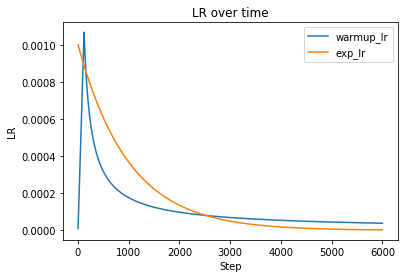

In [7]:
# Define the schedulers
get_warmup_lr = lambda e: max(min_lr, glimpse_net_size**(-0.5) * min(
    (e+1)**(-decay_rate), (e+1)*warmup_steps**(-(decay_rate+1))
))
get_exp_lr = lambda e: 0.999**e

# Get the actual LR schedulers
total_steps = steps_per_epoch * num_epochs
warmup_lr = [lr*get_warmup_lr(e) for e in range(total_steps)]
exp_lr = [1e-3*get_exp_lr(e) for e in range(total_steps)]

# Plot them
plt.plot(range(1, total_steps+1), warmup_lr)
plt.plot(range(1, total_steps+1), exp_lr)
plt.legend(['warmup_lr', 'exp_lr'])
plt.xlabel('Step'); plt.ylabel('LR')
plt.title('LR over time')
(sum(warmup_lr), sum(warmup_lr[warmup_steps:])), (sum(exp_lr), sum(exp_lr[warmup_steps:]))

Epoch   1/400) lr = 8.9e-06
 b    500/  3000 >> 137.1 ms/b | lr: 2.67e-05 | grad 2norm:  4.03 | grad inf norm:  3.816
       Weights || abs max:  0.38 (  593.00) | mean: -6.06e-06 ( 0.00) | var: 1.18e-03 (   20.58)
        Biases || abs max:  0.00 (941100.12) | mean:  1.64e-04 (472.72) | var: 4.67e-07 (121755164672.00)
                  class loss: 2.302 | steps: 4.789 | reward:  0.162 | acc.: 16.23%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 135.2 ms/b | lr: 4.45e-05 | grad 2norm:  5.26 | grad inf norm:  5.043
       Weights || abs max:  0.38 (  616.94) | mean: -2.91e-05 ( 0.00) | var: 1.20e-03 (    7.12)
        Biases || abs max:  0.02 (21889.73) | mean:  3.63e-03 (28.93) | var: 2.70e-05 (17391966.00)
                  class loss: 2.292 | steps: 4.651 | reward:  0.231 | acc.: 23.13%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted

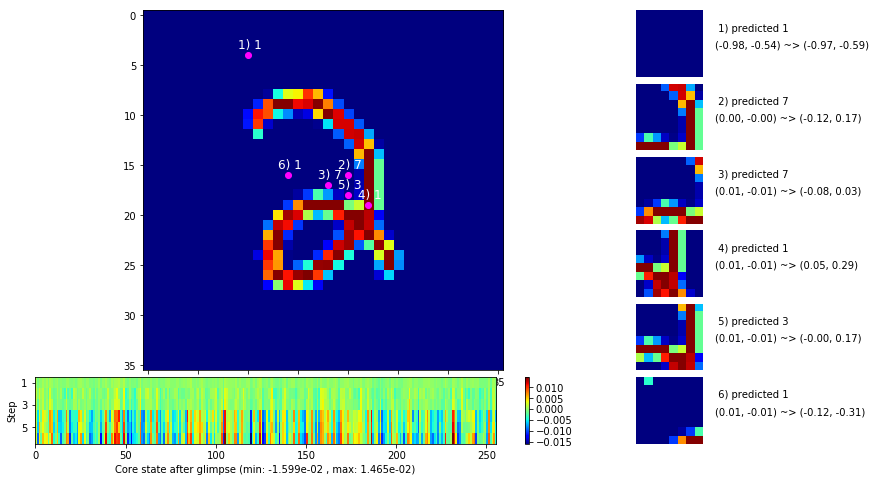

 b   1500/  3000 >> 141.1 ms/b | lr: 7.12e-05 | grad 2norm:  4.97 | grad inf norm:  4.481
       Weights || abs max:  0.38 ( 5239.68) | mean: -2.46e-06 ( 0.03) | var: 1.39e-03 ( 1379.43)
        Biases || abs max:  0.06 ( 9516.52) | mean:  1.71e-02 (14.57) | var: 3.02e-04 (674321.19)
                  class loss: 2.157 | steps: 4.752 | reward:  0.246 | acc.: 24.64%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.0 ms/b | lr: 8.90e-05 | grad 2norm:  6.25 | grad inf norm:  5.213
       Weights || abs max:  0.38 (15765.30) | mean: -6.31e-05 ( 0.07) | var: 1.70e-03 (17085.80)
        Biases || abs max:  0.09 ( 8509.54) | mean:  2.51e-02 ( 9.46) | var: 6.69e-04 (5963284.50)
                  class loss: 1.922 | steps: 4.487 | reward:  0.338 | acc.: 33.79%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0

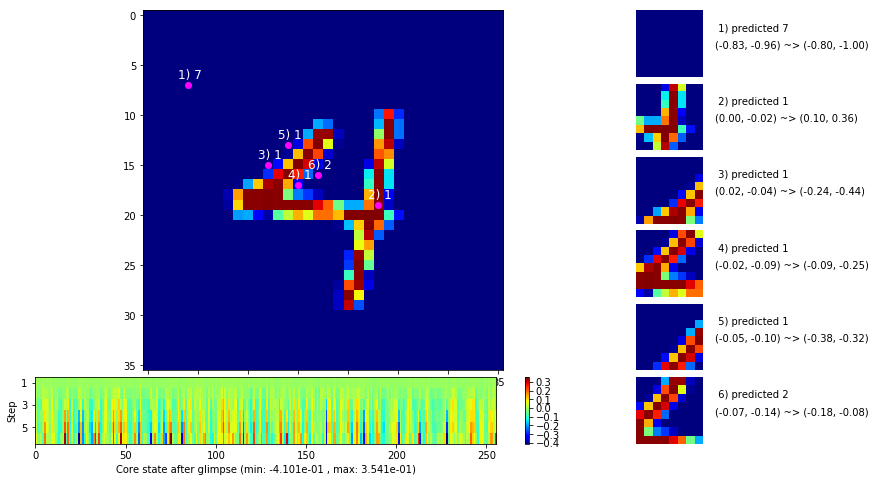

 b   2500/  3000 >> 131.8 ms/b | lr: 1.16e-04 | grad 2norm:  5.40 | grad inf norm:  3.334
       Weights || abs max:  0.38 (20407.98) | mean: -2.81e-04 ( 0.11) | var: 2.03e-03 (24028.67)
        Biases || abs max:  0.11 ( 4104.41) | mean:  2.93e-02 ( 5.34) | var: 9.30e-04 (237093.75)
                  class loss: 1.797 | steps: 4.370 | reward:  0.381 | acc.: 38.09%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 131.2 ms/b | lr: 1.34e-04 | grad 2norm:  5.74 | grad inf norm:  3.040
       Weights || abs max:  0.39 (32015.81) | mean: -4.32e-04 ( 0.14) | var: 2.40e-03 (117565.14)
        Biases || abs max:  0.14 ( 3658.96) | mean:  3.17e-02 ( 5.03) | var: 1.10e-03 (152686.89)
                  class loss: 1.786 | steps: 4.348 | reward:  0.387 | acc.: 38.70%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0

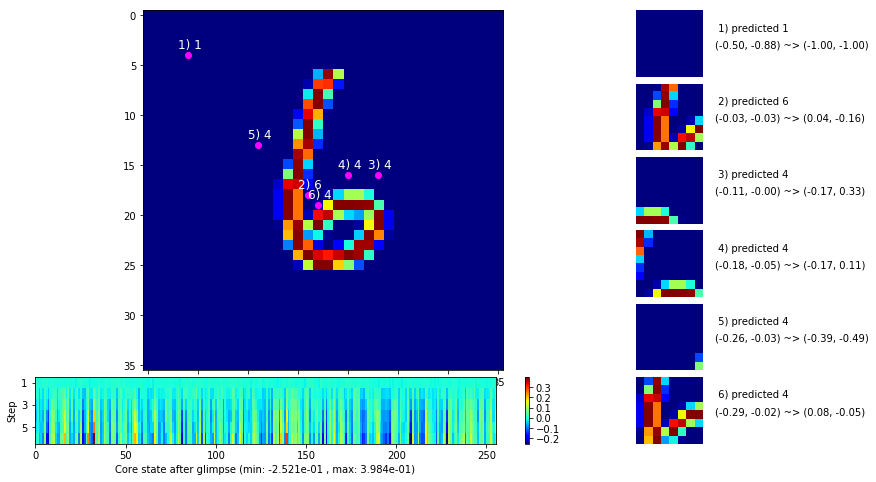

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


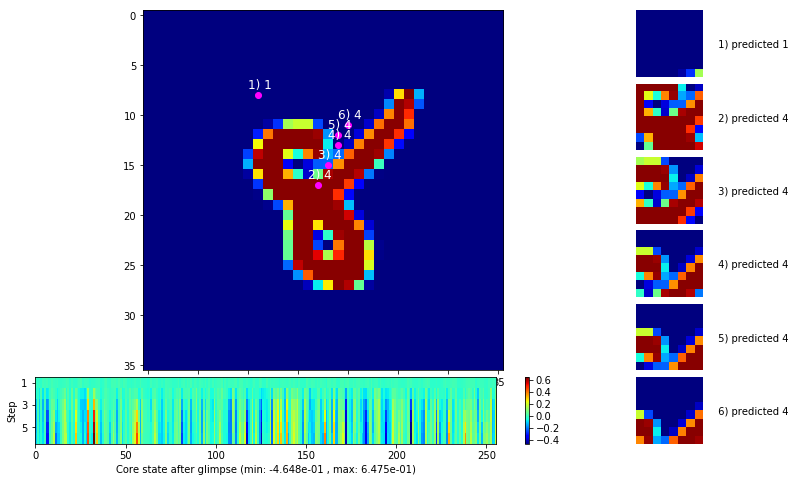


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


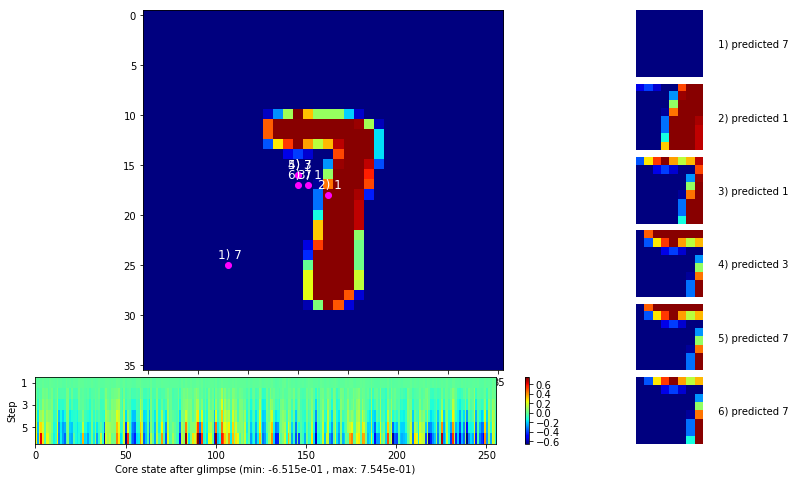

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


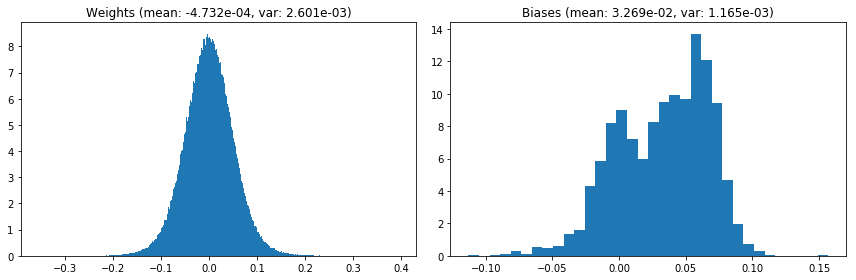

                                      Location network weights and biases


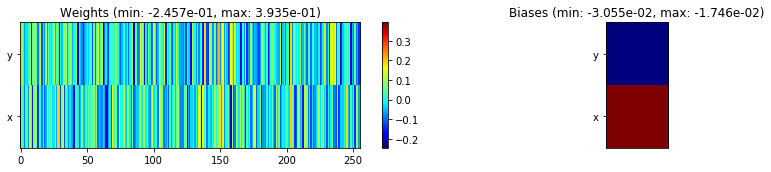

---------------------------------------------------------------------------------------------------------------
Elapsed time:  403.28 sec | TRAIN >> class loss: 2.0426 | steps:  4.566    | reward:  0.2910    | acc.: 29.097% 
                          | VAL   >> class loss: 1.5641 | steps:  4.054    | reward:  0.4682    | acc.: 46.820% 


Epoch   2/400) lr = 0.0001424
 b    500/  3000 >> 129.0 ms/b | lr: 1.60e-04 | grad 2norm:  6.17 | grad inf norm:  2.845
       Weights || abs max:  0.39 (46129.04) | mean: -4.71e-04 ( 0.17) | var: 2.83e-03 (199237.22)
        Biases || abs max:  0.17 ( 6250.20) | mean:  3.41e-02 ( 6.93) | var: 1.26e-03 (2027027.25)
                  class loss: 1.725 | steps: 4.288 | reward:  0.397 | acc.: 39.68%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.5 ms/b | lr: 1.78e-04 | grad 2norm:  6.45 | grad inf norm:  2.710
       Weights || abs max:  0.40 (25954.42) | mean: -4.97e-04 ( 0.13) | 

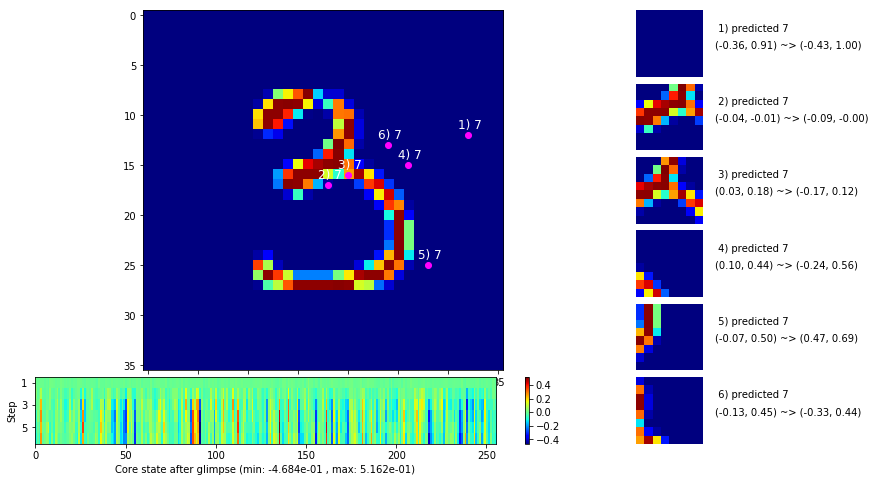

 b   1500/  3000 >> 130.3 ms/b | lr: 2.05e-04 | grad 2norm:  6.91 | grad inf norm:  2.596
       Weights || abs max:  0.40 (59817.99) | mean: -5.33e-04 ( 0.20) | var: 3.63e-03 (415953.62)
        Biases || abs max:  0.24 ( 2919.98) | mean:  3.71e-02 ( 4.09) | var: 1.50e-03 (177367.23)
                  class loss: 1.581 | steps: 4.084 | reward:  0.452 | acc.: 45.24%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.5 ms/b | lr: 2.23e-04 | grad 2norm:  7.77 | grad inf norm:  2.639
       Weights || abs max:  0.41 (26984.41) | mean: -5.23e-04 ( 0.14) | var: 4.01e-03 (33340.86)
        Biases || abs max:  0.28 (22578.48) | mean:  3.88e-02 (18.73) | var: 1.65e-03 (154461248.00)
                  class loss: 1.498 | steps: 4.028 | reward:  0.475 | acc.: 47.51%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0

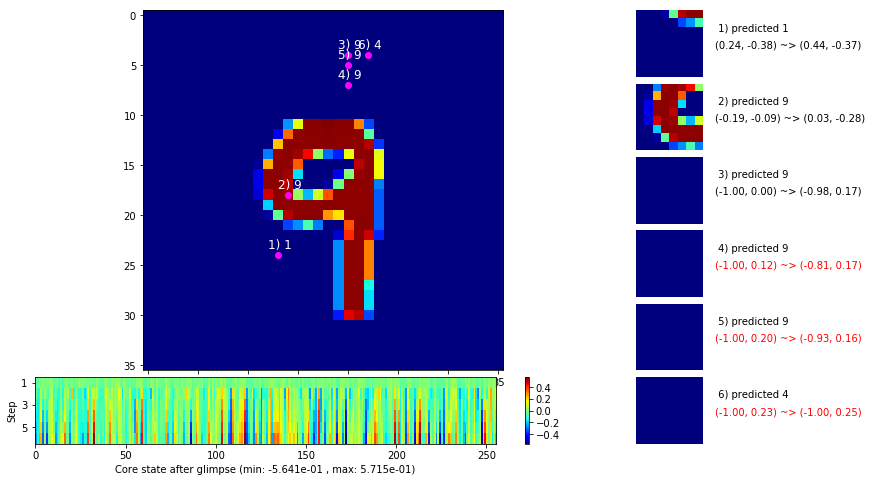

 b   2500/  3000 >> 147.0 ms/b | lr: 2.49e-04 | grad 2norm:  8.04 | grad inf norm:  2.593
       Weights || abs max:  0.45 (39492.82) | mean: -5.21e-04 ( 0.16) | var: 4.32e-03 (89025.76)
        Biases || abs max:  0.31 ( 3287.10) | mean:  3.96e-02 ( 3.73) | var: 1.78e-03 (239708.69)
                  class loss: 1.423 | steps: 3.957 | reward:  0.506 | acc.: 50.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.5 ms/b | lr: 2.67e-04 | grad 2norm:  8.62 | grad inf norm:  2.504
       Weights || abs max:  0.48 (17547.01) | mean: -4.99e-04 ( 0.12) | var: 4.63e-03 ( 4737.79)
        Biases || abs max:  0.34 ( 9038.23) | mean:  4.05e-02 ( 5.84) | var: 1.92e-03 (3073004.50)
                  class loss: 1.321 | steps: 3.865 | reward:  0.539 | acc.: 53.91%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

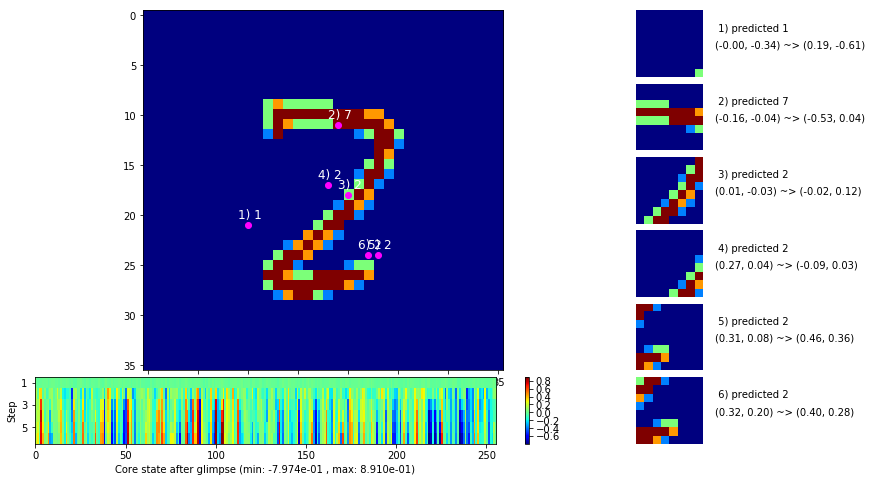

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


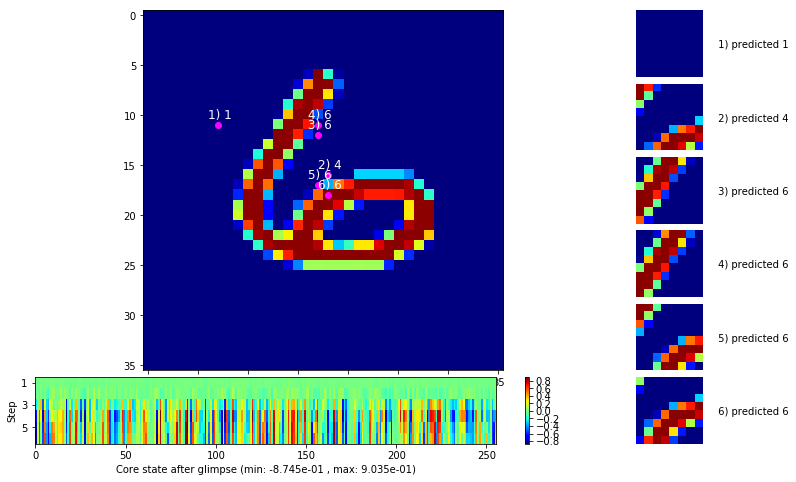


	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


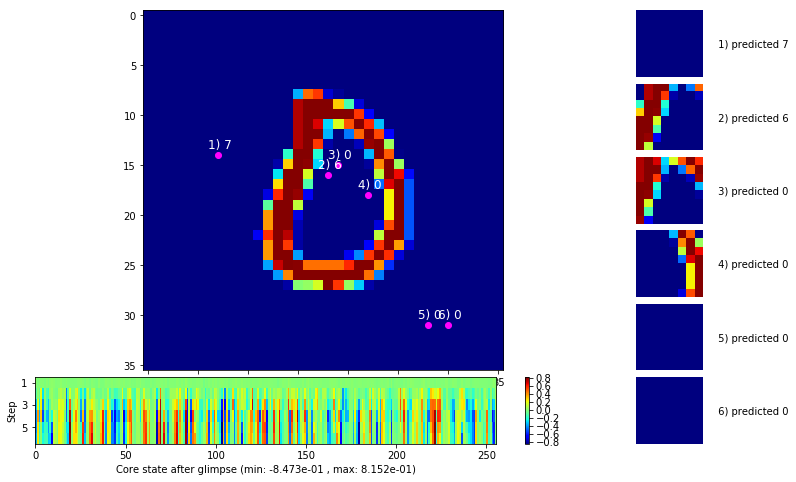

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


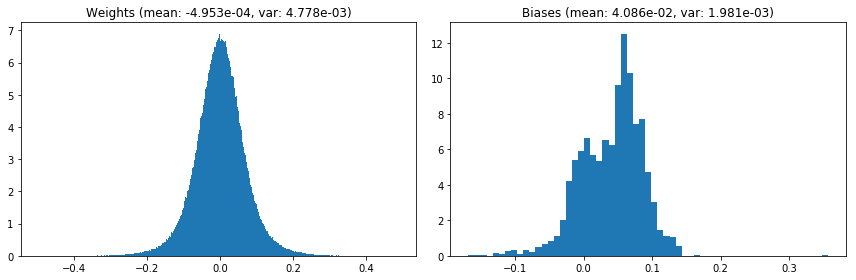

                                      Location network weights and biases


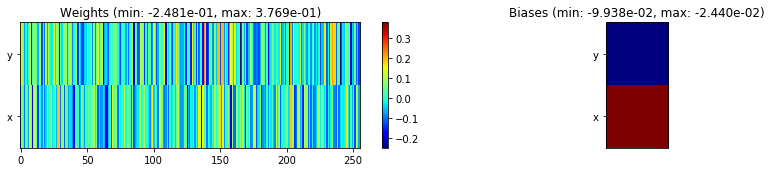

---------------------------------------------------------------------------------------------------------------
Elapsed time:  398.57 sec | TRAIN >> class loss: 1.5369 | steps:  4.078    | reward:  0.4637    | acc.: 46.365% 
                          | VAL   >> class loss: 1.1394 | steps:  3.522    | reward:  0.6006    | acc.: 60.060% 


Epoch   3/400) lr = 0.0002759
 b    500/  3000 >> 128.5 ms/b | lr: 2.94e-04 | grad 2norm:  8.90 | grad inf norm:  2.577
       Weights || abs max:  0.51 (24735.46) | mean: -4.73e-04 ( 0.13) | var: 4.92e-03 (36436.25)
        Biases || abs max:  0.38 ( 1231.82) | mean:  4.11e-02 ( 1.75) | var: 2.05e-03 ( 6316.52)
                  class loss: 1.255 | steps: 3.774 | reward:  0.562 | acc.: 56.23%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.3 ms/b | lr: 3.12e-04 | grad 2norm:  9.12 | grad inf norm:  2.452
       Weights || abs max:  0.53 (44598.90) | mean: -4.41e-04 ( 0.17) | var

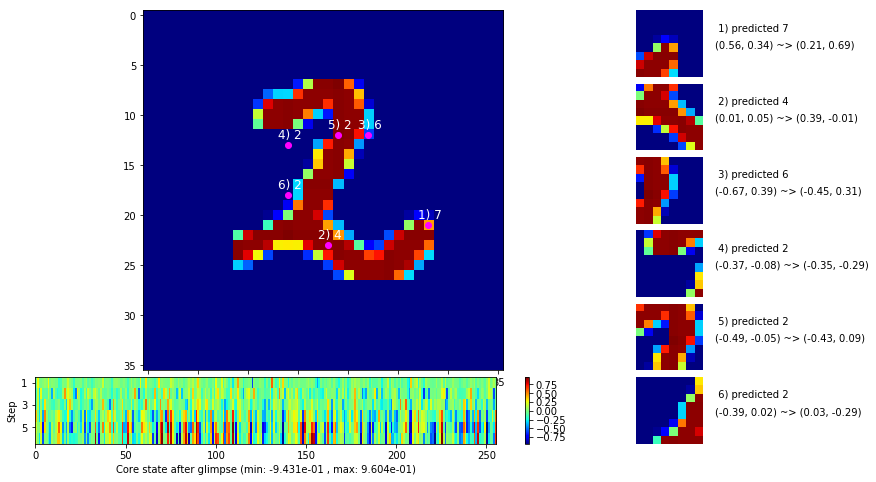

 b   1500/  3000 >> 129.5 ms/b | lr: 3.38e-04 | grad 2norm:  9.24 | grad inf norm:  2.516
       Weights || abs max:  0.54 (27158.03) | mean: -4.10e-04 ( 0.14) | var: 5.49e-03 (25949.88)
        Biases || abs max:  0.45 ( 1009.44) | mean:  4.20e-02 ( 1.80) | var: 2.34e-03 ( 5518.81)
                  class loss: 1.123 | steps: 3.573 | reward:  0.608 | acc.: 60.82%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 126.7 ms/b | lr: 3.56e-04 | grad 2norm:  9.57 | grad inf norm:  2.562
       Weights || abs max:  0.55 (25610.62) | mean: -3.51e-04 ( 0.14) | var: 5.76e-03 (15842.31)
        Biases || abs max:  0.49 ( 2016.75) | mean:  4.26e-02 ( 2.40) | var: 2.51e-03 (179062.23)
                  class loss: 1.025 | steps: 3.491 | reward:  0.652 | acc.: 65.16%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

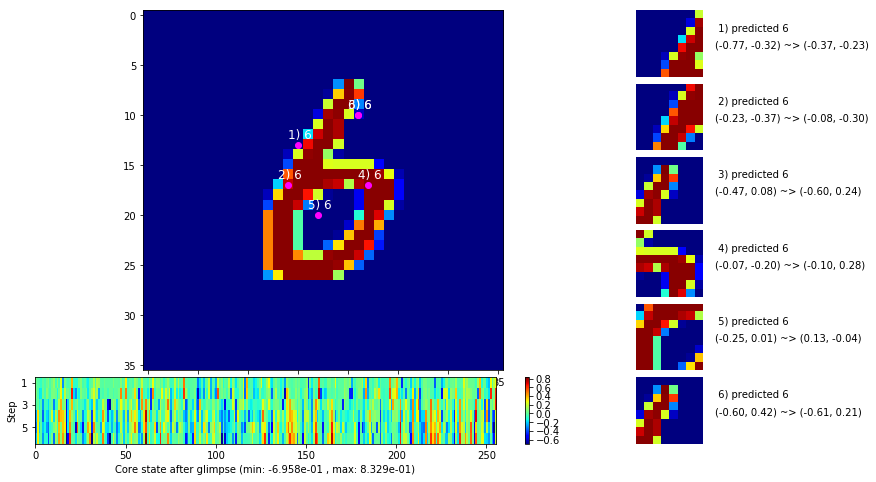

 b   2500/  3000 >> 127.5 ms/b | lr: 3.83e-04 | grad 2norm:  9.61 | grad inf norm:  2.445
       Weights || abs max:  0.56 (25308.85) | mean: -3.10e-04 ( 0.13) | var: 6.04e-03 (26888.37)
        Biases || abs max:  0.53 ( 1570.41) | mean:  4.27e-02 ( 1.93) | var: 2.67e-03 (16853.53)
                  class loss: 0.961 | steps: 3.404 | reward:  0.669 | acc.: 66.92%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 125.4 ms/b | lr: 4.01e-04 | grad 2norm:  9.34 | grad inf norm:  2.426
       Weights || abs max:  0.58 (33613.76) | mean: -2.76e-04 ( 0.15) | var: 6.34e-03 (48649.85)
        Biases || abs max:  0.57 ( 2233.12) | mean:  4.30e-02 ( 2.37) | var: 2.86e-03 (584157.19)
                  class loss: 0.916 | steps: 3.321 | reward:  0.688 | acc.: 68.78%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

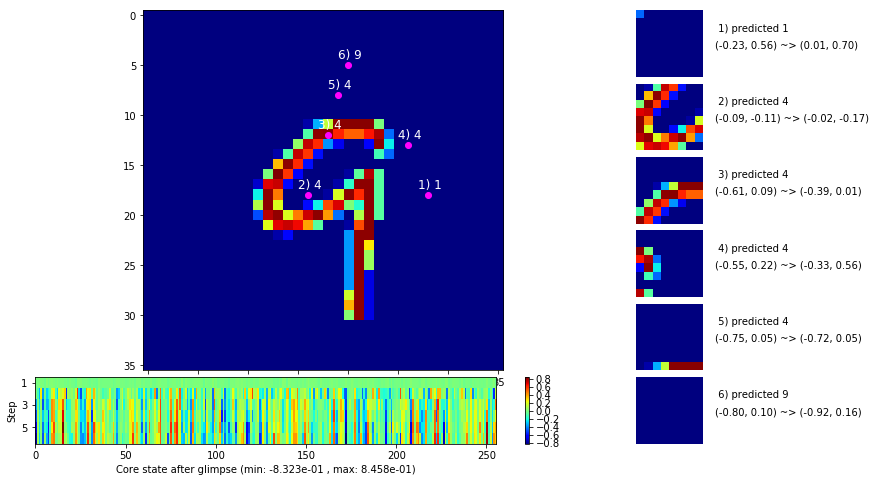

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


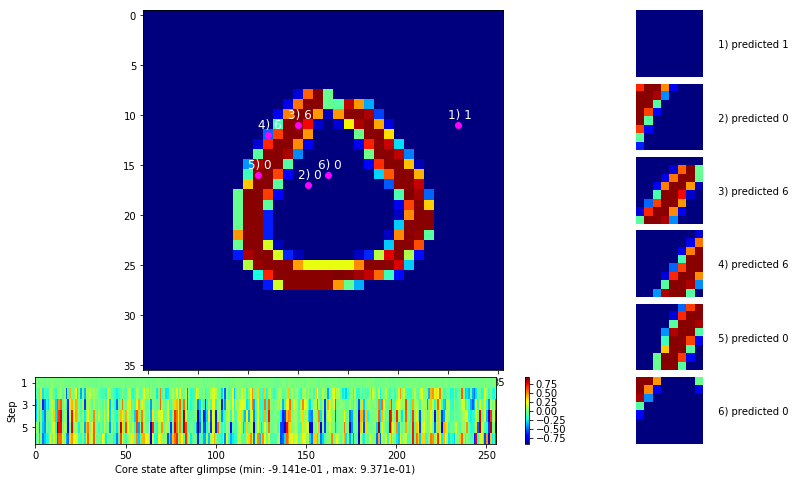


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


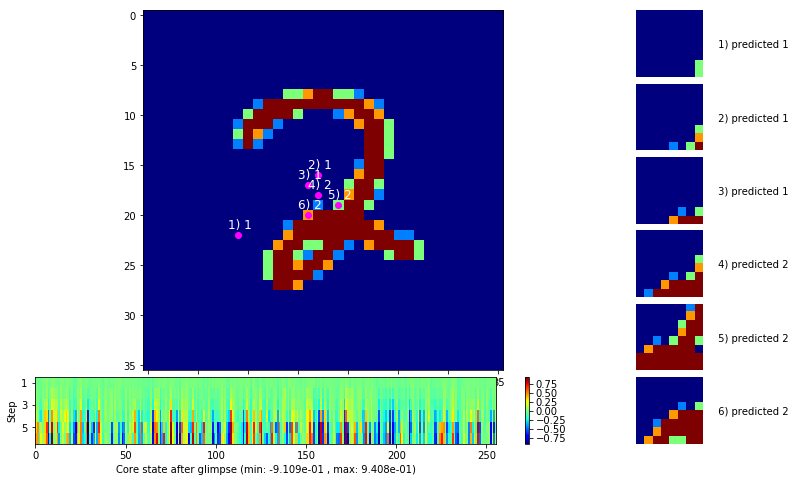

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


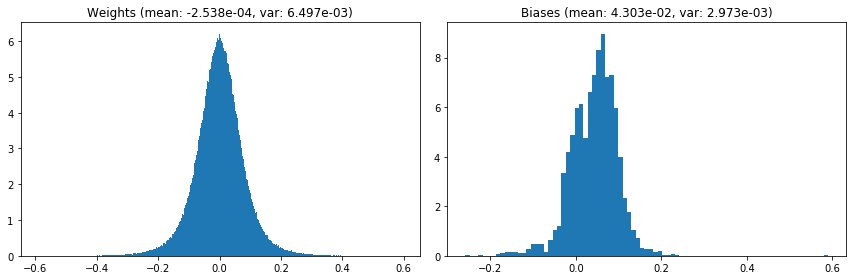

                                      Location network weights and biases


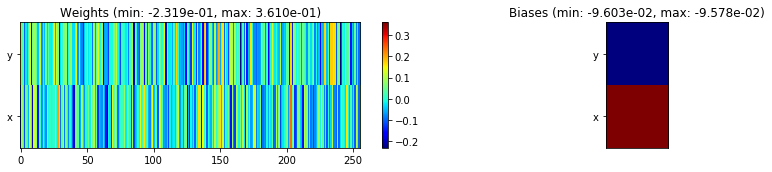

---------------------------------------------------------------------------------------------------------------
Elapsed time:  383.11 sec | TRAIN >> class loss: 1.0757 | steps:  3.541    | reward:  0.6287    | acc.: 62.867% 
                          | VAL   >> class loss: 0.8220 | steps:  3.103    | reward:  0.7296    | acc.: 72.960% 


Epoch   4/400) lr = 0.0004094
 b    500/  3000 >> 126.5 ms/b | lr: 4.27e-04 | grad 2norm:  9.49 | grad inf norm:  2.339
       Weights || abs max:  0.61 (23922.04) | mean: -2.61e-04 ( 0.13) | var: 6.65e-03 (44634.93)
        Biases || abs max:  0.60 ( 3064.78) | mean:  4.28e-02 ( 2.88) | var: 3.07e-03 (1171797.75)
                  class loss: 0.845 | steps: 3.214 | reward:  0.707 | acc.: 70.65%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 141.5 ms/b | lr: 4.45e-04 | grad 2norm:  9.31 | grad inf norm:  2.234
       Weights || abs max:  0.63 (22018.01) | mean: -2.31e-04 ( 0.12) | v

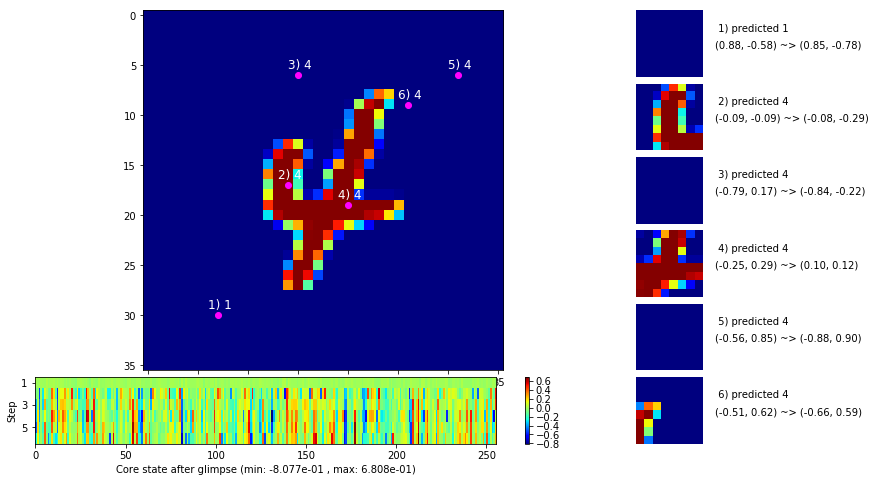

 b   1500/  3000 >> 128.5 ms/b | lr: 4.72e-04 | grad 2norm:  9.24 | grad inf norm:  2.199
       Weights || abs max:  0.65 (16494.67) | mean: -3.00e-04 ( 0.11) | var: 7.23e-03 ( 6989.31)
        Biases || abs max:  0.68 ( 8274.37) | mean:  4.22e-02 ( 4.19) | var: 3.49e-03 (9038530.00)
                  class loss: 0.785 | steps: 3.092 | reward:  0.737 | acc.: 73.68%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 126.0 ms/b | lr: 4.90e-04 | grad 2norm:  9.13 | grad inf norm:  2.199
       Weights || abs max:  0.66 (26188.88) | mean: -3.25e-04 ( 0.13) | var: 7.52e-03 (24517.57)
        Biases || abs max:  0.69 ( 1136.58) | mean:  4.17e-02 ( 1.37) | var: 3.73e-03 ( 6295.55)
                  class loss: 0.787 | steps: 3.077 | reward:  0.732 | acc.: 73.21%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

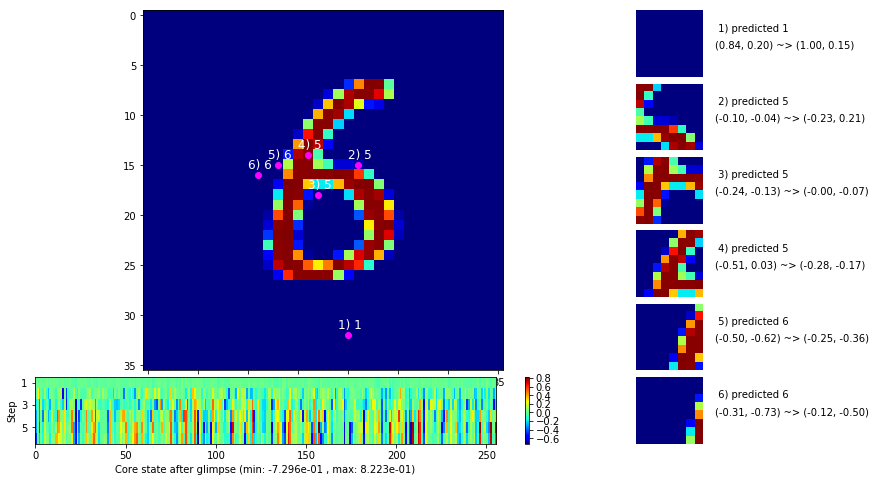

 b   2500/  3000 >> 127.9 ms/b | lr: 5.16e-04 | grad 2norm:  9.08 | grad inf norm:  2.234
       Weights || abs max:  0.67 (25754.60) | mean: -3.34e-04 ( 0.13) | var: 7.81e-03 (20987.74)
        Biases || abs max:  0.71 (  895.53) | mean:  4.07e-02 ( 1.12) | var: 3.94e-03 ( 4964.34)
                  class loss: 0.731 | steps: 3.022 | reward:  0.754 | acc.: 75.45%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 126.9 ms/b | lr: 5.34e-04 | grad 2norm:  9.08 | grad inf norm:  2.240
       Weights || abs max:  0.68 (23508.60) | mean: -2.72e-04 ( 0.12) | var: 8.10e-03 (26359.49)
        Biases || abs max:  0.73 (  818.17) | mean:  3.99e-02 ( 1.13) | var: 4.16e-03 ( 4886.79)
                  class loss: 0.704 | steps: 2.995 | reward:  0.757 | acc.: 75.72%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

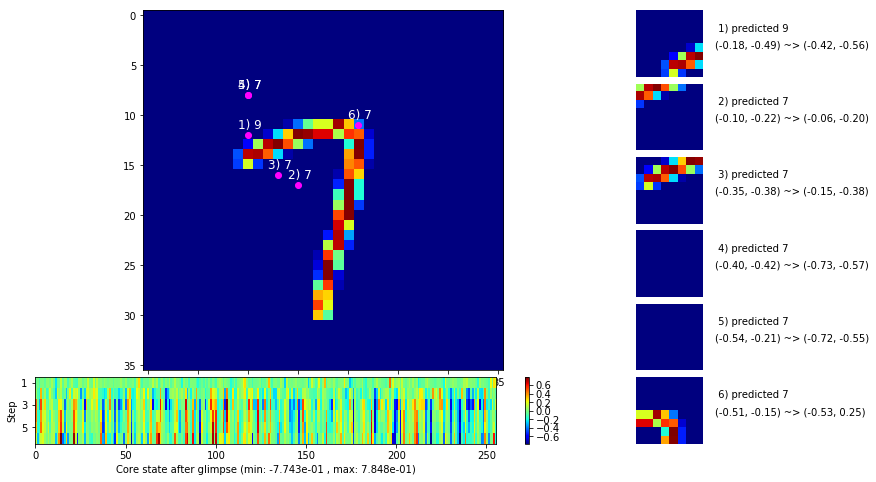

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


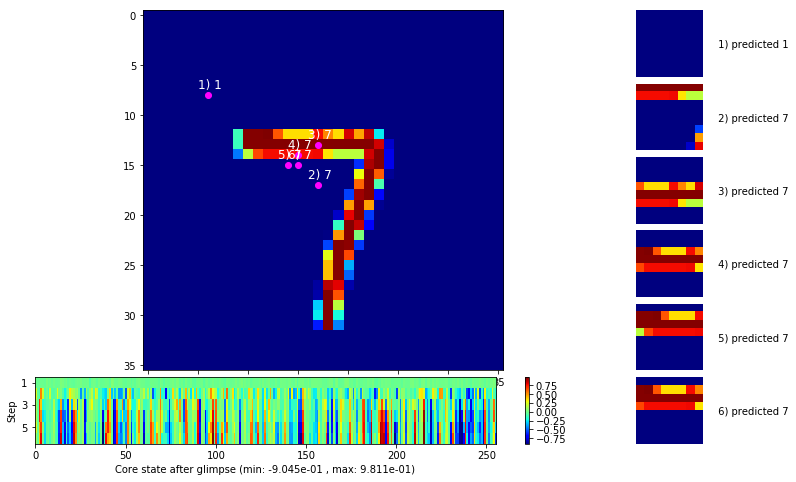


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


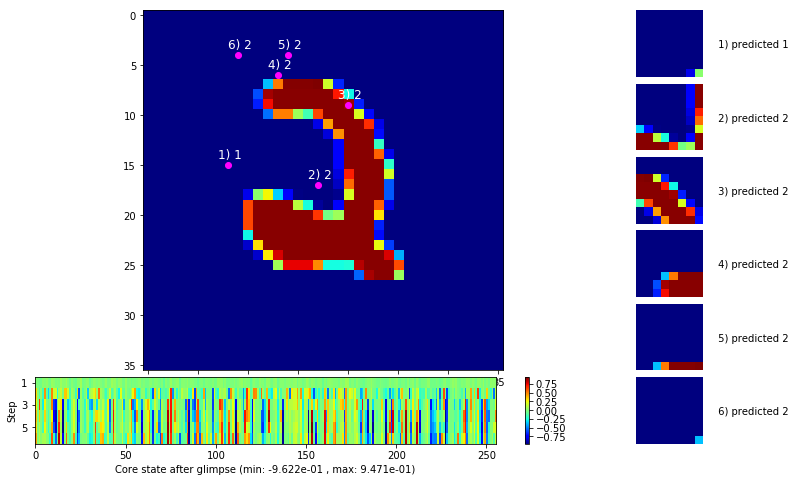

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


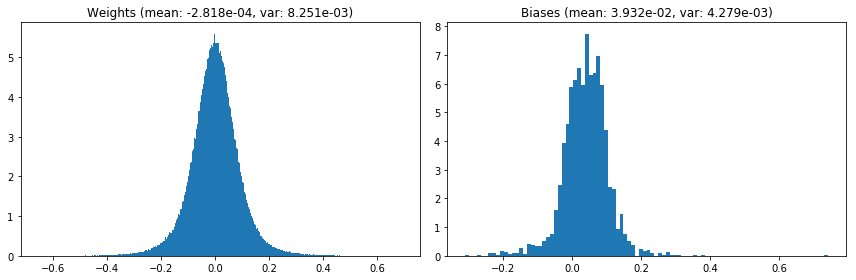

                                      Location network weights and biases


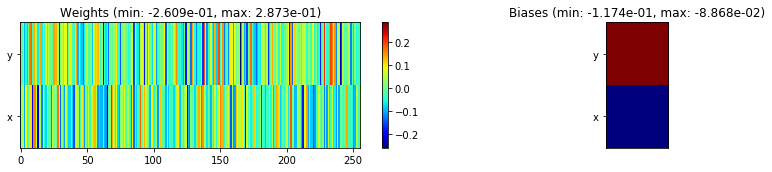

---------------------------------------------------------------------------------------------------------------
Elapsed time:  389.21 sec | TRAIN >> class loss: 0.7714 | steps:  3.089    | reward:  0.7379    | acc.: 73.792% 
                          | VAL   >> class loss: 0.6175 | steps:  2.778    | reward:  0.7860    | acc.: 78.600% 


Epoch   5/400) lr = 0.0005429
 b    500/  3000 >> 128.9 ms/b | lr: 5.61e-04 | grad 2norm:  9.01 | grad inf norm:  2.193
       Weights || abs max:  0.70 (45254.91) | mean: -3.08e-04 ( 0.16) | var: 8.39e-03 (418685.56)
        Biases || abs max:  0.74 ( 4402.20) | mean:  3.85e-02 ( 2.49) | var: 4.38e-03 (2536940.25)
                  class loss: 0.691 | steps: 2.928 | reward:  0.761 | acc.: 76.06%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.0 ms/b | lr: 5.79e-04 | grad 2norm:  8.60 | grad inf norm:  2.094
       Weights || abs max:  0.72 (76657.24) | mean: -2.84e-04 ( 0.22) | 

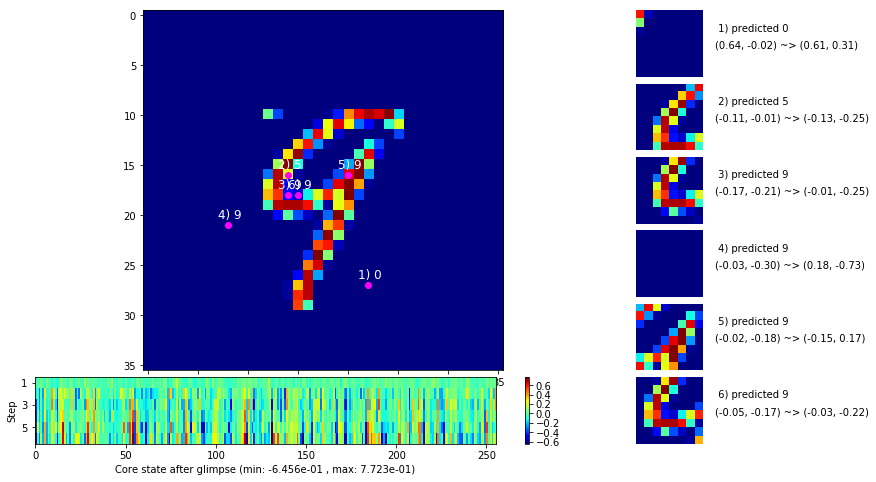

 b   1500/  3000 >> 128.7 ms/b | lr: 6.05e-04 | grad 2norm:  8.72 | grad inf norm:  2.173
       Weights || abs max:  0.75 (34905.77) | mean: -2.91e-04 ( 0.14) | var: 8.99e-03 (75371.83)
        Biases || abs max:  0.77 (  860.35) | mean:  3.57e-02 ( 1.05) | var: 4.86e-03 (31227.12)
                  class loss: 0.636 | steps: 2.873 | reward:  0.783 | acc.: 78.29%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 127.9 ms/b | lr: 6.23e-04 | grad 2norm:  8.77 | grad inf norm:  2.174
       Weights || abs max:  0.78 (68081.29) | mean: -2.12e-04 ( 0.20) | var: 9.29e-03 (1235226.25)
        Biases || abs max:  0.78 (  745.18) | mean:  3.42e-02 ( 0.94) | var: 5.06e-03 ( 3556.02)
                  class loss: 0.634 | steps: 2.845 | reward:  0.786 | acc.: 78.58%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.

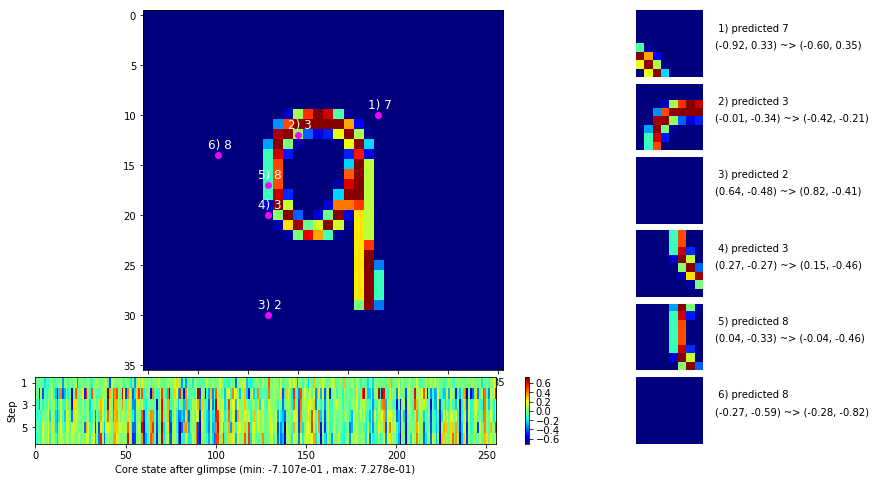

 b   2500/  3000 >> 140.2 ms/b | lr: 6.50e-04 | grad 2norm:  8.66 | grad inf norm:  2.021
       Weights || abs max:  0.80 (39584.60) | mean: -2.24e-04 ( 0.15) | var: 9.60e-03 (96683.44)
        Biases || abs max:  0.80 ( 1566.03) | mean:  3.22e-02 ( 1.25) | var: 5.25e-03 (93347.94)
                  class loss: 0.610 | steps: 2.838 | reward:  0.797 | acc.: 79.72%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 132.8 ms/b | lr: 6.68e-04 | grad 2norm:  8.38 | grad inf norm:  1.987
       Weights || abs max:  0.85 (23083.12) | mean: -2.45e-04 ( 0.12) | var: 9.93e-03 (10733.74)
        Biases || abs max:  0.81 (  859.80) | mean:  3.06e-02 ( 1.02) | var: 5.54e-03 ( 6426.13)
                  class loss: 0.549 | steps: 2.778 | reward:  0.815 | acc.: 81.46%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

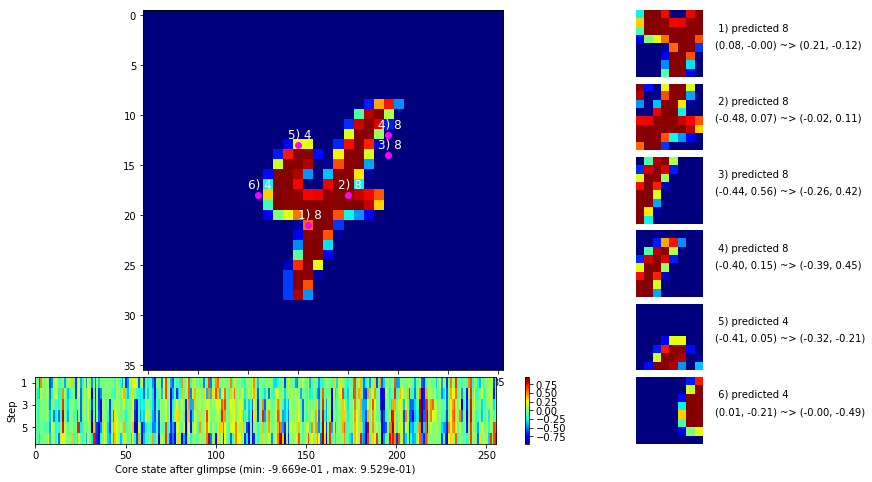

                                          ---===  VALIDATION  ===---

	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


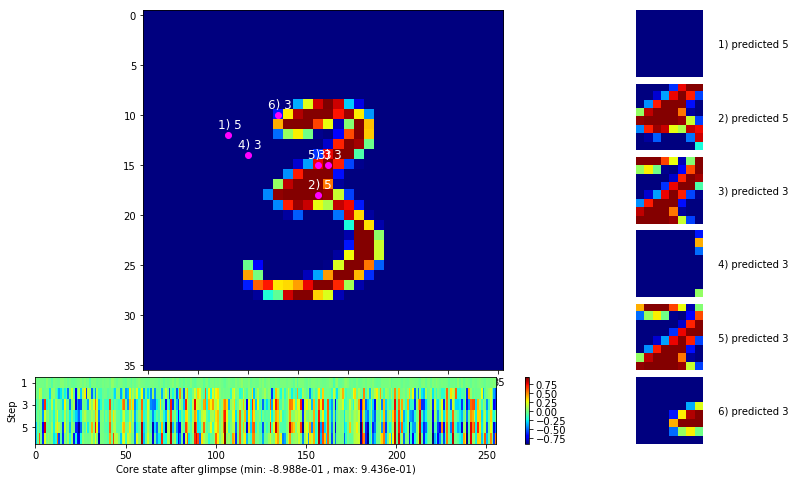


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


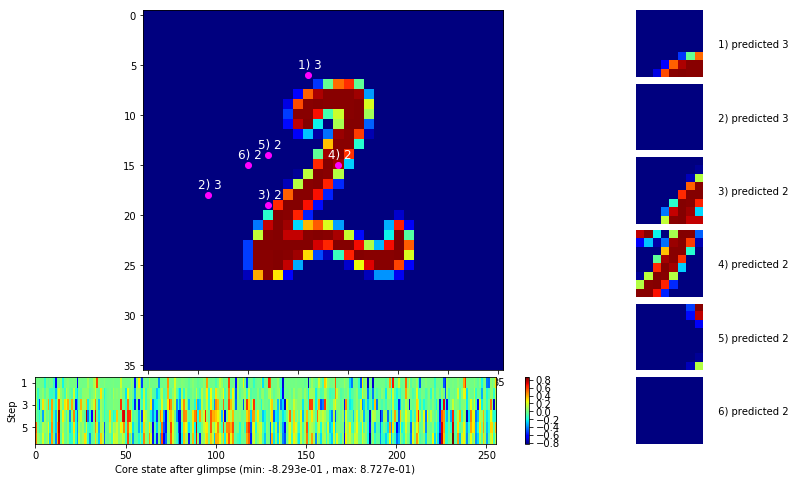

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


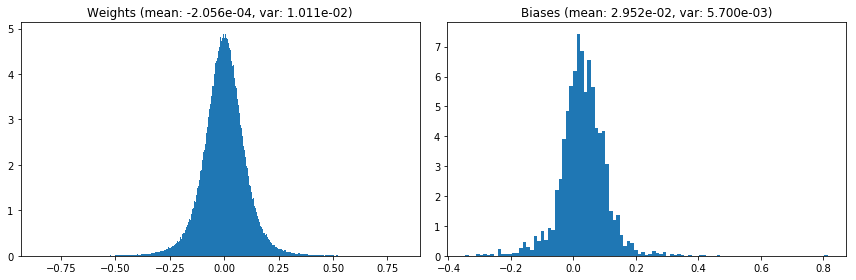

                                      Location network weights and biases


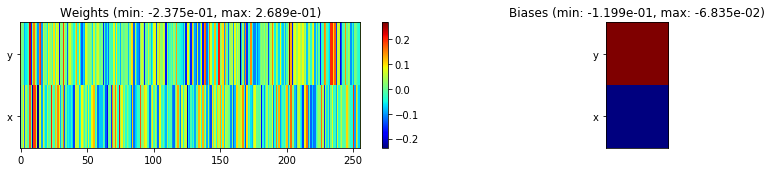

---------------------------------------------------------------------------------------------------------------
Elapsed time:  393.35 sec | TRAIN >> class loss: 0.6298 | steps:  2.859    | reward:  0.7865    | acc.: 78.655% 
                          | VAL   >> class loss: 0.4930 | steps:  2.629    | reward:  0.8294    | acc.: 82.940% 


Epoch   6/400) lr = 0.0006764
 b    500/  3000 >> 127.5 ms/b | lr: 6.94e-04 | grad 2norm:  8.62 | grad inf norm:  2.052
       Weights || abs max:  0.86 (25010.13) | mean: -1.65e-04 ( 0.12) | var: 1.03e-02 (17565.50)
        Biases || abs max:  0.82 (  633.32) | mean:  2.89e-02 ( 0.81) | var: 5.86e-03 ( 4054.17)
                  class loss: 0.571 | steps: 2.746 | reward:  0.811 | acc.: 81.09%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.8 ms/b | lr: 7.12e-04 | grad 2norm:  8.53 | grad inf norm:  2.013
       Weights || abs max:  0.88 (26668.33) | mean: -1.94e-04 ( 0.13) | var

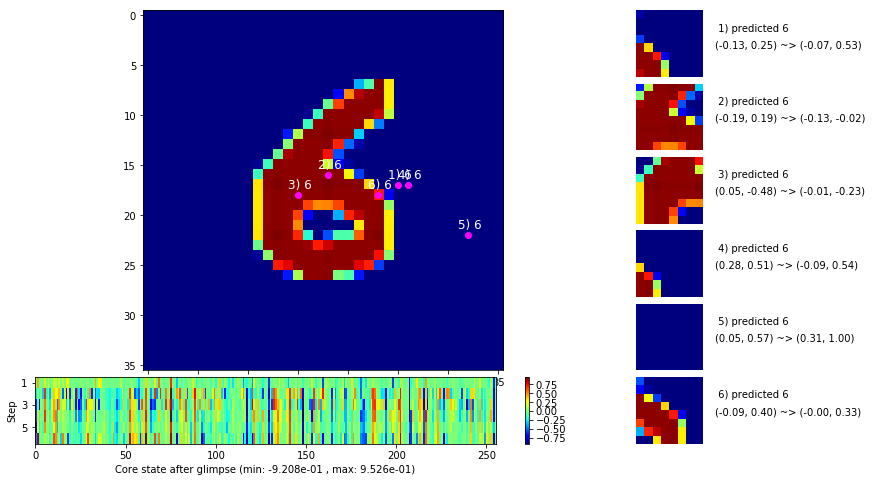

 b   1500/  3000 >> 128.6 ms/b | lr: 7.39e-04 | grad 2norm:  8.54 | grad inf norm:  1.947
       Weights || abs max:  0.89 (31740.09) | mean: -1.89e-04 ( 0.14) | var: 1.09e-02 (36590.19)
        Biases || abs max:  0.83 (  555.50) | mean:  2.41e-02 ( 0.70) | var: 6.48e-03 ( 3358.35)
                  class loss: 0.547 | steps: 2.691 | reward:  0.821 | acc.: 82.08%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.5 ms/b | lr: 7.57e-04 | grad 2norm:  8.74 | grad inf norm:  2.036
       Weights || abs max:  0.93 (25673.07) | mean: -1.59e-04 ( 0.12) | var: 1.13e-02 (11101.93)
        Biases || abs max:  0.84 (  840.69) | mean:  2.20e-02 ( 0.91) | var: 6.74e-03 (10936.98)
                  class loss: 0.540 | steps: 2.666 | reward:  0.818 | acc.: 81.84%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

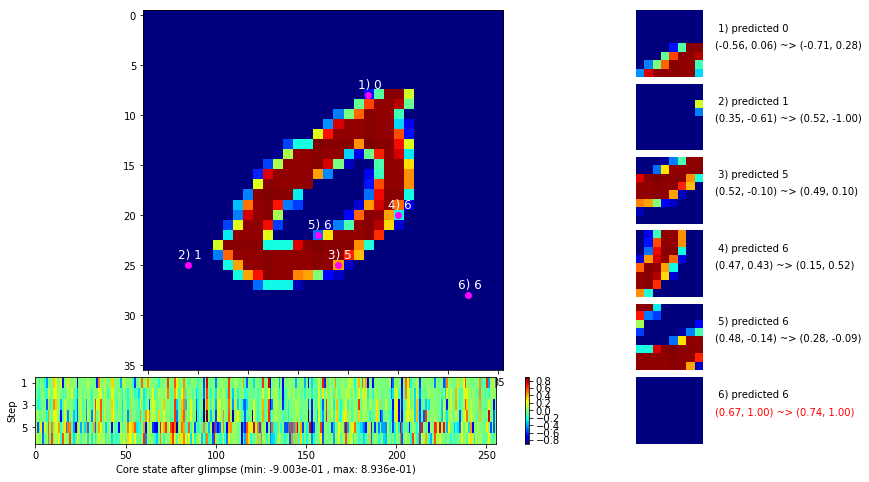

 b   2500/  3000 >> 128.7 ms/b | lr: 7.83e-04 | grad 2norm:  8.75 | grad inf norm:  2.061
       Weights || abs max:  0.95 (23140.31) | mean: -1.56e-04 ( 0.12) | var: 1.17e-02 ( 9767.89)
        Biases || abs max:  0.84 (  898.77) | mean:  1.97e-02 ( 0.96) | var: 7.05e-03 (11430.07)
                  class loss: 0.551 | steps: 2.678 | reward:  0.819 | acc.: 81.90%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 128.0 ms/b | lr: 8.01e-04 | grad 2norm:  8.65 | grad inf norm:  2.011
       Weights || abs max:  0.96 (18119.89) | mean: -1.92e-04 ( 0.11) | var: 1.20e-02 ( 8489.81)
        Biases || abs max:  0.84 ( 1047.73) | mean:  1.72e-02 ( 0.85) | var: 7.42e-03 (32808.87)
                  class loss: 0.531 | steps: 2.681 | reward:  0.820 | acc.: 82.00%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

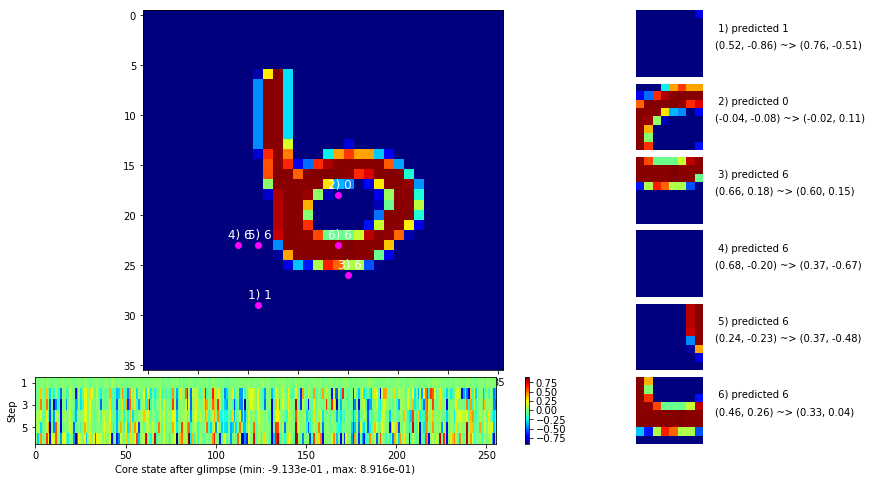

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


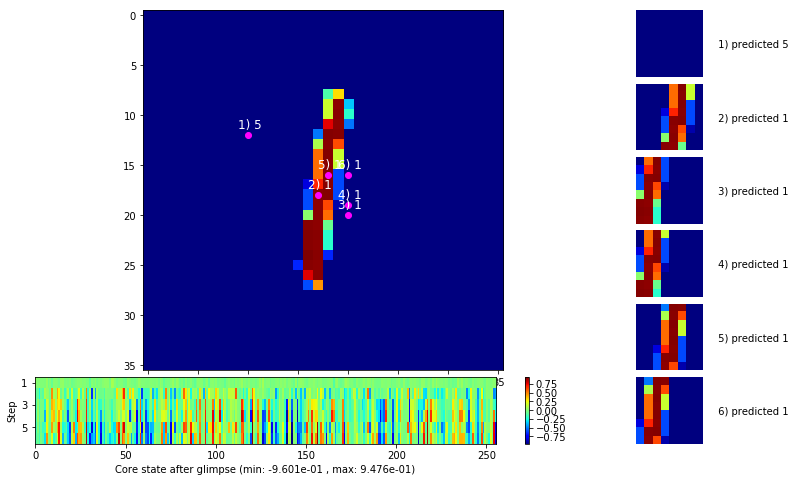


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


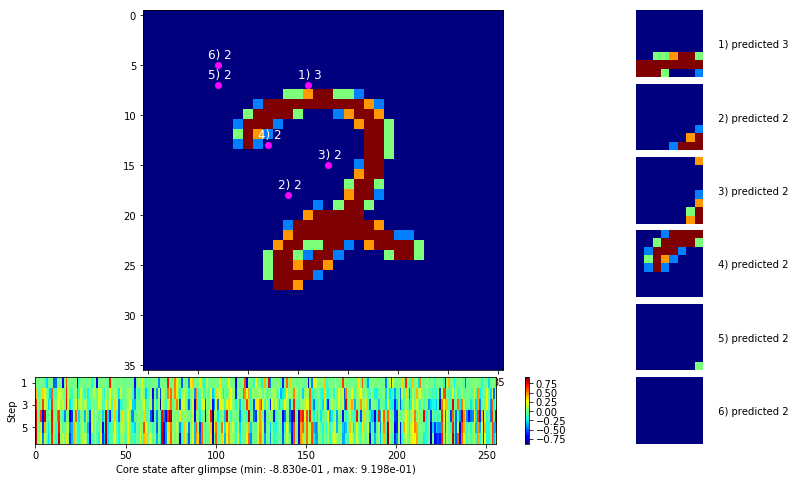

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


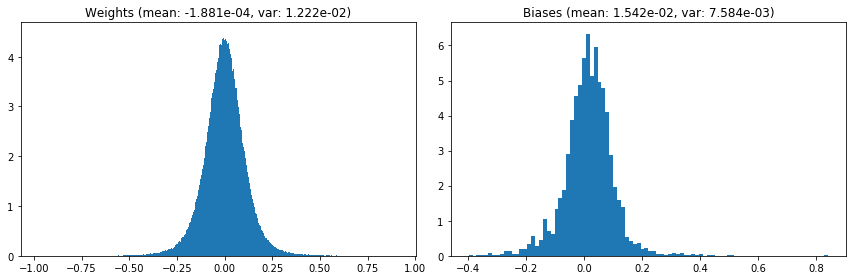

                                      Location network weights and biases


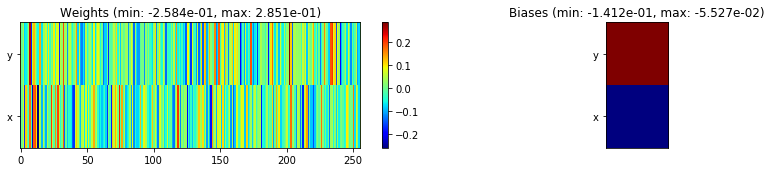

---------------------------------------------------------------------------------------------------------------
Elapsed time:  385.59 sec | TRAIN >> class loss: 0.5491 | steps:  2.696    | reward:  0.8180    | acc.: 81.802% 
                          | VAL   >> class loss: 0.4091 | steps:  2.438    | reward:  0.8664    | acc.: 86.640% 


Epoch   7/400) lr = 0.0008099
 b    500/  3000 >> 128.1 ms/b | lr: 8.28e-04 | grad 2norm:  8.46 | grad inf norm:  1.941
       Weights || abs max:  0.97 (43852.82) | mean: -1.82e-04 ( 0.15) | var: 1.24e-02 (274622.09)
        Biases || abs max:  0.85 ( 1450.38) | mean:  1.45e-02 ( 1.15) | var: 7.80e-03 (44631.72)
                  class loss: 0.518 | steps: 2.656 | reward:  0.824 | acc.: 82.44%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 138.6 ms/b | lr: 8.46e-04 | grad 2norm:  8.61 | grad inf norm:  1.978
       Weights || abs max:  1.00 (160864.73) | mean: -1.46e-04 ( 0.37) | v

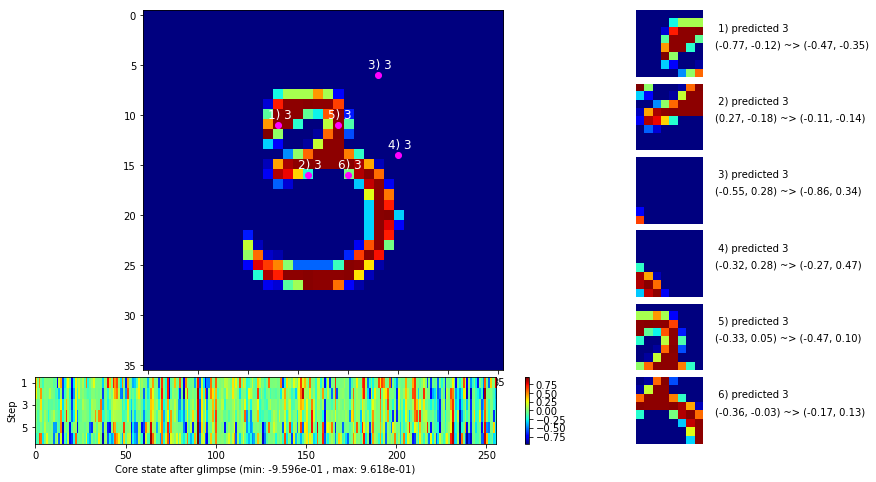

 b   1500/  3000 >> 135.6 ms/b | lr: 8.72e-04 | grad 2norm:  8.74 | grad inf norm:  2.031
       Weights || abs max:  1.02 (37440.53) | mean: -1.78e-04 ( 0.14) | var: 1.33e-02 (138783.77)
        Biases || abs max:  0.84 ( 1810.82) | mean:  8.93e-03 ( 1.44) | var: 8.79e-03 (181906.64)
                  class loss: 0.560 | steps: 2.665 | reward:  0.814 | acc.: 81.37%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.2 ms/b | lr: 8.90e-04 | grad 2norm:  8.26 | grad inf norm:  1.927
       Weights || abs max:  1.04 (21057.41) | mean: -2.26e-04 ( 0.11) | var: 1.37e-02 ( 7046.88)
        Biases || abs max:  0.85 (  338.30) | mean:  6.33e-03 ( 0.46) | var: 9.26e-03 (  750.83)
                  class loss: 0.506 | steps: 2.657 | reward:  0.832 | acc.: 83.17%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.

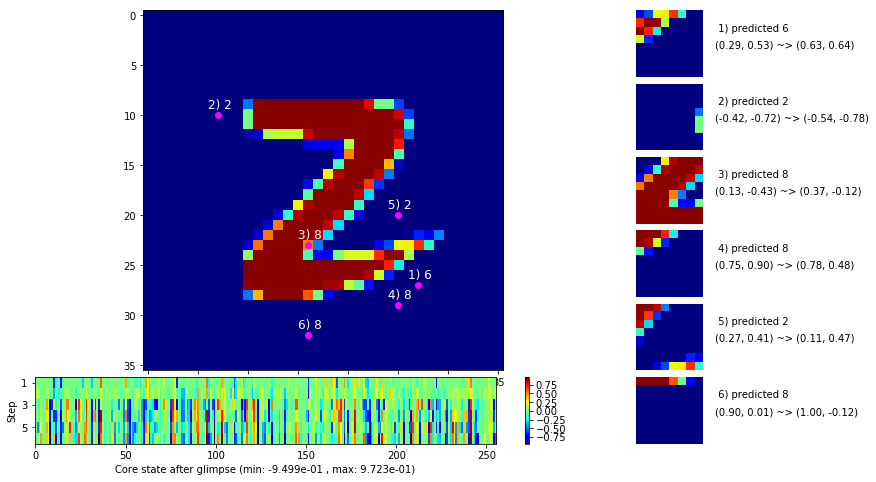

H:\Users\Andrew\Anaconda3\envs\conda_jupyter\lib\site-packages\numpy\lib\nanfunctions.py:1315: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe')


 b   2500/  3000 >> 130.8 ms/b | lr: 9.17e-04 | grad 2norm:  8.20 | grad inf norm:  1.916
       Weights || abs max:  1.08 (     inf) | mean: -2.92e-04 (  inf) | var: 1.42e-02 (     nan)
        Biases || abs max:  0.86 (  366.06) | mean:  3.78e-03 ( 0.51) | var: 9.71e-03 ( 1248.34)
                  class loss: 0.487 | steps: 2.629 | reward:  0.835 | acc.: 83.54%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 128.4 ms/b | lr: 9.35e-04 | grad 2norm:  8.28 | grad inf norm:  1.952
       Weights || abs max:  1.09 (27725.80) | mean: -3.38e-04 ( 0.12) | var: 1.47e-02 (25347.50)
        Biases || abs max:  0.85 (  629.79) | mean:  9.01e-04 ( 0.64) | var: 1.03e-02 ( 4002.58)
                  class loss: 0.517 | steps: 2.632 | reward:  0.826 | acc.: 82.59%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

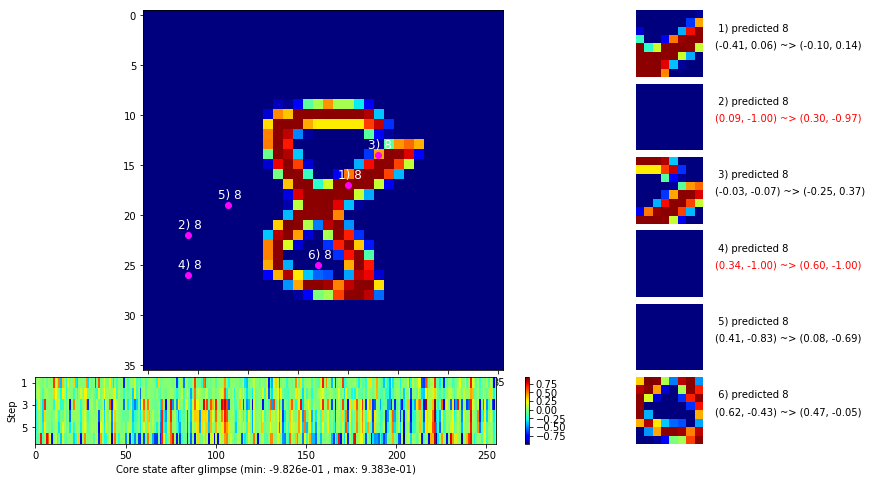

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


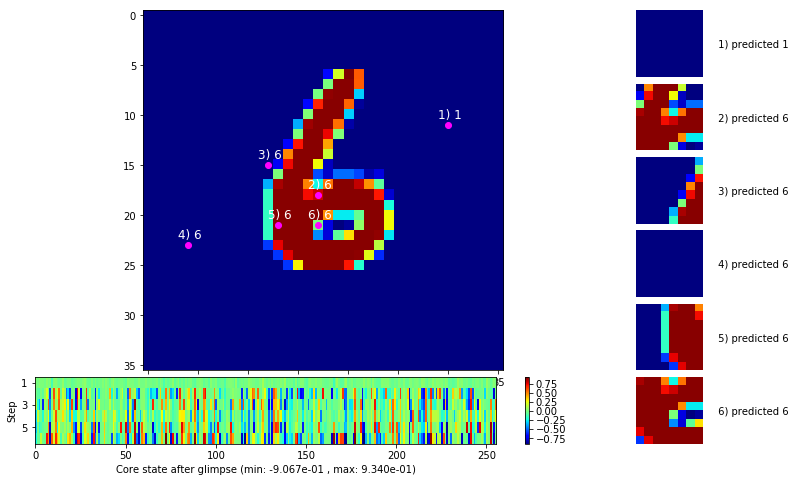


	Target class: 8  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


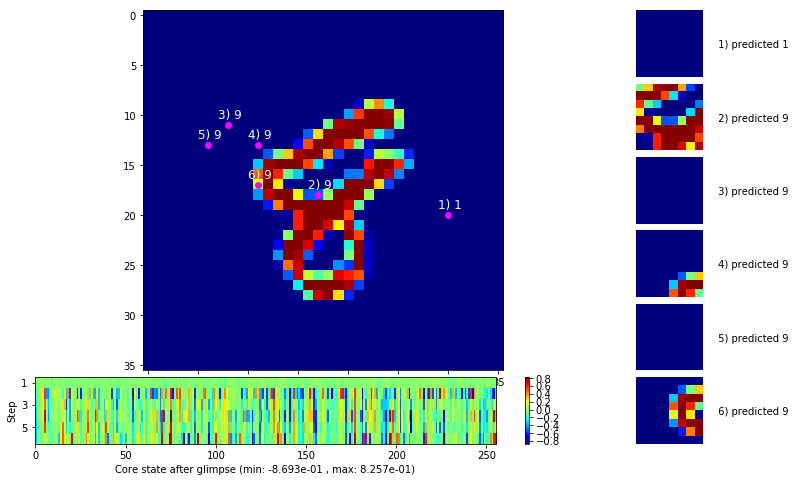

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


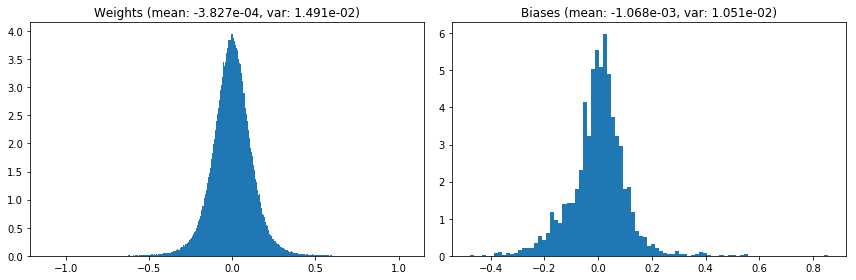

                                      Location network weights and biases


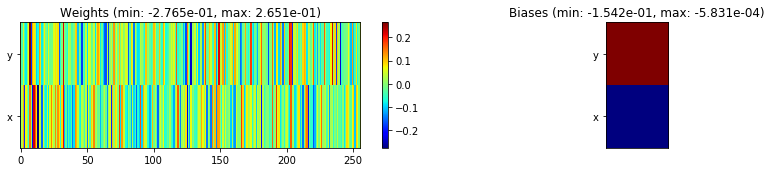

---------------------------------------------------------------------------------------------------------------
Elapsed time:  395.39 sec | TRAIN >> class loss: 0.5214 | steps:  2.650    | reward:  0.8252    | acc.: 82.518% 
                          | VAL   >> class loss: 0.4424 | steps:  2.445 :( | reward:  0.8508 :( | acc.: 85.080% :(


Epoch   8/400) lr = 0.0009434
 b    500/  3000 >> 128.1 ms/b | lr: 9.61e-04 | grad 2norm:  8.09 | grad inf norm:  1.920
       Weights || abs max:  1.12 (23816.57) | mean: -3.10e-04 ( 0.12) | var: 1.52e-02 (45688.18)
        Biases || abs max:  0.86 (  561.39) | mean: -2.07e-03 ( 0.59) | var: 1.08e-02 ( 3096.71)
                  class loss: 0.481 | steps: 2.609 | reward:  0.840 | acc.: 84.00%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.9 ms/b | lr: 9.79e-04 | grad 2norm:  8.06 | grad inf norm:  1.923
       Weights || abs max:  1.11 (32883.42) | mean: -2.52e-04 ( 0.13) | v

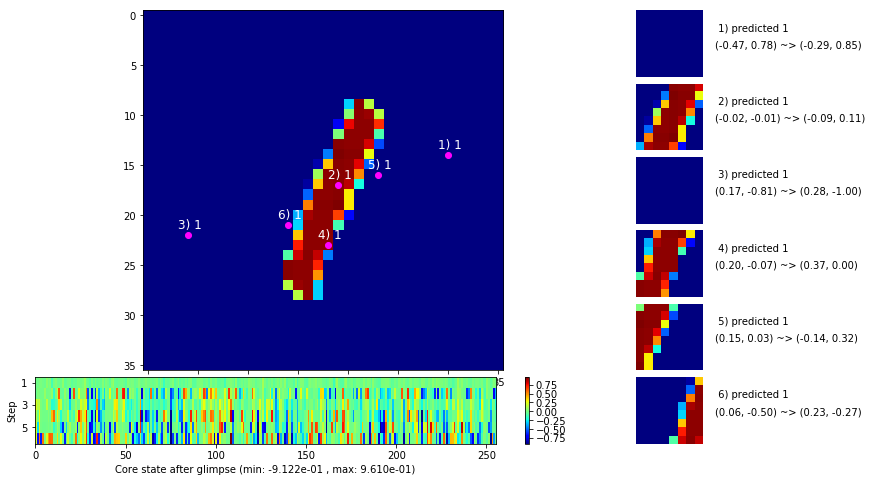

 b   1500/  3000 >> 129.2 ms/b | lr: 1.01e-03 | grad 2norm:  7.87 | grad inf norm:  1.925
       Weights || abs max:  1.12 (26765.78) | mean: -2.13e-04 ( 0.12) | var: 1.62e-02 (24752.91)
        Biases || abs max:  0.87 ( 4418.42) | mean: -8.85e-03 ( 3.51) | var: 1.21e-02 (5283710.50)
                  class loss: 0.459 | steps: 2.567 | reward:  0.849 | acc.: 84.86%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 126.7 ms/b | lr: 1.02e-03 | grad 2norm:  8.08 | grad inf norm:  1.878
       Weights || abs max:  1.13 (36549.49) | mean: -1.50e-04 ( 0.14) | var: 1.67e-02 (162723.86)
        Biases || abs max:  0.87 (  520.46) | mean: -1.19e-02 ( 0.58) | var: 1.28e-02 ( 3048.90)
                  class loss: 0.489 | steps: 2.608 | reward:  0.835 | acc.: 83.54%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

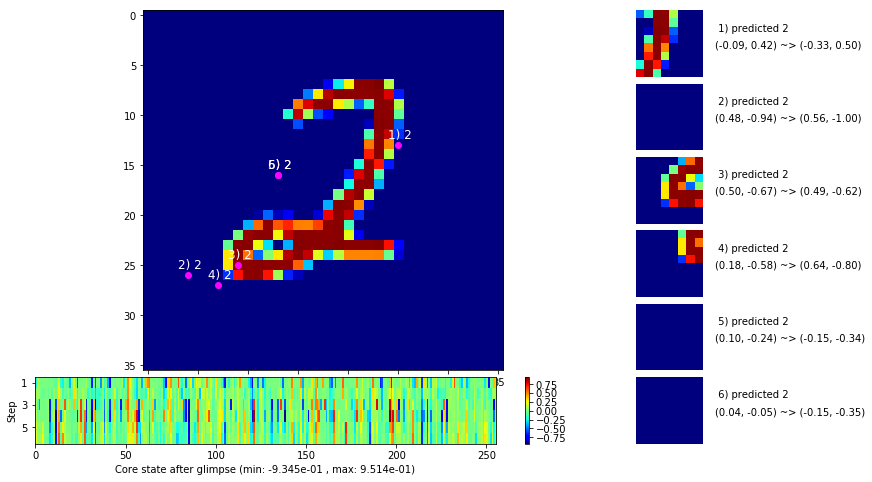

 b   2500/  3000 >> 138.2 ms/b | lr: 1.05e-03 | grad 2norm:  8.12 | grad inf norm:  2.008
       Weights || abs max:  1.18 (40000.36) | mean: -7.09e-05 ( 0.14) | var: 1.72e-02 (83082.70)
        Biases || abs max:  0.86 (  888.24) | mean: -1.51e-02 ( 0.71) | var: 1.36e-02 (15341.25)
                  class loss: 0.496 | steps: 2.603 | reward:  0.833 | acc.: 83.31%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 135.4 ms/b | lr: 1.07e-03 | grad 2norm:  8.02 | grad inf norm:  1.917
       Weights || abs max:  1.20 (61198.87) | mean: -6.01e-05 ( 0.18) | var: 1.78e-02 (655736.38)
        Biases || abs max:  0.87 (  507.58) | mean: -1.87e-02 ( 0.52) | var: 1.43e-02 ( 4516.36)
                  class loss: 0.485 | steps: 2.631 | reward:  0.838 | acc.: 83.79%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

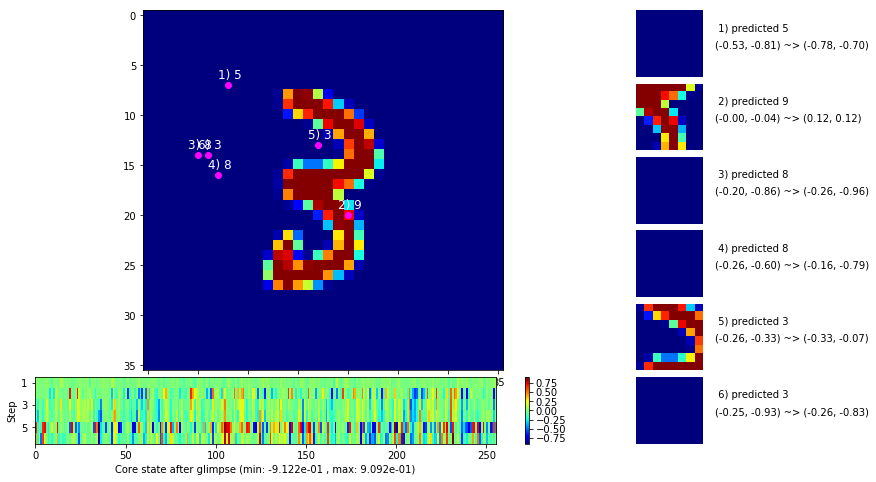

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


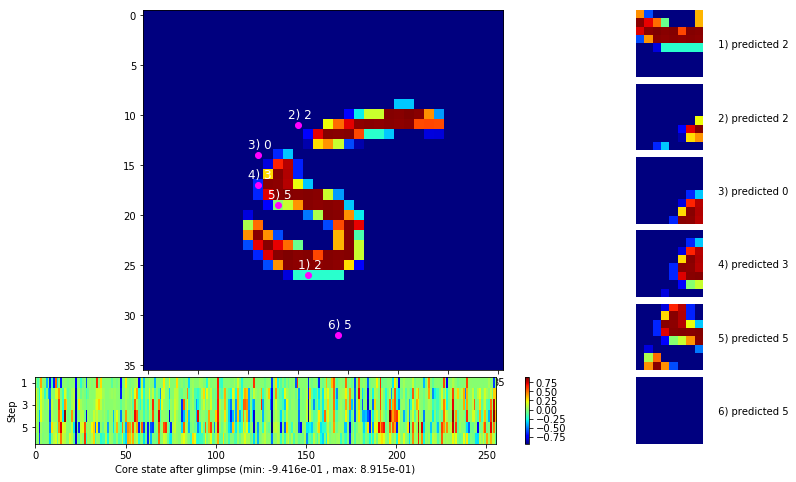


	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


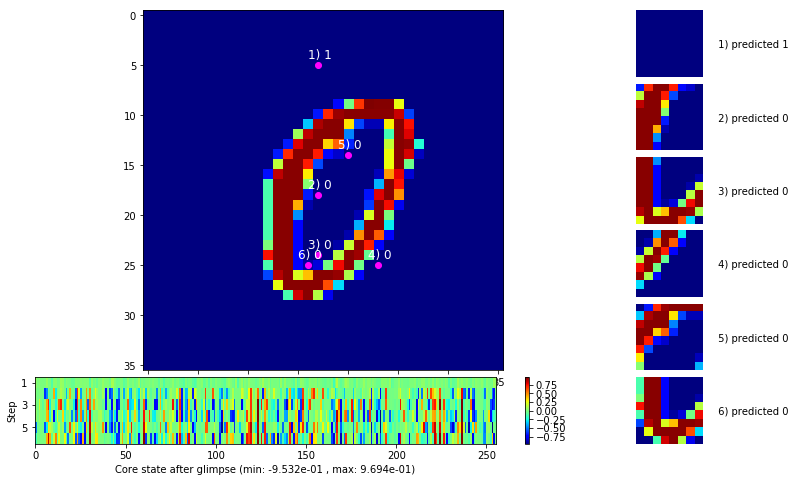

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


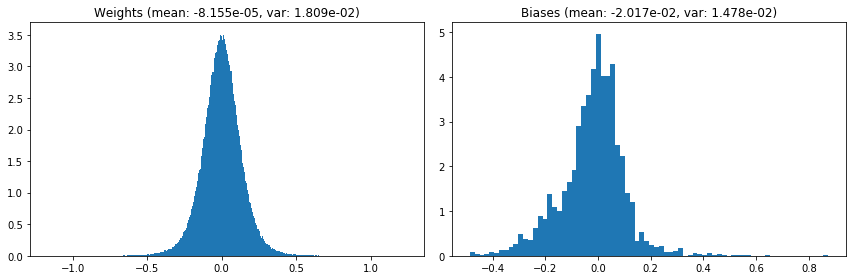

                                      Location network weights and biases


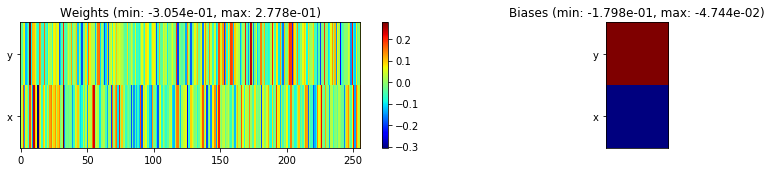

---------------------------------------------------------------------------------------------------------------
Elapsed time:  393.35 sec | TRAIN >> class loss: 0.4808 | steps:  2.603    | reward:  0.8394    | acc.: 83.942% 
                          | VAL   >> class loss: 0.3862 | steps:  2.397    | reward:  0.8754    | acc.: 87.540% 


Epoch   9/400) lr = 0.001061
 b    500/  3000 >> 127.5 ms/b | lr: 1.05e-03 | grad 2norm:  7.90 | grad inf norm:  1.838
       Weights || abs max:  1.25 (51350.45) | mean: -8.49e-05 ( 0.16) | var: 1.84e-02 (378771.59)
        Biases || abs max:  0.88 (  499.49) | mean: -2.14e-02 ( 0.56) | var: 1.51e-02 ( 7425.38)
                  class loss: 0.467 | steps: 2.563 | reward:  0.848 | acc.: 84.82%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.7 ms/b | lr: 1.03e-03 | grad 2norm:  7.99 | grad inf norm:  1.904
       Weights || abs max:  1.24 (21028.57) | mean: -1.46e-04 ( 0.10) | var

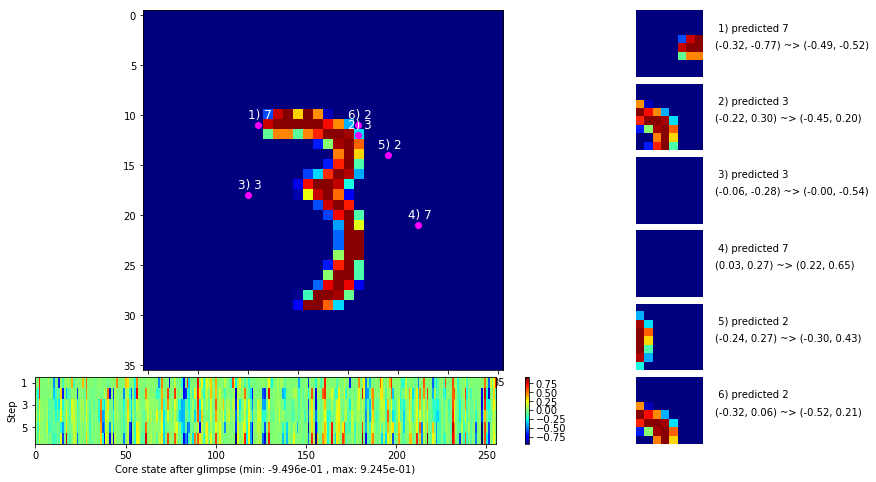

 b   1500/  3000 >> 128.1 ms/b | lr: 1.01e-03 | grad 2norm:  7.90 | grad inf norm:  1.823
       Weights || abs max:  1.23 (29302.26) | mean: -1.01e-04 ( 0.12) | var: 1.94e-02 (22946.72)
        Biases || abs max:  0.87 (  361.06) | mean: -2.76e-02 ( 0.45) | var: 1.68e-02 (  772.26)
                  class loss: 0.486 | steps: 2.567 | reward:  0.841 | acc.: 84.12%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 127.9 ms/b | lr: 9.98e-04 | grad 2norm:  7.71 | grad inf norm:  1.805
       Weights || abs max:  1.26 (26712.16) | mean: -6.12e-06 ( 0.12) | var: 1.99e-02 (25828.25)
        Biases || abs max:  0.88 (  639.37) | mean: -3.02e-02 ( 0.53) | var: 1.76e-02 (13682.92)
                  class loss: 0.450 | steps: 2.549 | reward:  0.855 | acc.: 85.49%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

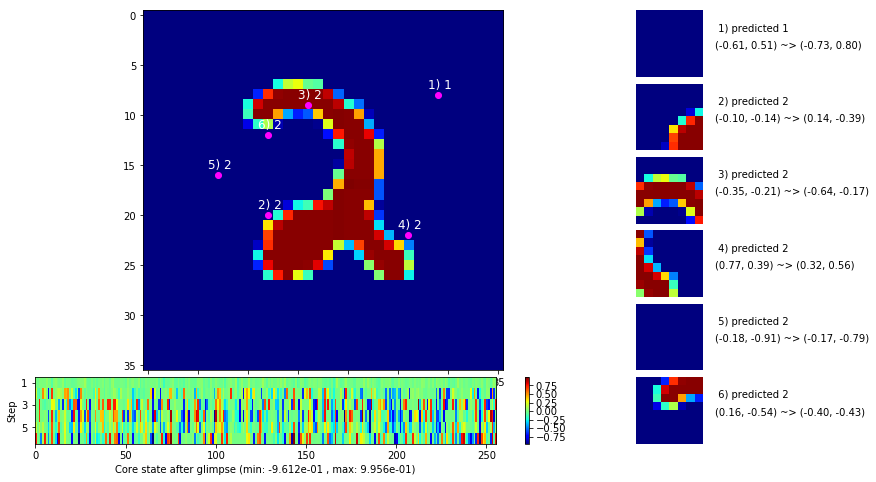

 b   2500/  3000 >> 129.8 ms/b | lr: 9.79e-04 | grad 2norm:  7.82 | grad inf norm:  1.873
       Weights || abs max:  1.28 (17857.64) | mean:  4.52e-06 ( 0.10) | var: 2.04e-02 ( 9933.13)
        Biases || abs max:  0.88 (  484.14) | mean: -3.21e-02 ( 0.48) | var: 1.81e-02 ( 2681.22)
                  class loss: 0.449 | steps: 2.538 | reward:  0.854 | acc.: 85.35%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.2 ms/b | lr: 9.66e-04 | grad 2norm:  7.96 | grad inf norm:  1.906
       Weights || abs max:  1.31 (67295.68) | mean:  1.78e-05 ( 0.19) | var: 2.09e-02 (1161357.62)
        Biases || abs max:  0.88 (  707.22) | mean: -3.32e-02 ( 0.52) | var: 1.87e-02 (21843.58)
                  class loss: 0.453 | steps: 2.537 | reward:  0.850 | acc.: 85.04%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

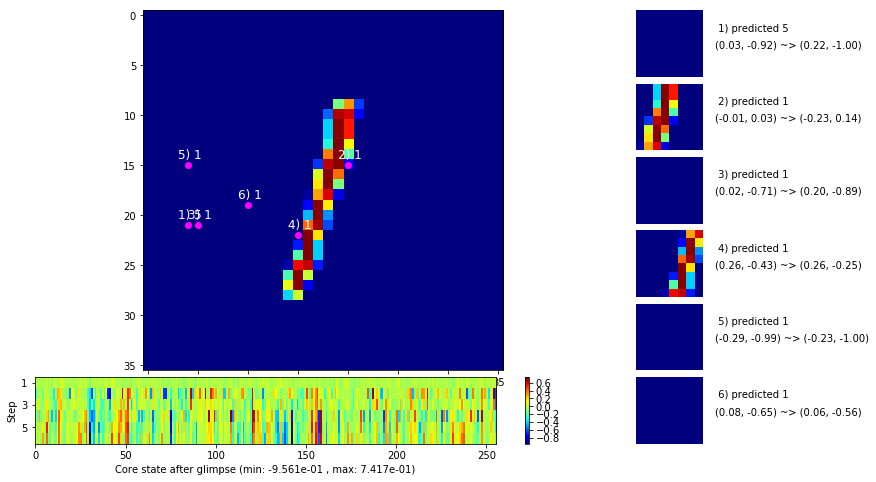

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


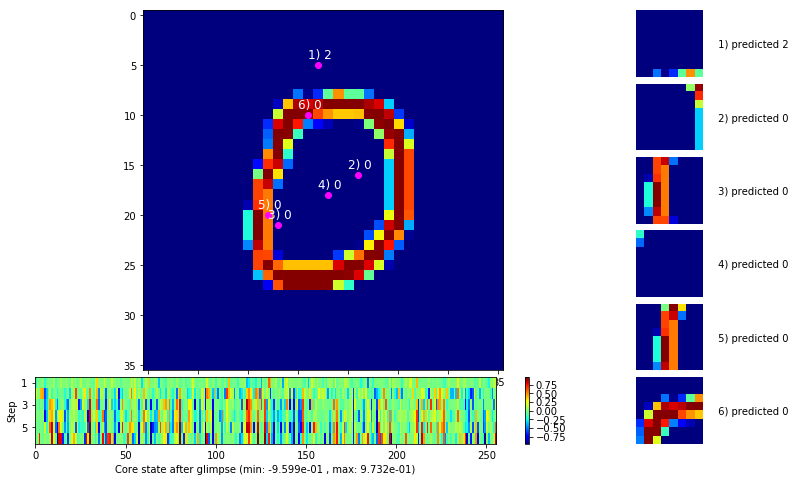


	Target class: 4  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


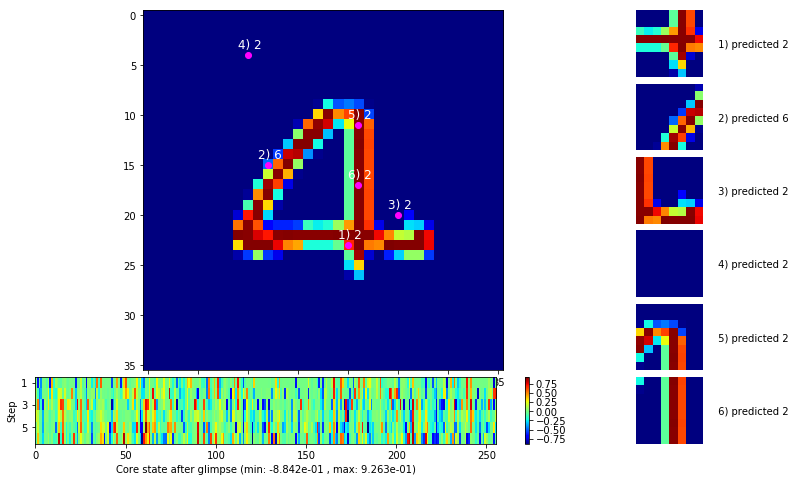

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


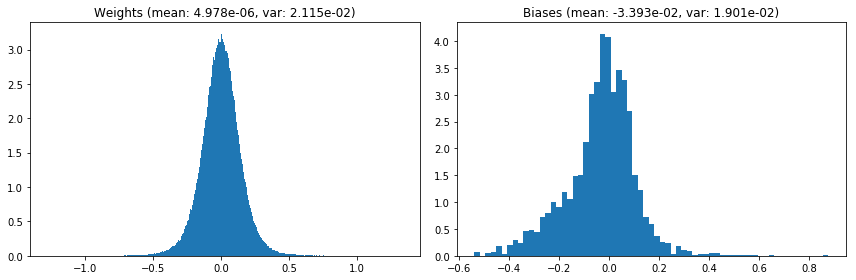

                                      Location network weights and biases


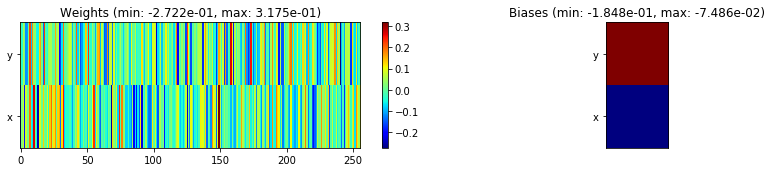

---------------------------------------------------------------------------------------------------------------
Elapsed time:  384.72 sec | TRAIN >> class loss: 0.4632 | steps:  2.549    | reward:  0.8488    | acc.: 84.877% 
                          | VAL   >> class loss: 0.3917 | steps:  2.388    | reward:  0.8738 :( | acc.: 87.380% :(


Epoch  10/400) lr = 0.0009602
 b    500/  3000 >> 127.5 ms/b | lr: 9.48e-04 | grad 2norm:  7.70 | grad inf norm:  1.833
       Weights || abs max:  1.35 (73065.98) | mean:  9.33e-06 ( 0.20) | var: 2.14e-02 (1052751.50)
        Biases || abs max:  0.88 (  416.02) | mean: -3.58e-02 ( 0.42) | var: 1.94e-02 ( 1254.78)
                  class loss: 0.457 | steps: 2.537 | reward:  0.852 | acc.: 85.19%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 136.5 ms/b | lr: 9.37e-04 | grad 2norm:  7.59 | grad inf norm:  1.820
       Weights || abs max:  1.38 (36011.63) | mean: -1.71e-05 ( 0.13) |

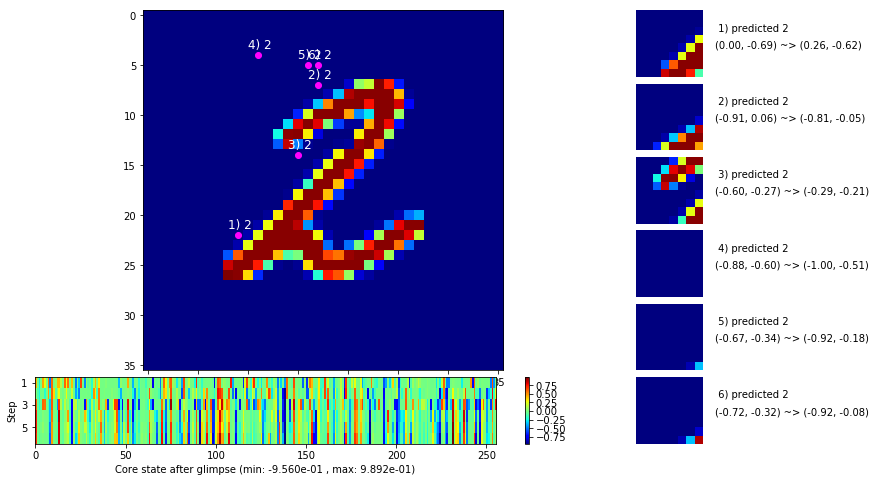

 b   1500/  3000 >> 134.8 ms/b | lr: 9.20e-04 | grad 2norm:  7.65 | grad inf norm:  1.877
       Weights || abs max:  1.38 (62639.52) | mean: -3.57e-05 ( 0.17) | var: 2.22e-02 (1714976.75)
        Biases || abs max:  0.87 (  448.19) | mean: -4.09e-02 ( 0.50) | var: 2.10e-02 ( 1962.93)
                  class loss: 0.482 | steps: 2.568 | reward:  0.841 | acc.: 84.11%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 127.2 ms/b | lr: 9.09e-04 | grad 2norm:  7.40 | grad inf norm:  1.793
       Weights || abs max:  1.39 (31452.74) | mean: -6.28e-05 ( 0.12) | var: 2.26e-02 (67639.15)
        Biases || abs max:  0.88 ( 1027.63) | mean: -4.26e-02 ( 0.91) | var: 2.17e-02 (93423.80)
                  class loss: 0.438 | steps: 2.507 | reward:  0.852 | acc.: 85.24%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.

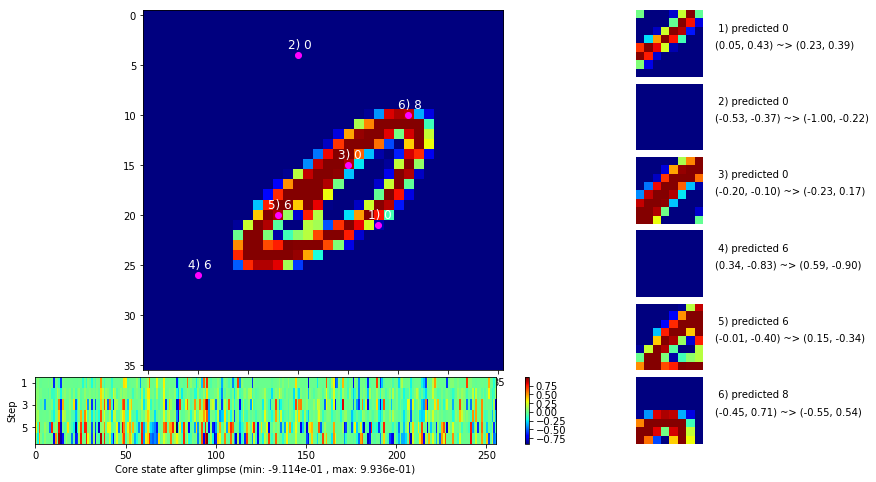

 b   2500/  3000 >> 127.5 ms/b | lr: 8.94e-04 | grad 2norm:  7.48 | grad inf norm:  1.802
       Weights || abs max:  1.39 (27676.13) | mean: -6.58e-05 ( 0.11) | var: 2.30e-02 (27750.91)
        Biases || abs max:  0.88 (  521.27) | mean: -4.36e-02 ( 0.52) | var: 2.21e-02 ( 4641.16)
                  class loss: 0.444 | steps: 2.521 | reward:  0.851 | acc.: 85.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.1 ms/b | lr: 8.83e-04 | grad 2norm:  7.22 | grad inf norm:  1.754
       Weights || abs max:  1.40 (30113.26) | mean: -5.79e-05 ( 0.12) | var: 2.34e-02 (66060.70)
        Biases || abs max:  0.88 (  541.08) | mean: -4.64e-02 ( 0.48) | var: 2.27e-02 ( 5112.97)
                  class loss: 0.433 | steps: 2.532 | reward:  0.860 | acc.: 85.99%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

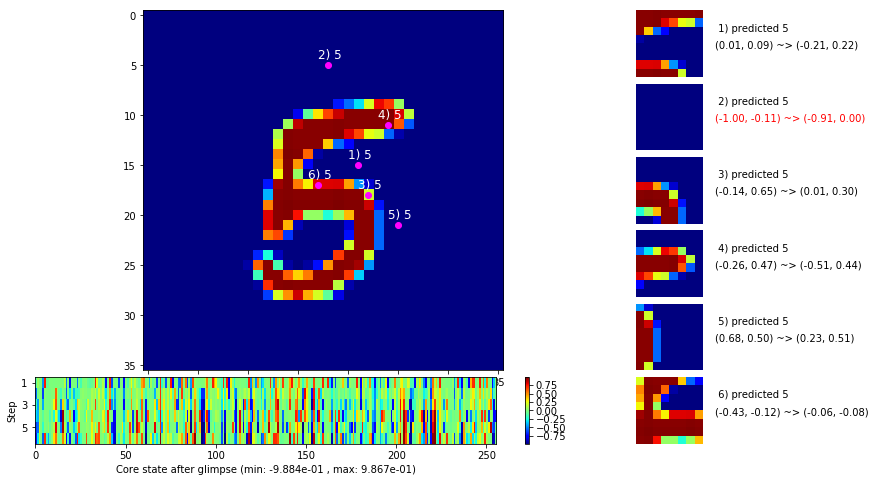

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


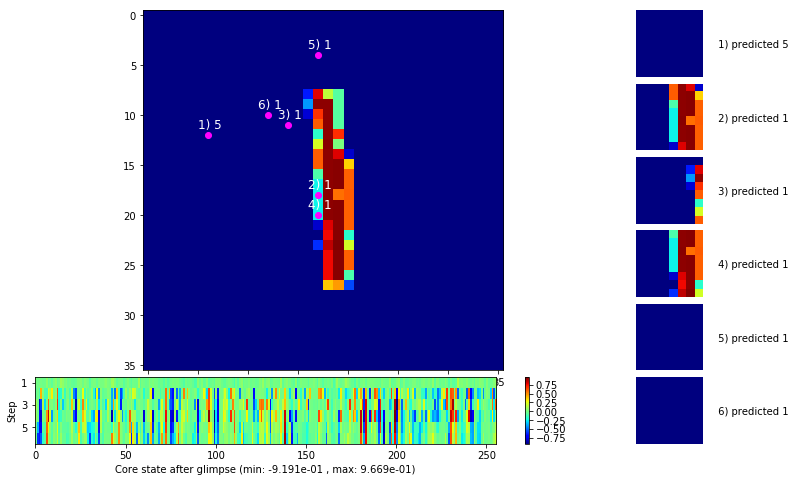


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


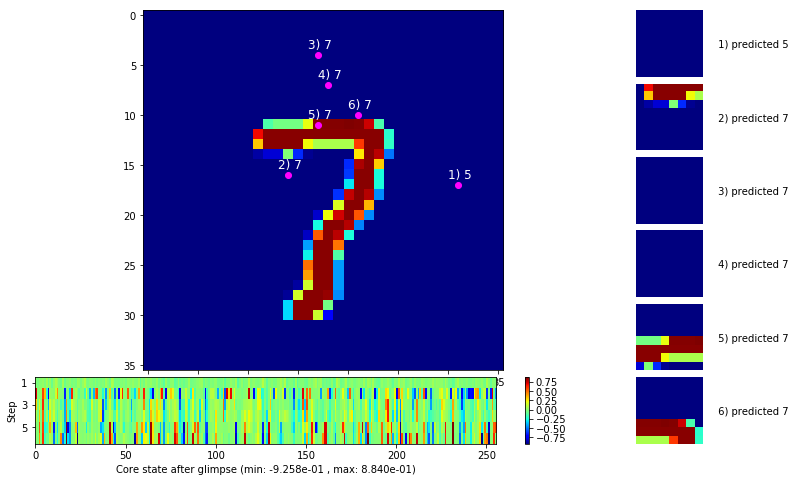

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


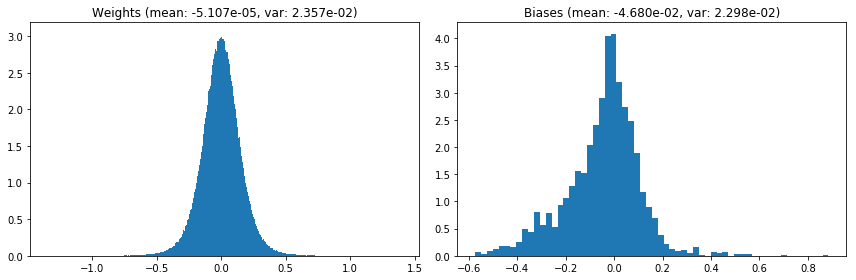

                                      Location network weights and biases


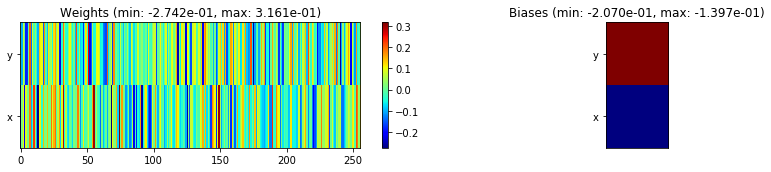

---------------------------------------------------------------------------------------------------------------
Elapsed time:  390.83 sec | TRAIN >> class loss: 0.4542 | steps:  2.533    | reward:  0.8507    | acc.: 85.072% 
                          | VAL   >> class loss: 0.3268 | steps:  2.346    | reward:  0.8940    | acc.: 89.400% 


Epoch  11/400) lr = 0.0008785
 b    500/  3000 >> 126.7 ms/b | lr: 8.69e-04 | grad 2norm:  7.41 | grad inf norm:  1.898
       Weights || abs max:  1.42 (32412.50) | mean: -5.94e-05 ( 0.12) | var: 2.38e-02 (32969.49)
        Biases || abs max:  0.88 ( 1857.94) | mean: -4.79e-02 ( 0.98) | var: 2.32e-02 (293864.69)
                  class loss: 0.427 | steps: 2.513 | reward:  0.859 | acc.: 85.93%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.1 ms/b | lr: 8.59e-04 | grad 2norm:  7.17 | grad inf norm:  1.755
       Weights || abs max:  1.44 (19494.31) | mean: -6.77e-05 ( 0.10) | va

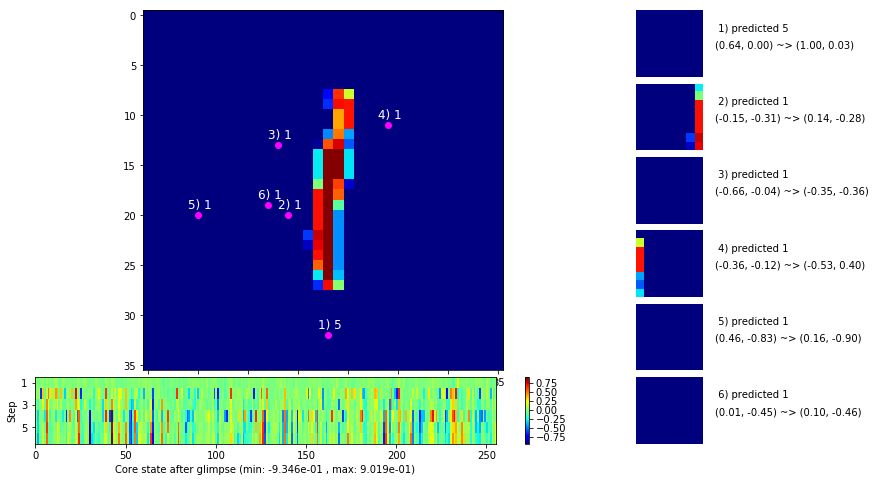

 b   1500/  3000 >> 127.1 ms/b | lr: 8.45e-04 | grad 2norm:  7.13 | grad inf norm:  1.832
       Weights || abs max:  1.44 (48052.24) | mean: -7.89e-05 ( 0.15) | var: 2.45e-02 (305901.66)
        Biases || abs max:  0.89 (  519.86) | mean: -5.08e-02 ( 0.57) | var: 2.41e-02 ( 8177.22)
                  class loss: 0.408 | steps: 2.492 | reward:  0.868 | acc.: 86.76%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 126.8 ms/b | lr: 8.36e-04 | grad 2norm:  7.15 | grad inf norm:  1.787
       Weights || abs max:  1.43 (48939.71) | mean: -9.91e-05 ( 0.15) | var: 2.48e-02 (351128.66)
        Biases || abs max:  0.89 (  384.58) | mean: -5.20e-02 ( 0.44) | var: 2.45e-02 (  892.27)
                  class loss: 0.414 | steps: 2.487 | reward:  0.864 | acc.: 86.37%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

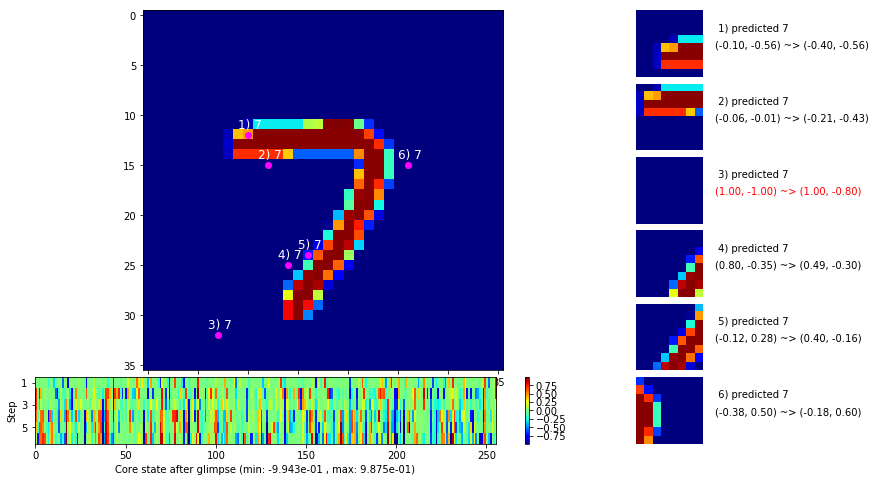

 b   2500/  3000 >> 133.8 ms/b | lr: 8.23e-04 | grad 2norm:  7.10 | grad inf norm:  1.737
       Weights || abs max:  1.43 (27420.14) | mean: -1.09e-04 ( 0.11) | var: 2.52e-02 (129345.88)
        Biases || abs max:  0.89 (  280.61) | mean: -5.35e-02 ( 0.36) | var: 2.51e-02 ( 1170.82)
                  class loss: 0.413 | steps: 2.525 | reward:  0.865 | acc.: 86.52%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 137.4 ms/b | lr: 8.15e-04 | grad 2norm:  6.99 | grad inf norm:  1.761
       Weights || abs max:  1.46 (20142.31) | mean: -1.27e-04 ( 0.10) | var: 2.55e-02 ( 8560.23)
        Biases || abs max:  0.89 (  485.97) | mean: -5.41e-02 ( 0.41) | var: 2.56e-02 ( 6567.23)
                  class loss: 0.401 | steps: 2.489 | reward:  0.872 | acc.: 87.23%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

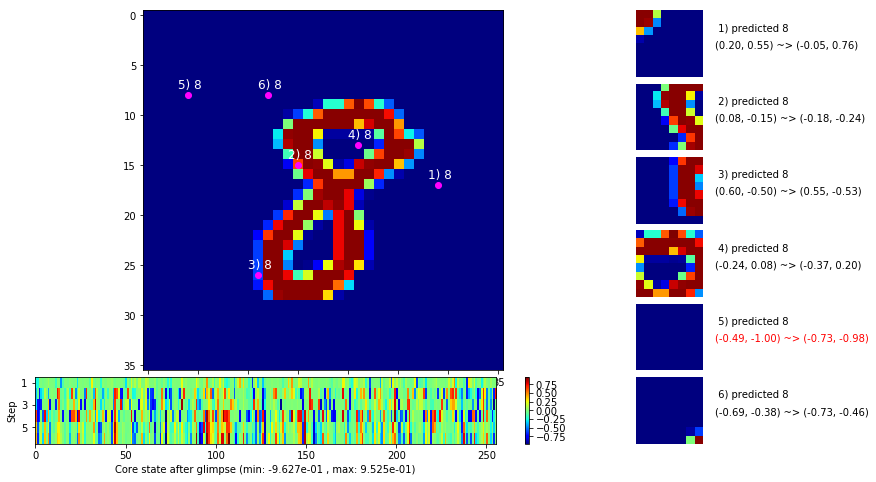

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


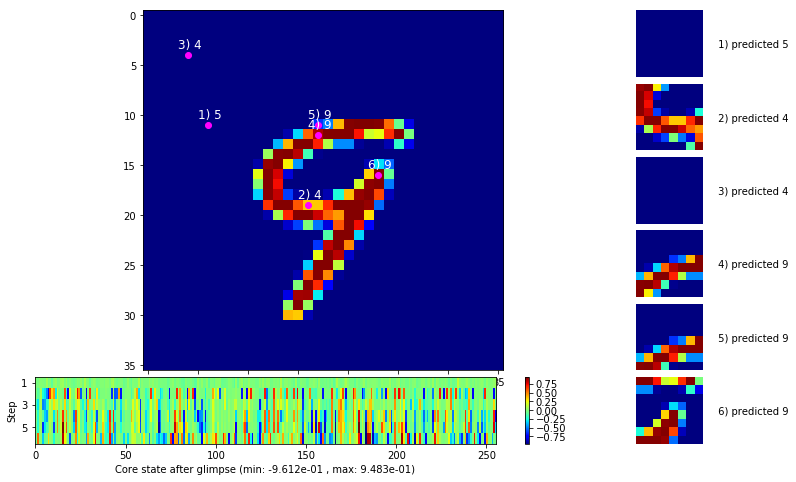


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


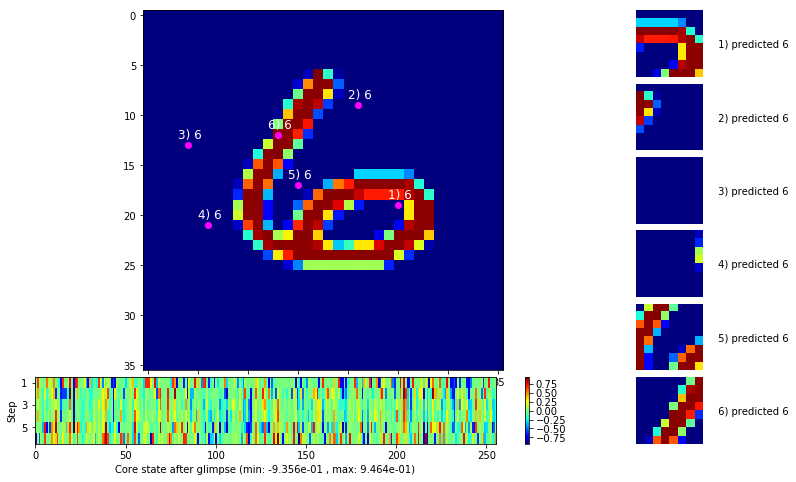

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


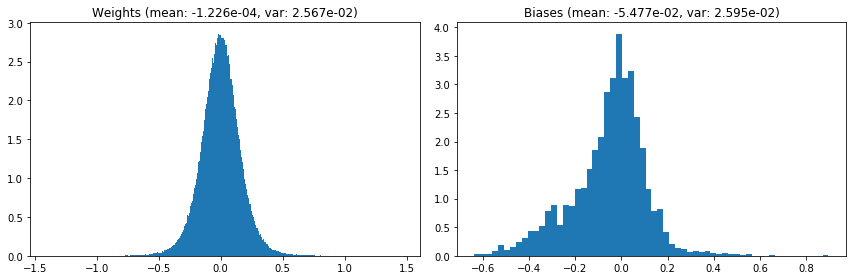

                                      Location network weights and biases


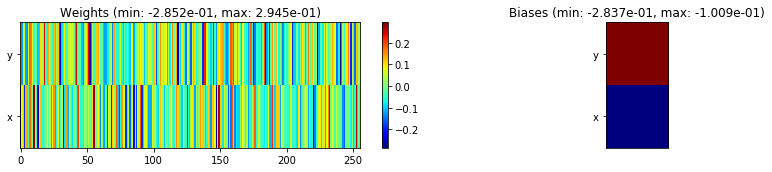

---------------------------------------------------------------------------------------------------------------
Elapsed time:  390.59 sec | TRAIN >> class loss: 0.4116 | steps:  2.502    | reward:  0.8660    | acc.: 86.600% 
                          | VAL   >> class loss: 0.2939 | steps:  2.297    | reward:  0.9036    | acc.: 90.360% 


Epoch  12/400) lr = 0.0008106
 b    500/  3000 >> 129.5 ms/b | lr: 8.02e-04 | grad 2norm:  7.07 | grad inf norm:  1.749
       Weights || abs max:  1.47 (29623.99) | mean: -1.64e-04 ( 0.12) | var: 2.58e-02 (30016.16)
        Biases || abs max:  0.90 (  365.50) | mean: -5.55e-02 ( 0.40) | var: 2.62e-02 ( 1538.54)
                  class loss: 0.403 | steps: 2.500 | reward:  0.872 | acc.: 87.21%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.9 ms/b | lr: 7.94e-04 | grad 2norm:  6.93 | grad inf norm:  1.706
       Weights || abs max:  1.49 (21466.62) | mean: -1.87e-04 ( 0.10) | var

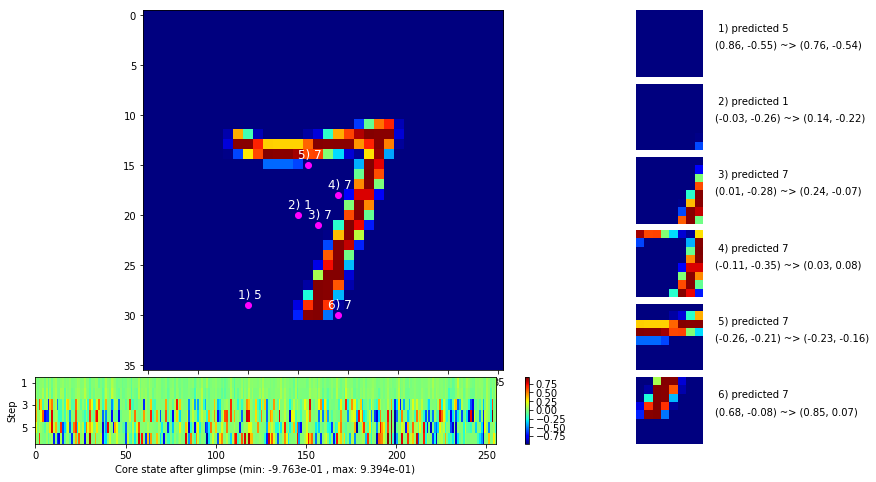

 b   1500/  3000 >> 126.5 ms/b | lr: 7.83e-04 | grad 2norm:  6.81 | grad inf norm:  1.642
       Weights || abs max:  1.50 (25032.97) | mean: -2.10e-04 ( 0.11) | var: 2.64e-02 (15015.69)
        Biases || abs max:  0.90 (  297.37) | mean: -5.77e-02 ( 0.34) | var: 2.69e-02 (  412.62)
                  class loss: 0.368 | steps: 2.484 | reward:  0.880 | acc.: 88.04%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 126.0 ms/b | lr: 7.75e-04 | grad 2norm:  6.90 | grad inf norm:  1.765
       Weights || abs max:  1.50 (22234.03) | mean: -2.14e-04 ( 0.10) | var: 2.67e-02 (12677.01)
        Biases || abs max:  0.90 (  535.68) | mean: -5.85e-02 ( 0.52) | var: 2.73e-02 ( 6979.59)
                  class loss: 0.370 | steps: 2.468 | reward:  0.880 | acc.: 87.99%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

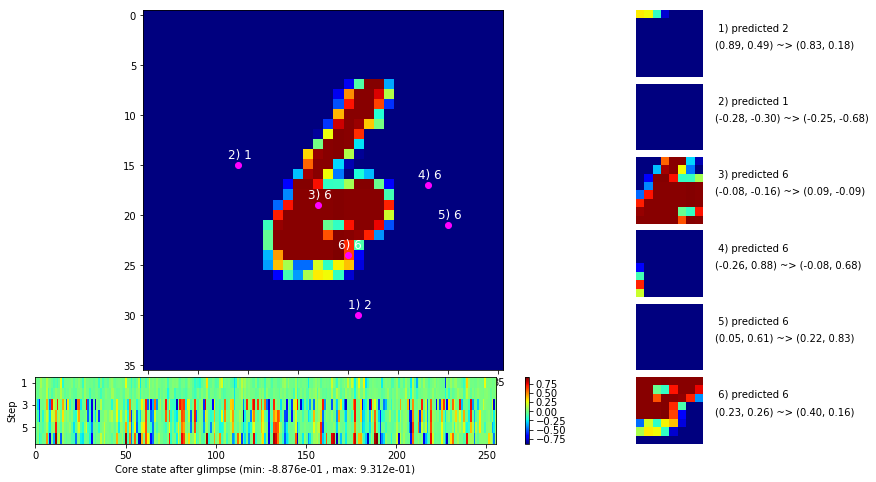

 b   2500/  3000 >> 126.8 ms/b | lr: 7.64e-04 | grad 2norm:  7.12 | grad inf norm:  1.770
       Weights || abs max:  1.52 (29048.67) | mean: -1.72e-04 ( 0.11) | var: 2.70e-02 (80510.72)
        Biases || abs max:  0.90 (  380.92) | mean: -5.95e-02 ( 0.40) | var: 2.75e-02 ( 2628.54)
                  class loss: 0.382 | steps: 2.489 | reward:  0.870 | acc.: 86.95%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.6 ms/b | lr: 7.57e-04 | grad 2norm:  6.81 | grad inf norm:  1.655
       Weights || abs max:  1.54 (45423.09) | mean: -1.66e-04 ( 0.14) | var: 2.72e-02 (346151.41)
        Biases || abs max:  0.90 (  407.29) | mean: -6.03e-02 ( 0.44) | var: 2.78e-02 ( 3881.80)
                  class loss: 0.364 | steps: 2.456 | reward:  0.881 | acc.: 88.08%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

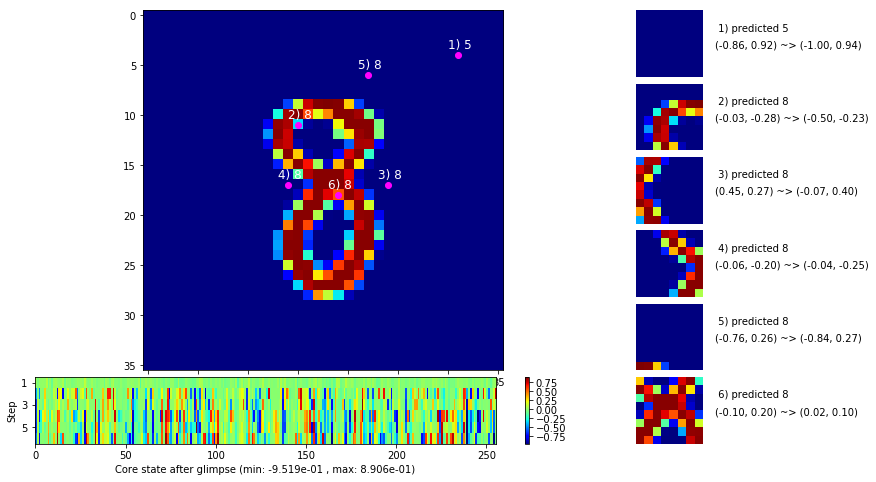

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


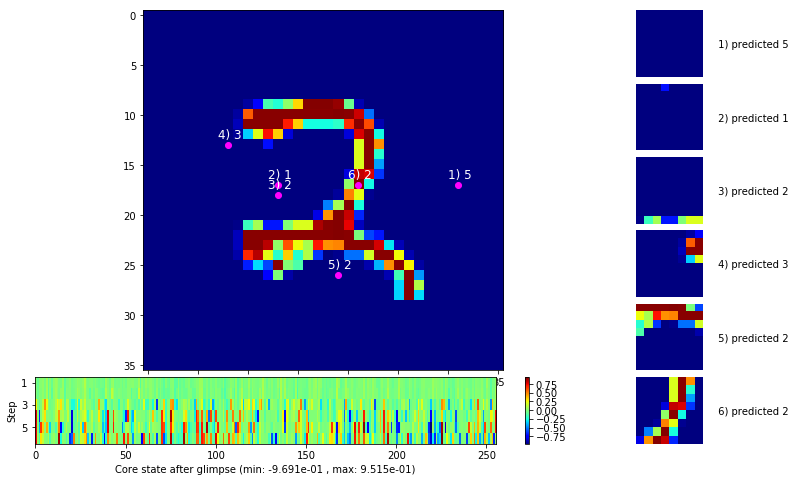


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


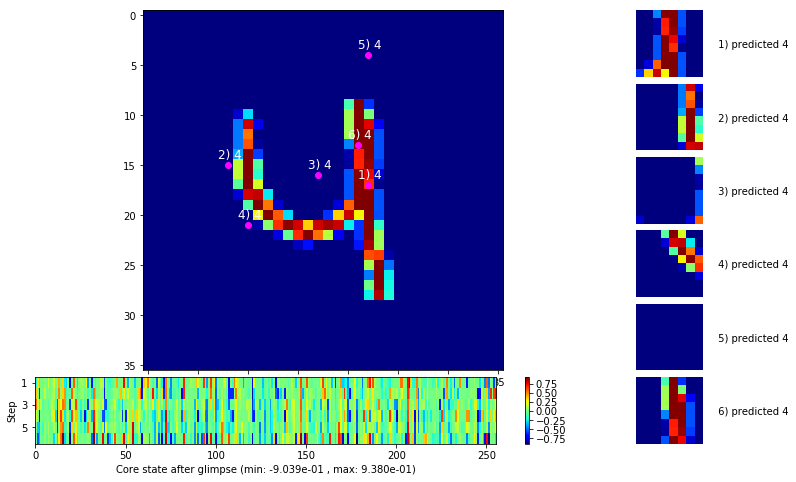

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


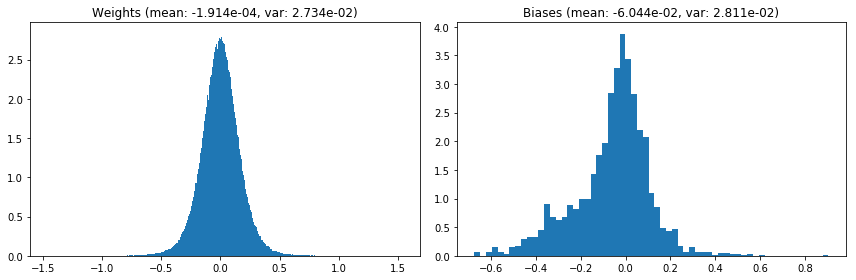

                                      Location network weights and biases


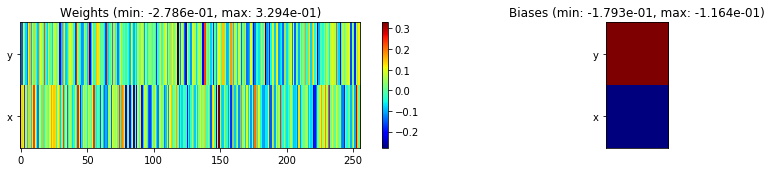

---------------------------------------------------------------------------------------------------------------
Elapsed time:  382.70 sec | TRAIN >> class loss: 0.3810 | steps:  2.484    | reward:  0.8760    | acc.: 87.598% 
                          | VAL   >> class loss: 0.2632 | steps:  2.238    | reward:  0.9158    | acc.: 91.580% 


Epoch  13/400) lr = 0.0007531
 b    500/  3000 >> 125.0 ms/b | lr: 7.46e-04 | grad 2norm:  7.01 | grad inf norm:  1.769
       Weights || abs max:  1.52 (73410.23) | mean: -2.01e-04 ( 0.20) | var: 2.75e-02 (1232384.38)
        Biases || abs max:  0.90 ( 1510.93) | mean: -6.11e-02 ( 0.85) | var: 2.82e-02 (299565.31)
                  class loss: 0.376 | steps: 2.471 | reward:  0.875 | acc.: 87.55%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.5 ms/b | lr: 7.39e-04 | grad 2norm:  6.69 | grad inf norm:  1.678
       Weights || abs max:  1.52 (21282.88) | mean: -2.07e-04 ( 0.10) | 

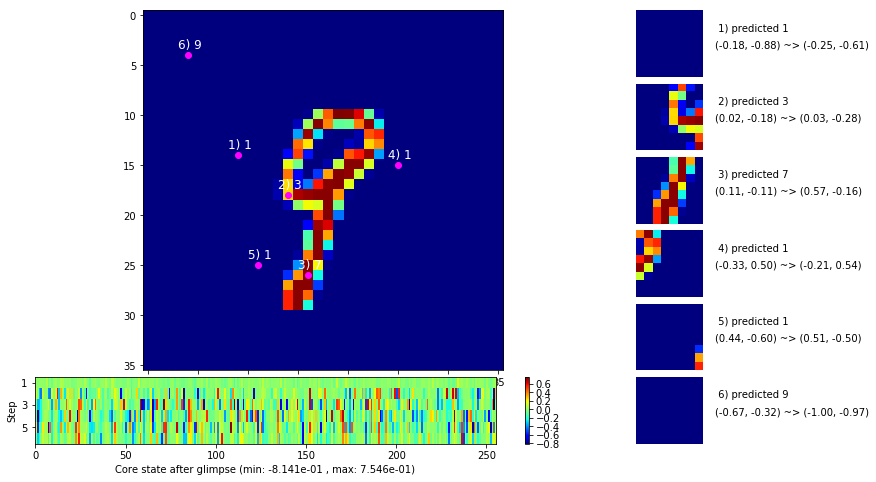

 b   1500/  3000 >> 140.4 ms/b | lr: 7.29e-04 | grad 2norm:  6.89 | grad inf norm:  1.708
       Weights || abs max:  1.52 (33716.48) | mean: -2.28e-04 ( 0.13) | var: 2.80e-02 (76129.20)
        Biases || abs max:  0.90 (  368.80) | mean: -6.36e-02 ( 0.37) | var: 2.89e-02 (  965.27)
                  class loss: 0.372 | steps: 2.413 | reward:  0.878 | acc.: 87.79%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 126.3 ms/b | lr: 7.23e-04 | grad 2norm:  6.66 | grad inf norm:  1.619
       Weights || abs max:  1.53 (28572.43) | mean: -1.90e-04 ( 0.12) | var: 2.82e-02 (63789.09)
        Biases || abs max:  0.90 (  360.16) | mean: -6.45e-02 ( 0.38) | var: 2.93e-02 (  773.00)
                  class loss: 0.374 | steps: 2.424 | reward:  0.882 | acc.: 88.19%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

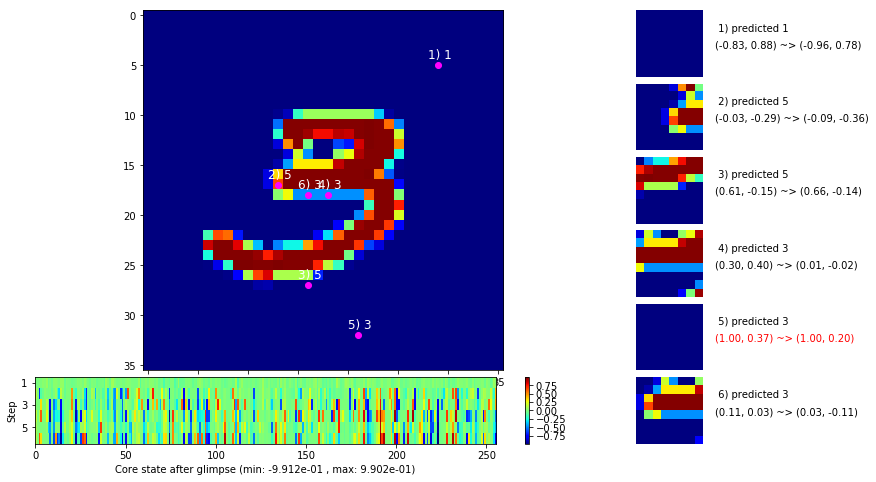

 b   2500/  3000 >> 129.2 ms/b | lr: 7.13e-04 | grad 2norm:  6.73 | grad inf norm:  1.672
       Weights || abs max:  1.53 (23308.10) | mean: -2.03e-04 ( 0.11) | var: 2.84e-02 (12682.13)
        Biases || abs max:  0.90 (  357.90) | mean: -6.47e-02 ( 0.40) | var: 2.96e-02 ( 1183.79)
                  class loss: 0.353 | steps: 2.406 | reward:  0.882 | acc.: 88.17%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 125.1 ms/b | lr: 7.07e-04 | grad 2norm:  6.95 | grad inf norm:  1.710
       Weights || abs max:  1.54 (21913.77) | mean: -1.94e-04 ( 0.10) | var: 2.87e-02 ( 7313.48)
        Biases || abs max:  0.90 (  266.45) | mean: -6.54e-02 ( 0.34) | var: 3.00e-02 (  698.00)
                  class loss: 0.382 | steps: 2.432 | reward:  0.875 | acc.: 87.50%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

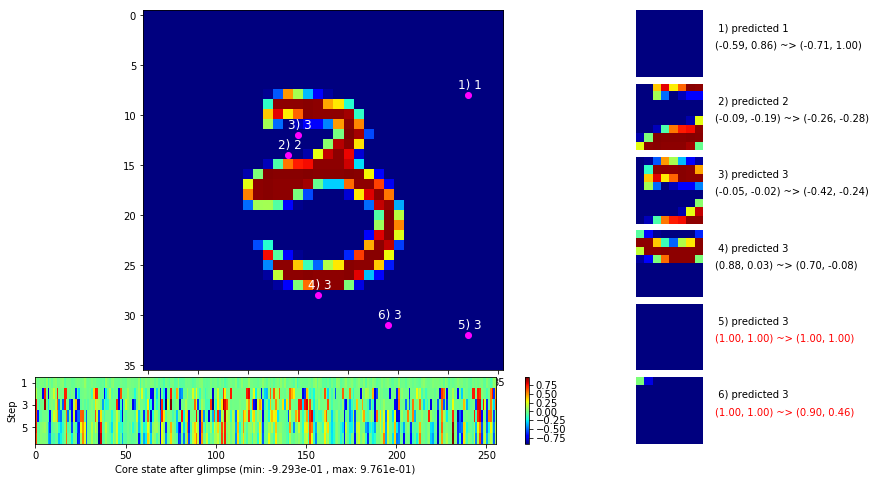

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


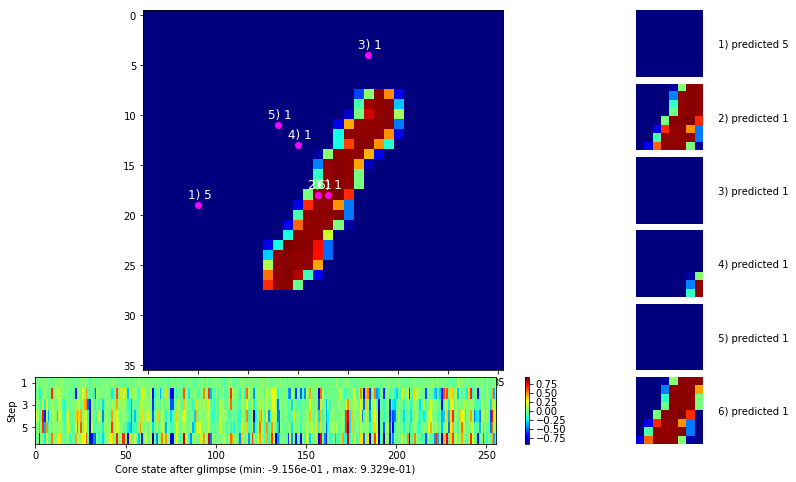


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


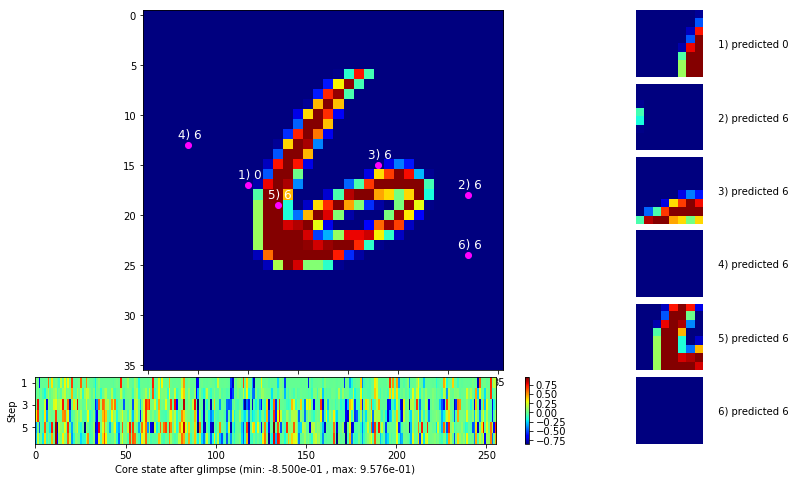

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


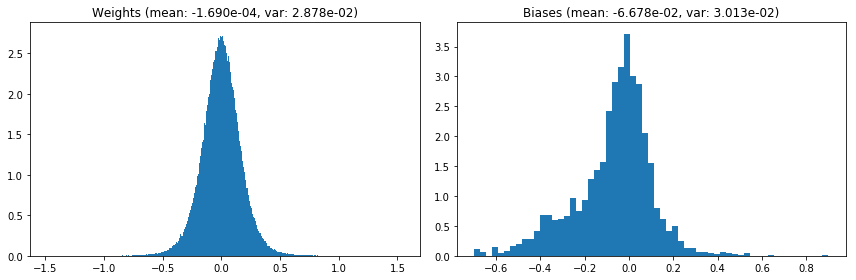

                                      Location network weights and biases


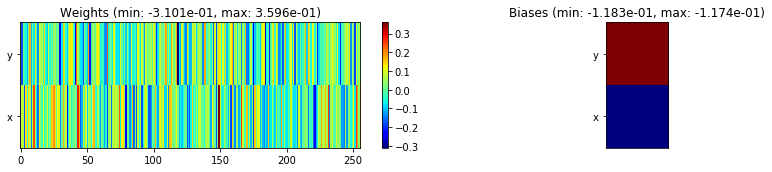

---------------------------------------------------------------------------------------------------------------
Elapsed time:  387.37 sec | TRAIN >> class loss: 0.3714 | steps:  2.428    | reward:  0.8788    | acc.: 87.878% 
                          | VAL   >> class loss: 0.2862 | steps:  2.233    | reward:  0.9036 :( | acc.: 90.360% :(


Epoch  14/400) lr = 0.0007038
 b    500/  3000 >> 127.0 ms/b | lr: 6.98e-04 | grad 2norm:  6.86 | grad inf norm:  1.774
       Weights || abs max:  1.55 (33356.19) | mean: -1.59e-04 ( 0.12) | var: 2.89e-02 (54179.37)
        Biases || abs max:  0.90 (  206.24) | mean: -6.71e-02 ( 0.31) | var: 3.03e-02 (  238.23)
                  class loss: 0.386 | steps: 2.424 | reward:  0.877 | acc.: 87.70%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 134.5 ms/b | lr: 6.92e-04 | grad 2norm:  6.56 | grad inf norm:  1.657
       Weights || abs max:  1.58 (33316.58) | mean: -8.82e-05 ( 0.12) | v

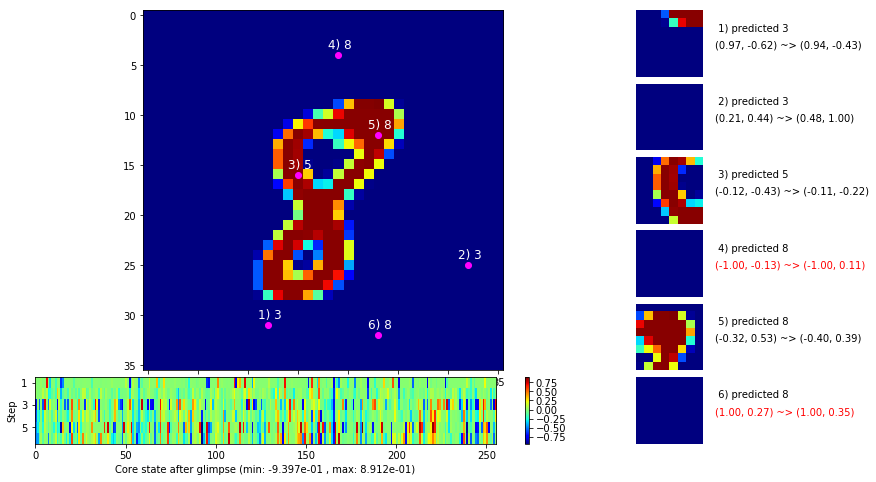

 b   1500/  3000 >> 144.6 ms/b | lr: 6.83e-04 | grad 2norm:  6.64 | grad inf norm:  1.675
       Weights || abs max:  1.60 (106127.72) | mean: -4.43e-05 ( 0.25) | var: 2.93e-02 (2498111.25)
        Biases || abs max:  0.90 (  756.98) | mean: -6.75e-02 ( 0.54) | var: 3.09e-02 (22152.33)
                  class loss: 0.357 | steps: 2.411 | reward:  0.884 | acc.: 88.40%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 125.8 ms/b | lr: 6.77e-04 | grad 2norm:  6.50 | grad inf norm:  1.600
       Weights || abs max:  1.62 (46017.88) | mean: -9.98e-06 ( 0.15) | var: 2.95e-02 (569204.19)
        Biases || abs max:  0.90 (  386.64) | mean: -6.86e-02 ( 0.42) | var: 3.14e-02 ( 2231.42)
                  class loss: 0.346 | steps: 2.425 | reward:  0.890 | acc.: 88.97%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 

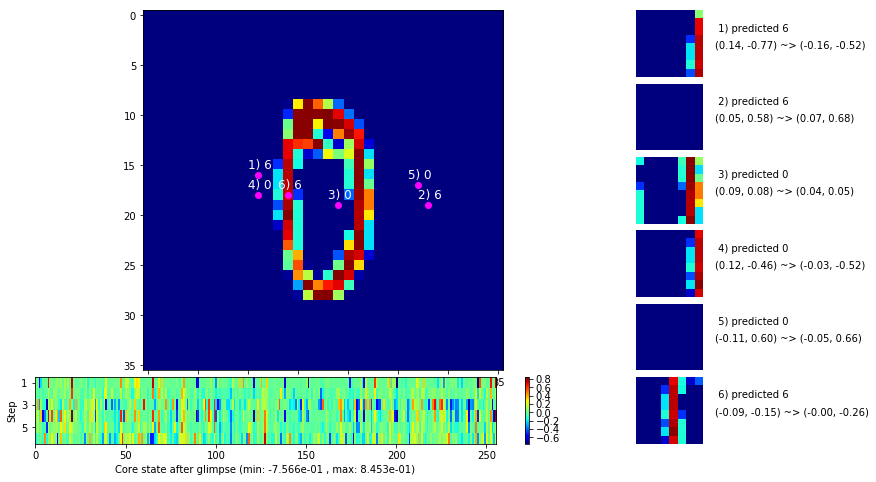

 b   2500/  3000 >> 128.5 ms/b | lr: 6.69e-04 | grad 2norm:  6.41 | grad inf norm:  1.608
       Weights || abs max:  1.62 (38006.24) | mean: -5.12e-05 ( 0.13) | var: 2.97e-02 (248433.17)
        Biases || abs max:  0.90 (  335.46) | mean: -7.01e-02 ( 0.36) | var: 3.18e-02 (  938.40)
                  class loss: 0.335 | steps: 2.401 | reward:  0.890 | acc.: 89.01%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.1 ms/b | lr: 6.64e-04 | grad 2norm:  6.62 | grad inf norm:  1.688
       Weights || abs max:  1.61 (127534.15) | mean: -5.66e-05 ( 0.30) | var: 2.99e-02 (10305599.00)
        Biases || abs max:  0.90 (  448.97) | mean: -7.07e-02 ( 0.46) | var: 3.23e-02 ( 3629.10)
                  class loss: 0.345 | steps: 2.393 | reward:  0.885 | acc.: 88.54%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

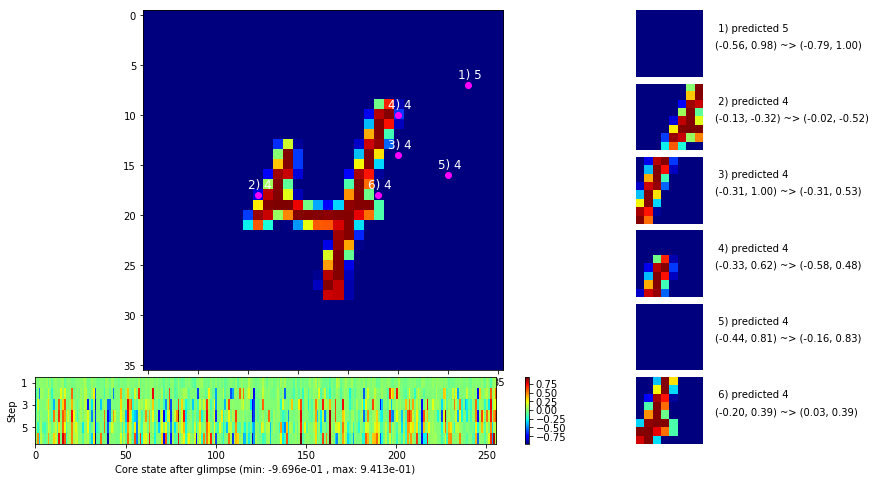

                                          ---===  VALIDATION  ===---

	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


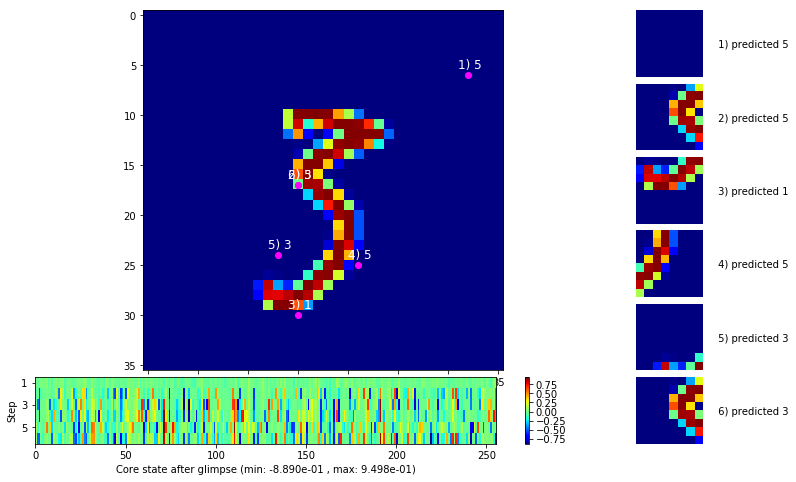


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


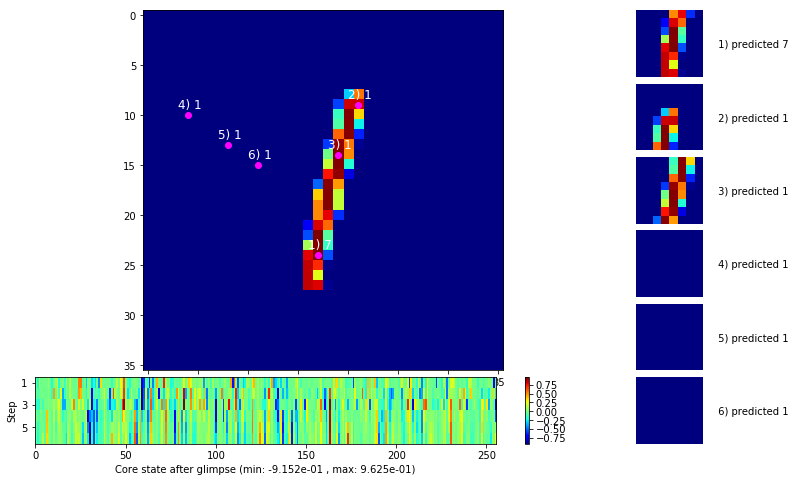

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


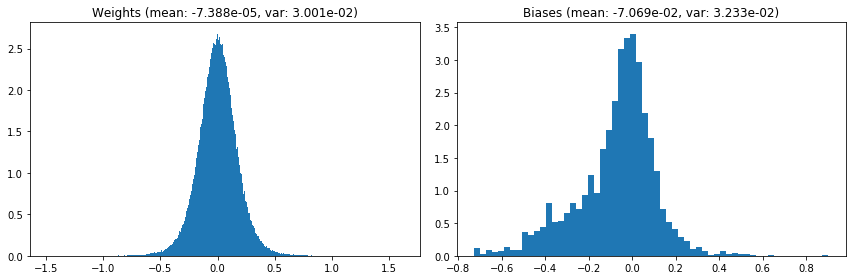

                                      Location network weights and biases


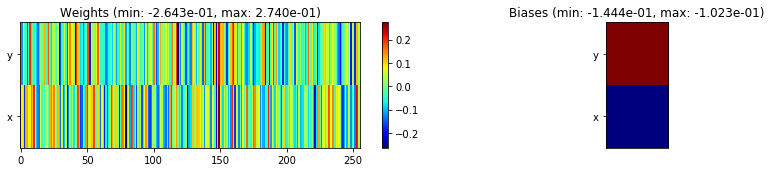

---------------------------------------------------------------------------------------------------------------
Elapsed time:  400.78 sec | TRAIN >> class loss: 0.3542 | steps:  2.411    | reward:  0.8855    | acc.: 88.550% 
                          | VAL   >> class loss: 0.2443 | steps:  2.233    | reward:  0.9216    | acc.: 92.160% 


Epoch  15/400) lr = 0.0006611
 b    500/  3000 >> 125.7 ms/b | lr: 6.56e-04 | grad 2norm:  6.62 | grad inf norm:  1.660
       Weights || abs max:  1.61 (23652.40) | mean: -6.53e-05 ( 0.11) | var: 3.01e-02 (15371.01)
        Biases || abs max:  0.90 (  298.43) | mean: -7.16e-02 ( 0.38) | var: 3.25e-02 ( 1753.23)
                  class loss: 0.351 | steps: 2.420 | reward:  0.886 | acc.: 88.64%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.9 ms/b | lr: 6.51e-04 | grad 2norm:  6.57 | grad inf norm:  1.631
       Weights || abs max:  1.62 (30032.46) | mean: -3.78e-05 ( 0.12) | var

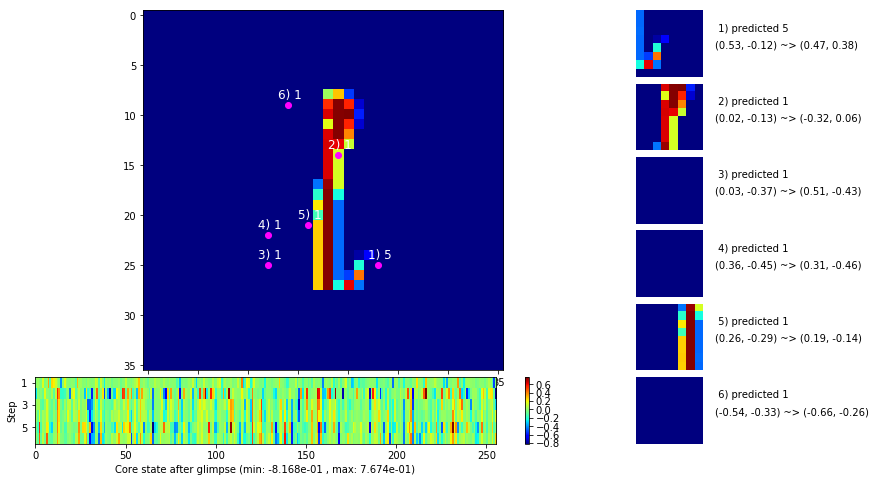

 b   1500/  3000 >> 129.7 ms/b | lr: 6.43e-04 | grad 2norm:  6.50 | grad inf norm:  1.662
       Weights || abs max:  1.63 (29200.51) | mean: -1.69e-05 ( 0.12) | var: 3.05e-02 (33360.49)
        Biases || abs max:  0.91 (  420.32) | mean: -7.32e-02 ( 0.42) | var: 3.31e-02 ( 1674.23)
                  class loss: 0.347 | steps: 2.402 | reward:  0.888 | acc.: 88.79%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.1 ms/b | lr: 6.38e-04 | grad 2norm:  6.58 | grad inf norm:  1.666
       Weights || abs max:  1.62 (29663.46) | mean: -3.22e-05 ( 0.12) | var: 3.07e-02 (54031.17)
        Biases || abs max:  0.91 (  812.80) | mean: -7.41e-02 ( 0.57) | var: 3.35e-02 (13718.25)
                  class loss: 0.351 | steps: 2.409 | reward:  0.885 | acc.: 88.50%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

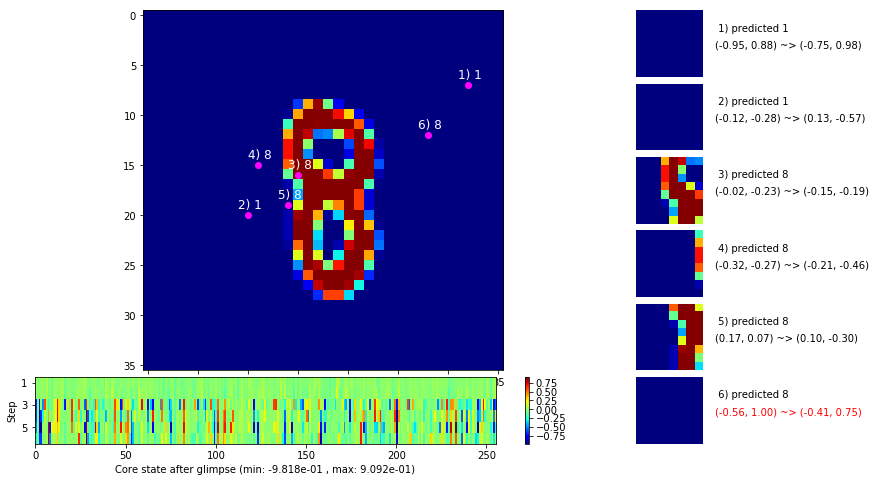

 b   2500/  3000 >> 129.6 ms/b | lr: 6.31e-04 | grad 2norm:  6.66 | grad inf norm:  1.673
       Weights || abs max:  1.63 (27410.91) | mean: -4.29e-05 ( 0.11) | var: 3.08e-02 (21260.87)
        Biases || abs max:  0.91 (  239.70) | mean: -7.45e-02 ( 0.30) | var: 3.37e-02 (  201.77)
                  class loss: 0.357 | steps: 2.424 | reward:  0.884 | acc.: 88.42%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 126.3 ms/b | lr: 6.26e-04 | grad 2norm:  6.24 | grad inf norm:  1.524
       Weights || abs max:  1.61 (159678.98) | mean: -3.38e-05 ( 0.35) | var: 3.10e-02 (14246942.00)
        Biases || abs max:  0.91 (  378.32) | mean: -7.47e-02 ( 0.38) | var: 3.39e-02 ( 2631.15)
                  class loss: 0.313 | steps: 2.392 | reward:  0.895 | acc.: 89.55%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

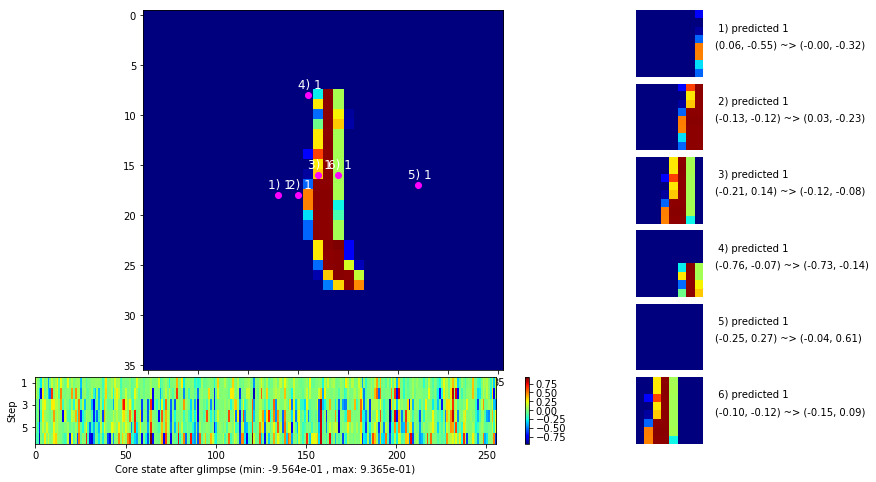

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


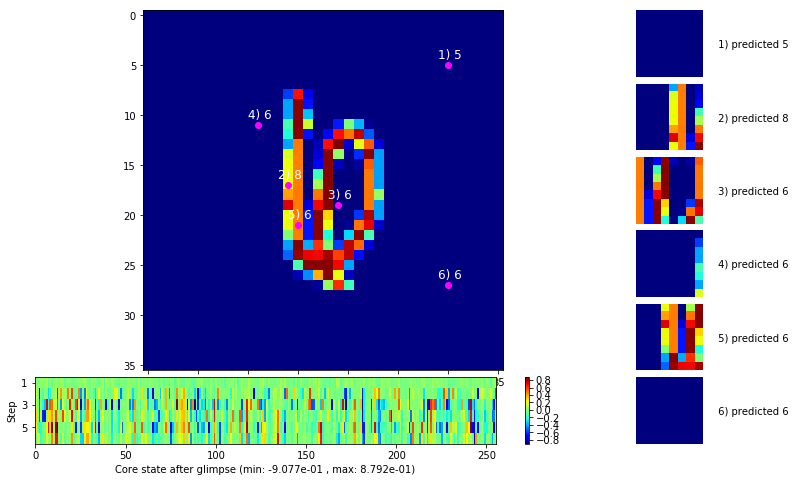


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


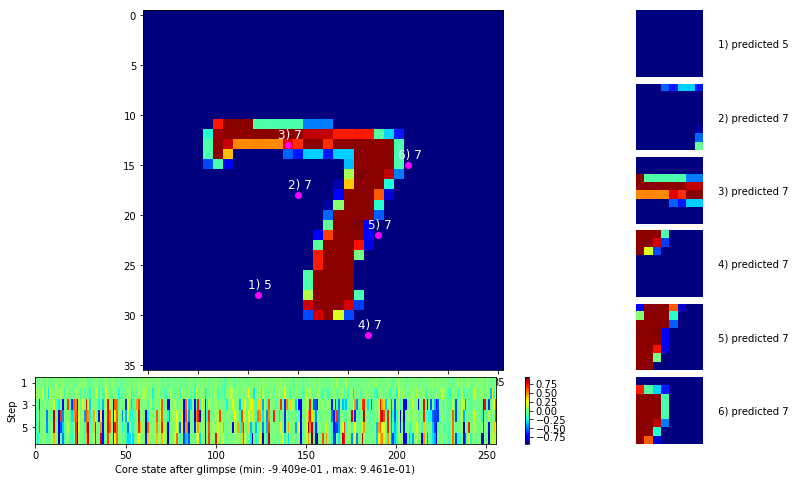

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


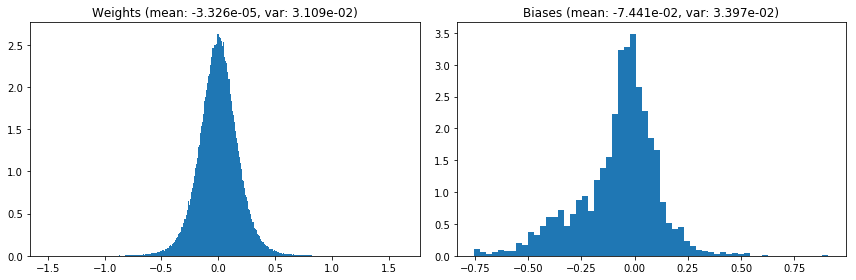

                                      Location network weights and biases


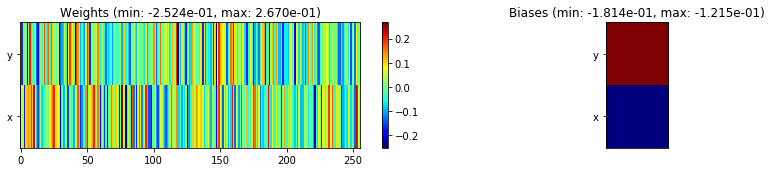

---------------------------------------------------------------------------------------------------------------
Elapsed time:  384.79 sec | TRAIN >> class loss: 0.3419 | steps:  2.409    | reward:  0.8880    | acc.: 88.798% 
                          | VAL   >> class loss: 0.2338 | steps:  2.179    | reward:  0.9244    | acc.: 92.440% 


Epoch  16/400) lr = 0.0006236
 b    500/  3000 >> 127.1 ms/b | lr: 6.19e-04 | grad 2norm:  6.36 | grad inf norm:  1.534
       Weights || abs max:  1.61 (28083.27) | mean: -3.84e-05 ( 0.11) | var: 3.12e-02 (27819.59)
        Biases || abs max:  0.91 (  465.54) | mean: -7.49e-02 ( 0.39) | var: 3.41e-02 ( 4870.53)
                  class loss: 0.327 | steps: 2.365 | reward:  0.894 | acc.: 89.37%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.6 ms/b | lr: 6.14e-04 | grad 2norm:  6.36 | grad inf norm:  1.564
       Weights || abs max:  1.60 (45381.86) | mean: -4.98e-05 ( 0.15) | var

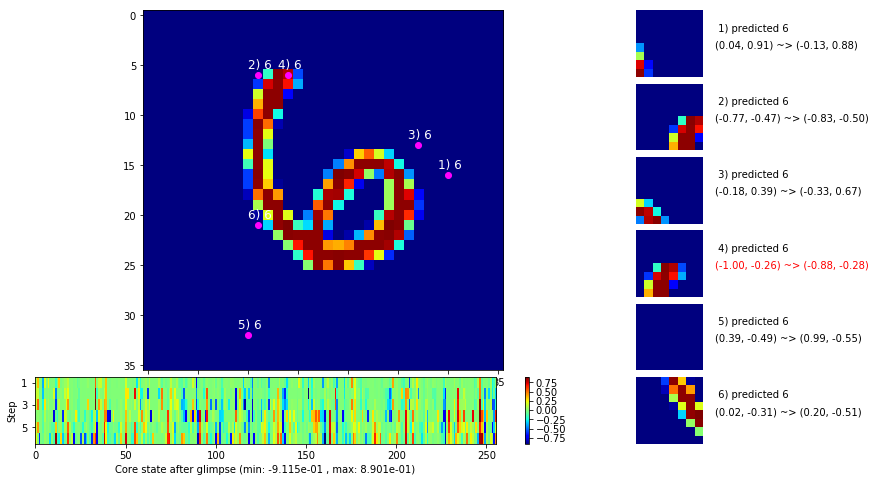

 b   1500/  3000 >> 144.1 ms/b | lr: 6.08e-04 | grad 2norm:  6.33 | grad inf norm:  1.581
       Weights || abs max:  1.60 (19431.64) | mean: -7.93e-05 ( 0.10) | var: 3.15e-02 ( 9735.86)
        Biases || abs max:  0.91 (  659.45) | mean: -7.67e-02 ( 0.49) | var: 3.47e-02 (12624.86)
                  class loss: 0.326 | steps: 2.357 | reward:  0.896 | acc.: 89.60%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 125.8 ms/b | lr: 6.03e-04 | grad 2norm:  6.56 | grad inf norm:  1.638
       Weights || abs max:  1.61 (33929.95) | mean: -5.37e-05 ( 0.13) | var: 3.16e-02 (60616.16)
        Biases || abs max:  0.91 (  470.70) | mean: -7.68e-02 ( 0.40) | var: 3.48e-02 ( 3139.17)
                  class loss: 0.329 | steps: 2.351 | reward:  0.892 | acc.: 89.17%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

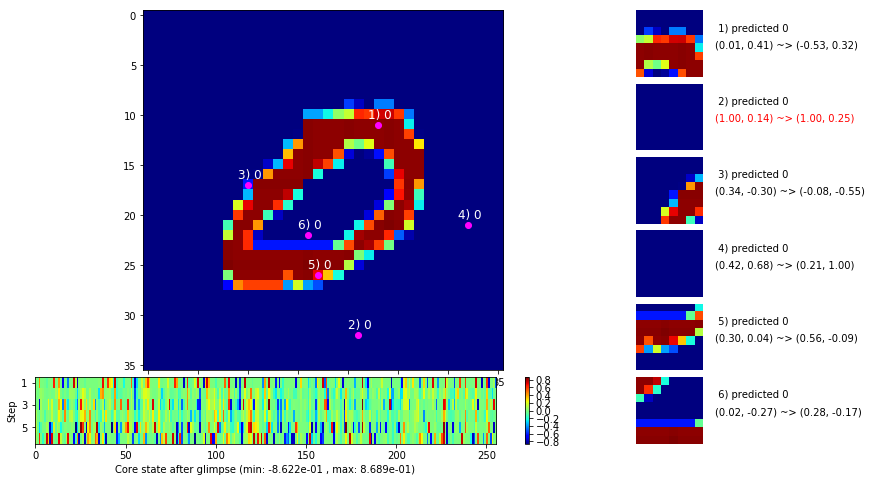

 b   2500/  3000 >> 127.8 ms/b | lr: 5.97e-04 | grad 2norm:  6.35 | grad inf norm:  1.539
       Weights || abs max:  1.61 (25295.87) | mean: -6.96e-05 ( 0.11) | var: 3.18e-02 (15774.34)
        Biases || abs max:  0.91 (  334.66) | mean: -7.72e-02 ( 0.35) | var: 3.52e-02 (  680.30)
                  class loss: 0.322 | steps: 2.347 | reward:  0.895 | acc.: 89.51%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.4 ms/b | lr: 5.93e-04 | grad 2norm:  6.09 | grad inf norm:  1.500
       Weights || abs max:  1.62 (65879.88) | mean: -4.00e-05 ( 0.19) | var: 3.20e-02 (687493.12)
        Biases || abs max:  0.92 (  361.35) | mean: -7.77e-02 ( 0.41) | var: 3.55e-02 ( 6484.95)
                  class loss: 0.308 | steps: 2.345 | reward:  0.901 | acc.: 90.13%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

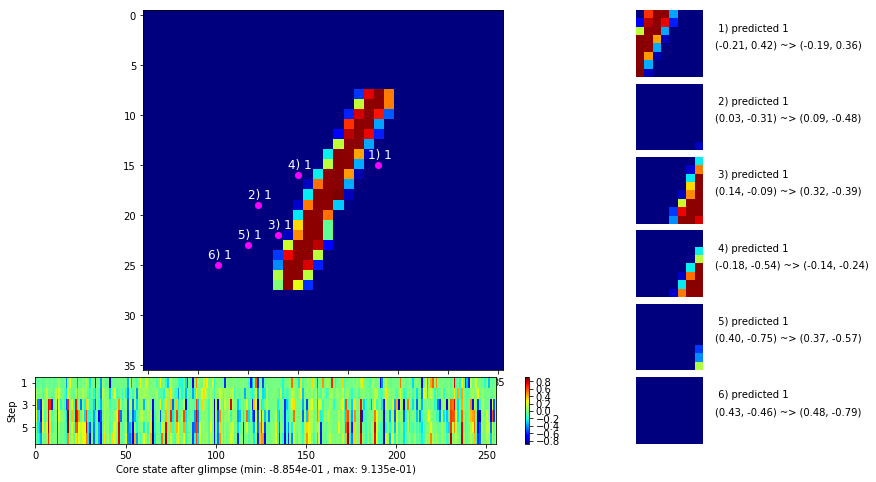

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


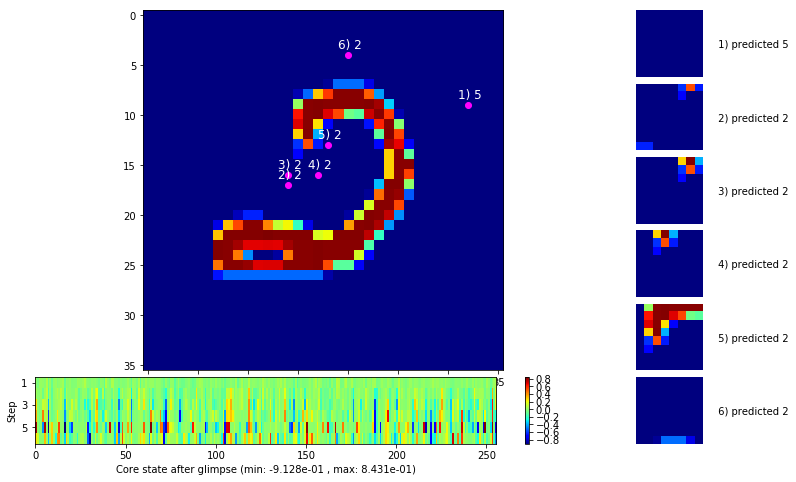


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


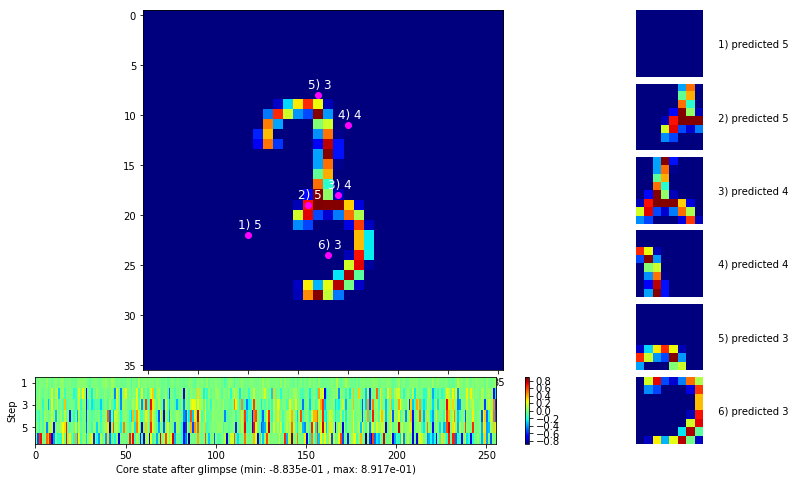

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


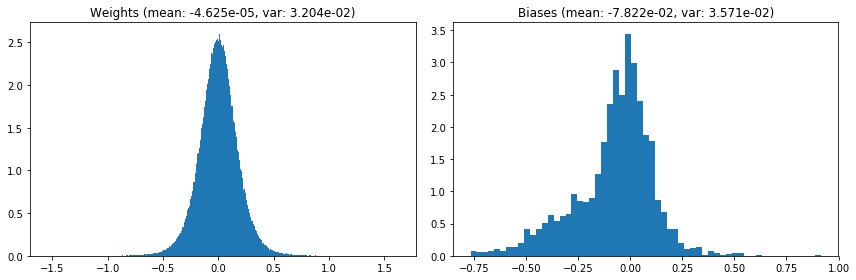

                                      Location network weights and biases


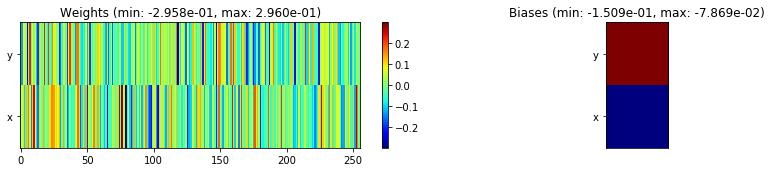

---------------------------------------------------------------------------------------------------------------
Elapsed time:  391.43 sec | TRAIN >> class loss: 0.3244 | steps:  2.361    | reward:  0.8953    | acc.: 89.528% 
                          | VAL   >> class loss: 0.2270 | steps:  2.142    | reward:  0.9260    | acc.: 92.600% 


Epoch  17/400) lr = 0.0005904
 b    500/  3000 >> 128.8 ms/b | lr: 5.86e-04 | grad 2norm:  6.18 | grad inf norm:  1.501
       Weights || abs max:  1.63 (25747.99) | mean: -4.09e-05 ( 0.11) | var: 3.21e-02 (10583.16)
        Biases || abs max:  0.92 (  213.54) | mean: -7.84e-02 ( 0.28) | var: 3.58e-02 (  226.46)
                  class loss: 0.311 | steps: 2.326 | reward:  0.900 | acc.: 90.01%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 126.7 ms/b | lr: 5.82e-04 | grad 2norm:  6.15 | grad inf norm:  1.524
       Weights || abs max:  1.64 (48477.98) | mean: -3.23e-05 ( 0.15) | var

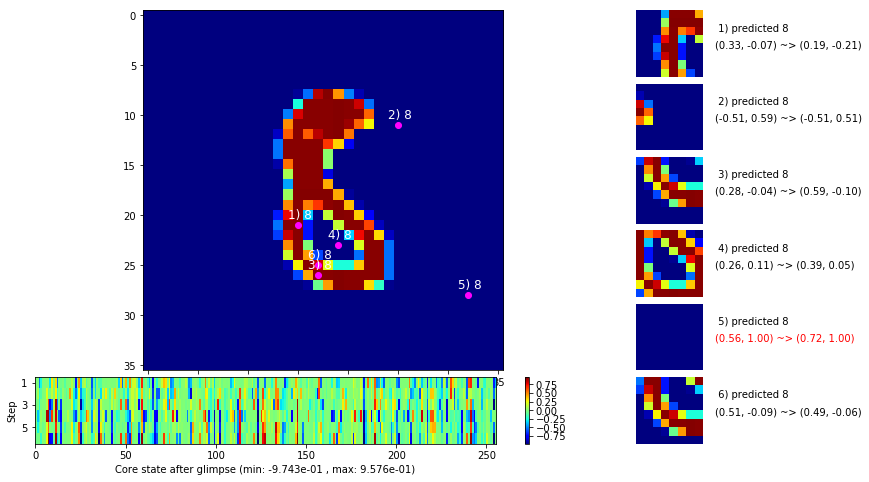

 b   1500/  3000 >> 128.0 ms/b | lr: 5.76e-04 | grad 2norm:  6.26 | grad inf norm:  1.543
       Weights || abs max:  1.63 (30396.67) | mean: -4.50e-05 ( 0.12) | var: 3.24e-02 (25964.95)
        Biases || abs max:  0.92 (  340.70) | mean: -7.91e-02 ( 0.37) | var: 3.61e-02 ( 1696.01)
                  class loss: 0.313 | steps: 2.359 | reward:  0.897 | acc.: 89.75%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 127.1 ms/b | lr: 5.72e-04 | grad 2norm:  6.09 | grad inf norm:  1.528
       Weights || abs max:  1.63 (26444.71) | mean: -5.18e-05 ( 0.11) | var: 3.25e-02 (59934.53)
        Biases || abs max:  0.92 (  305.50) | mean: -7.99e-02 ( 0.33) | var: 3.64e-02 ( 2341.01)
                  class loss: 0.300 | steps: 2.336 | reward:  0.903 | acc.: 90.32%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

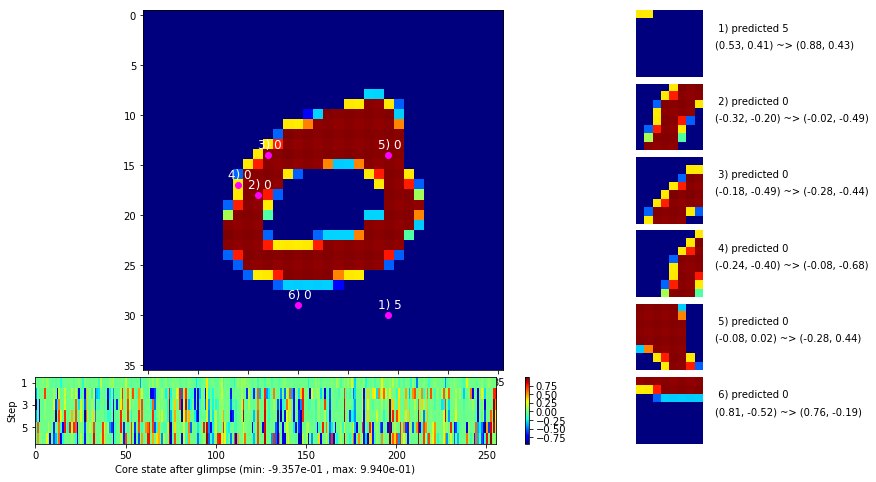

 b   2500/  3000 >> 129.3 ms/b | lr: 5.67e-04 | grad 2norm:  6.13 | grad inf norm:  1.519
       Weights || abs max:  1.64 (65945.83) | mean: -4.84e-05 ( 0.19) | var: 3.27e-02 (1393030.62)
        Biases || abs max:  0.92 (  348.97) | mean: -8.03e-02 ( 0.35) | var: 3.66e-02 ( 1363.48)
                  class loss: 0.301 | steps: 2.334 | reward:  0.903 | acc.: 90.34%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.9 ms/b | lr: 5.63e-04 | grad 2norm:  6.07 | grad inf norm:  1.502
       Weights || abs max:  1.64 (20596.78) | mean: -5.34e-05 ( 0.10) | var: 3.28e-02 ( 7531.95)
        Biases || abs max:  0.92 (  970.36) | mean: -8.05e-02 ( 0.84) | var: 3.70e-02 (81508.72)
                  class loss: 0.291 | steps: 2.324 | reward:  0.905 | acc.: 90.48%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

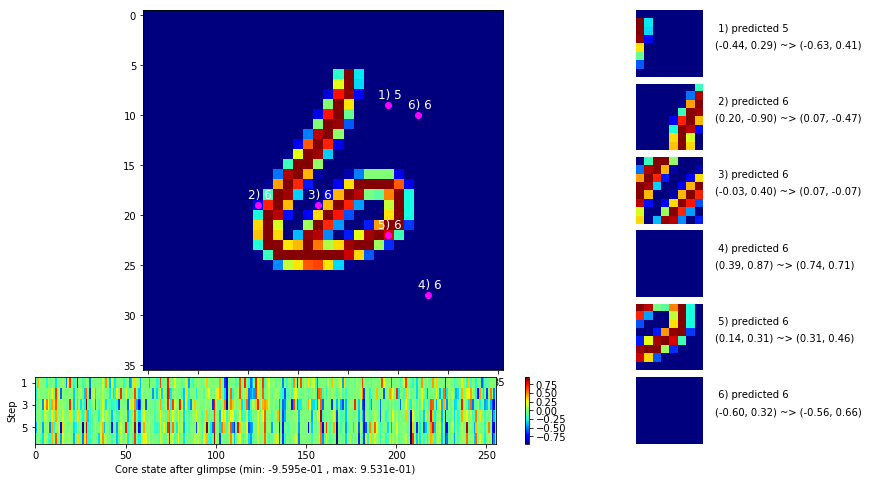

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


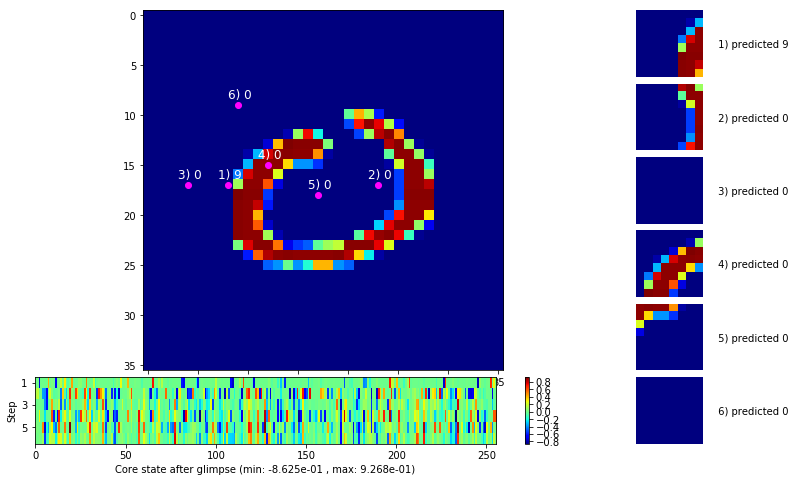


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


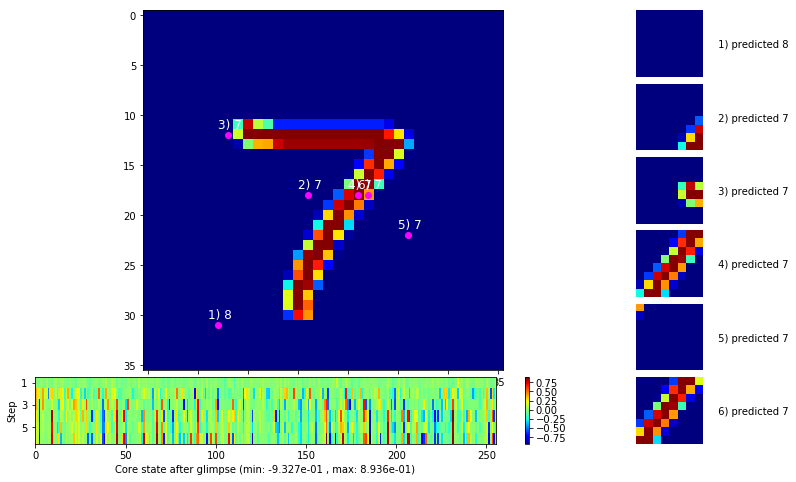

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


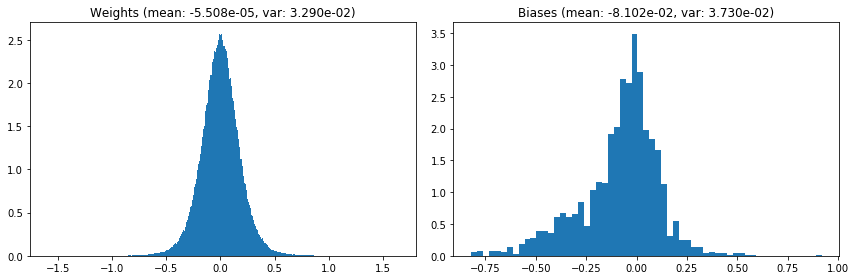

                                      Location network weights and biases


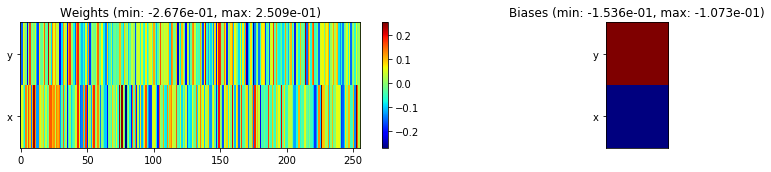

---------------------------------------------------------------------------------------------------------------
Elapsed time:  392.01 sec | TRAIN >> class loss: 0.3018 | steps:  2.335    | reward:  0.9019    | acc.: 90.187% 
                          | VAL   >> class loss: 0.2097 | steps:  2.140    | reward:  0.9302    | acc.: 93.020% 


Epoch  18/400) lr = 0.0005609
 b    500/  3000 >> 127.6 ms/b | lr: 5.57e-04 | grad 2norm:  6.15 | grad inf norm:  1.503
       Weights || abs max:  1.65 (31036.12) | mean: -5.08e-05 ( 0.12) | var: 3.30e-02 (34285.77)
        Biases || abs max:  0.92 (  631.87) | mean: -8.11e-02 ( 0.48) | var: 3.73e-02 (10065.77)
                  class loss: 0.297 | steps: 2.357 | reward:  0.903 | acc.: 90.32%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 126.1 ms/b | lr: 5.54e-04 | grad 2norm:  5.95 | grad inf norm:  1.507
       Weights || abs max:  1.63 (39562.48) | mean: -2.95e-05 ( 0.14) | var

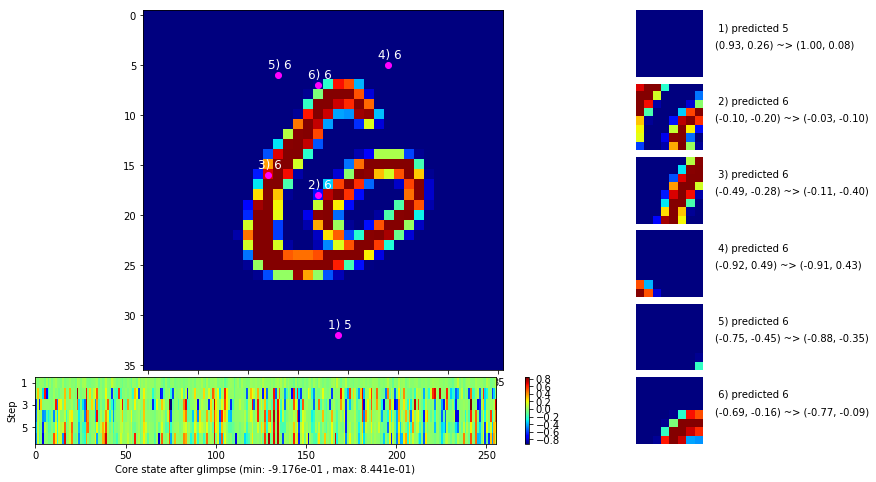

 b   1500/  3000 >> 131.0 ms/b | lr: 5.48e-04 | grad 2norm:  6.11 | grad inf norm:  1.528
       Weights || abs max:  1.62 (58504.80) | mean: -1.62e-05 ( 0.17) | var: 3.32e-02 (414142.19)
        Biases || abs max:  0.92 (  187.77) | mean: -8.16e-02 ( 0.26) | var: 3.77e-02 (  217.26)
                  class loss: 0.294 | steps: 2.337 | reward:  0.904 | acc.: 90.38%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.1 ms/b | lr: 5.45e-04 | grad 2norm:  5.88 | grad inf norm:  1.478
       Weights || abs max:  1.62 (31915.39) | mean: -3.47e-05 ( 0.12) | var: 3.34e-02 (54823.61)
        Biases || abs max:  0.93 (  633.71) | mean: -8.14e-02 ( 0.49) | var: 3.77e-02 (11816.95)
                  class loss: 0.280 | steps: 2.310 | reward:  0.909 | acc.: 90.93%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

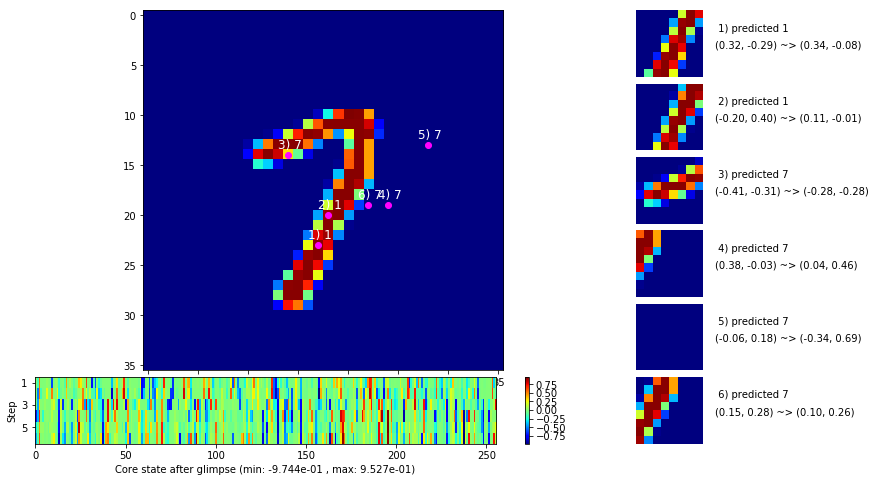

 b   2500/  3000 >> 128.4 ms/b | lr: 5.39e-04 | grad 2norm:  5.92 | grad inf norm:  1.416
       Weights || abs max:  1.62 (23585.71) | mean: -3.77e-05 ( 0.11) | var: 3.35e-02 (12863.39)
        Biases || abs max:  0.93 (  566.65) | mean: -8.13e-02 ( 0.44) | var: 3.79e-02 (19795.81)
                  class loss: 0.284 | steps: 2.319 | reward:  0.910 | acc.: 90.96%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.3 ms/b | lr: 5.36e-04 | grad 2norm:  5.95 | grad inf norm:  1.486
       Weights || abs max:  1.62 (19133.92) | mean: -5.15e-05 ( 0.10) | var: 3.36e-02 ( 7193.36)
        Biases || abs max:  0.92 (  815.57) | mean: -8.26e-02 ( 0.53) | var: 3.84e-02 (21225.70)
                  class loss: 0.290 | steps: 2.323 | reward:  0.905 | acc.: 90.52%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

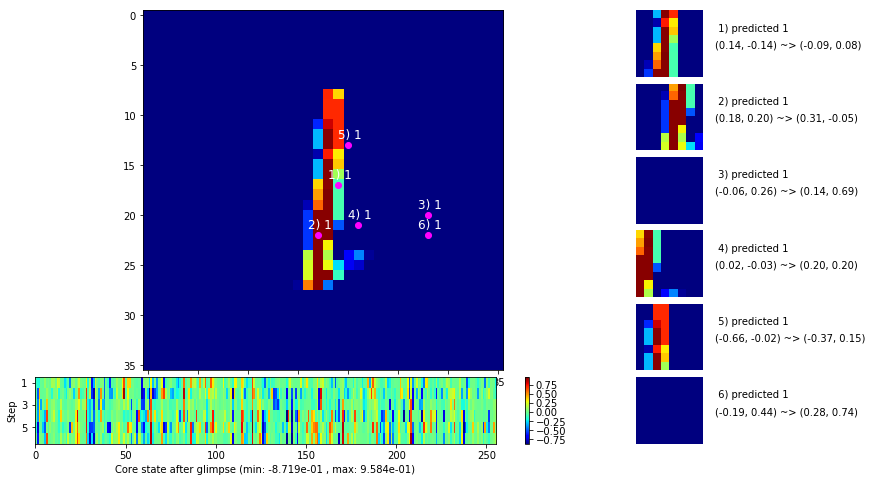

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


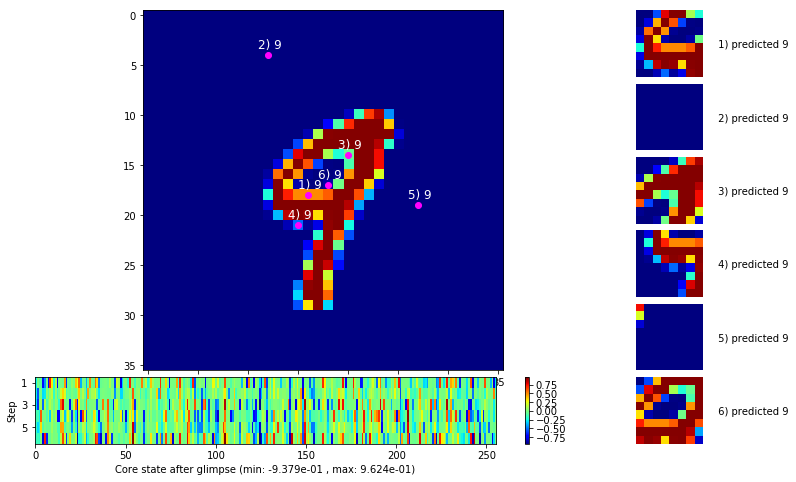


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


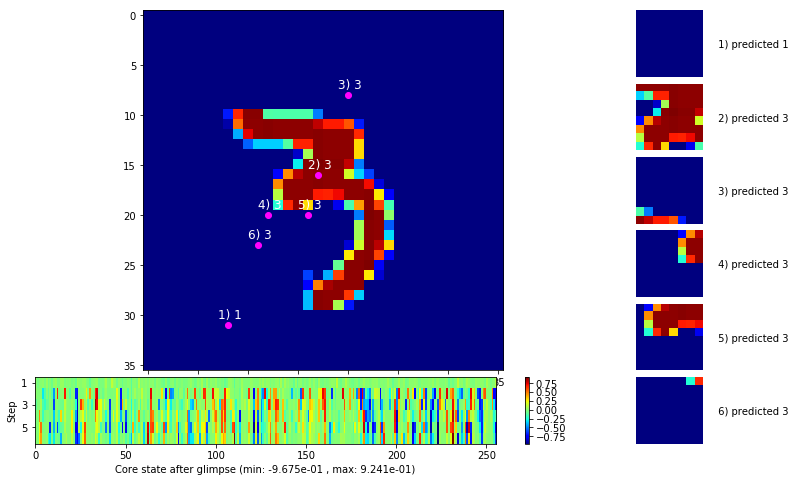

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


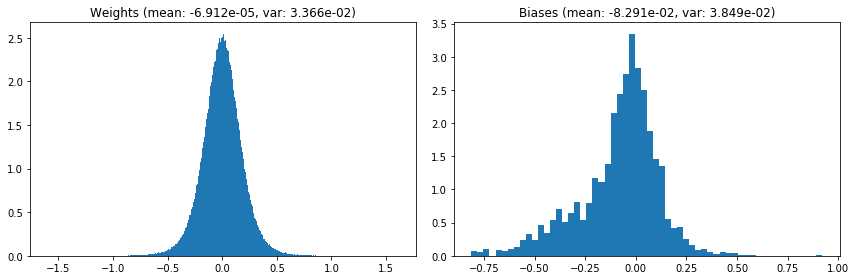

                                      Location network weights and biases


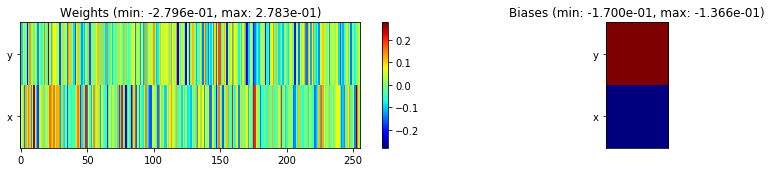

---------------------------------------------------------------------------------------------------------------
Elapsed time:  385.32 sec | TRAIN >> class loss: 0.2883 | steps:  2.329    | reward:  0.9064    | acc.: 90.645% 
                          | VAL   >> class loss: 0.2166 | steps:  2.154 :( | reward:  0.9322    | acc.: 93.220% 


Epoch  19/400) lr = 0.0005344
 b    500/  3000 >> 125.8 ms/b | lr: 5.31e-04 | grad 2norm:  5.88 | grad inf norm:  1.417
       Weights || abs max:  1.62 (86212.66) | mean: -6.87e-05 ( 0.23) | var: 3.37e-02 (3505618.75)
        Biases || abs max:  0.93 (  264.31) | mean: -8.34e-02 ( 0.32) | var: 3.87e-02 (  548.72)
                  class loss: 0.283 | steps: 2.306 | reward:  0.909 | acc.: 90.89%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.0 ms/b | lr: 5.28e-04 | grad 2norm:  5.91 | grad inf norm:  1.461
       Weights || abs max:  1.63 (35867.74) | mean: -9.32e-05 ( 0.13) | v

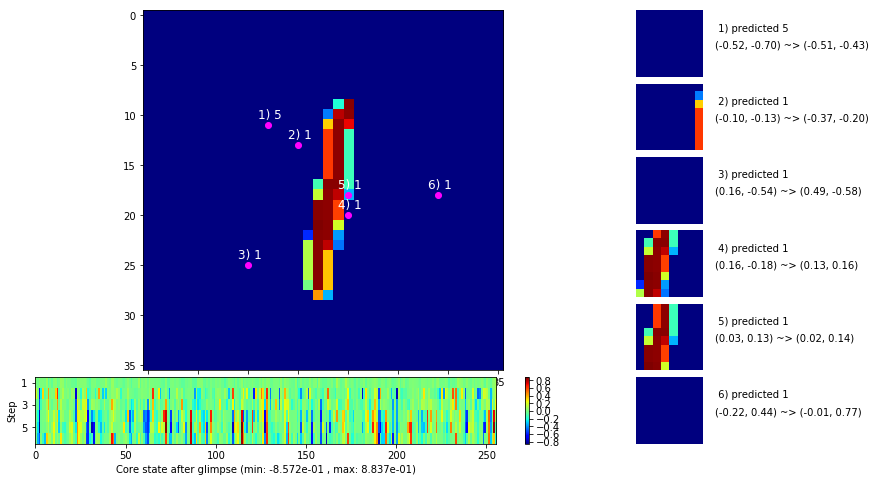

 b   1500/  3000 >> 144.3 ms/b | lr: 5.23e-04 | grad 2norm:  5.92 | grad inf norm:  1.391
       Weights || abs max:  1.63 (75128.93) | mean: -5.51e-05 ( 0.20) | var: 3.39e-02 (1687801.38)
        Biases || abs max:  0.92 (  199.18) | mean: -8.46e-02 ( 0.24) | var: 3.89e-02 (  291.18)
                  class loss: 0.280 | steps: 2.310 | reward:  0.910 | acc.: 91.00%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.9 ms/b | lr: 5.20e-04 | grad 2norm:  5.92 | grad inf norm:  1.482
       Weights || abs max:  1.65 (70073.48) | mean: -1.01e-04 ( 0.19) | var: 3.41e-02 (1522520.88)
        Biases || abs max:  0.92 (  844.12) | mean: -8.49e-02 ( 0.52) | var: 3.91e-02 (51770.93)
                  class loss: 0.282 | steps: 2.295 | reward:  0.907 | acc.: 90.69%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

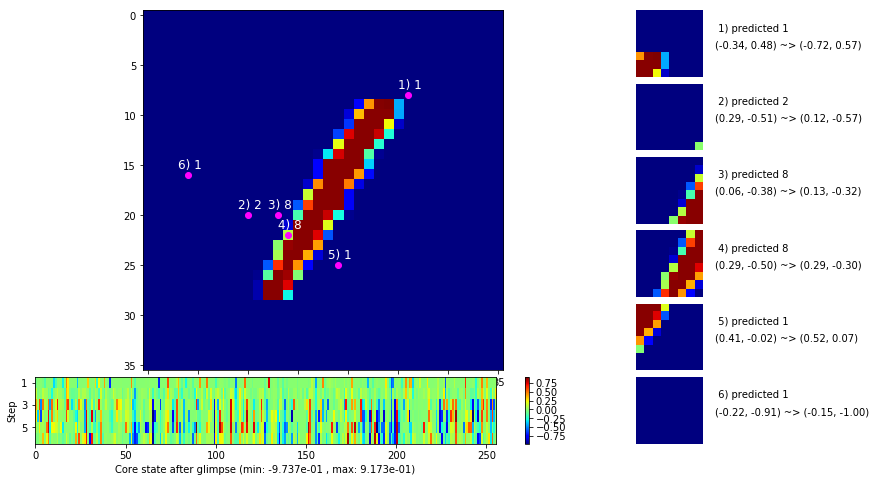

 b   2500/  3000 >> 129.0 ms/b | lr: 5.15e-04 | grad 2norm:  5.77 | grad inf norm:  1.465
       Weights || abs max:  1.66 (43811.77) | mean: -1.58e-04 ( 0.14) | var: 3.42e-02 (213755.53)
        Biases || abs max:  0.92 (  330.60) | mean: -8.56e-02 ( 0.31) | var: 3.94e-02 (  737.73)
                  class loss: 0.292 | steps: 2.335 | reward:  0.908 | acc.: 90.76%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 131.3 ms/b | lr: 5.12e-04 | grad 2norm:  5.93 | grad inf norm:  1.498
       Weights || abs max:  1.68 (53438.25) | mean: -1.52e-04 ( 0.16) | var: 3.43e-02 (411579.19)
        Biases || abs max:  0.92 (  484.58) | mean: -8.59e-02 ( 0.37) | var: 3.95e-02 ( 4104.92)
                  class loss: 0.294 | steps: 2.318 | reward:  0.904 | acc.: 90.38%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

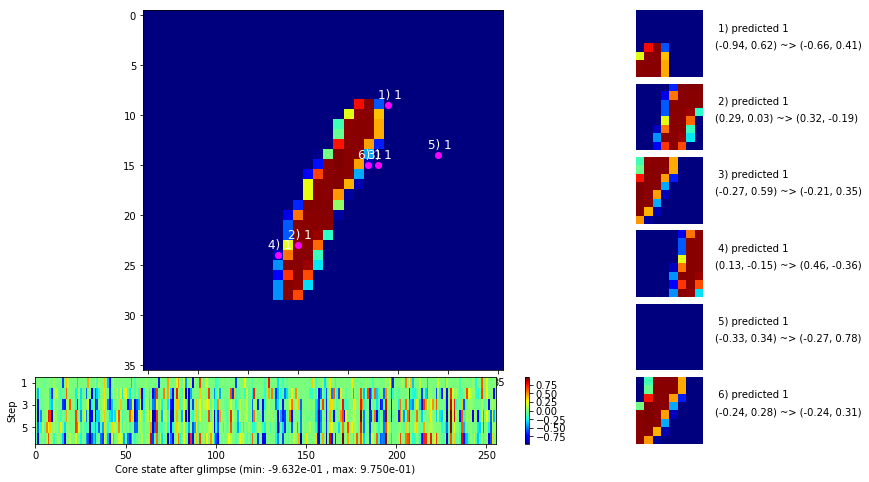

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


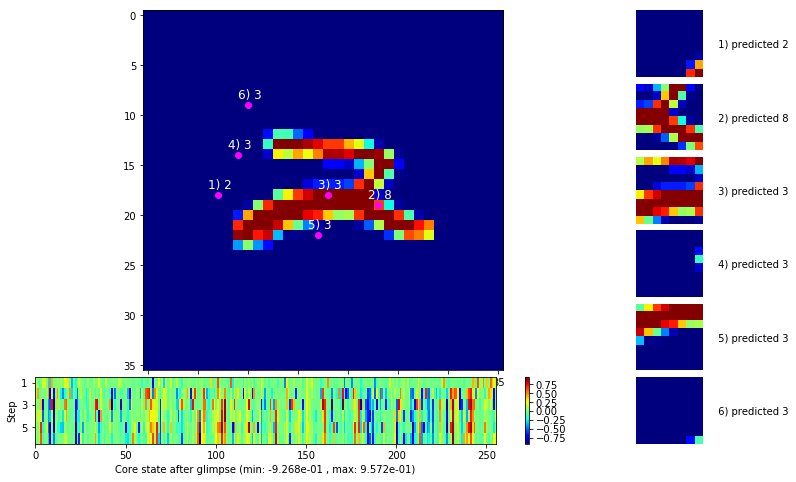


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


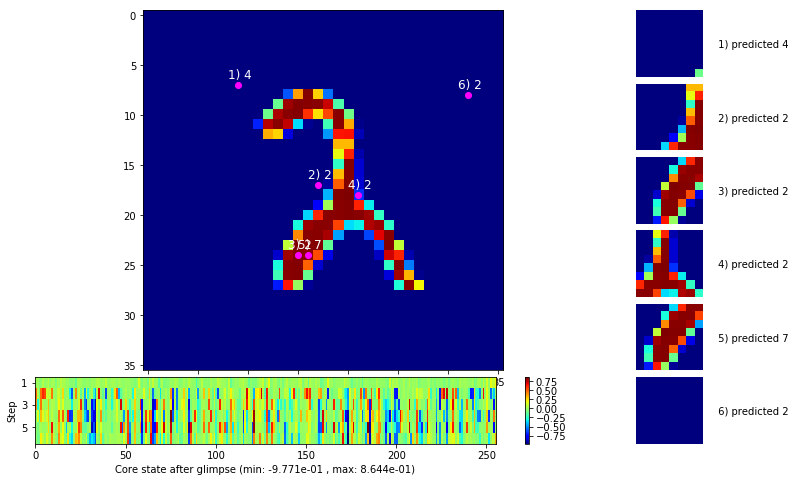

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


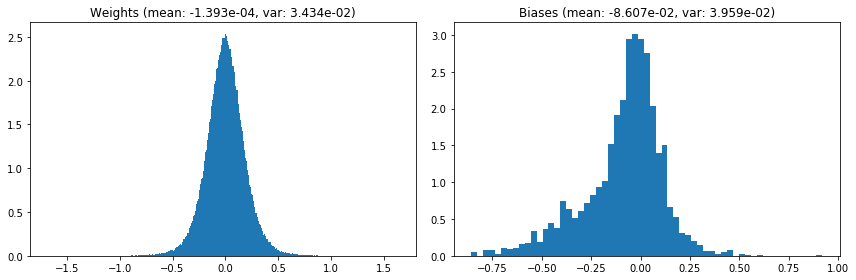

                                      Location network weights and biases


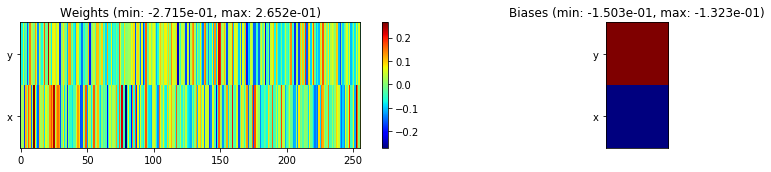

---------------------------------------------------------------------------------------------------------------
Elapsed time:  394.80 sec | TRAIN >> class loss: 0.2864 | steps:  2.310    | reward:  0.9074    | acc.: 90.745% 
                          | VAL   >> class loss: 0.2111 | steps:  2.186 :( | reward:  0.9328    | acc.: 93.280% 


Epoch  20/400) lr = 0.0005105
 b    500/  3000 >> 128.9 ms/b | lr: 5.07e-04 | grad 2norm:  5.86 | grad inf norm:  1.446
       Weights || abs max:  1.69 (20639.99) | mean: -1.33e-04 ( 0.10) | var: 3.44e-02 ( 6129.57)
        Biases || abs max:  0.92 (  175.17) | mean: -8.62e-02 ( 0.25) | var: 3.96e-02 (   84.04)
                  class loss: 0.279 | steps: 2.322 | reward:  0.909 | acc.: 90.88%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.8 ms/b | lr: 5.04e-04 | grad 2norm:  5.74 | grad inf norm:  1.508
       Weights || abs max:  1.70 (20196.72) | mean: -1.42e-04 ( 0.10) | var

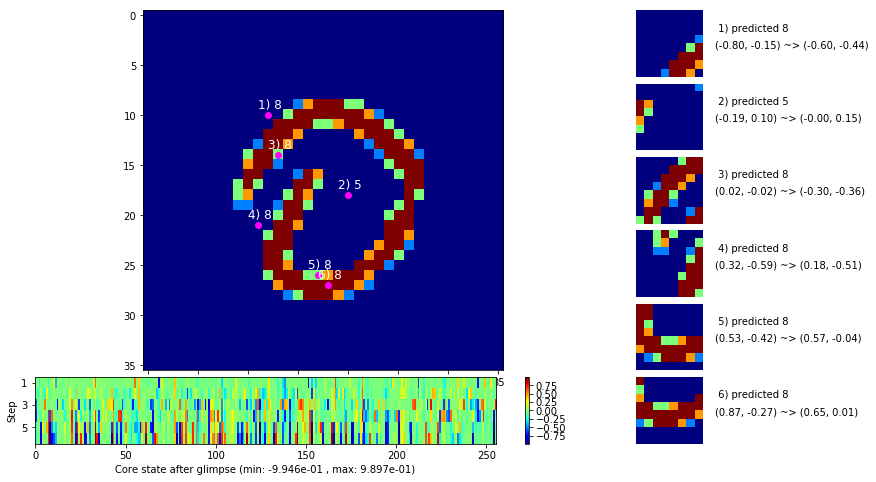

 b   1500/  3000 >> 131.5 ms/b | lr: 5.00e-04 | grad 2norm:  5.90 | grad inf norm:  1.444
       Weights || abs max:  1.70 (32778.86) | mean: -1.60e-04 ( 0.13) | var: 3.46e-02 (39231.67)
        Biases || abs max:  0.92 (  403.46) | mean: -8.63e-02 ( 0.37) | var: 3.99e-02 ( 1489.82)
                  class loss: 0.279 | steps: 2.312 | reward:  0.910 | acc.: 91.03%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.1 ms/b | lr: 4.97e-04 | grad 2norm:  5.83 | grad inf norm:  1.488
       Weights || abs max:  1.69 (28992.94) | mean: -1.69e-04 ( 0.11) | var: 3.47e-02 (37876.91)
        Biases || abs max:  0.93 (  969.95) | mean: -8.65e-02 ( 0.80) | var: 4.00e-02 (56921.58)
                  class loss: 0.281 | steps: 2.321 | reward:  0.911 | acc.: 91.11%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

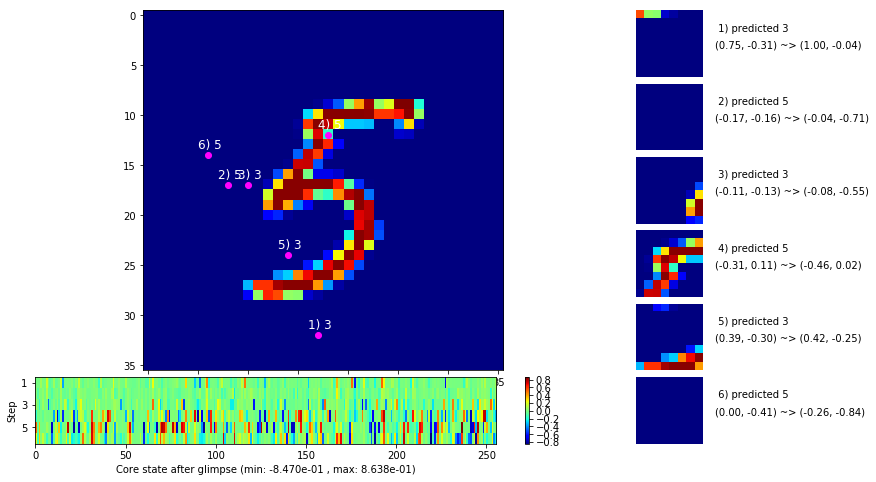

 b   2500/  3000 >> 132.6 ms/b | lr: 4.93e-04 | grad 2norm:  5.72 | grad inf norm:  1.448
       Weights || abs max:  1.68 (22671.51) | mean: -1.66e-04 ( 0.11) | var: 3.48e-02 (20183.32)
        Biases || abs max:  0.93 (  459.75) | mean: -8.70e-02 ( 0.48) | var: 4.03e-02 ( 9020.05)
                  class loss: 0.279 | steps: 2.331 | reward:  0.913 | acc.: 91.26%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.2 ms/b | lr: 4.90e-04 | grad 2norm:  5.73 | grad inf norm:  1.444
       Weights || abs max:  1.68 (32786.92) | mean: -1.75e-04 ( 0.12) | var: 3.49e-02 (47995.00)
        Biases || abs max:  0.93 (  319.50) | mean: -8.76e-02 ( 0.37) | var: 4.05e-02 ( 3483.98)
                  class loss: 0.272 | steps: 2.314 | reward:  0.912 | acc.: 91.22%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

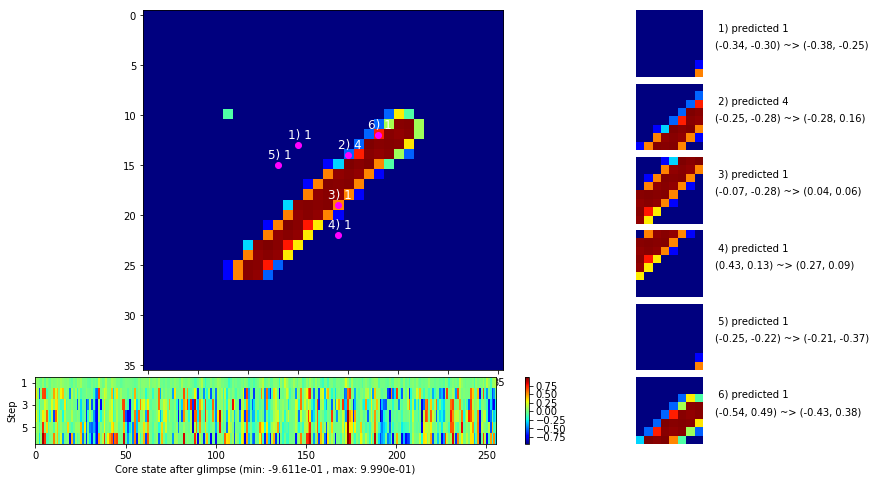

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


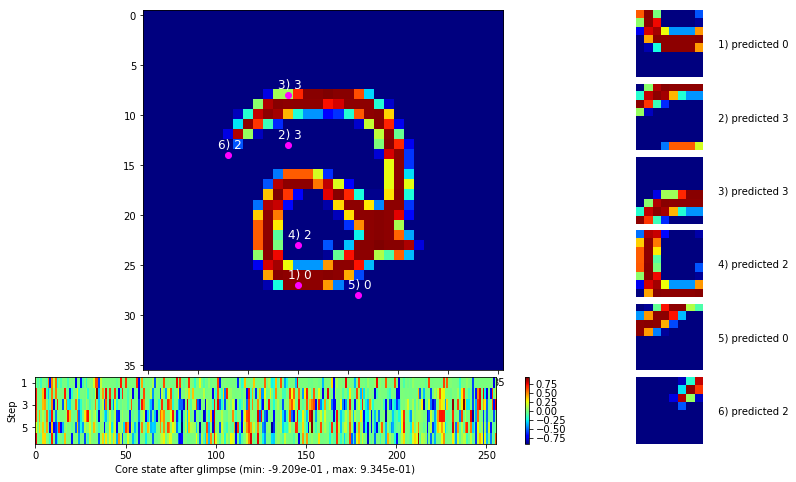


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


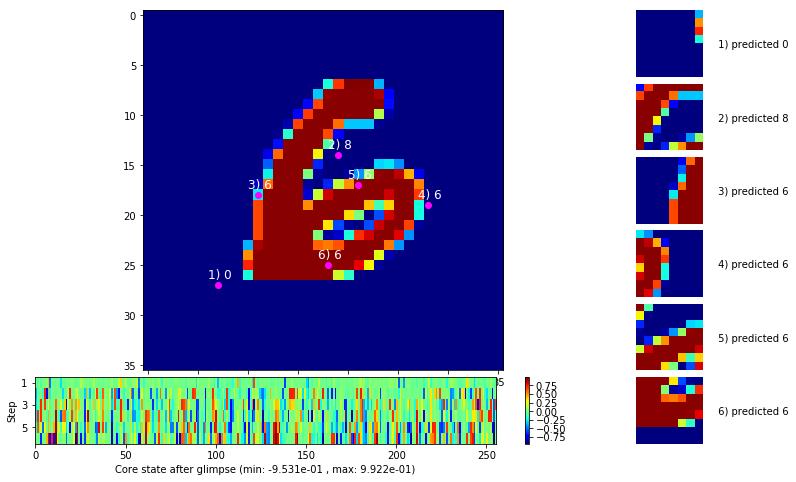

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


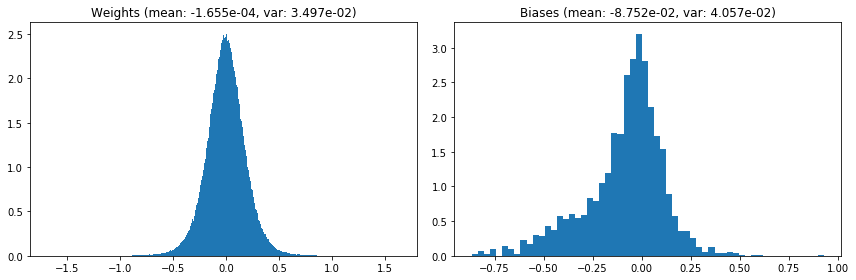

                                      Location network weights and biases


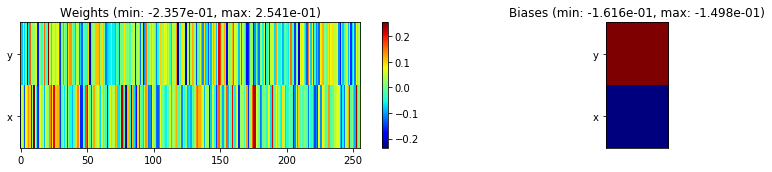

---------------------------------------------------------------------------------------------------------------
Elapsed time:  397.12 sec | TRAIN >> class loss: 0.2769 | steps:  2.319 :( | reward:  0.9113    | acc.: 91.132% 
                          | VAL   >> class loss: 0.1989 | steps:  2.158 :( | reward:  0.9366    | acc.: 93.660% 


Epoch  21/400) lr = 0.0004888
 b    500/  3000 >> 126.8 ms/b | lr: 4.86e-04 | grad 2norm:  5.75 | grad inf norm:  1.464
       Weights || abs max:  1.69 (56627.56) | mean: -1.62e-04 ( 0.17) | var: 3.50e-02 (648252.75)
        Biases || abs max:  0.93 (  365.02) | mean: -8.75e-02 ( 0.35) | var: 4.06e-02 ( 1519.57)
                  class loss: 0.276 | steps: 2.343 | reward:  0.911 | acc.: 91.12%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 131.5 ms/b | lr: 4.83e-04 | grad 2norm:  5.83 | grad inf norm:  1.466
       Weights || abs max:  1.70 (45725.35) | mean: -1.23e-04 ( 0.15) | va

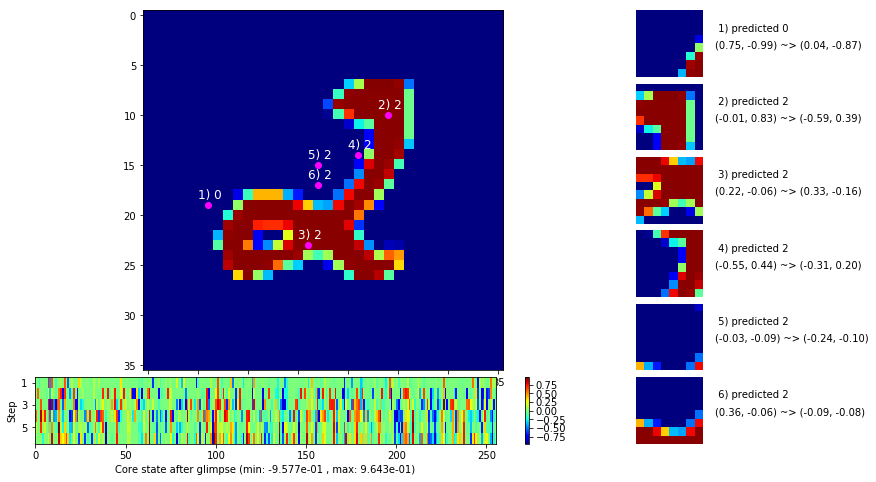

 b   1500/  3000 >> 127.9 ms/b | lr: 4.79e-04 | grad 2norm:  5.69 | grad inf norm:  1.433
       Weights || abs max:  1.70 (109069.60) | mean: -1.32e-04 ( 0.26) | var: 3.52e-02 (6709414.50)
        Biases || abs max:  0.93 (  185.08) | mean: -8.83e-02 ( 0.22) | var: 4.10e-02 (  319.74)
                  class loss: 0.280 | steps: 2.300 | reward:  0.911 | acc.: 91.15%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.2 ms/b | lr: 4.77e-04 | grad 2norm:  5.60 | grad inf norm:  1.407
       Weights || abs max:  1.71 (32791.60) | mean: -1.21e-04 ( 0.13) | var: 3.53e-02 (42910.40)
        Biases || abs max:  0.93 (  266.54) | mean: -8.87e-02 ( 0.28) | var: 4.10e-02 (  261.04)
                  class loss: 0.267 | steps: 2.316 | reward:  0.915 | acc.: 91.51%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

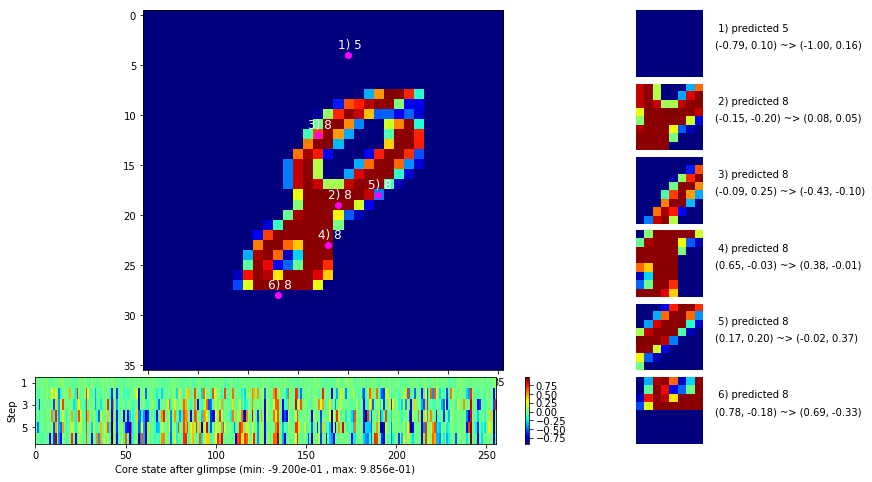

 b   2500/  3000 >> 128.1 ms/b | lr: 4.73e-04 | grad 2norm:  5.82 | grad inf norm:  1.480
       Weights || abs max:  1.70 (31592.38) | mean: -1.52e-04 ( 0.13) | var: 3.54e-02 (23560.81)
        Biases || abs max:  0.93 (  311.57) | mean: -8.87e-02 ( 0.29) | var: 4.10e-02 ( 1523.51)
                  class loss: 0.271 | steps: 2.280 | reward:  0.912 | acc.: 91.18%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 129.0 ms/b | lr: 4.70e-04 | grad 2norm:  5.62 | grad inf norm:  1.387
       Weights || abs max:  1.69 (97963.15) | mean: -1.63e-04 ( 0.25) | var: 3.55e-02 (3846396.00)
        Biases || abs max:  0.93 (  623.06) | mean: -8.94e-02 ( 0.42) | var: 4.11e-02 (21177.51)
                  class loss: 0.269 | steps: 2.288 | reward:  0.917 | acc.: 91.67%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

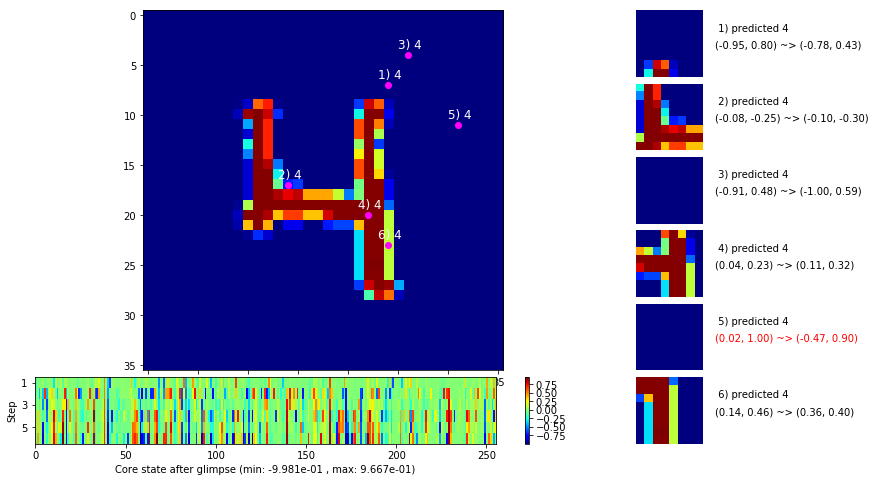

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


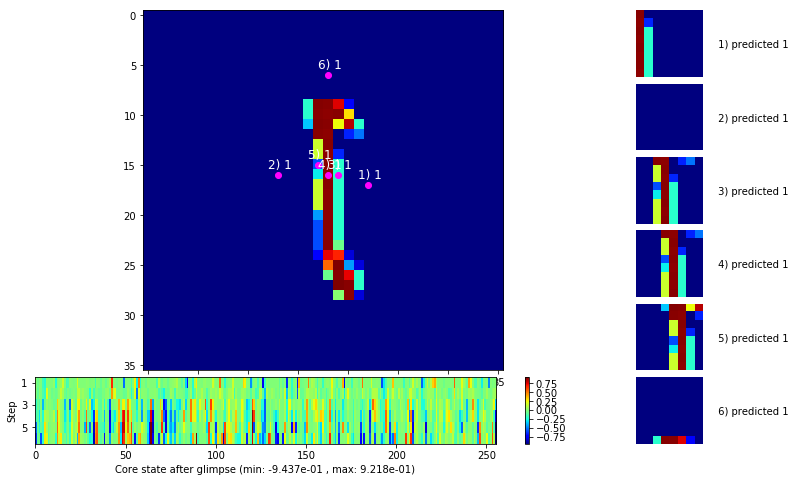


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


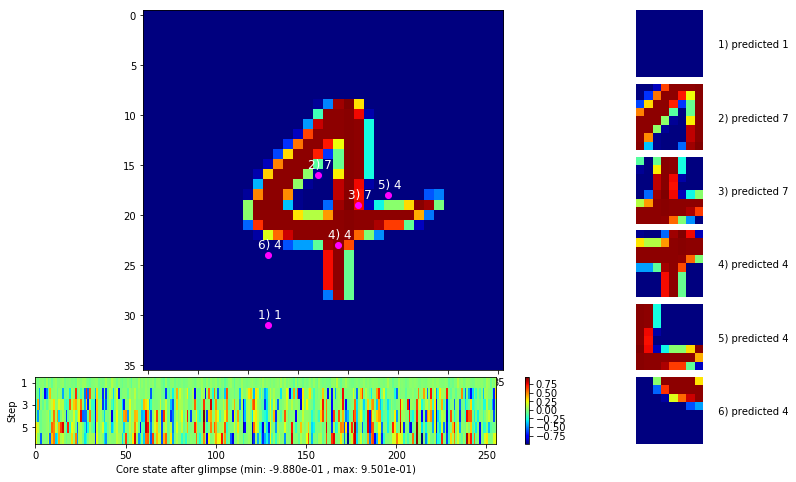

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


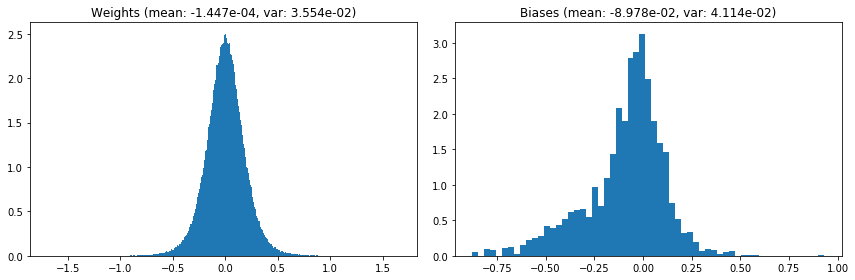

                                      Location network weights and biases


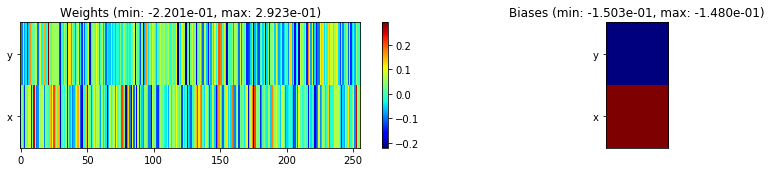

---------------------------------------------------------------------------------------------------------------
Elapsed time:  387.61 sec | TRAIN >> class loss: 0.2765 | steps:  2.312 :( | reward:  0.9123    | acc.: 91.227% 
                          | VAL   >> class loss: 0.1948 | steps:  2.093    | reward:  0.9414    | acc.: 94.140% 


Epoch  22/400) lr = 0.000469
 b    500/  3000 >> 127.3 ms/b | lr: 4.66e-04 | grad 2norm:  5.55 | grad inf norm:  1.427
       Weights || abs max:  1.68 (38878.79) | mean: -1.59e-04 ( 0.14) | var: 3.56e-02 (107835.59)
        Biases || abs max:  0.93 (  202.41) | mean: -8.97e-02 ( 0.25) | var: 4.12e-02 (  814.26)
                  class loss: 0.254 | steps: 2.280 | reward:  0.919 | acc.: 91.92%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.3 ms/b | lr: 4.64e-04 | grad 2norm:  5.75 | grad inf norm:  1.399
       Weights || abs max:  1.68 (19448.63) | mean: -1.55e-04 ( 0.10) | var

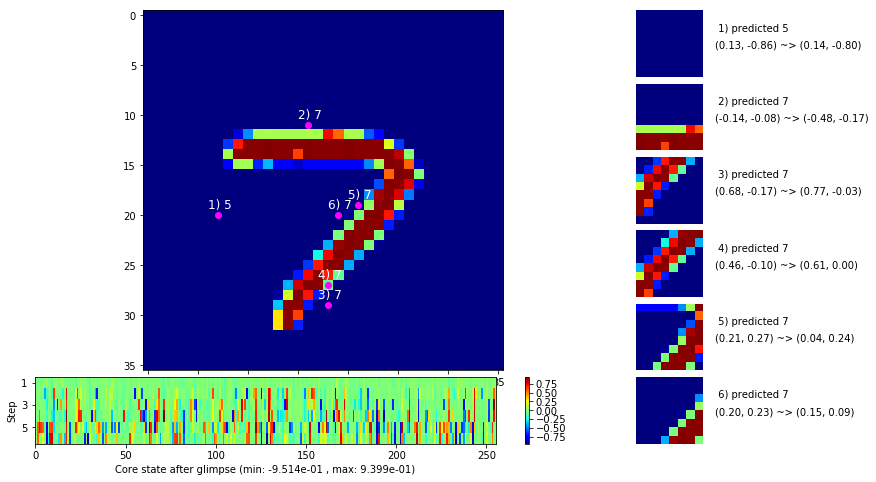

 b   1500/  3000 >> 145.1 ms/b | lr: 4.60e-04 | grad 2norm:  5.59 | grad inf norm:  1.428
       Weights || abs max:  1.68 (50152.18) | mean: -1.41e-04 ( 0.15) | var: 3.58e-02 (325310.47)
        Biases || abs max:  0.93 (  315.72) | mean: -9.02e-02 ( 0.33) | var: 4.13e-02 (  753.54)
                  class loss: 0.263 | steps: 2.291 | reward:  0.917 | acc.: 91.72%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.9 ms/b | lr: 4.58e-04 | grad 2norm:  5.67 | grad inf norm:  1.425
       Weights || abs max:  1.68 (32215.41) | mean: -1.16e-04 ( 0.13) | var: 3.58e-02 (35673.70)
        Biases || abs max:  0.93 (  341.63) | mean: -9.04e-02 ( 0.31) | var: 4.14e-02 ( 1137.18)
                  class loss: 0.251 | steps: 2.265 | reward:  0.916 | acc.: 91.62%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0

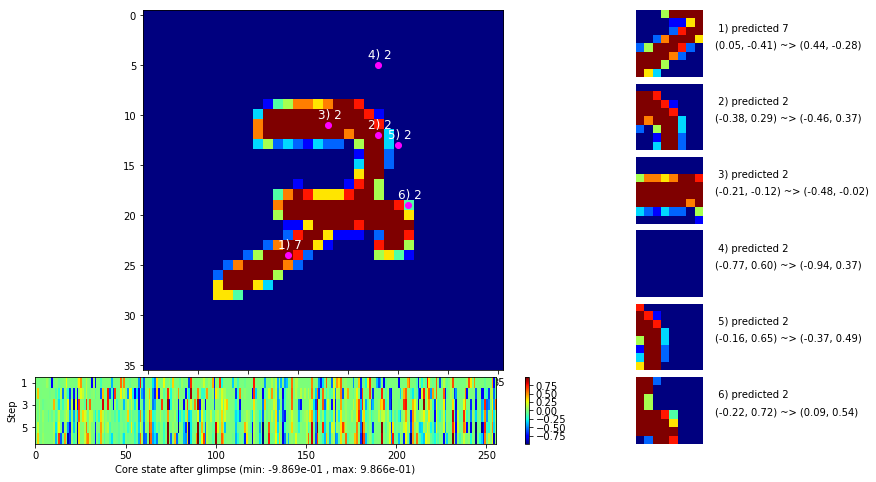

 b   2500/  3000 >> 128.6 ms/b | lr: 4.54e-04 | grad 2norm:  5.54 | grad inf norm:  1.435
       Weights || abs max:  1.68 (38876.80) | mean: -1.07e-04 ( 0.14) | var: 3.59e-02 (64191.52)
        Biases || abs max:  0.93 (  327.42) | mean: -9.04e-02 ( 0.31) | var: 4.16e-02 ( 1019.11)
                  class loss: 0.252 | steps: 2.266 | reward:  0.918 | acc.: 91.80%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.0 ms/b | lr: 4.52e-04 | grad 2norm:  5.46 | grad inf norm:  1.392
       Weights || abs max:  1.69 (20860.00) | mean: -1.03e-04 ( 0.10) | var: 3.60e-02 ( 9711.45)
        Biases || abs max:  0.94 (  364.59) | mean: -9.07e-02 ( 0.31) | var: 4.18e-02 ( 1724.56)
                  class loss: 0.246 | steps: 2.251 | reward:  0.923 | acc.: 92.27%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

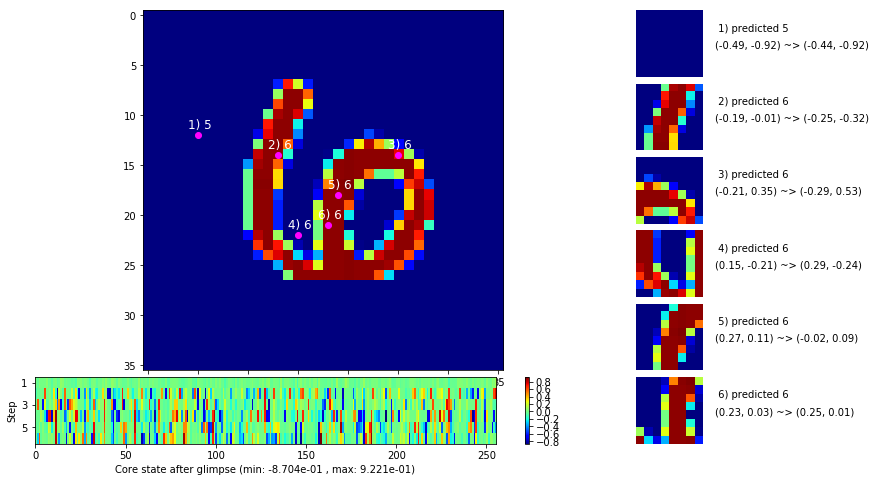

                                          ---===  VALIDATION  ===---

	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


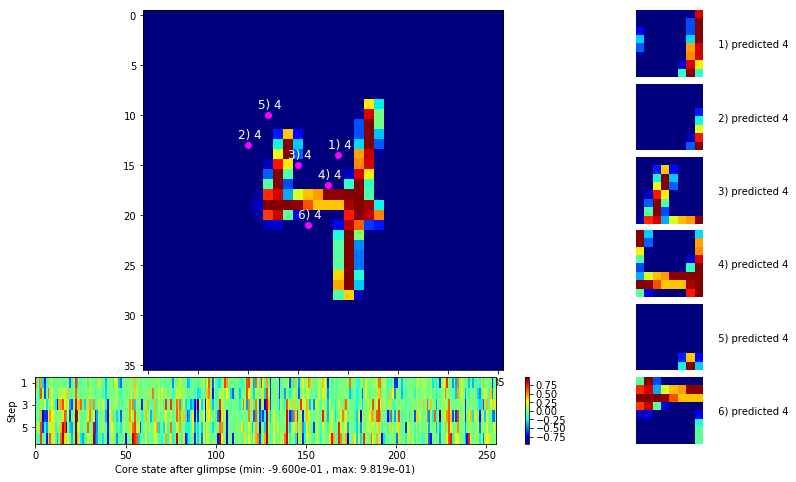


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


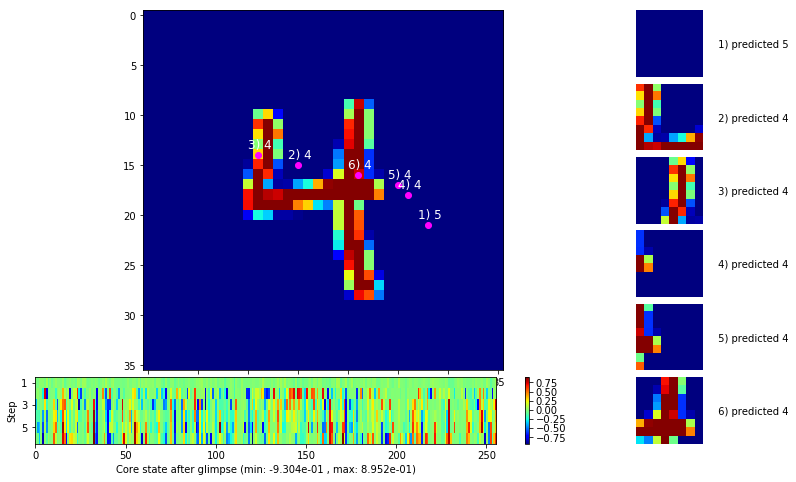

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


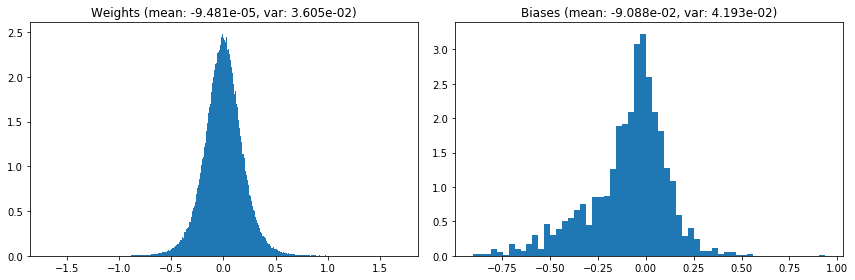

                                      Location network weights and biases


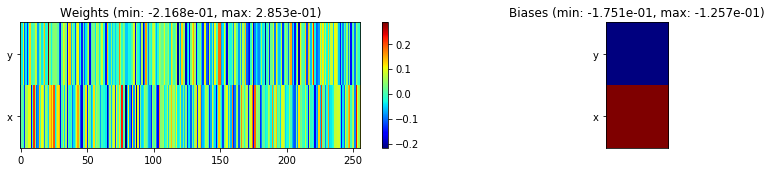

---------------------------------------------------------------------------------------------------------------
Elapsed time:  394.14 sec | TRAIN >> class loss: 0.2554 | steps:  2.274    | reward:  0.9180    | acc.: 91.797% 
                          | VAL   >> class loss: 0.1758 | steps:  2.079    | reward:  0.9432    | acc.: 94.320% 


Epoch  23/400) lr = 0.0004508
 b    500/  3000 >> 130.3 ms/b | lr: 4.49e-04 | grad 2norm:  5.57 | grad inf norm:  1.420
       Weights || abs max:  1.69 (49230.77) | mean: -8.14e-05 ( 0.15) | var: 3.61e-02 (522555.81)
        Biases || abs max:  0.94 (  513.14) | mean: -9.14e-02 ( 0.37) | var: 4.20e-02 ( 6394.52)
                  class loss: 0.252 | steps: 2.269 | reward:  0.918 | acc.: 91.82%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.1 ms/b | lr: 4.46e-04 | grad 2norm:  5.70 | grad inf norm:  1.439
       Weights || abs max:  1.70 (175594.81) | mean: -8.23e-05 ( 0.39) | v

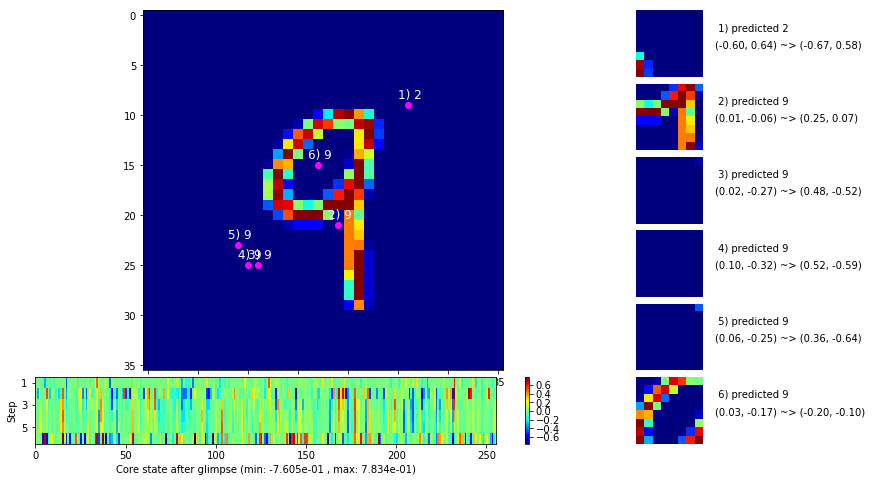

 b   1500/  3000 >> 128.6 ms/b | lr: 4.43e-04 | grad 2norm:  5.62 | grad inf norm:  1.419
       Weights || abs max:  1.70 (25978.82) | mean: -8.55e-05 ( 0.11) | var: 3.63e-02 (18606.12)
        Biases || abs max:  0.93 (  310.24) | mean: -9.15e-02 ( 0.33) | var: 4.23e-02 ( 1704.22)
                  class loss: 0.256 | steps: 2.279 | reward:  0.918 | acc.: 91.79%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 126.3 ms/b | lr: 4.41e-04 | grad 2norm:  5.59 | grad inf norm:  1.398
       Weights || abs max:  1.70 (20172.73) | mean: -7.34e-05 ( 0.10) | var: 3.64e-02 ( 5882.59)
        Biases || abs max:  0.93 (  639.55) | mean: -9.19e-02 ( 0.54) | var: 4.24e-02 (26014.21)
                  class loss: 0.251 | steps: 2.257 | reward:  0.918 | acc.: 91.85%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

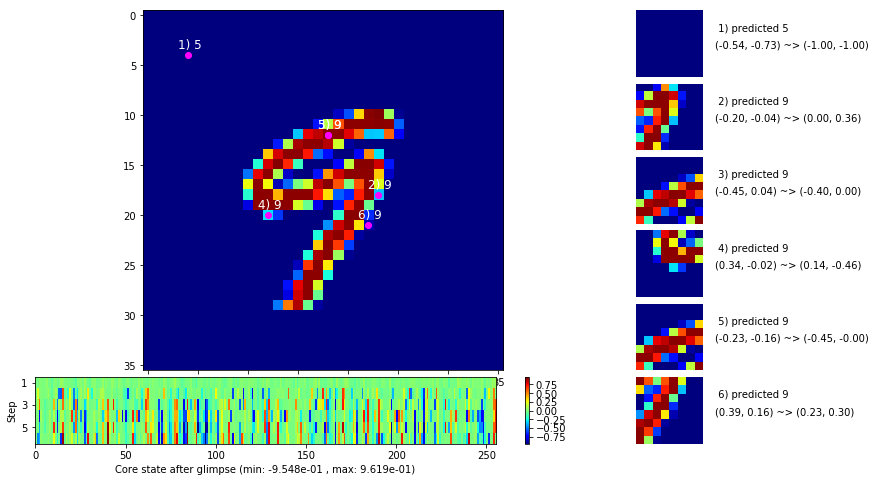

 b   2500/  3000 >> 129.9 ms/b | lr: 4.37e-04 | grad 2norm:  5.57 | grad inf norm:  1.360
       Weights || abs max:  1.69 (46322.51) | mean: -5.95e-05 ( 0.15) | var: 3.64e-02 (322973.22)
        Biases || abs max:  0.93 (  354.28) | mean: -9.25e-02 ( 0.34) | var: 4.25e-02 (  638.00)
                  class loss: 0.255 | steps: 2.278 | reward:  0.916 | acc.: 91.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 146.7 ms/b | lr: 4.35e-04 | grad 2norm:  5.33 | grad inf norm:  1.339
       Weights || abs max:  1.68 (21340.80) | mean: -7.74e-05 ( 0.10) | var: 3.65e-02 ( 8378.52)
        Biases || abs max:  0.93 (  201.13) | mean: -9.30e-02 ( 0.25) | var: 4.27e-02 (  487.56)
                  class loss: 0.243 | steps: 2.277 | reward:  0.923 | acc.: 92.29%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

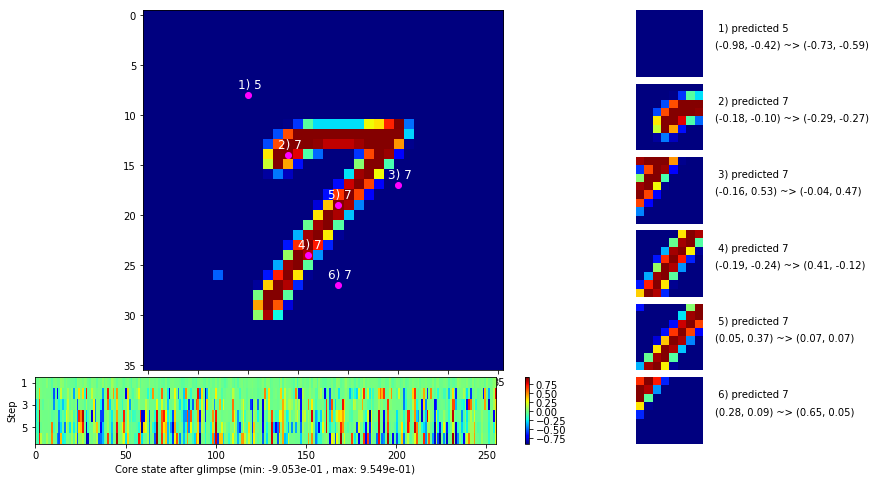

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


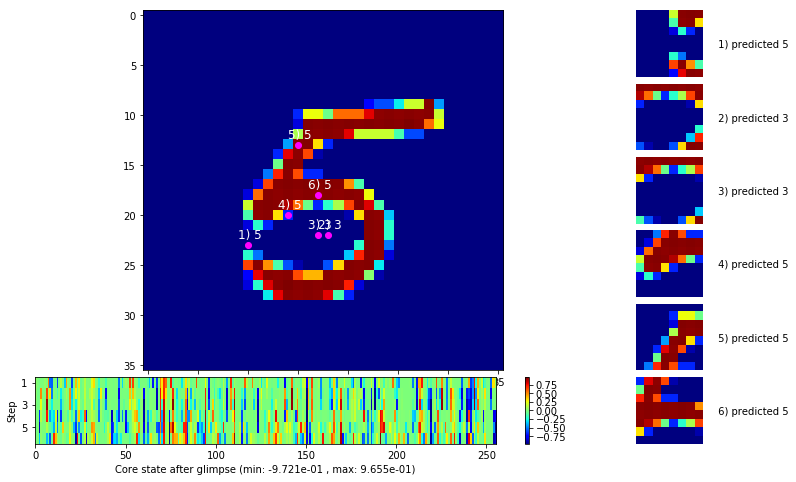


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


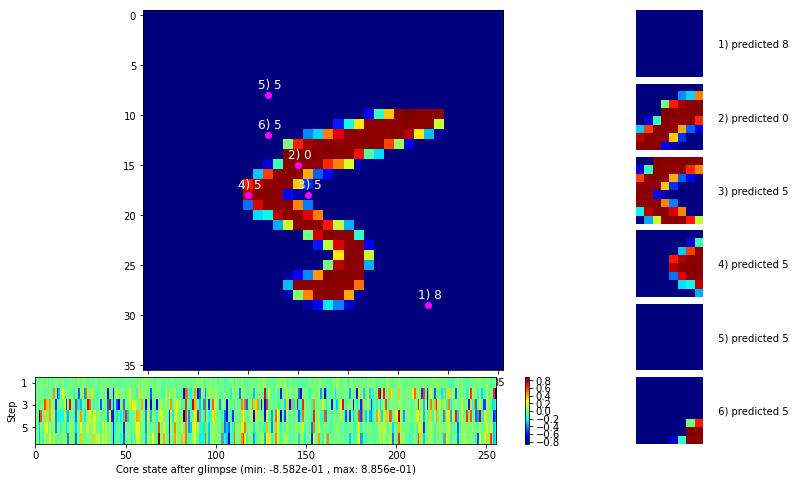

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


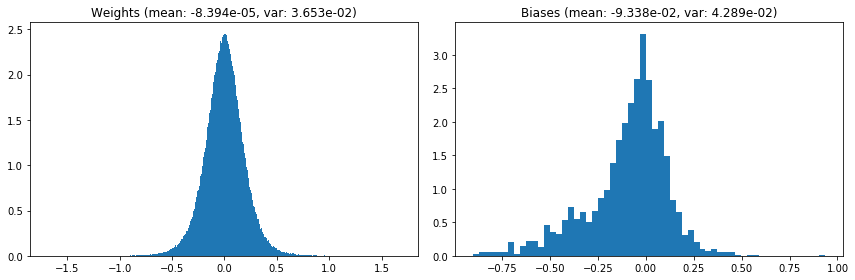

                                      Location network weights and biases


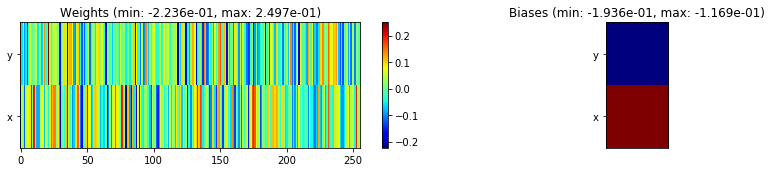

---------------------------------------------------------------------------------------------------------------
Elapsed time:  396.64 sec | TRAIN >> class loss: 0.2514 | steps:  2.272    | reward:  0.9182    | acc.: 91.815% 
                          | VAL   >> class loss: 0.1684 | steps:  2.064    | reward:  0.9482    | acc.: 94.820% 


Epoch  24/400) lr = 0.0004342
 b    500/  3000 >> 127.5 ms/b | lr: 4.32e-04 | grad 2norm:  5.41 | grad inf norm:  1.452
       Weights || abs max:  1.69 (18403.34) | mean: -7.26e-05 ( 0.09) | var: 3.66e-02 ( 5063.70)
        Biases || abs max:  0.94 (  951.03) | mean: -9.32e-02 ( 0.77) | var: 4.29e-02 (100359.55)
                  class loss: 0.258 | steps: 2.257 | reward:  0.920 | acc.: 92.00%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.3 ms/b | lr: 4.30e-04 | grad 2norm:  5.44 | grad inf norm:  1.372
       Weights || abs max:  1.71 (23031.53) | mean: -6.73e-05 ( 0.11) | va

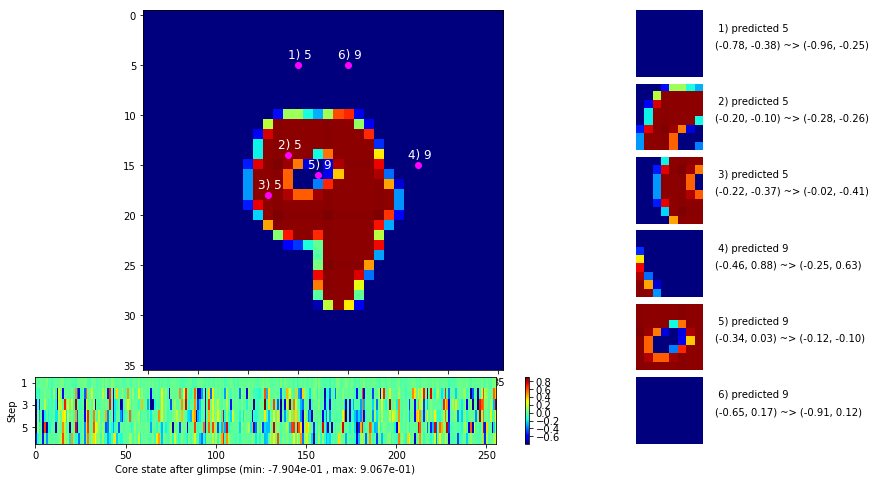

 b   1500/  3000 >> 129.3 ms/b | lr: 4.27e-04 | grad 2norm:  5.38 | grad inf norm:  1.381
       Weights || abs max:  1.71 (22571.90) | mean: -5.03e-05 ( 0.11) | var: 3.67e-02 (13099.48)
        Biases || abs max:  0.94 (  376.14) | mean: -9.36e-02 ( 0.34) | var: 4.30e-02 (  476.21)
                  class loss: 0.245 | steps: 2.271 | reward:  0.923 | acc.: 92.27%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 127.9 ms/b | lr: 4.25e-04 | grad 2norm:  5.33 | grad inf norm:  1.403
       Weights || abs max:  1.71 (29201.39) | mean: -3.86e-05 ( 0.12) | var: 3.68e-02 (49431.60)
        Biases || abs max:  0.94 (  702.19) | mean: -9.34e-02 ( 0.47) | var: 4.32e-02 ( 8820.52)
                  class loss: 0.242 | steps: 2.251 | reward:  0.925 | acc.: 92.53%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

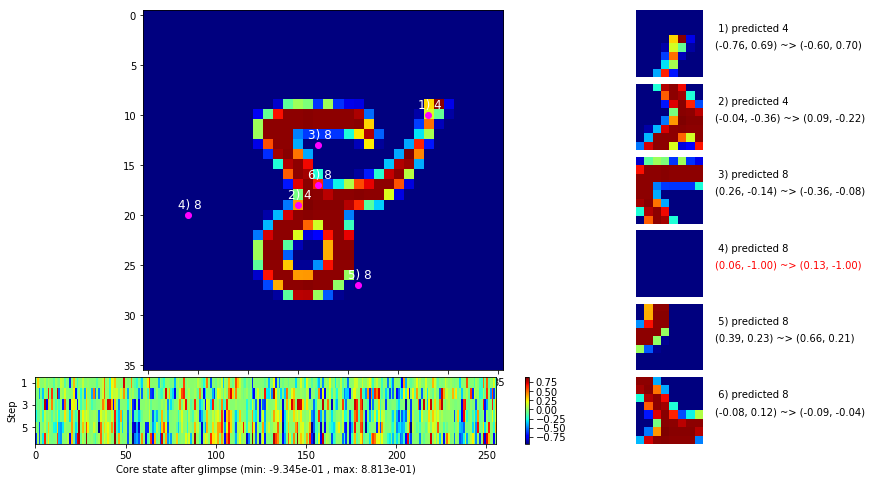

 b   2500/  3000 >> 131.7 ms/b | lr: 4.22e-04 | grad 2norm:  5.15 | grad inf norm:  1.351
       Weights || abs max:  1.72 (     inf) | mean: -2.26e-05 (  inf) | var: 3.69e-02 (     nan)
        Biases || abs max:  0.94 (  340.06) | mean: -9.32e-02 ( 0.30) | var: 4.33e-02 (  498.88)
                  class loss: 0.226 | steps: 2.248 | reward:  0.929 | acc.: 92.95%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.6 ms/b | lr: 4.20e-04 | grad 2norm:  5.34 | grad inf norm:  1.370
       Weights || abs max:  1.72 (39942.81) | mean: -1.62e-05 ( 0.14) | var: 3.69e-02 (63512.11)
        Biases || abs max:  0.94 ( 2678.23) | mean: -9.34e-02 ( 1.23) | var: 4.35e-02 (1023228.19)
                  class loss: 0.235 | steps: 2.244 | reward:  0.924 | acc.: 92.39%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

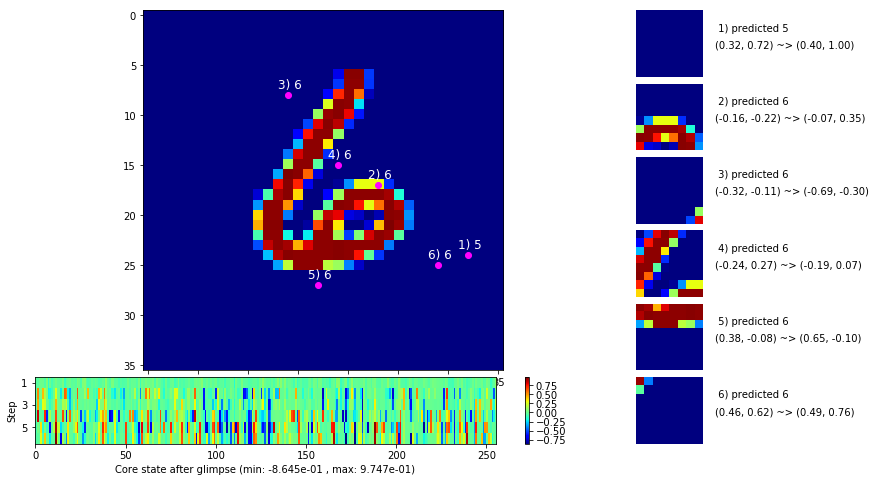

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


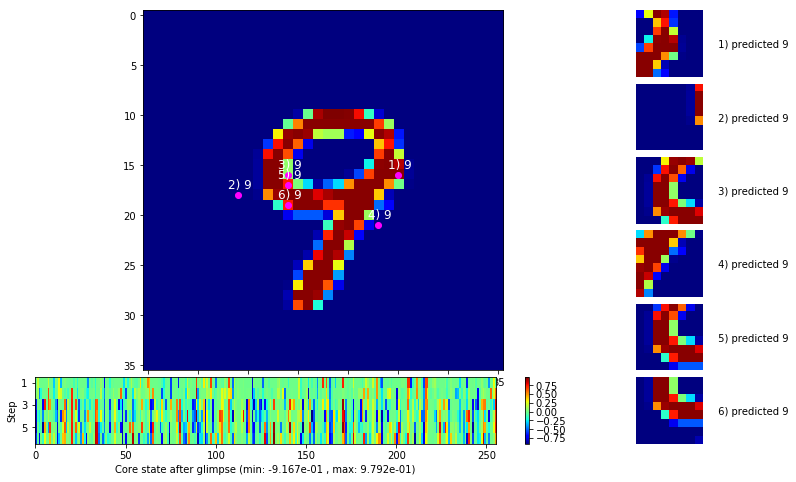


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


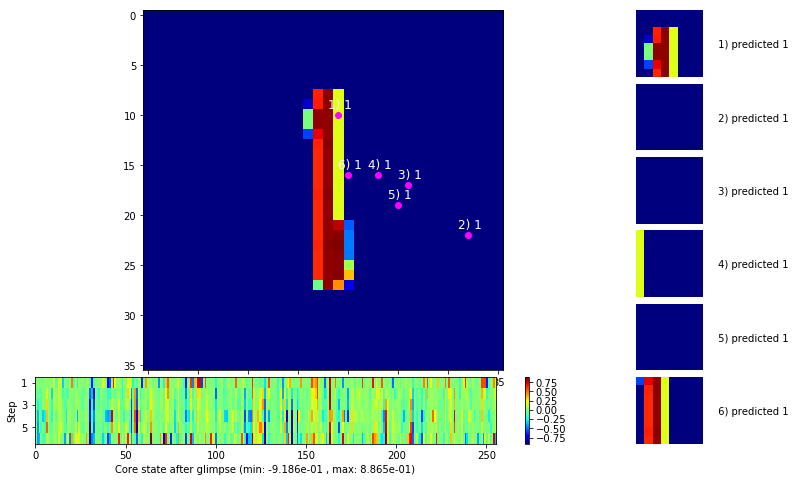

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


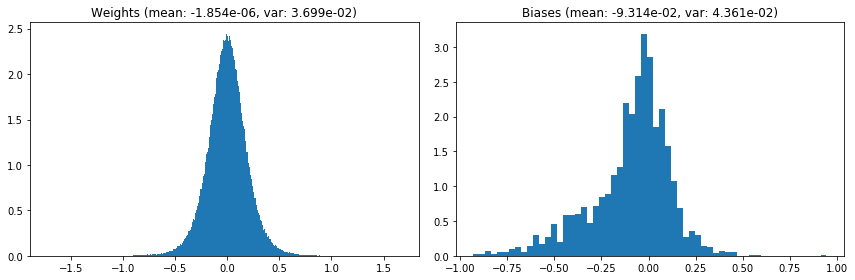

                                      Location network weights and biases


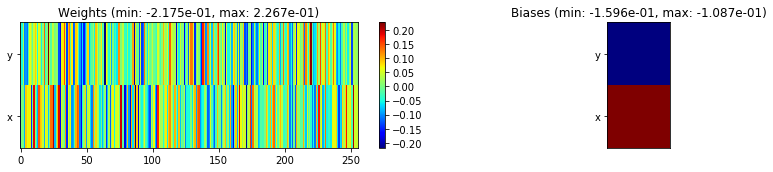

---------------------------------------------------------------------------------------------------------------
Elapsed time:  386.73 sec | TRAIN >> class loss: 0.2429 | steps:  2.253    | reward:  0.9236    | acc.: 92.365% 
                          | VAL   >> class loss: 0.1809 | steps:  2.051    | reward:  0.9442 :( | acc.: 94.420% :(


Epoch  25/400) lr = 0.0004188
 b    500/  3000 >> 127.6 ms/b | lr: 4.17e-04 | grad 2norm:  5.45 | grad inf norm:  1.380
       Weights || abs max:  1.73 (38234.57) | mean: -9.39e-06 ( 0.14) | var: 3.70e-02 (88453.12)
        Biases || abs max:  0.94 (  193.83) | mean: -9.33e-02 ( 0.25) | var: 4.36e-02 (  107.92)
                  class loss: 0.244 | steps: 2.232 | reward:  0.922 | acc.: 92.21%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.1 ms/b | lr: 4.15e-04 | grad 2norm:  5.13 | grad inf norm:  1.314
       Weights || abs max:  1.74 (34575.80) | mean: -9.29e-06 ( 0.13) | v

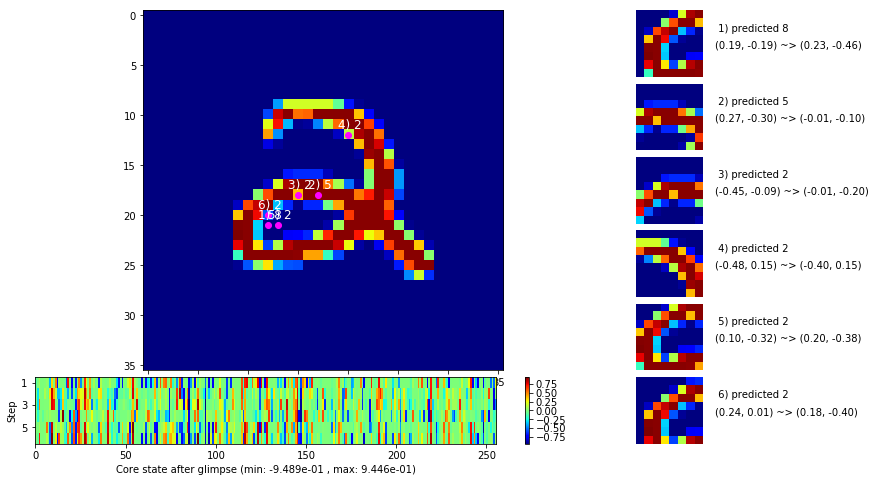

 b   1500/  3000 >> 147.2 ms/b | lr: 4.12e-04 | grad 2norm:  5.18 | grad inf norm:  1.318
       Weights || abs max:  1.73 (26244.34) | mean:  9.23e-06 ( 0.12) | var: 3.72e-02 (15085.51)
        Biases || abs max:  0.94 (  297.92) | mean: -9.35e-02 ( 0.29) | var: 4.38e-02 (  322.80)
                  class loss: 0.221 | steps: 2.232 | reward:  0.929 | acc.: 92.87%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.8 ms/b | lr: 4.10e-04 | grad 2norm:  5.24 | grad inf norm:  1.320
       Weights || abs max:  1.73 (27493.08) | mean:  1.81e-05 ( 0.11) | var: 3.72e-02 (32770.01)
        Biases || abs max:  0.94 (  184.96) | mean: -9.39e-02 ( 0.24) | var: 4.39e-02 (  336.78)
                  class loss: 0.235 | steps: 2.247 | reward:  0.927 | acc.: 92.66%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

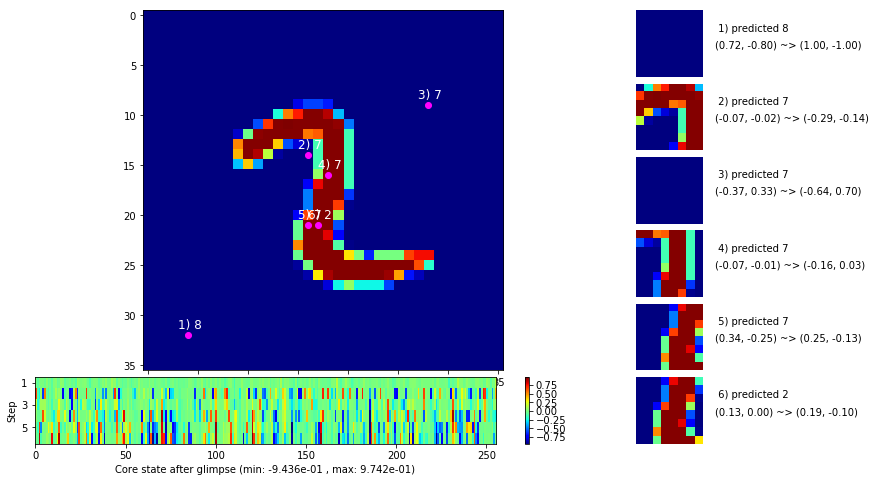

 b   2500/  3000 >> 128.4 ms/b | lr: 4.07e-04 | grad 2norm:  5.18 | grad inf norm:  1.375
       Weights || abs max:  1.74 (28553.59) | mean:  8.51e-06 ( 0.12) | var: 3.73e-02 (28466.85)
        Biases || abs max:  0.94 (  220.26) | mean: -9.39e-02 ( 0.26) | var: 4.40e-02 (  113.71)
                  class loss: 0.217 | steps: 2.227 | reward:  0.930 | acc.: 92.99%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 126.3 ms/b | lr: 4.05e-04 | grad 2norm:  5.10 | grad inf norm:  1.313
       Weights || abs max:  1.77 (35702.89) | mean: -1.18e-05 ( 0.13) | var: 3.74e-02 (51305.22)
        Biases || abs max:  0.94 ( 7780.30) | mean: -9.44e-02 ( 5.92) | var: 4.43e-02 (17624578.00)
                  class loss: 0.220 | steps: 2.217 | reward:  0.929 | acc.: 92.91%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

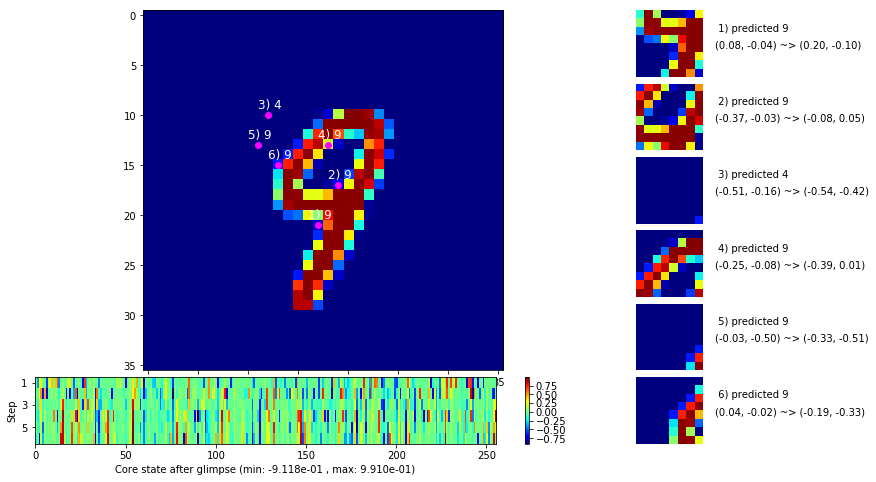

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


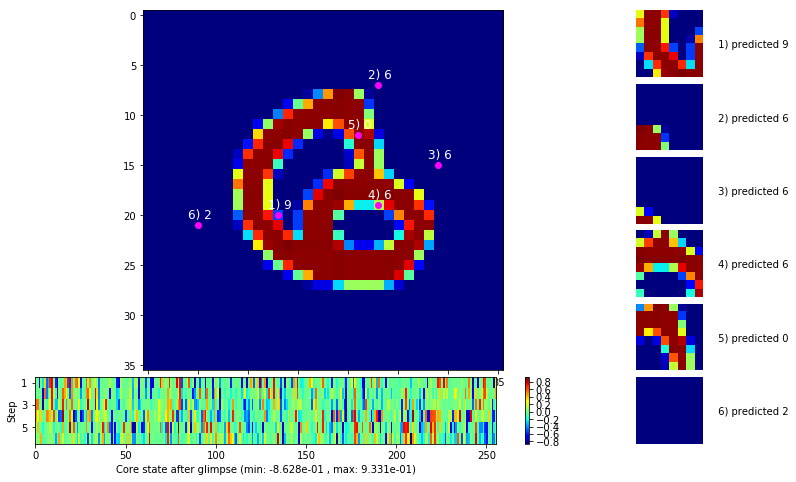


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


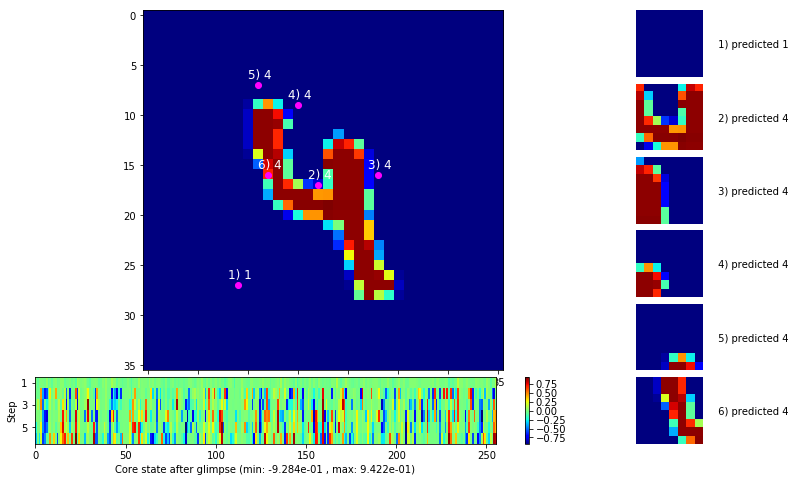

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


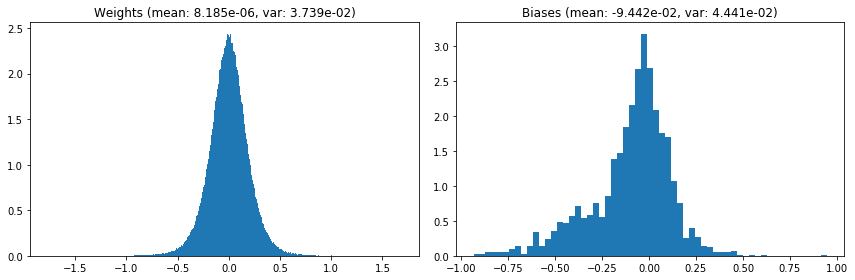

                                      Location network weights and biases


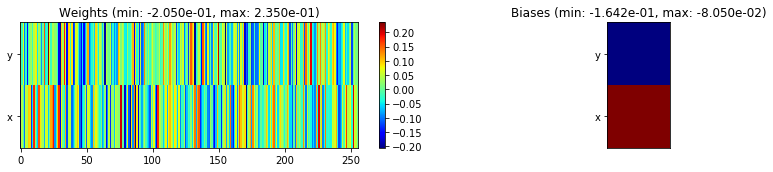

---------------------------------------------------------------------------------------------------------------
Elapsed time:  394.84 sec | TRAIN >> class loss: 0.2275 | steps:  2.230    | reward:  0.9277    | acc.: 92.768% 
                          | VAL   >> class loss: 0.1610 | steps:  2.013    | reward:  0.9484    | acc.: 94.840% 


Epoch  26/400) lr = 0.0004045
 b    500/  3000 >> 128.3 ms/b | lr: 4.03e-04 | grad 2norm:  5.31 | grad inf norm:  1.291
       Weights || abs max:  1.77 (26186.96) | mean:  2.63e-06 ( 0.12) | var: 3.74e-02 (28193.91)
        Biases || abs max:  0.94 (  433.74) | mean: -9.48e-02 ( 0.41) | var: 4.45e-02 ( 4622.33)
                  class loss: 0.233 | steps: 2.243 | reward:  0.926 | acc.: 92.59%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.3 ms/b | lr: 4.01e-04 | grad 2norm:  5.05 | grad inf norm:  1.355
       Weights || abs max:  1.79 (22646.94) | mean:  1.58e-05 ( 0.11) | var

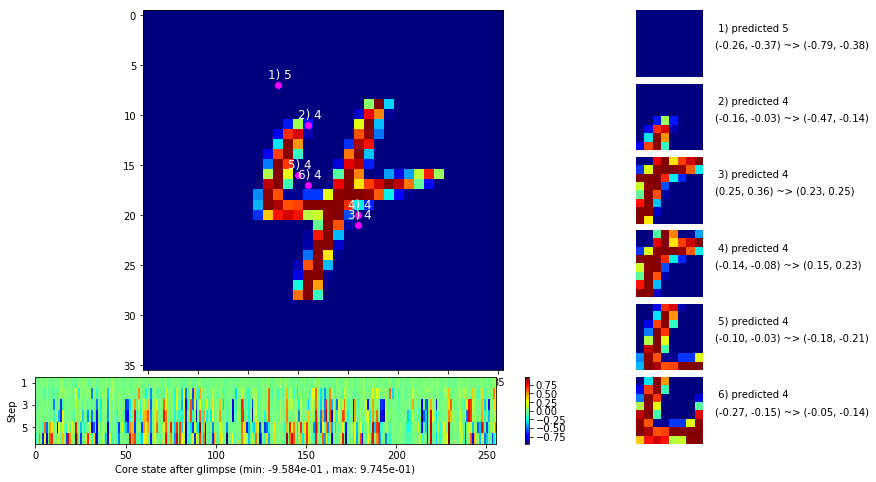

 b   1500/  3000 >> 131.5 ms/b | lr: 3.98e-04 | grad 2norm:  5.24 | grad inf norm:  1.360
       Weights || abs max:  1.80 (142565.16) | mean:  3.01e-05 ( 0.33) | var: 3.76e-02 (7080084.00)
        Biases || abs max:  0.94 (  238.95) | mean: -9.52e-02 ( 0.28) | var: 4.45e-02 ( 1573.64)
                  class loss: 0.230 | steps: 2.221 | reward:  0.927 | acc.: 92.72%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 127.1 ms/b | lr: 3.96e-04 | grad 2norm:  5.07 | grad inf norm:  1.329
       Weights || abs max:  1.80 (44928.51) | mean:  3.59e-05 ( 0.15) | var: 3.76e-02 (296407.31)
        Biases || abs max:  0.94 (  433.00) | mean: -9.52e-02 ( 0.33) | var: 4.45e-02 ( 2897.53)
                  class loss: 0.222 | steps: 2.200 | reward:  0.929 | acc.: 92.93%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 

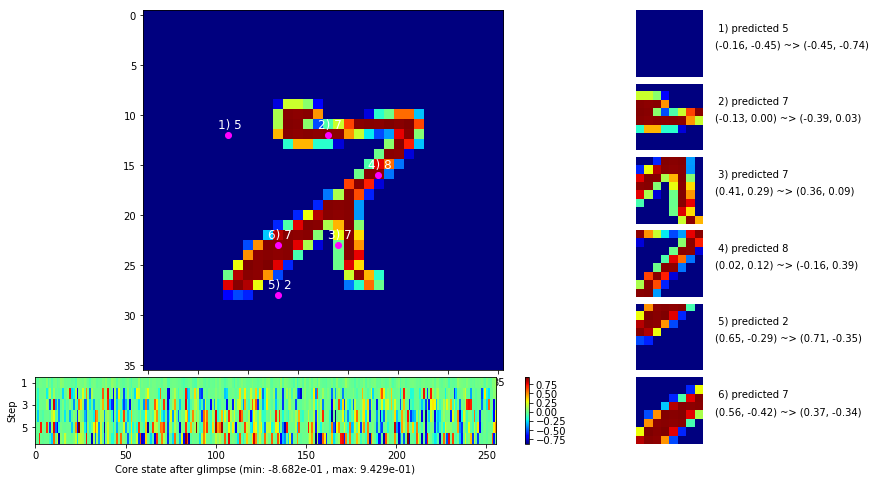

 b   2500/  3000 >> 131.0 ms/b | lr: 3.94e-04 | grad 2norm:  5.04 | grad inf norm:  1.329
       Weights || abs max:  1.80 (27672.23) | mean:  2.96e-05 ( 0.12) | var: 3.77e-02 (23159.95)
        Biases || abs max:  0.94 (  548.68) | mean: -9.52e-02 ( 0.42) | var: 4.46e-02 ( 4841.78)
                  class loss: 0.220 | steps: 2.213 | reward:  0.930 | acc.: 93.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.4 ms/b | lr: 3.92e-04 | grad 2norm:  5.11 | grad inf norm:  1.348
       Weights || abs max:  1.81 (24321.23) | mean:  2.50e-05 ( 0.11) | var: 3.77e-02 ( 9316.54)
        Biases || abs max:  0.94 (  625.59) | mean: -9.60e-02 ( 0.45) | var: 4.48e-02 (20586.17)
                  class loss: 0.230 | steps: 2.196 | reward:  0.928 | acc.: 92.84%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

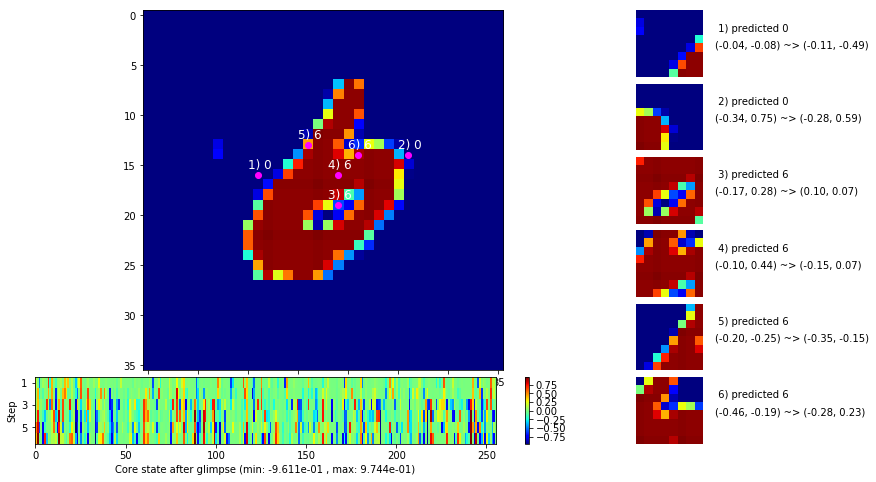

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


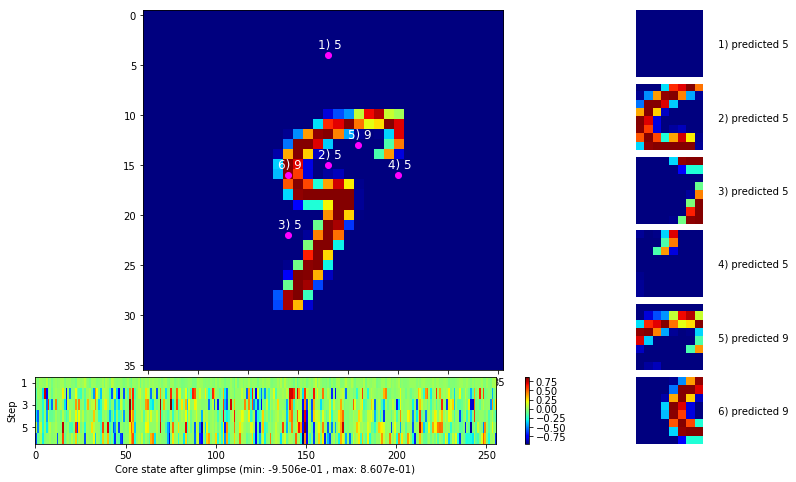


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


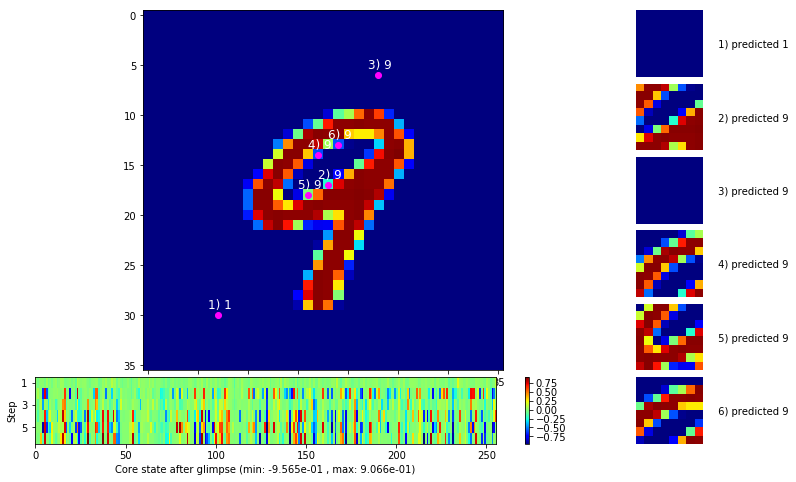

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


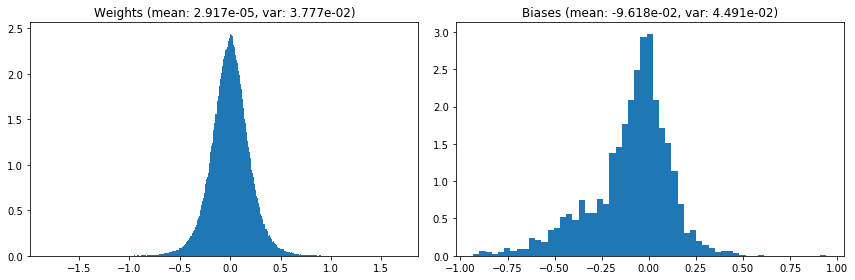

                                      Location network weights and biases


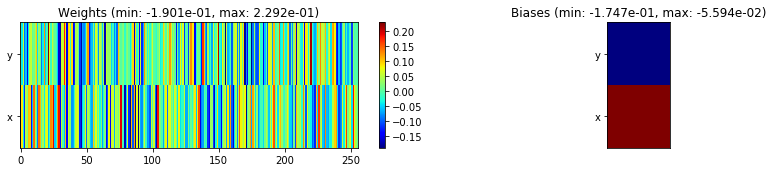

---------------------------------------------------------------------------------------------------------------
Elapsed time:  395.88 sec | TRAIN >> class loss: 0.2272 | steps:  2.217    | reward:  0.9283    | acc.: 92.830% 
                          | VAL   >> class loss: 0.1547 | steps:  2.038 :( | reward:  0.9512    | acc.: 95.120% 


Epoch  27/400) lr = 0.0003913
 b    500/  3000 >> 128.0 ms/b | lr: 3.90e-04 | grad 2norm:  5.02 | grad inf norm:  1.290
       Weights || abs max:  1.81 (35298.29) | mean:  2.74e-05 ( 0.13) | var: 3.78e-02 (191356.75)
        Biases || abs max:  0.94 (  557.95) | mean: -9.63e-02 ( 0.41) | var: 4.50e-02 ( 8027.20)
                  class loss: 0.220 | steps: 2.211 | reward:  0.931 | acc.: 93.09%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.7 ms/b | lr: 3.88e-04 | grad 2norm:  5.06 | grad inf norm:  1.252
       Weights || abs max:  1.82 (39488.52) | mean:  3.75e-05 ( 0.14) | va

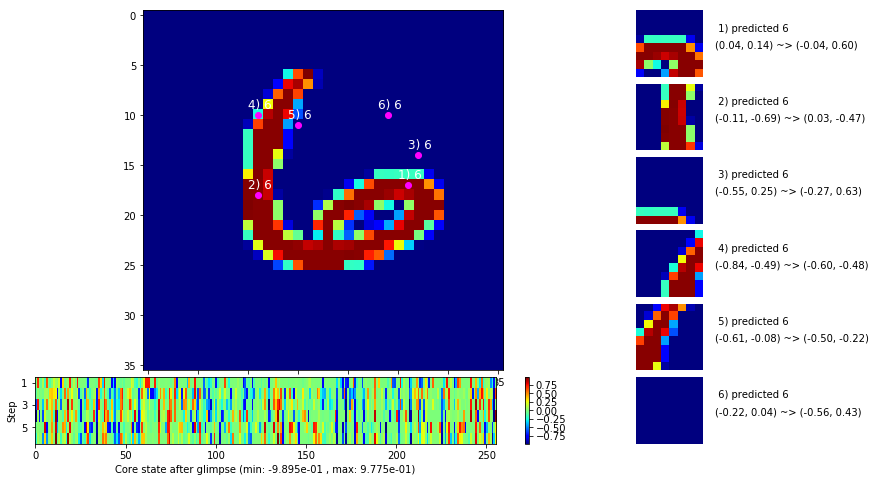

 b   1500/  3000 >> 128.9 ms/b | lr: 3.85e-04 | grad 2norm:  5.14 | grad inf norm:  1.323
       Weights || abs max:  1.84 (223387.50) | mean:  6.22e-05 ( 0.48) | var: 3.79e-02 (33726240.00)
        Biases || abs max:  0.94 (  259.12) | mean: -9.61e-02 ( 0.27) | var: 4.52e-02 (  216.54)
                  class loss: 0.216 | steps: 2.200 | reward:  0.931 | acc.: 93.11%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.7 ms/b | lr: 3.84e-04 | grad 2norm:  4.90 | grad inf norm:  1.319
       Weights || abs max:  1.85 (53381.81) | mean:  3.22e-05 ( 0.17) | var: 3.80e-02 (575764.31)
        Biases || abs max:  0.95 (  181.54) | mean: -9.62e-02 ( 0.26) | var: 4.53e-02 (  139.42)
                  class loss: 0.211 | steps: 2.194 | reward:  0.934 | acc.: 93.36%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

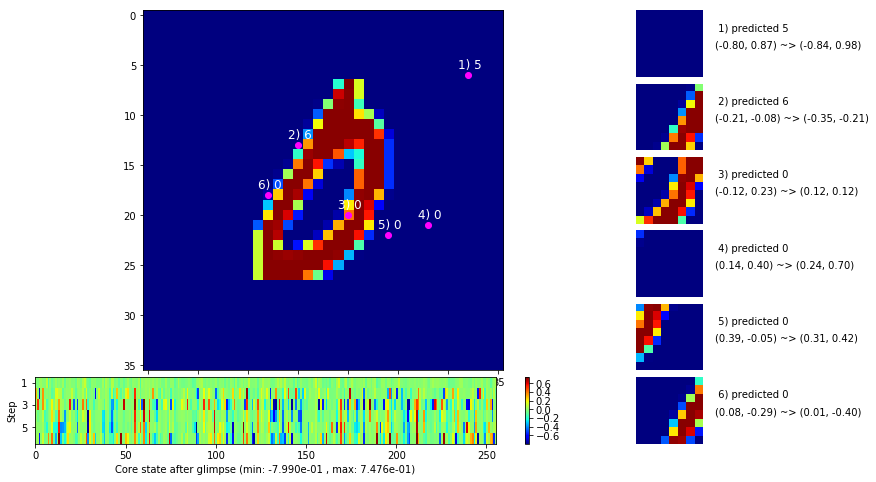

 b   2500/  3000 >> 130.3 ms/b | lr: 3.81e-04 | grad 2norm:  5.00 | grad inf norm:  1.286
       Weights || abs max:  1.86 (29255.86) | mean: -2.71e-06 ( 0.12) | var: 3.81e-02 (39468.33)
        Biases || abs max:  0.95 (  356.26) | mean: -9.65e-02 ( 0.35) | var: 4.54e-02 ( 2603.08)
                  class loss: 0.215 | steps: 2.217 | reward:  0.933 | acc.: 93.31%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 128.6 ms/b | lr: 3.80e-04 | grad 2norm:  5.12 | grad inf norm:  1.350
       Weights || abs max:  1.86 (111817.21) | mean: -3.42e-05 ( 0.28) | var: 3.81e-02 (3658181.50)
        Biases || abs max:  0.95 (  547.06) | mean: -9.69e-02 ( 0.45) | var: 4.54e-02 ( 7766.21)
                  class loss: 0.220 | steps: 2.205 | reward:  0.930 | acc.: 93.02%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

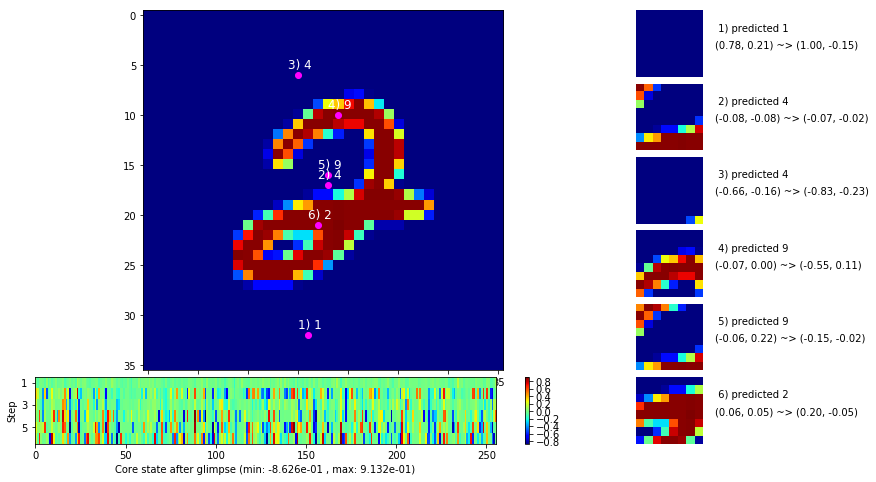

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


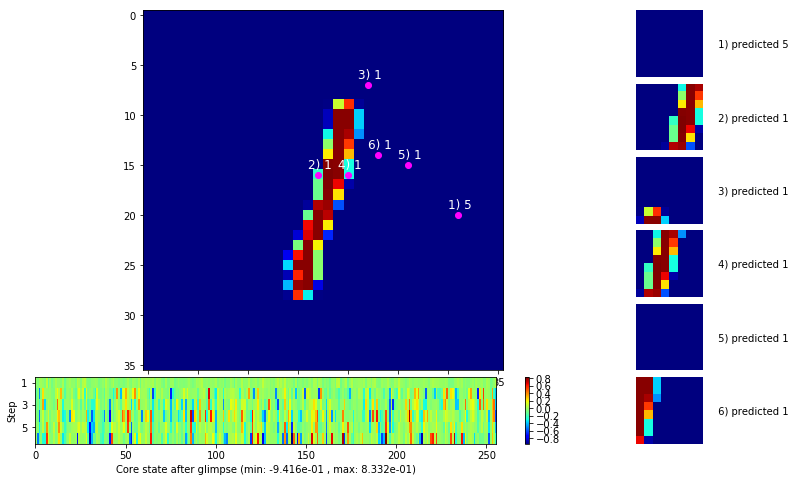


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


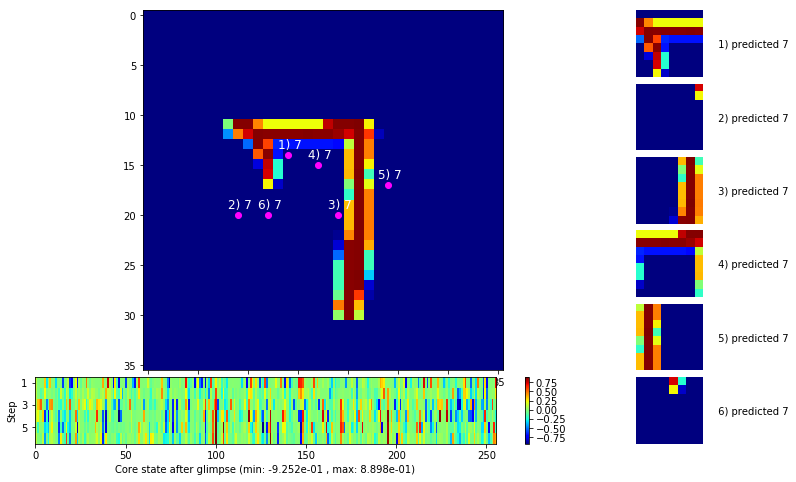

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


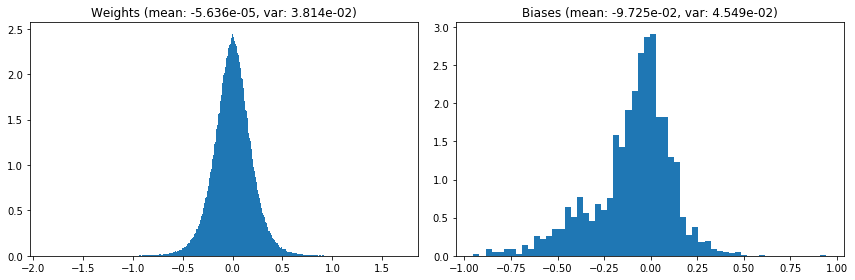

                                      Location network weights and biases


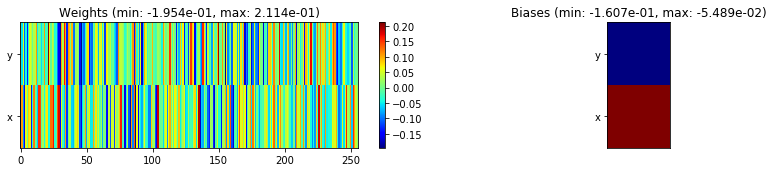

---------------------------------------------------------------------------------------------------------------
Elapsed time:  387.72 sec | TRAIN >> class loss: 0.2163 | steps:  2.199    | reward:  0.9316    | acc.: 93.165% 
                          | VAL   >> class loss: 0.1509 | steps:  2.033 :( | reward:  0.9518    | acc.: 95.180% 


Epoch  28/400) lr = 0.000379
 b    500/  3000 >> 128.2 ms/b | lr: 3.77e-04 | grad 2norm:  5.03 | grad inf norm:  1.341
       Weights || abs max:  1.86 (153064.66) | mean: -4.91e-05 ( 0.35) | var: 3.82e-02 (9015427.00)
        Biases || abs max:  0.95 (  183.54) | mean: -9.71e-02 ( 0.26) | var: 4.55e-02 (  318.27)
                  class loss: 0.214 | steps: 2.211 | reward:  0.931 | acc.: 93.07%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.4 ms/b | lr: 3.76e-04 | grad 2norm:  5.05 | grad inf norm:  1.302
       Weights || abs max:  1.87 (24829.87) | mean: -3.74e-05 ( 0.11) | v

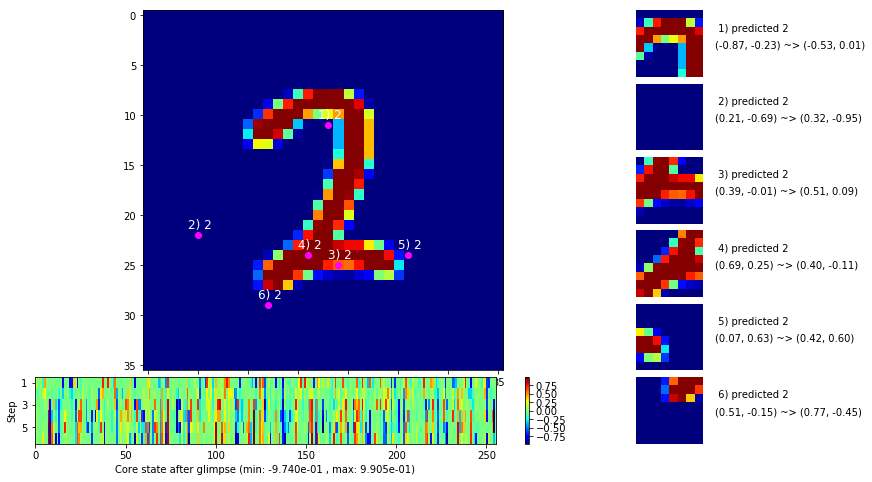

 b   1500/  3000 >> 147.3 ms/b | lr: 3.74e-04 | grad 2norm:  5.01 | grad inf norm:  1.265
       Weights || abs max:  1.87 (38113.59) | mean: -2.24e-05 ( 0.14) | var: 3.83e-02 (94358.49)
        Biases || abs max:  0.96 ( 1081.81) | mean: -9.80e-02 ( 0.66) | var: 4.57e-02 (56063.11)
                  class loss: 0.210 | steps: 2.208 | reward:  0.933 | acc.: 93.27%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.0 ms/b | lr: 3.72e-04 | grad 2norm:  5.09 | grad inf norm:  1.325
       Weights || abs max:  1.87 (112426.64) | mean: -4.16e-05 ( 0.28) | var: 3.83e-02 (3540512.25)
        Biases || abs max:  0.95 (  202.26) | mean: -9.77e-02 ( 0.28) | var: 4.57e-02 (  260.25)
                  class loss: 0.217 | steps: 2.216 | reward:  0.930 | acc.: 93.00%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

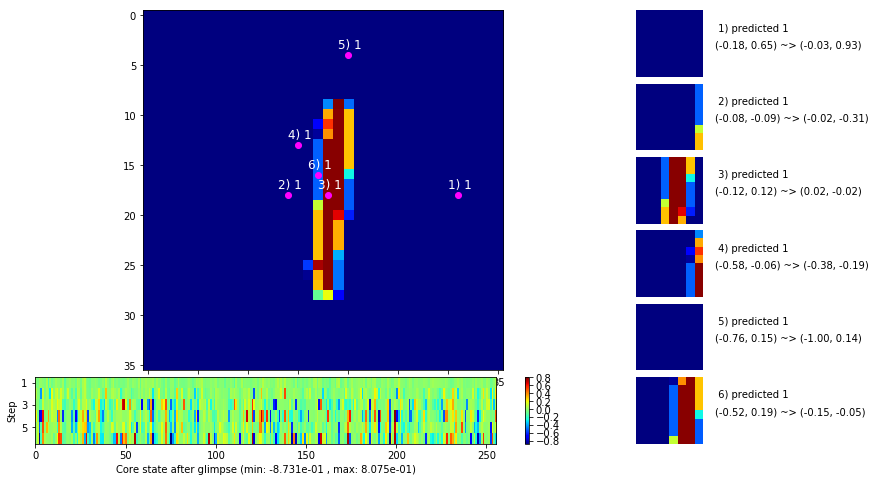

 b   2500/  3000 >> 129.0 ms/b | lr: 3.70e-04 | grad 2norm:  5.15 | grad inf norm:  1.359
       Weights || abs max:  1.87 (137778.50) | mean: -7.50e-05 ( 0.32) | var: 3.84e-02 (9018374.00)
        Biases || abs max:  0.96 (  311.52) | mean: -9.83e-02 ( 0.35) | var: 4.58e-02 ( 2559.09)
                  class loss: 0.218 | steps: 2.207 | reward:  0.929 | acc.: 92.86%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.8 ms/b | lr: 3.68e-04 | grad 2norm:  4.93 | grad inf norm:  1.263
       Weights || abs max:  1.87 (1669014.12) | mean: -9.08e-05 ( 3.13) | var: 3.84e-02 (2484795904.00)
        Biases || abs max:  0.97 ( 4451.16) | mean: -9.90e-02 ( 1.94) | var: 4.60e-02 (3388985.00)
                  class loss: 0.221 | steps: 2.227 | reward:  0.931 | acc.: 93.10%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.

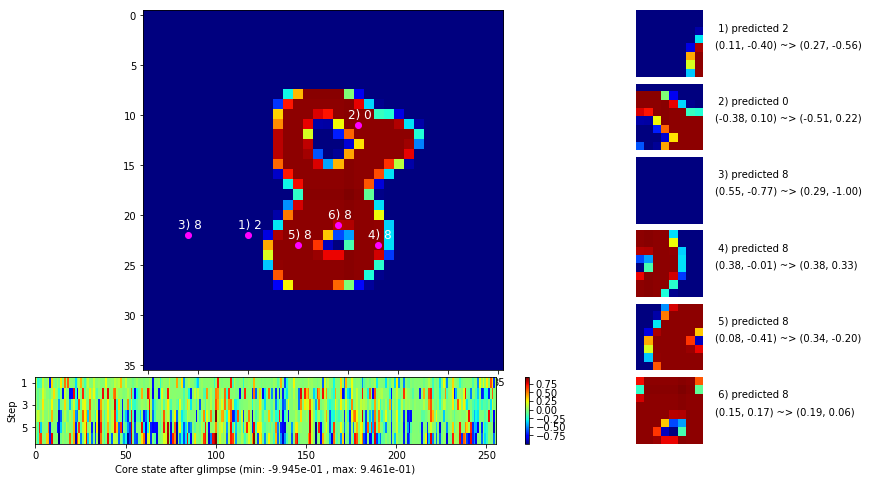

                                          ---===  VALIDATION  ===---

	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


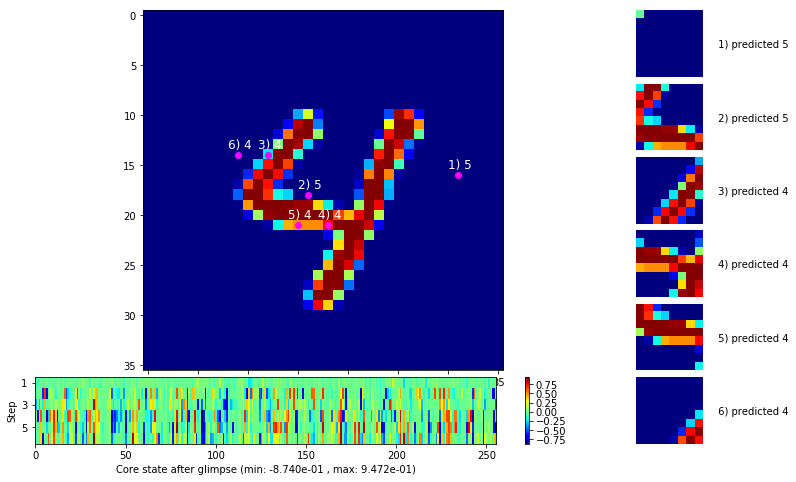


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


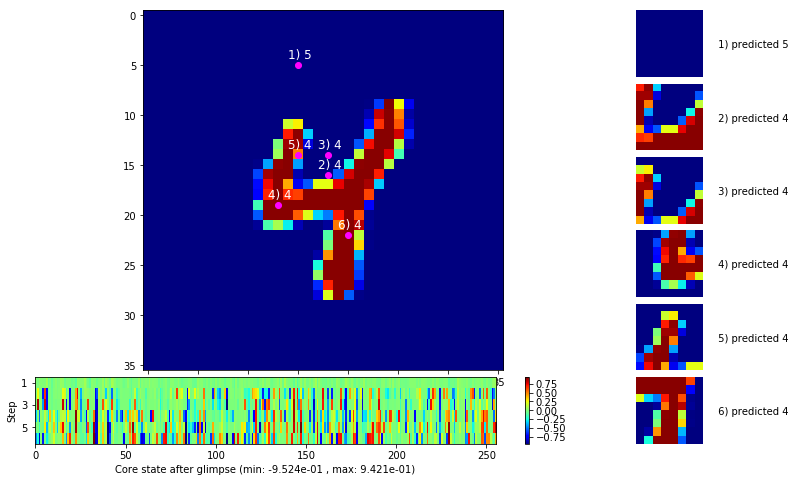

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


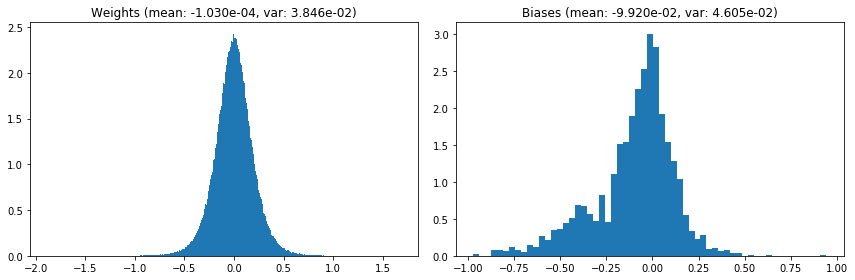

                                      Location network weights and biases


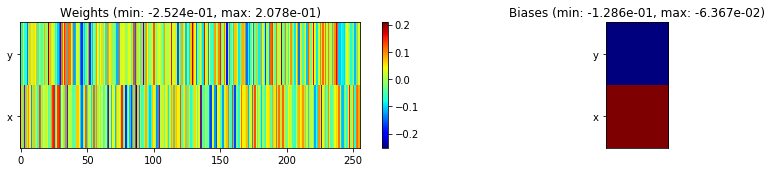

---------------------------------------------------------------------------------------------------------------
Elapsed time:  395.87 sec | TRAIN >> class loss: 0.2167 | steps:  2.210 :( | reward:  0.9310 :( | acc.: 93.100% :(
                          | VAL   >> class loss: 0.1511 | steps:  2.058 :( | reward:  0.9478 :( | acc.: 94.780% :(


Epoch  29/400) lr = 0.0003675
 b    500/  3000 >> 128.9 ms/b | lr: 3.66e-04 | grad 2norm:  4.88 | grad inf norm:  1.320
       Weights || abs max:  1.88 (32745.82) | mean: -1.06e-04 ( 0.12) | var: 3.85e-02 (118716.13)
        Biases || abs max:  0.97 (  368.08) | mean: -9.89e-02 ( 0.35) | var: 4.60e-02 ( 2240.55)
                  class loss: 0.206 | steps: 2.175 | reward:  0.933 | acc.: 93.31%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.3 ms/b | lr: 3.65e-04 | grad 2norm:  4.87 | grad inf norm:  1.264
       Weights || abs max:  1.88 (67363.22) | mean: -1.18e-04 ( 0.19) 

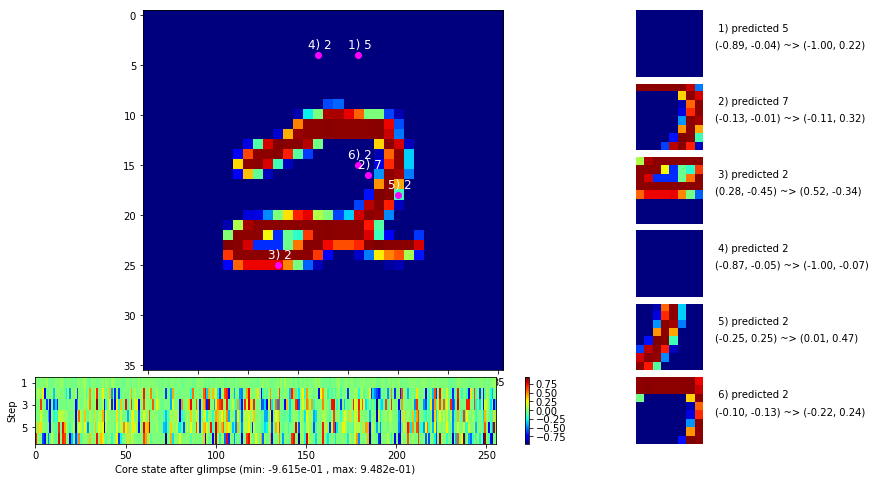

 b   1500/  3000 >> 130.8 ms/b | lr: 3.62e-04 | grad 2norm:  5.15 | grad inf norm:  1.327
       Weights || abs max:  1.89 (159816.88) | mean: -1.11e-04 ( 0.36) | var: 3.86e-02 (11395325.00)
        Biases || abs max:  0.97 (  366.45) | mean: -9.97e-02 ( 0.42) | var: 4.61e-02 ( 2032.35)
                  class loss: 0.225 | steps: 2.231 | reward:  0.927 | acc.: 92.69%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 127.3 ms/b | lr: 3.61e-04 | grad 2norm:  4.77 | grad inf norm:  1.328
       Weights || abs max:  1.89 (29321.56) | mean: -9.56e-05 ( 0.12) | var: 3.87e-02 (55881.49)
        Biases || abs max:  0.98 ( 2192.15) | mean: -9.97e-02 ( 1.36) | var: 4.62e-02 (200272.53)
                  class loss: 0.202 | steps: 2.209 | reward:  0.936 | acc.: 93.61%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

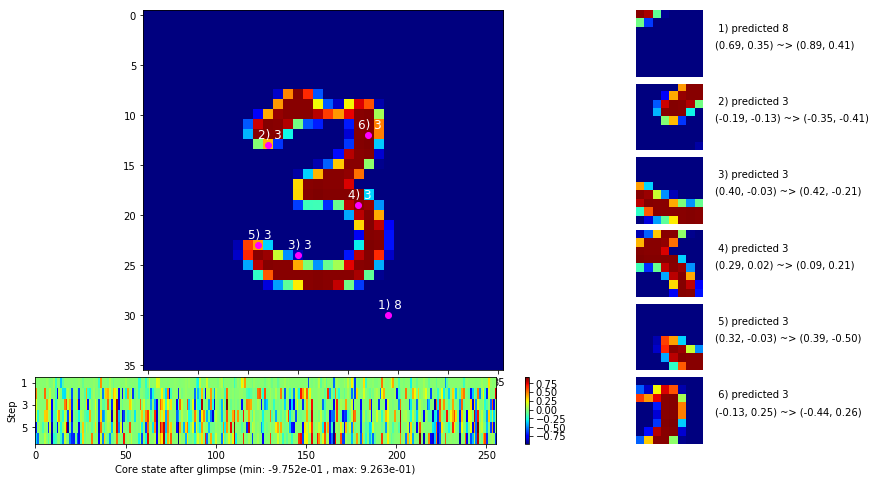

 b   2500/  3000 >> 132.4 ms/b | lr: 3.59e-04 | grad 2norm:  4.81 | grad inf norm:  1.274
       Weights || abs max:  1.90 (28537.21) | mean: -9.58e-05 ( 0.12) | var: 3.87e-02 (33129.42)
        Biases || abs max:  0.98 (  405.29) | mean: -9.99e-02 ( 0.31) | var: 4.63e-02 ( 2611.16)
                  class loss: 0.206 | steps: 2.194 | reward:  0.935 | acc.: 93.49%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.4 ms/b | lr: 3.57e-04 | grad 2norm:  4.95 | grad inf norm:  1.300
       Weights || abs max:  1.90 (30846.21) | mean: -9.68e-05 ( 0.12) | var: 3.88e-02 (26803.08)
        Biases || abs max:  0.98 (  237.51) | mean: -9.99e-02 ( 0.28) | var: 4.64e-02 (  613.20)
                  class loss: 0.205 | steps: 2.191 | reward:  0.932 | acc.: 93.22%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

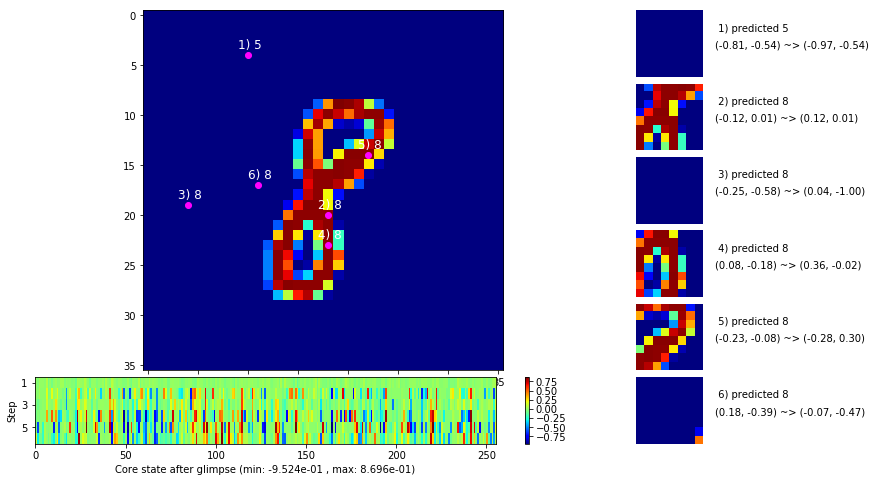

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


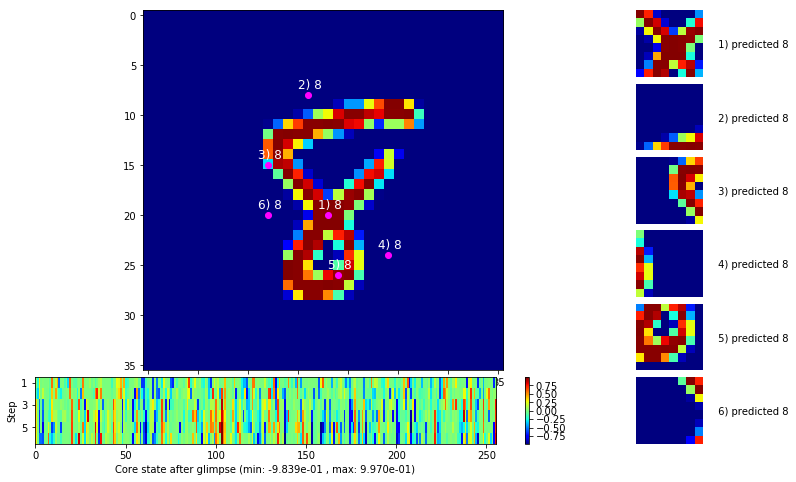


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


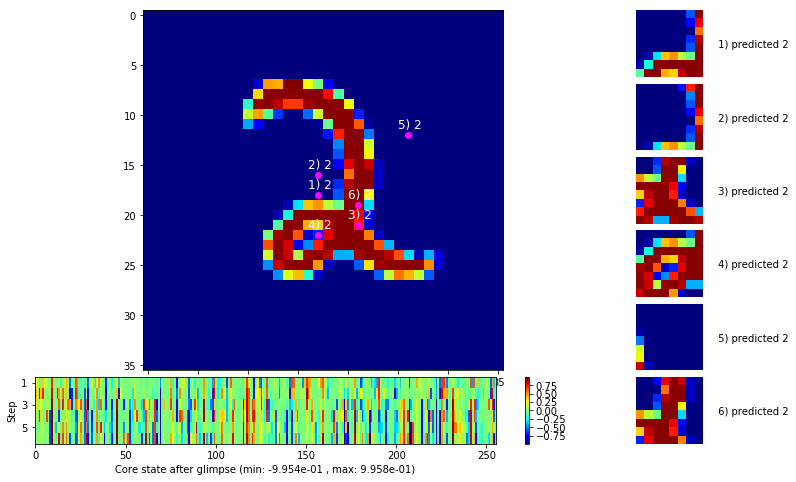

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


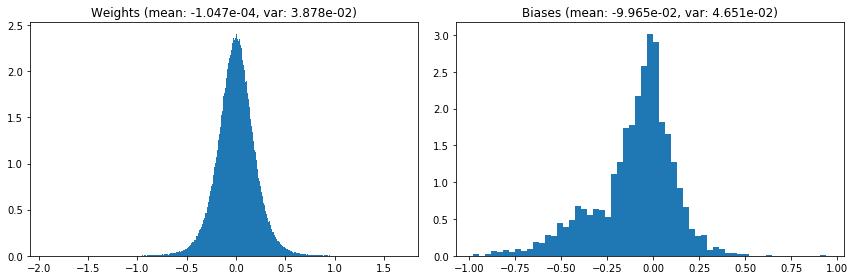

                                      Location network weights and biases


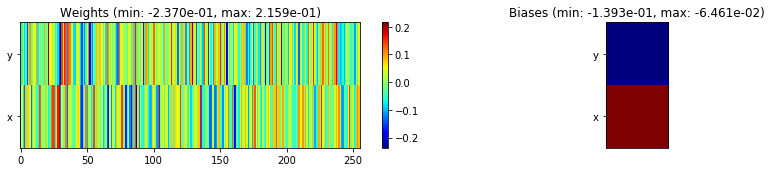

---------------------------------------------------------------------------------------------------------------
Elapsed time:  397.26 sec | TRAIN >> class loss: 0.2096 | steps:  2.198    | reward:  0.9329    | acc.: 93.293% 
                          | VAL   >> class loss: 0.1499 | steps:  2.005    | reward:  0.9504 :( | acc.: 95.040% :(


Epoch  30/400) lr = 0.0003567
 b    500/  3000 >> 134.4 ms/b | lr: 3.55e-04 | grad 2norm:  4.68 | grad inf norm:  1.247
       Weights || abs max:  1.91 (25751.10) | mean: -1.03e-04 ( 0.11) | var: 3.88e-02 (15819.19)
        Biases || abs max:  0.97 (  250.55) | mean: -9.97e-02 ( 0.27) | var: 4.65e-02 ( 1064.39)
                  class loss: 0.197 | steps: 2.200 | reward:  0.939 | acc.: 93.86%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.9 ms/b | lr: 3.54e-04 | grad 2norm:  4.66 | grad inf norm:  1.232
       Weights || abs max:  1.92 (63762.35) | mean: -1.18e-04 ( 0.18) | v

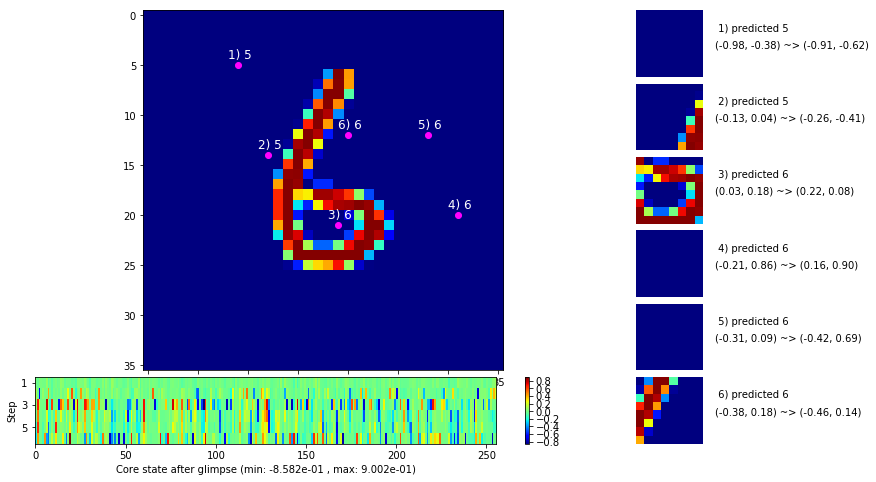

 b   1500/  3000 >> 128.0 ms/b | lr: 3.52e-04 | grad 2norm:  4.80 | grad inf norm:  1.260
       Weights || abs max:  1.92 (35569.95) | mean: -1.26e-04 ( 0.14) | var: 3.89e-02 (26475.25)
        Biases || abs max:  0.97 (  227.68) | mean: -1.00e-01 ( 0.26) | var: 4.66e-02 (  446.25)
                  class loss: 0.208 | steps: 2.191 | reward:  0.934 | acc.: 93.38%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.4 ms/b | lr: 3.51e-04 | grad 2norm:  4.69 | grad inf norm:  1.266
       Weights || abs max:  1.92 (46421.36) | mean: -1.40e-04 ( 0.15) | var: 3.89e-02 (235375.62)
        Biases || abs max:  0.97 (  256.89) | mean: -1.01e-01 ( 0.26) | var: 4.68e-02 (  460.55)
                  class loss: 0.200 | steps: 2.176 | reward:  0.936 | acc.: 93.65%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

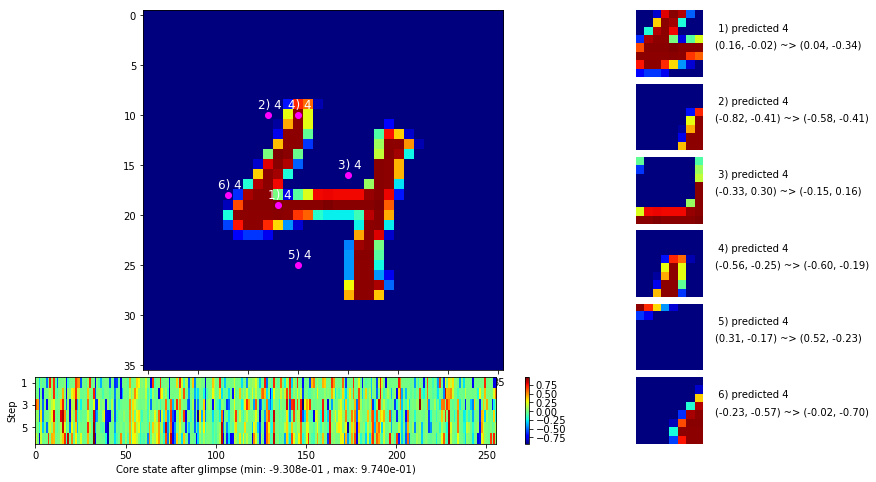

 b   2500/  3000 >> 129.0 ms/b | lr: 3.49e-04 | grad 2norm:  4.86 | grad inf norm:  1.245
       Weights || abs max:  1.92 (26756.76) | mean: -1.33e-04 ( 0.12) | var: 3.90e-02 ( 9851.46)
        Biases || abs max:  0.97 (  442.37) | mean: -1.01e-01 ( 0.36) | var: 4.68e-02 ( 2020.13)
                  class loss: 0.202 | steps: 2.176 | reward:  0.935 | acc.: 93.54%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.6 ms/b | lr: 3.47e-04 | grad 2norm:  4.75 | grad inf norm:  1.271
       Weights || abs max:  1.92 (38215.51) | mean: -1.48e-04 ( 0.14) | var: 3.90e-02 (40420.96)
        Biases || abs max:  0.98 (  402.26) | mean: -1.01e-01 ( 0.36) | var: 4.68e-02 (  611.14)
                  class loss: 0.207 | steps: 2.183 | reward:  0.936 | acc.: 93.64%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

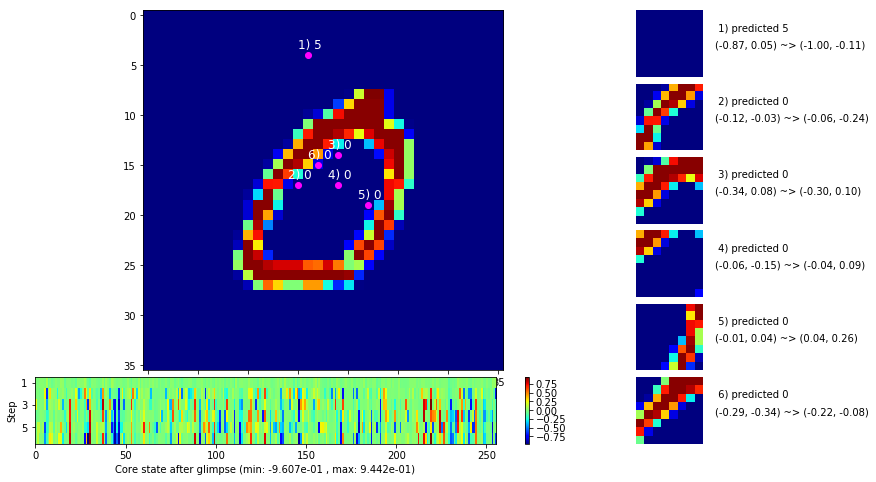

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


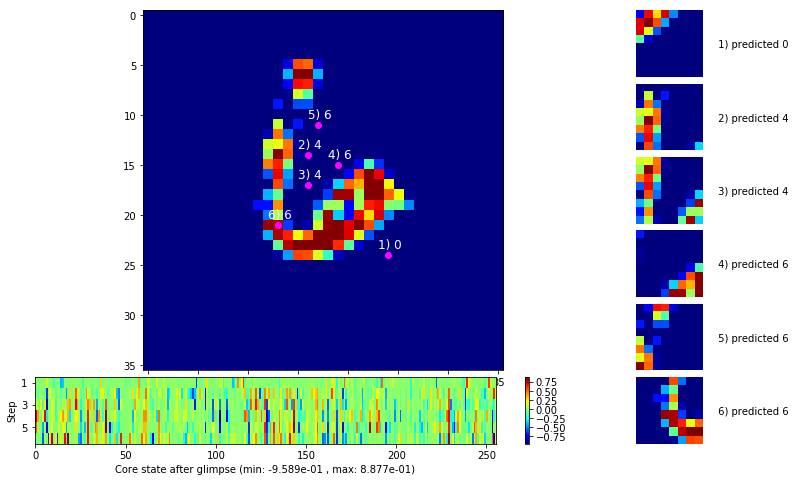


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


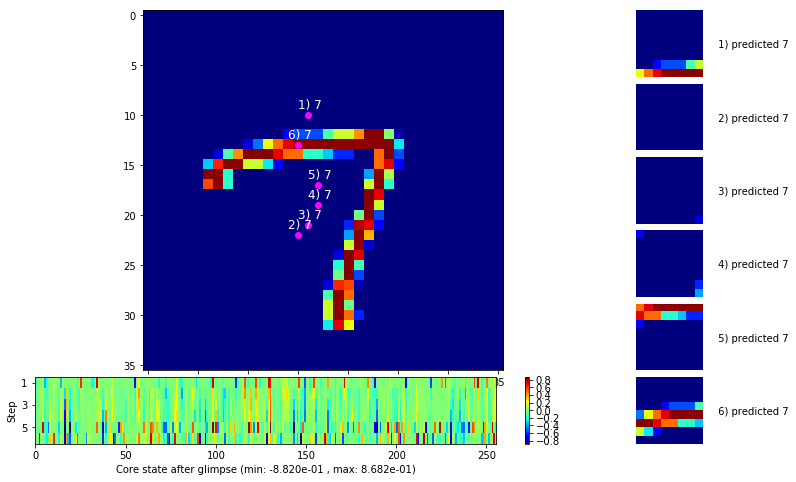

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


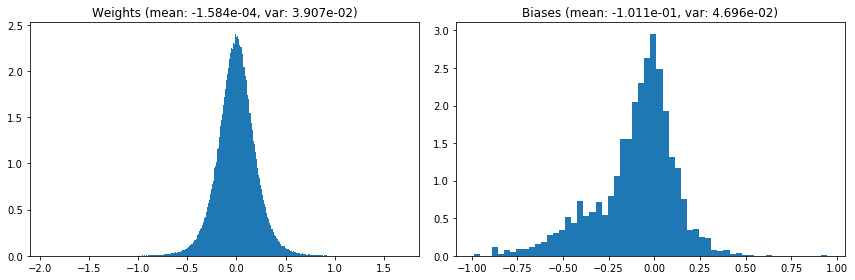

                                      Location network weights and biases


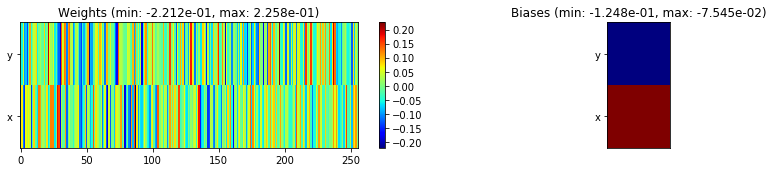

---------------------------------------------------------------------------------------------------------------
Elapsed time:  391.70 sec | TRAIN >> class loss: 0.2018 | steps:  2.184    | reward:  0.9365    | acc.: 93.653% 
                          | VAL   >> class loss: 0.1569 | steps:  2.019 :( | reward:  0.9518    | acc.: 95.180% 


Epoch  31/400) lr = 0.0003466
 b    500/  3000 >> 130.0 ms/b | lr: 3.45e-04 | grad 2norm:  5.00 | grad inf norm:  1.308
       Weights || abs max:  1.92 (34077.73) | mean: -1.65e-04 ( 0.13) | var: 3.91e-02 (44700.64)
        Biases || abs max:  1.00 (  304.72) | mean: -1.01e-01 ( 0.31) | var: 4.71e-02 (  230.79)
                  class loss: 0.210 | steps: 2.191 | reward:  0.932 | acc.: 93.16%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 134.0 ms/b | lr: 3.44e-04 | grad 2norm:  4.69 | grad inf norm:  1.217
       Weights || abs max:  1.92 (30791.87) | mean: -1.61e-04 ( 0.13) | var

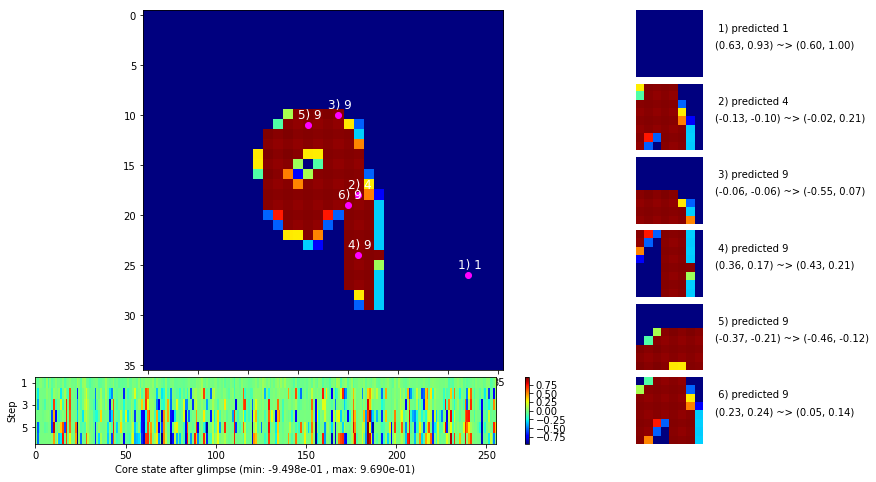

 b   1500/  3000 >> 143.5 ms/b | lr: 3.42e-04 | grad 2norm:  4.74 | grad inf norm:  1.275
       Weights || abs max:  1.93 (50649.84) | mean: -1.51e-04 ( 0.16) | var: 3.92e-02 (146682.06)
        Biases || abs max:  1.00 (  623.47) | mean: -1.01e-01 ( 0.48) | var: 4.72e-02 ( 4426.98)
                  class loss: 0.199 | steps: 2.170 | reward:  0.938 | acc.: 93.83%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.3 ms/b | lr: 3.41e-04 | grad 2norm:  4.77 | grad inf norm:  1.287
       Weights || abs max:  1.94 (31919.74) | mean: -1.52e-04 ( 0.13) | var: 3.92e-02 (41060.00)
        Biases || abs max:  1.00 (  662.79) | mean: -1.01e-01 ( 0.44) | var: 4.73e-02 ( 5123.98)
                  class loss: 0.200 | steps: 2.190 | reward:  0.937 | acc.: 93.74%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

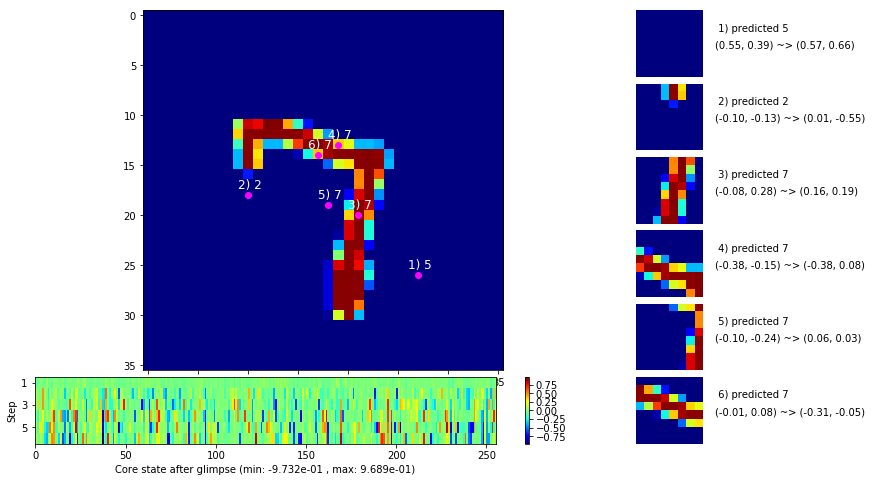

 b   2500/  3000 >> 131.0 ms/b | lr: 3.39e-04 | grad 2norm:  4.93 | grad inf norm:  1.289
       Weights || abs max:  1.94 (710890.12) | mean: -1.61e-04 ( 1.38) | var: 3.93e-02 (423100192.00)
        Biases || abs max:  1.00 (  267.56) | mean: -1.02e-01 ( 0.26) | var: 4.75e-02 (  646.45)
                  class loss: 0.206 | steps: 2.173 | reward:  0.933 | acc.: 93.31%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 128.6 ms/b | lr: 3.38e-04 | grad 2norm:  4.80 | grad inf norm:  1.281
       Weights || abs max:  1.94 (25340.13) | mean: -1.47e-04 ( 0.12) | var: 3.93e-02 (12432.18)
        Biases || abs max:  1.00 (  227.30) | mean: -1.02e-01 ( 0.25) | var: 4.75e-02 (  474.99)
                  class loss: 0.198 | steps: 2.183 | reward:  0.936 | acc.: 93.63%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

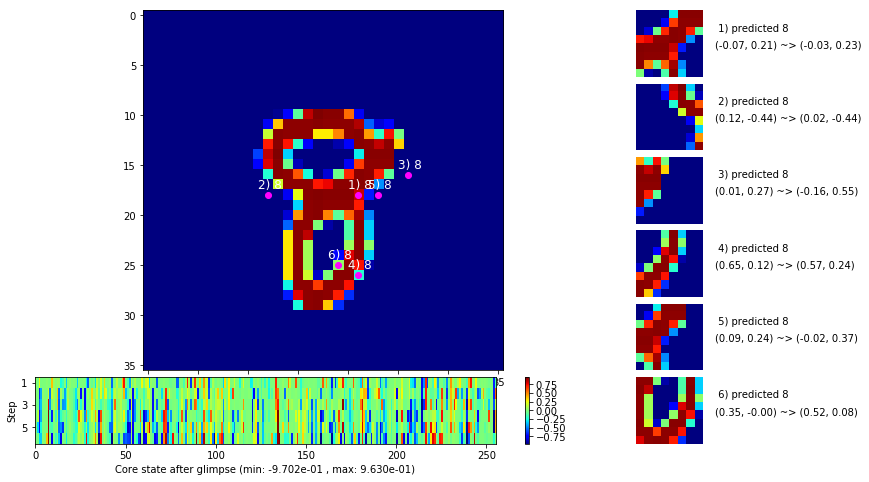

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


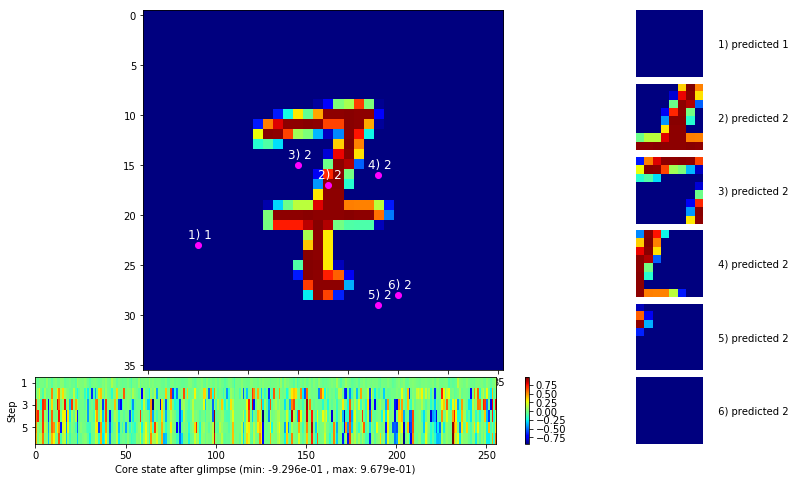


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


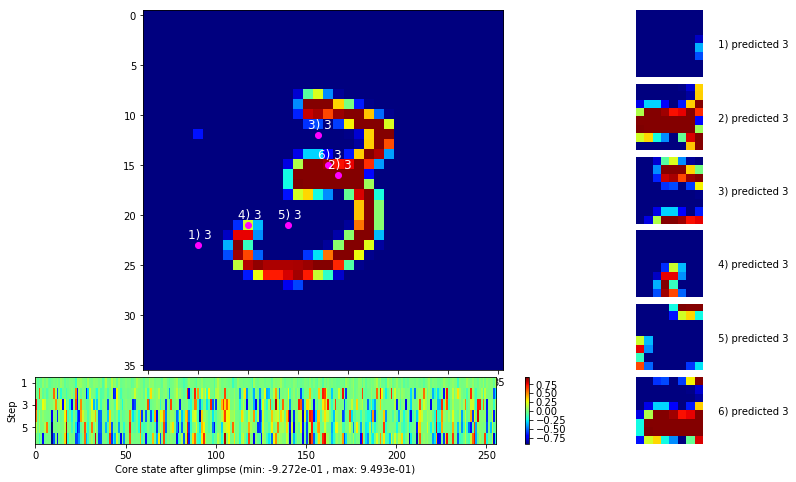

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


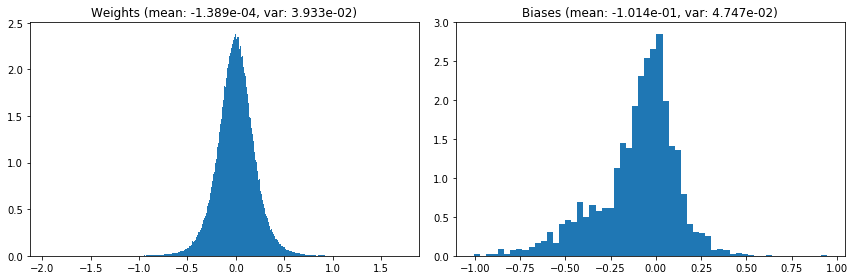

                                      Location network weights and biases


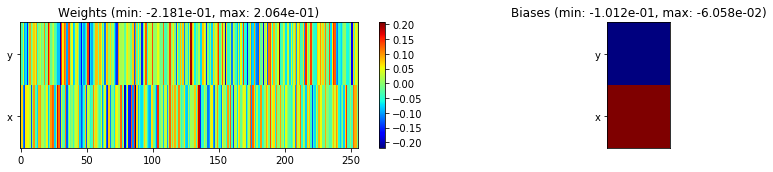

---------------------------------------------------------------------------------------------------------------
Elapsed time:  398.91 sec | TRAIN >> class loss: 0.1999 | steps:  2.178    | reward:  0.9361 :( | acc.: 93.608% :(
                          | VAL   >> class loss: 0.1397 | steps:  2.022 :( | reward:  0.9564    | acc.: 95.640% 


Epoch  32/400) lr = 0.0003371
 b    500/  3000 >> 129.9 ms/b | lr: 3.36e-04 | grad 2norm:  4.75 | grad inf norm:  1.263
       Weights || abs max:  1.95 (21842.92) | mean: -1.25e-04 ( 0.10) | var: 3.94e-02 ( 9286.28)
        Biases || abs max:  1.01 ( 1816.92) | mean: -1.02e-01 ( 0.86) | var: 4.76e-02 (334825.25)
                  class loss: 0.187 | steps: 2.167 | reward:  0.938 | acc.: 93.83%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.3 ms/b | lr: 3.35e-04 | grad 2norm:  4.64 | grad inf norm:  1.259
       Weights || abs max:  1.95 (169222.61) | mean: -1.06e-04 ( 0.38) |

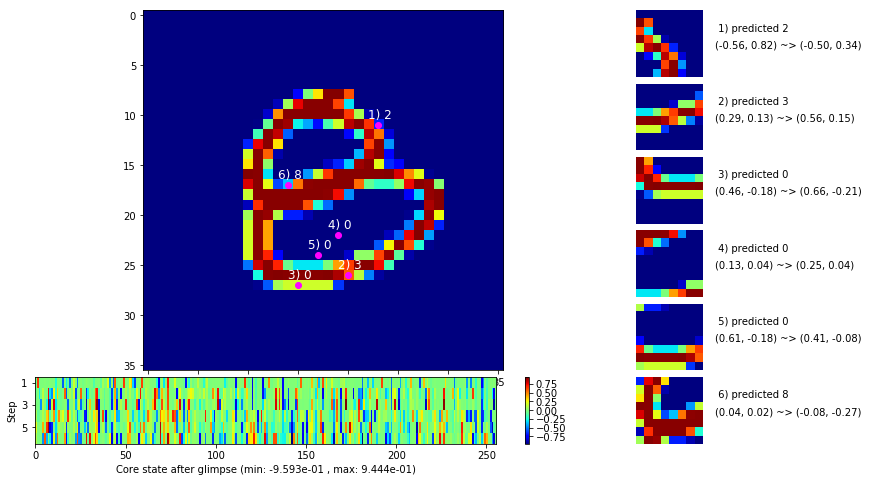

 b   1500/  3000 >> 131.2 ms/b | lr: 3.33e-04 | grad 2norm:  4.71 | grad inf norm:  1.242
       Weights || abs max:  1.95 (21757.20) | mean: -8.95e-05 ( 0.11) | var: 3.94e-02 (11311.36)
        Biases || abs max:  1.02 (  792.85) | mean: -1.02e-01 ( 0.47) | var: 4.78e-02 (39125.93)
                  class loss: 0.199 | steps: 2.172 | reward:  0.938 | acc.: 93.83%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 126.9 ms/b | lr: 3.32e-04 | grad 2norm:  4.82 | grad inf norm:  1.248
       Weights || abs max:  1.94 (85457.29) | mean: -1.03e-04 ( 0.23) | var: 3.95e-02 (1891802.62)
        Biases || abs max:  1.02 (  383.66) | mean: -1.02e-01 ( 0.32) | var: 4.78e-02 (  930.84)
                  class loss: 0.204 | steps: 2.184 | reward:  0.937 | acc.: 93.69%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

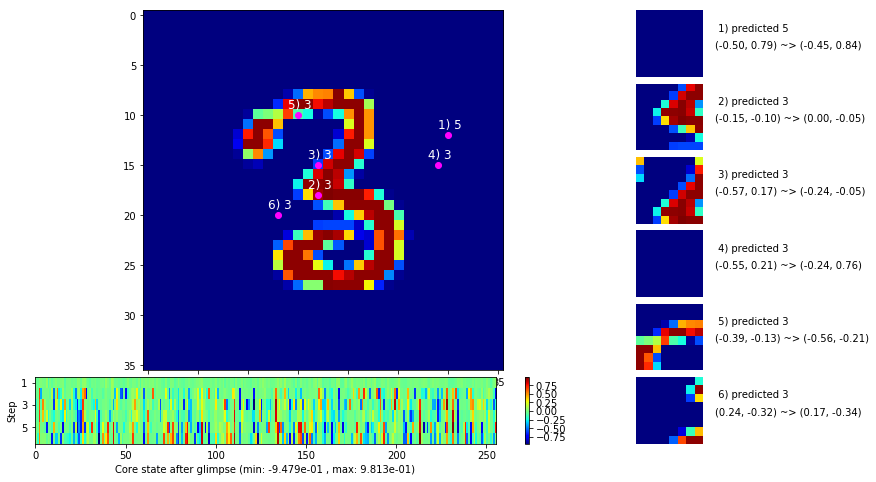

 b   2500/  3000 >> 133.5 ms/b | lr: 3.30e-04 | grad 2norm:  4.75 | grad inf norm:  1.237
       Weights || abs max:  1.94 (71736.05) | mean: -1.39e-04 ( 0.20) | var: 3.95e-02 (530650.31)
        Biases || abs max:  1.02 (  360.99) | mean: -1.02e-01 ( 0.31) | var: 4.78e-02 ( 1212.91)
                  class loss: 0.187 | steps: 2.160 | reward:  0.940 | acc.: 94.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.4 ms/b | lr: 3.29e-04 | grad 2norm:  4.39 | grad inf norm:  1.216
       Weights || abs max:  1.95 (41432.03) | mean: -1.33e-04 ( 0.14) | var: 3.96e-02 (207959.92)
        Biases || abs max:  1.02 (  677.27) | mean: -1.02e-01 ( 0.44) | var: 4.79e-02 ( 8439.45)
                  class loss: 0.179 | steps: 2.157 | reward:  0.943 | acc.: 94.34%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

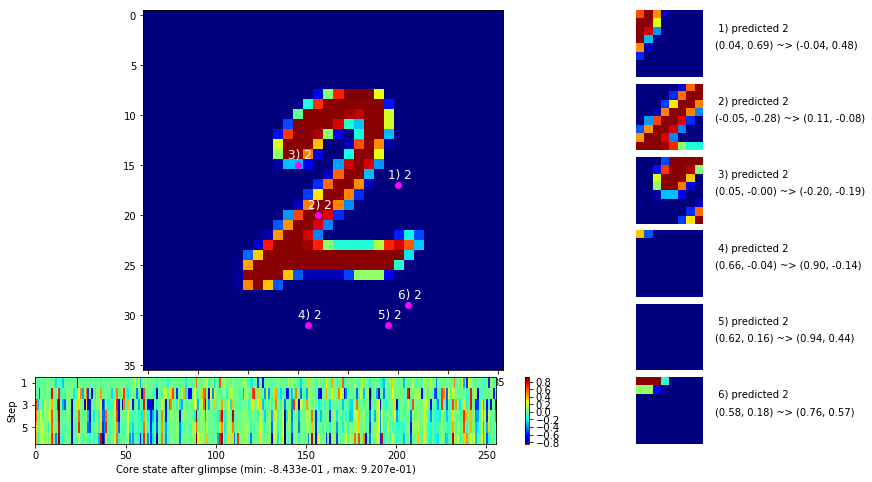

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


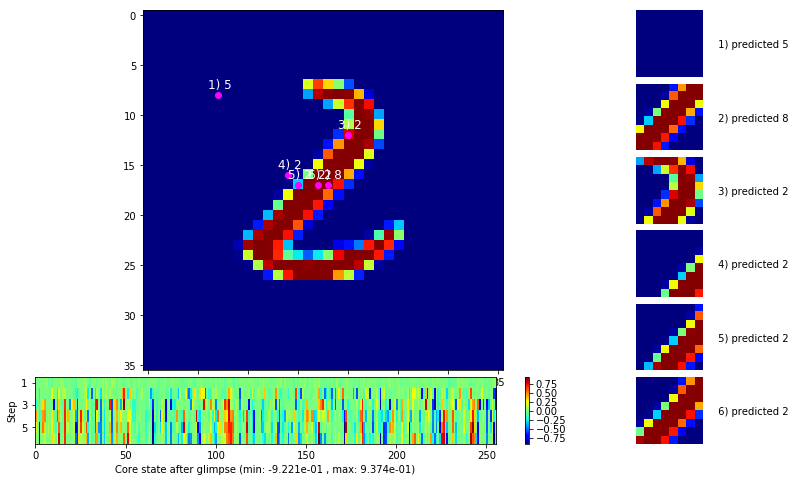


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


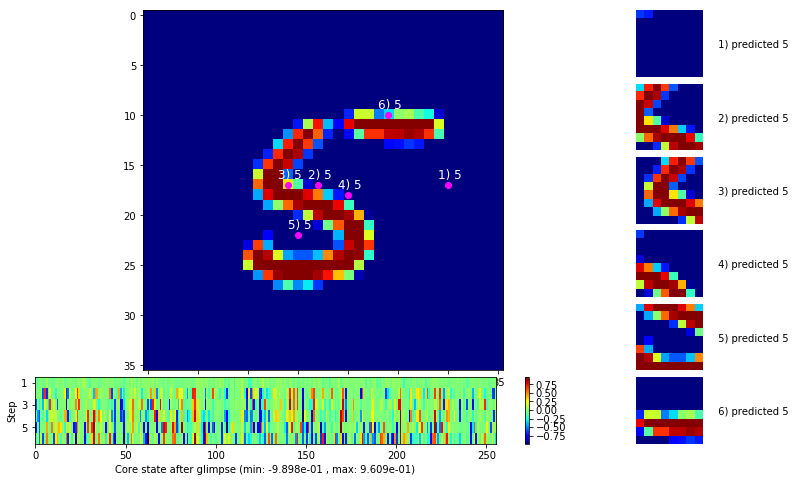

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


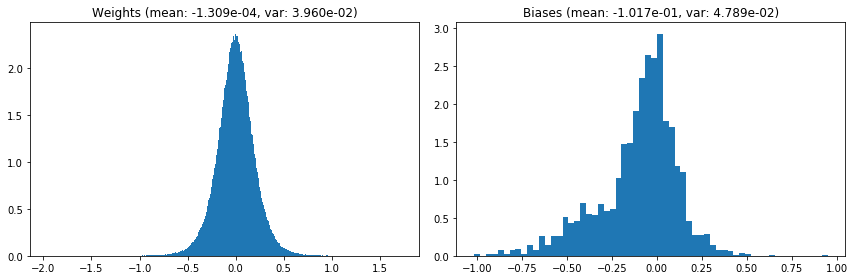

                                      Location network weights and biases


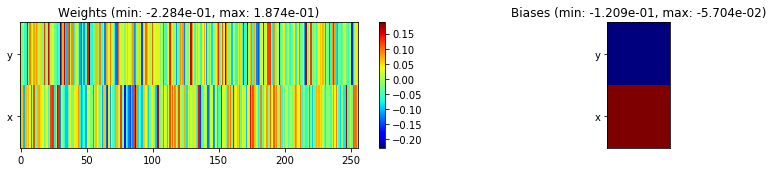

---------------------------------------------------------------------------------------------------------------
Elapsed time:  396.19 sec | TRAIN >> class loss: 0.1913 | steps:  2.167    | reward:  0.9395    | acc.: 93.947% 
                          | VAL   >> class loss: 0.1270 | steps:  1.983    | reward:  0.9578    | acc.: 95.780% 


Epoch  33/400) lr = 0.0003281
 b    500/  3000 >> 127.3 ms/b | lr: 3.27e-04 | grad 2norm:  4.48 | grad inf norm:  1.212
       Weights || abs max:  1.95 (32444.88) | mean: -1.42e-04 ( 0.13) | var: 3.96e-02 (24968.65)
        Biases || abs max:  1.02 (  265.72) | mean: -1.02e-01 ( 0.28) | var: 4.80e-02 (  365.21)
                  class loss: 0.192 | steps: 2.168 | reward:  0.943 | acc.: 94.34%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.3 ms/b | lr: 3.26e-04 | grad 2norm:  4.71 | grad inf norm:  1.260
       Weights || abs max:  1.95 (59086.65) | mean: -1.40e-04 ( 0.17) | var

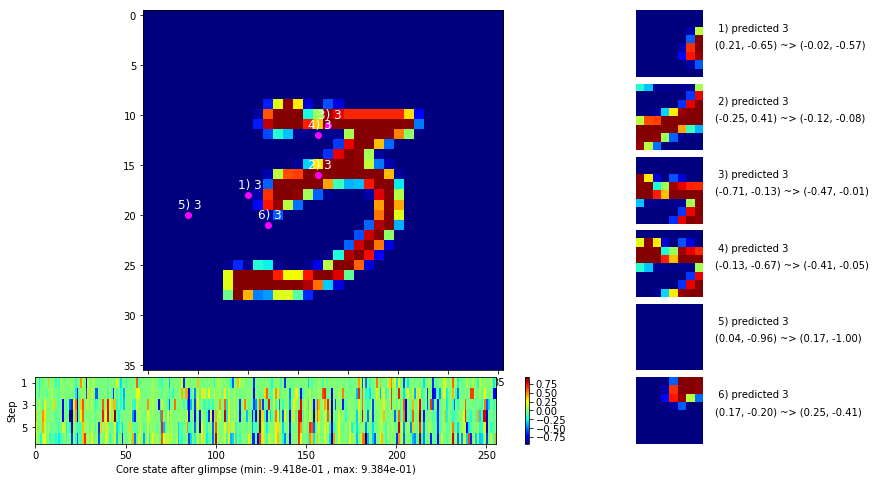

 b   1500/  3000 >> 129.4 ms/b | lr: 3.24e-04 | grad 2norm:  4.46 | grad inf norm:  1.215
       Weights || abs max:  1.95 (45635.18) | mean: -1.31e-04 ( 0.15) | var: 3.97e-02 (243356.19)
        Biases || abs max:  1.03 (  344.10) | mean: -1.02e-01 ( 0.34) | var: 4.82e-02 ( 1210.82)
                  class loss: 0.182 | steps: 2.168 | reward:  0.943 | acc.: 94.27%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.0 ms/b | lr: 3.23e-04 | grad 2norm:  4.66 | grad inf norm:  1.216
       Weights || abs max:  1.95 (57140.57) | mean: -1.30e-04 ( 0.17) | var: 3.97e-02 (979361.62)
        Biases || abs max:  1.03 (  761.90) | mean: -1.02e-01 ( 0.53) | var: 4.83e-02 (25370.12)
                  class loss: 0.191 | steps: 2.170 | reward:  0.940 | acc.: 93.96%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

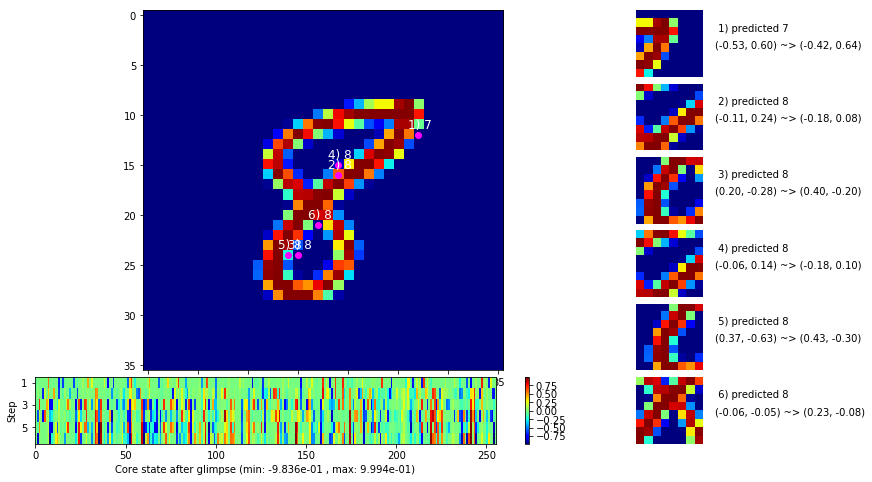

 b   2500/  3000 >> 129.8 ms/b | lr: 3.21e-04 | grad 2norm:  4.84 | grad inf norm:  1.251
       Weights || abs max:  1.95 (42713.06) | mean: -1.34e-04 ( 0.15) | var: 3.98e-02 (147731.83)
        Biases || abs max:  1.03 (  358.99) | mean: -1.02e-01 ( 0.32) | var: 4.84e-02 ( 1111.77)
                  class loss: 0.203 | steps: 2.175 | reward:  0.934 | acc.: 93.37%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.5 ms/b | lr: 3.20e-04 | grad 2norm:  4.51 | grad inf norm:  1.247
       Weights || abs max:  1.96 (30854.00) | mean: -1.30e-04 ( 0.12) | var: 3.98e-02 (20823.48)
        Biases || abs max:  1.02 (  238.24) | mean: -1.03e-01 ( 0.27) | var: 4.84e-02 (  290.81)
                  class loss: 0.193 | steps: 2.136 | reward:  0.941 | acc.: 94.12%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

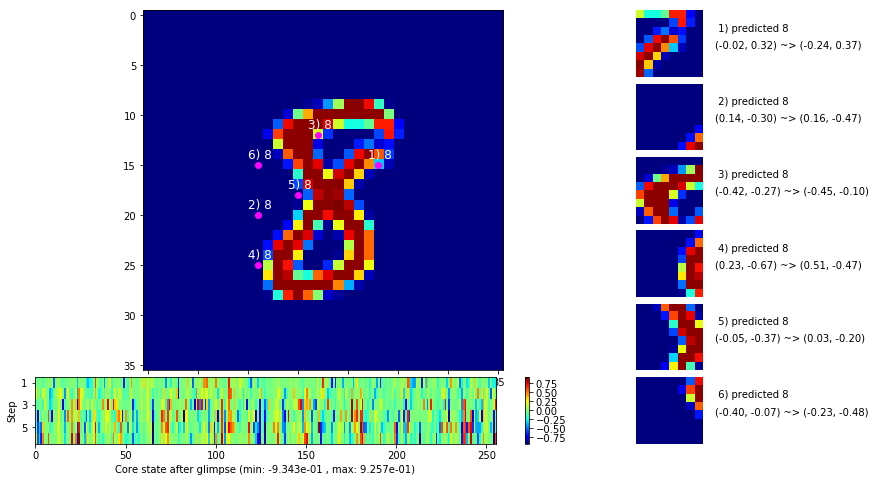

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


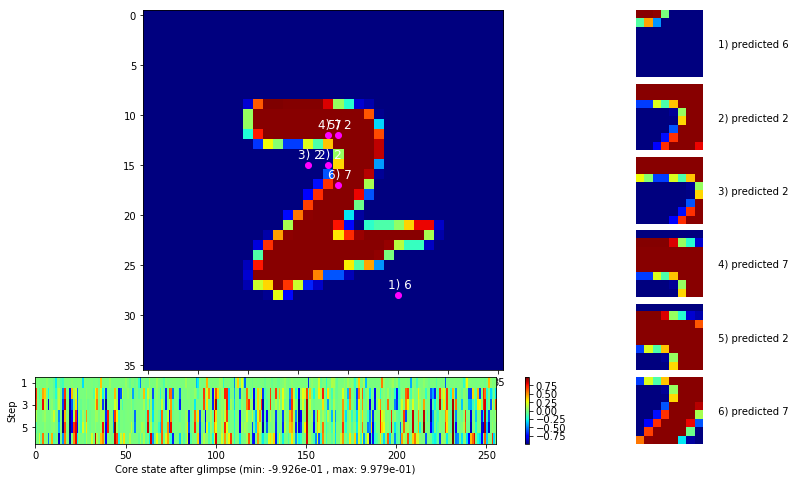


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


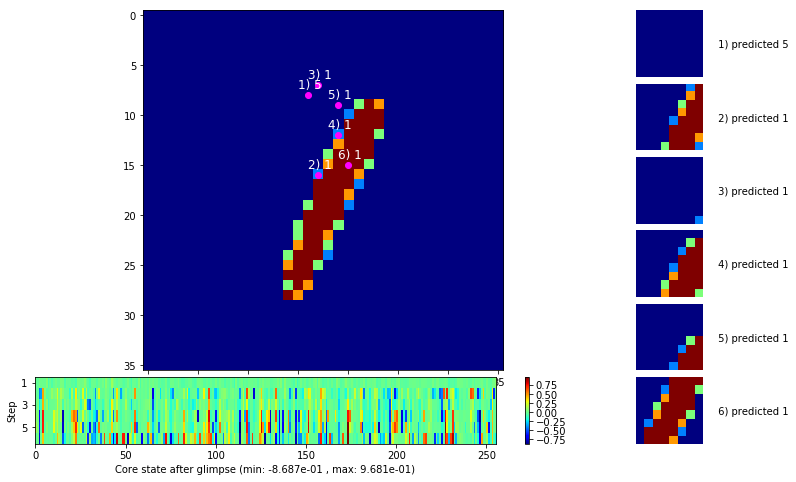

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


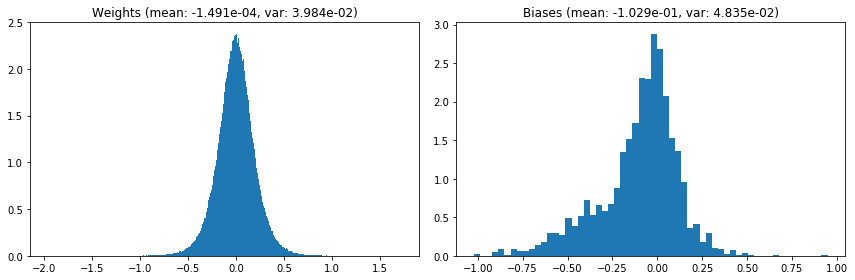

                                      Location network weights and biases


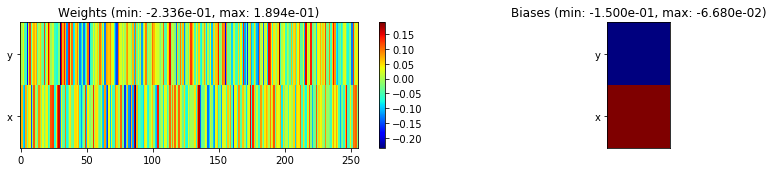

---------------------------------------------------------------------------------------------------------------
Elapsed time:  389.27 sec | TRAIN >> class loss: 0.1929 | steps:  2.167    | reward:  0.9397    | acc.: 93.968% 
                          | VAL   >> class loss: 0.1400 | steps:  1.996 :( | reward:  0.9546 :( | acc.: 95.460% :(


Epoch  34/400) lr = 0.0003197
 b    500/  3000 >> 129.5 ms/b | lr: 3.19e-04 | grad 2norm:  4.75 | grad inf norm:  1.277
       Weights || abs max:  1.96 (118405.28) | mean: -1.54e-04 ( 0.28) | var: 3.99e-02 (5551559.00)
        Biases || abs max:  1.03 (  630.43) | mean: -1.03e-01 ( 0.47) | var: 4.84e-02 ( 5789.43)
                  class loss: 0.200 | steps: 2.172 | reward:  0.935 | acc.: 93.48%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 135.6 ms/b | lr: 3.18e-04 | grad 2norm:  4.78 | grad inf norm:  1.305
       Weights || abs max:  1.96 (1008928.56) | mean: -1.60e-04 ( 1.92

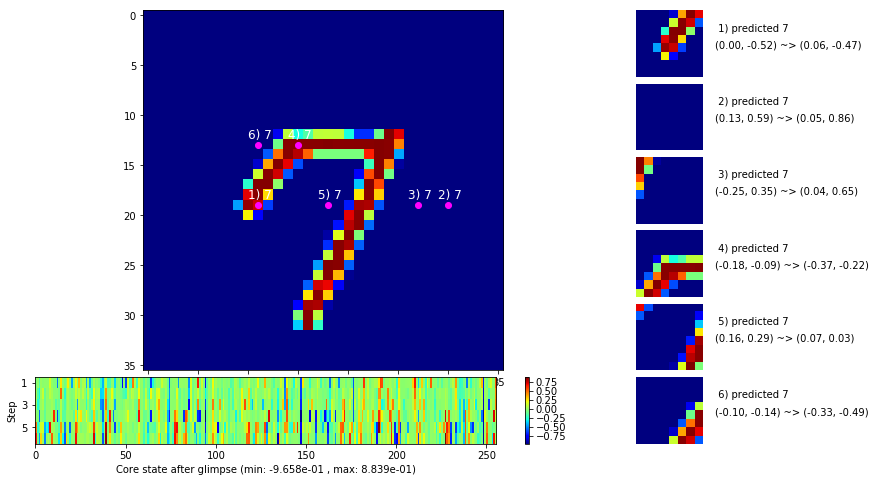

 b   1500/  3000 >> 139.7 ms/b | lr: 3.16e-04 | grad 2norm:  4.71 | grad inf norm:  1.215
       Weights || abs max:  1.96 (28222.85) | mean: -1.49e-04 ( 0.12) | var: 3.99e-02 (52512.95)
        Biases || abs max:  1.03 (  756.59) | mean: -1.03e-01 ( 0.48) | var: 4.85e-02 (19328.06)
                  class loss: 0.191 | steps: 2.143 | reward:  0.939 | acc.: 93.87%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.1 ms/b | lr: 3.15e-04 | grad 2norm:  4.66 | grad inf norm:  1.190
       Weights || abs max:  1.97 (39132.92) | mean: -1.55e-04 ( 0.14) | var: 4.00e-02 (133857.59)
        Biases || abs max:  1.03 (  368.39) | mean: -1.03e-01 ( 0.36) | var: 4.86e-02 ( 3574.26)
                  class loss: 0.187 | steps: 2.150 | reward:  0.940 | acc.: 93.99%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

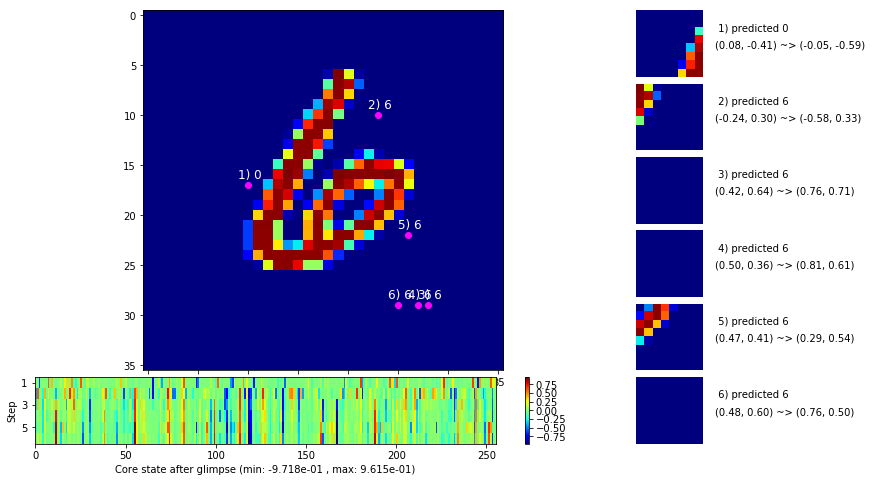

 b   2500/  3000 >> 132.6 ms/b | lr: 3.13e-04 | grad 2norm:  4.59 | grad inf norm:  1.235
       Weights || abs max:  1.97 (33302.09) | mean: -1.21e-04 ( 0.13) | var: 4.00e-02 (48270.85)
        Biases || abs max:  1.03 (  543.39) | mean: -1.03e-01 ( 0.39) | var: 4.85e-02 ( 2592.72)
                  class loss: 0.183 | steps: 2.154 | reward:  0.941 | acc.: 94.07%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 128.0 ms/b | lr: 3.12e-04 | grad 2norm:  4.83 | grad inf norm:  1.227
       Weights || abs max:  1.97 (50142.98) | mean: -1.17e-04 ( 0.16) | var: 4.01e-02 (157330.02)
        Biases || abs max:  1.02 (  316.54) | mean: -1.03e-01 ( 0.30) | var: 4.85e-02 (  838.50)
                  class loss: 0.195 | steps: 2.147 | reward:  0.936 | acc.: 93.62%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

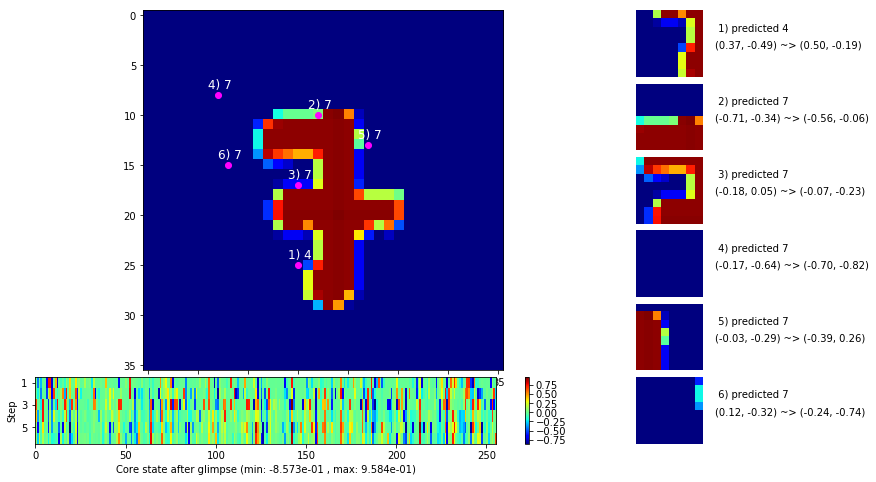

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


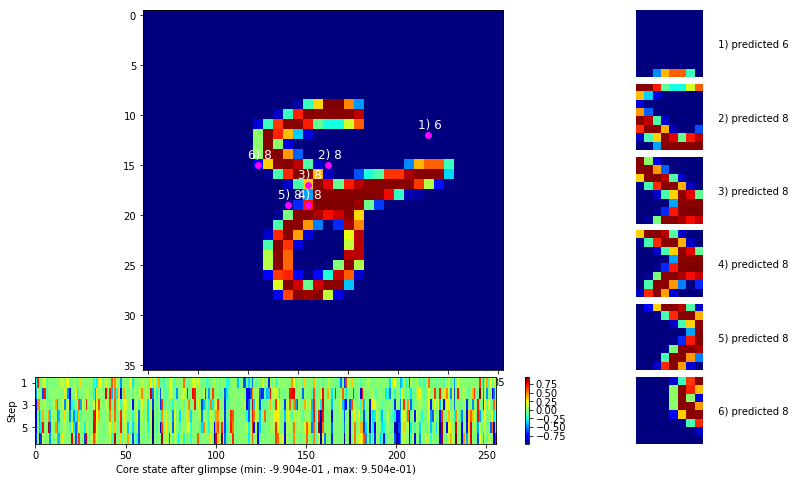


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


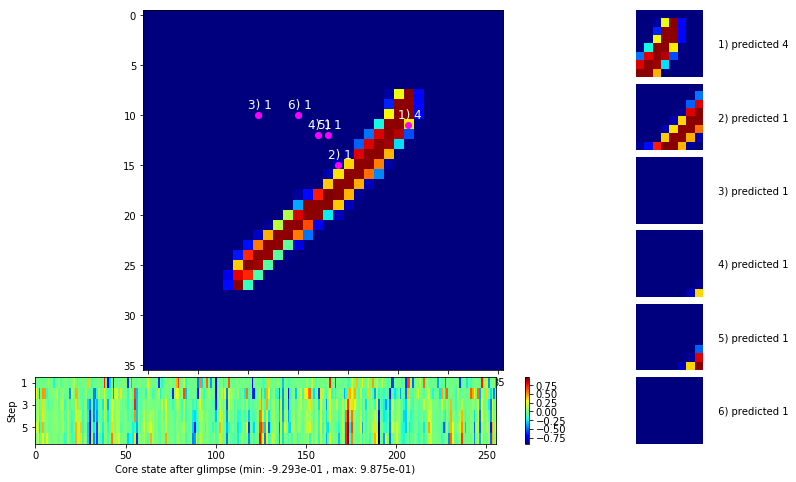

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


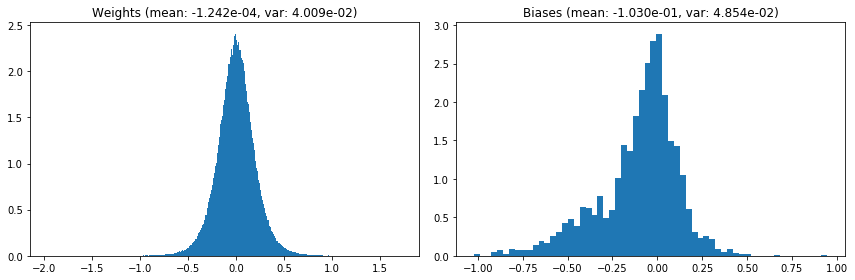

                                      Location network weights and biases


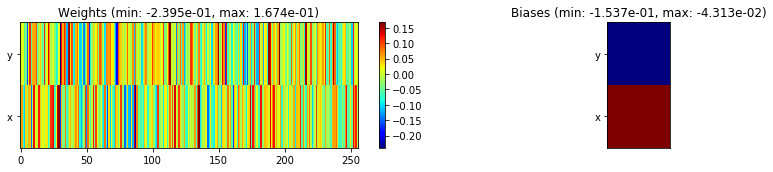

---------------------------------------------------------------------------------------------------------------
Elapsed time:  398.27 sec | TRAIN >> class loss: 0.1923 | steps:  2.158    | reward:  0.9376 :( | acc.: 93.763% :(
                          | VAL   >> class loss: 0.1545 | steps:  2.002 :( | reward:  0.9520 :( | acc.: 95.200% :(


Epoch  35/400) lr = 0.0003117
 b    500/  3000 >> 129.9 ms/b | lr: 3.11e-04 | grad 2norm:  4.50 | grad inf norm:  1.230
       Weights || abs max:  1.96 (39464.35) | mean: -1.31e-04 ( 0.14) | var: 4.01e-02 (101155.71)
        Biases || abs max:  1.02 (  425.23) | mean: -1.03e-01 ( 0.34) | var: 4.86e-02 ( 2025.36)
                  class loss: 0.189 | steps: 2.167 | reward:  0.942 | acc.: 94.21%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.2 ms/b | lr: 3.10e-04 | grad 2norm:  4.75 | grad inf norm:  1.265
       Weights || abs max:  1.96 (1824855.75) | mean: -1.33e-04 ( 3.42

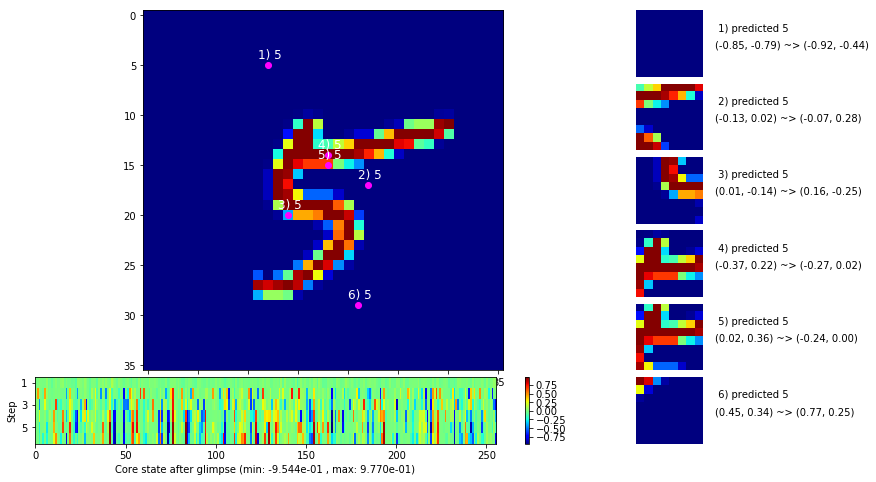

 b   1500/  3000 >> 129.6 ms/b | lr: 3.08e-04 | grad 2norm:  4.66 | grad inf norm:  1.258
       Weights || abs max:  1.97 (44594.98) | mean: -1.41e-04 ( 0.15) | var: 4.02e-02 (107924.03)
        Biases || abs max:  1.01 (  325.92) | mean: -1.04e-01 ( 0.30) | var: 4.89e-02 (  664.54)
                  class loss: 0.194 | steps: 2.155 | reward:  0.938 | acc.: 93.81%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.5 ms/b | lr: 3.07e-04 | grad 2norm:  4.59 | grad inf norm:  1.248
       Weights || abs max:  1.97 (20883.40) | mean: -1.61e-04 ( 0.10) | var: 4.02e-02 ( 6489.82)
        Biases || abs max:  1.01 (  536.92) | mean: -1.04e-01 ( 0.49) | var: 4.90e-02 (32450.71)
                  class loss: 0.193 | steps: 2.156 | reward:  0.939 | acc.: 93.89%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

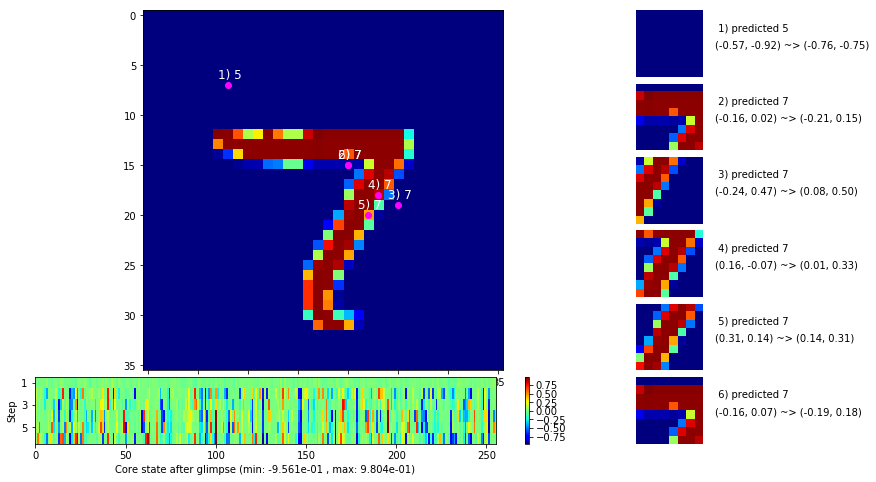

 b   2500/  3000 >> 136.2 ms/b | lr: 3.06e-04 | grad 2norm:  4.48 | grad inf norm:  1.227
       Weights || abs max:  1.97 (67245.75) | mean: -1.50e-04 ( 0.19) | var: 4.02e-02 (706814.81)
        Biases || abs max:  1.01 (  358.40) | mean: -1.04e-01 ( 0.34) | var: 4.90e-02 (  943.86)
                  class loss: 0.184 | steps: 2.166 | reward:  0.942 | acc.: 94.19%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 136.5 ms/b | lr: 3.05e-04 | grad 2norm:  4.60 | grad inf norm:  1.264
       Weights || abs max:  1.98 (77032.93) | mean: -1.58e-04 ( 0.21) | var: 4.03e-02 (861719.81)
        Biases || abs max:  1.01 ( 1374.55) | mean: -1.04e-01 ( 0.70) | var: 4.91e-02 (144788.36)
                  class loss: 0.196 | steps: 2.165 | reward:  0.940 | acc.: 94.02%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

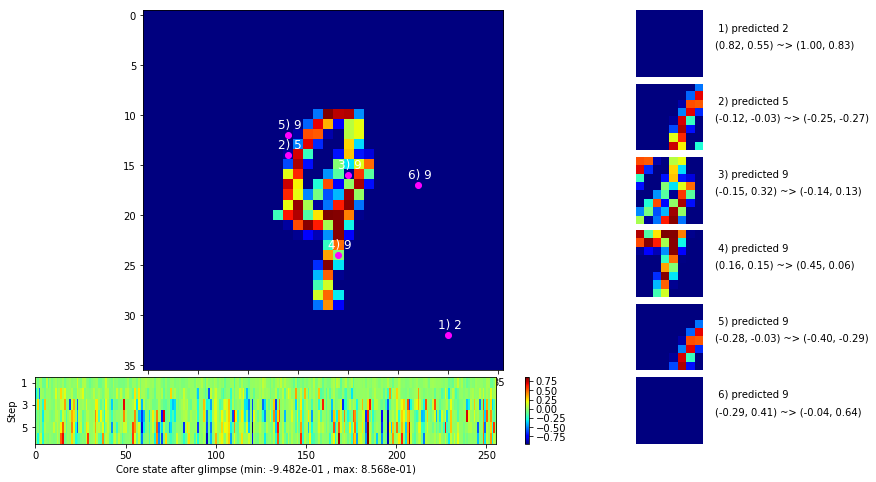

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


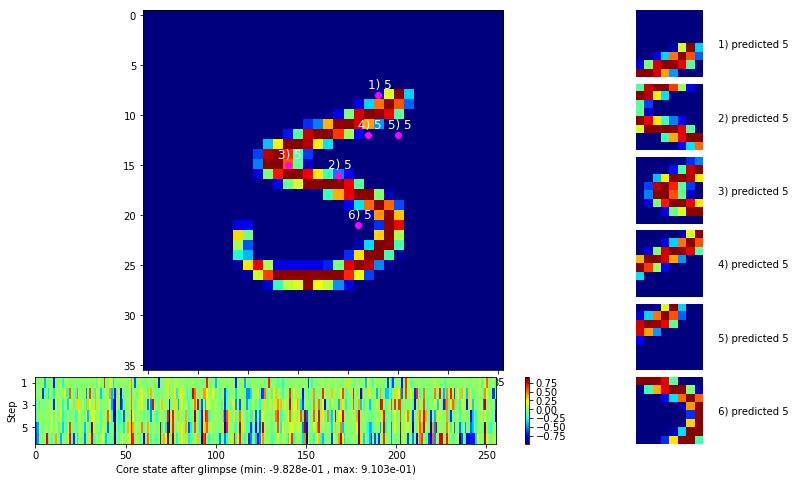


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


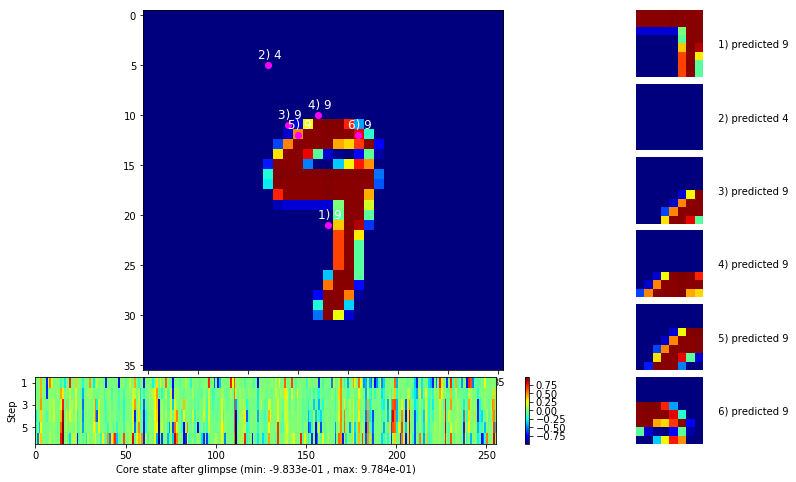

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


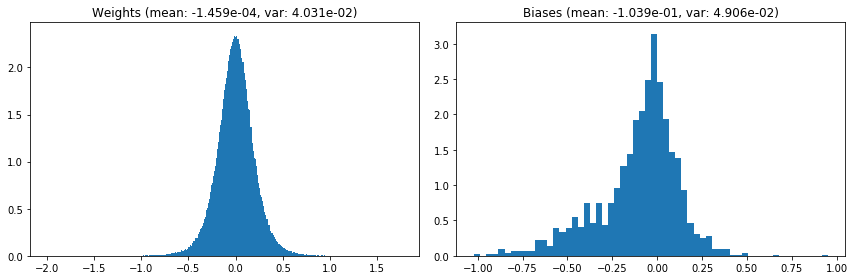

                                      Location network weights and biases


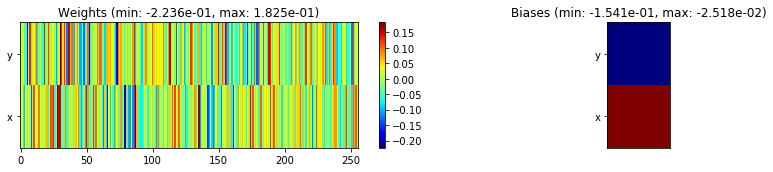

---------------------------------------------------------------------------------------------------------------
Elapsed time:  394.59 sec | TRAIN >> class loss: 0.1922 | steps:  2.161 :( | reward:  0.9395 :( | acc.: 93.955% :(
                          | VAL   >> class loss: 0.1420 | steps:  1.999 :( | reward:  0.9546 :( | acc.: 95.460% :(


Epoch  36/400) lr = 0.0003041
 b    500/  3000 >> 126.9 ms/b | lr: 3.03e-04 | grad 2norm:  4.50 | grad inf norm:  1.239
       Weights || abs max:  1.99 (28321.70) | mean: -1.54e-04 ( 0.11) | var: 4.03e-02 (40034.70)
        Biases || abs max:  1.02 (  242.75) | mean: -1.04e-01 ( 0.27) | var: 4.92e-02 (  523.66)
                  class loss: 0.186 | steps: 2.147 | reward:  0.942 | acc.: 94.20%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.6 ms/b | lr: 3.02e-04 | grad 2norm:  4.45 | grad inf norm:  1.185
       Weights || abs max:  1.99 (18944.59) | mean: -1.49e-04 ( 0.10) |

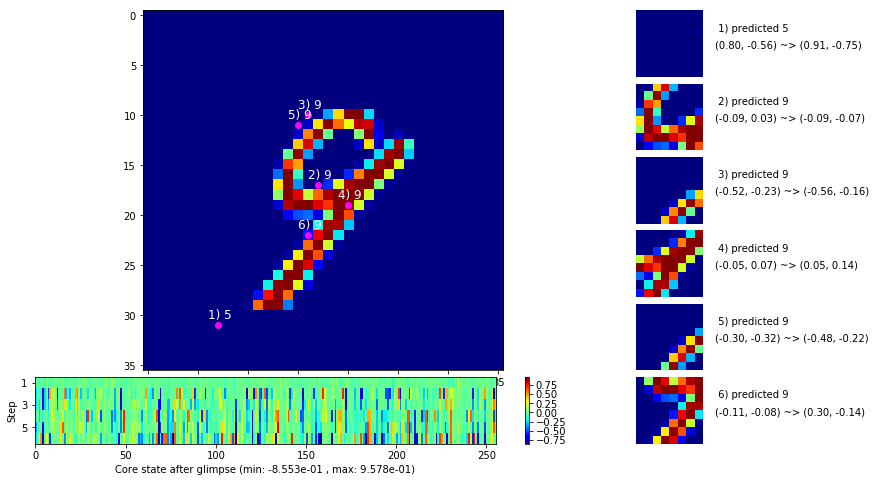

 b   1500/  3000 >> 129.9 ms/b | lr: 3.01e-04 | grad 2norm:  4.46 | grad inf norm:  1.186
       Weights || abs max:  2.00 (44444.19) | mean: -1.46e-04 ( 0.15) | var: 4.04e-02 (68192.14)
        Biases || abs max:  1.02 (  234.50) | mean: -1.04e-01 ( 0.29) | var: 4.93e-02 ( 2553.93)
                  class loss: 0.187 | steps: 2.165 | reward:  0.942 | acc.: 94.19%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 139.6 ms/b | lr: 3.00e-04 | grad 2norm:  4.43 | grad inf norm:  1.183
       Weights || abs max:  2.00 (52484.61) | mean: -1.45e-04 ( 0.16) | var: 4.04e-02 (220963.88)
        Biases || abs max:  1.03 ( 8480.80) | mean: -1.04e-01 ( 3.49) | var: 4.93e-02 (12452225.00)
                  class loss: 0.174 | steps: 2.138 | reward:  0.944 | acc.: 94.42%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

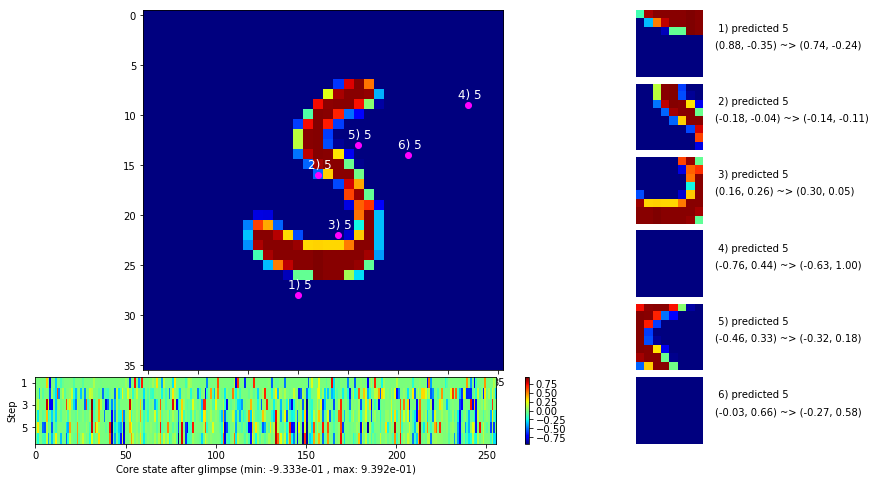

 b   2500/  3000 >> 144.2 ms/b | lr: 2.98e-04 | grad 2norm:  4.51 | grad inf norm:  1.232
       Weights || abs max:  2.01 (31935.77) | mean: -1.39e-04 ( 0.13) | var: 4.05e-02 (43088.94)
        Biases || abs max:  1.03 (  395.07) | mean: -1.05e-01 ( 0.31) | var: 4.93e-02 (10008.95)
                  class loss: 0.191 | steps: 2.173 | reward:  0.940 | acc.: 94.02%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.8 ms/b | lr: 2.97e-04 | grad 2norm:  4.46 | grad inf norm:  1.232
       Weights || abs max:  2.01 (55083.39) | mean: -1.49e-04 ( 0.17) | var: 4.05e-02 (675812.81)
        Biases || abs max:  1.03 (  498.27) | mean: -1.05e-01 ( 0.36) | var: 4.93e-02 ( 3619.83)
                  class loss: 0.175 | steps: 2.149 | reward:  0.942 | acc.: 94.22%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

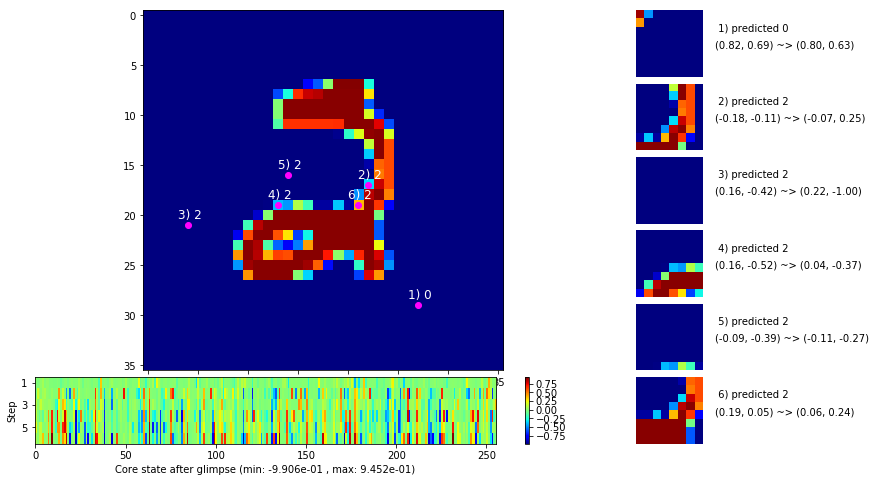

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


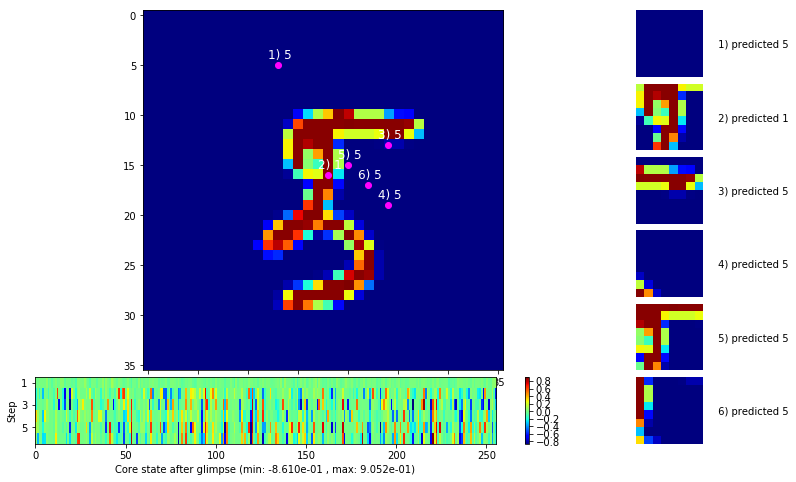


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


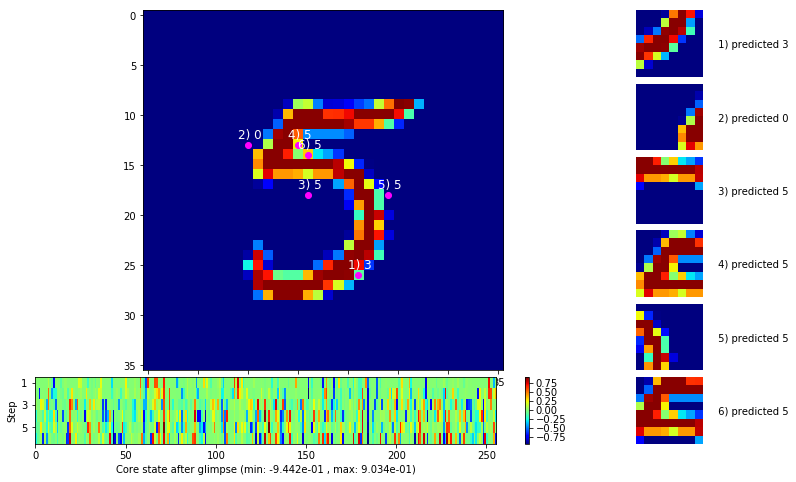

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


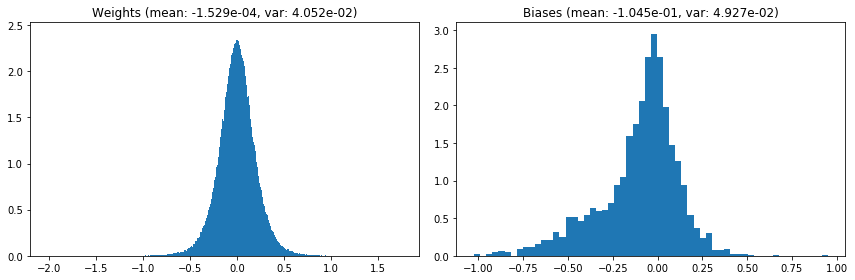

                                      Location network weights and biases


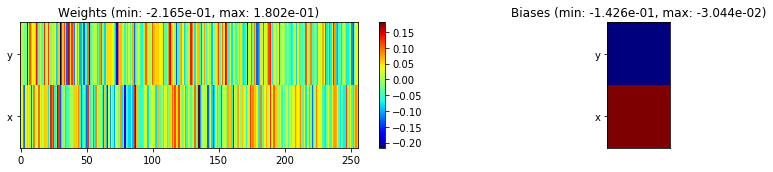

---------------------------------------------------------------------------------------------------------------
Elapsed time:  407.10 sec | TRAIN >> class loss: 0.1816 | steps:  2.156    | reward:  0.9422    | acc.: 94.218% 
                          | VAL   >> class loss: 0.1312 | steps:  2.001 :( | reward:  0.9578    | acc.: 95.780% 


Epoch  37/400) lr = 0.0002969
 b    500/  3000 >> 147.1 ms/b | lr: 2.96e-04 | grad 2norm:  4.52 | grad inf norm:  1.214
       Weights || abs max:  2.02 (66346.59) | mean: -1.42e-04 ( 0.19) | var: 4.05e-02 (1070855.38)
        Biases || abs max:  1.02 (  455.54) | mean: -1.05e-01 ( 0.34) | var: 4.93e-02 ( 6292.36)
                  class loss: 0.188 | steps: 2.153 | reward:  0.941 | acc.: 94.07%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 158.3 ms/b | lr: 2.95e-04 | grad 2norm:  4.43 | grad inf norm:  1.207
       Weights || abs max:  2.01 (41039.43) | mean: -1.27e-04 ( 0.15) | v

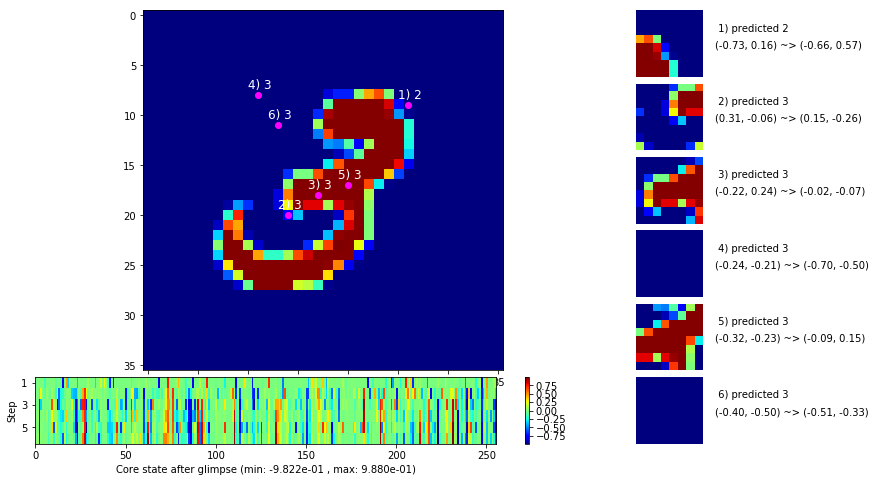

 b   1500/  3000 >> 144.2 ms/b | lr: 2.94e-04 | grad 2norm:  4.53 | grad inf norm:  1.215
       Weights || abs max:  2.01 (26956.20) | mean: -1.29e-04 ( 0.11) | var: 4.06e-02 (18778.12)
        Biases || abs max:  1.01 (  192.41) | mean: -1.06e-01 ( 0.24) | var: 4.95e-02 (  198.09)
                  class loss: 0.182 | steps: 2.157 | reward:  0.940 | acc.: 93.97%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 132.9 ms/b | lr: 2.93e-04 | grad 2norm:  4.39 | grad inf norm:  1.213
       Weights || abs max:  2.02 (44298.29) | mean: -1.51e-04 ( 0.15) | var: 4.06e-02 (222627.17)
        Biases || abs max:  1.01 (  837.40) | mean: -1.06e-01 ( 0.51) | var: 4.95e-02 (20205.75)
                  class loss: 0.179 | steps: 2.138 | reward:  0.942 | acc.: 94.23%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

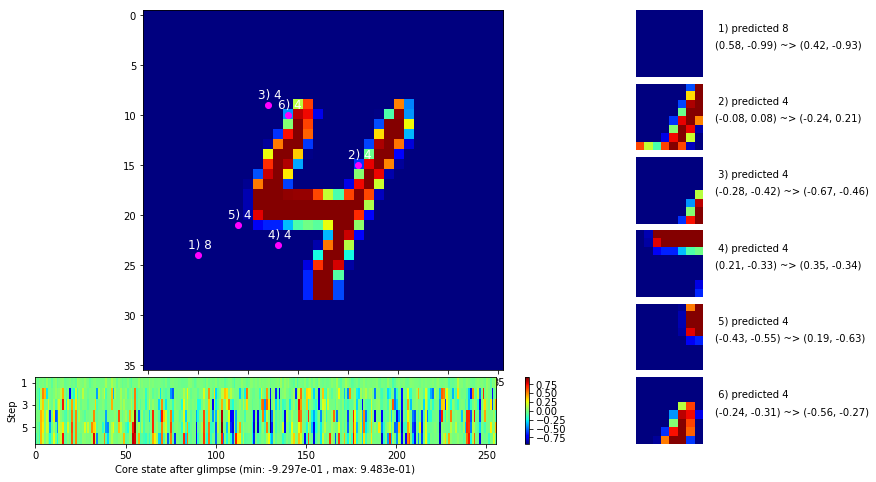

 b   2500/  3000 >> 131.7 ms/b | lr: 2.91e-04 | grad 2norm:  4.36 | grad inf norm:  1.196
       Weights || abs max:  2.03 (92899.96) | mean: -1.43e-04 ( 0.23) | var: 4.07e-02 (2200390.50)
        Biases || abs max:  1.02 ( 1225.83) | mean: -1.05e-01 ( 0.67) | var: 4.95e-02 (155298.09)
                  class loss: 0.177 | steps: 2.151 | reward:  0.944 | acc.: 94.43%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.8 ms/b | lr: 2.91e-04 | grad 2norm:  4.40 | grad inf norm:  1.207
       Weights || abs max:  2.02 (64039.70) | mean: -1.41e-04 ( 0.18) | var: 4.07e-02 (345361.72)
        Biases || abs max:  1.02 (17806.06) | mean: -1.05e-01 ( 7.11) | var: 4.96e-02 (60372560.00)
                  class loss: 0.177 | steps: 2.163 | reward:  0.944 | acc.: 94.39%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.

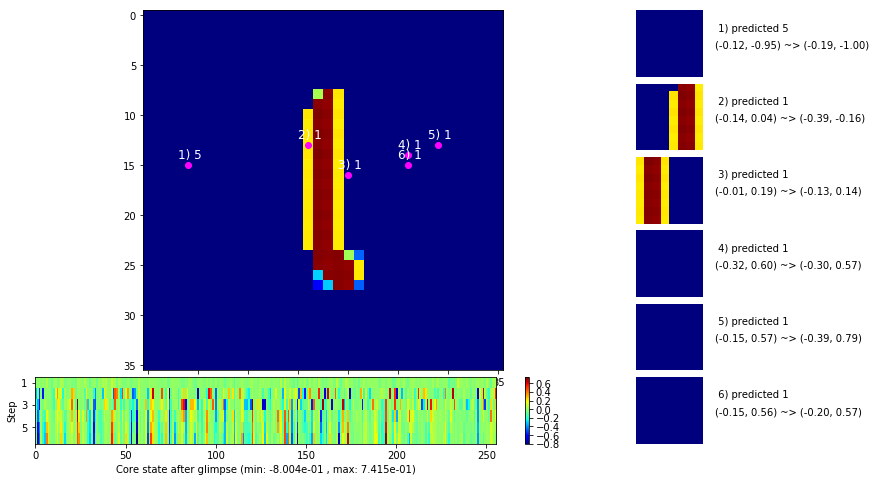

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


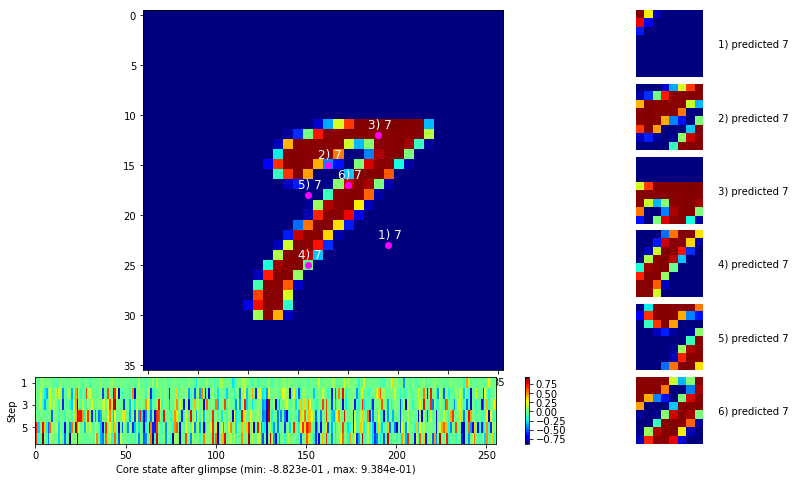


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


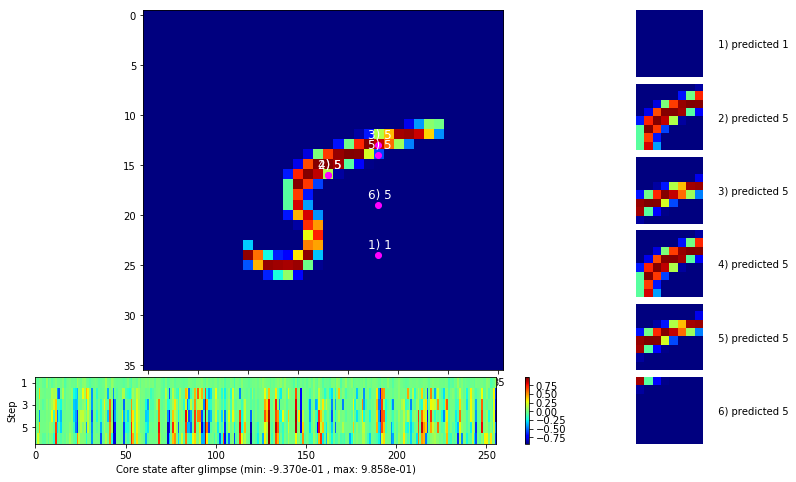

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


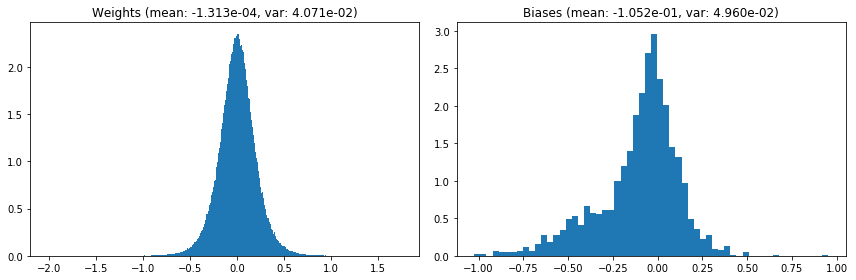

                                      Location network weights and biases


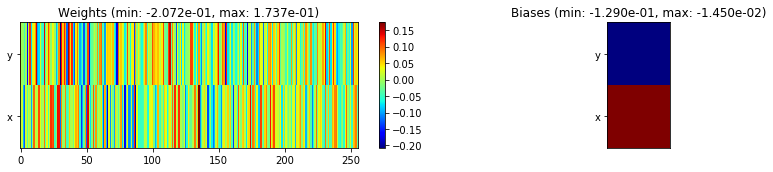

---------------------------------------------------------------------------------------------------------------
Elapsed time:  423.21 sec | TRAIN >> class loss: 0.1817 | steps:  2.154    | reward:  0.9422    | acc.: 94.218% 
                          | VAL   >> class loss: 0.1454 | steps:  2.006 :( | reward:  0.9524 :( | acc.: 95.240% :(


Epoch  38/400) lr = 0.0002901
 b    500/  3000 >> 127.3 ms/b | lr: 2.89e-04 | grad 2norm:  4.25 | grad inf norm:  1.166
       Weights || abs max:  2.02 (59510.70) | mean: -1.27e-04 ( 0.18) | var: 4.07e-02 (238400.19)
        Biases || abs max:  1.02 (  394.47) | mean: -1.05e-01 ( 0.35) | var: 4.95e-02 ( 4325.22)
                  class loss: 0.163 | steps: 2.169 | reward:  0.948 | acc.: 94.76%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.6 ms/b | lr: 2.88e-04 | grad 2norm:  4.27 | grad inf norm:  1.142
       Weights || abs max:  2.02 (65989.30) | mean: -1.26e-04 ( 0.19) | 

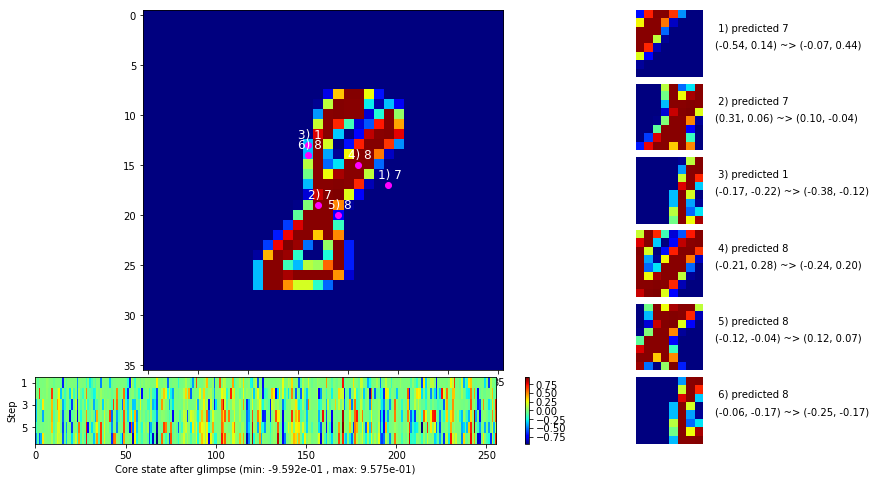

 b   1500/  3000 >> 127.4 ms/b | lr: 2.87e-04 | grad 2norm:  4.55 | grad inf norm:  1.194
       Weights || abs max:  2.02 (39390.62) | mean: -1.48e-04 ( 0.14) | var: 4.08e-02 (148540.61)
        Biases || abs max:  1.02 ( 1118.14) | mean: -1.06e-01 ( 0.65) | var: 4.98e-02 (94458.44)
                  class loss: 0.186 | steps: 2.151 | reward:  0.942 | acc.: 94.17%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 131.2 ms/b | lr: 2.86e-04 | grad 2norm:  4.15 | grad inf norm:  1.183
       Weights || abs max:  2.02 (17568.79) | mean: -1.38e-04 ( 0.09) | var: 4.08e-02 ( 4272.55)
        Biases || abs max:  1.03 (  197.74) | mean: -1.06e-01 ( 0.24) | var: 4.98e-02 (  149.28)
                  class loss: 0.168 | steps: 2.147 | reward:  0.949 | acc.: 94.86%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

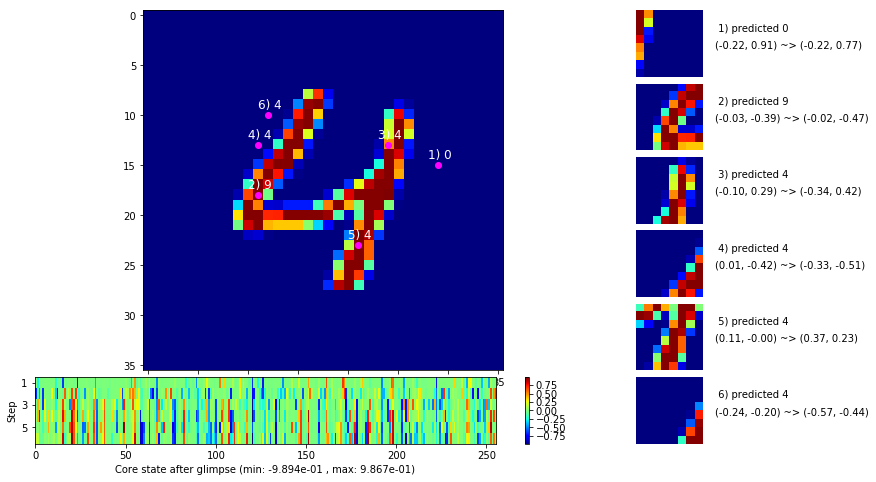

 b   2500/  3000 >> 145.3 ms/b | lr: 2.85e-04 | grad 2norm:  4.35 | grad inf norm:  1.178
       Weights || abs max:  2.03 (44573.89) | mean: -1.43e-04 ( 0.15) | var: 4.08e-02 (104017.92)
        Biases || abs max:  1.03 ( 3722.17) | mean: -1.05e-01 ( 1.67) | var: 4.99e-02 (2114752.75)
                  class loss: 0.175 | steps: 2.147 | reward:  0.945 | acc.: 94.50%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 132.3 ms/b | lr: 2.84e-04 | grad 2norm:  4.33 | grad inf norm:  1.181
       Weights || abs max:  2.02 (945019.00) | mean: -1.41e-04 ( 1.80) | var: 4.09e-02 (755235776.00)
        Biases || abs max:  1.03 (  701.71) | mean: -1.05e-01 ( 0.45) | var: 4.99e-02 (51524.72)
                  class loss: 0.173 | steps: 2.155 | reward:  0.946 | acc.: 94.55%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1

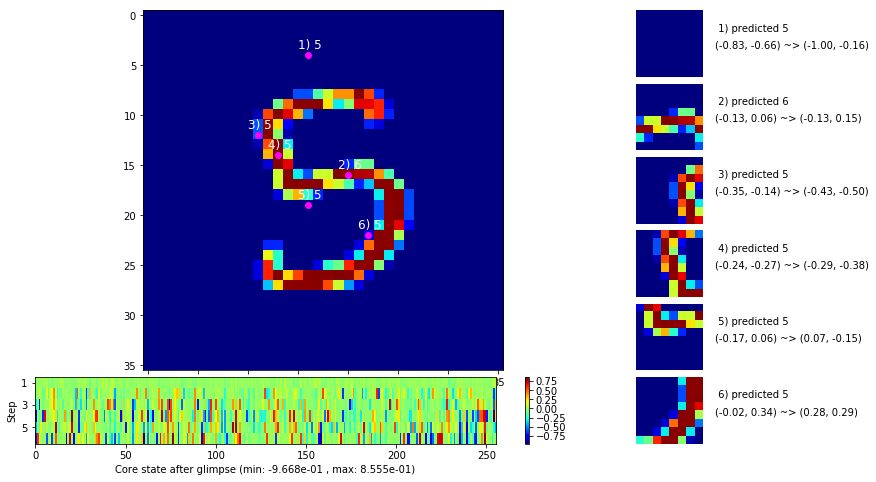

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


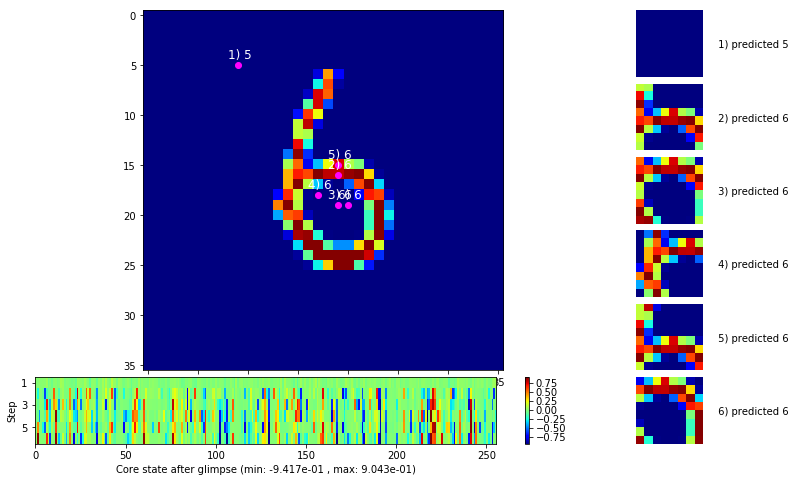


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


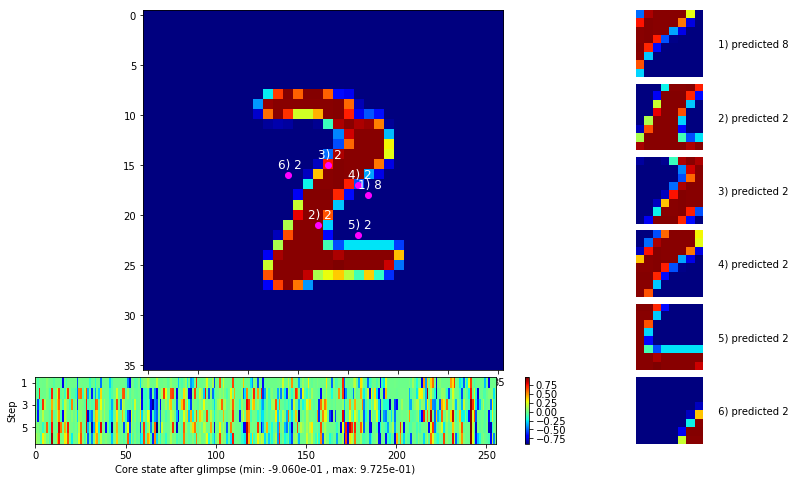

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


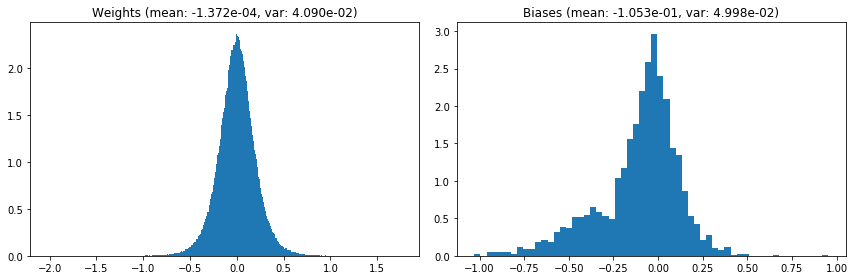

                                      Location network weights and biases


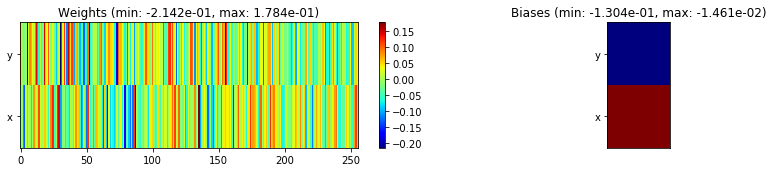

---------------------------------------------------------------------------------------------------------------
Elapsed time:  397.08 sec | TRAIN >> class loss: 0.1713 | steps:  2.149    | reward:  0.9462    | acc.: 94.620% 
                          | VAL   >> class loss: 0.1566 | steps:  2.020 :( | reward:  0.9504 :( | acc.: 95.040% :(


Epoch  39/400) lr = 0.0002836
 b    500/  3000 >> 129.3 ms/b | lr: 2.83e-04 | grad 2norm:  4.48 | grad inf norm:  1.216
       Weights || abs max:  2.02 (37010.16) | mean: -1.42e-04 ( 0.14) | var: 4.09e-02 (81172.69)
        Biases || abs max:  1.03 (  290.60) | mean: -1.06e-01 ( 0.32) | var: 5.02e-02 (  382.87)
                  class loss: 0.179 | steps: 2.138 | reward:  0.941 | acc.: 94.14%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.1 ms/b | lr: 2.82e-04 | grad 2norm:  4.21 | grad inf norm:  1.196
       Weights || abs max:  2.02 (65806.33) | mean: -1.60e-04 ( 0.19) | v

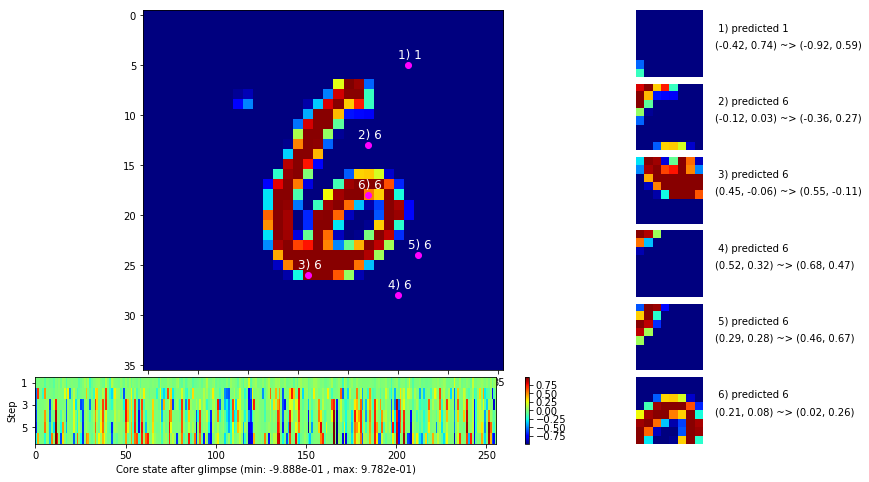

 b   1500/  3000 >> 132.2 ms/b | lr: 2.81e-04 | grad 2norm:  4.16 | grad inf norm:  1.148
       Weights || abs max:  2.02 (1056283.38) | mean: -1.82e-04 ( 2.01) | var: 4.10e-02 (901241856.00)
        Biases || abs max:  1.02 (  133.80) | mean: -1.06e-01 ( 0.19) | var: 5.03e-02 (   67.55)
                  class loss: 0.165 | steps: 2.154 | reward:  0.948 | acc.: 94.83%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.2 ms/b | lr: 2.80e-04 | grad 2norm:  4.41 | grad inf norm:  1.218
       Weights || abs max:  2.02 (20633.53) | mean: -1.66e-04 ( 0.10) | var: 4.10e-02 ( 9180.44)
        Biases || abs max:  1.01 (  171.99) | mean: -1.07e-01 ( 0.22) | var: 5.04e-02 (  157.33)
                  class loss: 0.185 | steps: 2.148 | reward:  0.941 | acc.: 94.11%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0

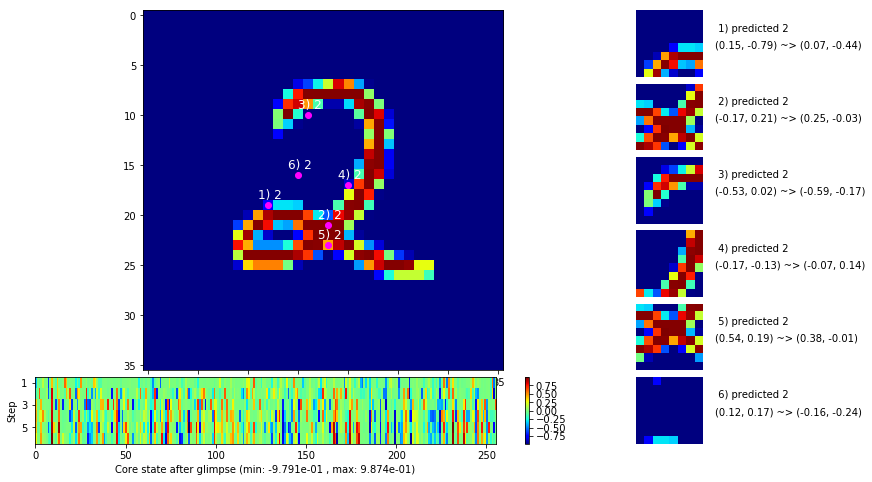

 b   2500/  3000 >> 130.8 ms/b | lr: 2.79e-04 | grad 2norm:  4.08 | grad inf norm:  1.159
       Weights || abs max:  2.02 (28706.44) | mean: -1.56e-04 ( 0.11) | var: 4.10e-02 (110065.84)
        Biases || abs max:  1.01 ( 1477.89) | mean: -1.07e-01 ( 0.72) | var: 5.05e-02 (218716.72)
                  class loss: 0.157 | steps: 2.112 | reward:  0.949 | acc.: 94.93%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.9 ms/b | lr: 2.78e-04 | grad 2norm:  4.32 | grad inf norm:  1.208
       Weights || abs max:  2.02 (38617.48) | mean: -1.53e-04 ( 0.13) | var: 4.11e-02 (153049.08)
        Biases || abs max:  1.02 (  300.23) | mean: -1.06e-01 ( 0.27) | var: 5.05e-02 ( 2138.42)
                  class loss: 0.179 | steps: 2.132 | reward:  0.945 | acc.: 94.51%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

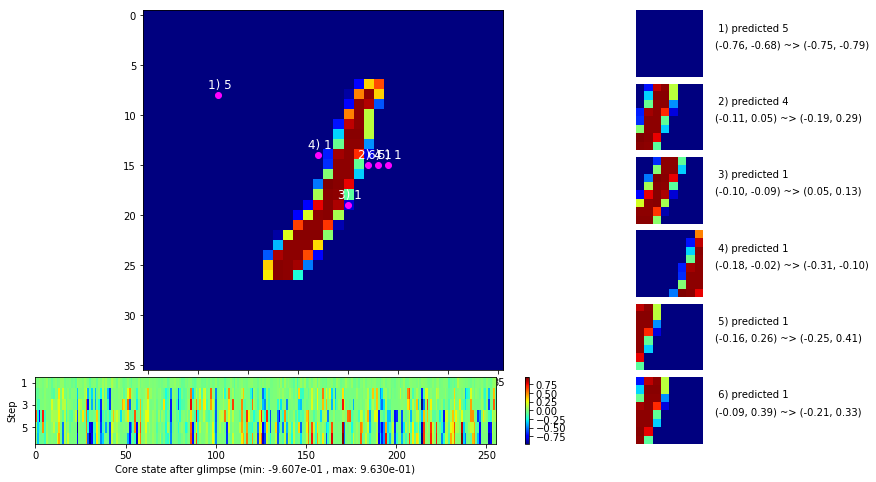

                                          ---===  VALIDATION  ===---

	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


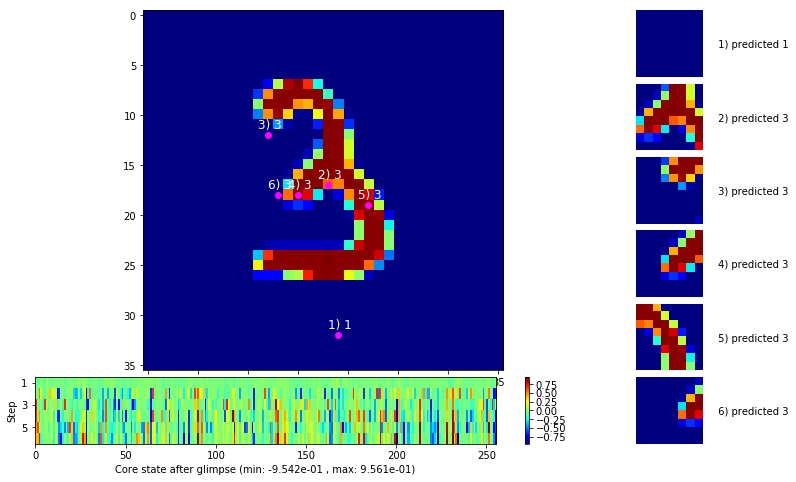


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


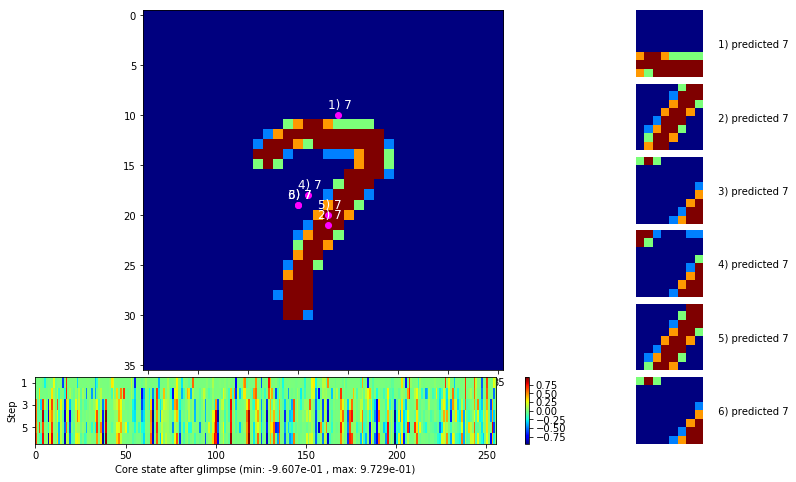

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


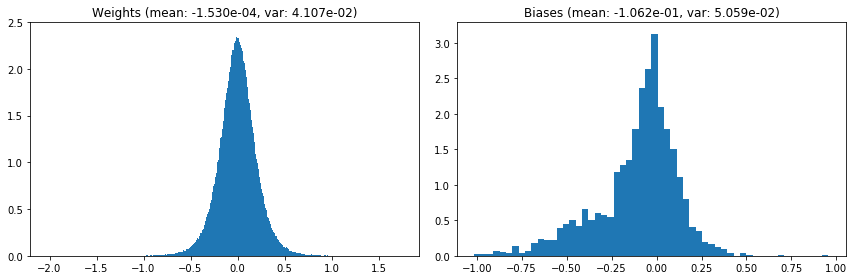

                                      Location network weights and biases


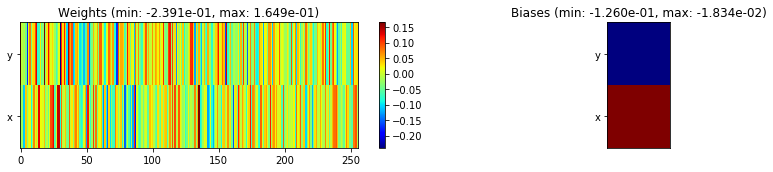

---------------------------------------------------------------------------------------------------------------
Elapsed time:  389.93 sec | TRAIN >> class loss: 0.1729 | steps:  2.138    | reward:  0.9453 :( | acc.: 94.527% :(
                          | VAL   >> class loss: 0.1354 | steps:  1.984 :( | reward:  0.9564 :( | acc.: 95.640% :(


Epoch  40/400) lr = 0.0002774
 b    500/  3000 >> 134.0 ms/b | lr: 2.77e-04 | grad 2norm:  4.20 | grad inf norm:  1.160
       Weights || abs max:  2.02 (33137.33) | mean: -1.44e-04 ( 0.12) | var: 4.11e-02 (71675.41)
        Biases || abs max:  1.01 (  271.00) | mean: -1.06e-01 ( 0.29) | var: 5.05e-02 ( 3463.01)
                  class loss: 0.162 | steps: 2.138 | reward:  0.947 | acc.: 94.69%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 143.3 ms/b | lr: 2.76e-04 | grad 2norm:  4.34 | grad inf norm:  1.118
       Weights || abs max:  2.02 (26927.47) | mean: -1.40e-04 ( 0.12) |

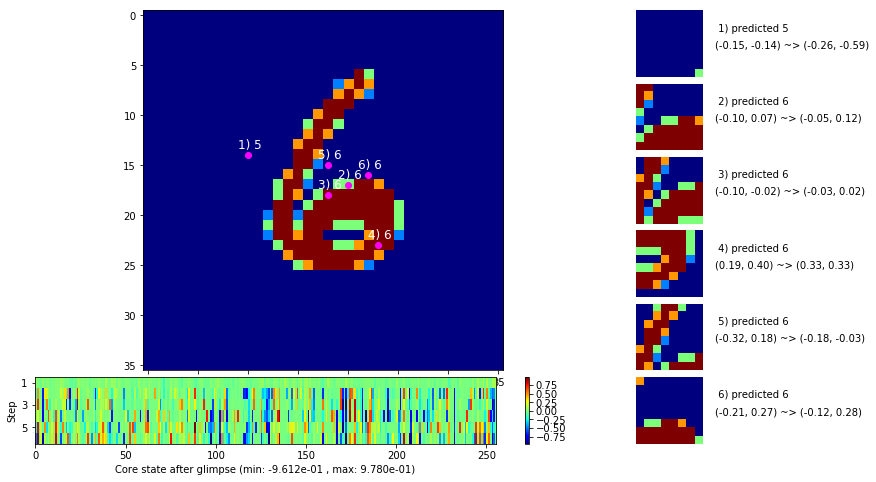

 b   1500/  3000 >> 128.5 ms/b | lr: 2.75e-04 | grad 2norm:  4.45 | grad inf norm:  1.162
       Weights || abs max:  2.03 (32321.03) | mean: -1.18e-04 ( 0.13) | var: 4.11e-02 (127347.67)
        Biases || abs max:  1.02 (  681.41) | mean: -1.07e-01 ( 0.43) | var: 5.06e-02 (25121.26)
                  class loss: 0.182 | steps: 2.162 | reward:  0.943 | acc.: 94.27%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 127.8 ms/b | lr: 2.74e-04 | grad 2norm:  4.29 | grad inf norm:  1.203
       Weights || abs max:  2.04 (29214.60) | mean: -1.17e-04 ( 0.12) | var: 4.12e-02 (33280.57)
        Biases || abs max:  1.03 (  478.38) | mean: -1.07e-01 ( 0.36) | var: 5.06e-02 ( 6515.21)
                  class loss: 0.172 | steps: 2.159 | reward:  0.945 | acc.: 94.46%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

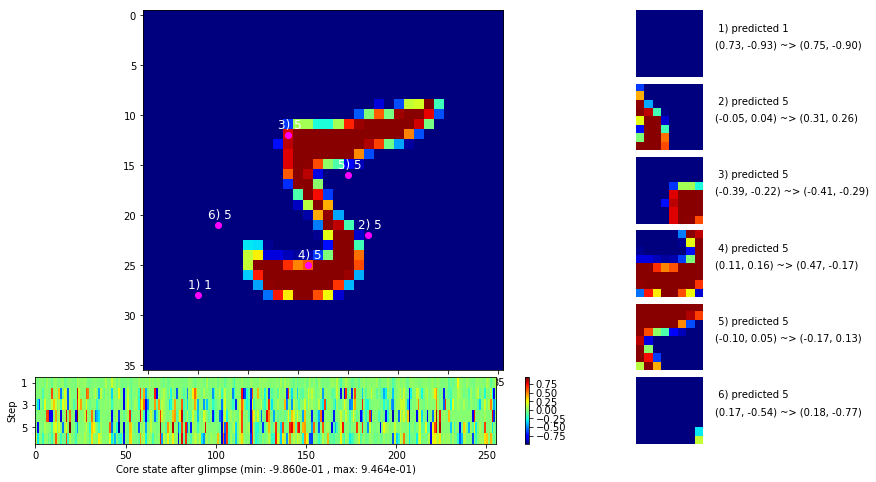

 b   2500/  3000 >> 129.1 ms/b | lr: 2.73e-04 | grad 2norm:  4.35 | grad inf norm:  1.191
       Weights || abs max:  2.04 (33620.96) | mean: -1.16e-04 ( 0.13) | var: 4.12e-02 (79152.80)
        Biases || abs max:  1.04 (  495.08) | mean: -1.07e-01 ( 0.37) | var: 5.07e-02 ( 2548.03)
                  class loss: 0.176 | steps: 2.135 | reward:  0.944 | acc.: 94.42%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.5 ms/b | lr: 2.72e-04 | grad 2norm:  4.11 | grad inf norm:  1.125
       Weights || abs max:  2.04 (33433.02) | mean: -1.18e-04 ( 0.13) | var: 4.12e-02 (29789.38)
        Biases || abs max:  1.03 (  232.38) | mean: -1.07e-01 ( 0.26) | var: 5.08e-02 (  428.00)
                  class loss: 0.172 | steps: 2.139 | reward:  0.949 | acc.: 94.86%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

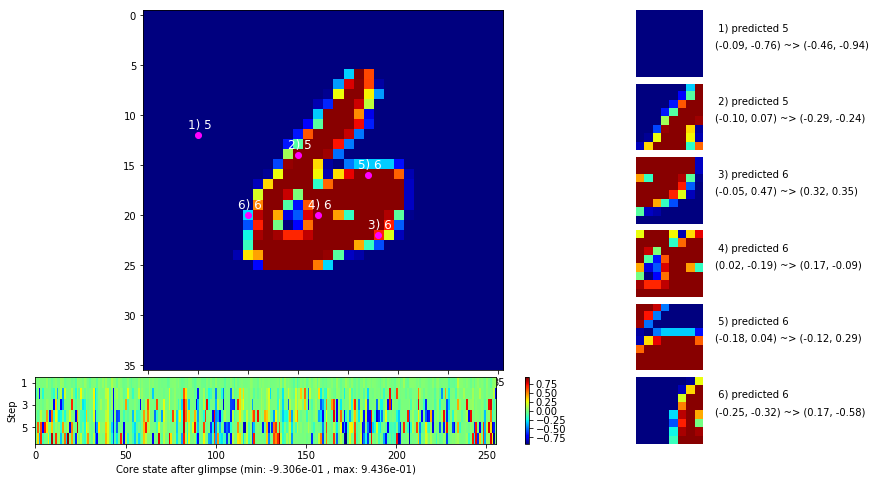

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


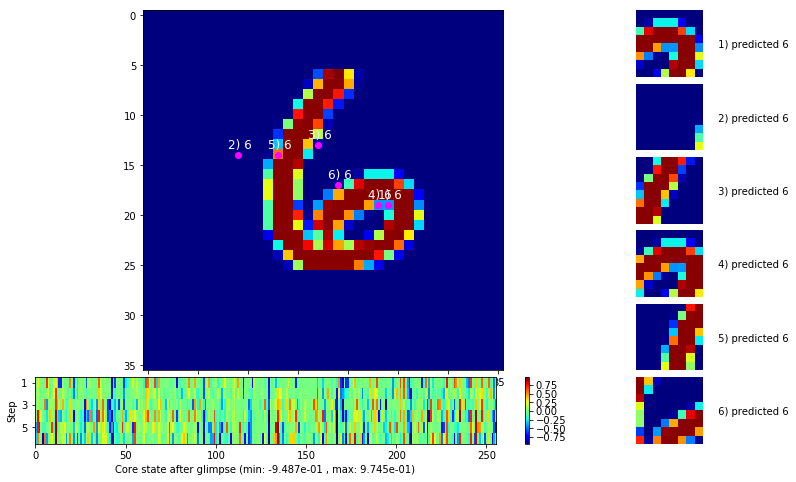


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


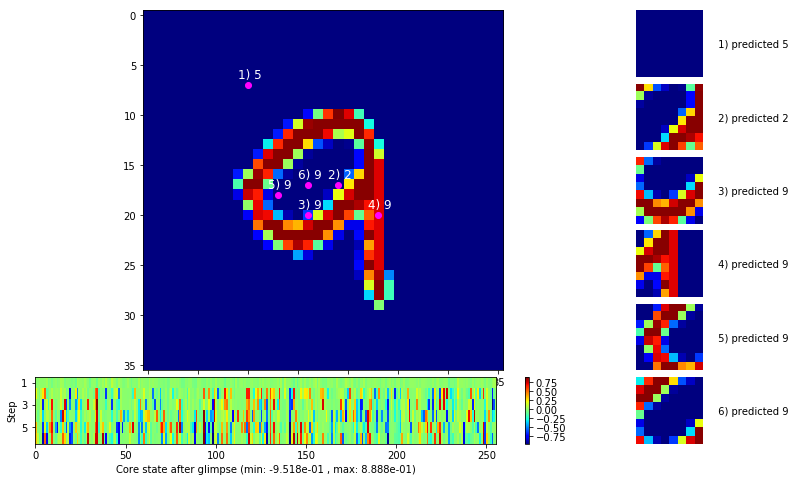

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


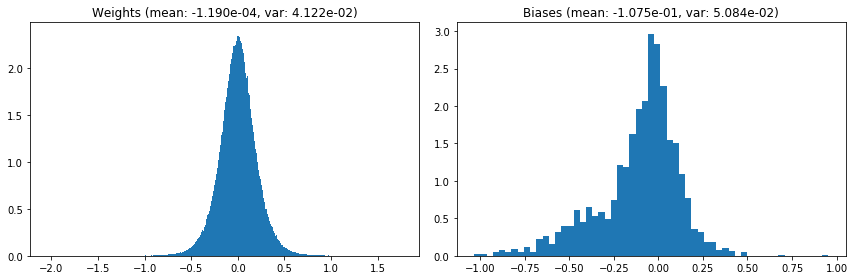

                                      Location network weights and biases


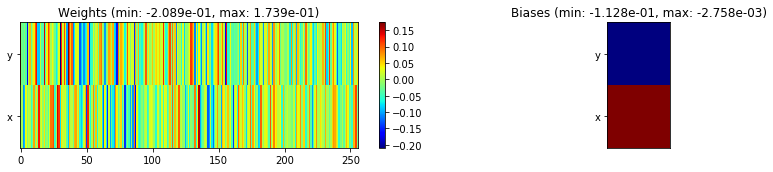

---------------------------------------------------------------------------------------------------------------
Elapsed time:  397.12 sec | TRAIN >> class loss: 0.1717 | steps:  2.144 :( | reward:  0.9454 :( | acc.: 94.538% :(
                          | VAL   >> class loss: 0.1364 | steps:  1.999 :( | reward:  0.9554 :( | acc.: 95.540% :(


Epoch  41/400) lr = 0.0002715
 b    500/  3000 >> 127.1 ms/b | lr: 2.71e-04 | grad 2norm:  4.24 | grad inf norm:  1.167
       Weights || abs max:  2.04 (28581.63) | mean: -1.22e-04 ( 0.12) | var: 4.12e-02 (25872.36)
        Biases || abs max:  1.03 ( 1410.06) | mean: -1.07e-01 ( 0.72) | var: 5.08e-02 (14270.09)
                  class loss: 0.166 | steps: 2.142 | reward:  0.947 | acc.: 94.71%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.9 ms/b | lr: 2.70e-04 | grad 2norm:  4.04 | grad inf norm:  1.165
       Weights || abs max:  2.04 (66464.30) | mean: -1.29e-04 ( 0.19) |

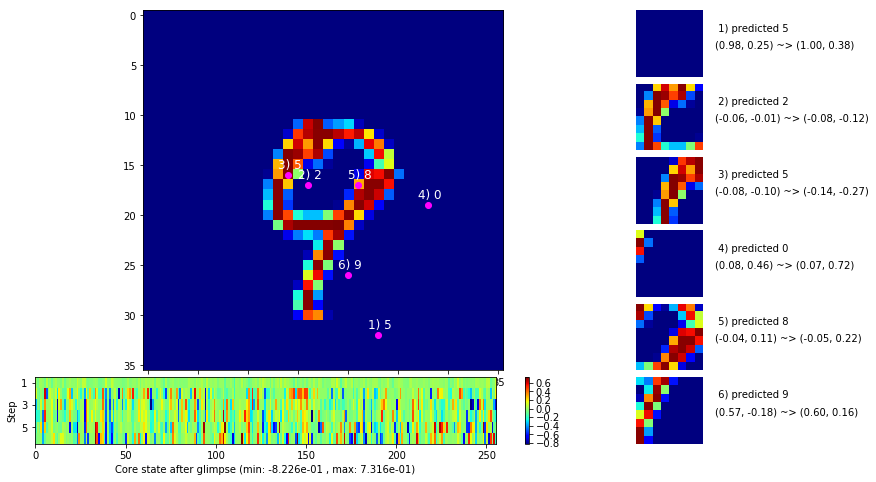

 b   1500/  3000 >> 128.6 ms/b | lr: 2.69e-04 | grad 2norm:  4.18 | grad inf norm:  1.152
       Weights || abs max:  2.05 (24411.12) | mean: -1.26e-04 ( 0.11) | var: 4.13e-02 (14705.67)
        Biases || abs max:  1.03 (  248.36) | mean: -1.07e-01 ( 0.24) | var: 5.09e-02 ( 1326.23)
                  class loss: 0.164 | steps: 2.148 | reward:  0.947 | acc.: 94.65%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.4 ms/b | lr: 2.68e-04 | grad 2norm:  4.15 | grad inf norm:  1.171
       Weights || abs max:  2.05 (223302.02) | mean: -1.46e-04 ( 0.48) | var: 4.13e-02 (30326206.00)
        Biases || abs max:  1.03 (  575.89) | mean: -1.08e-01 ( 0.50) | var: 5.10e-02 (28597.47)
                  class loss: 0.169 | steps: 2.134 | reward:  0.948 | acc.: 94.82%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

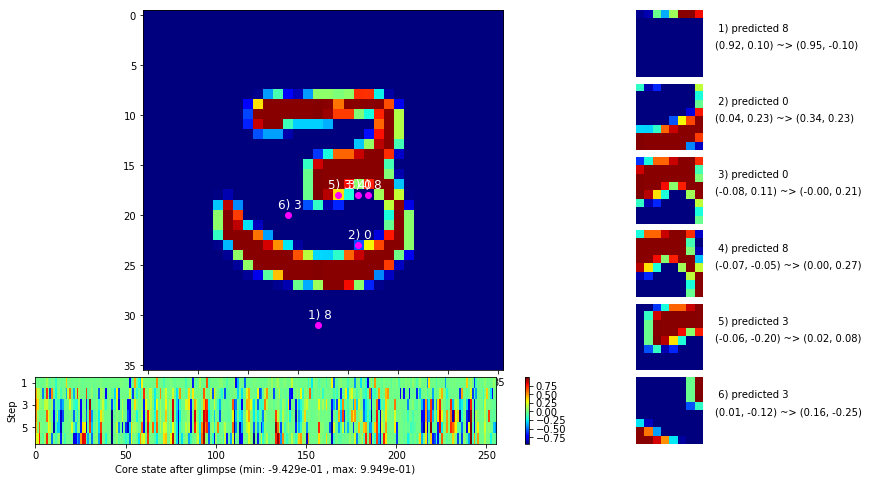

 b   2500/  3000 >> 147.6 ms/b | lr: 2.67e-04 | grad 2norm:  4.26 | grad inf norm:  1.167
       Weights || abs max:  2.05 (24370.64) | mean: -1.62e-04 ( 0.11) | var: 4.13e-02 (19087.77)
        Biases || abs max:  1.03 (  281.28) | mean: -1.07e-01 ( 0.26) | var: 5.10e-02 ( 4032.82)
                  class loss: 0.166 | steps: 2.140 | reward:  0.946 | acc.: 94.59%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 131.3 ms/b | lr: 2.66e-04 | grad 2norm:  4.02 | grad inf norm:  1.143
       Weights || abs max:  2.05 (23403.90) | mean: -1.67e-04 ( 0.11) | var: 4.14e-02 ( 9939.60)
        Biases || abs max:  1.03 (  260.03) | mean: -1.08e-01 ( 0.28) | var: 5.10e-02 ( 2012.11)
                  class loss: 0.158 | steps: 2.146 | reward:  0.950 | acc.: 95.02%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

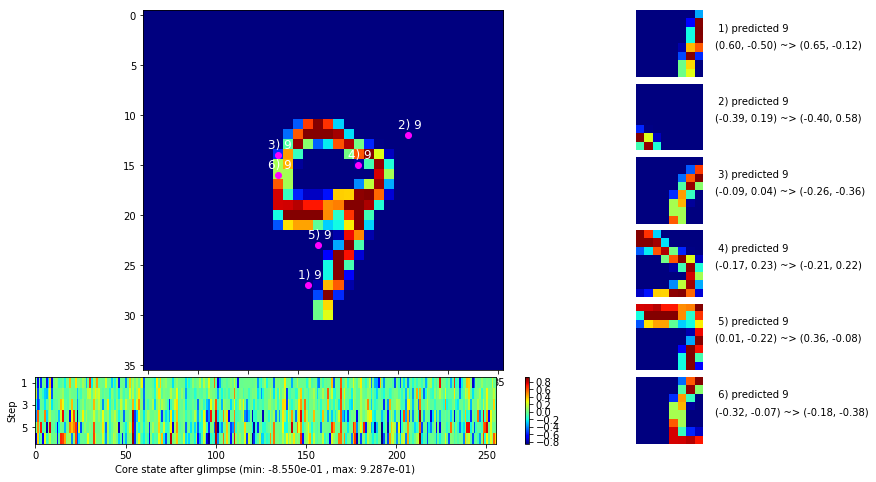

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


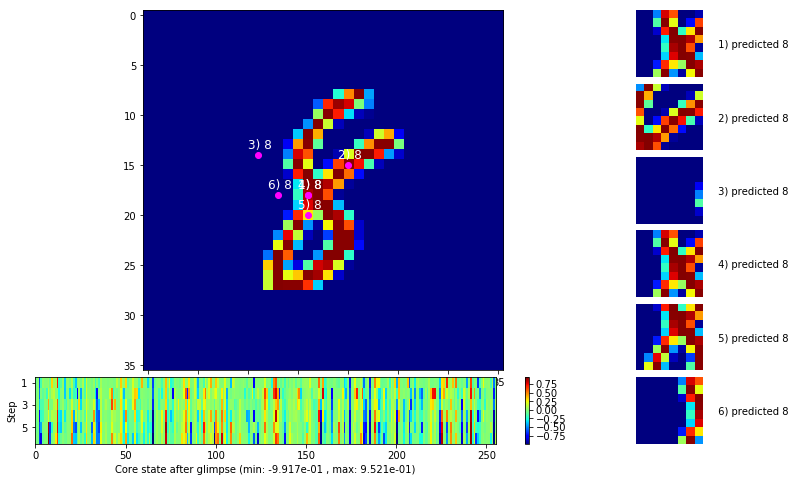


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


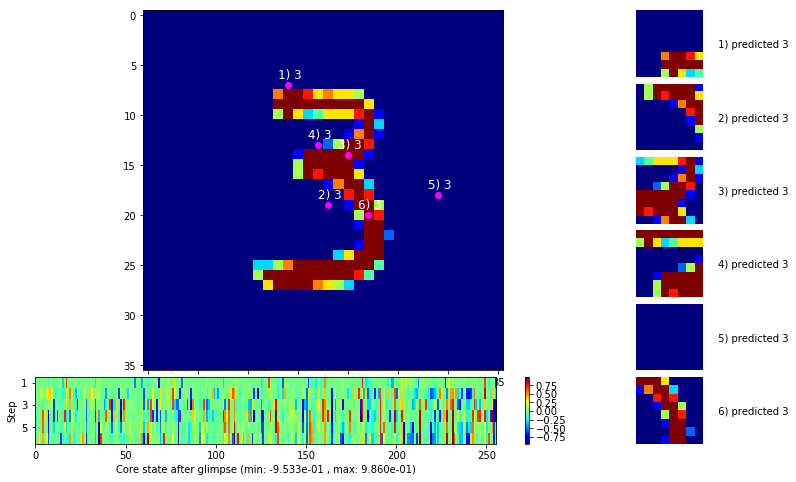

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


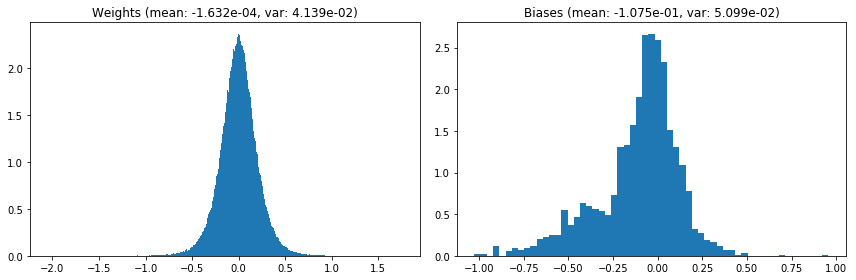

                                      Location network weights and biases


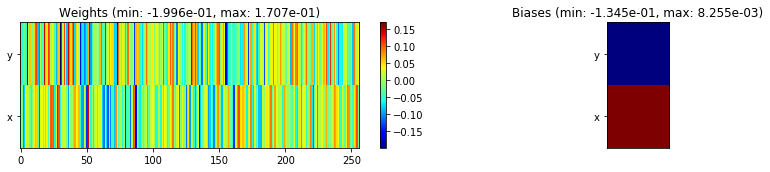

---------------------------------------------------------------------------------------------------------------
Elapsed time:  397.15 sec | TRAIN >> class loss: 0.1645 | steps:  2.139 :( | reward:  0.9480    | acc.: 94.805% 
                          | VAL   >> class loss: 0.1516 | steps:  1.997 :( | reward:  0.9524 :( | acc.: 95.240% :(


Epoch  42/400) lr = 0.0002659
 b    500/  3000 >> 131.6 ms/b | lr: 2.65e-04 | grad 2norm:  4.10 | grad inf norm:  1.145
       Weights || abs max:  2.05 (23982.52) | mean: -1.70e-04 ( 0.11) | var: 4.14e-02 (10309.95)
        Biases || abs max:  1.03 ( 1419.75) | mean: -1.08e-01 ( 0.70) | var: 5.10e-02 (271326.91)
                  class loss: 0.169 | steps: 2.135 | reward:  0.948 | acc.: 94.81%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.7 ms/b | lr: 2.64e-04 | grad 2norm:  4.17 | grad inf norm:  1.161
       Weights || abs max:  2.06 (29432.71) | mean: -1.67e-04 ( 0.12) | 

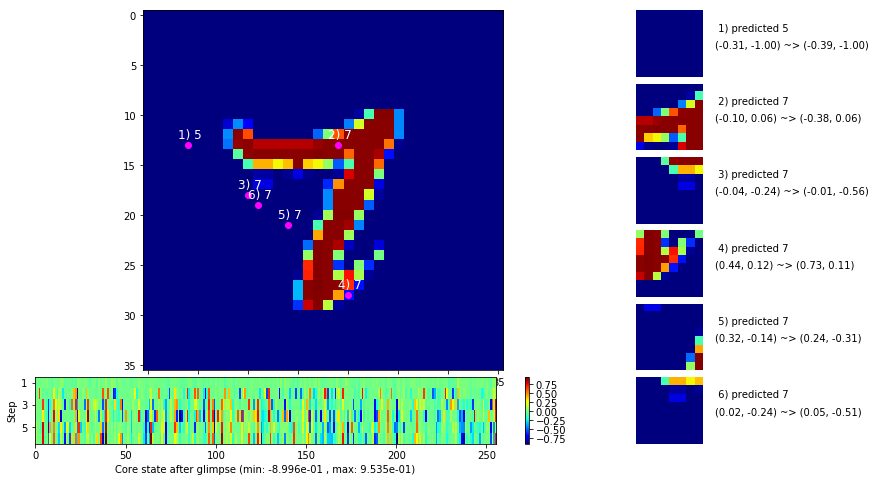

 b   1500/  3000 >> 134.0 ms/b | lr: 2.63e-04 | grad 2norm:  4.24 | grad inf norm:  1.185
       Weights || abs max:  2.06 (23384.72) | mean: -1.58e-04 ( 0.11) | var: 4.15e-02 (37398.13)
        Biases || abs max:  1.03 (  436.82) | mean: -1.07e-01 ( 0.35) | var: 5.12e-02 ( 6030.73)
                  class loss: 0.168 | steps: 2.127 | reward:  0.946 | acc.: 94.62%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.6 ms/b | lr: 2.63e-04 | grad 2norm:  4.23 | grad inf norm:  1.223
       Weights || abs max:  2.06 (52127.78) | mean: -1.56e-04 ( 0.16) | var: 4.15e-02 (297368.78)
        Biases || abs max:  1.03 ( 2479.19) | mean: -1.08e-01 ( 2.03) | var: 5.12e-02 (1926108.50)
                  class loss: 0.169 | steps: 2.113 | reward:  0.946 | acc.: 94.57%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

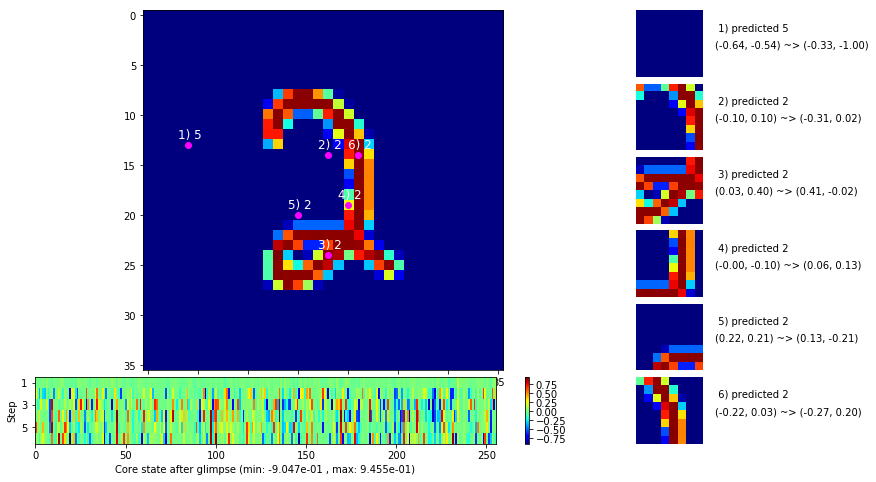

 b   2500/  3000 >> 130.5 ms/b | lr: 2.62e-04 | grad 2norm:  4.14 | grad inf norm:  1.158
       Weights || abs max:  2.06 (38963.05) | mean: -1.36e-04 ( 0.13) | var: 4.15e-02 (169932.56)
        Biases || abs max:  1.03 (  310.26) | mean: -1.08e-01 ( 0.33) | var: 5.12e-02 ( 2104.57)
                  class loss: 0.165 | steps: 2.119 | reward:  0.948 | acc.: 94.77%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.8 ms/b | lr: 2.61e-04 | grad 2norm:  4.28 | grad inf norm:  1.167
       Weights || abs max:  2.07 (40656.03) | mean: -1.26e-04 ( 0.15) | var: 4.16e-02 (82287.00)
        Biases || abs max:  1.03 (  319.23) | mean: -1.08e-01 ( 0.31) | var: 5.12e-02 (  833.85)
                  class loss: 0.170 | steps: 2.138 | reward:  0.945 | acc.: 94.53%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

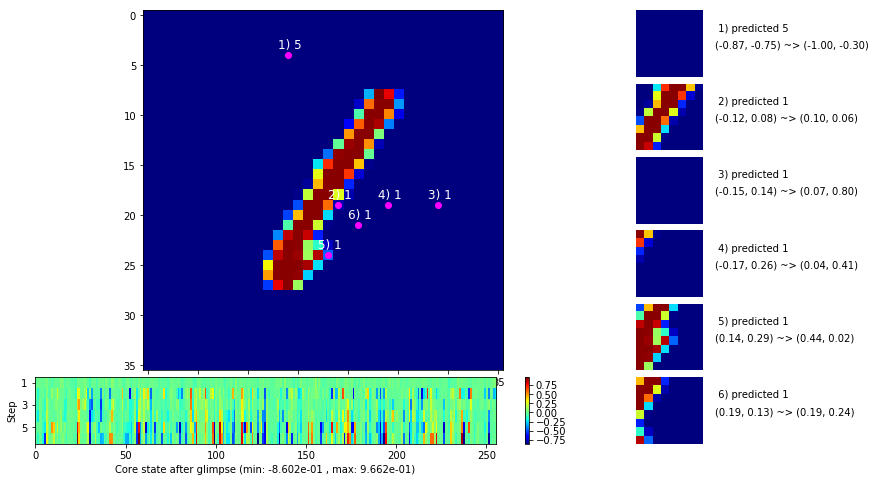

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


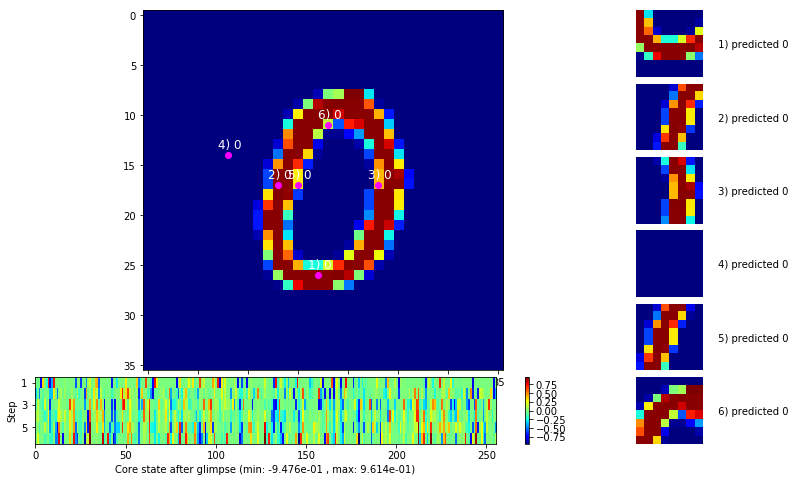


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


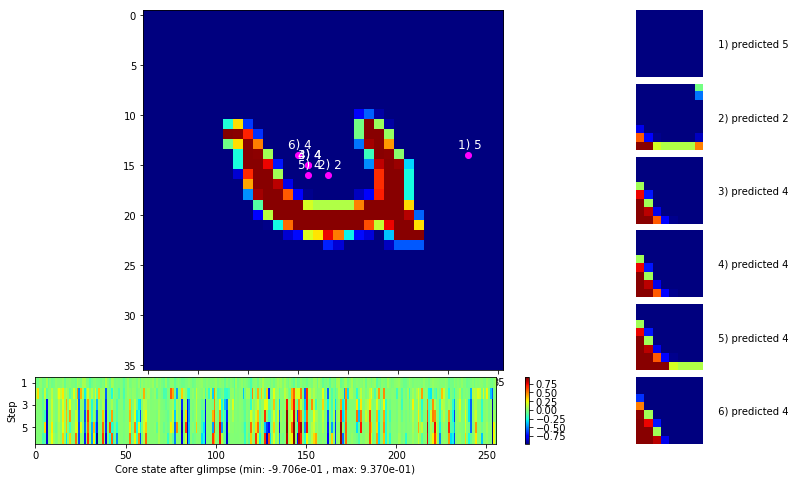

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


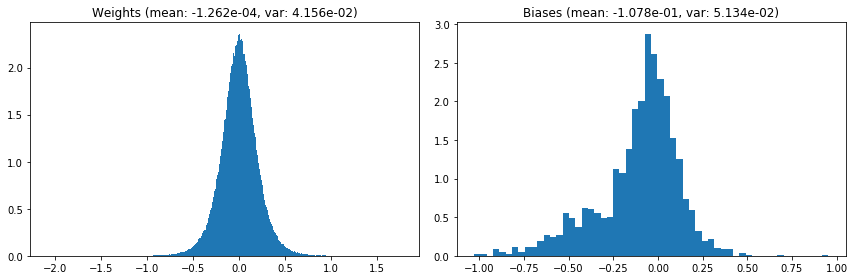

                                      Location network weights and biases


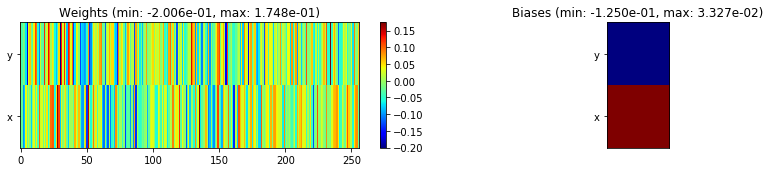

---------------------------------------------------------------------------------------------------------------
Elapsed time:  391.16 sec | TRAIN >> class loss: 0.1677 | steps:  2.129    | reward:  0.9468 :( | acc.: 94.678% :(
                          | VAL   >> class loss: 0.1387 | steps:  2.025 :( | reward:  0.9528 :( | acc.: 95.280% :(


Epoch  43/400) lr = 0.0002605
 b    500/  3000 >> 136.1 ms/b | lr: 2.60e-04 | grad 2norm:  4.27 | grad inf norm:  1.190
       Weights || abs max:  2.07 (30284.24) | mean: -1.38e-04 ( 0.13) | var: 4.16e-02 (17425.96)
        Biases || abs max:  1.03 (  316.24) | mean: -1.08e-01 ( 0.34) | var: 5.13e-02 (  641.80)
                  class loss: 0.173 | steps: 2.157 | reward:  0.945 | acc.: 94.54%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 140.2 ms/b | lr: 2.59e-04 | grad 2norm:  4.11 | grad inf norm:  1.155
       Weights || abs max:  2.07 (58734.98) | mean: -1.67e-04 ( 0.19) |

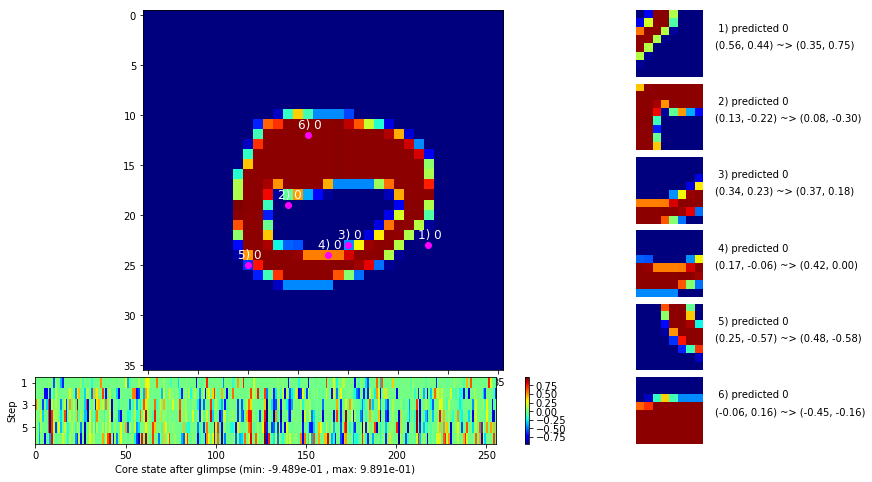

 b   1500/  3000 >> 128.6 ms/b | lr: 2.58e-04 | grad 2norm:  4.11 | grad inf norm:  1.122
       Weights || abs max:  2.07 (31097.67) | mean: -1.82e-04 ( 0.13) | var: 4.16e-02 (16923.34)
        Biases || abs max:  1.04 (  411.84) | mean: -1.08e-01 ( 0.35) | var: 5.14e-02 ( 2144.95)
                  class loss: 0.157 | steps: 2.118 | reward:  0.949 | acc.: 94.88%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.7 ms/b | lr: 2.57e-04 | grad 2norm:  4.02 | grad inf norm:  1.098
       Weights || abs max:  2.07 (36628.31) | mean: -1.97e-04 ( 0.13) | var: 4.17e-02 (91585.34)
        Biases || abs max:  1.04 (  632.75) | mean: -1.08e-01 ( 0.43) | var: 5.14e-02 (24536.20)
                  class loss: 0.154 | steps: 2.115 | reward:  0.951 | acc.: 95.13%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

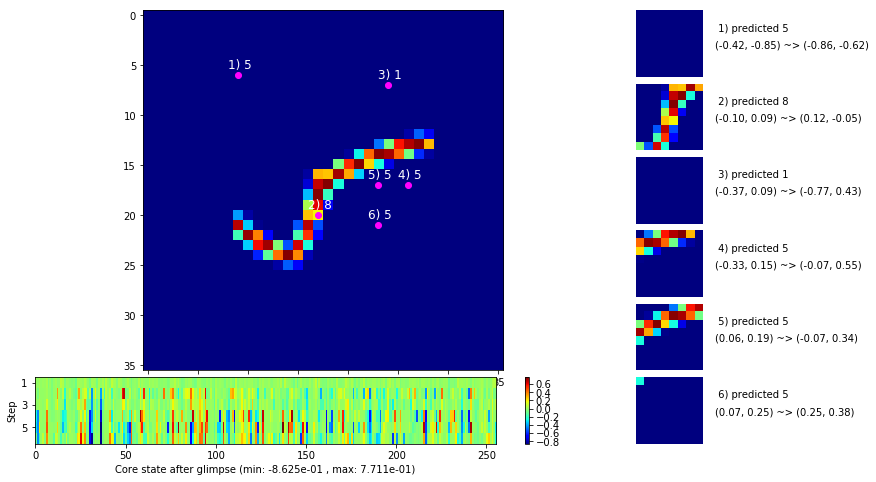

 b   2500/  3000 >> 128.6 ms/b | lr: 2.56e-04 | grad 2norm:  4.17 | grad inf norm:  1.154
       Weights || abs max:  2.08 (22645.55) | mean: -2.00e-04 ( 0.11) | var: 4.17e-02 (16000.78)
        Biases || abs max:  1.04 (  572.81) | mean: -1.08e-01 ( 0.39) | var: 5.14e-02 ( 5196.45)
                  class loss: 0.166 | steps: 2.136 | reward:  0.948 | acc.: 94.82%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 129.9 ms/b | lr: 2.56e-04 | grad 2norm:  4.07 | grad inf norm:  1.126
       Weights || abs max:  2.08 (73974.95) | mean: -2.09e-04 ( 0.20) | var: 4.17e-02 (1593727.88)
        Biases || abs max:  1.04 (  302.07) | mean: -1.08e-01 ( 0.32) | var: 5.15e-02 ( 2261.96)
                  class loss: 0.159 | steps: 2.158 | reward:  0.950 | acc.: 95.03%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

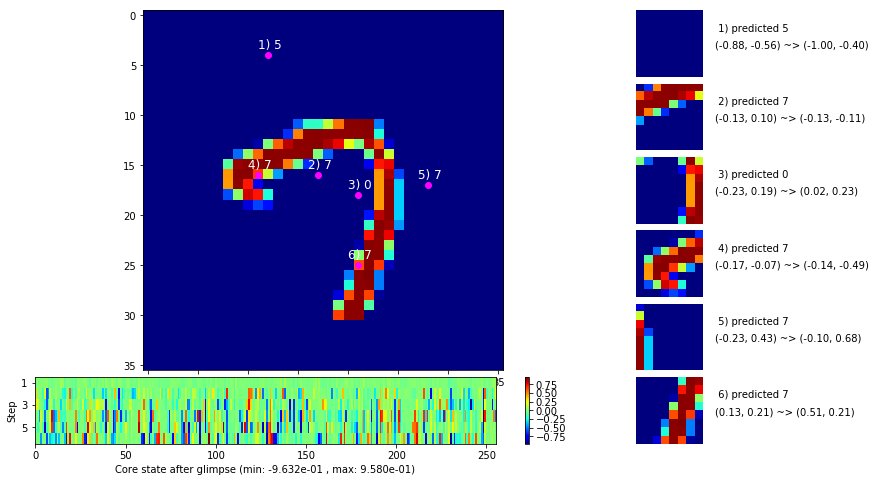

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


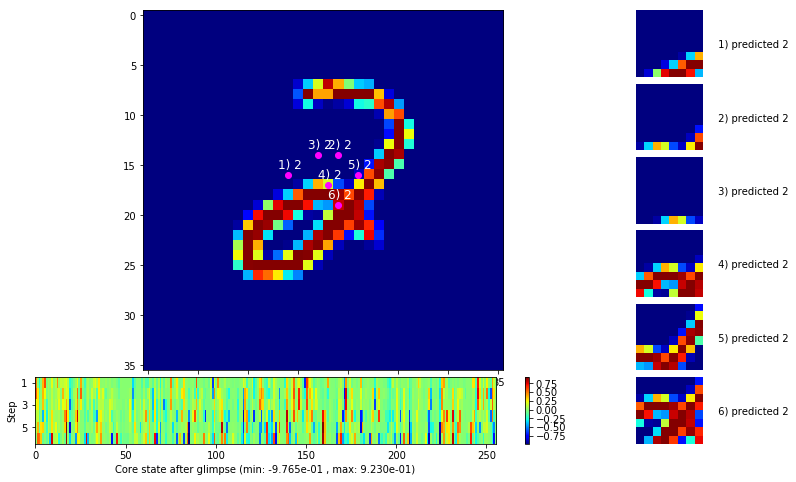


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


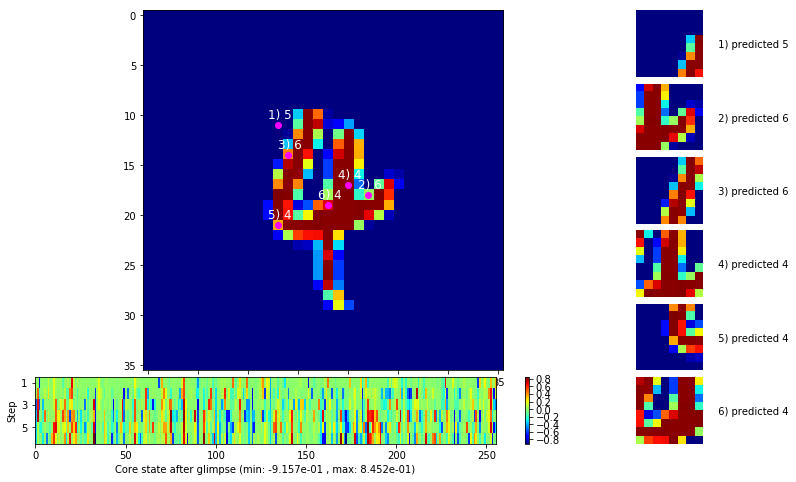

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


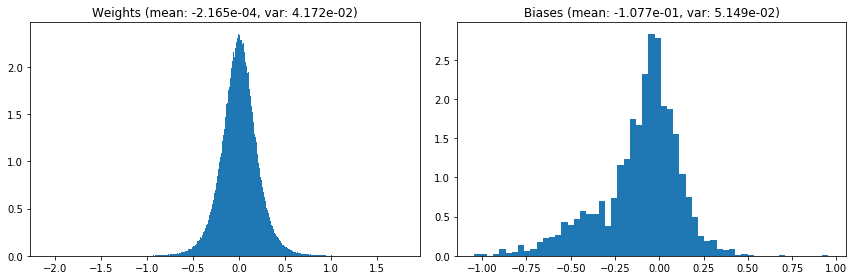

                                      Location network weights and biases


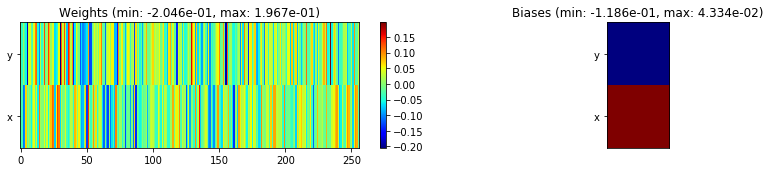

---------------------------------------------------------------------------------------------------------------
Elapsed time:  396.81 sec | TRAIN >> class loss: 0.1631 | steps:  2.139 :( | reward:  0.9485    | acc.: 94.847% 
                          | VAL   >> class loss: 0.1548 | steps:  2.028 :( | reward:  0.9500 :( | acc.: 95.000% :(


Epoch  44/400) lr = 0.0002554
 b    500/  3000 >> 128.1 ms/b | lr: 2.55e-04 | grad 2norm:  4.20 | grad inf norm:  1.163
       Weights || abs max:  2.08 (35293.57) | mean: -2.17e-04 ( 0.14) | var: 4.17e-02 (25305.43)
        Biases || abs max:  1.04 (  191.72) | mean: -1.08e-01 ( 0.26) | var: 5.15e-02 (  262.86)
                  class loss: 0.169 | steps: 2.142 | reward:  0.947 | acc.: 94.65%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.0 ms/b | lr: 2.54e-04 | grad 2norm:  4.26 | grad inf norm:  1.153
       Weights || abs max:  2.08 (66110.27) | mean: -2.23e-04 ( 0.19) | v

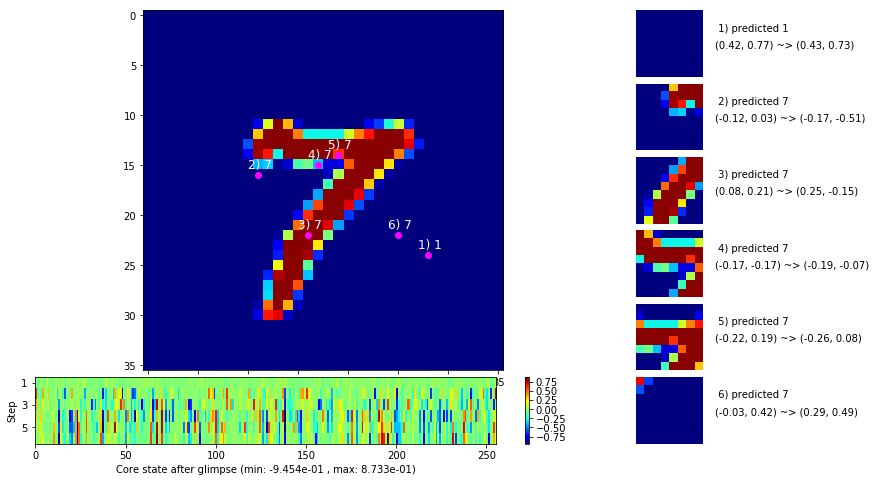

 b   1500/  3000 >> 129.3 ms/b | lr: 2.53e-04 | grad 2norm:  4.28 | grad inf norm:  1.169
       Weights || abs max:  2.10 (37768.70) | mean: -2.35e-04 ( 0.14) | var: 4.18e-02 (68715.56)
        Biases || abs max:  1.04 (  126.95) | mean: -1.09e-01 ( 0.21) | var: 5.18e-02 (  146.84)
                  class loss: 0.174 | steps: 2.167 | reward:  0.943 | acc.: 94.33%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 135.3 ms/b | lr: 2.52e-04 | grad 2norm:  4.05 | grad inf norm:  1.174
       Weights || abs max:  2.11 (38430.99) | mean: -2.39e-04 ( 0.14) | var: 4.18e-02 (102721.48)
        Biases || abs max:  1.04 ( 1125.75) | mean: -1.09e-01 ( 0.62) | var: 5.19e-02 (119710.91)
                  class loss: 0.163 | steps: 2.136 | reward:  0.948 | acc.: 94.81%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

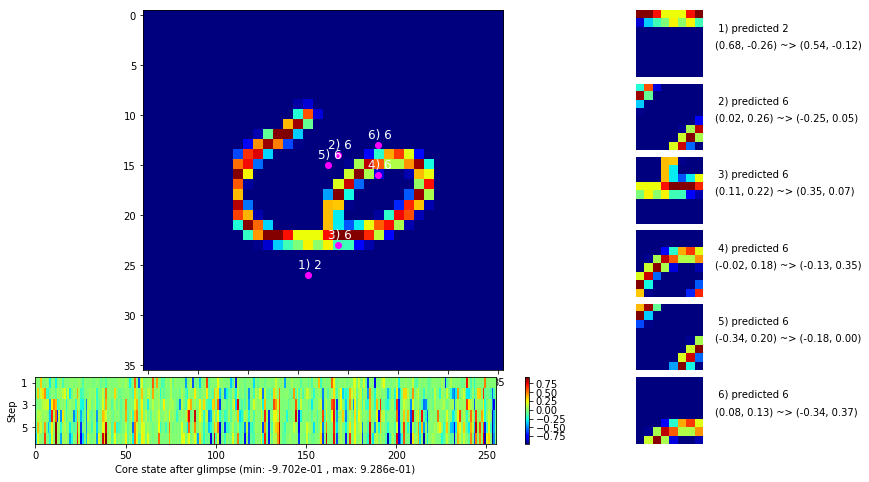

 b   2500/  3000 >> 142.7 ms/b | lr: 2.51e-04 | grad 2norm:  3.92 | grad inf norm:  1.092
       Weights || abs max:  2.11 (59577.53) | mean: -2.52e-04 ( 0.17) | var: 4.18e-02 (553843.75)
        Biases || abs max:  1.04 (  917.62) | mean: -1.08e-01 ( 0.58) | var: 5.19e-02 ( 8804.37)
                  class loss: 0.155 | steps: 2.139 | reward:  0.953 | acc.: 95.34%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.5 ms/b | lr: 2.51e-04 | grad 2norm:  4.10 | grad inf norm:  1.181
       Weights || abs max:  2.11 (48132.27) | mean: -2.68e-04 ( 0.16) | var: 4.18e-02 (119550.50)
        Biases || abs max:  1.04 (  628.98) | mean: -1.08e-01 ( 0.44) | var: 5.19e-02 ( 5293.15)
                  class loss: 0.167 | steps: 2.138 | reward:  0.948 | acc.: 94.84%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

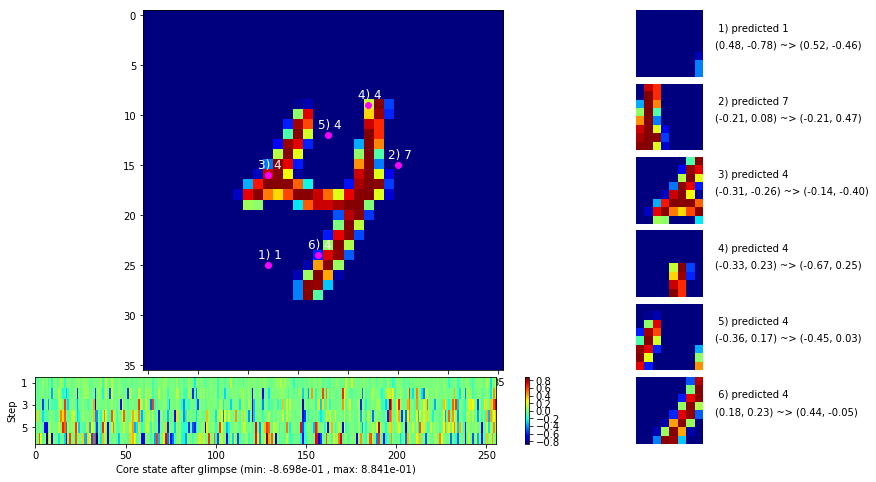

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


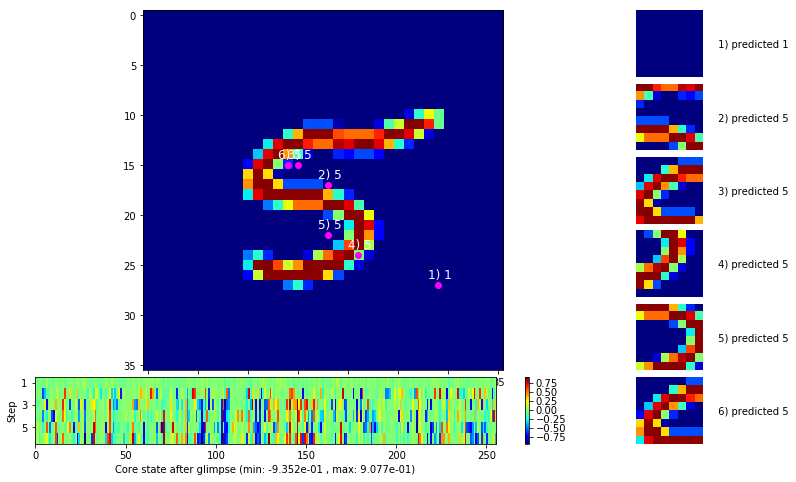


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


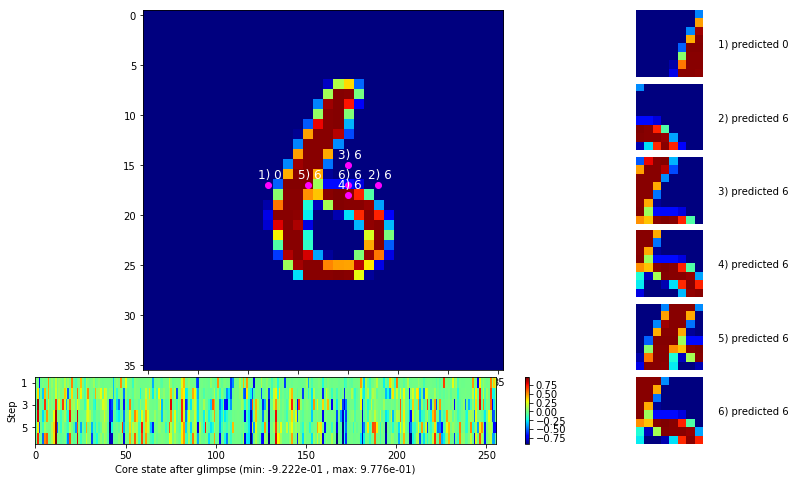

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


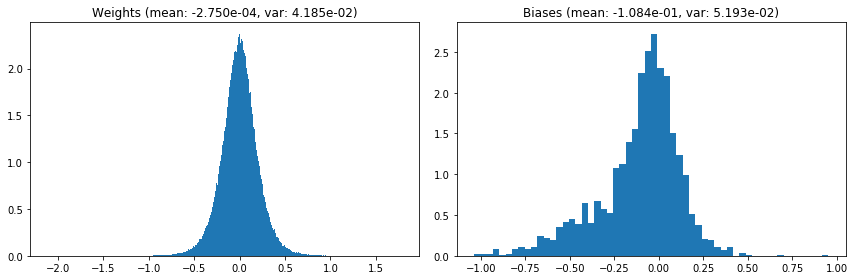

                                      Location network weights and biases


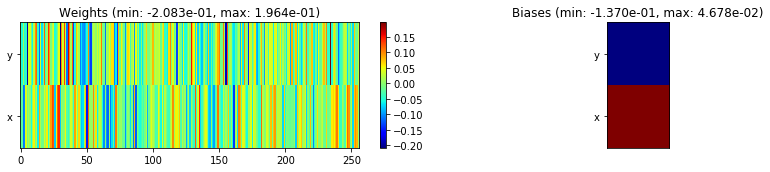

---------------------------------------------------------------------------------------------------------------
Elapsed time:  396.53 sec | TRAIN >> class loss: 0.1674 | steps:  2.145 :( | reward:  0.9477 :( | acc.: 94.767% :(
                          | VAL   >> class loss: 0.1575 | steps:  1.997 :( | reward:  0.9512 :( | acc.: 95.120% :(


Epoch  45/400) lr = 0.0002504
 b    500/  3000 >> 128.5 ms/b | lr: 2.50e-04 | grad 2norm:  4.18 | grad inf norm:  1.180
       Weights || abs max:  2.11 (37941.14) | mean: -2.81e-04 ( 0.14) | var: 4.19e-02 (30971.19)
        Biases || abs max:  1.03 (  523.39) | mean: -1.08e-01 ( 0.38) | var: 5.19e-02 ( 2633.69)
                  class loss: 0.171 | steps: 2.143 | reward:  0.947 | acc.: 94.66%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.6 ms/b | lr: 2.49e-04 | grad 2norm:  4.06 | grad inf norm:  1.167
       Weights || abs max:  2.10 (31517.24) | mean: -2.91e-04 ( 0.13) |

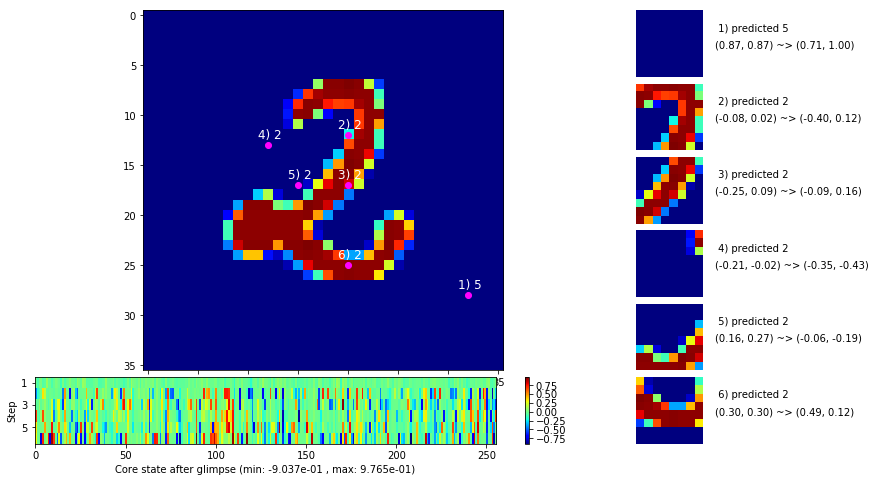

 b   1500/  3000 >> 130.7 ms/b | lr: 2.48e-04 | grad 2norm:  4.20 | grad inf norm:  1.160
       Weights || abs max:  2.10 (27164.71) | mean: -2.87e-04 ( 0.12) | var: 4.19e-02 (13927.40)
        Biases || abs max:  1.03 (  386.00) | mean: -1.09e-01 ( 0.35) | var: 5.20e-02 (  599.19)
                  class loss: 0.172 | steps: 2.144 | reward:  0.947 | acc.: 94.68%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.3 ms/b | lr: 2.48e-04 | grad 2norm:  4.34 | grad inf norm:  1.193
       Weights || abs max:  2.10 (24542.38) | mean: -2.82e-04 ( 0.11) | var: 4.19e-02 (13309.67)
        Biases || abs max:  1.02 (  179.74) | mean: -1.09e-01 ( 0.22) | var: 5.21e-02 (  215.90)
                  class loss: 0.182 | steps: 2.151 | reward:  0.945 | acc.: 94.45%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

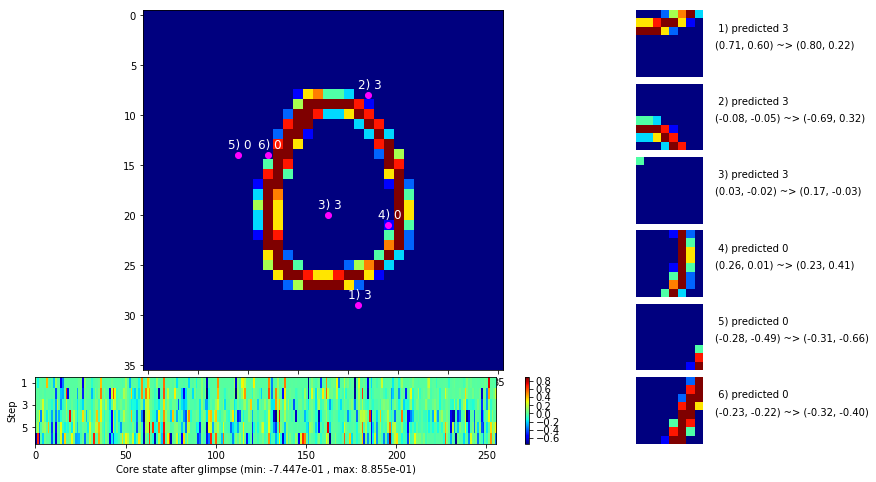

 b   2500/  3000 >> 128.9 ms/b | lr: 2.47e-04 | grad 2norm:  4.22 | grad inf norm:  1.153
       Weights || abs max:  2.11 (55754.96) | mean: -2.69e-04 ( 0.16) | var: 4.20e-02 (509497.78)
        Biases || abs max:  1.02 (  211.53) | mean: -1.09e-01 ( 0.25) | var: 5.21e-02 (  434.72)
                  class loss: 0.163 | steps: 2.132 | reward:  0.947 | acc.: 94.65%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.2 ms/b | lr: 2.46e-04 | grad 2norm:  4.02 | grad inf norm:  1.150
       Weights || abs max:  2.11 (42195.85) | mean: -2.73e-04 ( 0.14) | var: 4.20e-02 (364282.44)
        Biases || abs max:  1.02 (  253.08) | mean: -1.09e-01 ( 0.24) | var: 5.22e-02 (  738.18)
                  class loss: 0.166 | steps: 2.136 | reward:  0.949 | acc.: 94.86%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

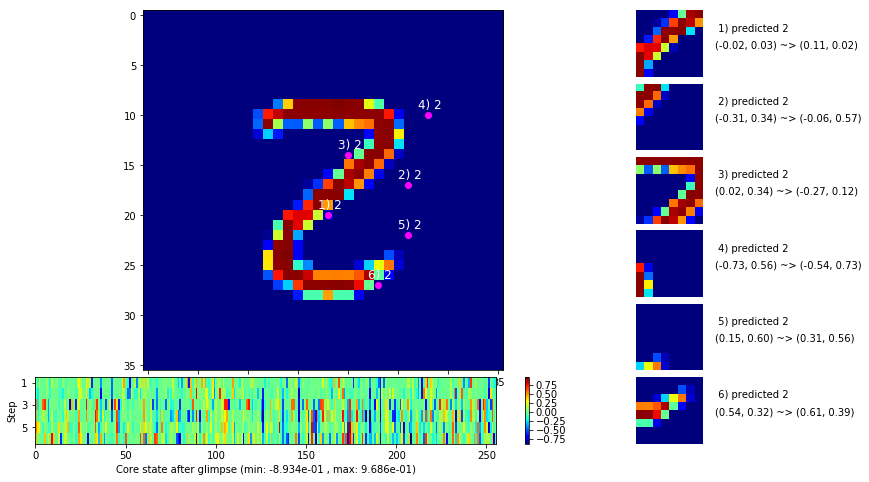

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


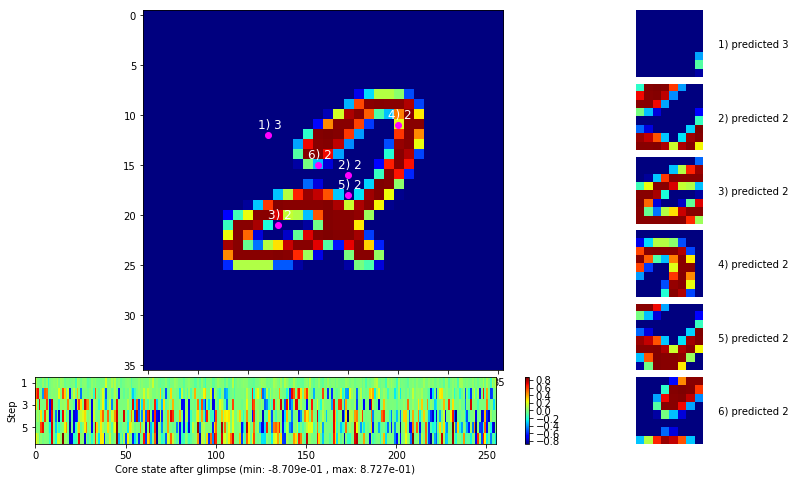


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


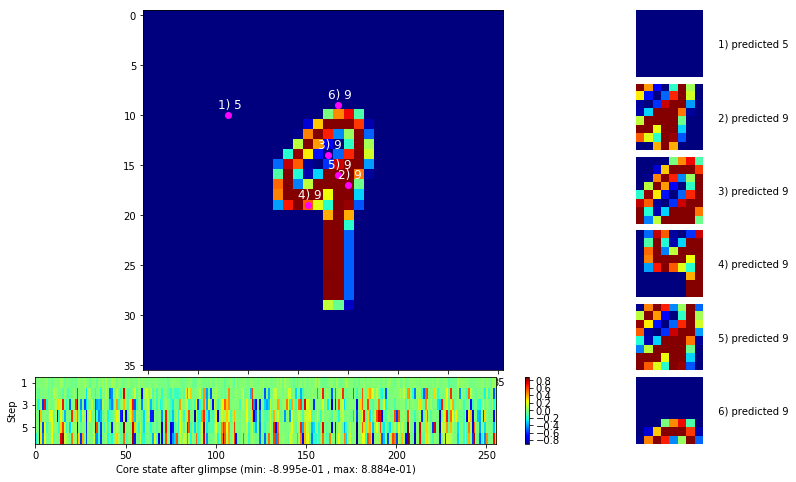

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


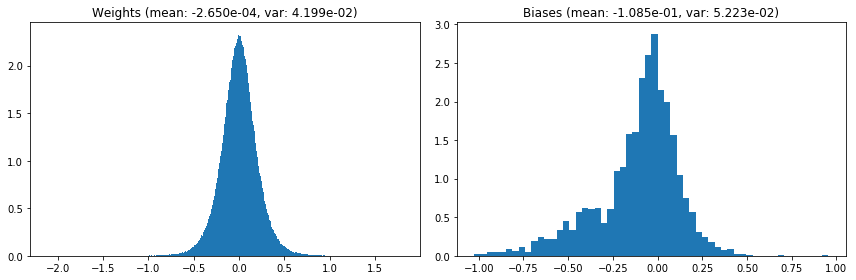

                                      Location network weights and biases


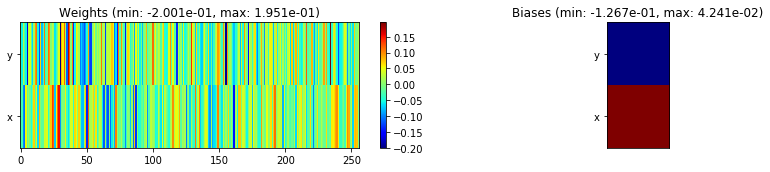

---------------------------------------------------------------------------------------------------------------
Elapsed time:  386.79 sec | TRAIN >> class loss: 0.1686 | steps:  2.140 :( | reward:  0.9469 :( | acc.: 94.695% :(
                          | VAL   >> class loss: 0.1374 | steps:  1.994 :( | reward:  0.9540 :( | acc.: 95.400% :(


Epoch  46/400) lr = 0.0002457
 b    500/  3000 >> 137.1 ms/b | lr: 2.45e-04 | grad 2norm:  4.13 | grad inf norm:  1.174
       Weights || abs max:  2.11 (75193.60) | mean: -2.69e-04 ( 0.21) | var: 4.20e-02 (549987.19)
        Biases || abs max:  1.03 (  404.06) | mean: -1.09e-01 ( 0.29) | var: 5.23e-02 ( 4419.05)
                  class loss: 0.170 | steps: 2.134 | reward:  0.948 | acc.: 94.83%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 141.5 ms/b | lr: 2.44e-04 | grad 2norm:  4.06 | grad inf norm:  1.118
       Weights || abs max:  2.11 (58010.67) | mean: -2.64e-04 ( 0.18) 

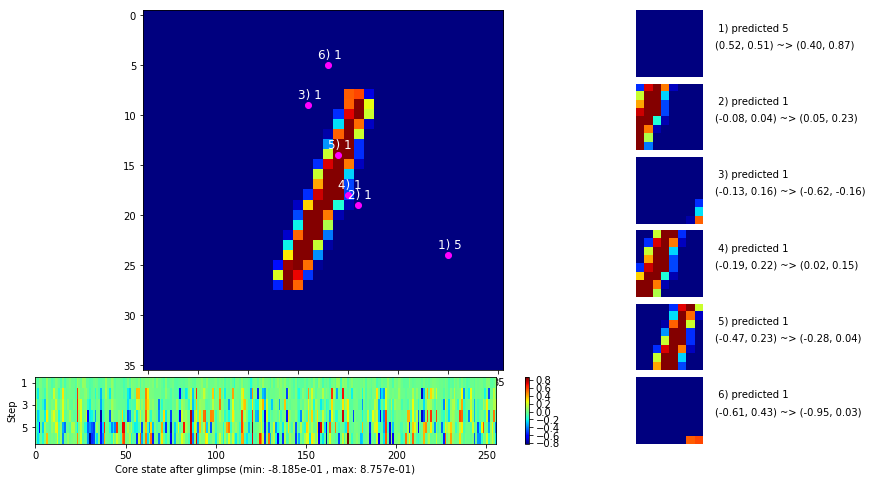

 b   1500/  3000 >> 127.9 ms/b | lr: 2.44e-04 | grad 2norm:  4.11 | grad inf norm:  1.122
       Weights || abs max:  2.11 (62233.23) | mean: -2.71e-04 ( 0.19) | var: 4.20e-02 (287222.62)
        Biases || abs max:  1.04 (  184.29) | mean: -1.09e-01 ( 0.23) | var: 5.24e-02 (  330.88)
                  class loss: 0.157 | steps: 2.145 | reward:  0.948 | acc.: 94.80%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.9 ms/b | lr: 2.43e-04 | grad 2norm:  4.08 | grad inf norm:  1.125
       Weights || abs max:  2.11 (52103.79) | mean: -2.84e-04 ( 0.16) | var: 4.21e-02 (556178.31)
        Biases || abs max:  1.04 (  473.59) | mean: -1.09e-01 ( 0.49) | var: 5.25e-02 (32575.71)
                  class loss: 0.164 | steps: 2.131 | reward:  0.949 | acc.: 94.89%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

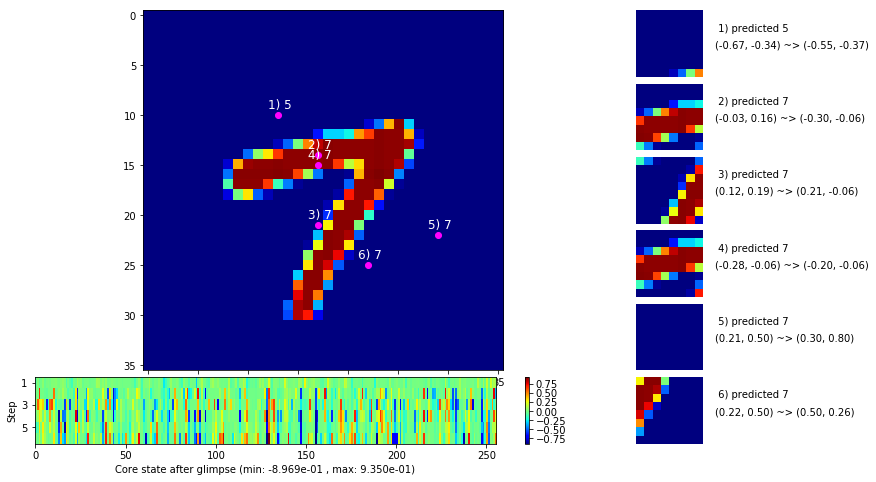

 b   2500/  3000 >> 128.4 ms/b | lr: 2.42e-04 | grad 2norm:  3.99 | grad inf norm:  1.155
       Weights || abs max:  2.11 (220006.77) | mean: -2.79e-04 ( 0.47) | var: 4.21e-02 (35364068.00)
        Biases || abs max:  1.04 (  782.12) | mean: -1.09e-01 ( 0.53) | var: 5.25e-02 (23174.04)
                  class loss: 0.157 | steps: 2.130 | reward:  0.950 | acc.: 94.96%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 128.0 ms/b | lr: 2.41e-04 | grad 2norm:  4.07 | grad inf norm:  1.103
       Weights || abs max:  2.12 (26519.58) | mean: -2.69e-04 ( 0.12) | var: 4.21e-02 (15727.93)
        Biases || abs max:  1.03 (  109.77) | mean: -1.09e-01 ( 0.18) | var: 5.26e-02 (   48.85)
                  class loss: 0.156 | steps: 2.135 | reward:  0.951 | acc.: 95.05%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

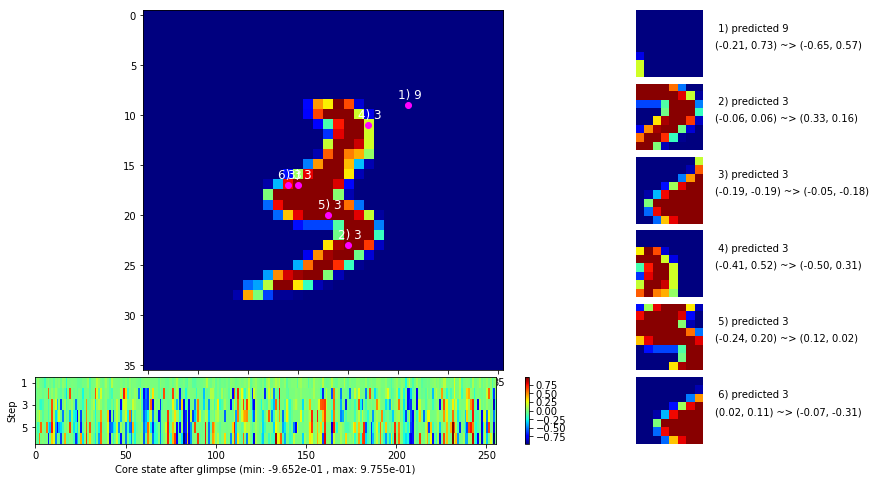

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


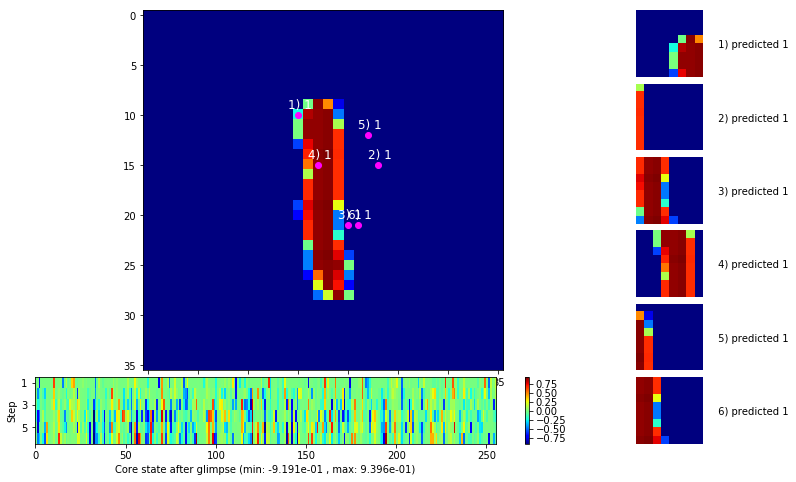


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


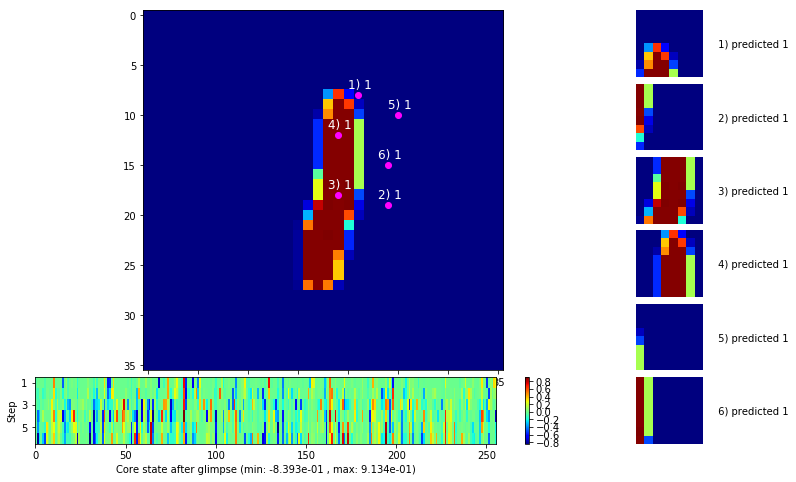

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


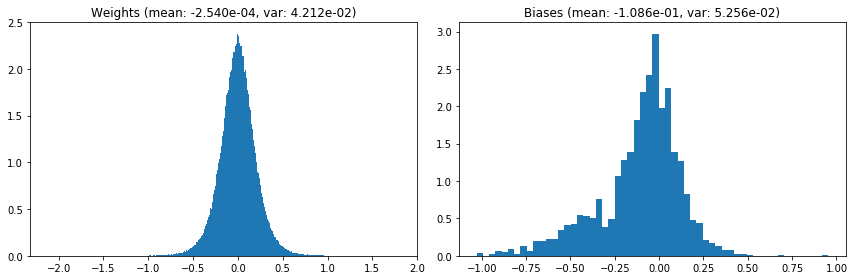

                                      Location network weights and biases


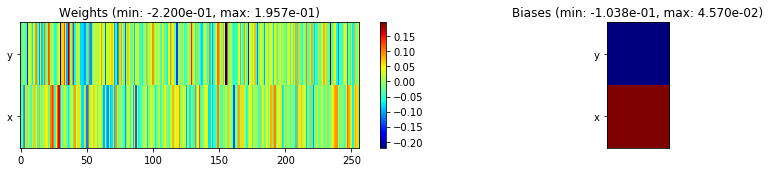

---------------------------------------------------------------------------------------------------------------
Elapsed time:  396.96 sec | TRAIN >> class loss: 0.1607 | steps:  2.136 :( | reward:  0.9492    | acc.: 94.917% 
                          | VAL   >> class loss: 0.1454 | steps:  2.002 :( | reward:  0.9560 :( | acc.: 95.600% :(


Epoch  47/400) lr = 0.0002412
 b    500/  3000 >> 129.8 ms/b | lr: 2.41e-04 | grad 2norm:  4.11 | grad inf norm:  1.136
       Weights || abs max:  2.12 (31930.30) | mean: -2.71e-04 ( 0.13) | var: 4.21e-02 (39868.73)
        Biases || abs max:  1.03 (  234.85) | mean: -1.09e-01 ( 0.25) | var: 5.26e-02 (  438.12)
                  class loss: 0.162 | steps: 2.130 | reward:  0.949 | acc.: 94.85%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.0 ms/b | lr: 2.40e-04 | grad 2norm:  3.90 | grad inf norm:  1.080
       Weights || abs max:  2.12 (30645.96) | mean: -2.87e-04 ( 0.13) | v

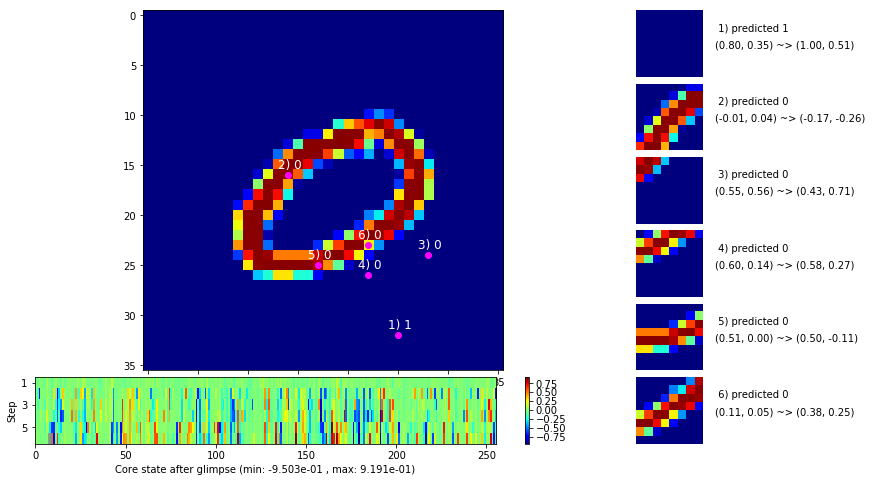

 b   1500/  3000 >> 129.6 ms/b | lr: 2.39e-04 | grad 2norm:  4.17 | grad inf norm:  1.157
       Weights || abs max:  2.13 (40314.18) | mean: -2.93e-04 ( 0.15) | var: 4.22e-02 (94211.59)
        Biases || abs max:  1.03 (  306.57) | mean: -1.09e-01 ( 0.29) | var: 5.28e-02 ( 1657.69)
                  class loss: 0.166 | steps: 2.122 | reward:  0.948 | acc.: 94.76%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.7 ms/b | lr: 2.39e-04 | grad 2norm:  4.12 | grad inf norm:  1.166
       Weights || abs max:  2.12 (70554.03) | mean: -2.73e-04 ( 0.20) | var: 4.22e-02 (1766914.50)
        Biases || abs max:  1.03 (  286.34) | mean: -1.09e-01 ( 0.28) | var: 5.29e-02 (  604.11)
                  class loss: 0.161 | steps: 2.132 | reward:  0.949 | acc.: 94.88%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

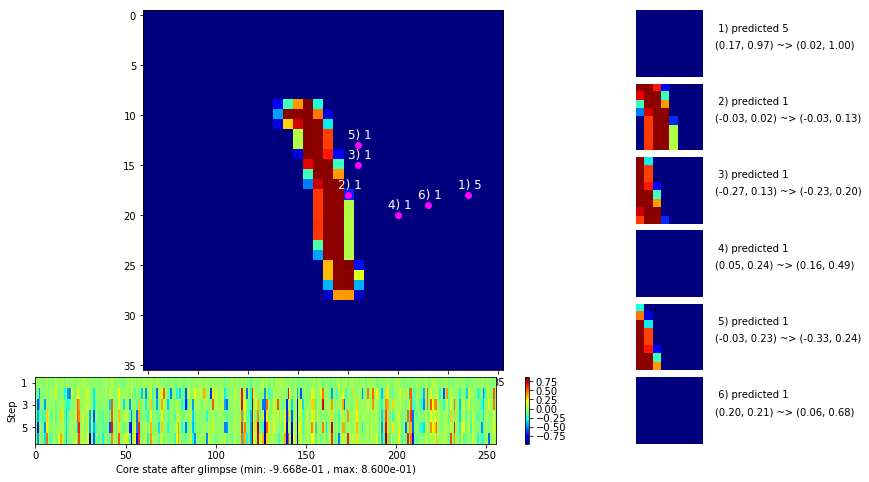

 b   2500/  3000 >> 147.3 ms/b | lr: 2.38e-04 | grad 2norm:  4.13 | grad inf norm:  1.146
       Weights || abs max:  2.12 (39365.37) | mean: -2.83e-04 ( 0.14) | var: 4.22e-02 (77495.29)
        Biases || abs max:  1.03 ( 1177.44) | mean: -1.09e-01 ( 0.64) | var: 5.29e-02 (88206.12)
                  class loss: 0.160 | steps: 2.095 | reward:  0.950 | acc.: 95.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 129.5 ms/b | lr: 2.37e-04 | grad 2norm:  3.90 | grad inf norm:  1.068
       Weights || abs max:  2.11 (19134.80) | mean: -2.96e-04 ( 0.10) | var: 4.22e-02 ( 4480.79)
        Biases || abs max:  1.03 (  169.88) | mean: -1.10e-01 ( 0.20) | var: 5.30e-02 (  315.33)
                  class loss: 0.149 | steps: 2.085 | reward:  0.955 | acc.: 95.47%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

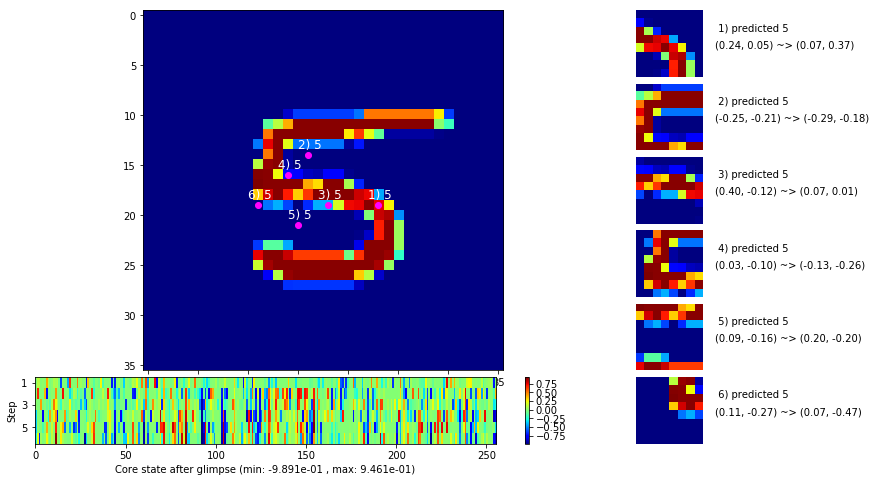

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


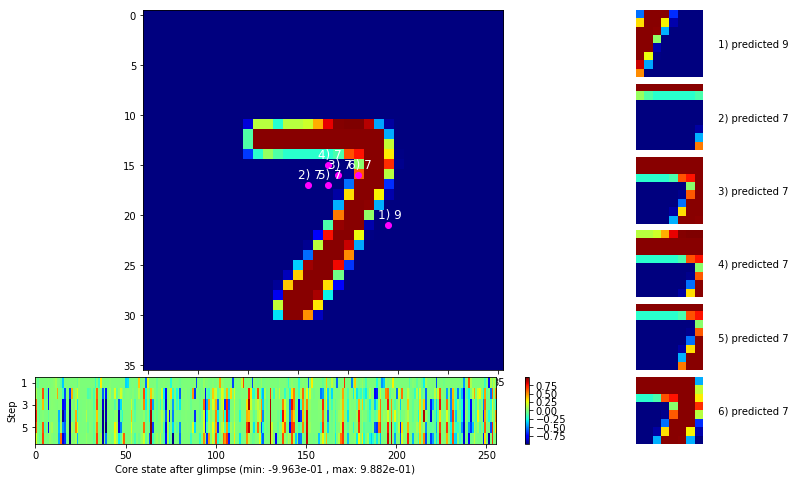


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


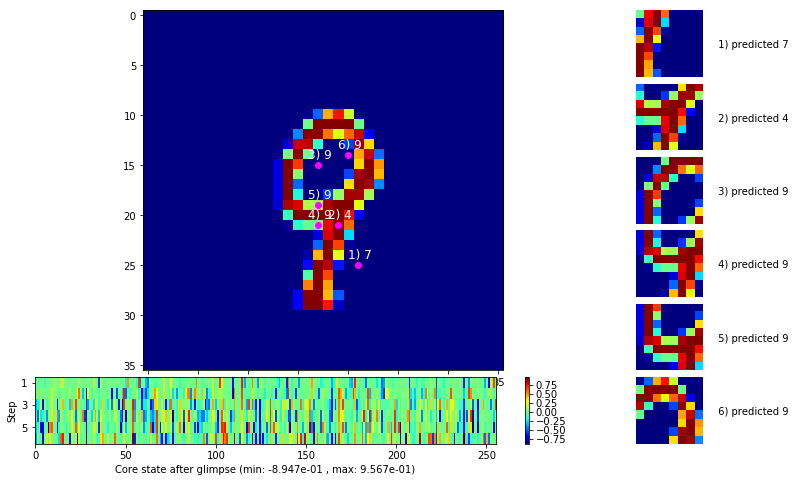

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


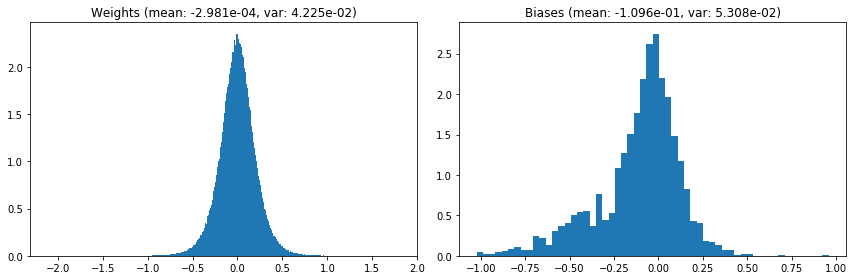

                                      Location network weights and biases


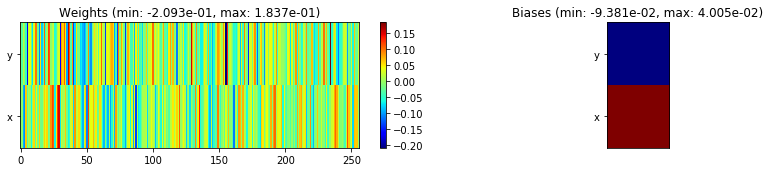

---------------------------------------------------------------------------------------------------------------
Elapsed time:  398.11 sec | TRAIN >> class loss: 0.1588 | steps:  2.115    | reward:  0.9503    | acc.: 95.032% 
                          | VAL   >> class loss: 0.1655 | steps:  2.028 :( | reward:  0.9486 :( | acc.: 94.860% :(


Epoch  48/400) lr = 0.0002368
 b    500/  3000 >> 128.2 ms/b | lr: 2.36e-04 | grad 2norm:  3.97 | grad inf norm:  1.134
       Weights || abs max:  2.10 (39360.41) | mean: -3.02e-04 ( 0.14) | var: 4.23e-02 (65261.20)
        Biases || abs max:  1.02 (  139.37) | mean: -1.10e-01 ( 0.18) | var: 5.31e-02 (  148.91)
                  class loss: 0.161 | steps: 2.111 | reward:  0.951 | acc.: 95.08%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.3 ms/b | lr: 2.36e-04 | grad 2norm:  4.01 | grad inf norm:  1.119
       Weights || abs max:  2.10 (32268.59) | mean: -2.89e-04 ( 0.13) | v

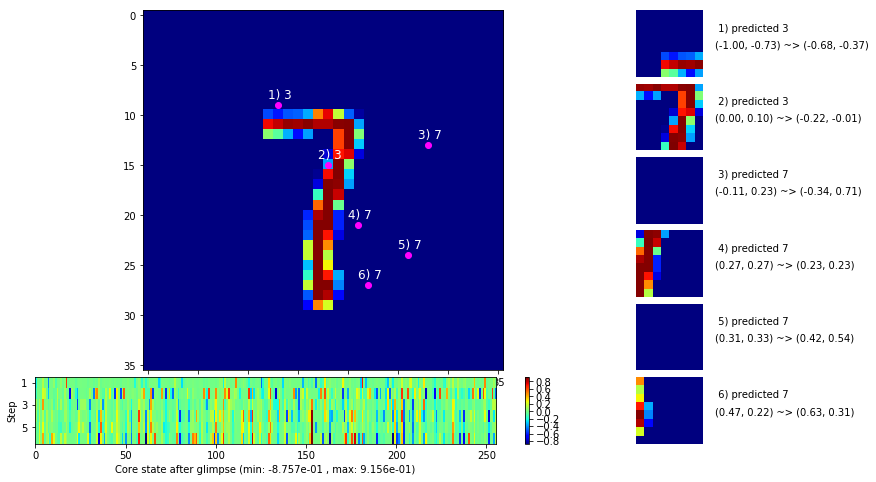

 b   1500/  3000 >> 132.6 ms/b | lr: 2.35e-04 | grad 2norm:  3.88 | grad inf norm:  1.046
       Weights || abs max:  2.11 (14958.94) | mean: -2.91e-04 ( 0.09) | var: 4.23e-02 ( 2694.12)
        Biases || abs max:  1.03 (  250.05) | mean: -1.10e-01 ( 0.23) | var: 5.32e-02 ( 1202.89)
                  class loss: 0.147 | steps: 2.109 | reward:  0.953 | acc.: 95.32%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.7 ms/b | lr: 2.34e-04 | grad 2norm:  4.09 | grad inf norm:  1.140
       Weights || abs max:  2.11 (19390.89) | mean: -2.85e-04 ( 0.10) | var: 4.23e-02 ( 6939.36)
        Biases || abs max:  1.03 (  140.79) | mean: -1.10e-01 ( 0.19) | var: 5.32e-02 (   98.50)
                  class loss: 0.154 | steps: 2.124 | reward:  0.949 | acc.: 94.94%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

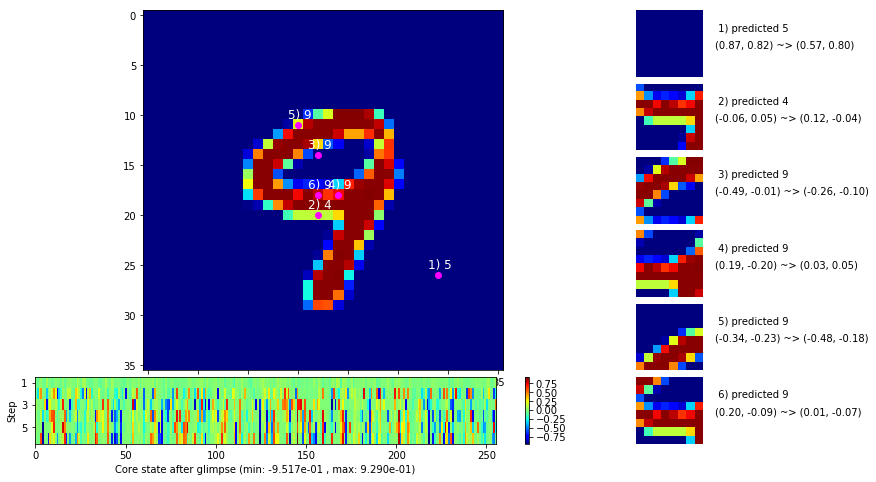

 b   2500/  3000 >> 131.0 ms/b | lr: 2.33e-04 | grad 2norm:  4.03 | grad inf norm:  1.140
       Weights || abs max:  2.11 (33380.25) | mean: -2.96e-04 ( 0.13) | var: 4.23e-02 (57243.99)
        Biases || abs max:  1.04 (  295.55) | mean: -1.10e-01 ( 0.33) | var: 5.32e-02 ( 1911.06)
                  class loss: 0.159 | steps: 2.122 | reward:  0.950 | acc.: 95.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 128.0 ms/b | lr: 2.33e-04 | grad 2norm:  4.08 | grad inf norm:  1.211
       Weights || abs max:  2.12 (51203.25) | mean: -2.97e-04 ( 0.16) | var: 4.24e-02 (149787.56)
        Biases || abs max:  1.04 (  550.21) | mean: -1.10e-01 ( 0.42) | var: 5.32e-02 ( 2662.60)
                  class loss: 0.162 | steps: 2.116 | reward:  0.948 | acc.: 94.77%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

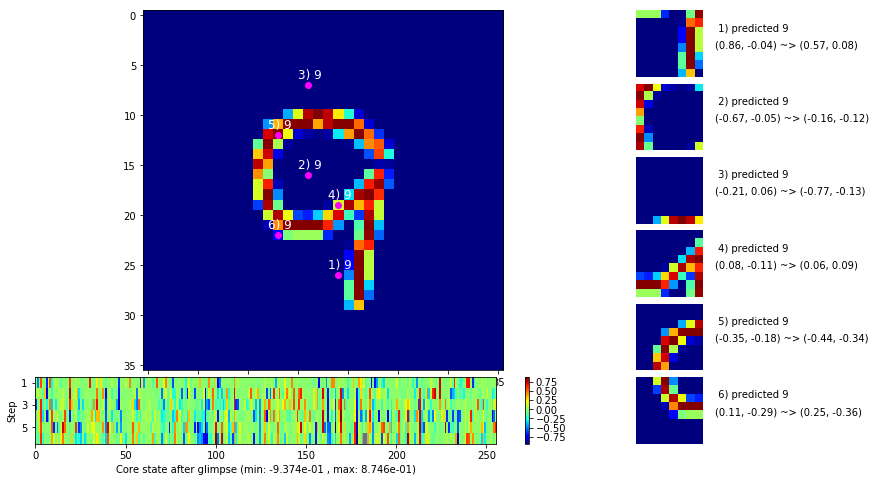

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


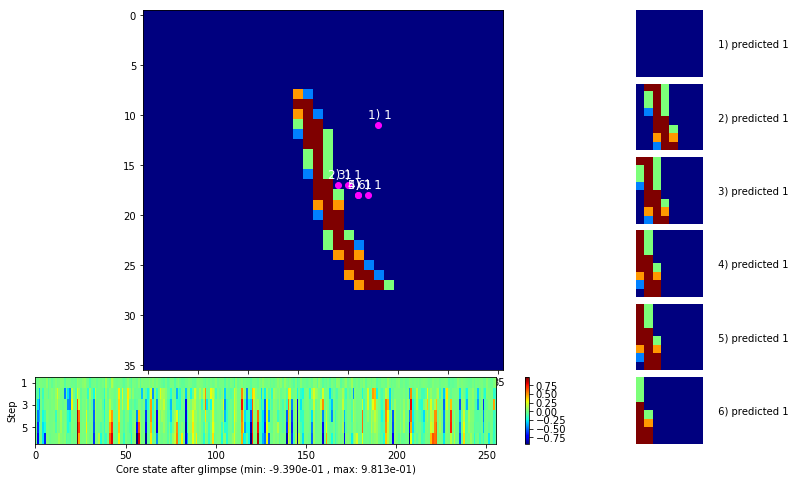


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


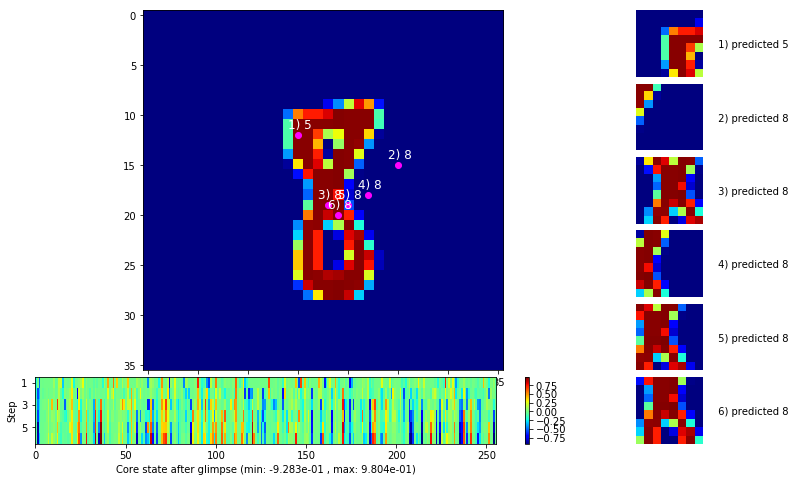

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


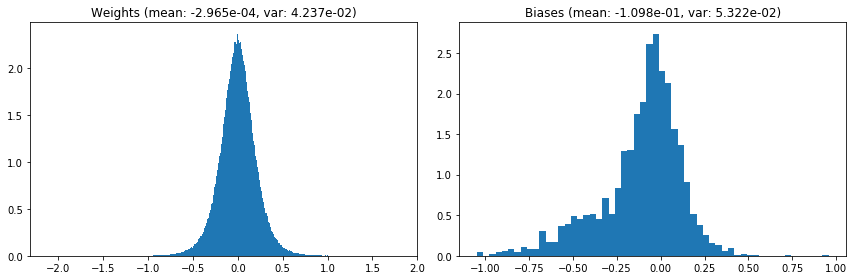

                                      Location network weights and biases


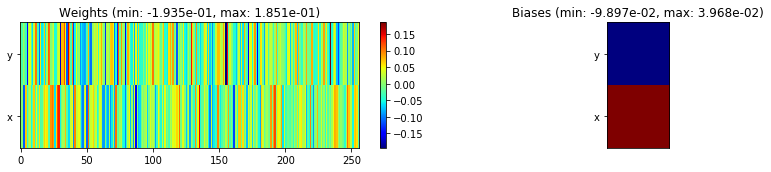

---------------------------------------------------------------------------------------------------------------
Elapsed time:  389.50 sec | TRAIN >> class loss: 0.1570 | steps:  2.118 :( | reward:  0.9504    | acc.: 95.035% 
                          | VAL   >> class loss: 0.1549 | steps:  2.004 :( | reward:  0.9496 :( | acc.: 94.960% :(


Epoch  49/400) lr = 0.0002326
 b    500/  3000 >> 131.4 ms/b | lr: 2.32e-04 | grad 2norm:  3.94 | grad inf norm:  1.116
       Weights || abs max:  2.12 (38112.71) | mean: -3.03e-04 ( 0.14) | var: 4.24e-02 (116317.35)
        Biases || abs max:  1.05 (  250.14) | mean: -1.10e-01 ( 0.27) | var: 5.33e-02 (  782.22)
                  class loss: 0.155 | steps: 2.120 | reward:  0.951 | acc.: 95.14%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 139.4 ms/b | lr: 2.32e-04 | grad 2norm:  3.94 | grad inf norm:  1.096
       Weights || abs max:  2.12 (67565.82) | mean: -3.11e-04 ( 0.20) | 

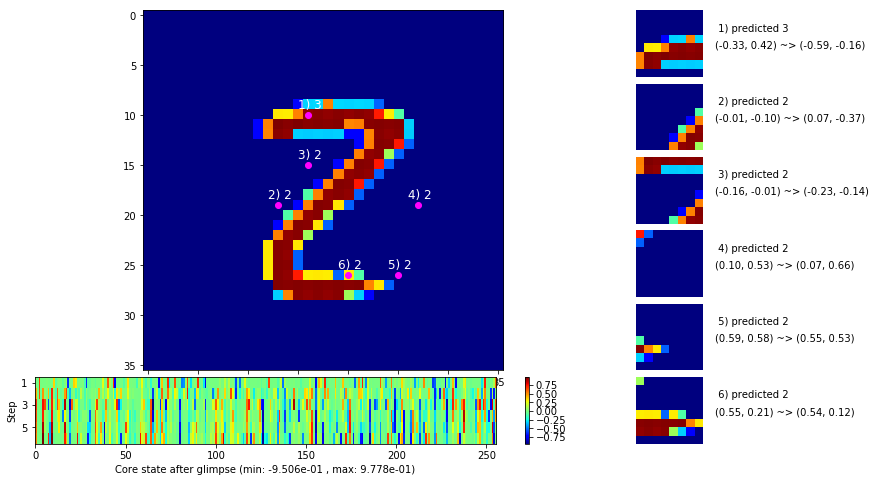

 b   1500/  3000 >> 141.3 ms/b | lr: 2.31e-04 | grad 2norm:  3.89 | grad inf norm:  1.111
       Weights || abs max:  2.12 (31735.61) | mean: -3.03e-04 ( 0.13) | var: 4.24e-02 (46687.53)
        Biases || abs max:  1.04 (  317.36) | mean: -1.10e-01 ( 0.32) | var: 5.33e-02 (  546.60)
                  class loss: 0.159 | steps: 2.119 | reward:  0.951 | acc.: 95.14%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.1 ms/b | lr: 2.30e-04 | grad 2norm:  3.78 | grad inf norm:  1.076
       Weights || abs max:  2.14 (50579.09) | mean: -3.08e-04 ( 0.16) | var: 4.24e-02 (239874.72)
        Biases || abs max:  1.04 ( 1823.87) | mean: -1.10e-01 ( 0.89) | var: 5.33e-02 (484500.75)
                  class loss: 0.146 | steps: 2.091 | reward:  0.955 | acc.: 95.47%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

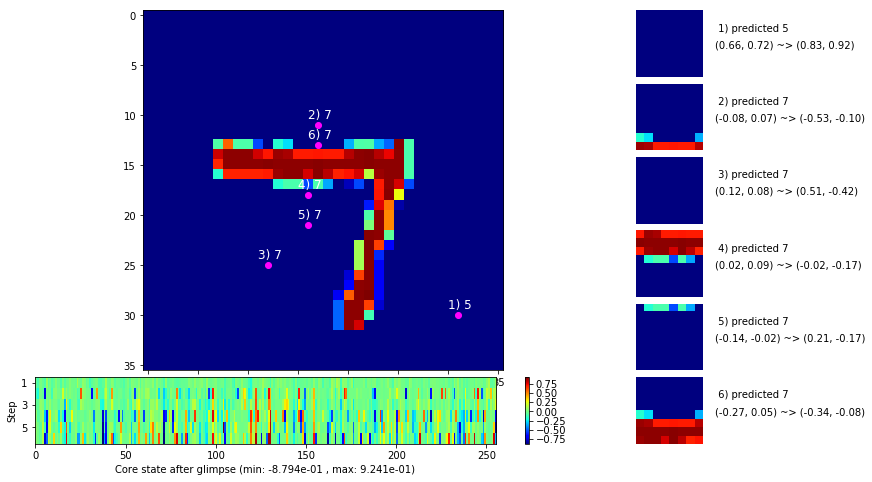

 b   2500/  3000 >> 129.5 ms/b | lr: 2.29e-04 | grad 2norm:  4.02 | grad inf norm:  1.143
       Weights || abs max:  2.15 (45950.61) | mean: -2.97e-04 ( 0.15) | var: 4.25e-02 (241160.17)
        Biases || abs max:  1.04 (  377.42) | mean: -1.10e-01 ( 0.29) | var: 5.34e-02 ( 2436.81)
                  class loss: 0.155 | steps: 2.122 | reward:  0.949 | acc.: 94.93%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 129.2 ms/b | lr: 2.29e-04 | grad 2norm:  3.96 | grad inf norm:  1.116
       Weights || abs max:  2.14 (31285.14) | mean: -2.99e-04 ( 0.12) | var: 4.25e-02 (18300.64)
        Biases || abs max:  1.04 (  364.51) | mean: -1.10e-01 ( 0.28) | var: 5.34e-02 (  767.11)
                  class loss: 0.147 | steps: 2.106 | reward:  0.951 | acc.: 95.14%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0

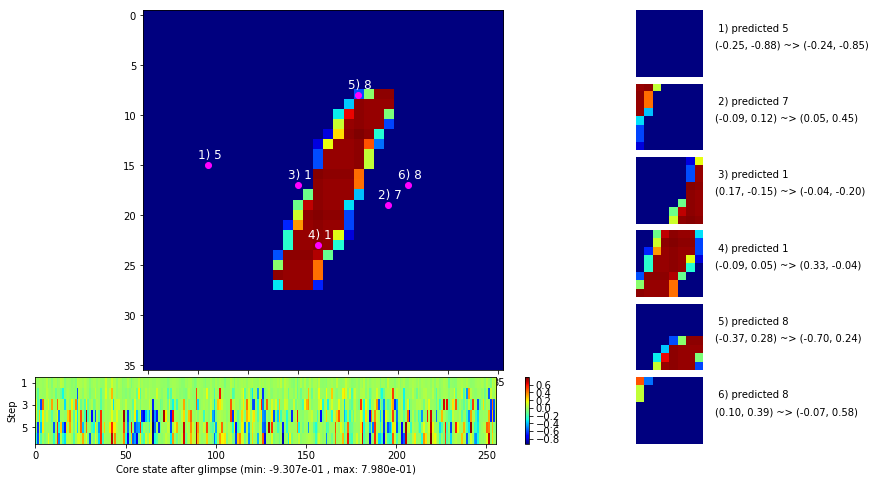

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


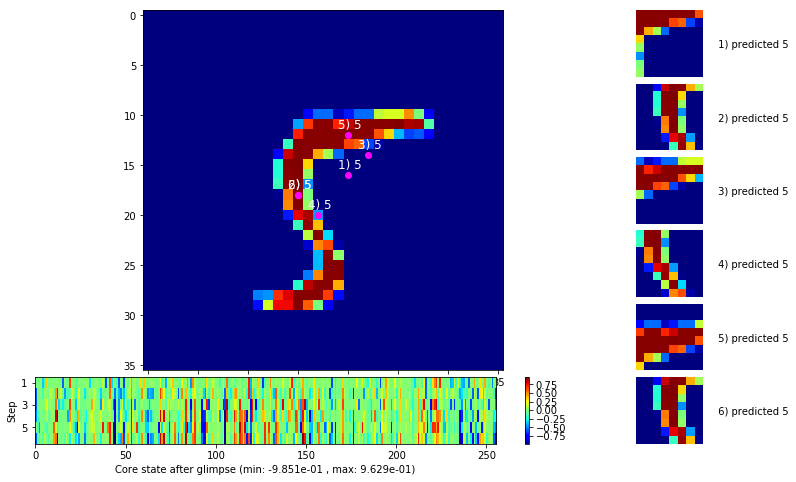


	Target class: 2  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


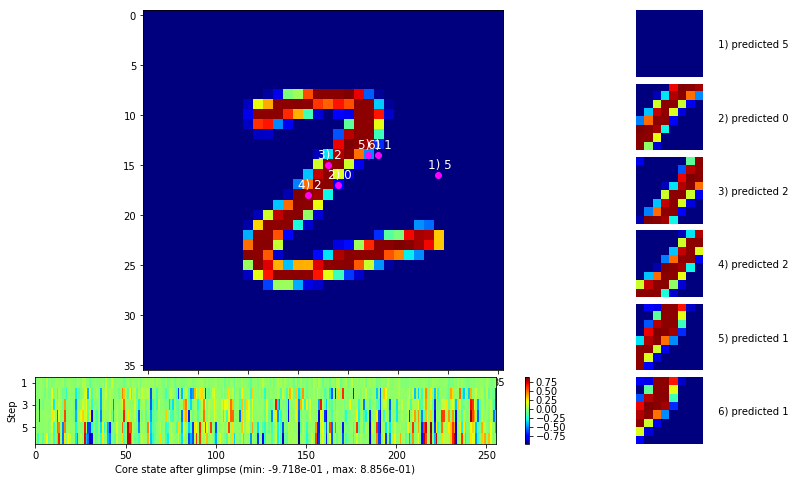

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


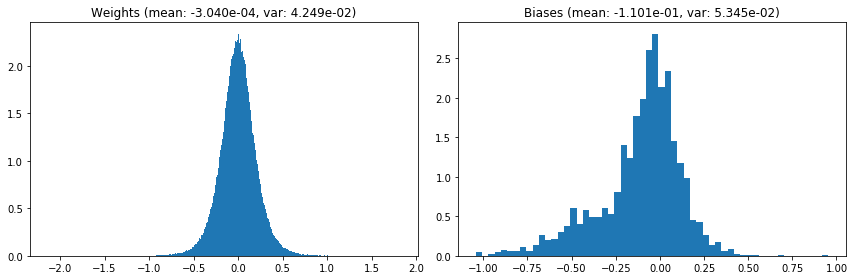

                                      Location network weights and biases


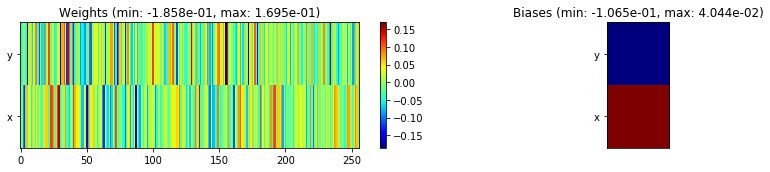

---------------------------------------------------------------------------------------------------------------
Elapsed time:  401.19 sec | TRAIN >> class loss: 0.1527 | steps:  2.113    | reward:  0.9517    | acc.: 95.170% 
                          | VAL   >> class loss: 0.1537 | steps:  2.006 :( | reward:  0.9526 :( | acc.: 95.260% :(


Epoch  50/400) lr = 0.0002286
 b    500/  3000 >> 128.8 ms/b | lr: 2.28e-04 | grad 2norm:  4.16 | grad inf norm:  1.149
       Weights || abs max:  2.14 (27814.28) | mean: -3.01e-04 ( 0.12) | var: 4.25e-02 (21541.69)
        Biases || abs max:  1.05 (  578.65) | mean: -1.10e-01 ( 0.53) | var: 5.35e-02 (57252.57)
                  class loss: 0.159 | steps: 2.138 | reward:  0.948 | acc.: 94.79%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.3 ms/b | lr: 2.28e-04 | grad 2norm:  3.93 | grad inf norm:  1.095
       Weights || abs max:  2.14 (45447.59) | mean: -2.95e-04 ( 0.15) | v

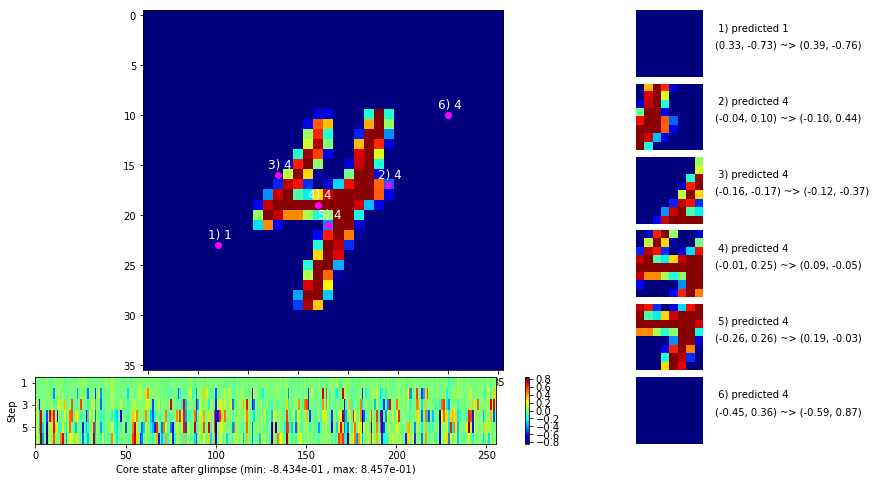

 b   1500/  3000 >> 129.7 ms/b | lr: 2.27e-04 | grad 2norm:  3.84 | grad inf norm:  1.096
       Weights || abs max:  2.14 (47839.54) | mean: -2.99e-04 ( 0.14) | var: 4.25e-02 (431397.12)
        Biases || abs max:  1.05 (  264.06) | mean: -1.11e-01 ( 0.27) | var: 5.37e-02 (  765.93)
                  class loss: 0.154 | steps: 2.106 | reward:  0.952 | acc.: 95.21%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 136.6 ms/b | lr: 2.26e-04 | grad 2norm:  3.82 | grad inf norm:  1.087
       Weights || abs max:  2.14 (71370.68) | mean: -2.92e-04 ( 0.20) | var: 4.26e-02 (1466223.00)
        Biases || abs max:  1.04 (  410.66) | mean: -1.11e-01 ( 0.33) | var: 5.36e-02 ( 1351.54)
                  class loss: 0.148 | steps: 2.108 | reward:  0.953 | acc.: 95.32%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

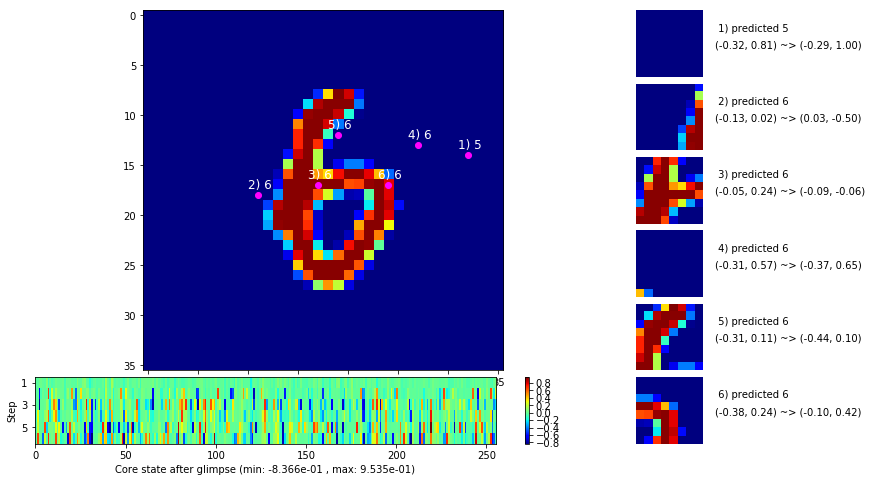

 b   2500/  3000 >> 136.8 ms/b | lr: 2.25e-04 | grad 2norm:  4.08 | grad inf norm:  1.151
       Weights || abs max:  2.14 (38140.70) | mean: -2.74e-04 ( 0.14) | var: 4.26e-02 (48276.30)
        Biases || abs max:  1.04 (  330.78) | mean: -1.11e-01 ( 0.33) | var: 5.36e-02 ( 3838.31)
                  class loss: 0.158 | steps: 2.103 | reward:  0.949 | acc.: 94.86%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.0 ms/b | lr: 2.25e-04 | grad 2norm:  4.02 | grad inf norm:  1.106
       Weights || abs max:  2.14 (29527.64) | mean: -2.70e-04 ( 0.12) | var: 4.26e-02 (21147.00)
        Biases || abs max:  1.04 (  149.88) | mean: -1.11e-01 ( 0.21) | var: 5.37e-02 (  184.73)
                  class loss: 0.155 | steps: 2.111 | reward:  0.951 | acc.: 95.10%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

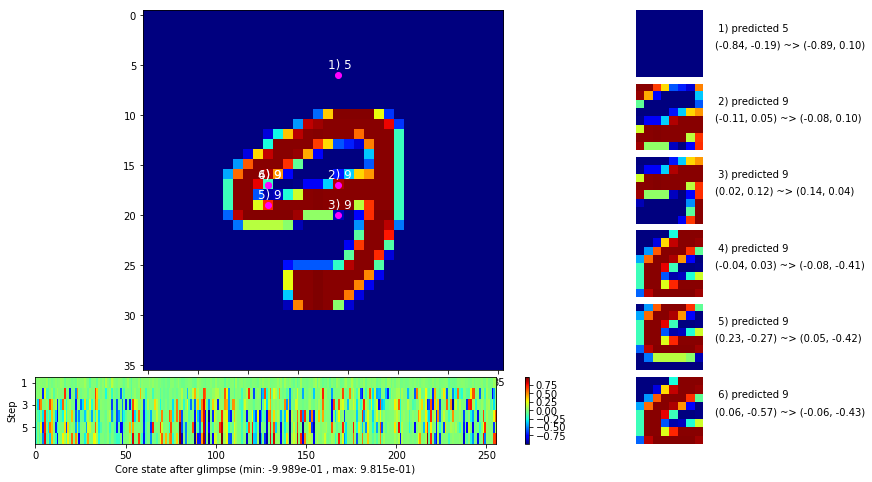

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


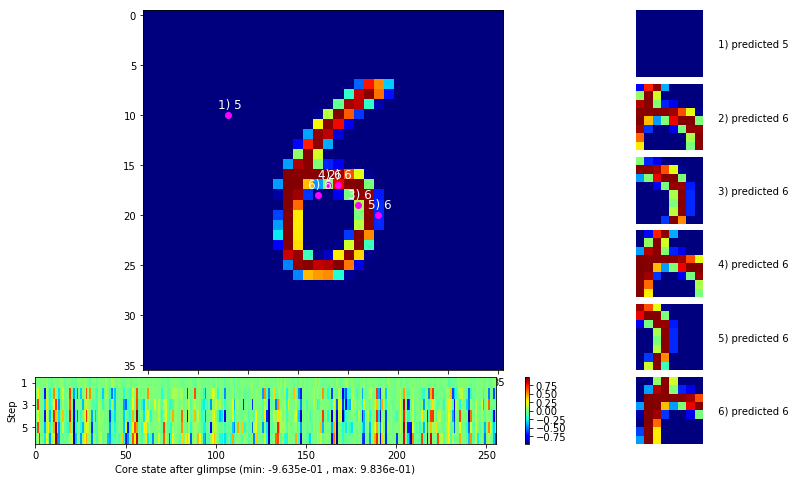


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


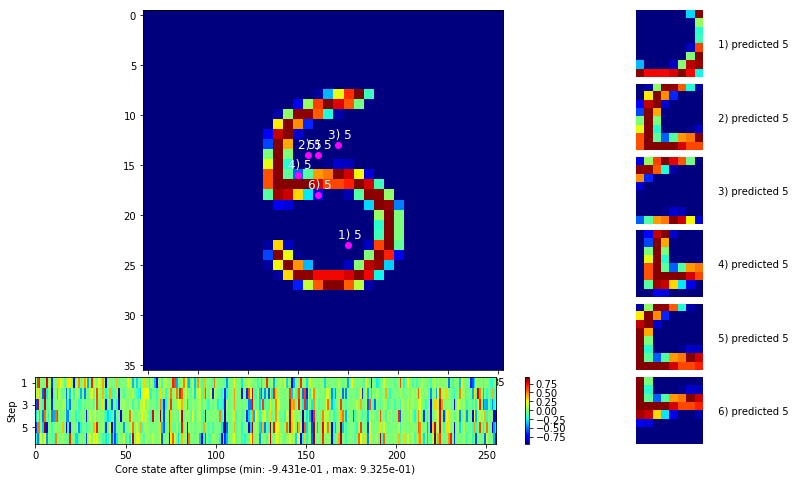

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


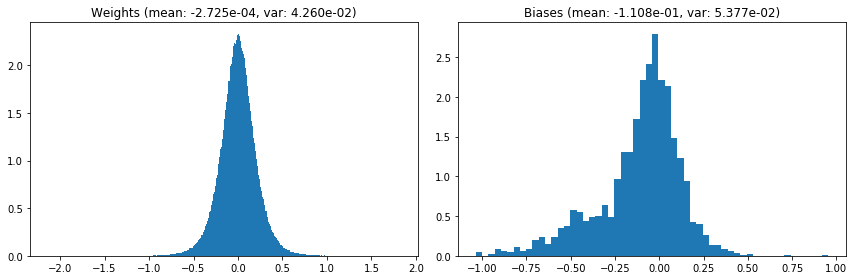

                                      Location network weights and biases


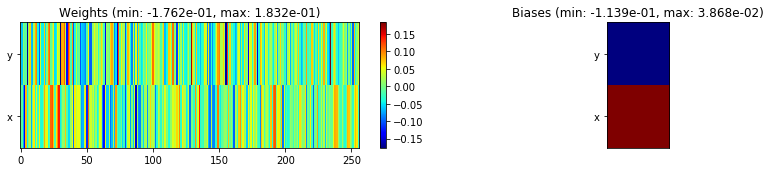

---------------------------------------------------------------------------------------------------------------
Elapsed time:  402.18 sec | TRAIN >> class loss: 0.1560 | steps:  2.115 :( | reward:  0.9507 :( | acc.: 95.073% :(
                          | VAL   >> class loss: 0.1491 | steps:  1.957    | reward:  0.9558 :( | acc.: 95.580% :(


Epoch  51/400) lr = 0.0002247
 b    500/  3000 >> 130.4 ms/b | lr: 2.24e-04 | grad 2norm:  3.89 | grad inf norm:  1.118
       Weights || abs max:  2.14 (25452.57) | mean: -2.68e-04 ( 0.11) | var: 4.26e-02 (13858.91)
        Biases || abs max:  1.04 (  307.40) | mean: -1.11e-01 ( 0.28) | var: 5.38e-02 (  736.13)
                  class loss: 0.155 | steps: 2.118 | reward:  0.952 | acc.: 95.20%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.9 ms/b | lr: 2.24e-04 | grad 2norm:  3.68 | grad inf norm:  1.068
       Weights || abs max:  2.14 (23109.75) | mean: -2.61e-04 ( 0.10) |

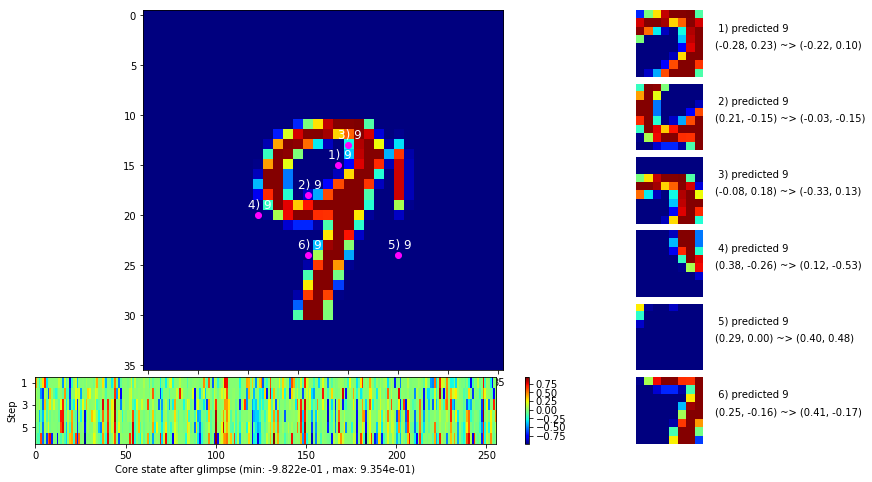

 b   1500/  3000 >> 129.2 ms/b | lr: 2.23e-04 | grad 2norm:  3.94 | grad inf norm:  1.101
       Weights || abs max:  2.14 (106908.19) | mean: -2.68e-04 ( 0.26) | var: 4.27e-02 (3697703.50)
        Biases || abs max:  1.05 (  501.82) | mean: -1.11e-01 ( 0.44) | var: 5.38e-02 (17094.37)
                  class loss: 0.152 | steps: 2.109 | reward:  0.951 | acc.: 95.09%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 127.7 ms/b | lr: 2.22e-04 | grad 2norm:  4.00 | grad inf norm:  1.149
       Weights || abs max:  2.14 (105971.77) | mean: -2.68e-04 ( 0.26) | var: 4.27e-02 (1652210.00)
        Biases || abs max:  1.05 (  213.71) | mean: -1.11e-01 ( 0.23) | var: 5.38e-02 ( 1422.90)
                  class loss: 0.159 | steps: 2.116 | reward:  0.949 | acc.: 94.87%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0

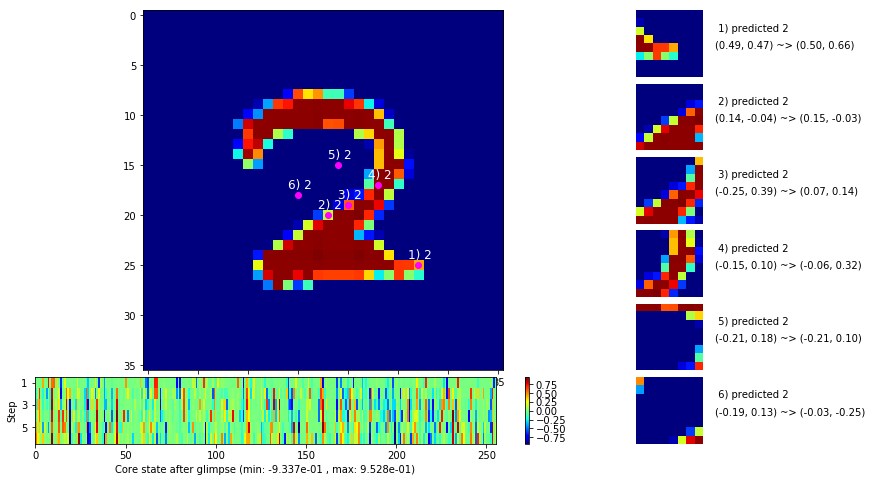

 b   2500/  3000 >> 130.0 ms/b | lr: 2.22e-04 | grad 2norm:  3.95 | grad inf norm:  1.115
       Weights || abs max:  2.14 (40951.11) | mean: -2.53e-04 ( 0.14) | var: 4.27e-02 (116670.63)
        Biases || abs max:  1.05 (  162.76) | mean: -1.11e-01 ( 0.22) | var: 5.37e-02 (  339.91)
                  class loss: 0.153 | steps: 2.118 | reward:  0.951 | acc.: 95.09%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 128.6 ms/b | lr: 2.21e-04 | grad 2norm:  3.90 | grad inf norm:  1.099
       Weights || abs max:  2.14 (35341.09) | mean: -2.44e-04 ( 0.13) | var: 4.27e-02 (76137.64)
        Biases || abs max:  1.05 (  209.24) | mean: -1.11e-01 ( 0.23) | var: 5.38e-02 (  415.81)
                  class loss: 0.154 | steps: 2.103 | reward:  0.952 | acc.: 95.23%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

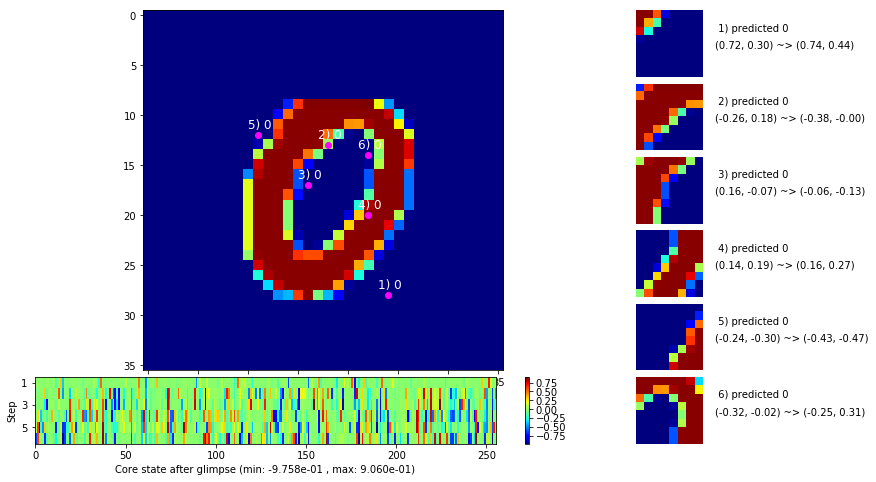

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


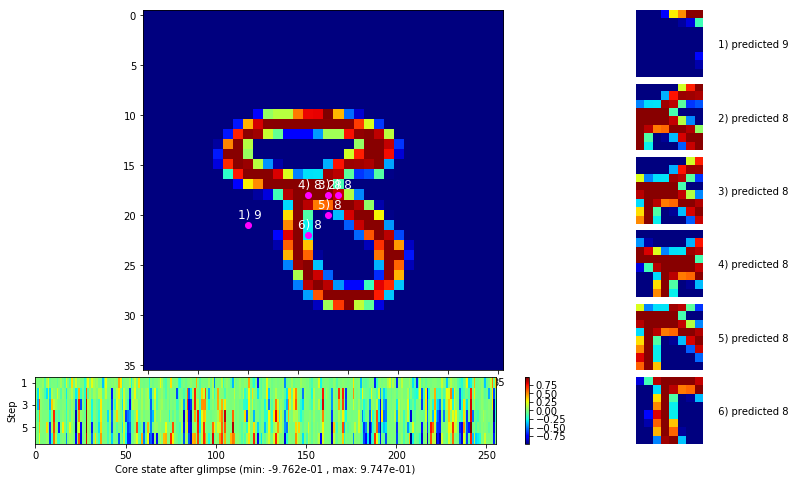


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


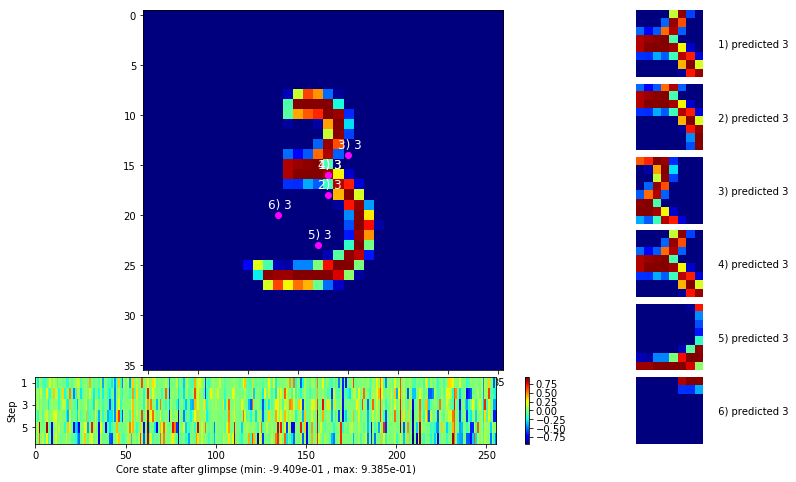

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


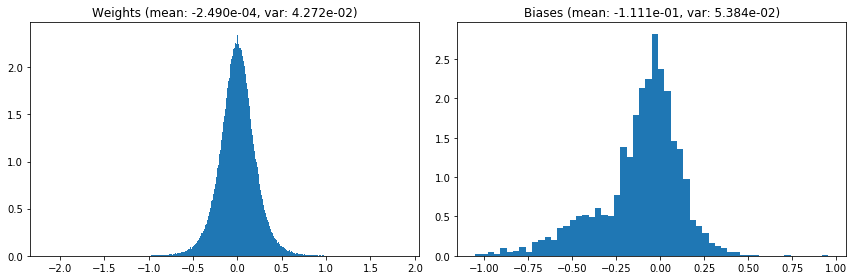

                                      Location network weights and biases


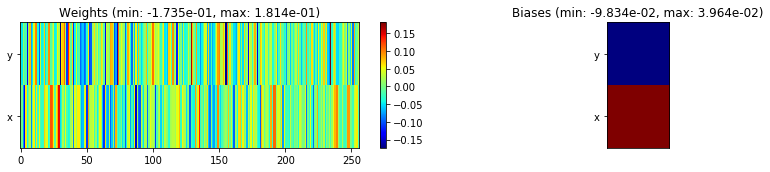

---------------------------------------------------------------------------------------------------------------
Elapsed time:  387.65 sec | TRAIN >> class loss: 0.1531 | steps:  2.112    | reward:  0.9519    | acc.: 95.193% 
                          | VAL   >> class loss: 0.1491 | steps:  1.965 :( | reward:  0.9520 :( | acc.: 95.200% :(


Epoch  52/400) lr = 0.0002209
 b    500/  3000 >> 131.5 ms/b | lr: 2.20e-04 | grad 2norm:  3.76 | grad inf norm:  1.075
       Weights || abs max:  2.13 (55941.29) | mean: -2.46e-04 ( 0.16) | var: 4.27e-02 (577105.25)
        Biases || abs max:  1.05 (  135.91) | mean: -1.11e-01 ( 0.21) | var: 5.39e-02 (  158.33)
                  class loss: 0.142 | steps: 2.111 | reward:  0.955 | acc.: 95.47%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 137.1 ms/b | lr: 2.20e-04 | grad 2norm:  3.81 | grad inf norm:  1.064
       Weights || abs max:  2.13 (38492.46) | mean: -2.57e-04 ( 0.14) | 

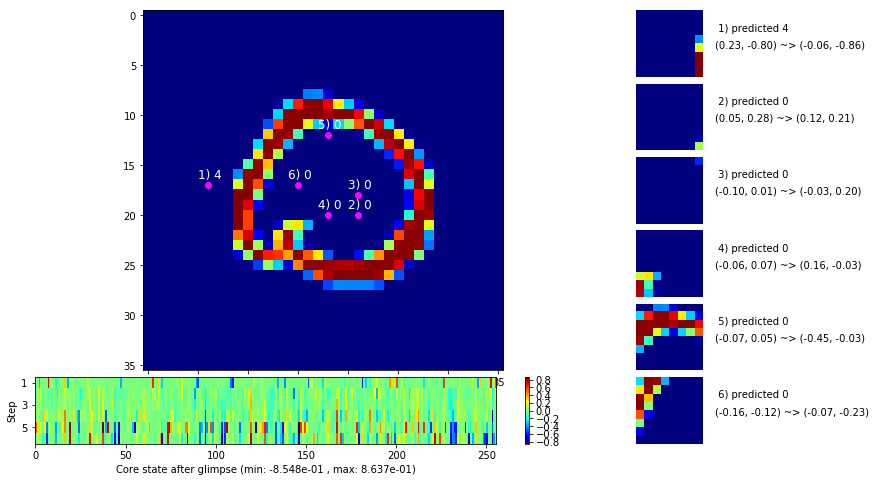

 b   1500/  3000 >> 137.6 ms/b | lr: 2.19e-04 | grad 2norm:  3.93 | grad inf norm:  1.089
       Weights || abs max:  2.13 (35684.77) | mean: -2.57e-04 ( 0.13) | var: 4.28e-02 (44344.95)
        Biases || abs max:  1.04 (  217.13) | mean: -1.11e-01 ( 0.24) | var: 5.39e-02 (  791.84)
                  class loss: 0.148 | steps: 2.113 | reward:  0.952 | acc.: 95.23%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 131.4 ms/b | lr: 2.19e-04 | grad 2norm:  3.95 | grad inf norm:  1.110
       Weights || abs max:  2.14 (22664.18) | mean: -2.53e-04 ( 0.11) | var: 4.28e-02 ( 6606.10)
        Biases || abs max:  1.04 (  251.95) | mean: -1.11e-01 ( 0.26) | var: 5.39e-02 (  364.60)
                  class loss: 0.155 | steps: 2.094 | reward:  0.951 | acc.: 95.11%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

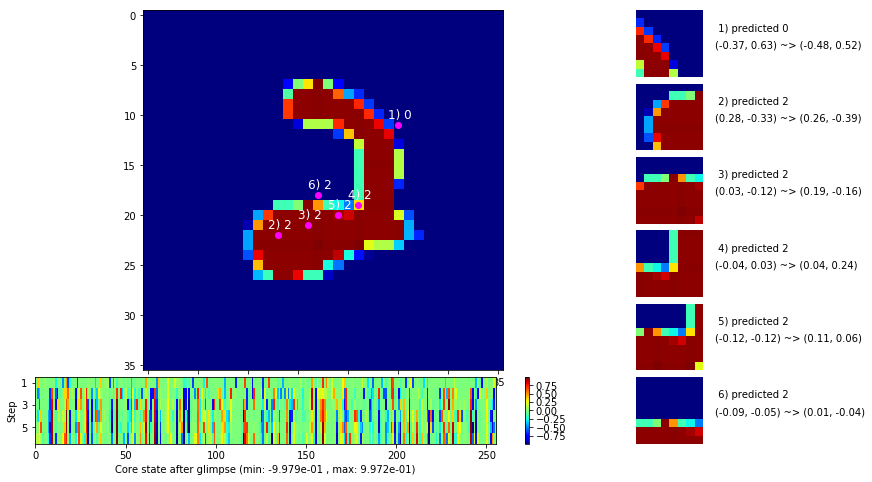

 b   2500/  3000 >> 129.1 ms/b | lr: 2.18e-04 | grad 2norm:  3.92 | grad inf norm:  1.101
       Weights || abs max:  2.14 (31476.69) | mean: -2.60e-04 ( 0.13) | var: 4.28e-02 (34574.80)
        Biases || abs max:  1.04 (   87.57) | mean: -1.11e-01 ( 0.16) | var: 5.39e-02 (   40.61)
                  class loss: 0.154 | steps: 2.096 | reward:  0.952 | acc.: 95.15%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 129.4 ms/b | lr: 2.18e-04 | grad 2norm:  3.94 | grad inf norm:  1.111
       Weights || abs max:  2.14 (95108.05) | mean: -2.65e-04 ( 0.24) | var: 4.28e-02 (4216024.50)
        Biases || abs max:  1.05 (  134.37) | mean: -1.11e-01 ( 0.20) | var: 5.40e-02 (  239.90)
                  class loss: 0.153 | steps: 2.107 | reward:  0.951 | acc.: 95.07%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

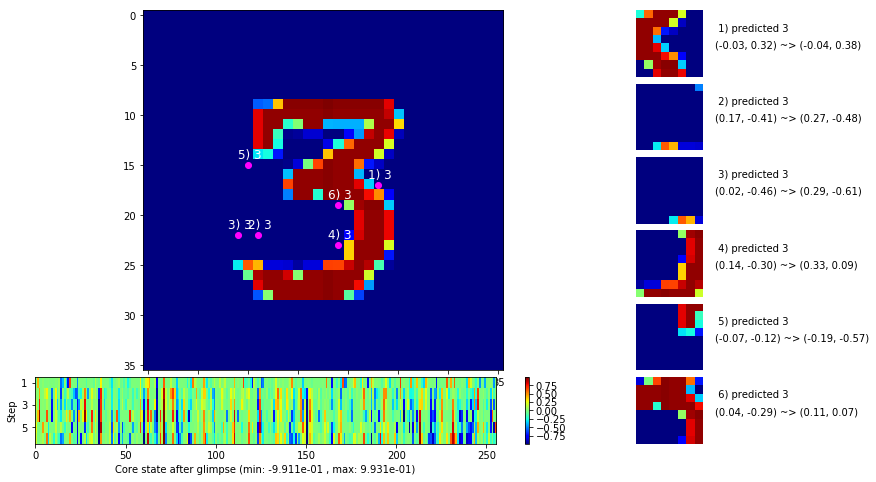

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


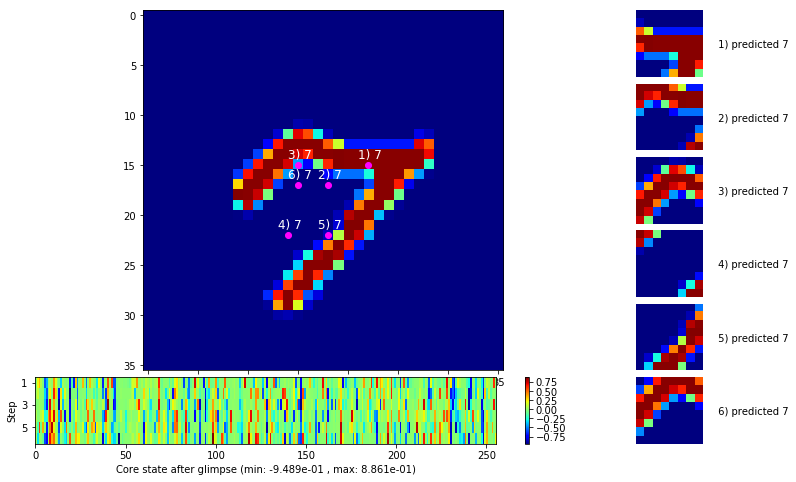


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


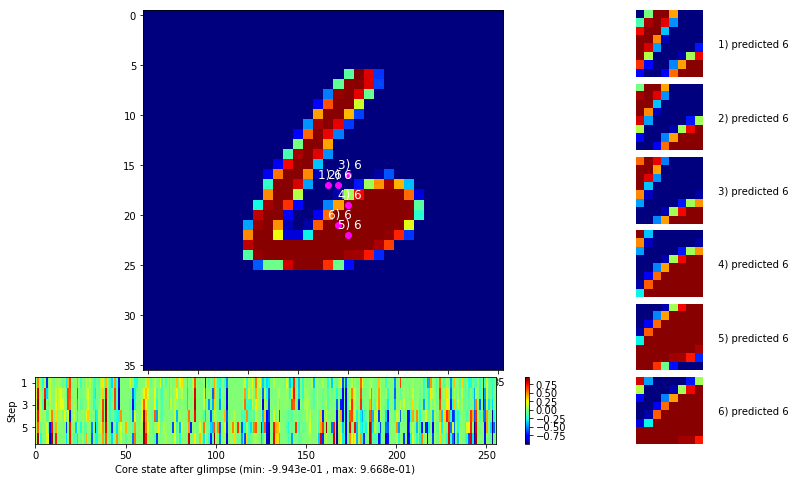

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


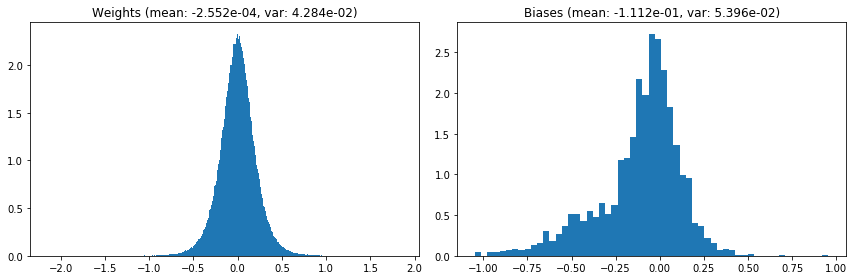

                                      Location network weights and biases


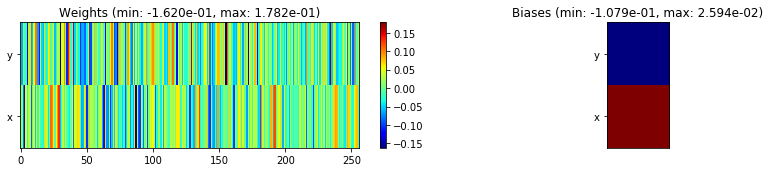

---------------------------------------------------------------------------------------------------------------
Elapsed time:  398.63 sec | TRAIN >> class loss: 0.1494 | steps:  2.103    | reward:  0.9523    | acc.: 95.232% 
                          | VAL   >> class loss: 0.1597 | steps:  1.979 :( | reward:  0.9494 :( | acc.: 94.940% :(


Epoch  53/400) lr = 0.0002173
 b    500/  3000 >> 129.9 ms/b | lr: 2.17e-04 | grad 2norm:  4.22 | grad inf norm:  1.146
       Weights || abs max:  2.15 (65820.16) | mean: -2.52e-04 ( 0.19) | var: 4.28e-02 (772503.94)
        Biases || abs max:  1.05 (  594.78) | mean: -1.11e-01 ( 0.39) | var: 5.40e-02 (16674.52)
                  class loss: 0.162 | steps: 2.093 | reward:  0.947 | acc.: 94.72%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.1 ms/b | lr: 2.16e-04 | grad 2norm:  4.02 | grad inf norm:  1.158
       Weights || abs max:  2.15 (25073.58) | mean: -2.50e-04 ( 0.11) | 

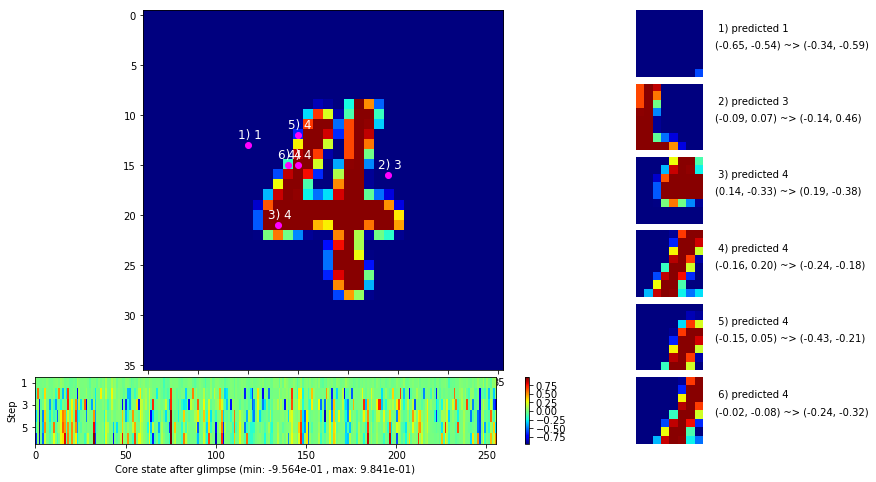

 b   1500/  3000 >> 130.6 ms/b | lr: 2.16e-04 | grad 2norm:  4.05 | grad inf norm:  1.123
       Weights || abs max:  2.16 (28302.91) | mean: -2.51e-04 ( 0.12) | var: 4.29e-02 (27957.74)
        Biases || abs max:  1.05 (  125.55) | mean: -1.11e-01 ( 0.20) | var: 5.41e-02 (  233.03)
                  class loss: 0.153 | steps: 2.105 | reward:  0.950 | acc.: 94.96%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.6 ms/b | lr: 2.15e-04 | grad 2norm:  3.85 | grad inf norm:  1.068
       Weights || abs max:  2.15 (53369.76) | mean: -2.43e-04 ( 0.16) | var: 4.29e-02 (277196.53)
        Biases || abs max:  1.05 (  346.95) | mean: -1.11e-01 ( 0.27) | var: 5.41e-02 ( 2647.30)
                  class loss: 0.141 | steps: 2.096 | reward:  0.954 | acc.: 95.42%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

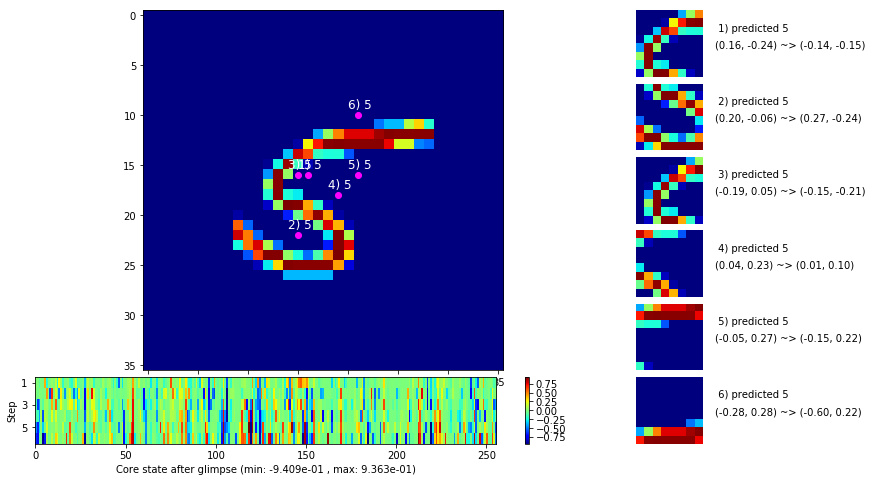

 b   2500/  3000 >> 138.8 ms/b | lr: 2.15e-04 | grad 2norm:  3.81 | grad inf norm:  1.079
       Weights || abs max:  2.14 (33956.90) | mean: -2.44e-04 ( 0.12) | var: 4.29e-02 (88491.13)
        Biases || abs max:  1.05 (  277.96) | mean: -1.11e-01 ( 0.29) | var: 5.41e-02 ( 2500.25)
                  class loss: 0.151 | steps: 2.116 | reward:  0.954 | acc.: 95.36%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.9 ms/b | lr: 2.14e-04 | grad 2norm:  3.93 | grad inf norm:  1.119
       Weights || abs max:  2.14 (44567.91) | mean: -2.63e-04 ( 0.14) | var: 4.29e-02 (580235.44)
        Biases || abs max:  1.06 (  158.18) | mean: -1.11e-01 ( 0.21) | var: 5.42e-02 (  192.87)
                  class loss: 0.149 | steps: 2.120 | reward:  0.951 | acc.: 95.09%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

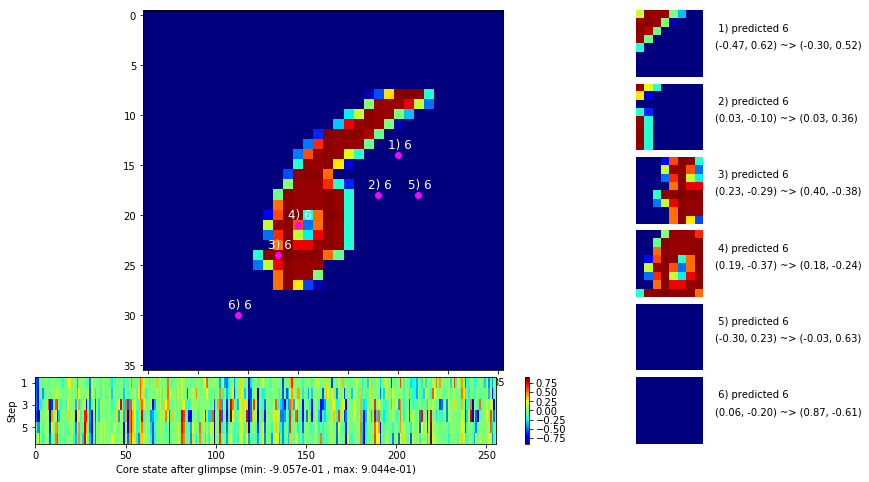

                                          ---===  VALIDATION  ===---

	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


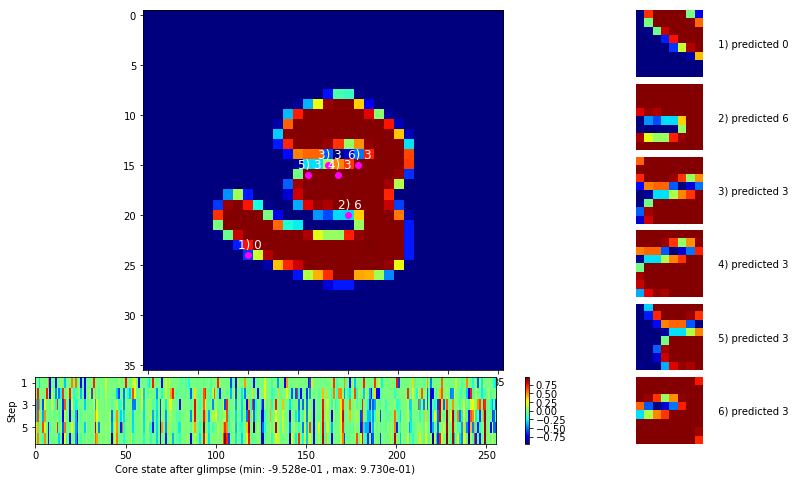


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


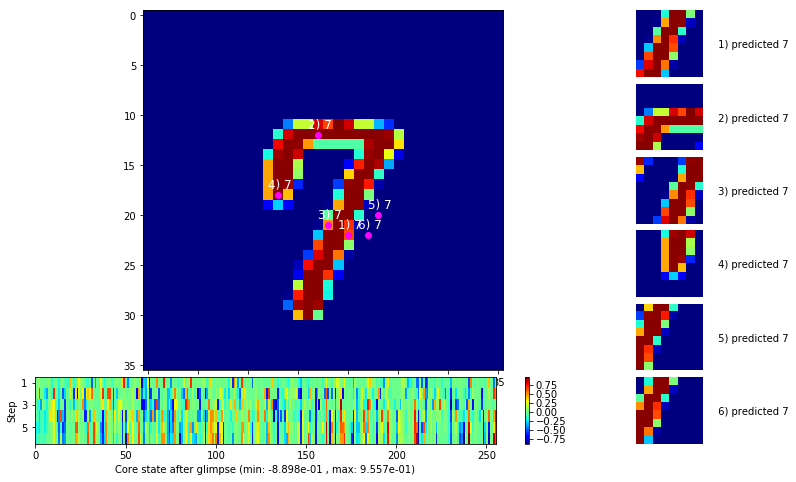

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


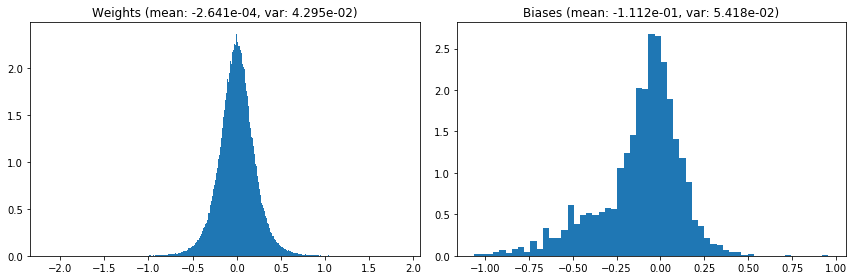

                                      Location network weights and biases


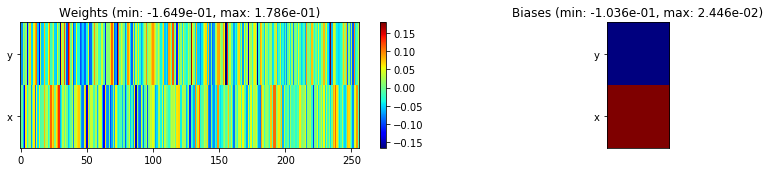

---------------------------------------------------------------------------------------------------------------
Elapsed time:  400.11 sec | TRAIN >> class loss: 0.1527 | steps:  2.107 :( | reward:  0.9508 :( | acc.: 95.078% :(
                          | VAL   >> class loss: 0.1448 | steps:  1.949    | reward:  0.9502 :( | acc.: 95.020% :(


Epoch  54/400) lr = 0.0002138
 b    500/  3000 >> 133.3 ms/b | lr: 2.13e-04 | grad 2norm:  3.71 | grad inf norm:  1.074
       Weights || abs max:  2.13 (27657.47) | mean: -2.73e-04 ( 0.12) | var: 4.30e-02 (28696.95)
        Biases || abs max:  1.06 (  125.65) | mean: -1.11e-01 ( 0.19) | var: 5.42e-02 (   71.46)
                  class loss: 0.149 | steps: 2.123 | reward:  0.955 | acc.: 95.54%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.9 ms/b | lr: 2.13e-04 | grad 2norm:  3.88 | grad inf norm:  1.111
       Weights || abs max:  2.13 (89454.11) | mean: -2.75e-04 ( 0.23) |

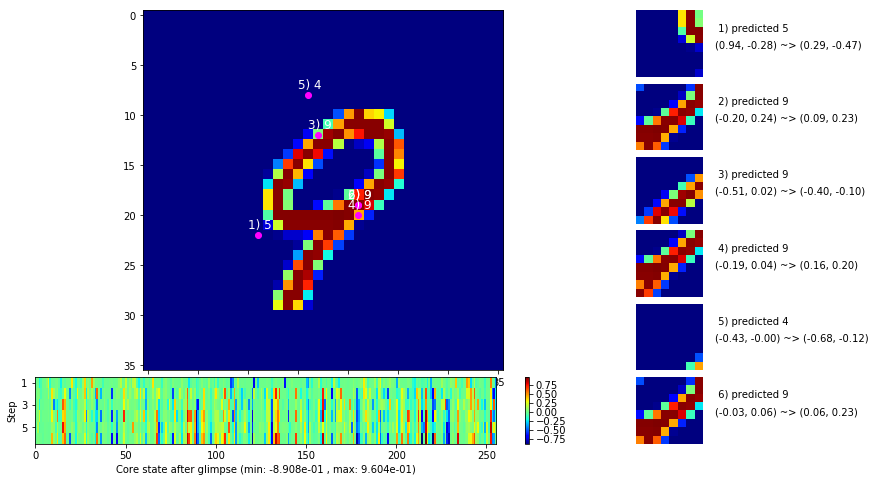

 b   1500/  3000 >> 129.8 ms/b | lr: 2.12e-04 | grad 2norm:  3.84 | grad inf norm:  1.074
       Weights || abs max:  2.14 (45681.35) | mean: -2.59e-04 ( 0.15) | var: 4.30e-02 (208744.30)
        Biases || abs max:  1.05 (  251.58) | mean: -1.12e-01 ( 0.25) | var: 5.43e-02 ( 1464.30)
                  class loss: 0.141 | steps: 2.119 | reward:  0.953 | acc.: 95.28%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.1 ms/b | lr: 2.12e-04 | grad 2norm:  3.72 | grad inf norm:  1.060
       Weights || abs max:  2.13 (36704.78) | mean: -2.59e-04 ( 0.13) | var: 4.30e-02 (79659.37)
        Biases || abs max:  1.05 ( 1149.94) | mean: -1.12e-01 ( 0.60) | var: 5.44e-02 (53030.14)
                  class loss: 0.140 | steps: 2.098 | reward:  0.956 | acc.: 95.56%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

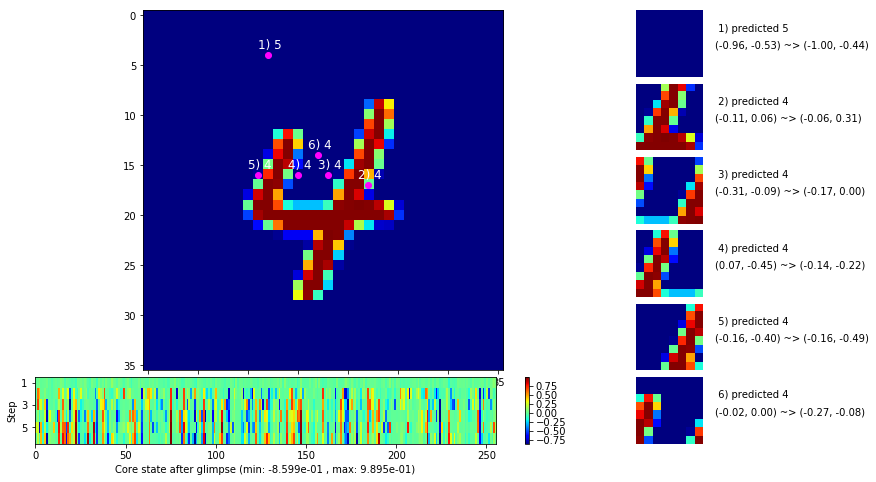

 b   2500/  3000 >> 129.0 ms/b | lr: 2.11e-04 | grad 2norm:  3.71 | grad inf norm:  1.074
       Weights || abs max:  2.14 (82763.84) | mean: -2.56e-04 ( 0.22) | var: 4.30e-02 (1270778.00)
        Biases || abs max:  1.05 (  374.88) | mean: -1.12e-01 ( 0.33) | var: 5.44e-02 (  781.84)
                  class loss: 0.145 | steps: 2.132 | reward:  0.955 | acc.: 95.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.2 ms/b | lr: 2.11e-04 | grad 2norm:  3.78 | grad inf norm:  1.099
       Weights || abs max:  2.14 (35279.45) | mean: -2.62e-04 ( 0.13) | var: 4.30e-02 (41847.86)
        Biases || abs max:  1.04 (  291.36) | mean: -1.12e-01 ( 0.29) | var: 5.44e-02 (  872.39)
                  class loss: 0.149 | steps: 2.112 | reward:  0.953 | acc.: 95.33%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

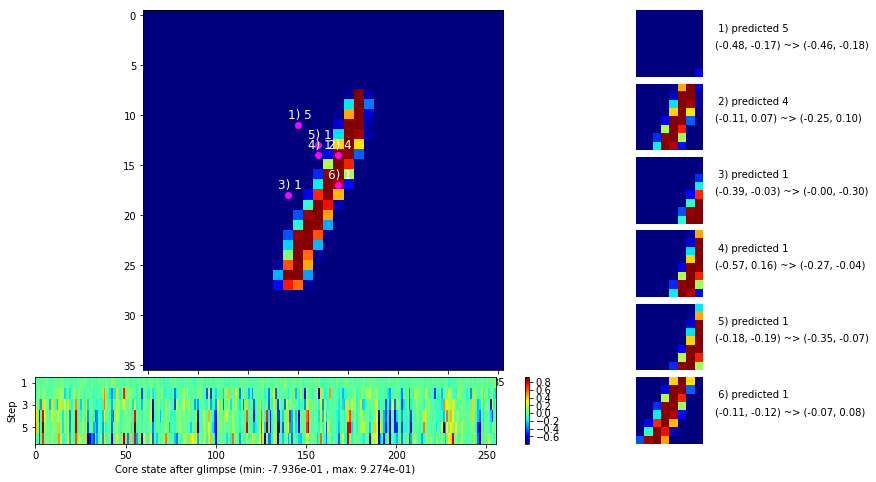

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


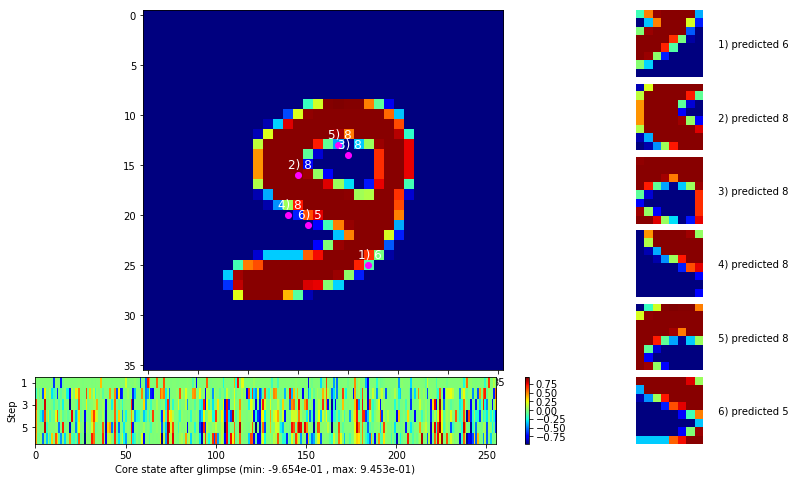


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


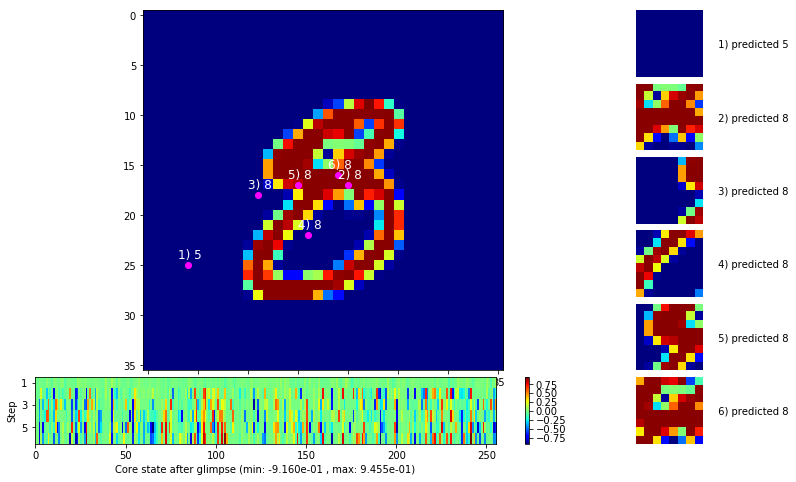

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


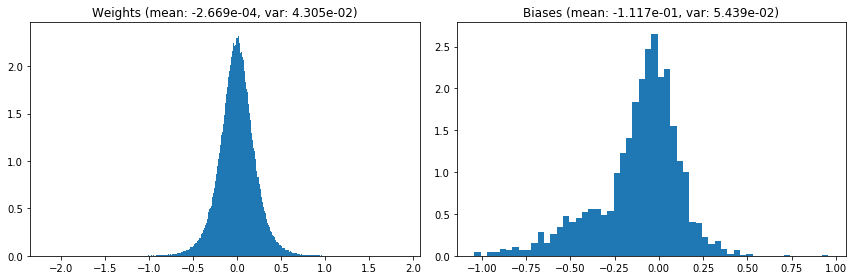

                                      Location network weights and biases


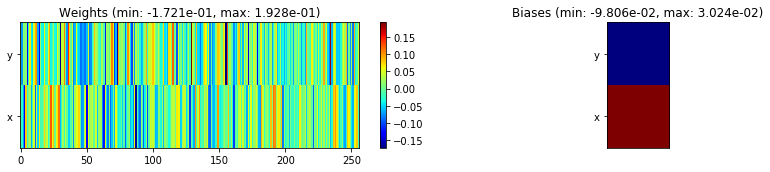

---------------------------------------------------------------------------------------------------------------
Elapsed time:  391.68 sec | TRAIN >> class loss: 0.1460 | steps:  2.114 :( | reward:  0.9540    | acc.: 95.403% 
                          | VAL   >> class loss: 0.1373 | steps:  1.965 :( | reward:  0.9552 :( | acc.: 95.520% :(


Epoch  55/400) lr = 0.0002105
 b    500/  3000 >> 130.0 ms/b | lr: 2.10e-04 | grad 2norm:  3.94 | grad inf norm:  1.103
       Weights || abs max:  2.15 (23237.00) | mean: -2.68e-04 ( 0.11) | var: 4.31e-02 ( 5907.98)
        Biases || abs max:  1.04 (  826.26) | mean: -1.12e-01 ( 0.68) | var: 5.44e-02 (98527.05)
                  class loss: 0.153 | steps: 2.109 | reward:  0.951 | acc.: 95.05%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 138.5 ms/b | lr: 2.10e-04 | grad 2norm:  3.67 | grad inf norm:  1.062
       Weights || abs max:  2.16 (41981.50) | mean: -2.75e-04 ( 0.14) | v

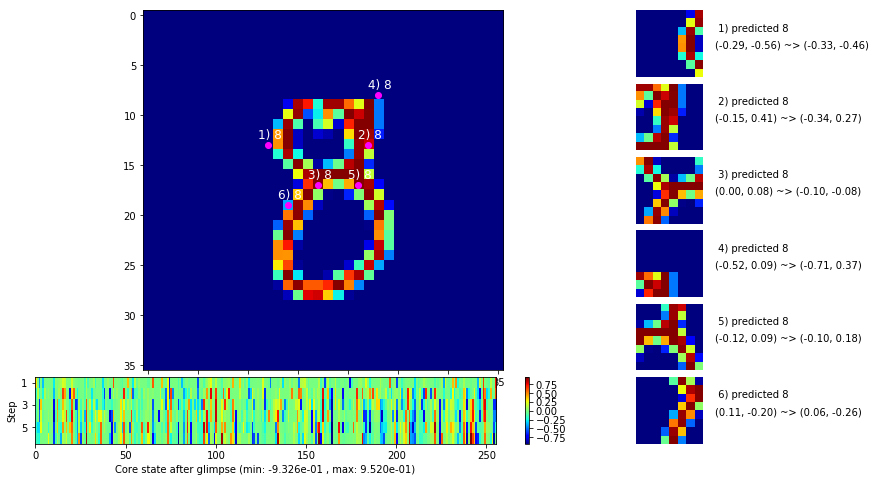

 b   1500/  3000 >> 139.6 ms/b | lr: 2.09e-04 | grad 2norm:  3.64 | grad inf norm:  1.061
       Weights || abs max:  2.17 (     inf) | mean: -2.84e-04 (  inf) | var: 4.31e-02 (     nan)
        Biases || abs max:  1.05 (  121.20) | mean: -1.12e-01 ( 0.19) | var: 5.45e-02 (  484.26)
                  class loss: 0.145 | steps: 2.123 | reward:  0.955 | acc.: 95.53%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 132.1 ms/b | lr: 2.09e-04 | grad 2norm:  3.66 | grad inf norm:  1.068
       Weights || abs max:  2.18 (23481.04) | mean: -2.81e-04 ( 0.10) | var: 4.31e-02 (10952.91)
        Biases || abs max:  1.05 (  392.37) | mean: -1.12e-01 ( 0.29) | var: 5.46e-02 (12780.54)
                  class loss: 0.142 | steps: 2.104 | reward:  0.956 | acc.: 95.55%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

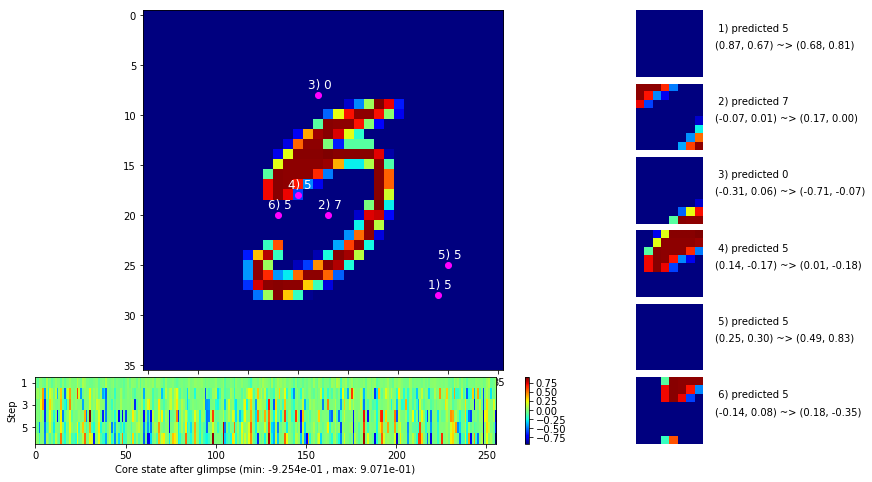

 b   2500/  3000 >> 130.5 ms/b | lr: 2.08e-04 | grad 2norm:  3.90 | grad inf norm:  1.132
       Weights || abs max:  2.18 (29661.45) | mean: -2.76e-04 ( 0.11) | var: 4.31e-02 (29825.29)
        Biases || abs max:  1.05 (  326.54) | mean: -1.12e-01 ( 0.31) | var: 5.47e-02 ( 1856.23)
                  class loss: 0.155 | steps: 2.102 | reward:  0.951 | acc.: 95.05%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.1 ms/b | lr: 2.07e-04 | grad 2norm:  3.75 | grad inf norm:  1.107
       Weights || abs max:  2.18 (30808.26) | mean: -2.79e-04 ( 0.12) | var: 4.31e-02 (19827.21)
        Biases || abs max:  1.05 (  270.53) | mean: -1.12e-01 ( 0.28) | var: 5.47e-02 ( 1100.76)
                  class loss: 0.151 | steps: 2.102 | reward:  0.954 | acc.: 95.36%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

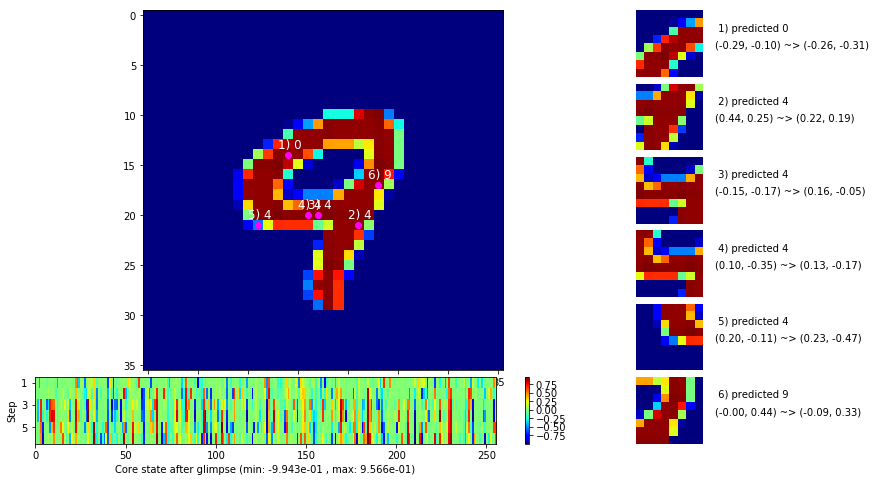

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


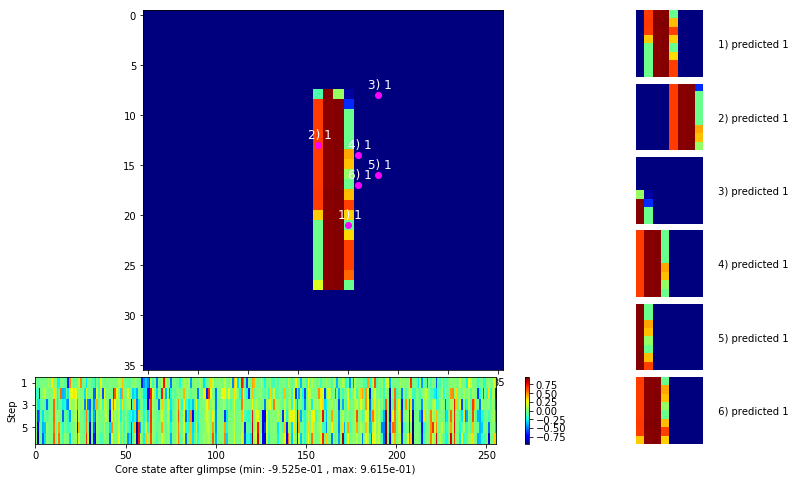


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


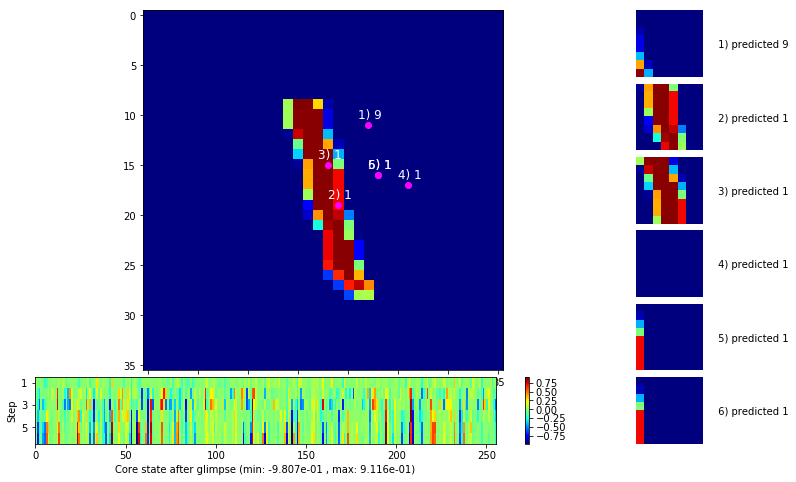

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


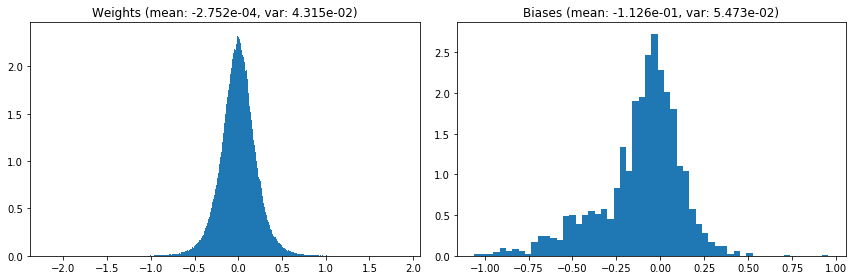

                                      Location network weights and biases


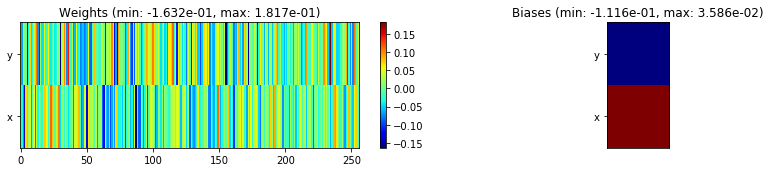

---------------------------------------------------------------------------------------------------------------
Elapsed time:  399.62 sec | TRAIN >> class loss: 0.1482 | steps:  2.108 :( | reward:  0.9534 :( | acc.: 95.343% :(
                          | VAL   >> class loss: 0.1430 | steps:  1.956 :( | reward:  0.9518 :( | acc.: 95.180% :(


Epoch  56/400) lr = 0.0002072
 b    500/  3000 >> 128.9 ms/b | lr: 2.07e-04 | grad 2norm:  3.77 | grad inf norm:  1.095
       Weights || abs max:  2.18 (45172.10) | mean: -2.75e-04 ( 0.15) | var: 4.32e-02 (141158.66)
        Biases || abs max:  1.06 (  322.29) | mean: -1.13e-01 ( 0.28) | var: 5.47e-02 ( 1644.23)
                  class loss: 0.152 | steps: 2.105 | reward:  0.953 | acc.: 95.31%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.5 ms/b | lr: 2.06e-04 | grad 2norm:  3.68 | grad inf norm:  1.102
       Weights || abs max:  2.17 (27813.26) | mean: -2.70e-04 ( 0.11) 

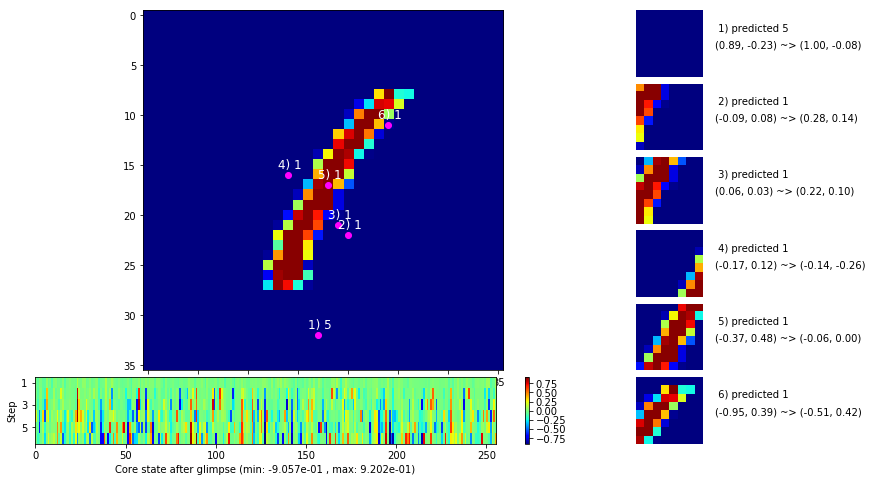

 b   1500/  3000 >> 132.0 ms/b | lr: 2.06e-04 | grad 2norm:  3.70 | grad inf norm:  1.056
       Weights || abs max:  2.17 (50520.25) | mean: -2.74e-04 ( 0.16) | var: 4.32e-02 (445259.09)
        Biases || abs max:  1.05 (  448.85) | mean: -1.13e-01 ( 0.34) | var: 5.48e-02 ( 4871.04)
                  class loss: 0.142 | steps: 2.101 | reward:  0.955 | acc.: 95.53%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 131.0 ms/b | lr: 2.05e-04 | grad 2norm:  3.82 | grad inf norm:  1.130
       Weights || abs max:  2.18 (35719.77) | mean: -2.89e-04 ( 0.13) | var: 4.32e-02 (38886.83)
        Biases || abs max:  1.05 (  191.52) | mean: -1.13e-01 ( 0.26) | var: 5.48e-02 (  390.29)
                  class loss: 0.141 | steps: 2.112 | reward:  0.952 | acc.: 95.24%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

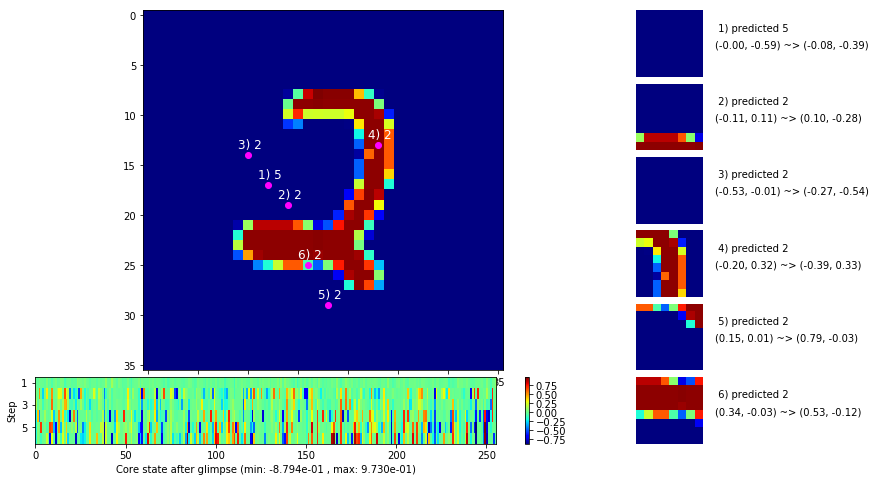

 b   2500/  3000 >> 138.4 ms/b | lr: 2.05e-04 | grad 2norm:  3.74 | grad inf norm:  1.104
       Weights || abs max:  2.17 (39052.04) | mean: -3.04e-04 ( 0.14) | var: 4.32e-02 (43570.21)
        Biases || abs max:  1.05 (  169.59) | mean: -1.13e-01 ( 0.24) | var: 5.49e-02 (  146.73)
                  class loss: 0.147 | steps: 2.103 | reward:  0.954 | acc.: 95.43%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 139.6 ms/b | lr: 2.04e-04 | grad 2norm:  3.81 | grad inf norm:  1.064
       Weights || abs max:  2.17 (128496.30) | mean: -3.15e-04 ( 0.31) | var: 4.32e-02 (7729820.50)
        Biases || abs max:  1.05 (  260.72) | mean: -1.13e-01 ( 0.28) | var: 5.49e-02 (  983.44)
                  class loss: 0.149 | steps: 2.125 | reward:  0.953 | acc.: 95.28%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

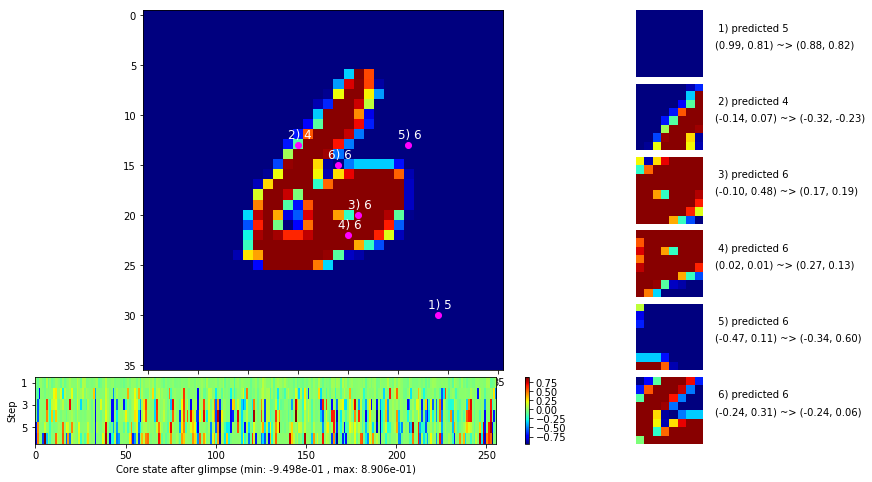

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


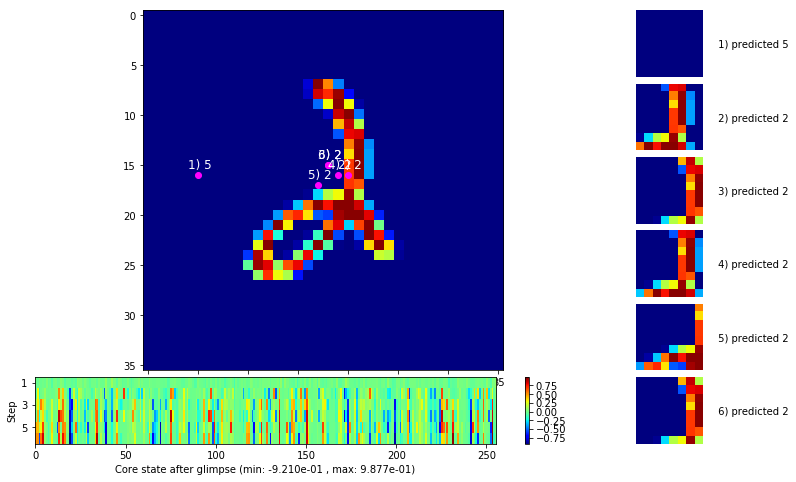


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


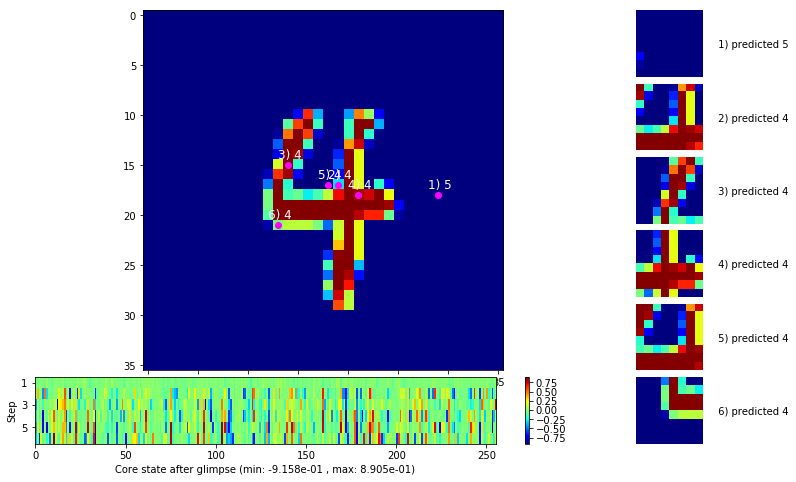

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


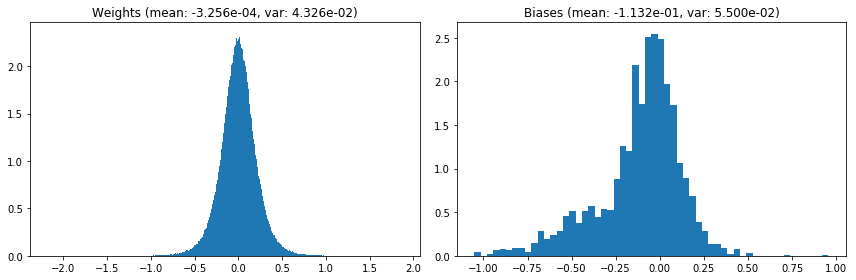

                                      Location network weights and biases


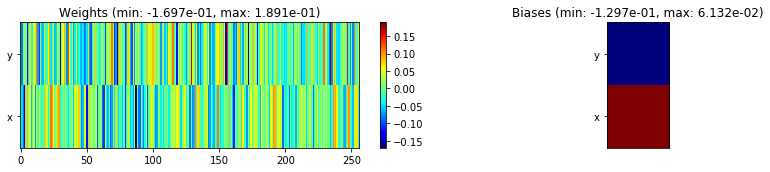

---------------------------------------------------------------------------------------------------------------
Elapsed time:  400.26 sec | TRAIN >> class loss: 0.1455 | steps:  2.110 :( | reward:  0.9538 :( | acc.: 95.385% :(
                          | VAL   >> class loss: 0.1441 | steps:  2.017 :( | reward:  0.9560 :( | acc.: 95.600% :(


Epoch  57/400) lr = 0.0002041
 b    500/  3000 >> 130.9 ms/b | lr: 2.04e-04 | grad 2norm:  3.92 | grad inf norm:  1.133
       Weights || abs max:  2.17 (36819.68) | mean: -3.19e-04 ( 0.13) | var: 4.33e-02 (84059.42)
        Biases || abs max:  1.05 (  778.26) | mean: -1.13e-01 ( 0.44) | var: 5.50e-02 (52041.84)
                  class loss: 0.154 | steps: 2.128 | reward:  0.951 | acc.: 95.12%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.1 ms/b | lr: 2.03e-04 | grad 2norm:  4.00 | grad inf norm:  1.120
       Weights || abs max:  2.18 (30983.17) | mean: -3.16e-04 ( 0.12) |

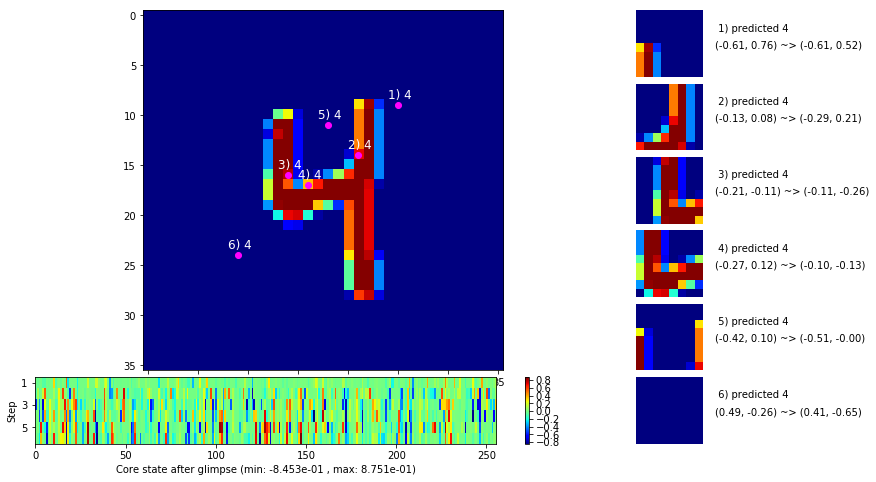

 b   1500/  3000 >> 128.1 ms/b | lr: 2.03e-04 | grad 2norm:  3.57 | grad inf norm:  1.066
       Weights || abs max:  2.18 (32013.93) | mean: -3.16e-04 ( 0.12) | var: 4.33e-02 (27333.49)
        Biases || abs max:  1.05 (  176.88) | mean: -1.13e-01 ( 0.20) | var: 5.50e-02 (  324.28)
                  class loss: 0.132 | steps: 2.099 | reward:  0.957 | acc.: 95.69%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.6 ms/b | lr: 2.02e-04 | grad 2norm:  3.67 | grad inf norm:  1.044
       Weights || abs max:  2.18 (72687.76) | mean: -3.20e-04 ( 0.20) | var: 4.33e-02 (1841493.75)
        Biases || abs max:  1.04 (  156.48) | mean: -1.13e-01 ( 0.18) | var: 5.50e-02 (  268.84)
                  class loss: 0.144 | steps: 2.128 | reward:  0.955 | acc.: 95.47%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

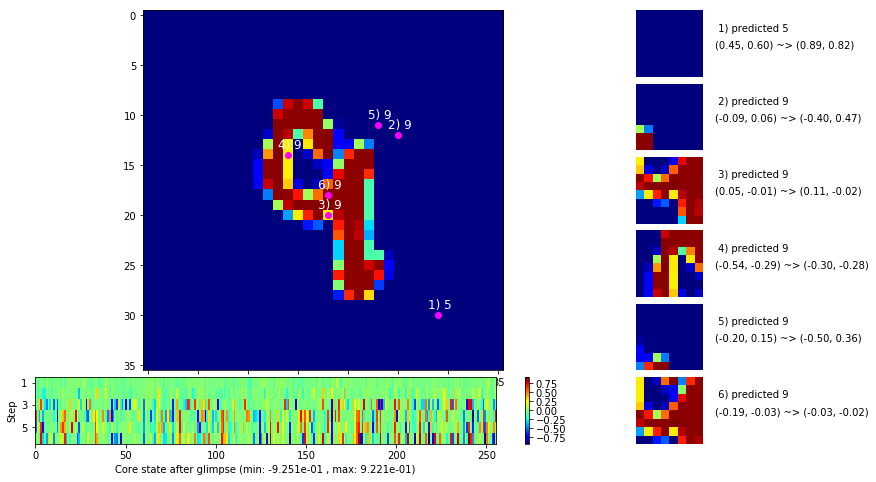

 b   2500/  3000 >> 127.3 ms/b | lr: 2.02e-04 | grad 2norm:  3.76 | grad inf norm:  1.084
       Weights || abs max:  2.18 (25751.47) | mean: -3.22e-04 ( 0.11) | var: 4.33e-02 (15844.78)
        Biases || abs max:  1.04 (  207.21) | mean: -1.13e-01 ( 0.25) | var: 5.50e-02 ( 4529.99)
                  class loss: 0.143 | steps: 2.113 | reward:  0.953 | acc.: 95.31%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.2 ms/b | lr: 2.01e-04 | grad 2norm:  3.74 | grad inf norm:  1.091
       Weights || abs max:  2.19 (31956.79) | mean: -3.19e-04 ( 0.12) | var: 4.33e-02 (37721.89)
        Biases || abs max:  1.04 (  120.82) | mean: -1.13e-01 ( 0.18) | var: 5.50e-02 (  168.88)
                  class loss: 0.143 | steps: 2.098 | reward:  0.954 | acc.: 95.40%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

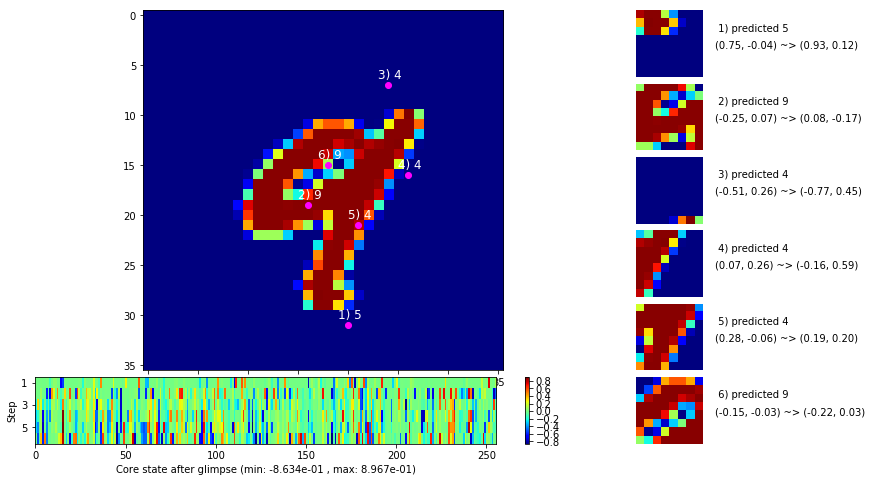

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


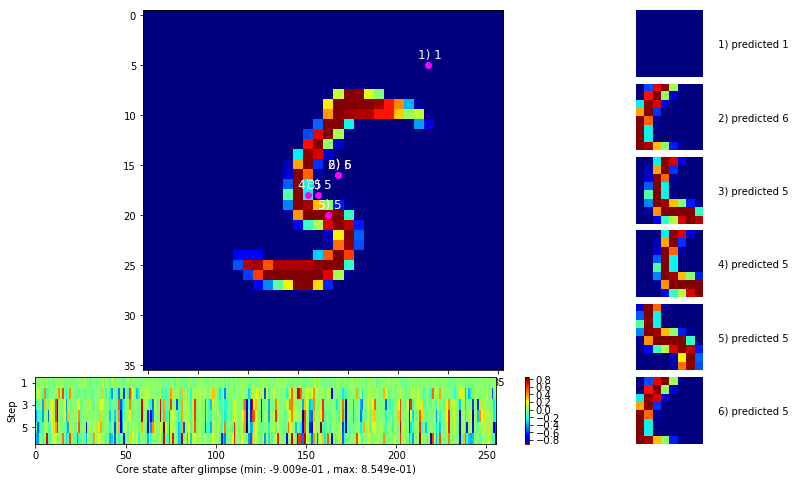


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


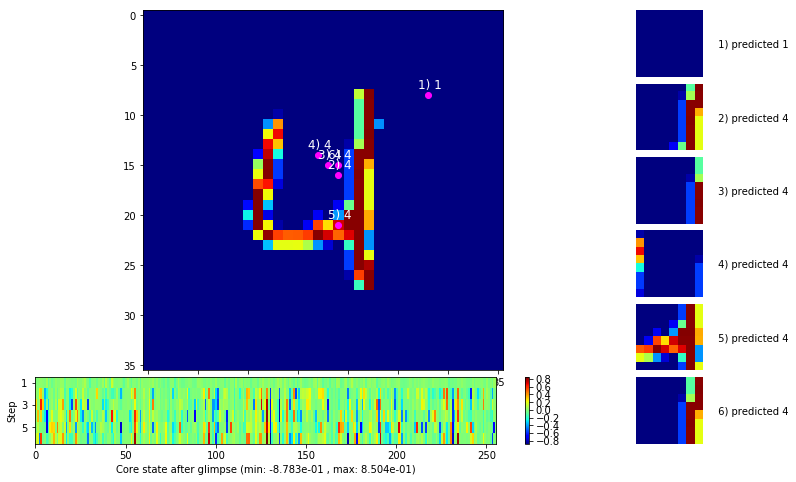

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


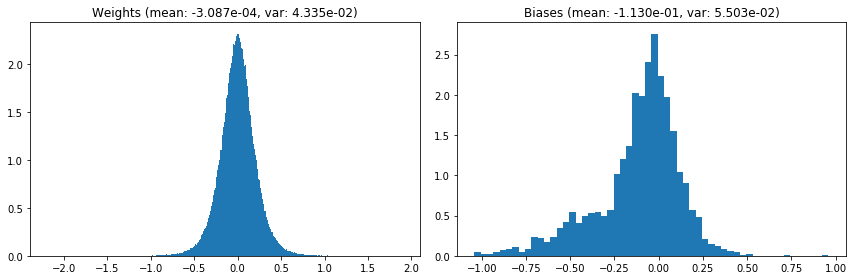

                                      Location network weights and biases


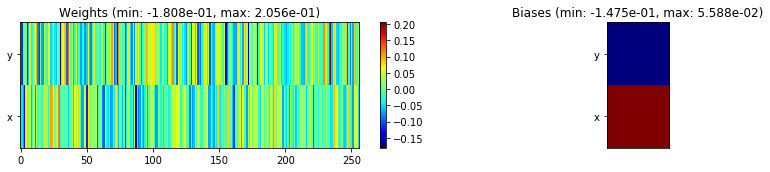

---------------------------------------------------------------------------------------------------------------
Elapsed time:  387.88 sec | TRAIN >> class loss: 0.1464 | steps:  2.115 :( | reward:  0.9533 :( | acc.: 95.328% :(
                          | VAL   >> class loss: 0.1452 | steps:  1.971 :( | reward:  0.9538 :( | acc.: 95.380% :(


Epoch  58/400) lr = 0.000201
 b    500/  3000 >> 130.7 ms/b | lr: 2.01e-04 | grad 2norm:  3.72 | grad inf norm:  1.051
       Weights || abs max:  2.19 (26910.05) | mean: -3.15e-04 ( 0.12) | var: 4.34e-02 (16967.12)
        Biases || abs max:  1.04 (  227.28) | mean: -1.13e-01 ( 0.22) | var: 5.51e-02 (  456.17)
                  class loss: 0.150 | steps: 2.096 | reward:  0.954 | acc.: 95.37%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 138.3 ms/b | lr: 2.00e-04 | grad 2norm:  3.65 | grad inf norm:  1.074
       Weights || abs max:  2.19 (21713.94) | mean: -3.24e-04 ( 0.10) | 

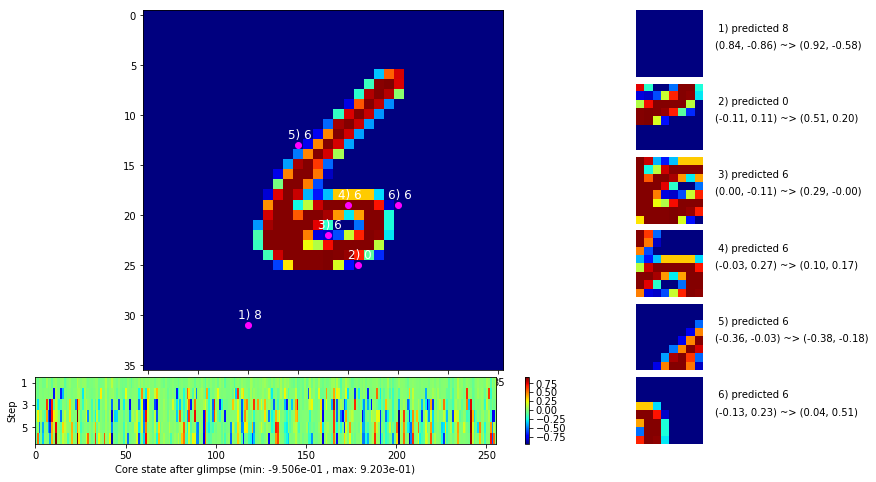

 b   1500/  3000 >> 137.7 ms/b | lr: 2.00e-04 | grad 2norm:  3.88 | grad inf norm:  1.103
       Weights || abs max:  2.19 (324497.47) | mean: -3.37e-04 ( 0.67) | var: 4.34e-02 (64487988.00)
        Biases || abs max:  1.05 (  204.08) | mean: -1.13e-01 ( 0.22) | var: 5.52e-02 (  239.64)
                  class loss: 0.155 | steps: 2.111 | reward:  0.951 | acc.: 95.11%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.4 ms/b | lr: 1.99e-04 | grad 2norm:  3.76 | grad inf norm:  1.086
       Weights || abs max:  2.19 (30046.73) | mean: -3.46e-04 ( 0.12) | var: 4.34e-02 (44337.37)
        Biases || abs max:  1.05 (  471.11) | mean: -1.13e-01 ( 0.32) | var: 5.52e-02 ( 5151.66)
                  class loss: 0.145 | steps: 2.096 | reward:  0.954 | acc.: 95.42%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

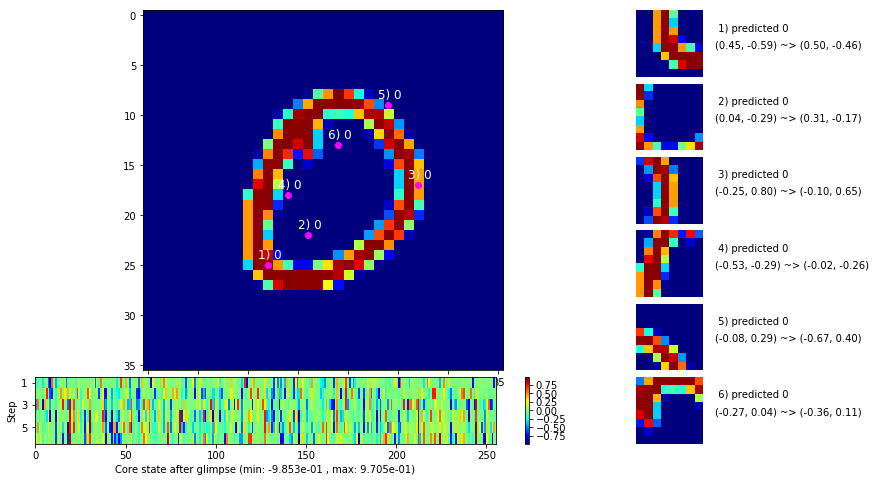

 b   2500/  3000 >> 132.8 ms/b | lr: 1.99e-04 | grad 2norm:  3.89 | grad inf norm:  1.101
       Weights || abs max:  2.19 (29934.67) | mean: -3.63e-04 ( 0.12) | var: 4.34e-02 (73032.71)
        Biases || abs max:  1.04 (  264.49) | mean: -1.14e-01 ( 0.26) | var: 5.52e-02 (  574.80)
                  class loss: 0.148 | steps: 2.090 | reward:  0.951 | acc.: 95.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 126.2 ms/b | lr: 1.98e-04 | grad 2norm:  3.57 | grad inf norm:  1.054
       Weights || abs max:  2.19 (26234.87) | mean: -3.64e-04 ( 0.11) | var: 4.34e-02 (18400.00)
        Biases || abs max:  1.04 (  328.75) | mean: -1.13e-01 ( 0.28) | var: 5.52e-02 (  998.24)
                  class loss: 0.140 | steps: 2.110 | reward:  0.958 | acc.: 95.75%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

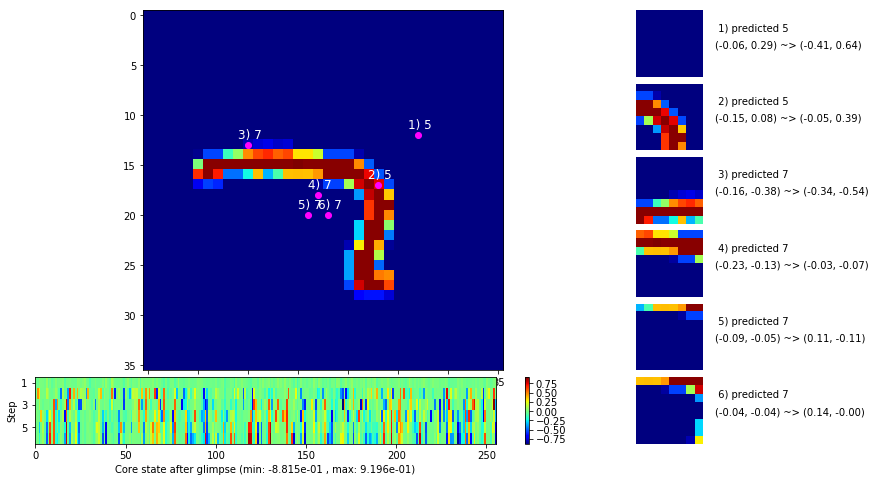

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


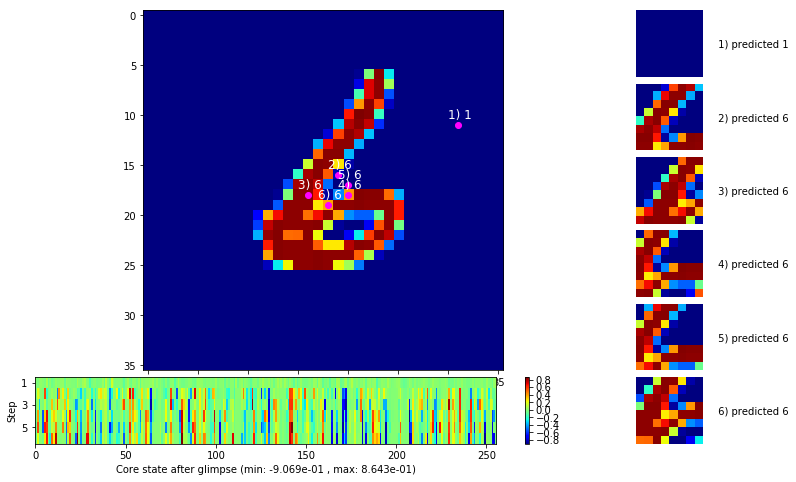


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


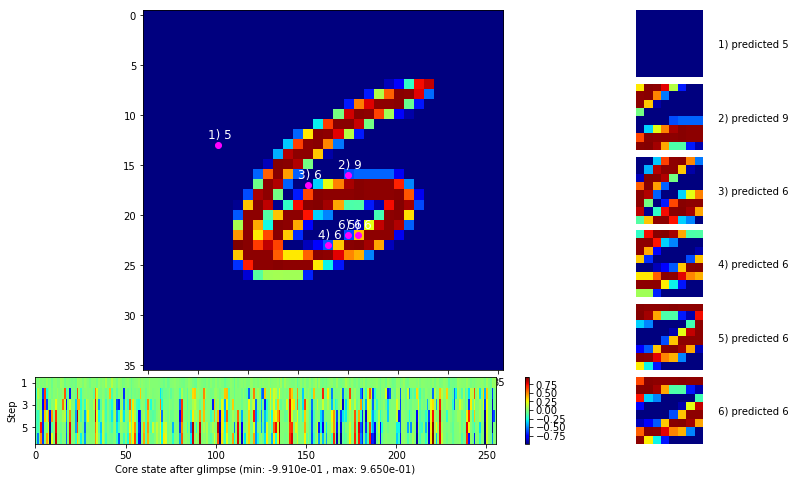

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


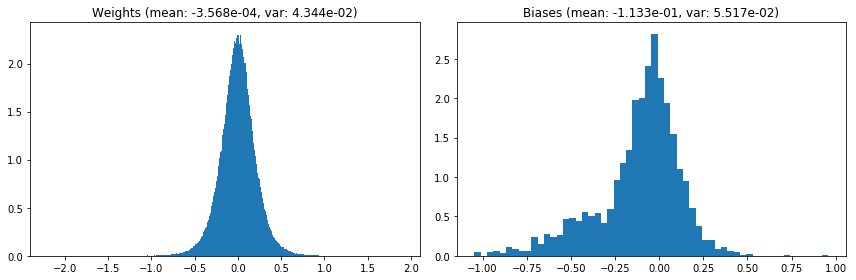

                                      Location network weights and biases


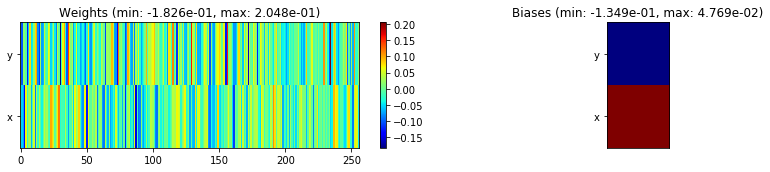

---------------------------------------------------------------------------------------------------------------
Elapsed time:  397.65 sec | TRAIN >> class loss: 0.1469 | steps:  2.101    | reward:  0.9538 :( | acc.: 95.383% :(
                          | VAL   >> class loss: 0.1506 | steps:  1.959 :( | reward:  0.9518 :( | acc.: 95.180% :(


Epoch  59/400) lr = 0.0001981
 b    500/  3000 >> 129.0 ms/b | lr: 1.98e-04 | grad 2norm:  3.64 | grad inf norm:  1.078
       Weights || abs max:  2.20 (37376.89) | mean: -3.62e-04 ( 0.13) | var: 4.35e-02 (193003.09)
        Biases || abs max:  1.04 (  432.79) | mean: -1.13e-01 ( 0.32) | var: 5.52e-02 ( 6564.15)
                  class loss: 0.136 | steps: 2.088 | reward:  0.956 | acc.: 95.55%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 126.6 ms/b | lr: 1.97e-04 | grad 2norm:  3.98 | grad inf norm:  1.147
       Weights || abs max:  2.20 (22863.70) | mean: -3.62e-04 ( 0.11) 

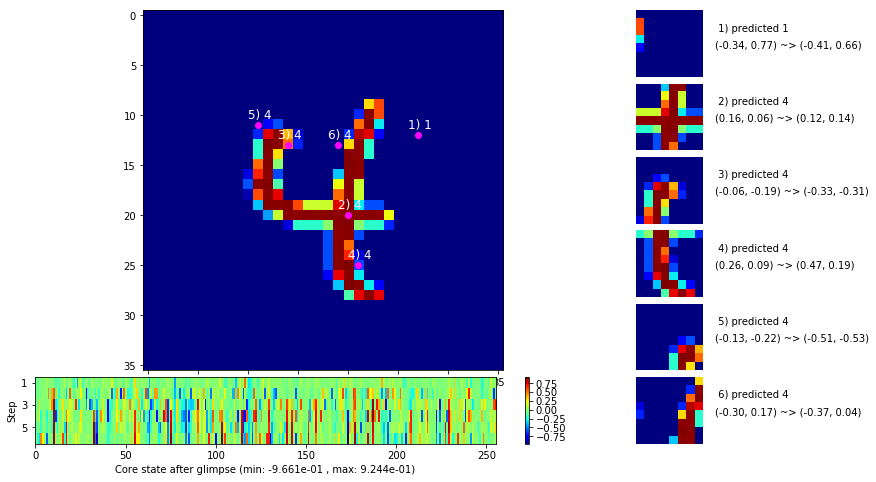

 b   1500/  3000 >> 133.7 ms/b | lr: 1.97e-04 | grad 2norm:  3.77 | grad inf norm:  1.076
       Weights || abs max:  2.20 (26145.69) | mean: -3.55e-04 ( 0.11) | var: 4.35e-02 (23287.68)
        Biases || abs max:  1.04 (  349.01) | mean: -1.14e-01 ( 0.30) | var: 5.53e-02 ( 2027.93)
                  class loss: 0.147 | steps: 2.092 | reward:  0.953 | acc.: 95.29%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.2 ms/b | lr: 1.96e-04 | grad 2norm:  3.79 | grad inf norm:  1.071
       Weights || abs max:  2.20 (53539.07) | mean: -3.58e-04 ( 0.16) | var: 4.35e-02 (354180.72)
        Biases || abs max:  1.04 (  359.89) | mean: -1.13e-01 ( 0.27) | var: 5.53e-02 ( 4600.72)
                  class loss: 0.144 | steps: 2.105 | reward:  0.954 | acc.: 95.43%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

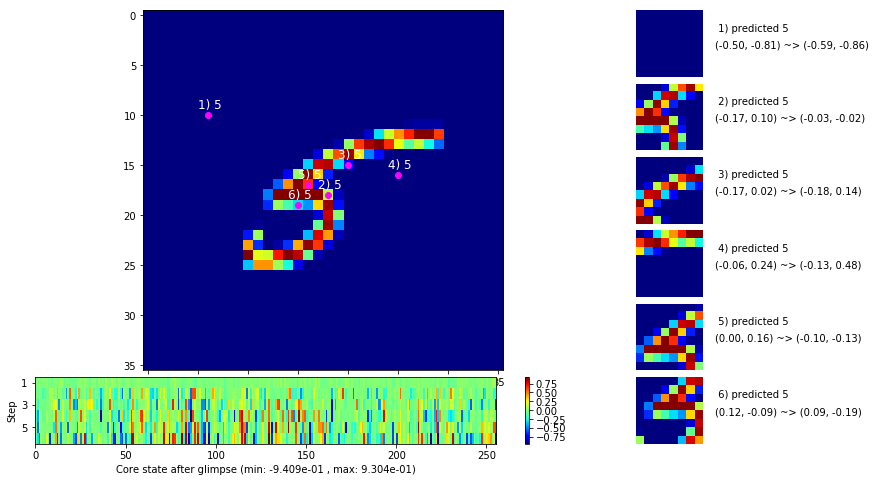

 b   2500/  3000 >> 139.1 ms/b | lr: 1.96e-04 | grad 2norm:  3.65 | grad inf norm:  1.061
       Weights || abs max:  2.20 (34984.04) | mean: -3.54e-04 ( 0.12) | var: 4.35e-02 (49933.83)
        Biases || abs max:  1.04 (  129.44) | mean: -1.14e-01 ( 0.18) | var: 5.54e-02 (  171.79)
                  class loss: 0.144 | steps: 2.095 | reward:  0.956 | acc.: 95.56%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 138.5 ms/b | lr: 1.95e-04 | grad 2norm:  3.85 | grad inf norm:  1.096
       Weights || abs max:  2.20 (40914.89) | mean: -3.57e-04 ( 0.14) | var: 4.35e-02 (285063.16)
        Biases || abs max:  1.04 (  191.53) | mean: -1.14e-01 ( 0.24) | var: 5.54e-02 (  357.57)
                  class loss: 0.148 | steps: 2.111 | reward:  0.952 | acc.: 95.15%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

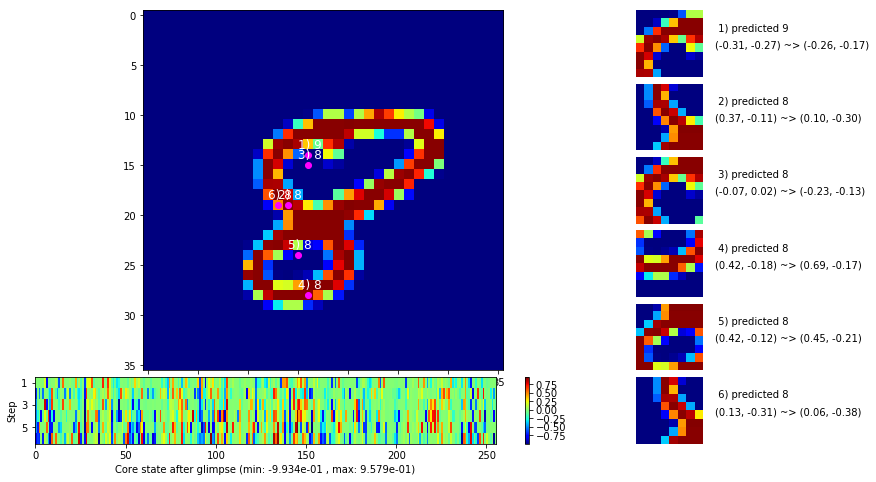

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


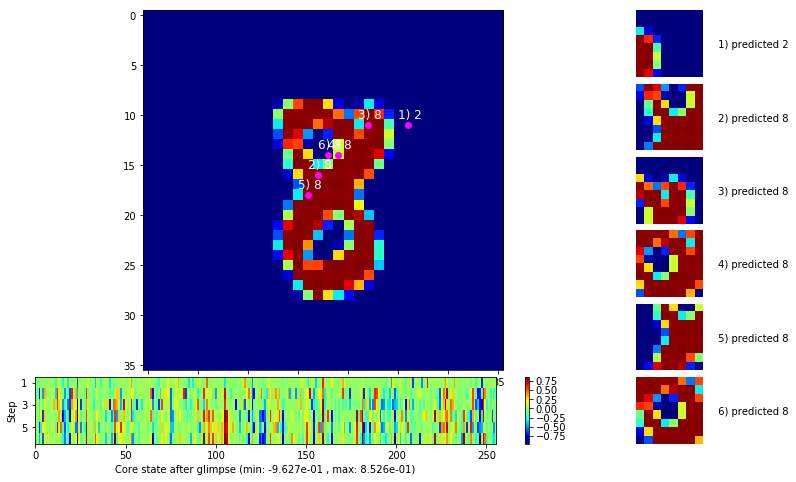


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


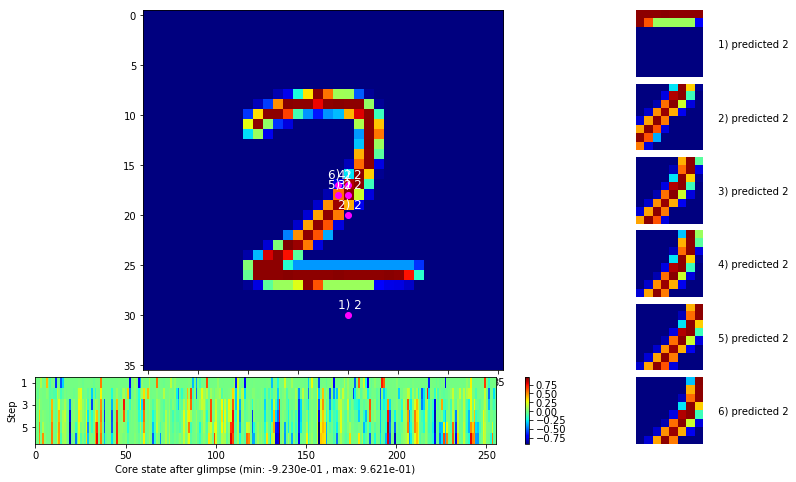

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


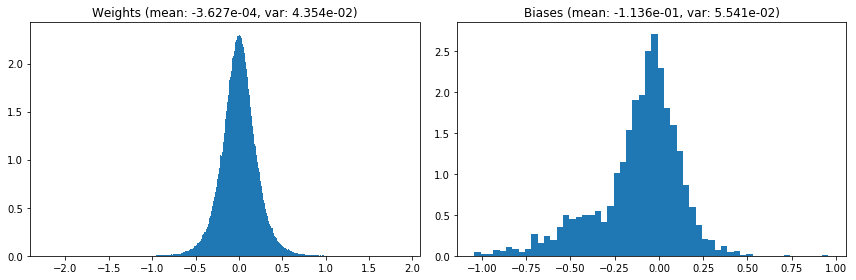

                                      Location network weights and biases


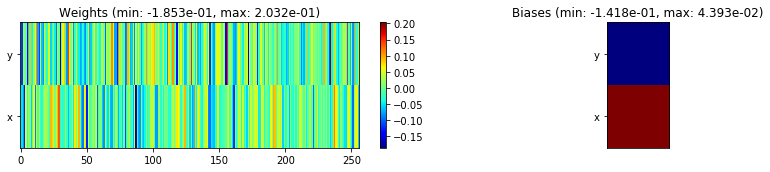

---------------------------------------------------------------------------------------------------------------
Elapsed time:  398.76 sec | TRAIN >> class loss: 0.1449 | steps:  2.100    | reward:  0.9532 :( | acc.: 95.317% :(
                          | VAL   >> class loss: 0.1391 | steps:  1.947    | reward:  0.9572 :( | acc.: 95.720% :(


Epoch  60/400) lr = 0.0001952
 b    500/  3000 >> 129.3 ms/b | lr: 1.95e-04 | grad 2norm:  3.79 | grad inf norm:  1.064
       Weights || abs max:  2.20 (83502.80) | mean: -3.65e-04 ( 0.22) | var: 4.35e-02 (2140961.75)
        Biases || abs max:  1.04 (  145.80) | mean: -1.14e-01 ( 0.21) | var: 5.54e-02 (  126.31)
                  class loss: 0.143 | steps: 2.082 | reward:  0.954 | acc.: 95.42%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 131.0 ms/b | lr: 1.94e-04 | grad 2norm:  3.62 | grad inf norm:  1.029
       Weights || abs max:  2.20 (27972.16) | mean: -3.77e-04 ( 0.11)

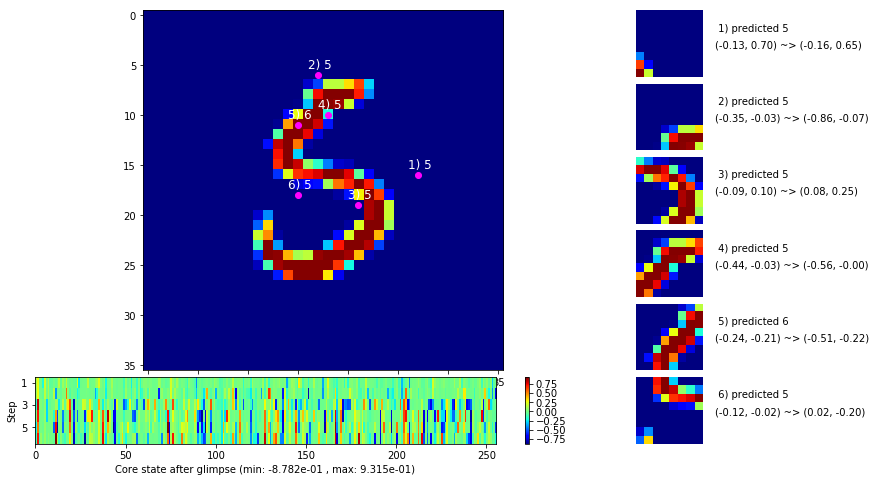

 b   1500/  3000 >> 130.1 ms/b | lr: 1.94e-04 | grad 2norm:  3.75 | grad inf norm:  1.088
       Weights || abs max:  2.20 (32119.42) | mean: -3.70e-04 ( 0.12) | var: 4.36e-02 (46111.57)
        Biases || abs max:  1.05 (  312.86) | mean: -1.14e-01 ( 0.30) | var: 5.55e-02 ( 2916.56)
                  class loss: 0.141 | steps: 2.077 | reward:  0.954 | acc.: 95.38%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.3 ms/b | lr: 1.94e-04 | grad 2norm:  3.74 | grad inf norm:  1.074
       Weights || abs max:  2.19 (23148.20) | mean: -3.72e-04 ( 0.10) | var: 4.36e-02 ( 9940.48)
        Biases || abs max:  1.05 (  317.71) | mean: -1.14e-01 ( 0.30) | var: 5.56e-02 (  590.32)
                  class loss: 0.144 | steps: 2.104 | reward:  0.954 | acc.: 95.41%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

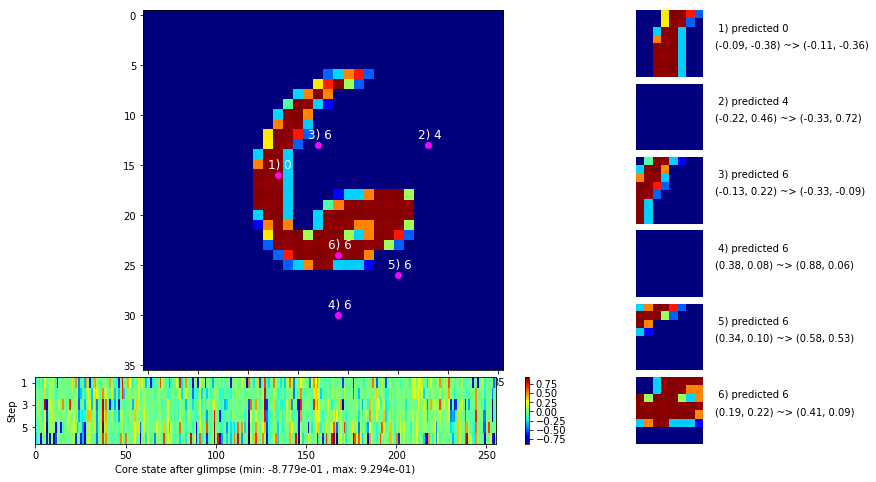

 b   2500/  3000 >> 127.9 ms/b | lr: 1.93e-04 | grad 2norm:  3.50 | grad inf norm:  1.013
       Weights || abs max:  2.19 (35745.44) | mean: -3.77e-04 ( 0.13) | var: 4.36e-02 (37394.73)
        Biases || abs max:  1.05 (  730.58) | mean: -1.14e-01 ( 0.45) | var: 5.56e-02 (31998.27)
                  class loss: 0.132 | steps: 2.063 | reward:  0.958 | acc.: 95.77%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.9 ms/b | lr: 1.93e-04 | grad 2norm:  3.77 | grad inf norm:  1.069
       Weights || abs max:  2.19 (61451.16) | mean: -3.79e-04 ( 0.18) | var: 4.36e-02 (1524176.38)
        Biases || abs max:  1.06 (  162.88) | mean: -1.14e-01 ( 0.21) | var: 5.57e-02 (  125.21)
                  class loss: 0.143 | steps: 2.097 | reward:  0.954 | acc.: 95.44%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

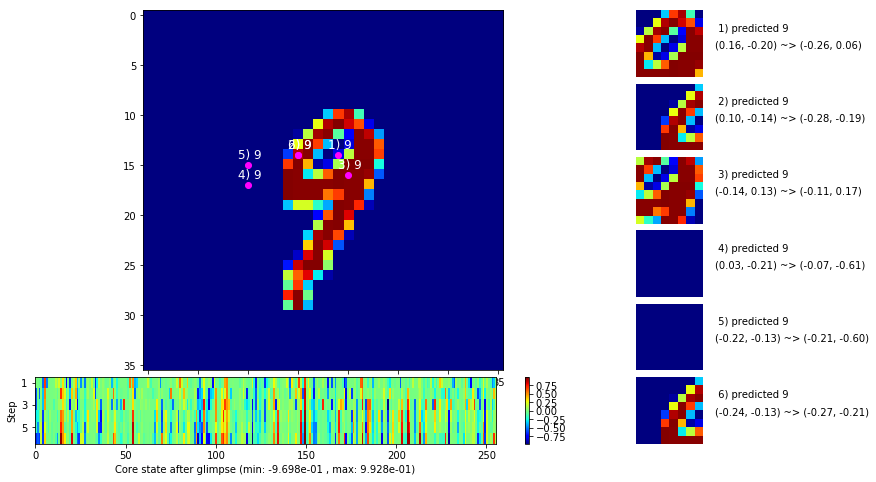

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


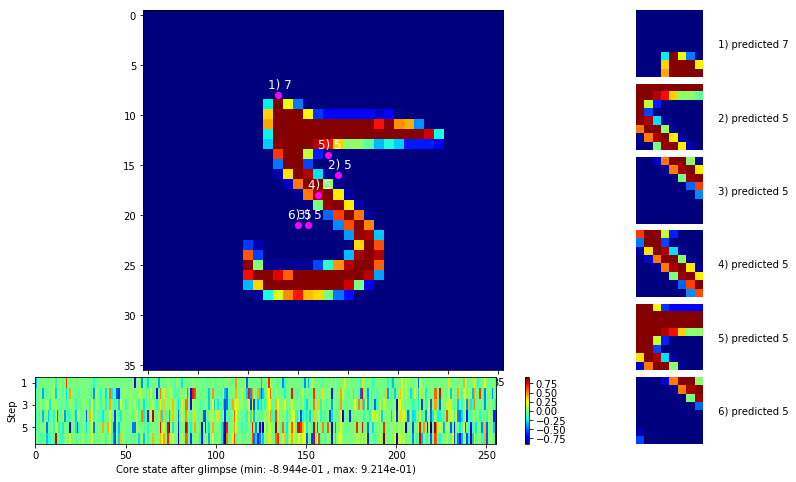


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


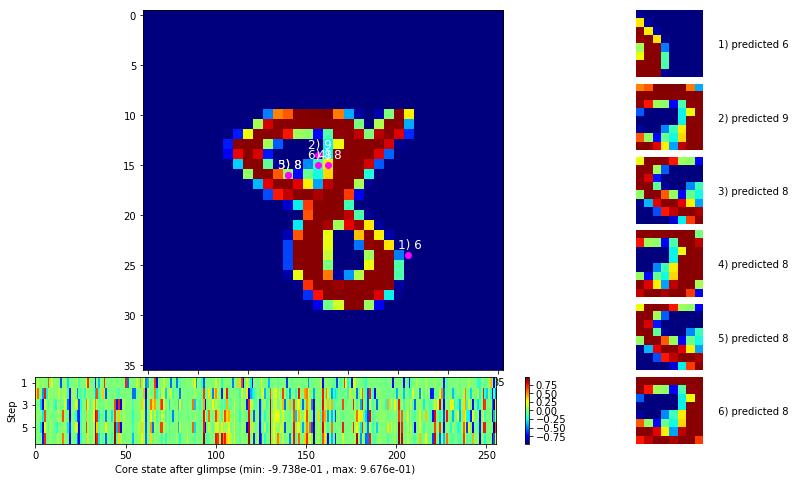

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


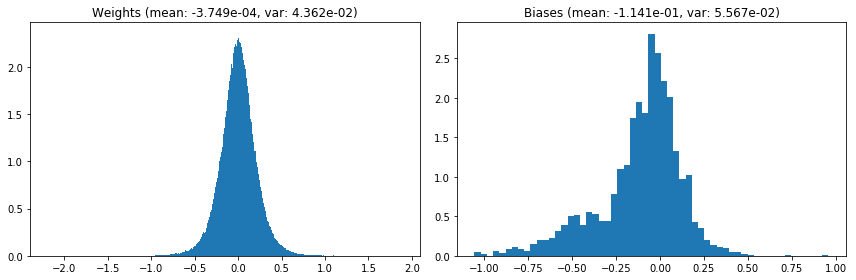

                                      Location network weights and biases


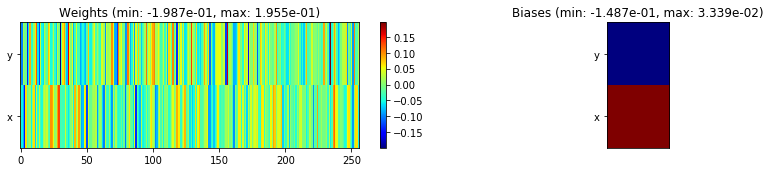

---------------------------------------------------------------------------------------------------------------
Elapsed time:  390.28 sec | TRAIN >> class loss: 0.1404 | steps:  2.082    | reward:  0.9552    | acc.: 95.518% 
                          | VAL   >> class loss: 0.1342 | steps:  1.921    | reward:  0.9564 :( | acc.: 95.640% :(


Epoch  61/400) lr = 0.0001925
 b    500/  3000 >> 133.4 ms/b | lr: 1.92e-04 | grad 2norm:  3.46 | grad inf norm:  1.031
       Weights || abs max:  2.19 (115056.62) | mean: -3.75e-04 ( 0.27) | var: 4.36e-02 (5762304.00)
        Biases || abs max:  1.05 (  209.32) | mean: -1.14e-01 ( 0.24) | var: 5.57e-02 (  709.11)
                  class loss: 0.132 | steps: 2.083 | reward:  0.959 | acc.: 95.87%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 136.7 ms/b | lr: 1.92e-04 | grad 2norm:  3.68 | grad inf norm:  1.080
       Weights || abs max:  2.19 (41383.31) | mean: -3.74e-04 ( 0.14) 

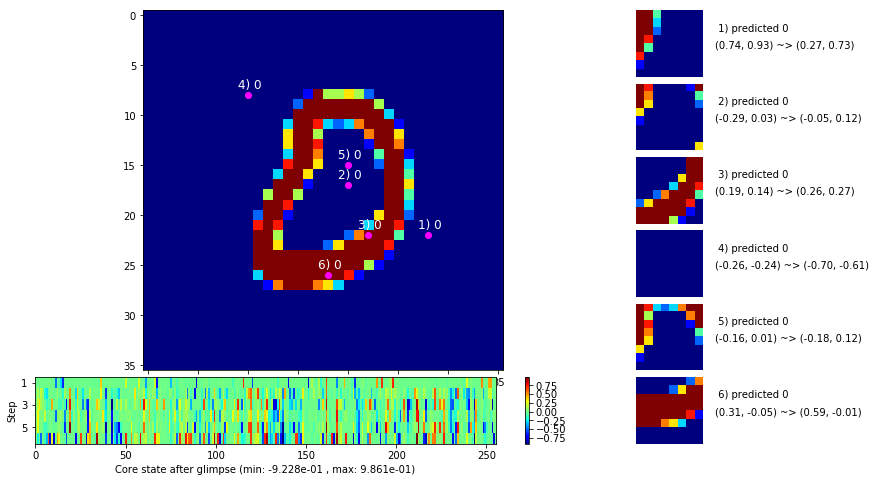

 b   1500/  3000 >> 139.4 ms/b | lr: 1.91e-04 | grad 2norm:  3.66 | grad inf norm:  1.074
       Weights || abs max:  2.20 (26261.37) | mean: -3.77e-04 ( 0.12) | var: 4.36e-02 (12582.38)
        Biases || abs max:  1.05 ( 3035.96) | mean: -1.14e-01 ( 2.41) | var: 5.58e-02 (2689538.75)
                  class loss: 0.143 | steps: 2.101 | reward:  0.954 | acc.: 95.44%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.4 ms/b | lr: 1.91e-04 | grad 2norm:  3.66 | grad inf norm:  1.052
       Weights || abs max:  2.21 (54480.74) | mean: -3.80e-04 ( 0.17) | var: 4.37e-02 (416254.81)
        Biases || abs max:  1.05 ( 1557.61) | mean: -1.14e-01 ( 0.75) | var: 5.58e-02 (375633.41)
                  class loss: 0.145 | steps: 2.079 | reward:  0.956 | acc.: 95.59%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

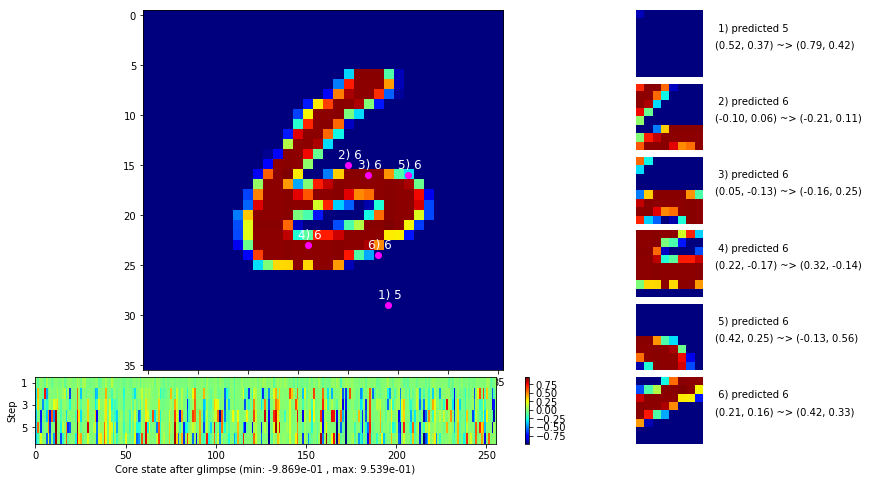

 b   2500/  3000 >> 131.1 ms/b | lr: 1.90e-04 | grad 2norm:  3.55 | grad inf norm:  1.056
       Weights || abs max:  2.21 (35712.67) | mean: -3.89e-04 ( 0.14) | var: 4.37e-02 (86551.68)
        Biases || abs max:  1.05 ( 1768.93) | mean: -1.15e-01 ( 0.83) | var: 5.59e-02 (271878.50)
                  class loss: 0.137 | steps: 2.097 | reward:  0.957 | acc.: 95.72%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 126.1 ms/b | lr: 1.90e-04 | grad 2norm:  3.72 | grad inf norm:  1.068
       Weights || abs max:  2.21 (44820.81) | mean: -3.95e-04 ( 0.15) | var: 4.37e-02 (343408.84)
        Biases || abs max:  1.05 (  951.74) | mean: -1.15e-01 ( 0.64) | var: 5.59e-02 (68757.45)
                  class loss: 0.145 | steps: 2.092 | reward:  0.954 | acc.: 95.41%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

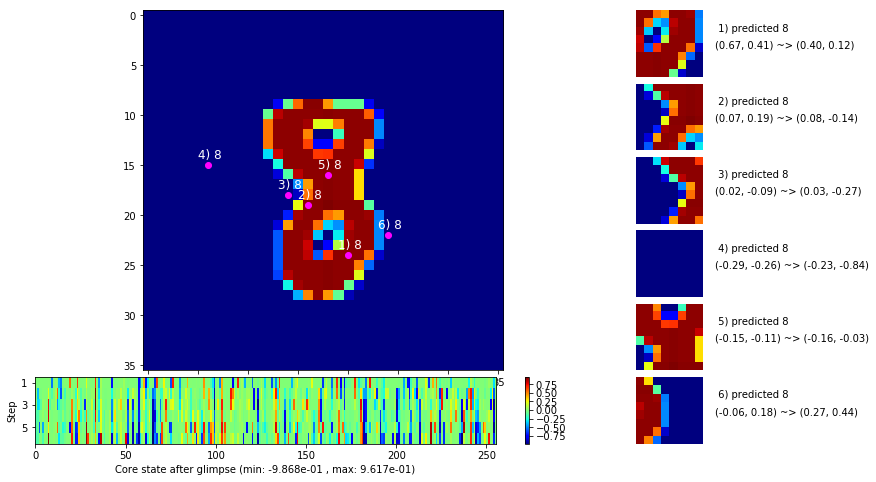

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


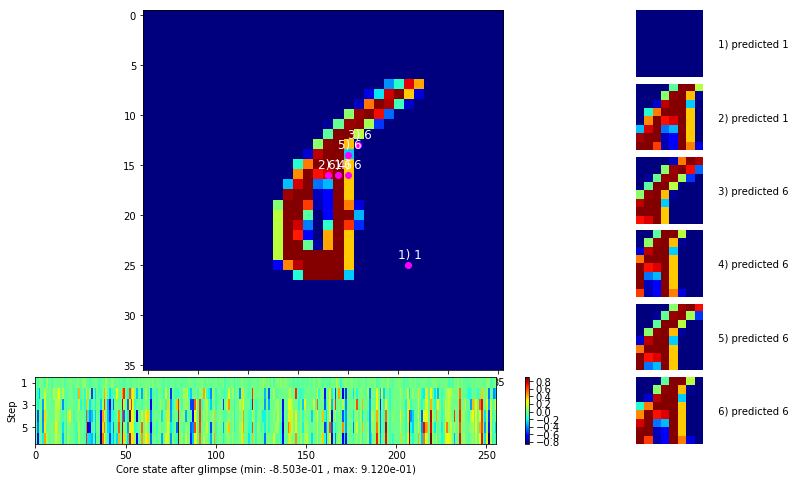


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


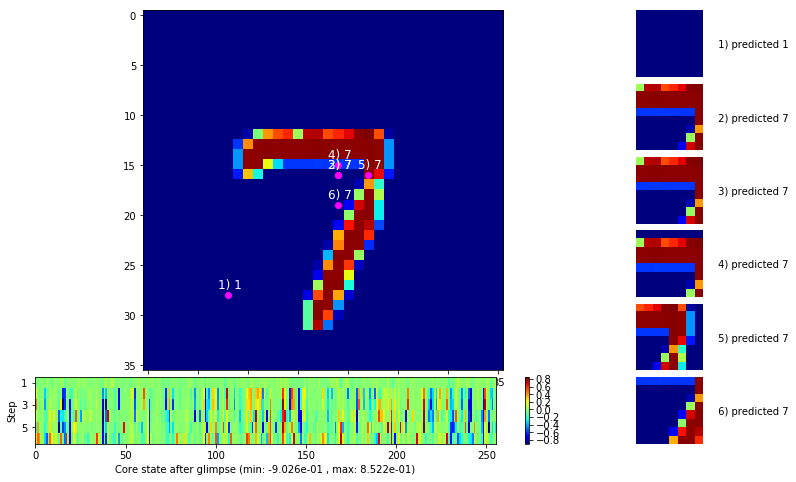

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


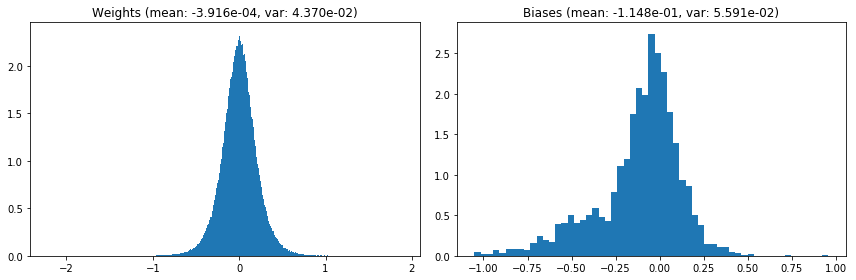

                                      Location network weights and biases


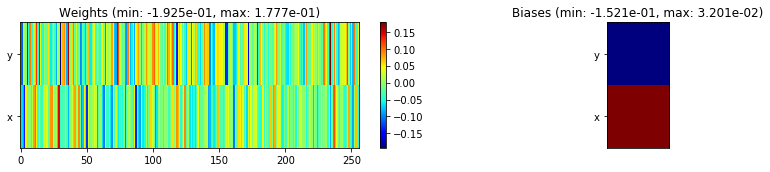

---------------------------------------------------------------------------------------------------------------
Elapsed time:  398.78 sec | TRAIN >> class loss: 0.1405 | steps:  2.091 :( | reward:  0.9560    | acc.: 95.603% 
                          | VAL   >> class loss: 0.1335 | steps:  1.965 :( | reward:  0.9600    | acc.: 96.000% 


Epoch  62/400) lr = 0.0001898
 b    500/  3000 >> 128.9 ms/b | lr: 1.89e-04 | grad 2norm:  3.44 | grad inf norm:  1.018
       Weights || abs max:  2.21 (24260.02) | mean: -3.93e-04 ( 0.11) | var: 4.37e-02 (43269.67)
        Biases || abs max:  1.05 (  586.06) | mean: -1.15e-01 ( 0.39) | var: 5.58e-02 (24389.66)
                  class loss: 0.135 | steps: 2.091 | reward:  0.960 | acc.: 95.99%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.2 ms/b | lr: 1.89e-04 | grad 2norm:  3.54 | grad inf norm:  1.030
       Weights || abs max:  2.22 (127851.61) | mean: -3.98e-04 ( 0.30) | va

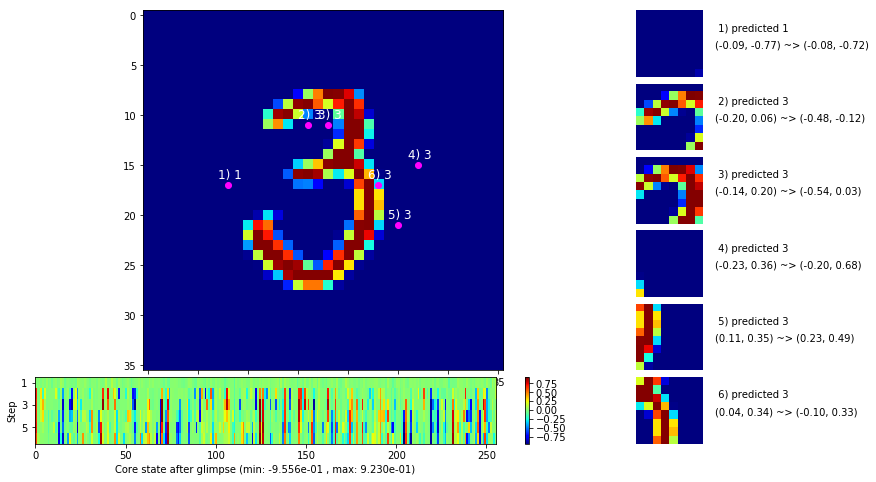

 b   1500/  3000 >> 129.5 ms/b | lr: 1.89e-04 | grad 2norm:  3.45 | grad inf norm:  1.045
       Weights || abs max:  2.22 (22003.05) | mean: -3.95e-04 ( 0.10) | var: 4.37e-02 (24105.87)
        Biases || abs max:  1.05 (  352.81) | mean: -1.15e-01 ( 0.29) | var: 5.59e-02 ( 2542.18)
                  class loss: 0.131 | steps: 2.081 | reward:  0.958 | acc.: 95.81%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 131.4 ms/b | lr: 1.88e-04 | grad 2norm:  3.88 | grad inf norm:  1.128
       Weights || abs max:  2.23 (421465.03) | mean: -3.89e-04 ( 0.84) | var: 4.38e-02 (145648224.00)
        Biases || abs max:  1.05 (  412.27) | mean: -1.14e-01 ( 0.39) | var: 5.59e-02 ( 4548.22)
                  class loss: 0.151 | steps: 2.122 | reward:  0.950 | acc.: 95.01%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

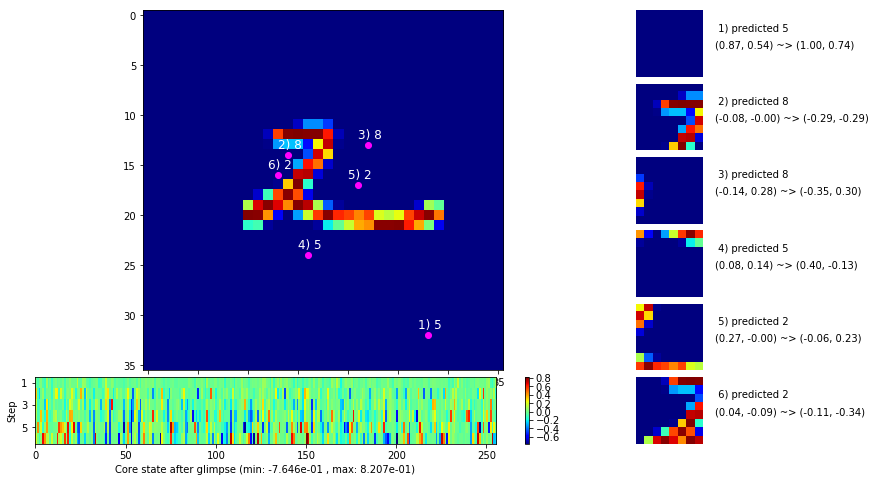

 b   2500/  3000 >> 139.3 ms/b | lr: 1.88e-04 | grad 2norm:  3.71 | grad inf norm:  1.081
       Weights || abs max:  2.22 (36698.14) | mean: -3.93e-04 ( 0.13) | var: 4.38e-02 (66609.05)
        Biases || abs max:  1.05 (  521.70) | mean: -1.14e-01 ( 0.39) | var: 5.60e-02 (16021.19)
                  class loss: 0.145 | steps: 2.107 | reward:  0.955 | acc.: 95.46%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 138.0 ms/b | lr: 1.87e-04 | grad 2norm:  3.68 | grad inf norm:  1.088
       Weights || abs max:  2.22 (28207.04) | mean: -4.01e-04 ( 0.11) | var: 4.38e-02 (87511.54)
        Biases || abs max:  1.05 (  529.75) | mean: -1.15e-01 ( 0.36) | var: 5.61e-02 (21507.69)
                  class loss: 0.148 | steps: 2.097 | reward:  0.955 | acc.: 95.51%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

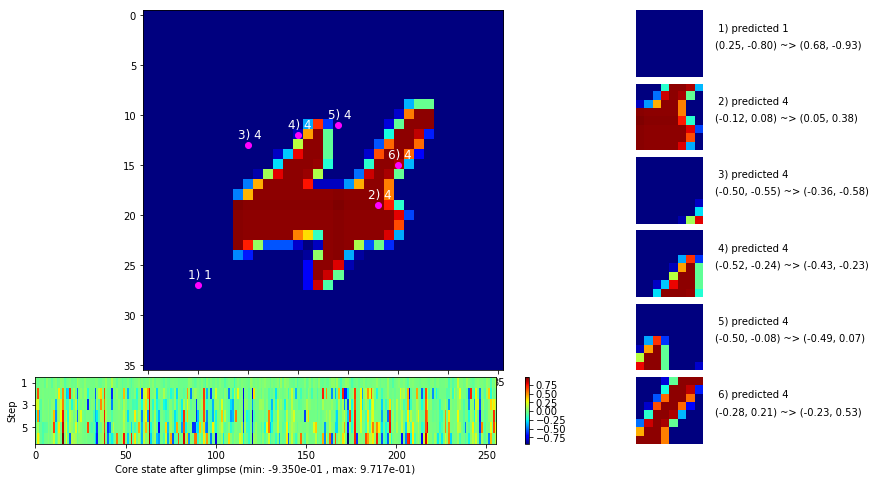

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


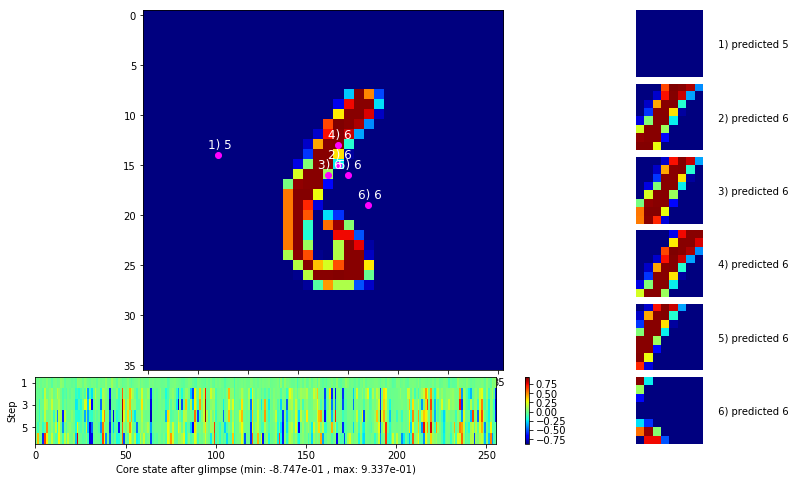


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


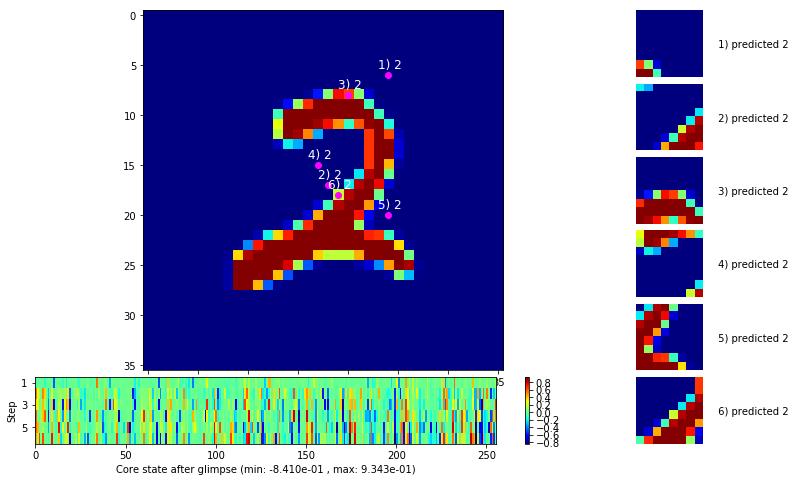

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


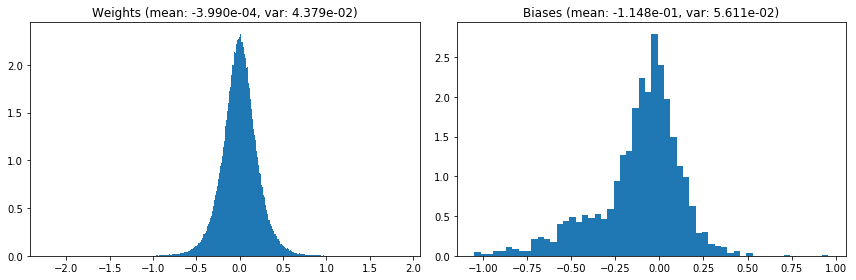

                                      Location network weights and biases


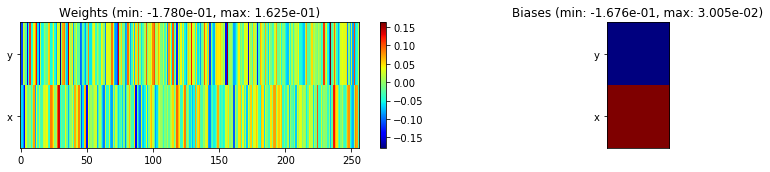

---------------------------------------------------------------------------------------------------------------
Elapsed time:  398.21 sec | TRAIN >> class loss: 0.1421 | steps:  2.100 :( | reward:  0.9558 :( | acc.: 95.580% :(
                          | VAL   >> class loss: 0.1422 | steps:  1.989 :( | reward:  0.9516 :( | acc.: 95.160% :(


Epoch  63/400) lr = 0.0001872
 b    500/  3000 >> 127.2 ms/b | lr: 1.87e-04 | grad 2norm:  3.48 | grad inf norm:  0.996
       Weights || abs max:  2.21 (37837.87) | mean: -4.00e-04 ( 0.13) | var: 4.38e-02 (209736.42)
        Biases || abs max:  1.05 (  427.57) | mean: -1.15e-01 ( 0.40) | var: 5.61e-02 (12881.67)
                  class loss: 0.138 | steps: 2.099 | reward:  0.959 | acc.: 95.90%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.1 ms/b | lr: 1.87e-04 | grad 2norm:  3.84 | grad inf norm:  1.122
       Weights || abs max:  2.21 (25387.64) | mean: -4.08e-04 ( 0.12) 

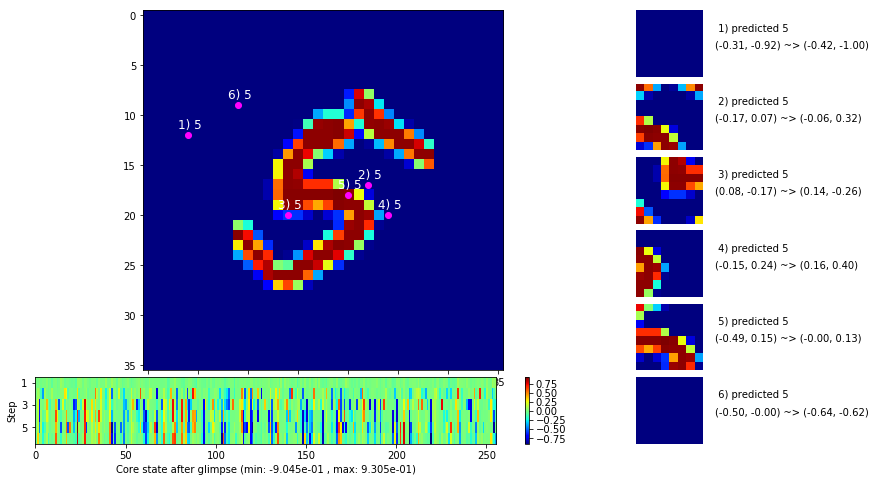

 b   1500/  3000 >> 130.5 ms/b | lr: 1.86e-04 | grad 2norm:  3.71 | grad inf norm:  1.068
       Weights || abs max:  2.21 (26756.39) | mean: -4.09e-04 ( 0.12) | var: 4.38e-02 (25110.25)
        Biases || abs max:  1.06 (  753.46) | mean: -1.15e-01 ( 0.42) | var: 5.62e-02 (43235.94)
                  class loss: 0.155 | steps: 2.116 | reward:  0.953 | acc.: 95.28%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.0 ms/b | lr: 1.86e-04 | grad 2norm:  3.65 | grad inf norm:  1.083
       Weights || abs max:  2.22 (113140.05) | mean: -4.15e-04 ( 0.28) | var: 4.38e-02 (6493799.50)
        Biases || abs max:  1.06 (  375.93) | mean: -1.15e-01 ( 0.30) | var: 5.63e-02 ( 3705.28)
                  class loss: 0.146 | steps: 2.112 | reward:  0.954 | acc.: 95.42%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

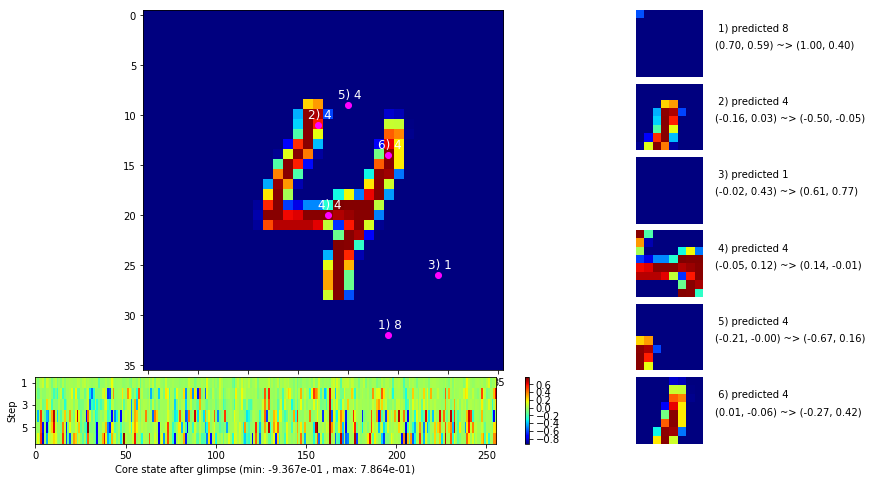

 b   2500/  3000 >> 128.5 ms/b | lr: 1.85e-04 | grad 2norm:  3.71 | grad inf norm:  1.070
       Weights || abs max:  2.22 (33869.90) | mean: -4.15e-04 ( 0.12) | var: 4.38e-02 (59037.56)
        Biases || abs max:  1.05 (  190.25) | mean: -1.15e-01 ( 0.23) | var: 5.63e-02 (  199.83)
                  class loss: 0.146 | steps: 2.090 | reward:  0.955 | acc.: 95.45%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.3 ms/b | lr: 1.85e-04 | grad 2norm:  3.59 | grad inf norm:  1.023
       Weights || abs max:  2.22 (42052.47) | mean: -4.09e-04 ( 0.14) | var: 4.39e-02 (122690.26)
        Biases || abs max:  1.06 (  104.08) | mean: -1.15e-01 ( 0.18) | var: 5.64e-02 (   57.36)
                  class loss: 0.145 | steps: 2.116 | reward:  0.957 | acc.: 95.68%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

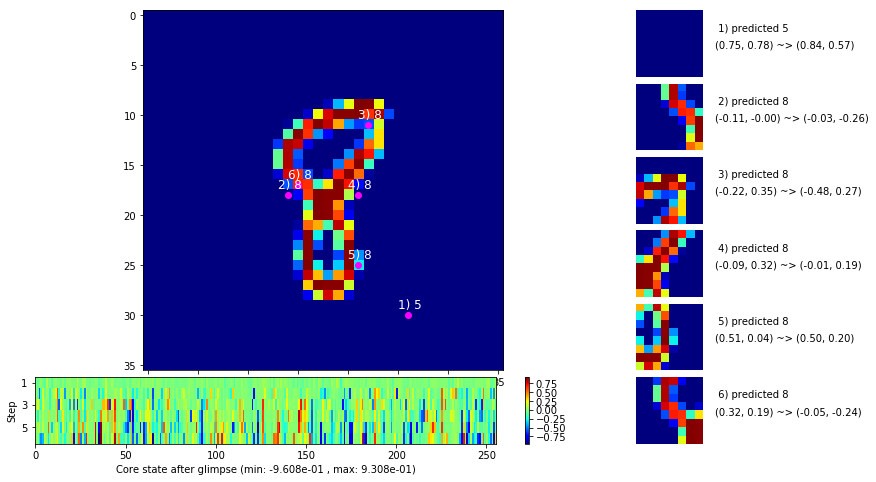

                                          ---===  VALIDATION  ===---

	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


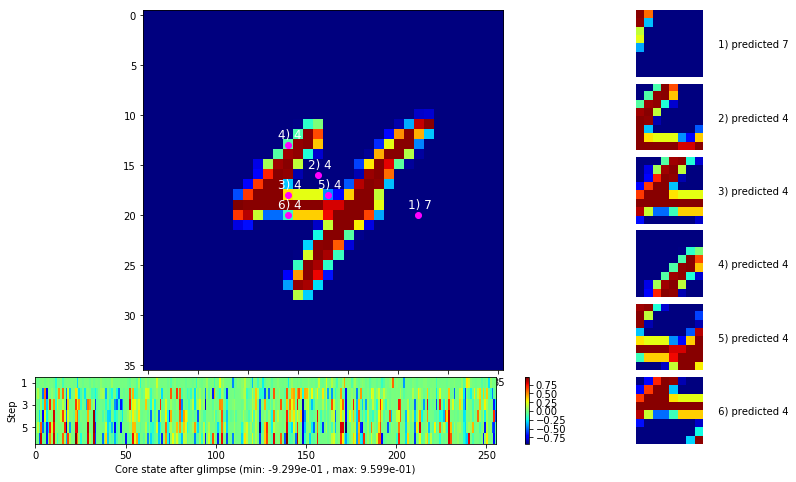


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


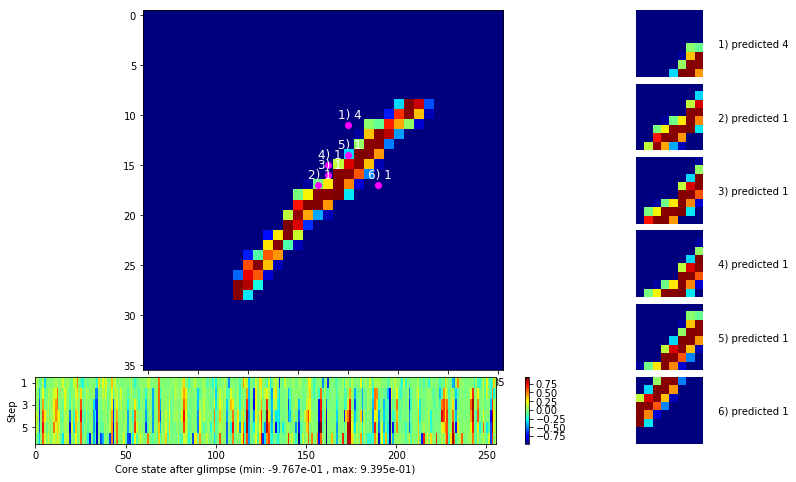

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


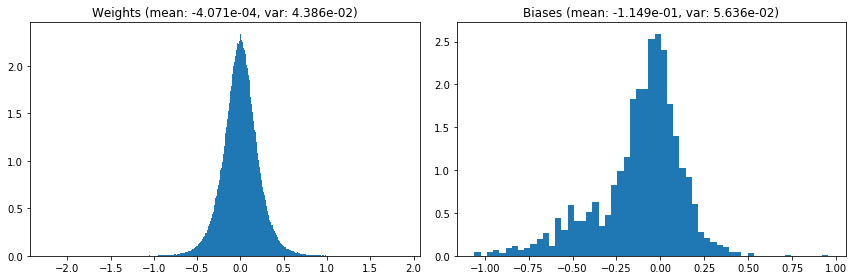

                                      Location network weights and biases


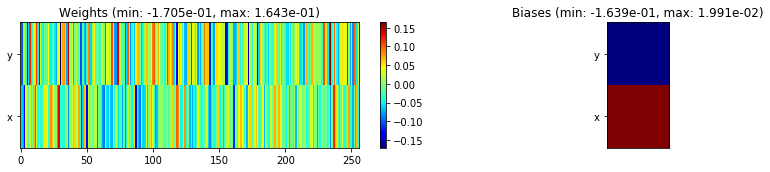

---------------------------------------------------------------------------------------------------------------
Elapsed time:  388.55 sec | TRAIN >> class loss: 0.1468 | steps:  2.107 :( | reward:  0.9547 :( | acc.: 95.468% :(
                          | VAL   >> class loss: 0.1269 | steps:  1.936 :( | reward:  0.9608    | acc.: 96.080% 


Epoch  64/400) lr = 0.0001847
 b    500/  3000 >> 133.0 ms/b | lr: 1.84e-04 | grad 2norm:  3.69 | grad inf norm:  1.075
       Weights || abs max:  2.22 (64006.68) | mean: -3.94e-04 ( 0.18) | var: 4.39e-02 (579553.69)
        Biases || abs max:  1.06 (  615.17) | mean: -1.15e-01 ( 0.42) | var: 5.64e-02 (20749.62)
                  class loss: 0.144 | steps: 2.103 | reward:  0.955 | acc.: 95.50%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 137.8 ms/b | lr: 1.84e-04 | grad 2norm:  3.75 | grad inf norm:  1.049
       Weights || abs max:  2.22 (23391.21) | mean: -3.88e-04 ( 0.11) | 

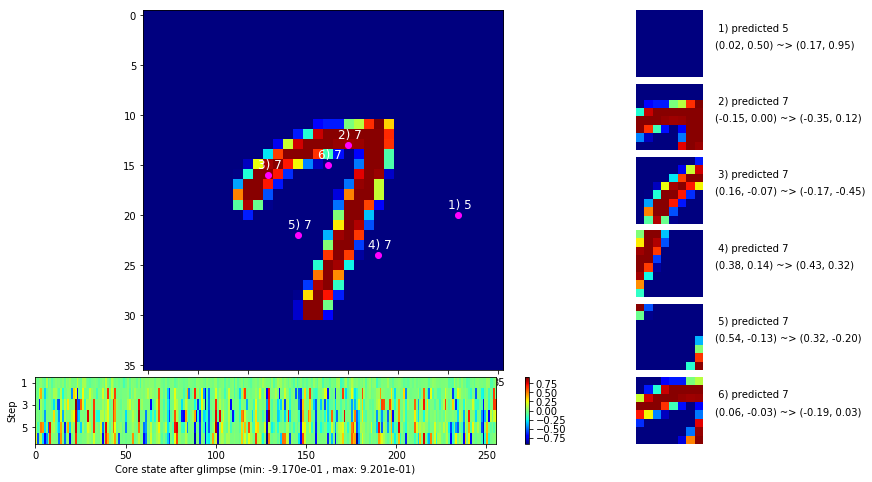

 b   1500/  3000 >> 138.9 ms/b | lr: 1.84e-04 | grad 2norm:  3.57 | grad inf norm:  1.052
       Weights || abs max:  2.22 (27598.95) | mean: -3.97e-04 ( 0.11) | var: 4.39e-02 (16860.60)
        Biases || abs max:  1.06 (  166.56) | mean: -1.15e-01 ( 0.23) | var: 5.63e-02 (  798.12)
                  class loss: 0.139 | steps: 2.099 | reward:  0.957 | acc.: 95.73%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.1 ms/b | lr: 1.83e-04 | grad 2norm:  3.69 | grad inf norm:  1.106
       Weights || abs max:  2.22 (57241.85) | mean: -3.95e-04 ( 0.17) | var: 4.39e-02 (265023.00)
        Biases || abs max:  1.06 (  269.68) | mean: -1.15e-01 ( 0.25) | var: 5.64e-02 (  910.44)
                  class loss: 0.155 | steps: 2.104 | reward:  0.954 | acc.: 95.41%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

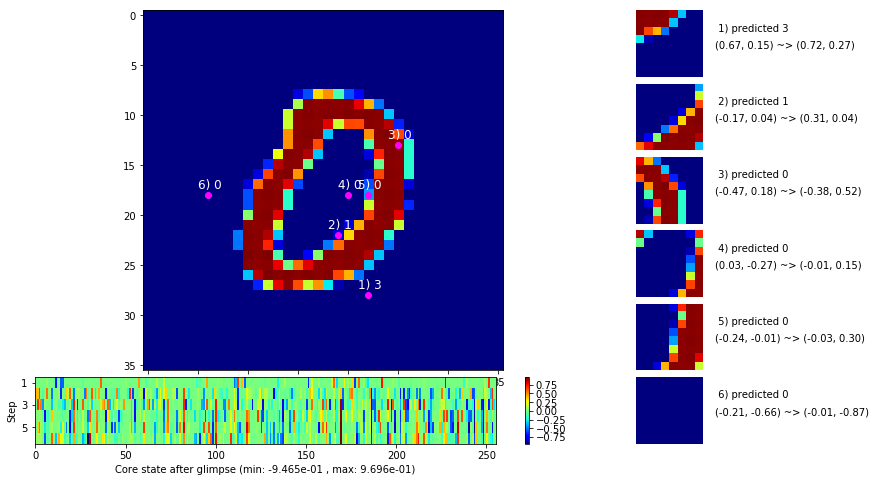

 b   2500/  3000 >> 131.3 ms/b | lr: 1.83e-04 | grad 2norm:  3.64 | grad inf norm:  1.039
       Weights || abs max:  2.22 (102209.66) | mean: -3.85e-04 ( 0.25) | var: 4.39e-02 (4196247.00)
        Biases || abs max:  1.06 (  259.84) | mean: -1.15e-01 ( 0.25) | var: 5.64e-02 (  493.60)
                  class loss: 0.137 | steps: 2.095 | reward:  0.956 | acc.: 95.62%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 133.6 ms/b | lr: 1.82e-04 | grad 2norm:  3.69 | grad inf norm:  1.080
       Weights || abs max:  2.22 (135214.73) | mean: -3.85e-04 ( 0.32) | var: 4.39e-02 (4412361.50)
        Biases || abs max:  1.06 (  199.87) | mean: -1.15e-01 ( 0.25) | var: 5.65e-02 ( 1943.28)
                  class loss: 0.140 | steps: 2.092 | reward:  0.954 | acc.: 95.41%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0

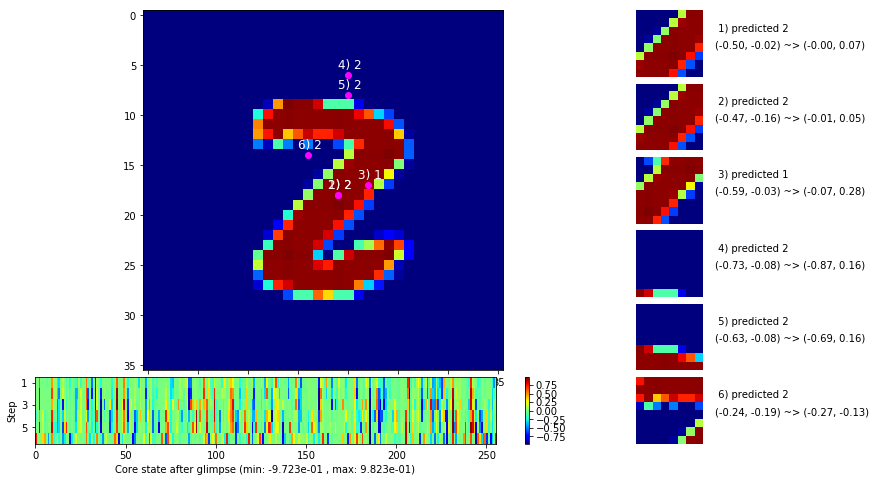

                                          ---===  VALIDATION  ===---

	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


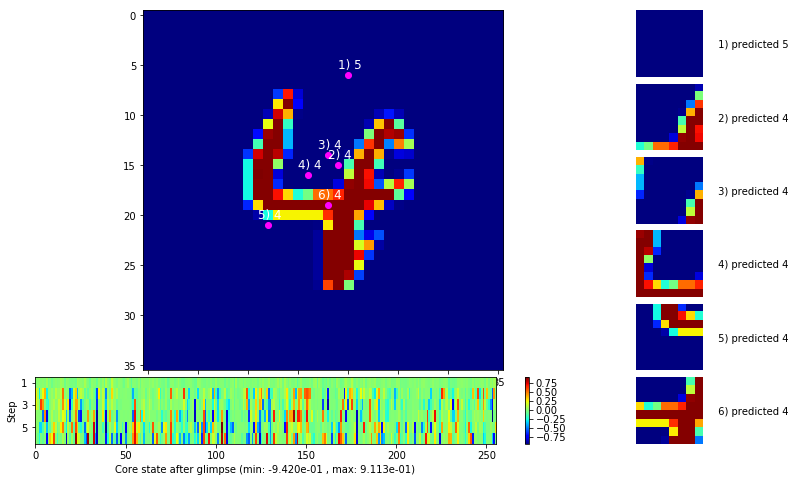


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


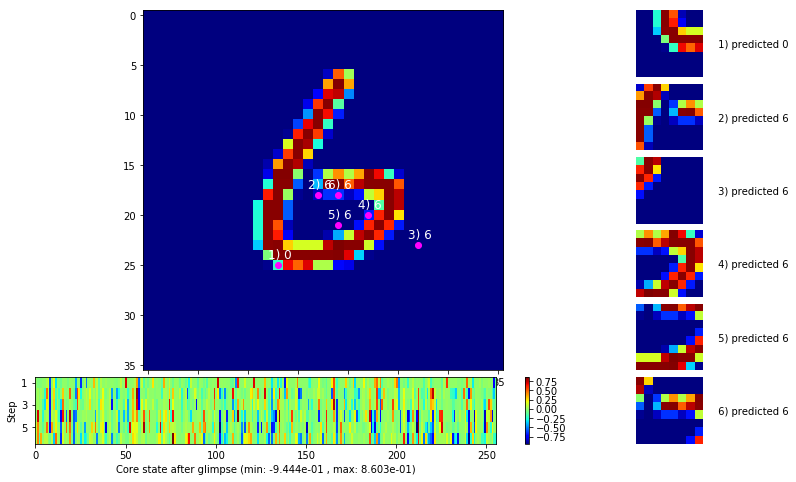

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


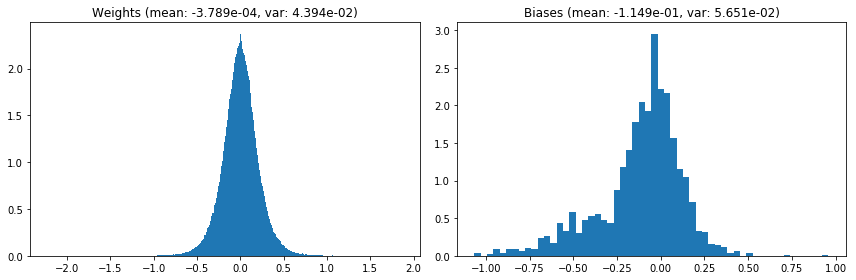

                                      Location network weights and biases


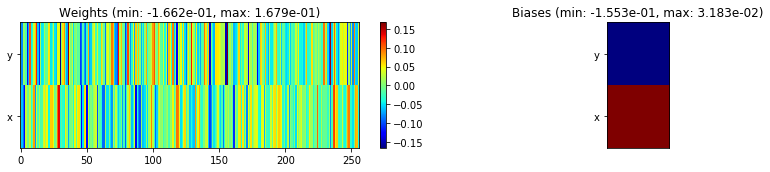

---------------------------------------------------------------------------------------------------------------
Elapsed time:  402.56 sec | TRAIN >> class loss: 0.1427 | steps:  2.101 :( | reward:  0.9552 :( | acc.: 95.517% :(
                          | VAL   >> class loss: 0.1405 | steps:  1.963 :( | reward:  0.9564 :( | acc.: 95.640% :(


Epoch  65/400) lr = 0.0001822
 b    500/  3000 >> 142.6 ms/b | lr: 1.82e-04 | grad 2norm:  3.70 | grad inf norm:  1.061
       Weights || abs max:  2.22 (20582.42) | mean: -3.82e-04 ( 0.10) | var: 4.39e-02 ( 7062.25)
        Biases || abs max:  1.06 (  777.56) | mean: -1.15e-01 ( 0.45) | var: 5.65e-02 (14335.76)
                  class loss: 0.141 | steps: 2.108 | reward:  0.954 | acc.: 95.44%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.8 ms/b | lr: 1.82e-04 | grad 2norm:  3.57 | grad inf norm:  1.026
       Weights || abs max:  2.22 (79577.53) | mean: -3.89e-04 ( 0.21) |

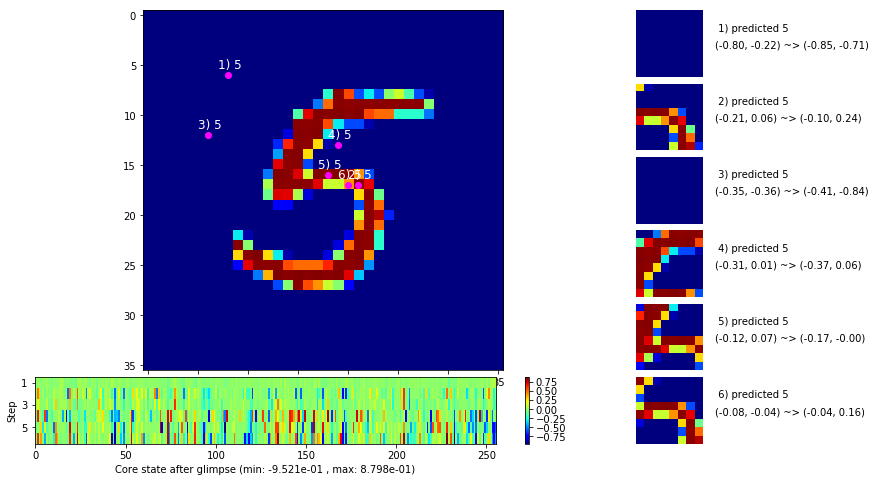

 b   1500/  3000 >> 140.3 ms/b | lr: 1.81e-04 | grad 2norm:  3.62 | grad inf norm:  1.036
       Weights || abs max:  2.22 (38677.11) | mean: -3.96e-04 ( 0.13) | var: 4.40e-02 (154774.70)
        Biases || abs max:  1.06 (  508.47) | mean: -1.15e-01 ( 0.34) | var: 5.65e-02 ( 7553.70)
                  class loss: 0.143 | steps: 2.076 | reward:  0.957 | acc.: 95.68%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 142.1 ms/b | lr: 1.81e-04 | grad 2norm:  3.82 | grad inf norm:  1.098
       Weights || abs max:  2.22 (71123.47) | mean: -4.00e-04 ( 0.19) | var: 4.40e-02 (1038050.25)
        Biases || abs max:  1.05 (  176.43) | mean: -1.15e-01 ( 0.25) | var: 5.66e-02 (  754.19)
                  class loss: 0.152 | steps: 2.100 | reward:  0.952 | acc.: 95.21%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

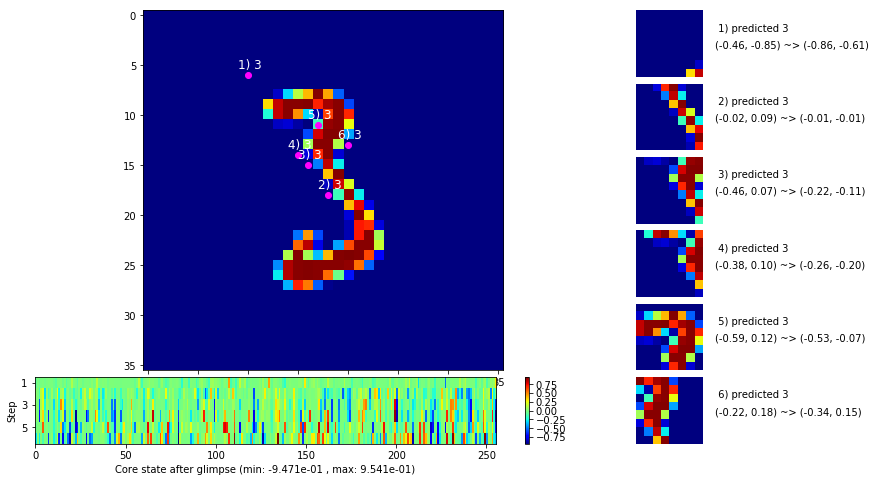

 b   2500/  3000 >> 145.0 ms/b | lr: 1.80e-04 | grad 2norm:  3.45 | grad inf norm:  1.037
       Weights || abs max:  2.22 (19914.44) | mean: -4.02e-04 ( 0.10) | var: 4.40e-02 ( 8472.59)
        Biases || abs max:  1.05 (  642.08) | mean: -1.15e-01 ( 0.43) | var: 5.66e-02 ( 6842.04)
                  class loss: 0.132 | steps: 2.077 | reward:  0.959 | acc.: 95.87%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.6 ms/b | lr: 1.80e-04 | grad 2norm:  3.52 | grad inf norm:  1.062
       Weights || abs max:  2.22 (35576.71) | mean: -4.02e-04 ( 0.12) | var: 4.40e-02 (265545.50)
        Biases || abs max:  1.05 (  157.45) | mean: -1.15e-01 ( 0.21) | var: 5.66e-02 (  103.81)
                  class loss: 0.133 | steps: 2.087 | reward:  0.957 | acc.: 95.73%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

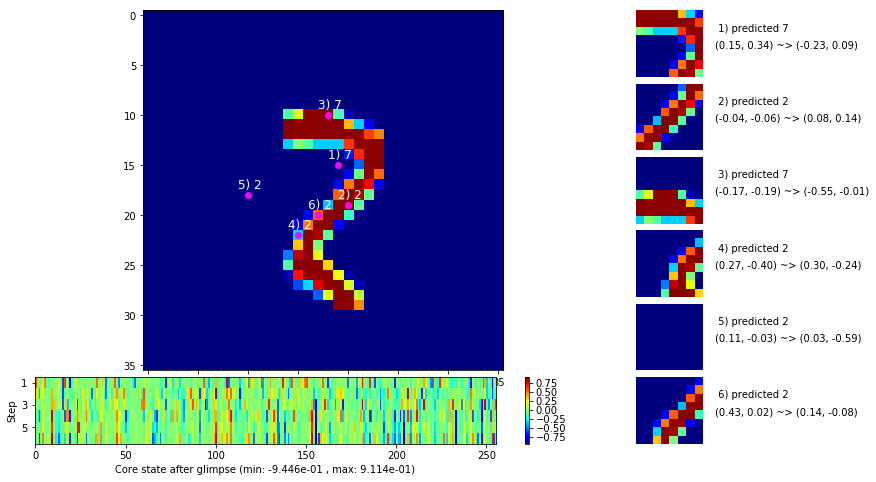

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


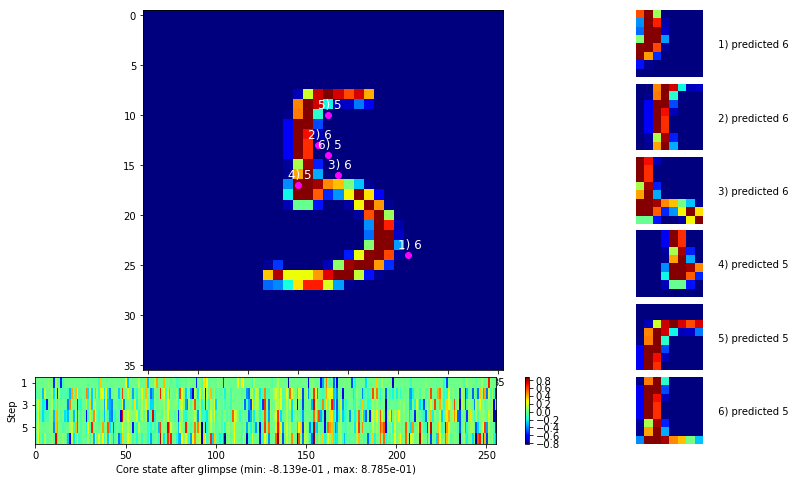


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


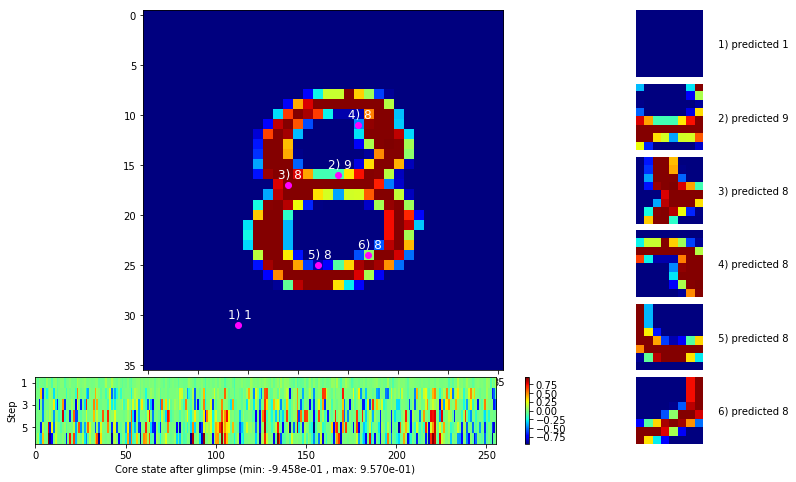

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


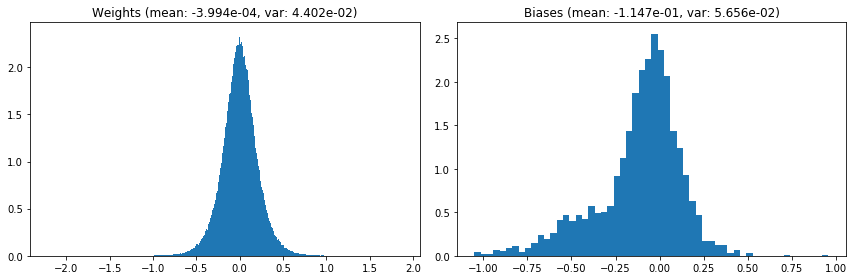

                                      Location network weights and biases


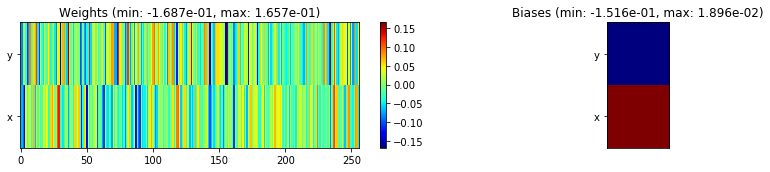

---------------------------------------------------------------------------------------------------------------
Elapsed time:  421.46 sec | TRAIN >> class loss: 0.1392 | steps:  2.088 :( | reward:  0.9561    | acc.: 95.608% 
                          | VAL   >> class loss: 0.1304 | steps:  1.943 :( | reward:  0.9588 :( | acc.: 95.880% :(


Epoch  66/400) lr = 0.0001798
 b    500/  3000 >> 133.7 ms/b | lr: 1.80e-04 | grad 2norm:  3.68 | grad inf norm:  1.064
       Weights || abs max:  2.21 (56935.19) | mean: -4.07e-04 ( 0.17) | var: 4.40e-02 (281399.22)
        Biases || abs max:  1.05 (  279.75) | mean: -1.15e-01 ( 0.28) | var: 5.65e-02 (  300.38)
                  class loss: 0.143 | steps: 2.081 | reward:  0.955 | acc.: 95.52%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.2 ms/b | lr: 1.79e-04 | grad 2norm:  3.58 | grad inf norm:  1.065
       Weights || abs max:  2.21 (74086.35) | mean: -4.04e-04 ( 0.20) | 

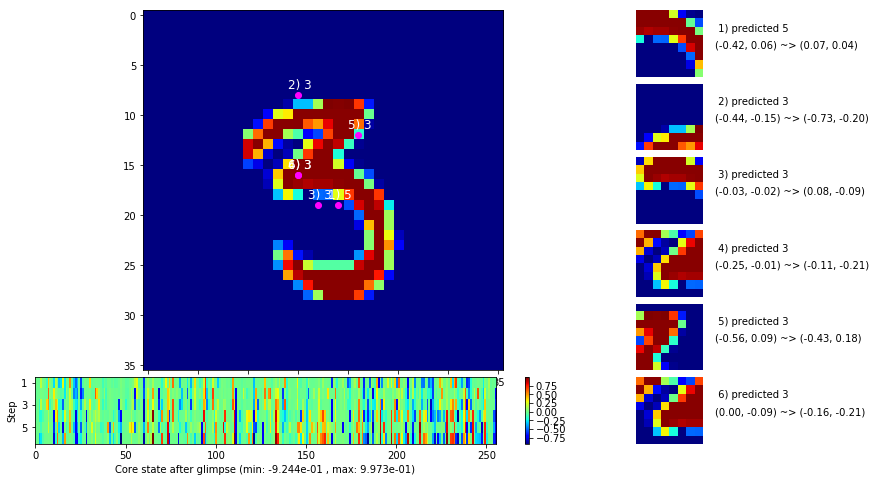

 b   1500/  3000 >> 131.1 ms/b | lr: 1.79e-04 | grad 2norm:  3.48 | grad inf norm:  1.028
       Weights || abs max:  2.21 (33765.21) | mean: -3.99e-04 ( 0.12) | var: 4.41e-02 (53467.29)
        Biases || abs max:  1.05 (  464.63) | mean: -1.15e-01 ( 0.41) | var: 5.66e-02 (18063.79)
                  class loss: 0.136 | steps: 2.103 | reward:  0.958 | acc.: 95.80%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.9 ms/b | lr: 1.78e-04 | grad 2norm:  3.50 | grad inf norm:  1.037
       Weights || abs max:  2.21 (22376.75) | mean: -3.98e-04 ( 0.10) | var: 4.41e-02 (20110.62)
        Biases || abs max:  1.04 (  143.24) | mean: -1.15e-01 ( 0.21) | var: 5.67e-02 (  737.71)
                  class loss: 0.136 | steps: 2.083 | reward:  0.958 | acc.: 95.84%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

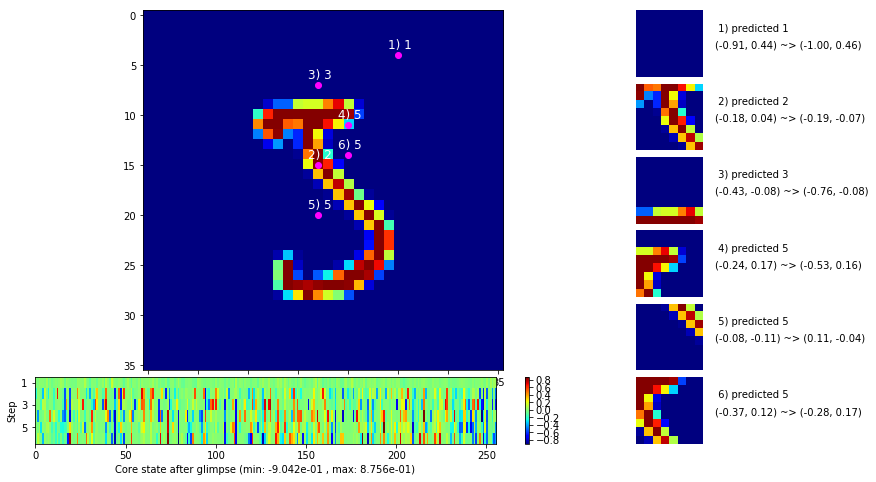

 b   2500/  3000 >> 134.3 ms/b | lr: 1.78e-04 | grad 2norm:  3.77 | grad inf norm:  1.054
       Weights || abs max:  2.21 (26653.45) | mean: -4.07e-04 ( 0.12) | var: 4.41e-02 (20520.59)
        Biases || abs max:  1.05 (  207.76) | mean: -1.15e-01 ( 0.27) | var: 5.67e-02 ( 1645.59)
                  class loss: 0.138 | steps: 2.086 | reward:  0.953 | acc.: 95.34%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 131.9 ms/b | lr: 1.78e-04 | grad 2norm:  3.71 | grad inf norm:  1.057
       Weights || abs max:  2.22 (21266.98) | mean: -4.09e-04 ( 0.10) | var: 4.41e-02 ( 9040.44)
        Biases || abs max:  1.05 ( 2812.76) | mean: -1.15e-01 ( 2.29) | var: 5.67e-02 (2842239.00)
                  class loss: 0.136 | steps: 2.103 | reward:  0.954 | acc.: 95.43%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

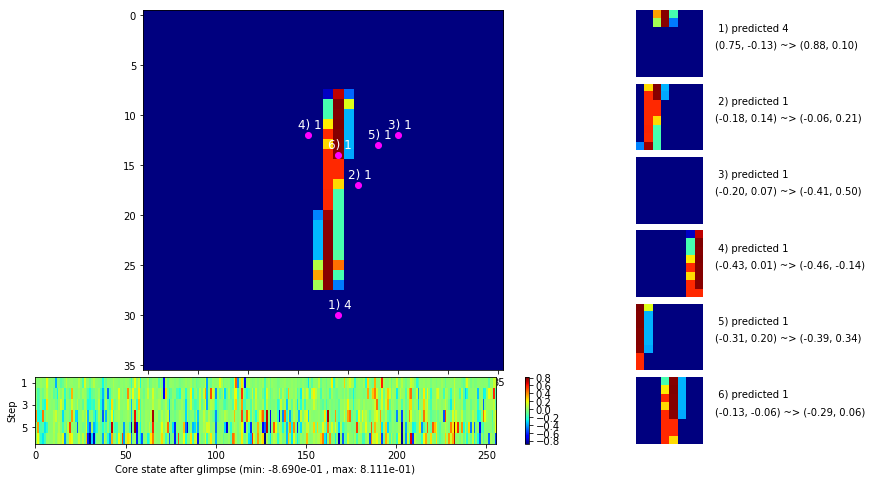

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


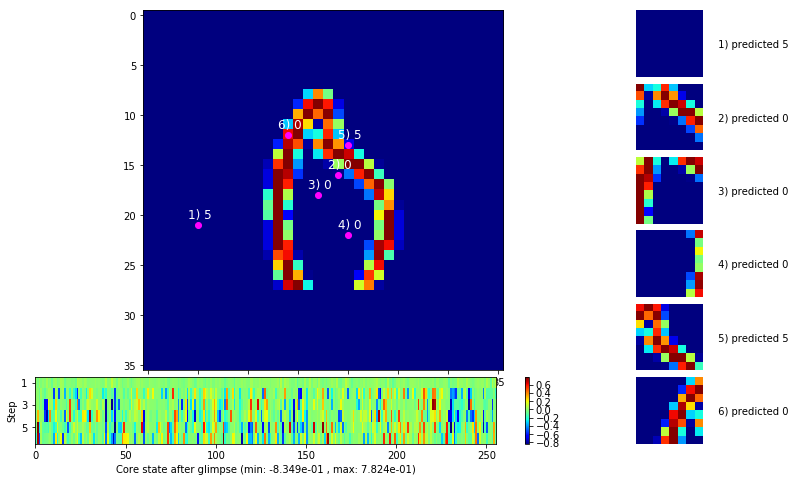


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


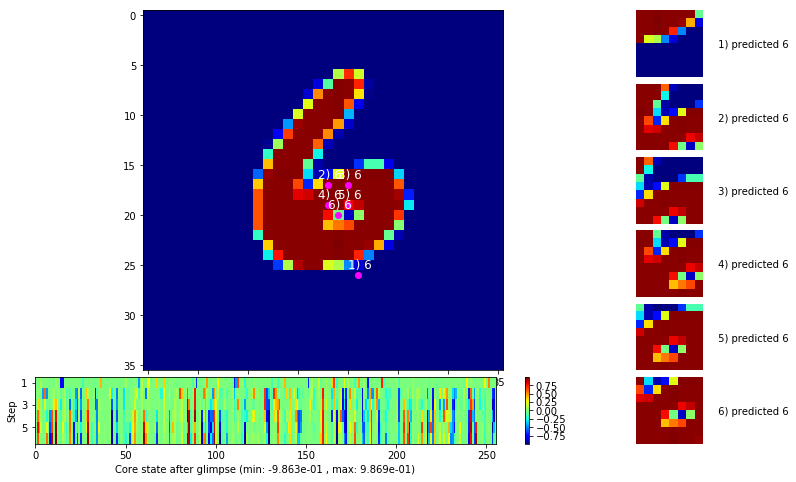

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


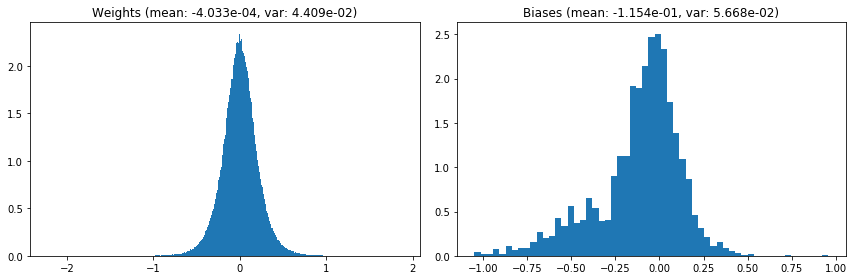

                                      Location network weights and biases


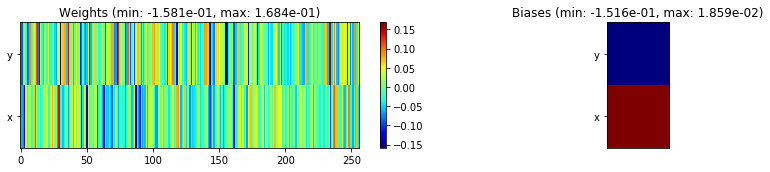

---------------------------------------------------------------------------------------------------------------
Elapsed time:  395.62 sec | TRAIN >> class loss: 0.1382 | steps:  2.093 :( | reward:  0.9559 :( | acc.: 95.593% :(
                          | VAL   >> class loss: 0.1402 | steps:  1.973 :( | reward:  0.9530 :( | acc.: 95.300% :(


Epoch  67/400) lr = 0.0001775
 b    500/  3000 >> 146.3 ms/b | lr: 1.77e-04 | grad 2norm:  3.44 | grad inf norm:  1.031
       Weights || abs max:  2.22 (34744.40) | mean: -4.09e-04 ( 0.13) | var: 4.41e-02 (39778.15)
        Biases || abs max:  1.05 (  329.88) | mean: -1.16e-01 ( 0.27) | var: 5.67e-02 ( 2432.89)
                  class loss: 0.137 | steps: 2.085 | reward:  0.959 | acc.: 95.87%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 132.0 ms/b | lr: 1.77e-04 | grad 2norm:  3.50 | grad inf norm:  1.016
       Weights || abs max:  2.23 (24402.30) | mean: -4.16e-04 ( 0.10) |

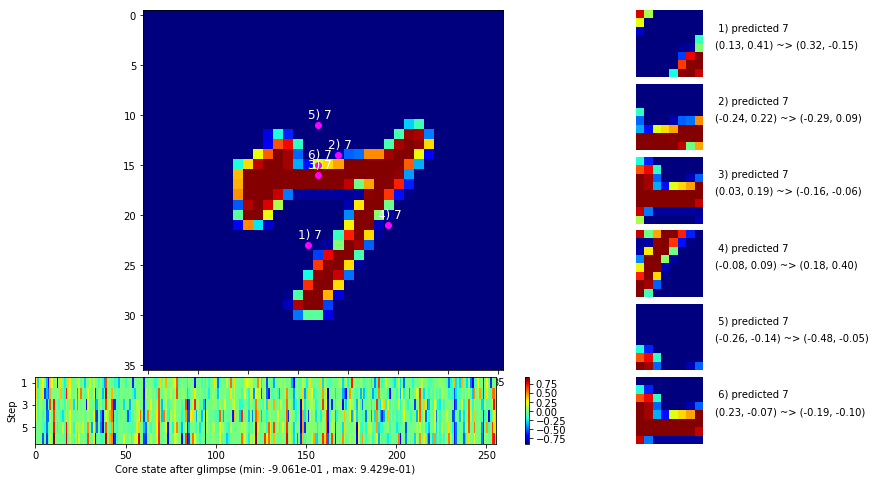

 b   1500/  3000 >> 132.4 ms/b | lr: 1.76e-04 | grad 2norm:  3.66 | grad inf norm:  1.086
       Weights || abs max:  2.23 (54849.50) | mean: -4.21e-04 ( 0.16) | var: 4.41e-02 (574029.25)
        Biases || abs max:  1.05 (  282.55) | mean: -1.16e-01 ( 0.27) | var: 5.67e-02 ( 3092.80)
                  class loss: 0.141 | steps: 2.086 | reward:  0.954 | acc.: 95.39%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 131.9 ms/b | lr: 1.76e-04 | grad 2norm:  3.56 | grad inf norm:  1.035
       Weights || abs max:  2.23 (26386.87) | mean: -4.32e-04 ( 0.11) | var: 4.41e-02 (13428.05)
        Biases || abs max:  1.05 (  123.45) | mean: -1.15e-01 ( 0.18) | var: 5.66e-02 (   58.04)
                  class loss: 0.134 | steps: 2.090 | reward:  0.956 | acc.: 95.59%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

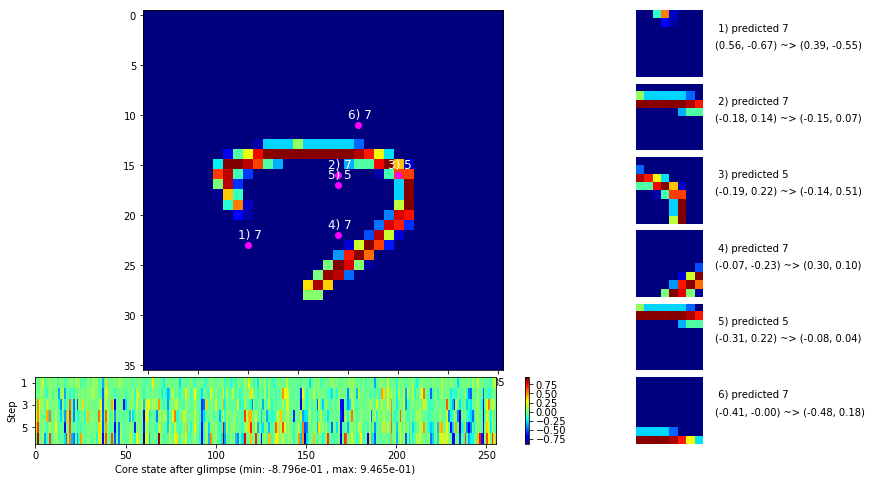

 b   2500/  3000 >> 130.7 ms/b | lr: 1.76e-04 | grad 2norm:  3.64 | grad inf norm:  1.074
       Weights || abs max:  2.23 (35959.41) | mean: -4.42e-04 ( 0.13) | var: 4.42e-02 (68958.45)
        Biases || abs max:  1.06 (  196.90) | mean: -1.15e-01 ( 0.22) | var: 5.67e-02 (  414.60)
                  class loss: 0.136 | steps: 2.092 | reward:  0.956 | acc.: 95.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 131.3 ms/b | lr: 1.75e-04 | grad 2norm:  3.53 | grad inf norm:  1.027
       Weights || abs max:  2.24 (40042.62) | mean: -4.41e-04 ( 0.14) | var: 4.42e-02 (54793.33)
        Biases || abs max:  1.05 (  154.78) | mean: -1.15e-01 ( 0.20) | var: 5.68e-02 (  148.68)
                  class loss: 0.138 | steps: 2.098 | reward:  0.958 | acc.: 95.75%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

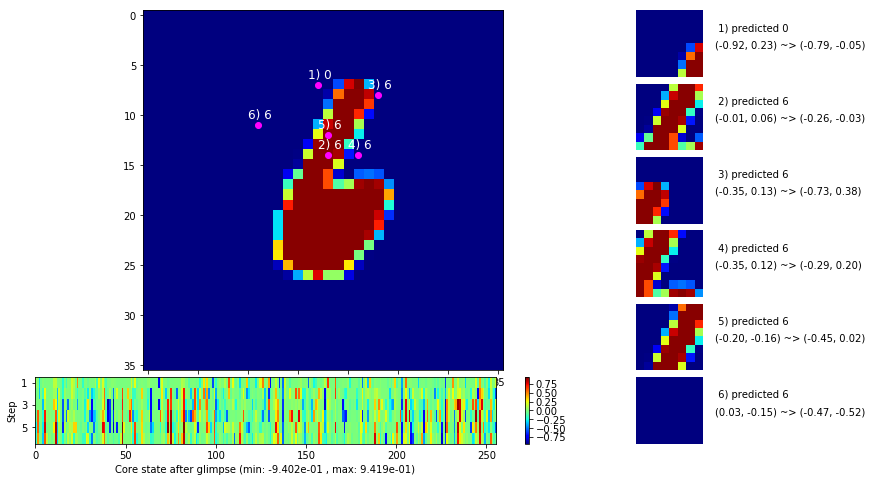

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


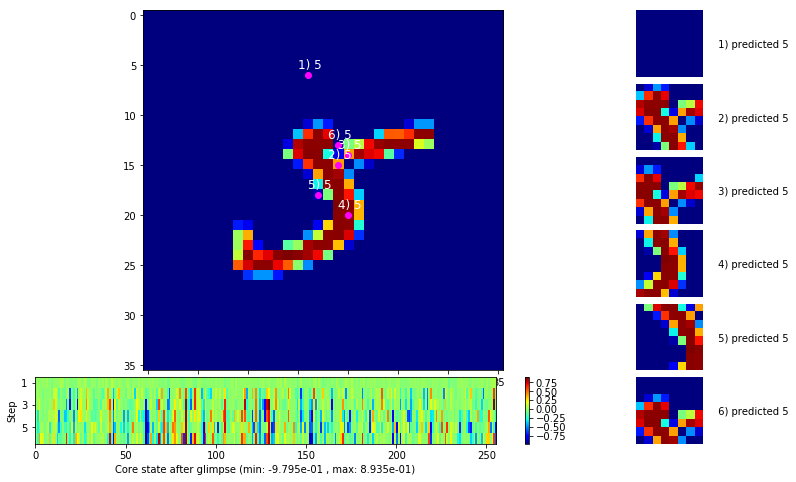


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


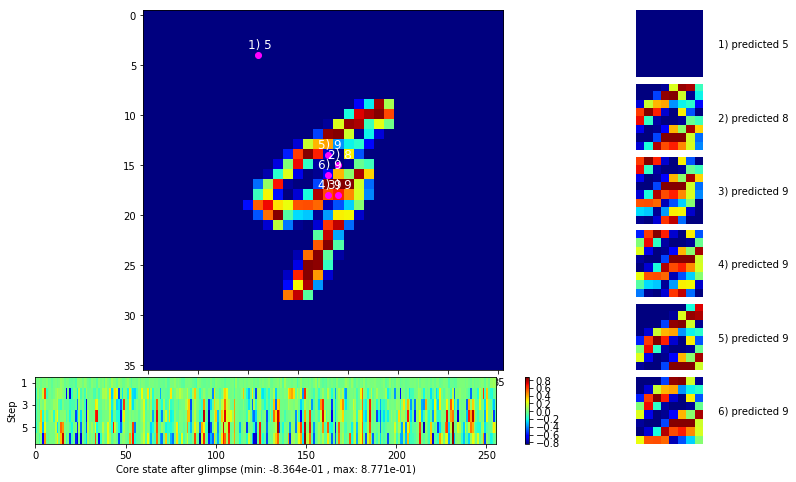

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


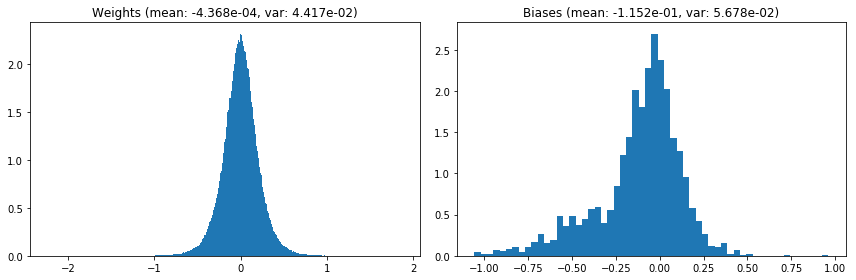

                                      Location network weights and biases


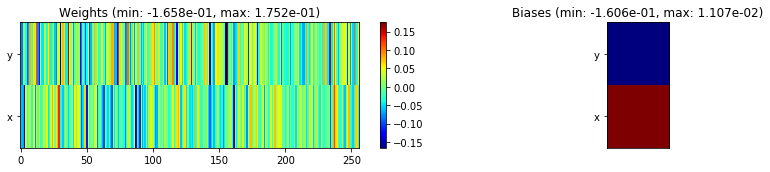

---------------------------------------------------------------------------------------------------------------
Elapsed time:  403.09 sec | TRAIN >> class loss: 0.1386 | steps:  2.093 :( | reward:  0.9565    | acc.: 95.653% 
                          | VAL   >> class loss: 0.1438 | steps:  1.927 :( | reward:  0.9556 :( | acc.: 95.560% :(


Epoch  68/400) lr = 0.0001753
 b    500/  3000 >> 128.8 ms/b | lr: 1.75e-04 | grad 2norm:  3.59 | grad inf norm:  1.044
       Weights || abs max:  2.24 (105851.32) | mean: -4.37e-04 ( 0.26) | var: 4.42e-02 (5731705.50)
        Biases || abs max:  1.05 (  466.22) | mean: -1.15e-01 ( 0.43) | var: 5.68e-02 (29042.90)
                  class loss: 0.138 | steps: 2.094 | reward:  0.956 | acc.: 95.64%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 134.0 ms/b | lr: 1.75e-04 | grad 2norm:  3.42 | grad inf norm:  0.998
       Weights || abs max:  2.23 (62555.28) | mean: -4.37e-04 ( 0.18) 

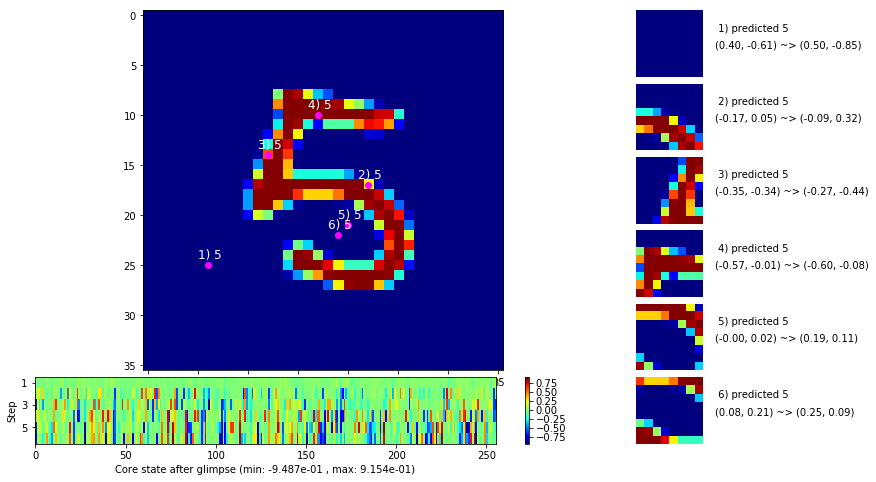

 b   1500/  3000 >> 146.3 ms/b | lr: 1.74e-04 | grad 2norm:  3.41 | grad inf norm:  0.979
       Weights || abs max:  2.23 (161060.50) | mean: -4.45e-04 ( 0.37) | var: 4.42e-02 (15788423.00)
        Biases || abs max:  1.06 (   84.88) | mean: -1.15e-01 ( 0.15) | var: 5.68e-02 (   53.29)
                  class loss: 0.132 | steps: 2.090 | reward:  0.960 | acc.: 96.02%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.6 ms/b | lr: 1.74e-04 | grad 2norm:  3.63 | grad inf norm:  1.055
       Weights || abs max:  2.23 (48326.86) | mean: -4.50e-04 ( 0.16) | var: 4.42e-02 (190860.70)
        Biases || abs max:  1.05 (  182.92) | mean: -1.15e-01 ( 0.22) | var: 5.69e-02 (  349.18)
                  class loss: 0.141 | steps: 2.110 | reward:  0.955 | acc.: 95.52%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

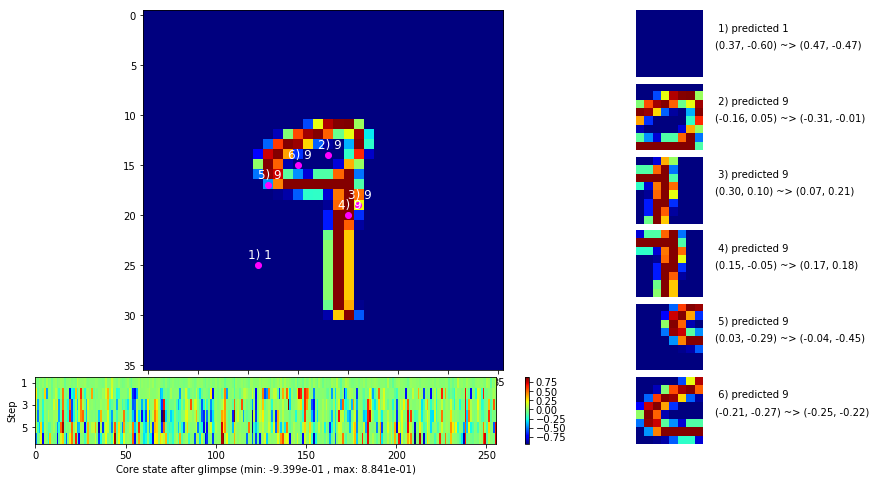

 b   2500/  3000 >> 131.1 ms/b | lr: 1.73e-04 | grad 2norm:  3.67 | grad inf norm:  1.033
       Weights || abs max:  2.23 (66328.34) | mean: -4.63e-04 ( 0.19) | var: 4.42e-02 (1123628.00)
        Biases || abs max:  1.05 (  161.82) | mean: -1.15e-01 ( 0.21) | var: 5.69e-02 (   89.55)
                  class loss: 0.140 | steps: 2.095 | reward:  0.955 | acc.: 95.49%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 128.1 ms/b | lr: 1.73e-04 | grad 2norm:  3.61 | grad inf norm:  1.080
       Weights || abs max:  2.23 (109511.16) | mean: -4.65e-04 ( 0.27) | var: 4.42e-02 (1444539.62)
        Biases || abs max:  1.05 ( 2253.83) | mean: -1.15e-01 ( 1.03) | var: 5.70e-02 (775425.75)
                  class loss: 0.140 | steps: 2.082 | reward:  0.955 | acc.: 95.54%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0

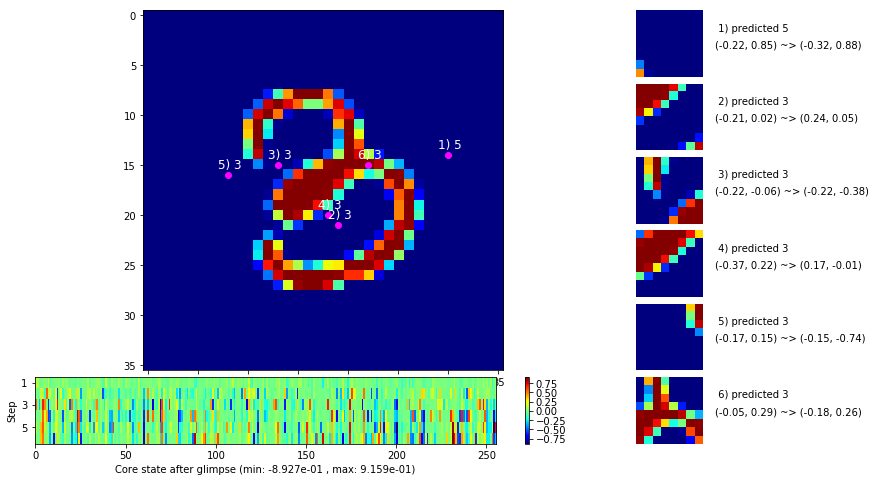

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


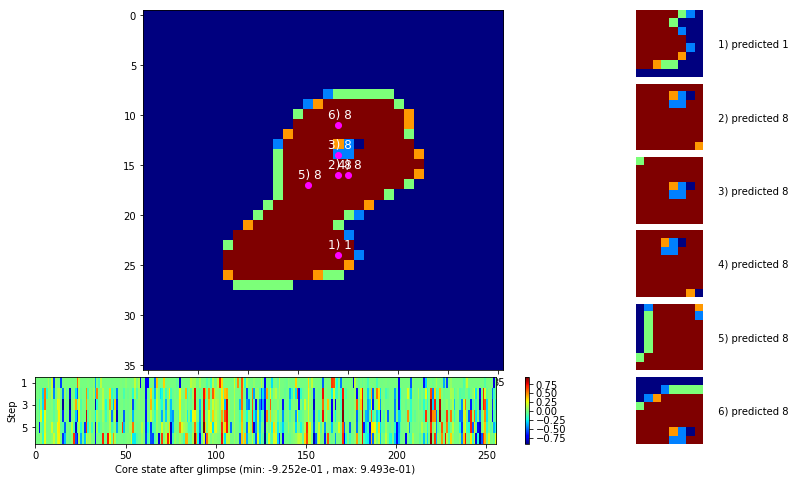


	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


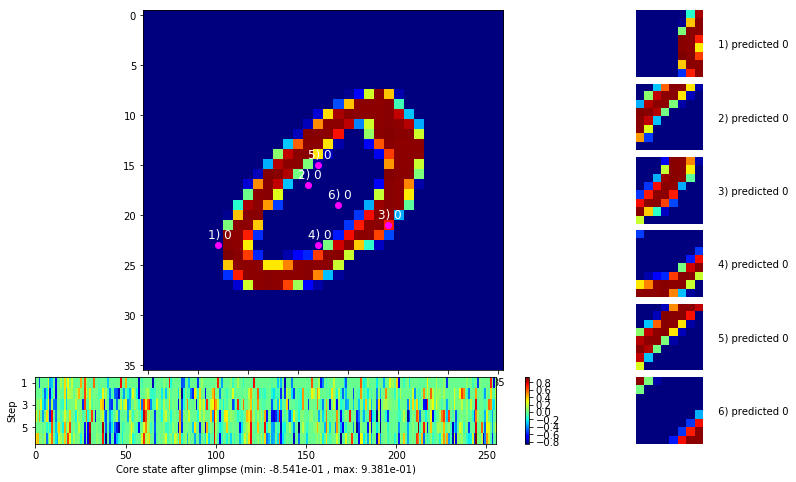

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


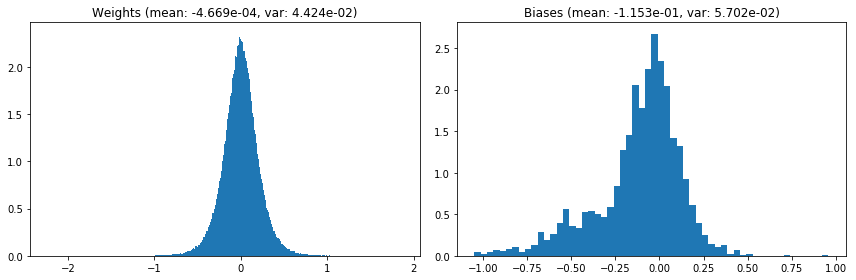

                                      Location network weights and biases


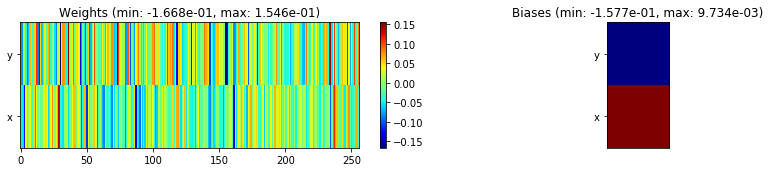

---------------------------------------------------------------------------------------------------------------
Elapsed time:  399.56 sec | TRAIN >> class loss: 0.1356 | steps:  2.092 :( | reward:  0.9570    | acc.: 95.697% 
                          | VAL   >> class loss: 0.1469 | steps:  1.962 :( | reward:  0.9516 :( | acc.: 95.160% :(


Epoch  69/400) lr = 0.0001731
 b    500/  3000 >> 130.1 ms/b | lr: 1.73e-04 | grad 2norm:  3.52 | grad inf norm:  1.042
       Weights || abs max:  2.23 (40349.38) | mean: -4.75e-04 ( 0.14) | var: 4.42e-02 (207525.59)
        Biases || abs max:  1.05 (  349.96) | mean: -1.15e-01 ( 0.28) | var: 5.70e-02 ( 3081.77)
                  class loss: 0.132 | steps: 2.097 | reward:  0.957 | acc.: 95.73%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 127.8 ms/b | lr: 1.72e-04 | grad 2norm:  3.34 | grad inf norm:  0.979
       Weights || abs max:  2.23 (22451.90) | mean: -4.86e-04 ( 0.10) | 

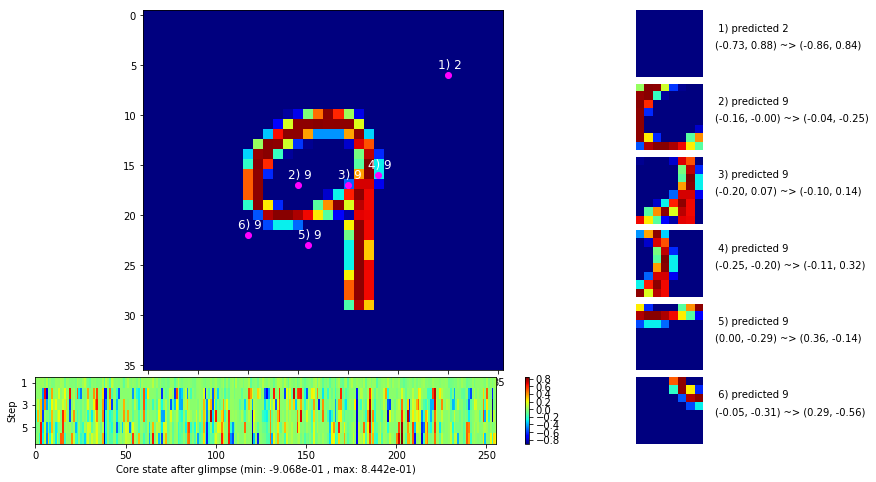

 b   1500/  3000 >> 131.6 ms/b | lr: 1.72e-04 | grad 2norm:  3.69 | grad inf norm:  1.083
       Weights || abs max:  2.24 (22649.79) | mean: -4.89e-04 ( 0.11) | var: 4.43e-02 ( 8894.30)
        Biases || abs max:  1.06 (  273.57) | mean: -1.16e-01 ( 0.27) | var: 5.70e-02 ( 1013.34)
                  class loss: 0.151 | steps: 2.098 | reward:  0.954 | acc.: 95.44%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.4 ms/b | lr: 1.72e-04 | grad 2norm:  3.69 | grad inf norm:  1.102
       Weights || abs max:  2.24 (64070.43) | mean: -4.87e-04 ( 0.18) | var: 4.43e-02 (2031765.00)
        Biases || abs max:  1.05 (  189.87) | mean: -1.16e-01 ( 0.24) | var: 5.71e-02 (  445.15)
                  class loss: 0.146 | steps: 2.089 | reward:  0.953 | acc.: 95.33%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

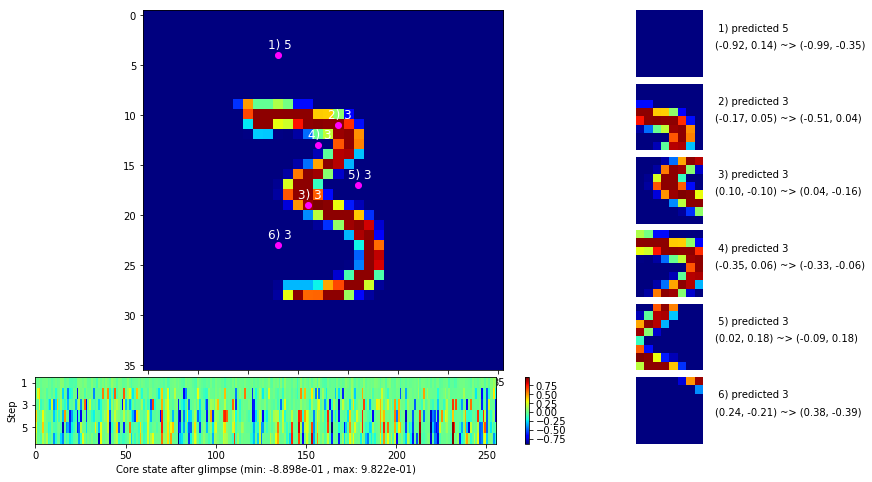

 b   2500/  3000 >> 135.8 ms/b | lr: 1.71e-04 | grad 2norm:  3.47 | grad inf norm:  1.025
       Weights || abs max:  2.24 (38497.82) | mean: -4.95e-04 ( 0.13) | var: 4.43e-02 (219047.77)
        Biases || abs max:  1.05 (  281.55) | mean: -1.16e-01 ( 0.28) | var: 5.72e-02 (  321.70)
                  class loss: 0.135 | steps: 2.110 | reward:  0.958 | acc.: 95.83%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.4 ms/b | lr: 1.71e-04 | grad 2norm:  3.52 | grad inf norm:  1.045
       Weights || abs max:  2.24 (47182.28) | mean: -4.88e-04 ( 0.15) | var: 4.43e-02 (247063.00)
        Biases || abs max:  1.05 ( 1404.14) | mean: -1.15e-01 ( 0.98) | var: 5.71e-02 (160271.92)
                  class loss: 0.135 | steps: 2.076 | reward:  0.956 | acc.: 95.62%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

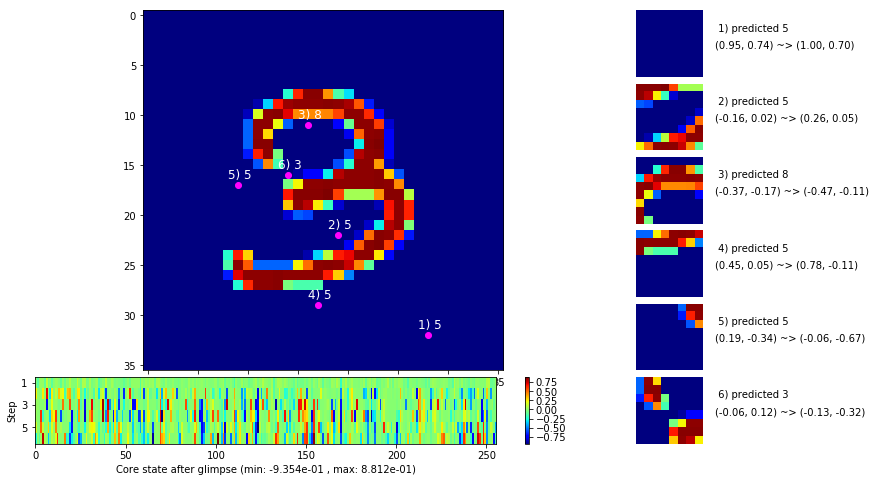

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


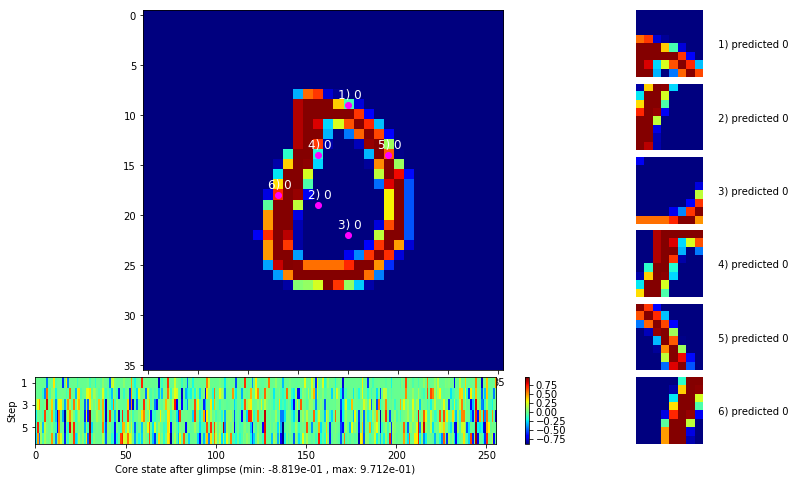


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


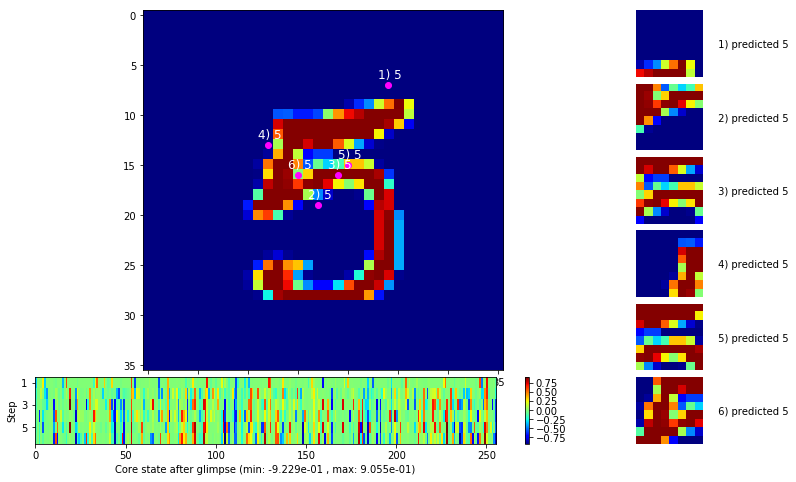

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


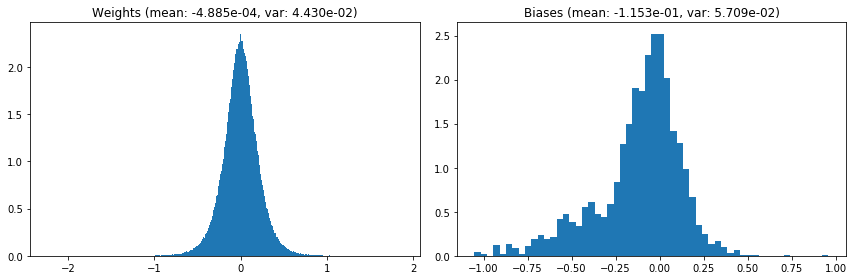

                                      Location network weights and biases


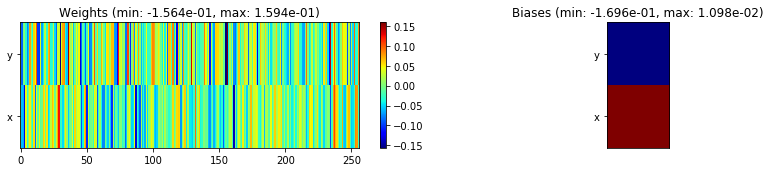

---------------------------------------------------------------------------------------------------------------
Elapsed time:  398.32 sec | TRAIN >> class loss: 0.1377 | steps:  2.094 :( | reward:  0.9568 :( | acc.: 95.677% :(
                          | VAL   >> class loss: 0.1413 | steps:  1.951 :( | reward:  0.9562 :( | acc.: 95.620% :(


Epoch  70/400) lr = 0.0001709
 b    500/  3000 >> 126.4 ms/b | lr: 1.71e-04 | grad 2norm:  3.50 | grad inf norm:  1.045
       Weights || abs max:  2.24 (30206.34) | mean: -4.92e-04 ( 0.11) | var: 4.43e-02 (73652.75)
        Biases || abs max:  1.05 (  524.55) | mean: -1.15e-01 ( 0.38) | var: 5.71e-02 ( 7940.80)
                  class loss: 0.140 | steps: 2.103 | reward:  0.957 | acc.: 95.70%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.2 ms/b | lr: 1.70e-04 | grad 2norm:  3.73 | grad inf norm:  1.097
       Weights || abs max:  2.24 (103956.29) | mean: -4.99e-04 ( 0.26) 

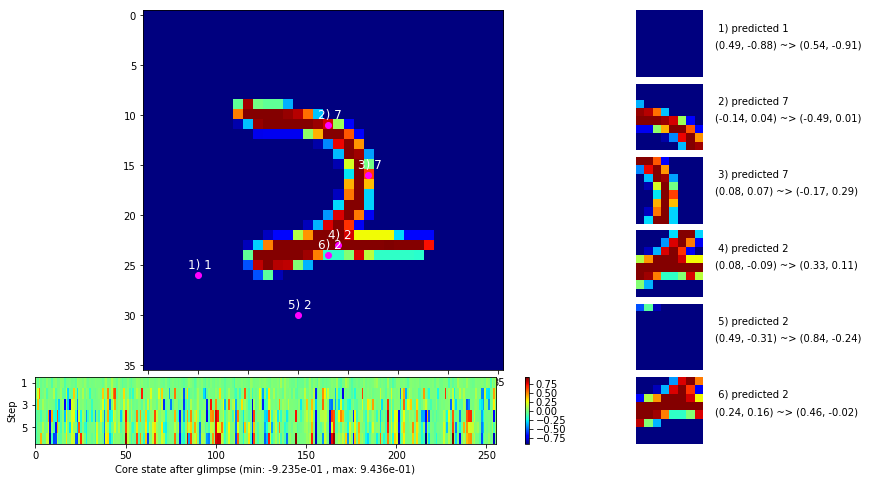

 b   1500/  3000 >> 129.8 ms/b | lr: 1.70e-04 | grad 2norm:  3.63 | grad inf norm:  1.072
       Weights || abs max:  2.25 (31540.27) | mean: -5.03e-04 ( 0.12) | var: 4.43e-02 (70129.54)
        Biases || abs max:  1.05 (  404.65) | mean: -1.16e-01 ( 0.36) | var: 5.71e-02 ( 4667.91)
                  class loss: 0.145 | steps: 2.089 | reward:  0.955 | acc.: 95.54%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 131.6 ms/b | lr: 1.70e-04 | grad 2norm:  3.56 | grad inf norm:  1.098
       Weights || abs max:  2.25 (22050.59) | mean: -4.99e-04 ( 0.10) | var: 4.43e-02 ( 9639.07)
        Biases || abs max:  1.05 ( 1407.06) | mean: -1.16e-01 ( 0.77) | var: 5.71e-02 (105219.34)
                  class loss: 0.135 | steps: 2.087 | reward:  0.956 | acc.: 95.63%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

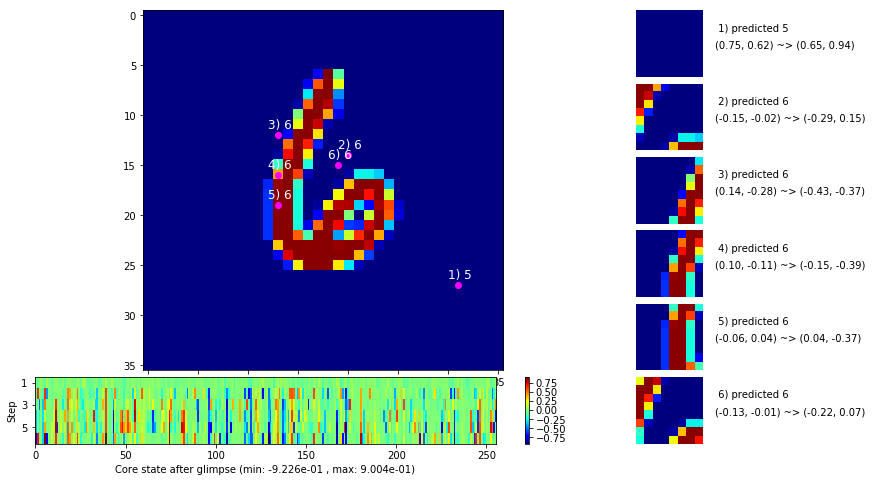

 b   2500/  3000 >> 128.9 ms/b | lr: 1.69e-04 | grad 2norm:  3.69 | grad inf norm:  1.093
       Weights || abs max:  2.26 (29892.30) | mean: -4.92e-04 ( 0.13) | var: 4.44e-02 (28947.83)
        Biases || abs max:  1.05 (  396.53) | mean: -1.16e-01 ( 0.35) | var: 5.71e-02 (  746.02)
                  class loss: 0.141 | steps: 2.096 | reward:  0.954 | acc.: 95.40%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 129.7 ms/b | lr: 1.69e-04 | grad 2norm:  3.64 | grad inf norm:  1.053
       Weights || abs max:  2.26 (442439.84) | mean: -4.92e-04 ( 0.88) | var: 4.44e-02 (159892016.00)
        Biases || abs max:  1.05 (  284.46) | mean: -1.16e-01 ( 0.27) | var: 5.71e-02 (  984.30)
                  class loss: 0.142 | steps: 2.081 | reward:  0.956 | acc.: 95.59%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

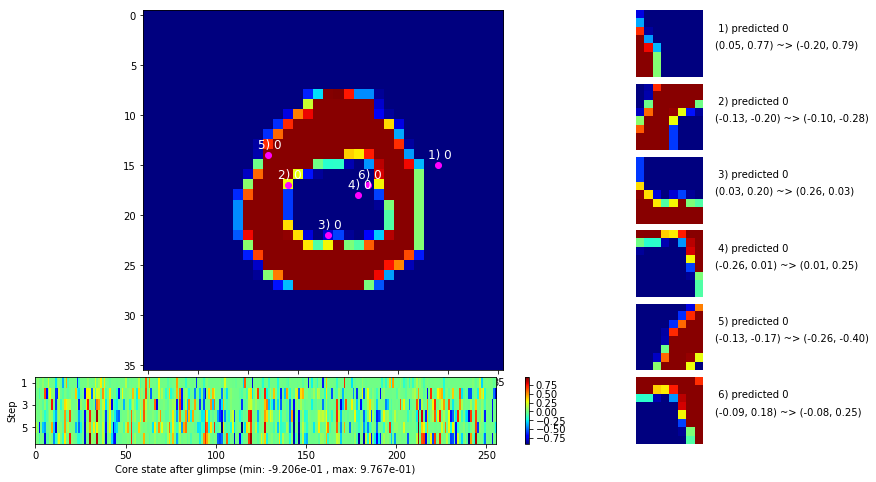

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


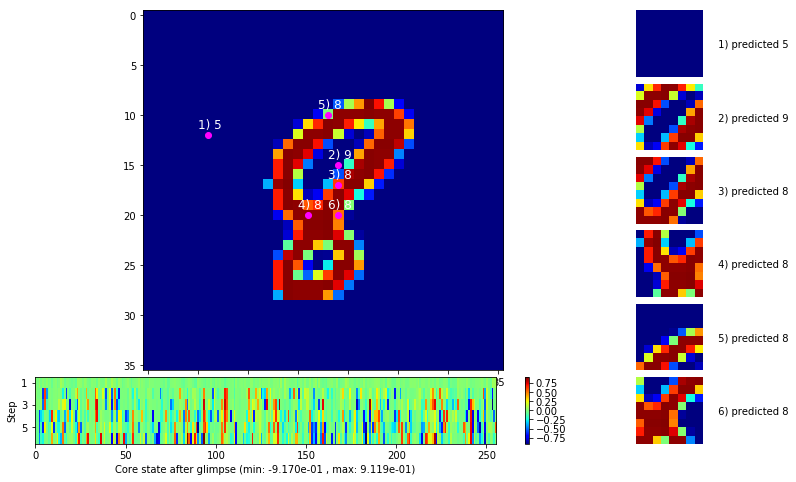


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


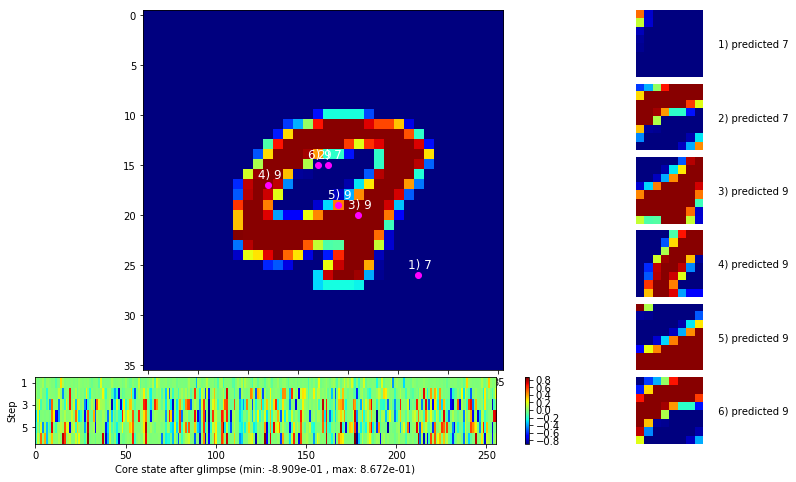

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


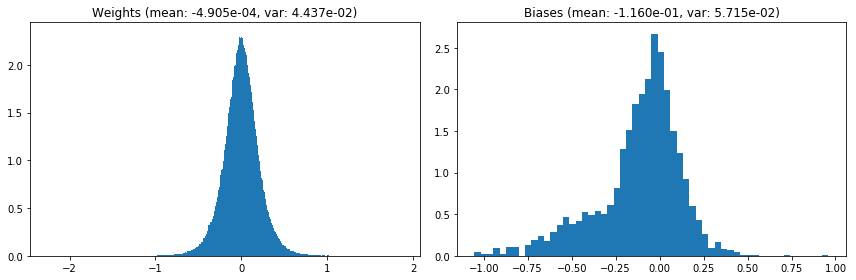

                                      Location network weights and biases


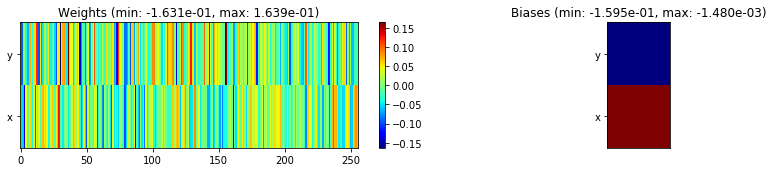

---------------------------------------------------------------------------------------------------------------
Elapsed time:  388.82 sec | TRAIN >> class loss: 0.1400 | steps:  2.095 :( | reward:  0.9553 :( | acc.: 95.532% :(
                          | VAL   >> class loss: 0.1415 | steps:  1.970 :( | reward:  0.9560 :( | acc.: 95.600% :(


Epoch  71/400) lr = 0.0001689
 b    500/  3000 >> 129.7 ms/b | lr: 1.69e-04 | grad 2norm:  3.60 | grad inf norm:  1.056
       Weights || abs max:  2.25 (65955.80) | mean: -4.90e-04 ( 0.18) | var: 4.44e-02 (2167915.00)
        Biases || abs max:  1.05 (  811.60) | mean: -1.16e-01 ( 0.47) | var: 5.71e-02 (21438.25)
                  class loss: 0.140 | steps: 2.090 | reward:  0.957 | acc.: 95.71%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 137.9 ms/b | lr: 1.68e-04 | grad 2norm:  3.55 | grad inf norm:  1.047
       Weights || abs max:  2.25 (29309.13) | mean: -4.90e-04 ( 0.11)

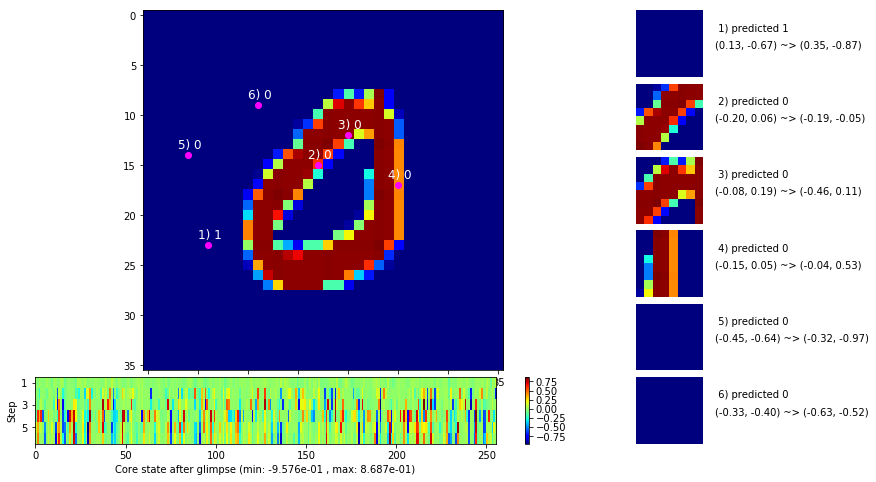

 b   1500/  3000 >> 141.6 ms/b | lr: 1.68e-04 | grad 2norm:  3.72 | grad inf norm:  1.064
       Weights || abs max:  2.26 (22076.46) | mean: -4.87e-04 ( 0.10) | var: 4.44e-02 (29520.93)
        Biases || abs max:  1.05 (  486.55) | mean: -1.16e-01 ( 0.36) | var: 5.71e-02 ( 3199.51)
                  class loss: 0.145 | steps: 2.082 | reward:  0.953 | acc.: 95.34%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.4 ms/b | lr: 1.68e-04 | grad 2norm:  3.52 | grad inf norm:  1.074
       Weights || abs max:  2.26 (49736.14) | mean: -4.87e-04 ( 0.16) | var: 4.44e-02 (148199.12)
        Biases || abs max:  1.05 (  244.14) | mean: -1.16e-01 ( 0.30) | var: 5.71e-02 (  680.40)
                  class loss: 0.138 | steps: 2.087 | reward:  0.958 | acc.: 95.77%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

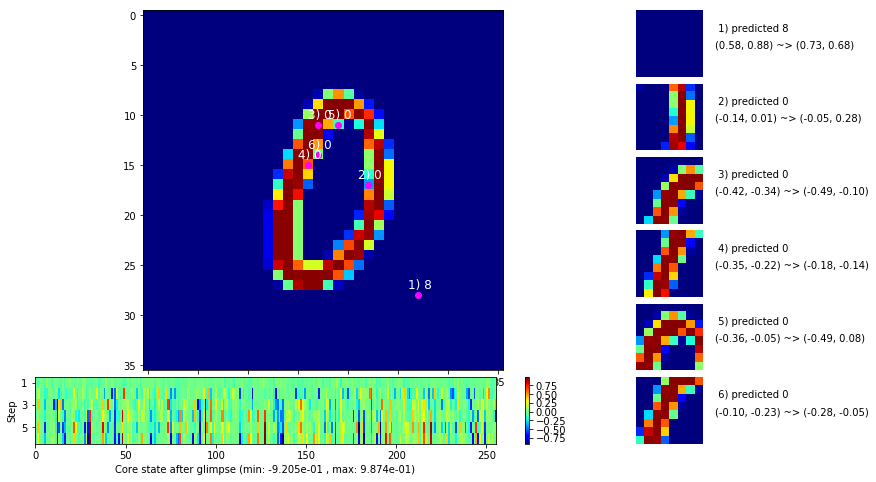

 b   2500/  3000 >> 129.3 ms/b | lr: 1.67e-04 | grad 2norm:  3.69 | grad inf norm:  1.099
       Weights || abs max:  2.26 (50607.92) | mean: -4.93e-04 ( 0.17) | var: 4.44e-02 (319829.03)
        Biases || abs max:  1.05 (  311.81) | mean: -1.16e-01 ( 0.32) | var: 5.72e-02 (  468.84)
                  class loss: 0.147 | steps: 2.106 | reward:  0.953 | acc.: 95.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 126.6 ms/b | lr: 1.67e-04 | grad 2norm:  3.33 | grad inf norm:  1.013
       Weights || abs max:  2.25 (71918.61) | mean: -4.93e-04 ( 0.20) | var: 4.44e-02 (406819.88)
        Biases || abs max:  1.05 (  524.69) | mean: -1.16e-01 ( 0.45) | var: 5.73e-02 ( 4487.24)
                  class loss: 0.130 | steps: 2.095 | reward:  0.960 | acc.: 96.03%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

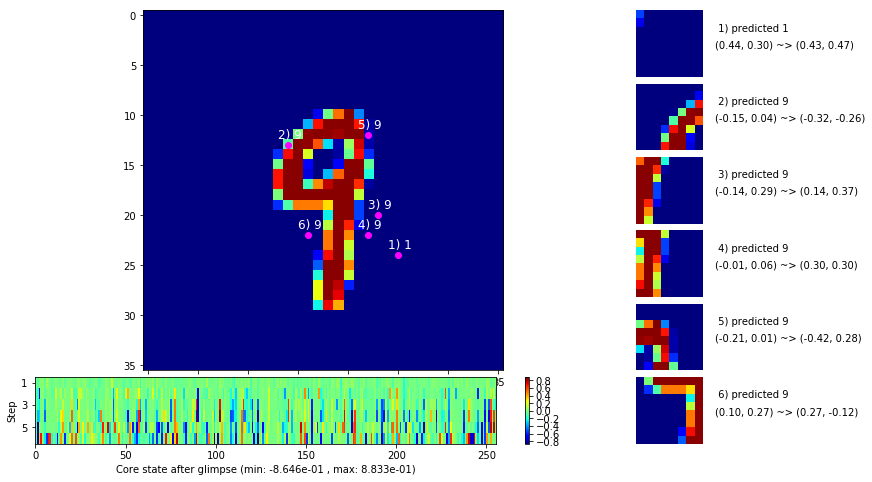

                                          ---===  VALIDATION  ===---

	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


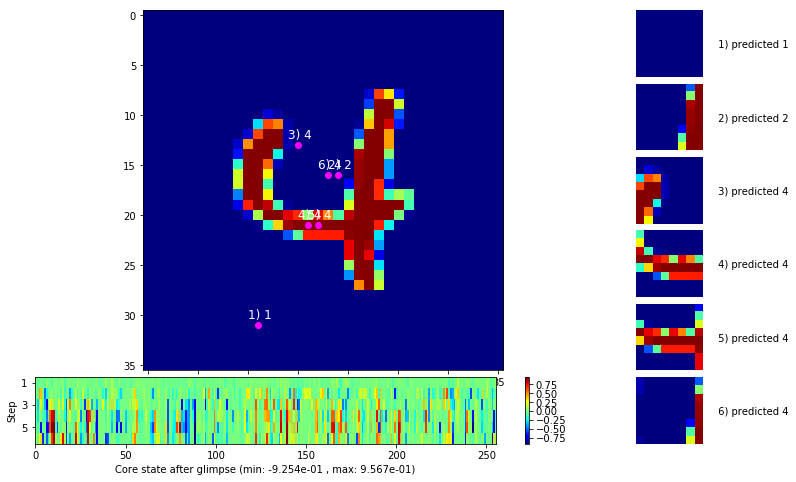


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


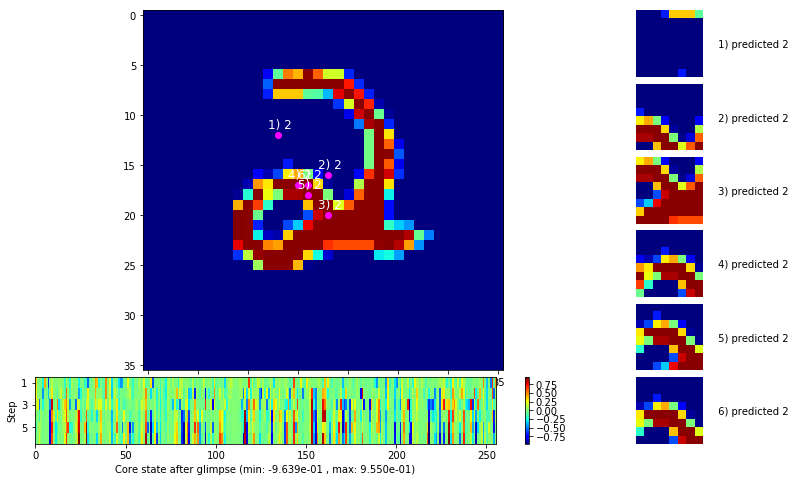

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


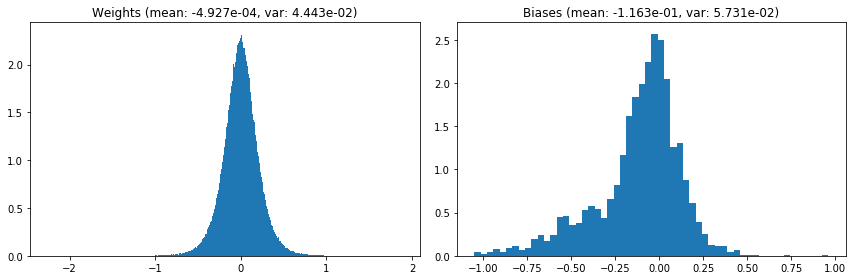

                                      Location network weights and biases


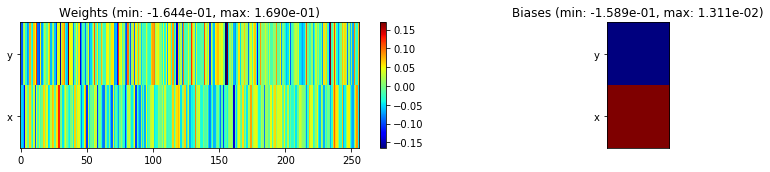

---------------------------------------------------------------------------------------------------------------
Elapsed time:  397.52 sec | TRAIN >> class loss: 0.1392 | steps:  2.089 :( | reward:  0.9564 :( | acc.: 95.637% :(
                          | VAL   >> class loss: 0.1465 | steps:  1.945 :( | reward:  0.9544 :( | acc.: 95.440% :(


Epoch  72/400) lr = 0.0001668
 b    500/  3000 >> 131.5 ms/b | lr: 1.67e-04 | grad 2norm:  3.59 | grad inf norm:  1.034
       Weights || abs max:  2.25 (29727.90) | mean: -4.90e-04 ( 0.12) | var: 4.44e-02 (43017.75)
        Biases || abs max:  1.05 (  231.09) | mean: -1.16e-01 ( 0.24) | var: 5.73e-02 (  532.14)
                  class loss: 0.136 | steps: 2.098 | reward:  0.956 | acc.: 95.63%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.1 ms/b | lr: 1.66e-04 | grad 2norm:  3.55 | grad inf norm:  1.031
       Weights || abs max:  2.25 (42432.76) | mean: -4.85e-04 ( 0.14) |

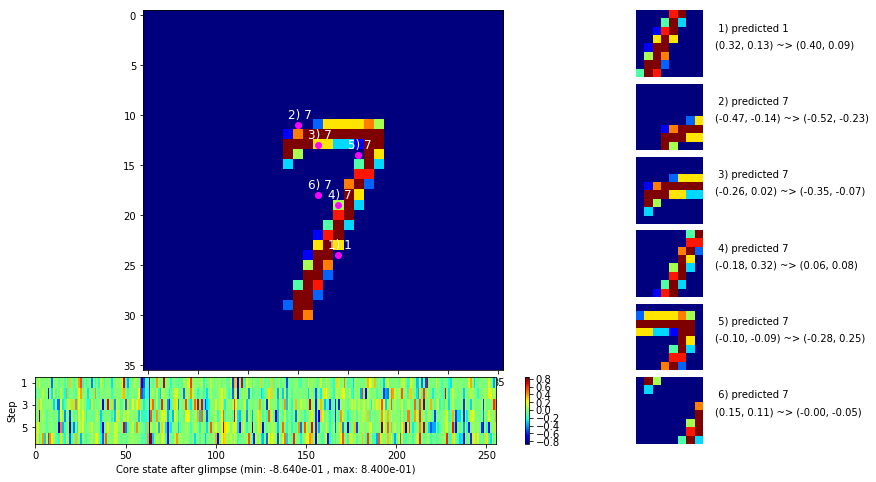

 b   1500/  3000 >> 131.5 ms/b | lr: 1.66e-04 | grad 2norm:  3.60 | grad inf norm:  1.072
       Weights || abs max:  2.25 (38899.68) | mean: -4.88e-04 ( 0.14) | var: 4.45e-02 (206509.20)
        Biases || abs max:  1.05 (  100.14) | mean: -1.16e-01 ( 0.17) | var: 5.73e-02 (   48.06)
                  class loss: 0.136 | steps: 2.085 | reward:  0.956 | acc.: 95.61%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.6 ms/b | lr: 1.66e-04 | grad 2norm:  3.60 | grad inf norm:  1.045
       Weights || abs max:  2.26 (27299.91) | mean: -4.84e-04 ( 0.12) | var: 4.45e-02 (20846.27)
        Biases || abs max:  1.06 (  283.78) | mean: -1.16e-01 ( 0.27) | var: 5.73e-02 (  568.63)
                  class loss: 0.136 | steps: 2.082 | reward:  0.957 | acc.: 95.65%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

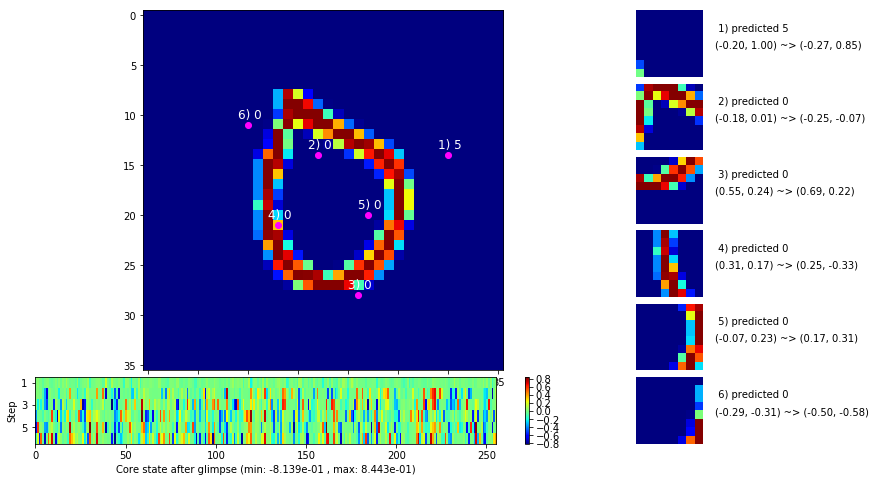

 b   2500/  3000 >> 131.2 ms/b | lr: 1.65e-04 | grad 2norm:  3.54 | grad inf norm:  1.027
       Weights || abs max:  2.25 (22846.26) | mean: -4.83e-04 ( 0.11) | var: 4.45e-02 (13025.60)
        Biases || abs max:  1.05 (  593.69) | mean: -1.16e-01 ( 0.41) | var: 5.73e-02 ( 7103.92)
                  class loss: 0.140 | steps: 2.091 | reward:  0.957 | acc.: 95.74%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 138.6 ms/b | lr: 1.65e-04 | grad 2norm:  3.69 | grad inf norm:  1.093
       Weights || abs max:  2.25 (29545.44) | mean: -4.79e-04 ( 0.12) | var: 4.45e-02 (21816.97)
        Biases || abs max:  1.05 (  407.62) | mean: -1.16e-01 ( 0.34) | var: 5.74e-02 ( 3143.24)
                  class loss: 0.141 | steps: 2.104 | reward:  0.954 | acc.: 95.44%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

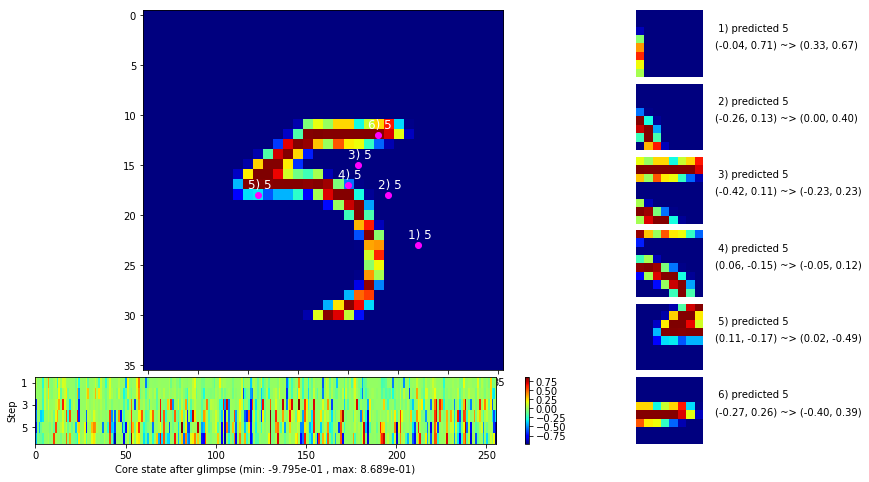

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


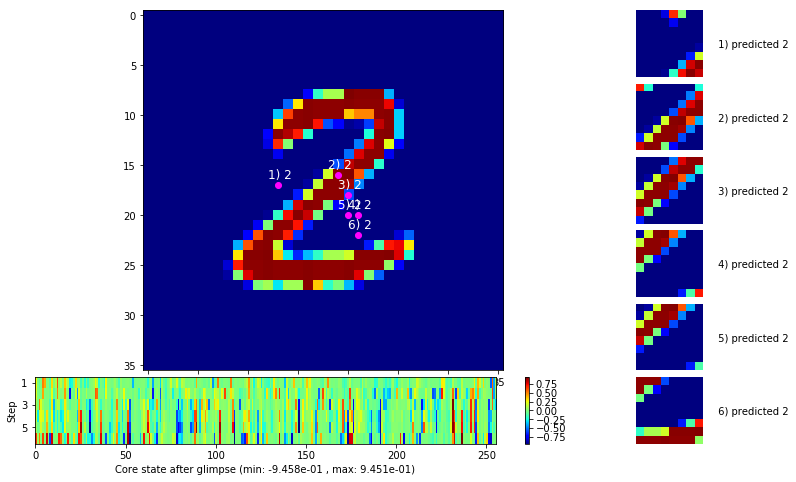


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


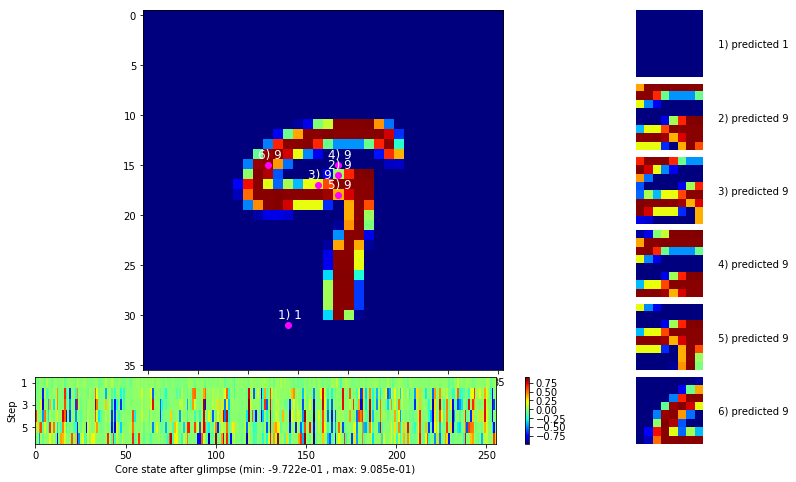

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


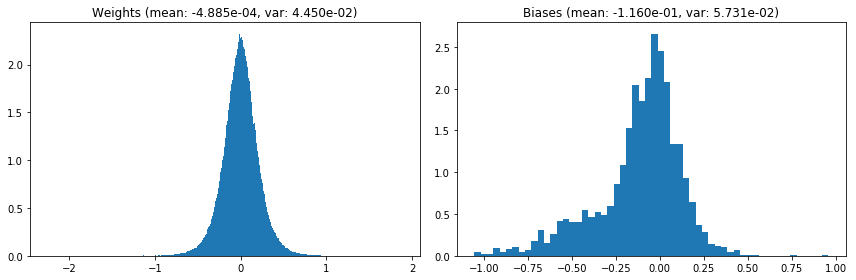

                                      Location network weights and biases


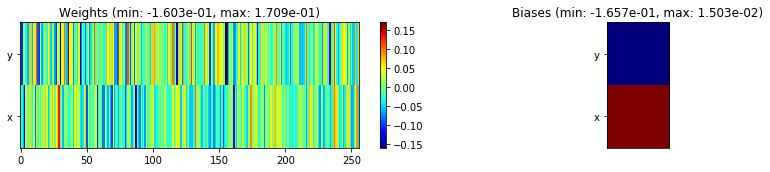

---------------------------------------------------------------------------------------------------------------
Elapsed time:  395.78 sec | TRAIN >> class loss: 0.1372 | steps:  2.094 :( | reward:  0.9563 :( | acc.: 95.632% :(
                          | VAL   >> class loss: 0.1424 | steps:  1.958 :( | reward:  0.9570 :( | acc.: 95.700% :(


Epoch  73/400) lr = 0.0001649
 b    500/  3000 >> 136.0 ms/b | lr: 1.65e-04 | grad 2norm:  3.51 | grad inf norm:  1.039
       Weights || abs max:  2.25 (35249.70) | mean: -4.87e-04 ( 0.13) | var: 4.45e-02 (77166.51)
        Biases || abs max:  1.06 (   79.15) | mean: -1.16e-01 ( 0.17) | var: 5.73e-02 (   46.03)
                  class loss: 0.128 | steps: 2.089 | reward:  0.958 | acc.: 95.80%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.5 ms/b | lr: 1.64e-04 | grad 2norm:  3.65 | grad inf norm:  1.031
       Weights || abs max:  2.25 (27812.03) | mean: -4.86e-04 ( 0.12) |

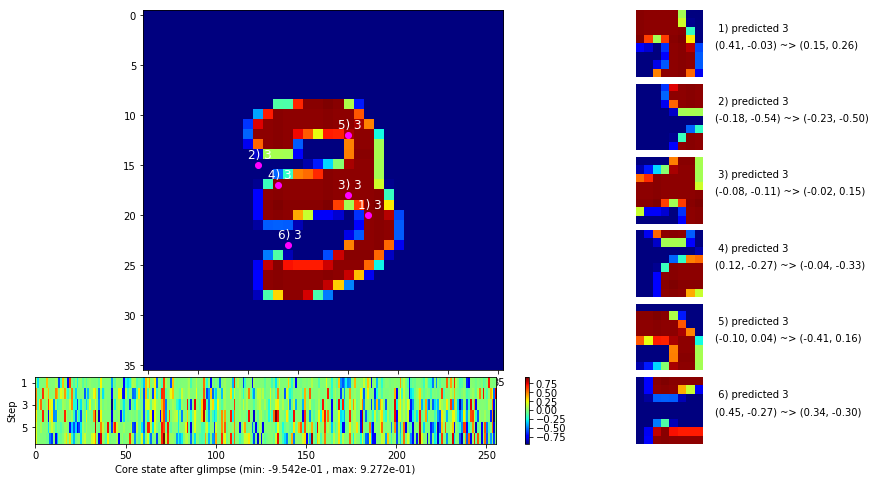

 b   1500/  3000 >> 129.9 ms/b | lr: 1.64e-04 | grad 2norm:  3.47 | grad inf norm:  1.017
       Weights || abs max:  2.25 (31667.88) | mean: -4.86e-04 ( 0.13) | var: 4.45e-02 (41175.62)
        Biases || abs max:  1.06 (  148.90) | mean: -1.16e-01 ( 0.20) | var: 5.74e-02 (   57.13)
                  class loss: 0.129 | steps: 2.072 | reward:  0.958 | acc.: 95.81%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.0 ms/b | lr: 1.64e-04 | grad 2norm:  3.54 | grad inf norm:  1.058
       Weights || abs max:  2.25 (46521.20) | mean: -4.89e-04 ( 0.15) | var: 4.45e-02 (180996.84)
        Biases || abs max:  1.06 (  241.34) | mean: -1.16e-01 ( 0.25) | var: 5.75e-02 (  383.49)
                  class loss: 0.141 | steps: 2.087 | reward:  0.957 | acc.: 95.66%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0

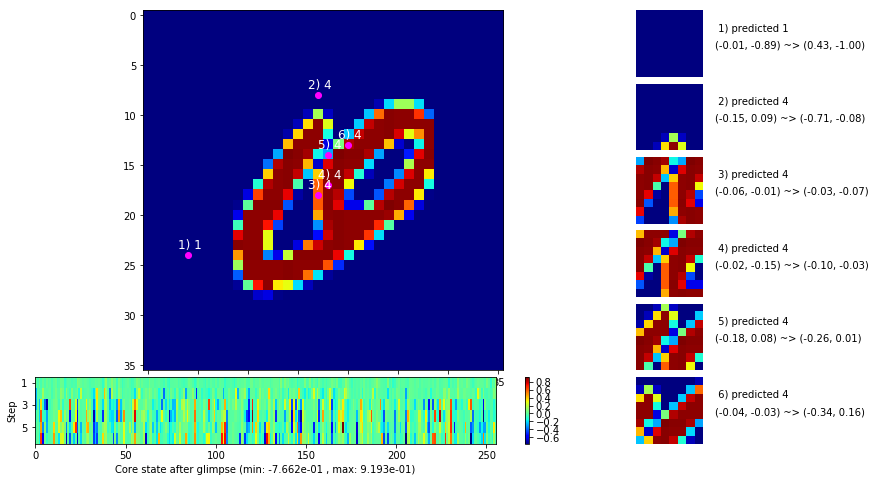

 b   2500/  3000 >> 128.5 ms/b | lr: 1.63e-04 | grad 2norm:  3.46 | grad inf norm:  1.018
       Weights || abs max:  2.25 (27692.13) | mean: -4.88e-04 ( 0.11) | var: 4.45e-02 (62271.86)
        Biases || abs max:  1.06 (  648.60) | mean: -1.16e-01 ( 0.42) | var: 5.74e-02 (11155.47)
                  class loss: 0.124 | steps: 2.078 | reward:  0.960 | acc.: 95.97%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.9 ms/b | lr: 1.63e-04 | grad 2norm:  3.34 | grad inf norm:  1.011
       Weights || abs max:  2.25 (41146.25) | mean: -4.83e-04 ( 0.14) | var: 4.46e-02 (391307.25)
        Biases || abs max:  1.06 (  569.66) | mean: -1.16e-01 ( 0.40) | var: 5.75e-02 ( 4540.91)
                  class loss: 0.125 | steps: 2.078 | reward:  0.961 | acc.: 96.06%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

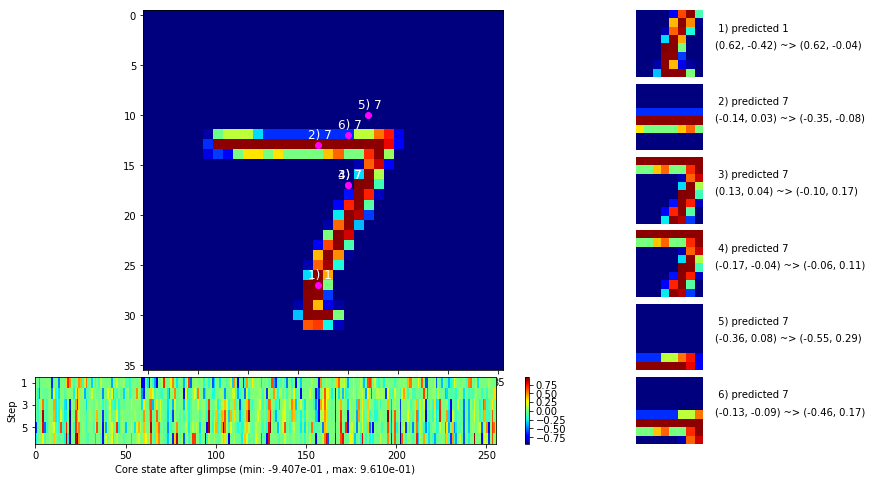

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


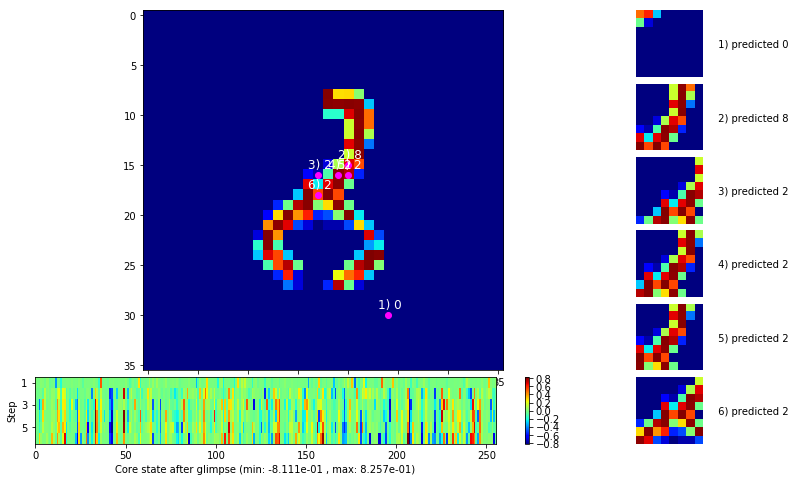


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


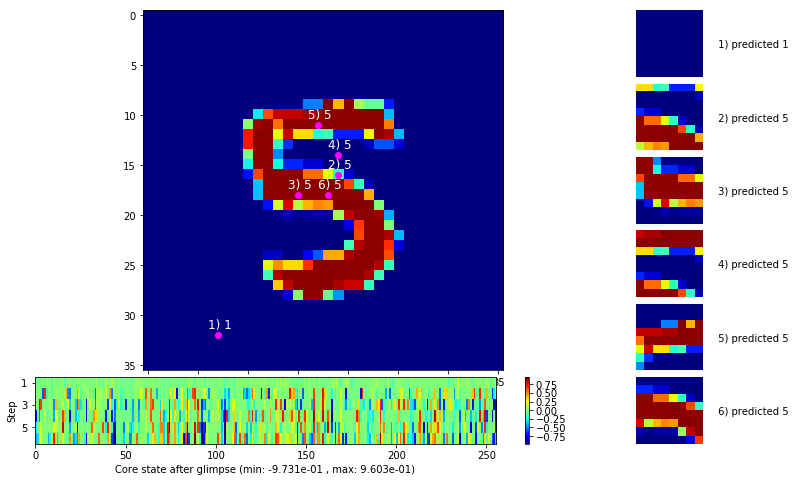

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


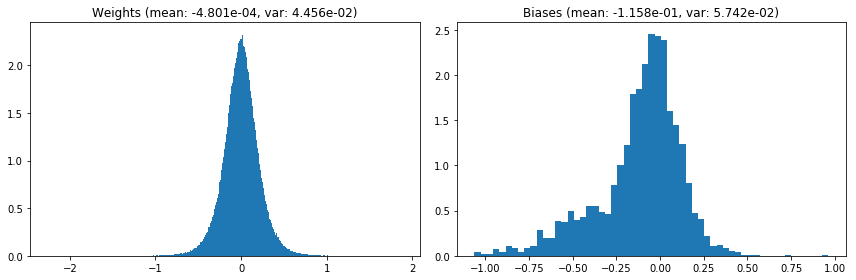

                                      Location network weights and biases


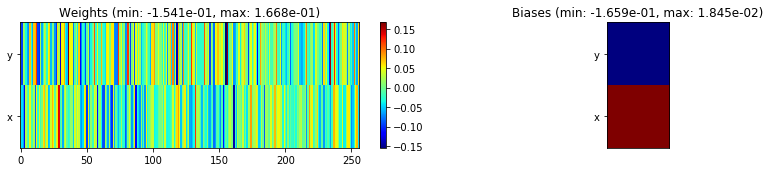

---------------------------------------------------------------------------------------------------------------
Elapsed time:  392.17 sec | TRAIN >> class loss: 0.1311 | steps:  2.084 :( | reward:  0.9582    | acc.: 95.817% 
                          | VAL   >> class loss: 0.1435 | steps:  1.929 :( | reward:  0.9520 :( | acc.: 95.200% :(


Epoch  74/400) lr = 0.0001629
 b    500/  3000 >> 127.9 ms/b | lr: 1.63e-04 | grad 2norm:  3.70 | grad inf norm:  1.067
       Weights || abs max:  2.26 (39593.23) | mean: -4.92e-04 ( 0.14) | var: 4.46e-02 (162599.80)
        Biases || abs max:  1.07 (  444.56) | mean: -1.16e-01 ( 0.35) | var: 5.75e-02 ( 4666.27)
                  class loss: 0.142 | steps: 2.083 | reward:  0.955 | acc.: 95.51%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 133.1 ms/b | lr: 1.62e-04 | grad 2norm:  3.40 | grad inf norm:  0.986
       Weights || abs max:  2.26 (98331.99) | mean: -4.99e-04 ( 0.25) | 

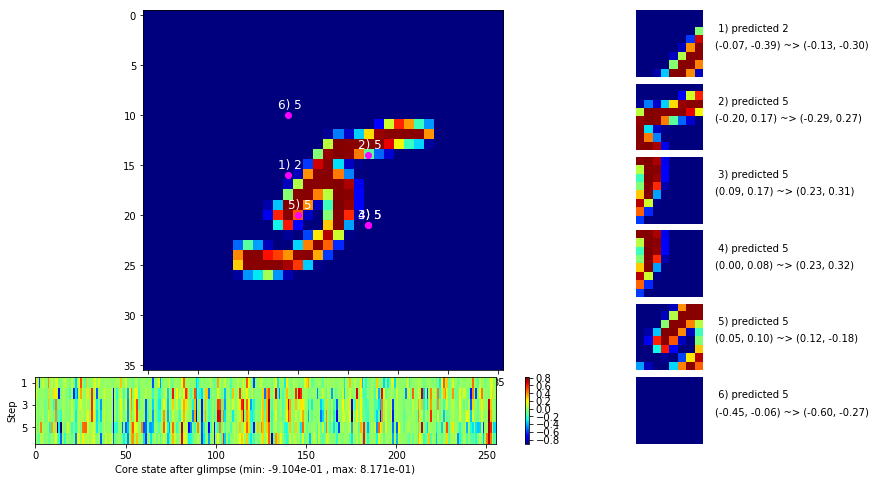

 b   1500/  3000 >> 143.6 ms/b | lr: 1.62e-04 | grad 2norm:  3.54 | grad inf norm:  1.012
       Weights || abs max:  2.26 (22912.71) | mean: -5.04e-04 ( 0.10) | var: 4.46e-02 (15836.15)
        Biases || abs max:  1.06 (  301.94) | mean: -1.16e-01 ( 0.27) | var: 5.75e-02 ( 2039.09)
                  class loss: 0.134 | steps: 2.099 | reward:  0.958 | acc.: 95.83%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 136.9 ms/b | lr: 1.62e-04 | grad 2norm:  3.57 | grad inf norm:  1.032
       Weights || abs max:  2.25 (26016.25) | mean: -5.17e-04 ( 0.11) | var: 4.46e-02 (17129.01)
        Biases || abs max:  1.06 (  252.61) | mean: -1.16e-01 ( 0.27) | var: 5.76e-02 (  351.28)
                  class loss: 0.136 | steps: 2.081 | reward:  0.956 | acc.: 95.64%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

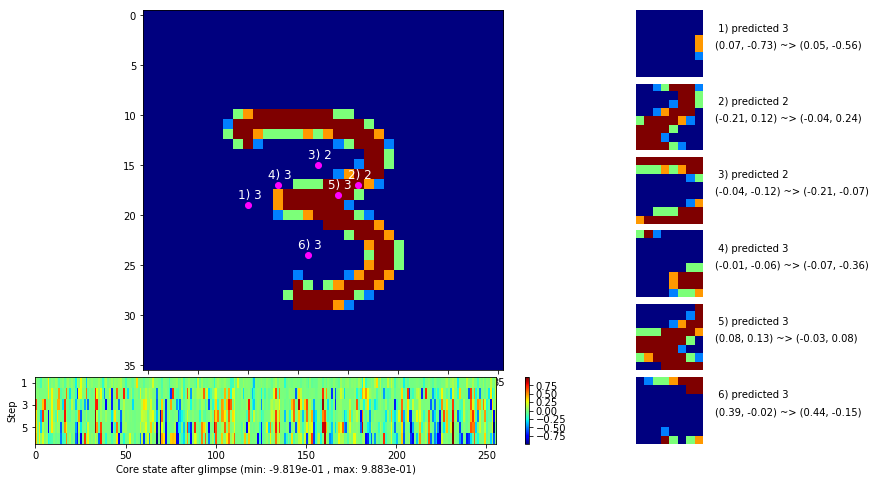

 b   2500/  3000 >> 131.6 ms/b | lr: 1.61e-04 | grad 2norm:  3.53 | grad inf norm:  1.003
       Weights || abs max:  2.25 (20866.48) | mean: -5.22e-04 ( 0.11) | var: 4.46e-02 ( 9860.13)
        Biases || abs max:  1.05 (  429.99) | mean: -1.16e-01 ( 0.38) | var: 5.76e-02 (  975.37)
                  class loss: 0.137 | steps: 2.083 | reward:  0.958 | acc.: 95.78%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.9 ms/b | lr: 1.61e-04 | grad 2norm:  3.25 | grad inf norm:  0.961
       Weights || abs max:  2.25 (20476.81) | mean: -5.27e-04 ( 0.10) | var: 4.46e-02 (15024.97)
        Biases || abs max:  1.05 (  290.02) | mean: -1.16e-01 ( 0.28) | var: 5.76e-02 (  777.37)
                  class loss: 0.122 | steps: 2.080 | reward:  0.962 | acc.: 96.20%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

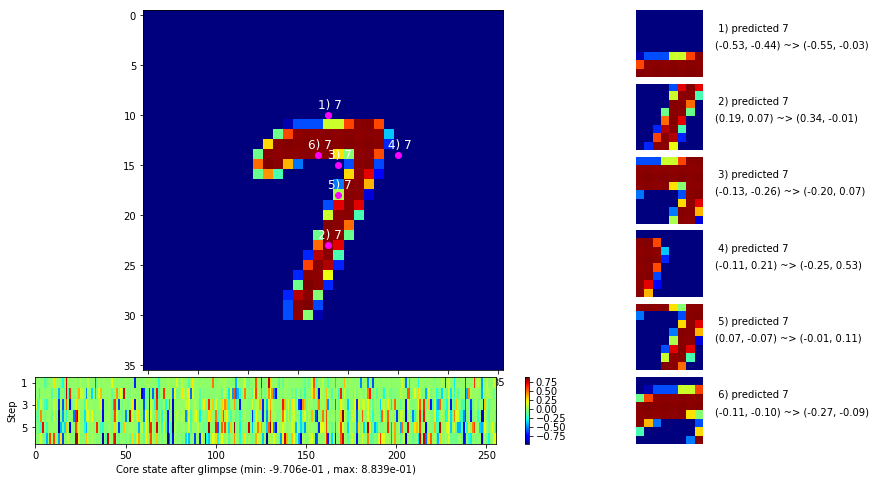

                                          ---===  VALIDATION  ===---

	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


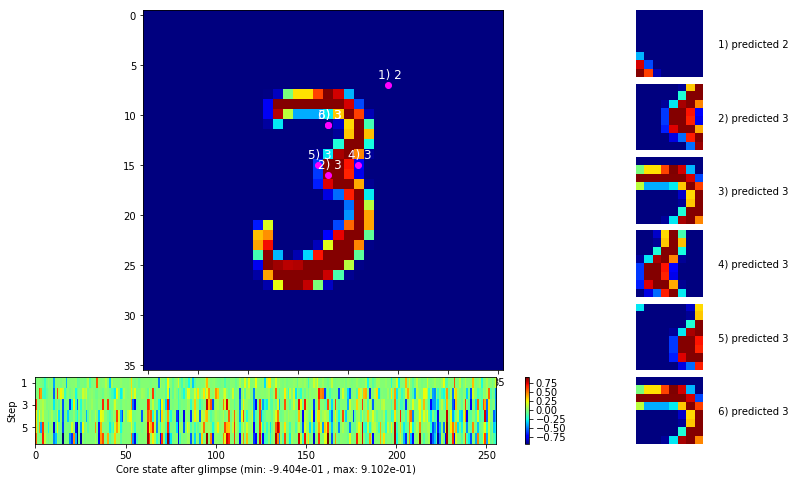


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


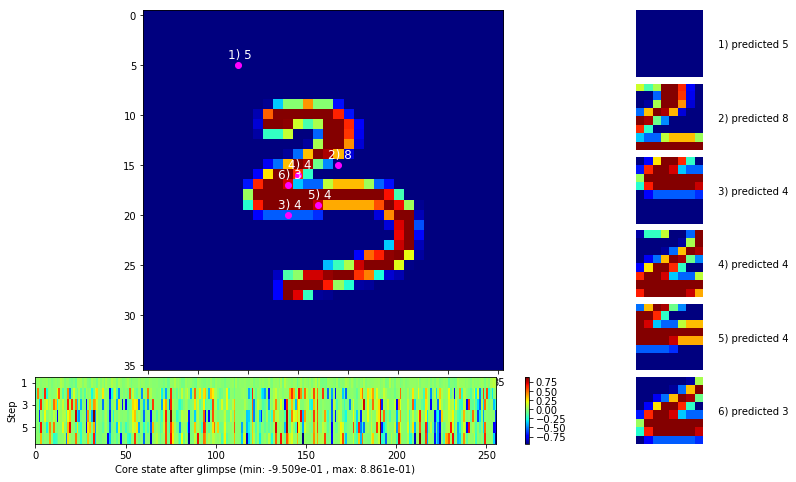

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


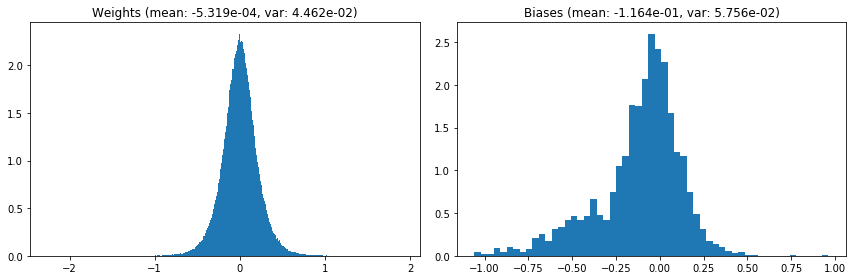

                                      Location network weights and biases


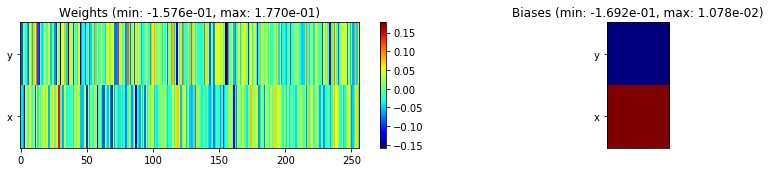

---------------------------------------------------------------------------------------------------------------
Elapsed time:  401.00 sec | TRAIN >> class loss: 0.1335 | steps:  2.082    | reward:  0.9583    | acc.: 95.830% 
                          | VAL   >> class loss: 0.1442 | steps:  1.953 :( | reward:  0.9540 :( | acc.: 95.400% :(


Epoch  75/400) lr = 0.0001611
 b    500/  3000 >> 128.0 ms/b | lr: 1.61e-04 | grad 2norm:  3.41 | grad inf norm:  0.988
       Weights || abs max:  2.25 (67038.61) | mean: -5.30e-04 ( 0.18) | var: 4.46e-02 (1937807.00)
        Biases || abs max:  1.06 (  851.41) | mean: -1.16e-01 ( 0.51) | var: 5.75e-02 (47643.93)
                  class loss: 0.127 | steps: 2.088 | reward:  0.959 | acc.: 95.93%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.6 ms/b | lr: 1.61e-04 | grad 2norm:  3.29 | grad inf norm:  1.015
       Weights || abs max:  2.26 (30414.12) | mean: -5.40e-04 ( 0.12) |

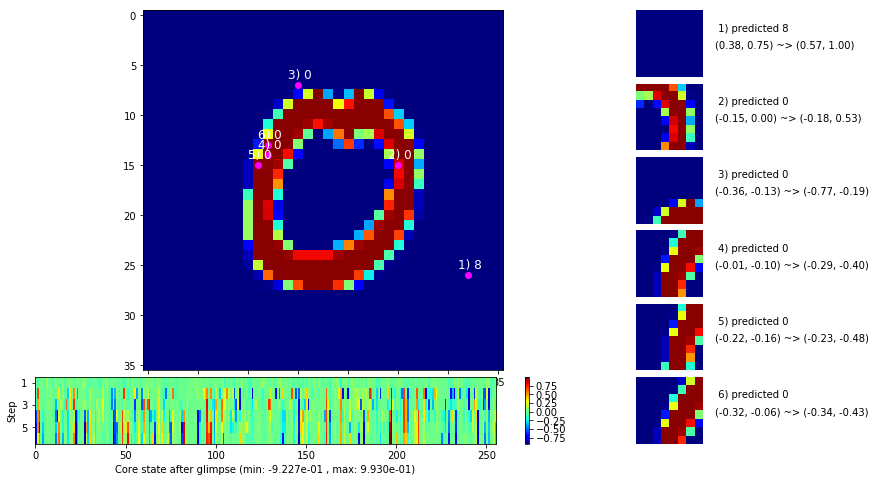

 b   1500/  3000 >> 130.5 ms/b | lr: 1.60e-04 | grad 2norm:  3.50 | grad inf norm:  1.034
       Weights || abs max:  2.26 (47927.07) | mean: -5.34e-04 ( 0.16) | var: 4.46e-02 (271962.19)
        Biases || abs max:  1.06 (  219.02) | mean: -1.17e-01 ( 0.23) | var: 5.76e-02 (  935.84)
                  class loss: 0.139 | steps: 2.122 | reward:  0.957 | acc.: 95.70%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.8 ms/b | lr: 1.60e-04 | grad 2norm:  3.53 | grad inf norm:  1.038
       Weights || abs max:  2.26 (38172.45) | mean: -5.31e-04 ( 0.14) | var: 4.47e-02 (124000.01)
        Biases || abs max:  1.06 (  478.52) | mean: -1.17e-01 ( 0.41) | var: 5.75e-02 ( 6367.40)
                  class loss: 0.139 | steps: 2.113 | reward:  0.957 | acc.: 95.72%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

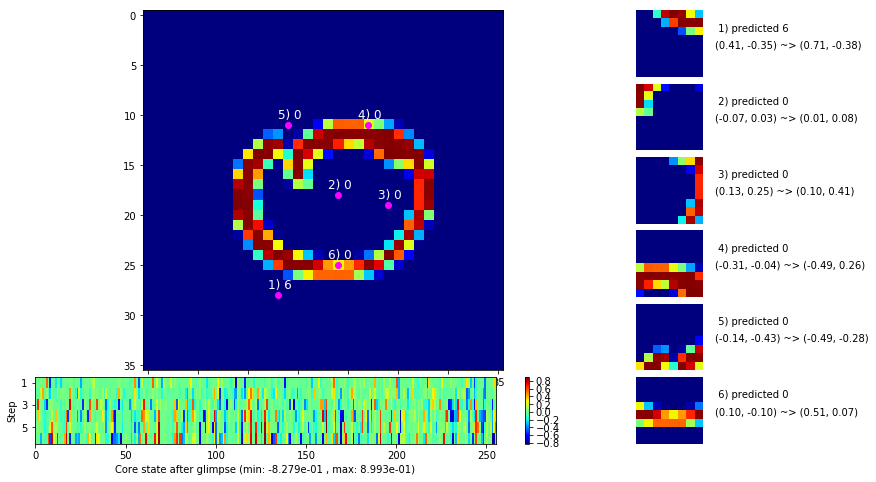

 b   2500/  3000 >> 130.0 ms/b | lr: 1.60e-04 | grad 2norm:  3.56 | grad inf norm:  1.069
       Weights || abs max:  2.26 (58239.68) | mean: -5.47e-04 ( 0.17) | var: 4.47e-02 (406583.00)
        Biases || abs max:  1.06 (  450.69) | mean: -1.17e-01 ( 0.35) | var: 5.76e-02 ( 9671.00)
                  class loss: 0.136 | steps: 2.086 | reward:  0.957 | acc.: 95.65%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.8 ms/b | lr: 1.59e-04 | grad 2norm:  3.28 | grad inf norm:  0.955
       Weights || abs max:  2.26 (142126.09) | mean: -5.47e-04 ( 0.33) | var: 4.47e-02 (8891094.00)
        Biases || abs max:  1.06 (  181.71) | mean: -1.16e-01 ( 0.25) | var: 5.76e-02 (  750.87)
                  class loss: 0.129 | steps: 2.067 | reward:  0.962 | acc.: 96.17%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

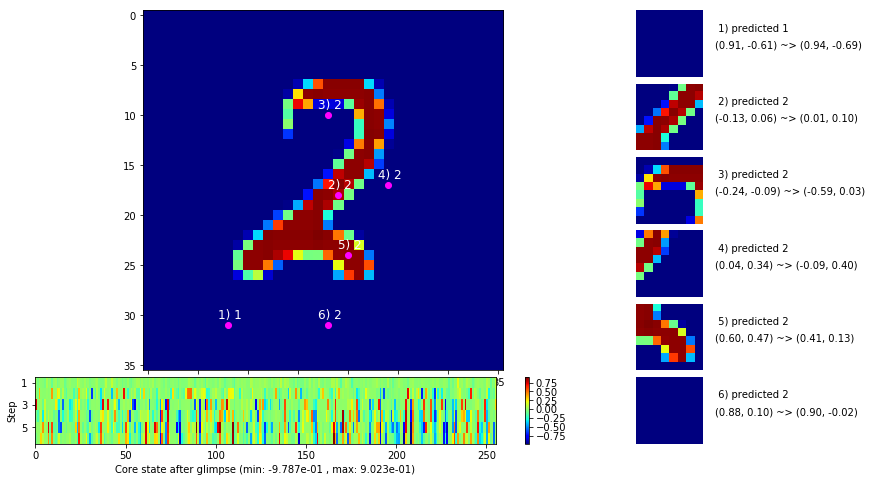

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


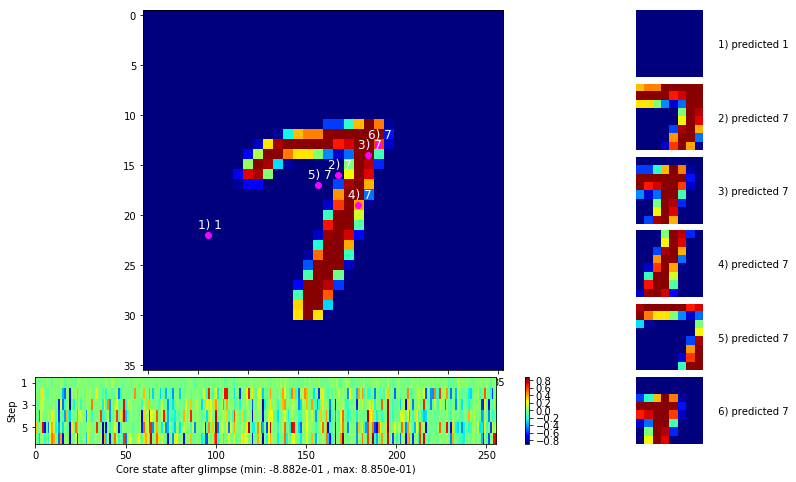


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


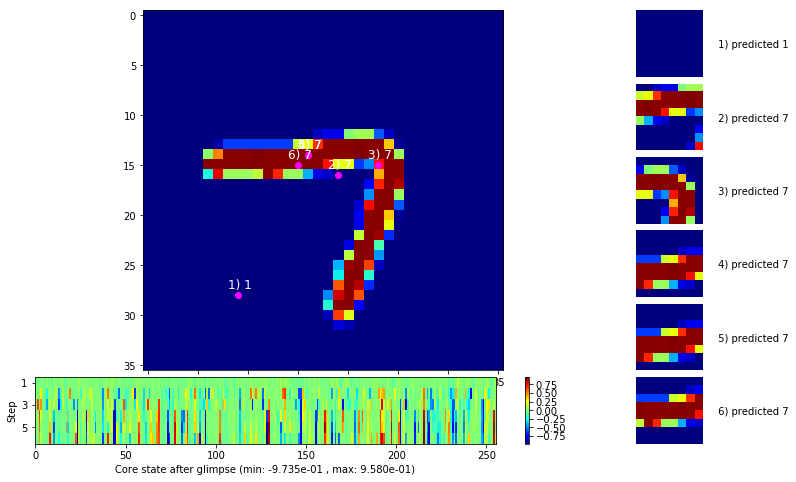

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


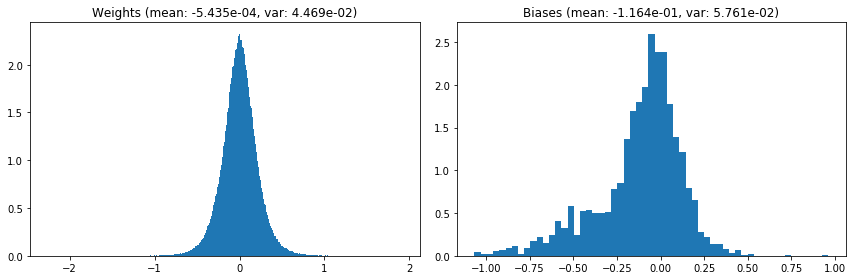

                                      Location network weights and biases


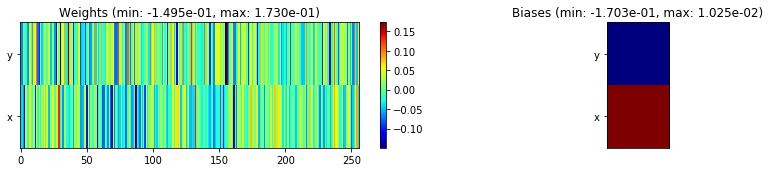

---------------------------------------------------------------------------------------------------------------
Elapsed time:  395.67 sec | TRAIN >> class loss: 0.1326 | steps:  2.089 :( | reward:  0.9587    | acc.: 95.875% 
                          | VAL   >> class loss: 0.1374 | steps:  1.962 :( | reward:  0.9578 :( | acc.: 95.780% :(


Epoch  76/400) lr = 0.0001592
 b    500/  3000 >> 132.1 ms/b | lr: 1.59e-04 | grad 2norm:  3.32 | grad inf norm:  0.991
       Weights || abs max:  2.26 (31156.46) | mean: -5.51e-04 ( 0.13) | var: 4.47e-02 (54206.50)
        Biases || abs max:  1.07 (  110.88) | mean: -1.16e-01 ( 0.19) | var: 5.76e-02 (   33.28)
                  class loss: 0.129 | steps: 2.066 | reward:  0.961 | acc.: 96.10%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.0 ms/b | lr: 1.59e-04 | grad 2norm:  3.43 | grad inf norm:  1.036
       Weights || abs max:  2.26 (24602.11) | mean: -5.57e-04 ( 0.11) | v

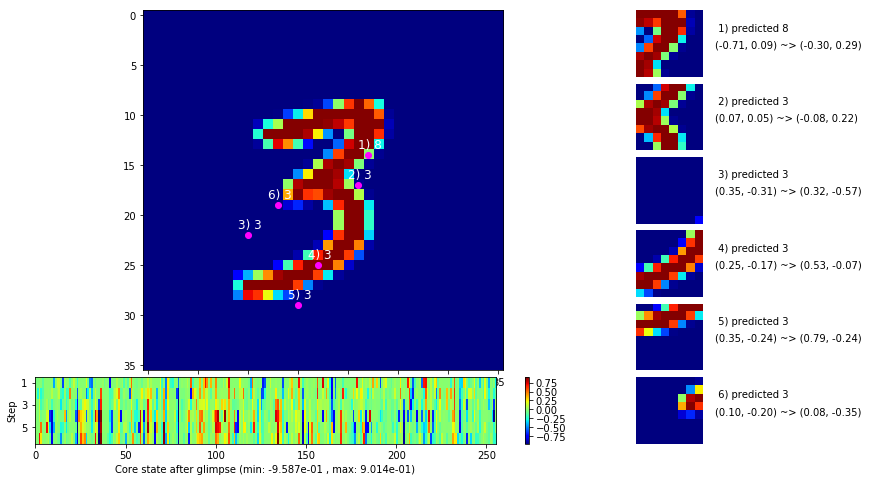

 b   1500/  3000 >> 129.9 ms/b | lr: 1.58e-04 | grad 2norm:  3.18 | grad inf norm:  0.961
       Weights || abs max:  2.26 (27269.68) | mean: -5.56e-04 ( 0.11) | var: 4.47e-02 (25480.08)
        Biases || abs max:  1.06 (  279.58) | mean: -1.17e-01 ( 0.27) | var: 5.77e-02 (  803.55)
                  class loss: 0.115 | steps: 2.070 | reward:  0.963 | acc.: 96.30%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.2 ms/b | lr: 1.58e-04 | grad 2norm:  3.66 | grad inf norm:  1.082
       Weights || abs max:  2.26 (31838.24) | mean: -5.54e-04 ( 0.13) | var: 4.47e-02 (23662.46)
        Biases || abs max:  1.07 (  182.17) | mean: -1.17e-01 ( 0.22) | var: 5.77e-02 (  129.78)
                  class loss: 0.139 | steps: 2.092 | reward:  0.955 | acc.: 95.47%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

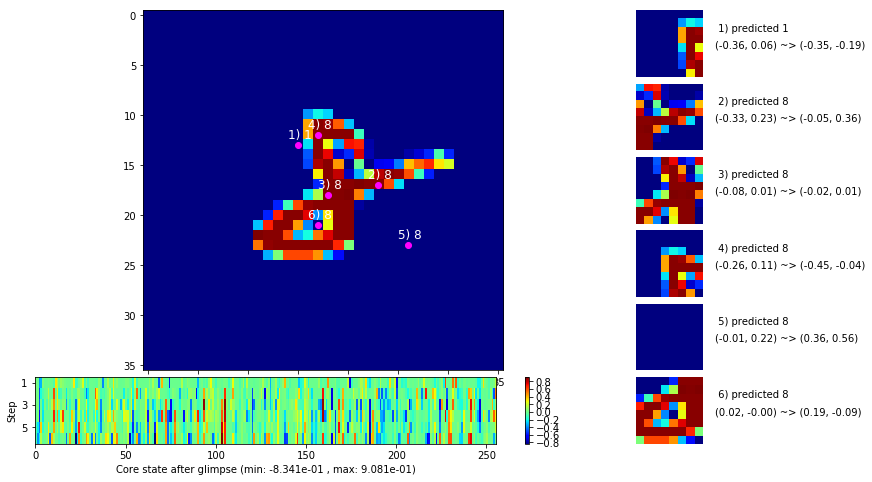

 b   2500/  3000 >> 130.2 ms/b | lr: 1.58e-04 | grad 2norm:  3.66 | grad inf norm:  1.064
       Weights || abs max:  2.26 (49998.92) | mean: -5.62e-04 ( 0.16) | var: 4.47e-02 (375198.97)
        Biases || abs max:  1.07 (  257.11) | mean: -1.17e-01 ( 0.30) | var: 5.77e-02 (11344.34)
                  class loss: 0.144 | steps: 2.113 | reward:  0.955 | acc.: 95.50%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.8 ms/b | lr: 1.58e-04 | grad 2norm:  3.30 | grad inf norm:  1.016
       Weights || abs max:  2.27 (67027.41) | mean: -5.72e-04 ( 0.20) | var: 4.47e-02 (706864.19)
        Biases || abs max:  1.07 (  149.10) | mean: -1.17e-01 ( 0.19) | var: 5.78e-02 (  279.05)
                  class loss: 0.128 | steps: 2.090 | reward:  0.961 | acc.: 96.10%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.

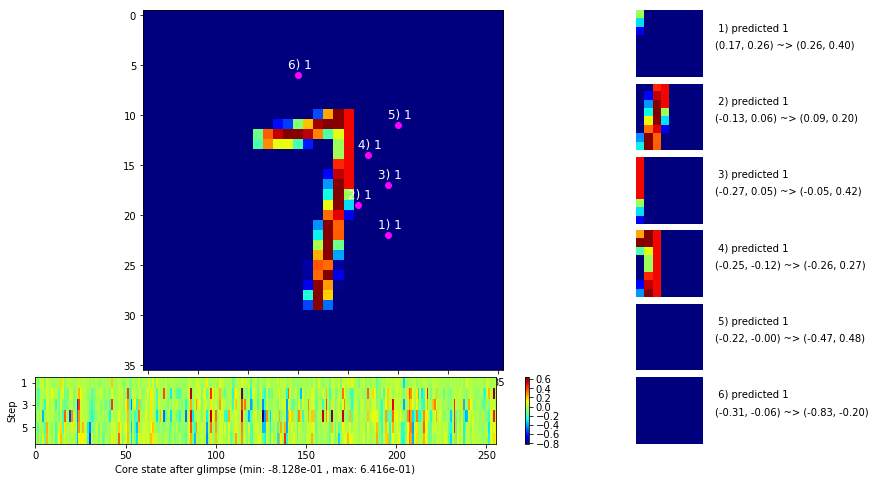

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


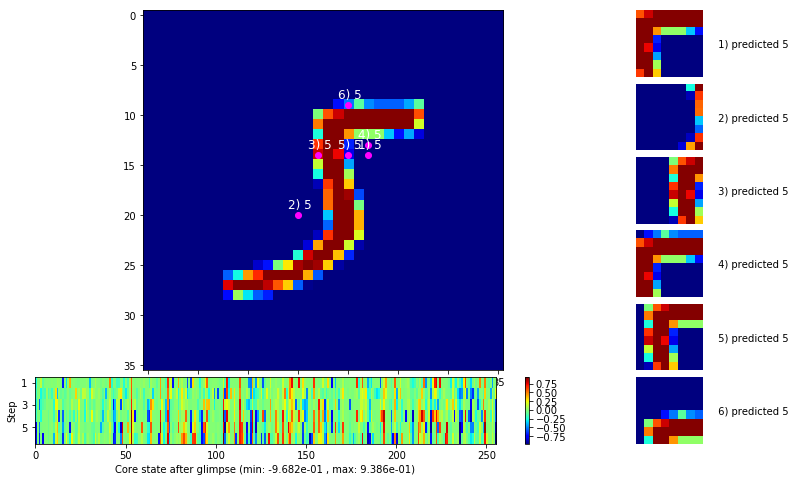


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


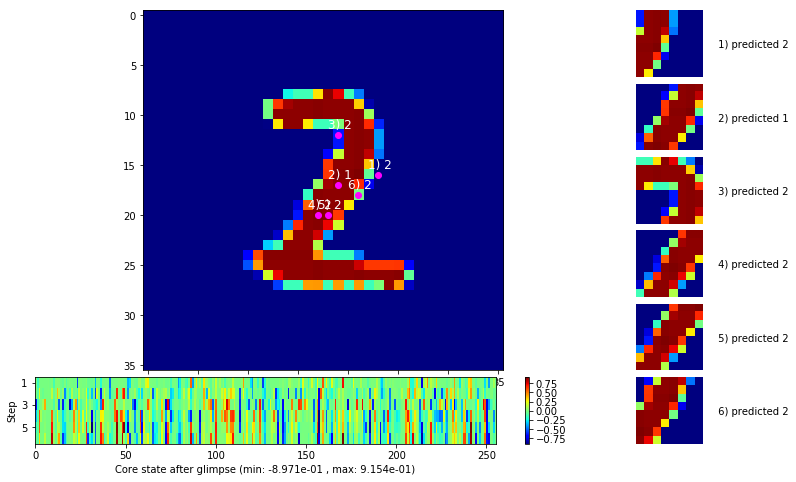

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


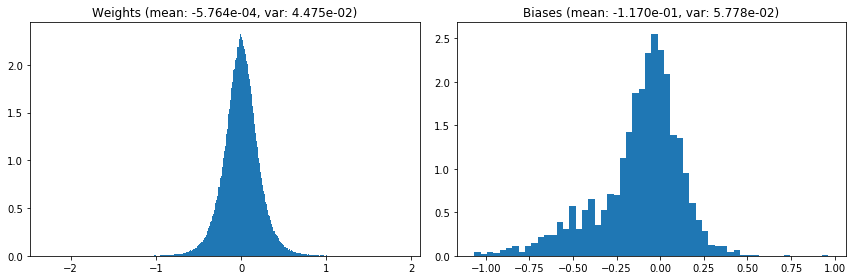

                                      Location network weights and biases


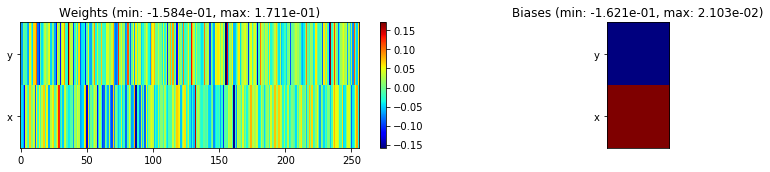

---------------------------------------------------------------------------------------------------------------
Elapsed time:  389.18 sec | TRAIN >> class loss: 0.1306 | steps:  2.087 :( | reward:  0.9588    | acc.: 95.882% 
                          | VAL   >> class loss: 0.1404 | steps:  1.928 :( | reward:  0.9542 :( | acc.: 95.420% :(


Epoch  77/400) lr = 0.0001575
 b    500/  3000 >> 129.7 ms/b | lr: 1.57e-04 | grad 2norm:  3.47 | grad inf norm:  1.031
       Weights || abs max:  2.27 (321738.06) | mean: -5.81e-04 ( 0.67) | var: 4.48e-02 (56340292.00)
        Biases || abs max:  1.06 (  190.22) | mean: -1.17e-01 ( 0.21) | var: 5.78e-02 (  647.04)
                  class loss: 0.140 | steps: 2.090 | reward:  0.958 | acc.: 95.84%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.5 ms/b | lr: 1.57e-04 | grad 2norm:  3.37 | grad inf norm:  1.000
       Weights || abs max:  2.27 (114860.59) | mean: -5.88e-04 ( 0.28

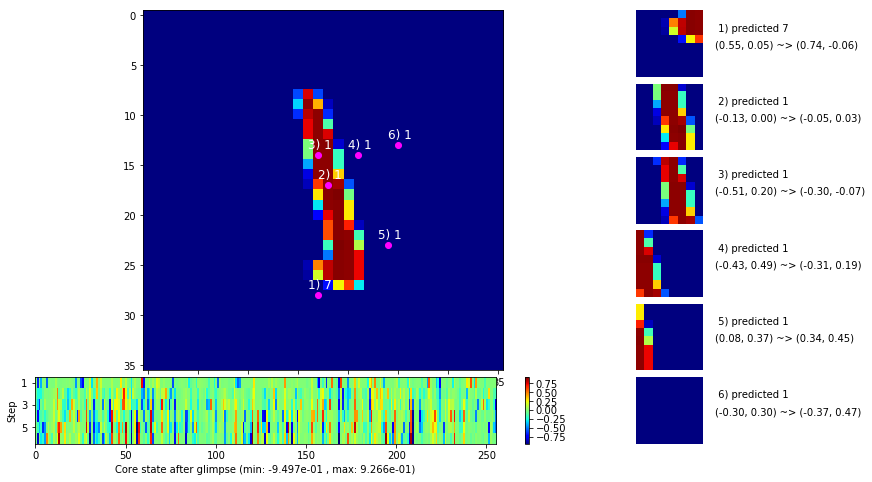

 b   1500/  3000 >> 140.4 ms/b | lr: 1.57e-04 | grad 2norm:  3.42 | grad inf norm:  0.991
       Weights || abs max:  2.28 (46001.02) | mean: -5.86e-04 ( 0.16) | var: 4.48e-02 (211998.42)
        Biases || abs max:  1.06 (  373.92) | mean: -1.17e-01 ( 0.35) | var: 5.78e-02 ( 5462.49)
                  class loss: 0.128 | steps: 2.067 | reward:  0.960 | acc.: 95.97%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 138.6 ms/b | lr: 1.56e-04 | grad 2norm:  3.57 | grad inf norm:  1.061
       Weights || abs max:  2.28 (24160.67) | mean: -5.87e-04 ( 0.11) | var: 4.48e-02 (16972.01)
        Biases || abs max:  1.06 (  380.25) | mean: -1.17e-01 ( 0.33) | var: 5.78e-02 ( 1919.02)
                  class loss: 0.140 | steps: 2.087 | reward:  0.955 | acc.: 95.53%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

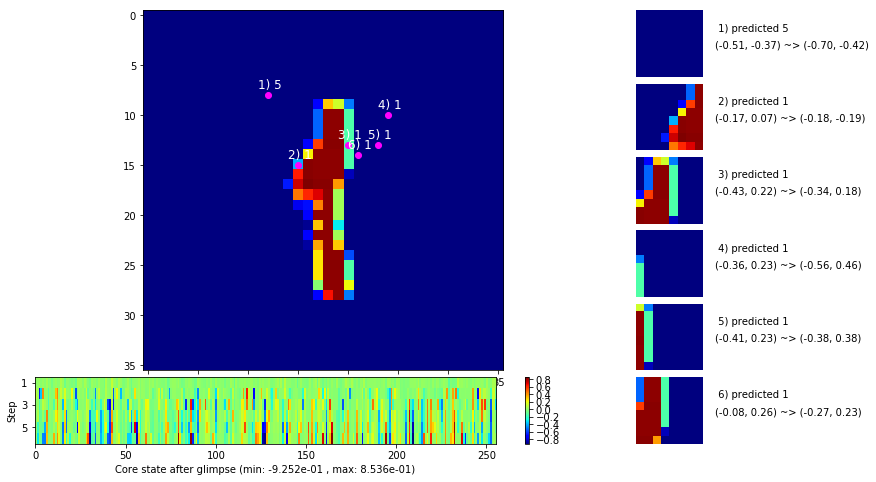

 b   2500/  3000 >> 130.4 ms/b | lr: 1.56e-04 | grad 2norm:  3.55 | grad inf norm:  1.031
       Weights || abs max:  2.28 (19458.98) | mean: -5.86e-04 ( 0.10) | var: 4.48e-02 ( 6006.32)
        Biases || abs max:  1.06 (  585.99) | mean: -1.17e-01 ( 0.43) | var: 5.78e-02 (10115.45)
                  class loss: 0.133 | steps: 2.068 | reward:  0.958 | acc.: 95.76%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 128.2 ms/b | lr: 1.56e-04 | grad 2norm:  3.28 | grad inf norm:  0.954
       Weights || abs max:  2.28 (40593.01) | mean: -5.97e-04 ( 0.14) | var: 4.48e-02 (192392.19)
        Biases || abs max:  1.06 (  435.35) | mean: -1.17e-01 ( 0.33) | var: 5.78e-02 ( 7568.42)
                  class loss: 0.125 | steps: 2.068 | reward:  0.961 | acc.: 96.13%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

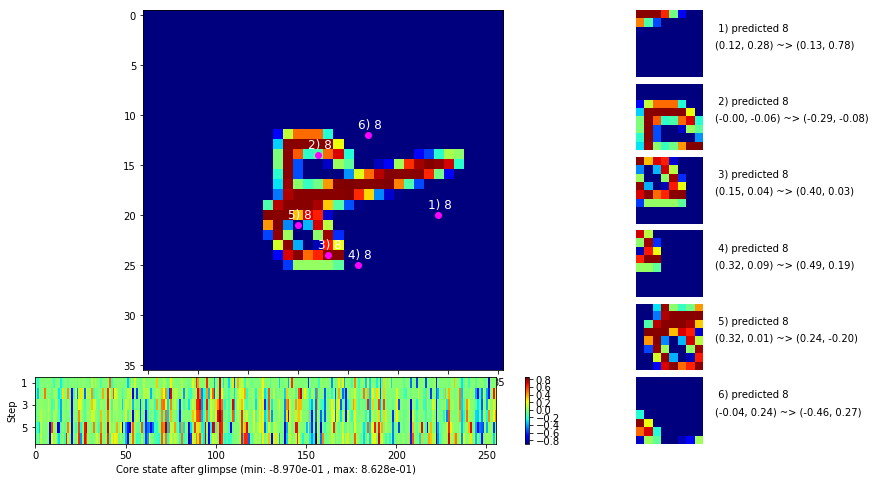

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


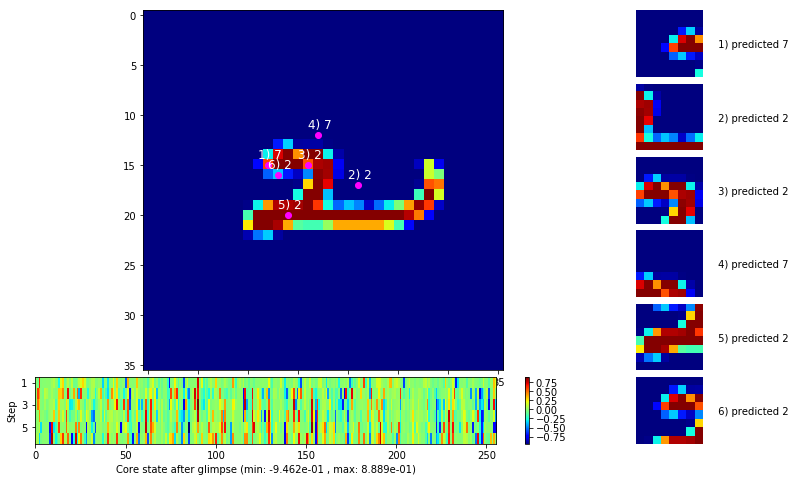


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


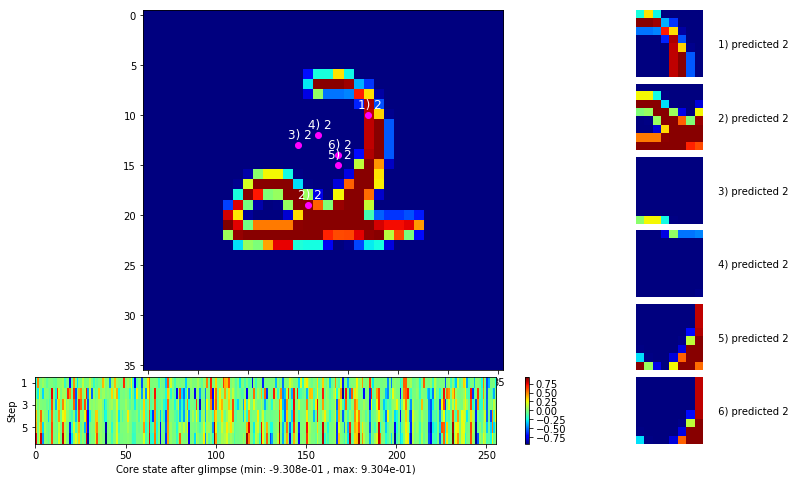

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


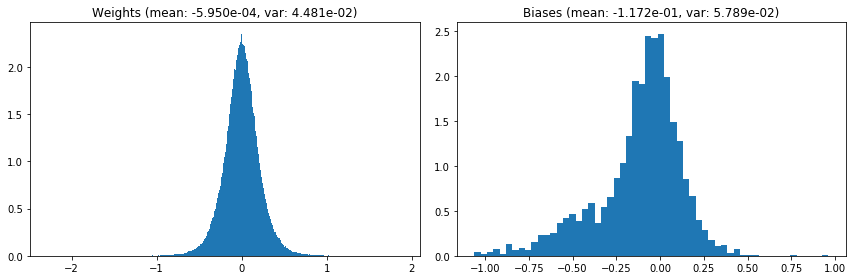

                                      Location network weights and biases


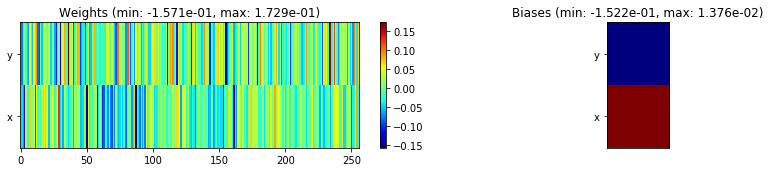

---------------------------------------------------------------------------------------------------------------
Elapsed time:  399.12 sec | TRAIN >> class loss: 0.1322 | steps:  2.078    | reward:  0.9587 :( | acc.: 95.868% :(
                          | VAL   >> class loss: 0.1306 | steps:  1.920    | reward:  0.9610    | acc.: 96.100% 


Epoch  78/400) lr = 0.0001557
 b    500/  3000 >> 127.8 ms/b | lr: 1.55e-04 | grad 2norm:  3.35 | grad inf norm:  1.010
       Weights || abs max:  2.28 (38776.23) | mean: -5.92e-04 ( 0.14) | var: 4.48e-02 (117911.78)
        Biases || abs max:  1.06 ( 1495.76) | mean: -1.17e-01 ( 0.83) | var: 5.79e-02 (158310.31)
                  class loss: 0.127 | steps: 2.076 | reward:  0.960 | acc.: 96.02%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.5 ms/b | lr: 1.55e-04 | grad 2norm:  3.34 | grad inf norm:  0.993
       Weights || abs max:  2.28 (27283.11) | mean: -5.85e-04 ( 0.11) |

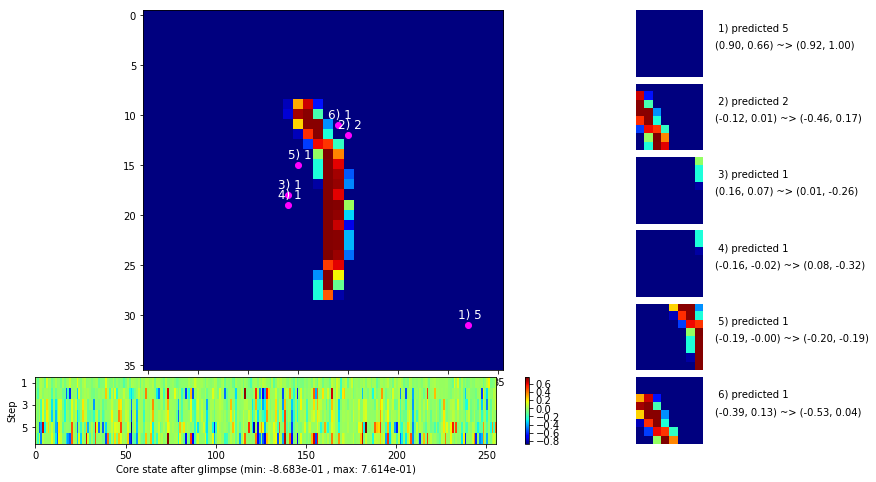

 b   1500/  3000 >> 129.8 ms/b | lr: 1.55e-04 | grad 2norm:  3.49 | grad inf norm:  1.048
       Weights || abs max:  2.28 (139203.64) | mean: -5.83e-04 ( 0.32) | var: 4.48e-02 (6722317.50)
        Biases || abs max:  1.07 (  494.23) | mean: -1.17e-01 ( 0.33) | var: 5.80e-02 ( 6045.74)
                  class loss: 0.130 | steps: 2.079 | reward:  0.958 | acc.: 95.78%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.5 ms/b | lr: 1.55e-04 | grad 2norm:  3.43 | grad inf norm:  1.045
       Weights || abs max:  2.28 (20653.54) | mean: -5.80e-04 ( 0.10) | var: 4.48e-02 (10276.01)
        Biases || abs max:  1.07 (  268.87) | mean: -1.17e-01 ( 0.24) | var: 5.80e-02 (  683.30)
                  class loss: 0.135 | steps: 2.099 | reward:  0.958 | acc.: 95.77%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

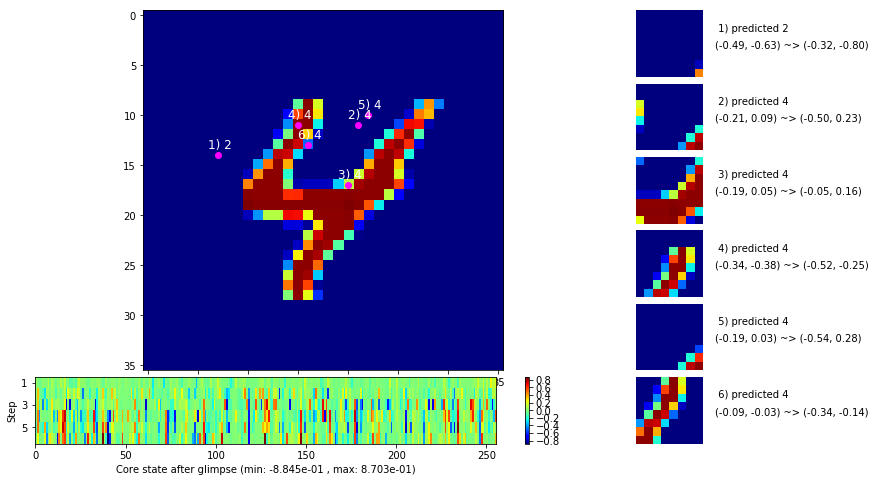

 b   2500/  3000 >> 133.0 ms/b | lr: 1.54e-04 | grad 2norm:  3.36 | grad inf norm:  1.026
       Weights || abs max:  2.28 (48642.35) | mean: -5.81e-04 ( 0.15) | var: 4.49e-02 (138532.86)
        Biases || abs max:  1.06 (  225.85) | mean: -1.17e-01 ( 0.26) | var: 5.80e-02 (  301.69)
                  class loss: 0.130 | steps: 2.076 | reward:  0.960 | acc.: 95.97%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 138.4 ms/b | lr: 1.54e-04 | grad 2norm:  3.50 | grad inf norm:  1.041
       Weights || abs max:  2.27 (34831.77) | mean: -5.86e-04 ( 0.12) | var: 4.49e-02 (170733.33)
        Biases || abs max:  1.06 (  513.28) | mean: -1.18e-01 ( 0.42) | var: 5.80e-02 ( 5591.91)
                  class loss: 0.132 | steps: 2.096 | reward:  0.958 | acc.: 95.76%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

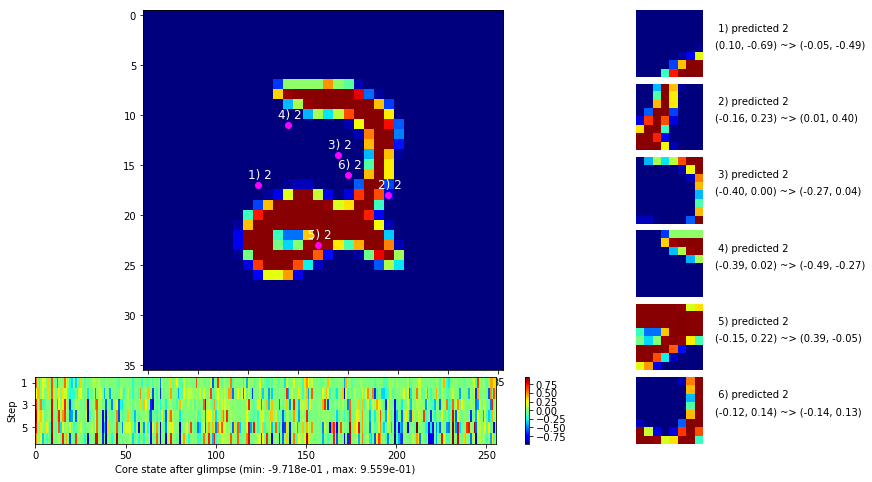

                                          ---===  VALIDATION  ===---

	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


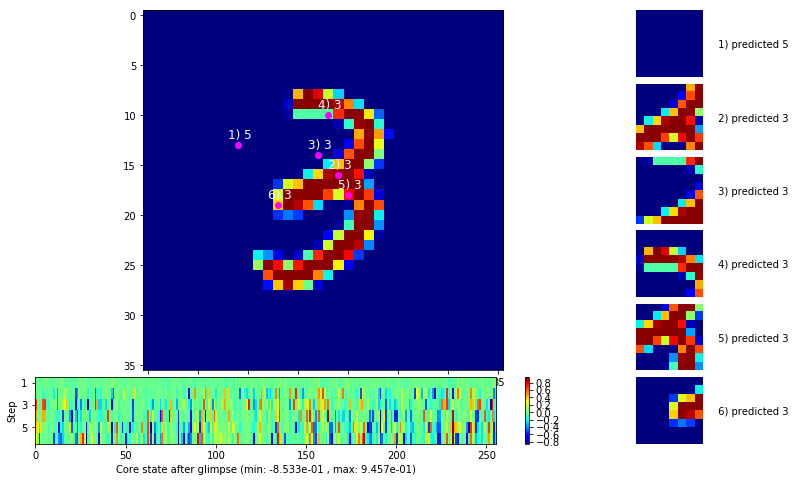


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


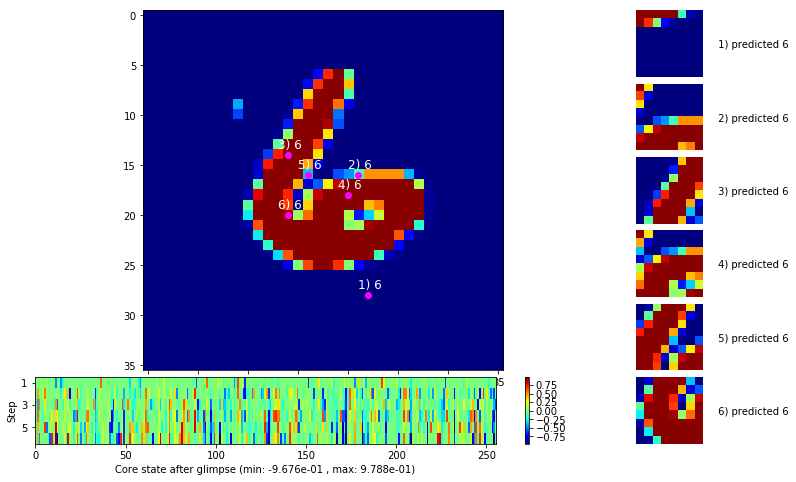

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


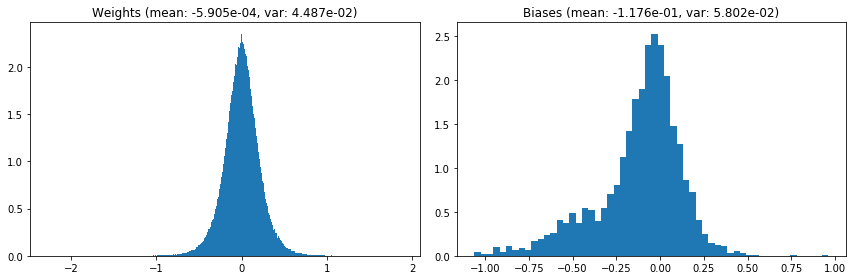

                                      Location network weights and biases


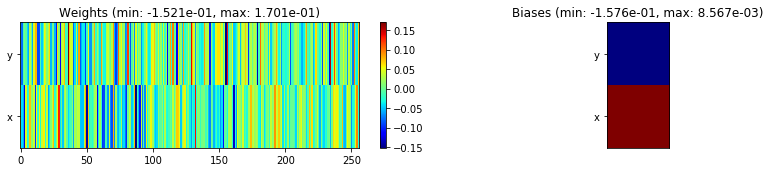

---------------------------------------------------------------------------------------------------------------
Elapsed time:  395.06 sec | TRAIN >> class loss: 0.1311 | steps:  2.085 :( | reward:  0.9588    | acc.: 95.883% 
                          | VAL   >> class loss: 0.1551 | steps:  1.936 :( | reward:  0.9520 :( | acc.: 95.200% :(


Epoch  79/400) lr = 0.000154
 b    500/  3000 >> 140.1 ms/b | lr: 1.54e-04 | grad 2norm:  3.54 | grad inf norm:  1.070
       Weights || abs max:  2.27 (69828.16) | mean: -5.95e-04 ( 0.19) | var: 4.49e-02 (1032397.25)
        Biases || abs max:  1.06 (  435.45) | mean: -1.17e-01 ( 0.31) | var: 5.80e-02 (10507.11)
                  class loss: 0.140 | steps: 2.091 | reward:  0.956 | acc.: 95.55%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 131.7 ms/b | lr: 1.54e-04 | grad 2norm:  3.23 | grad inf norm:  0.973
       Weights || abs max:  2.26 (38519.72) | mean: -5.91e-04 ( 0.13) | 

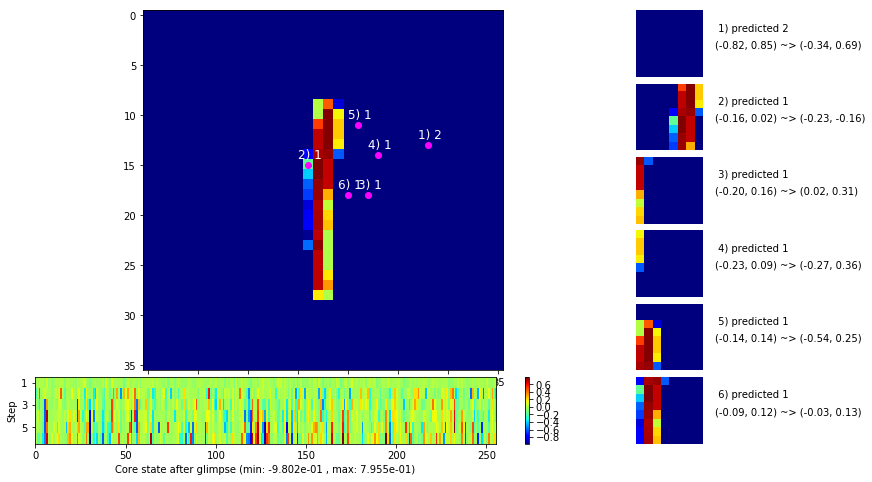

 b   1500/  3000 >> 131.5 ms/b | lr: 1.53e-04 | grad 2norm:  3.42 | grad inf norm:  1.012
       Weights || abs max:  2.26 (21776.25) | mean: -5.89e-04 ( 0.10) | var: 4.49e-02 (10618.00)
        Biases || abs max:  1.06 (  239.39) | mean: -1.17e-01 ( 0.27) | var: 5.81e-02 (  642.11)
                  class loss: 0.134 | steps: 2.089 | reward:  0.959 | acc.: 95.92%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 128.1 ms/b | lr: 1.53e-04 | grad 2norm:  3.44 | grad inf norm:  1.018
       Weights || abs max:  2.27 (25803.28) | mean: -5.85e-04 ( 0.11) | var: 4.49e-02 (23596.66)
        Biases || abs max:  1.06 (  123.26) | mean: -1.17e-01 ( 0.18) | var: 5.81e-02 (  103.17)
                  class loss: 0.126 | steps: 2.087 | reward:  0.959 | acc.: 95.87%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

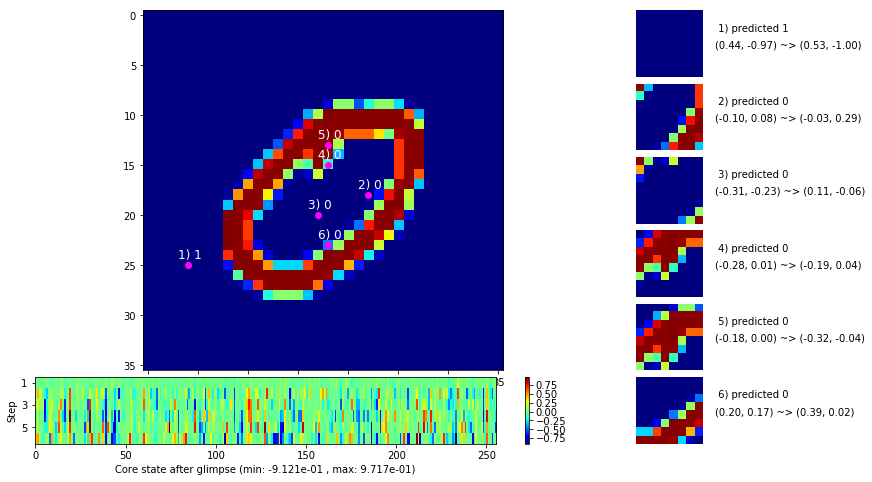

 b   2500/  3000 >> 130.1 ms/b | lr: 1.53e-04 | grad 2norm:  3.30 | grad inf norm:  1.017
       Weights || abs max:  2.27 (82610.03) | mean: -5.89e-04 ( 0.22) | var: 4.49e-02 (955913.62)
        Biases || abs max:  1.07 ( 3409.50) | mean: -1.17e-01 ( 1.46) | var: 5.81e-02 (2091498.25)
                  class loss: 0.121 | steps: 2.080 | reward:  0.961 | acc.: 96.07%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 129.1 ms/b | lr: 1.52e-04 | grad 2norm:  3.53 | grad inf norm:  1.050
       Weights || abs max:  2.27 (35495.83) | mean: -5.93e-04 ( 0.13) | var: 4.49e-02 (209675.98)
        Biases || abs max:  1.07 (  163.23) | mean: -1.17e-01 ( 0.22) | var: 5.81e-02 (  205.29)
                  class loss: 0.138 | steps: 2.099 | reward:  0.957 | acc.: 95.70%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

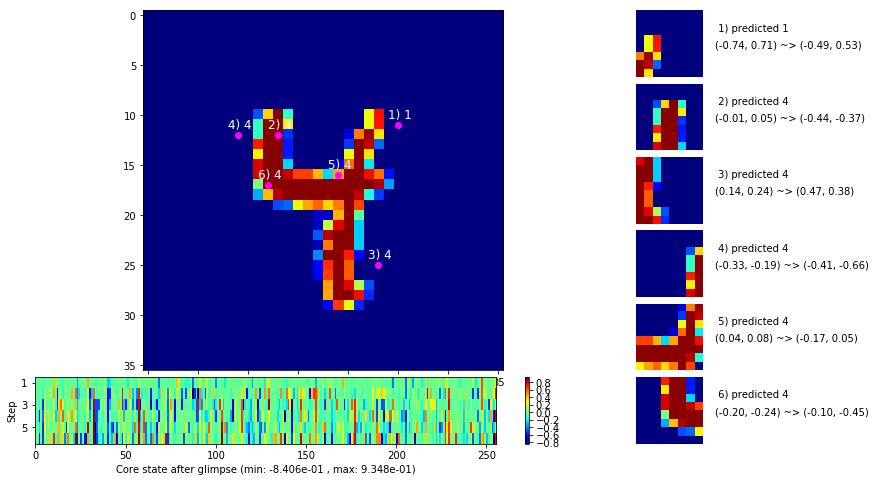

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


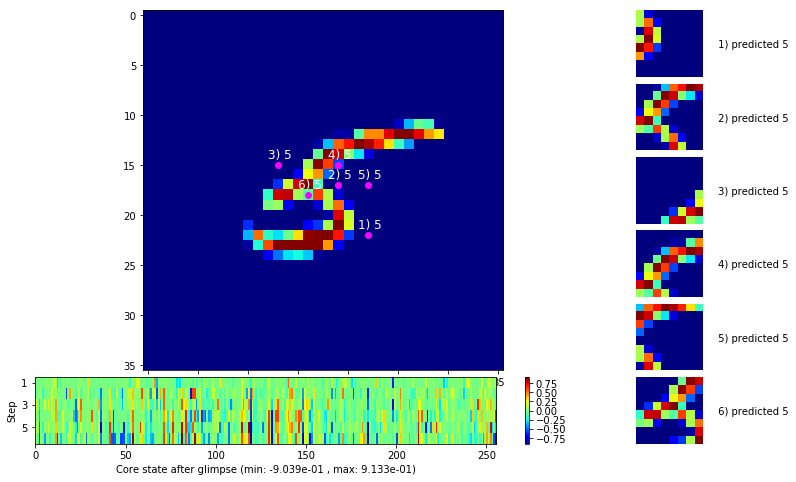


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


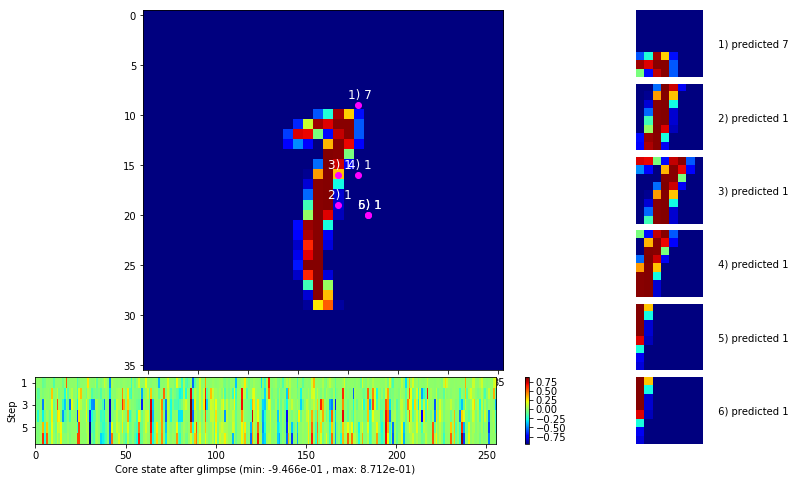

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


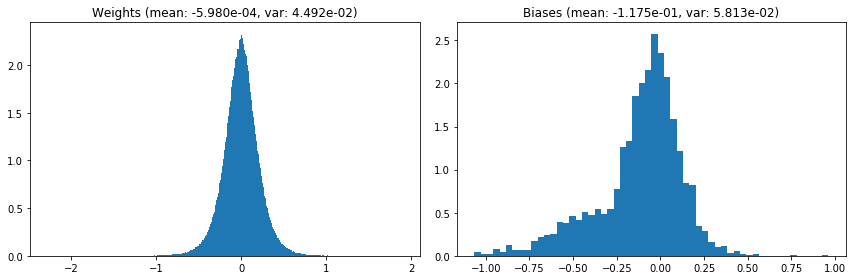

                                      Location network weights and biases


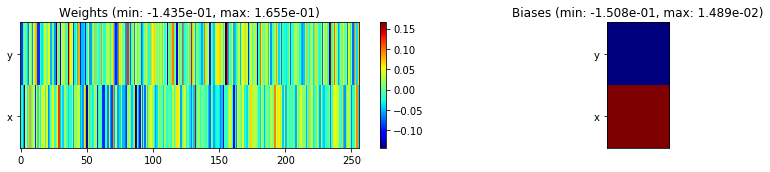

---------------------------------------------------------------------------------------------------------------
Elapsed time:  396.13 sec | TRAIN >> class loss: 0.1299 | steps:  2.090 :( | reward:  0.9589    | acc.: 95.893% 
                          | VAL   >> class loss: 0.1514 | steps:  1.936 :( | reward:  0.9526 :( | acc.: 95.260% :(


Epoch  80/400) lr = 0.0001524
 b    500/  3000 >> 129.4 ms/b | lr: 1.52e-04 | grad 2norm:  3.48 | grad inf norm:  1.007
       Weights || abs max:  2.27 (54642.69) | mean: -5.96e-04 ( 0.17) | var: 4.49e-02 (364742.84)
        Biases || abs max:  1.06 ( 1155.64) | mean: -1.18e-01 ( 0.60) | var: 5.82e-02 (56581.96)
                  class loss: 0.134 | steps: 2.086 | reward:  0.958 | acc.: 95.75%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 131.0 ms/b | lr: 1.52e-04 | grad 2norm:  3.25 | grad inf norm:  0.981
       Weights || abs max:  2.27 (32264.81) | mean: -6.02e-04 ( 0.12) | 

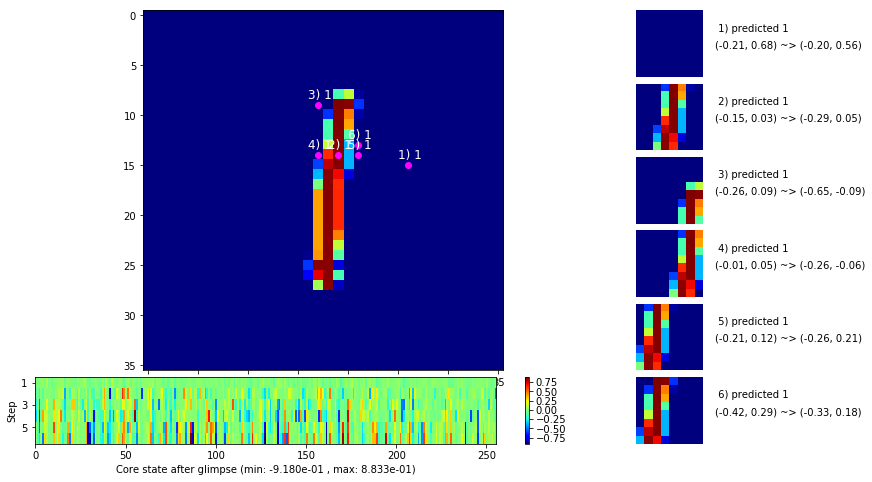

 b   1500/  3000 >> 135.8 ms/b | lr: 1.52e-04 | grad 2norm:  3.36 | grad inf norm:  0.960
       Weights || abs max:  2.27 (59066.83) | mean: -6.12e-04 ( 0.17) | var: 4.49e-02 (1003089.12)
        Biases || abs max:  1.07 (  400.40) | mean: -1.18e-01 ( 0.39) | var: 5.83e-02 ( 4958.46)
                  class loss: 0.126 | steps: 2.080 | reward:  0.960 | acc.: 96.03%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 142.4 ms/b | lr: 1.51e-04 | grad 2norm:  3.30 | grad inf norm:  0.957
       Weights || abs max:  2.27 (40219.21) | mean: -6.12e-04 ( 0.14) | var: 4.49e-02 (106485.82)
        Biases || abs max:  1.07 (  333.65) | mean: -1.18e-01 ( 0.27) | var: 5.83e-02 (  340.98)
                  class loss: 0.124 | steps: 2.073 | reward:  0.961 | acc.: 96.08%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

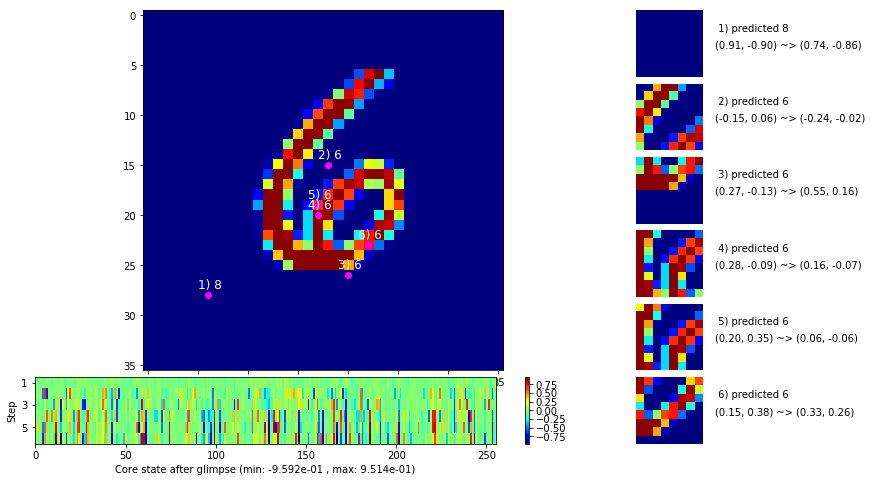

 b   2500/  3000 >> 133.4 ms/b | lr: 1.51e-04 | grad 2norm:  3.21 | grad inf norm:  0.968
       Weights || abs max:  2.28 (56661.70) | mean: -6.03e-04 ( 0.17) | var: 4.50e-02 (337574.50)
        Biases || abs max:  1.07 (  135.65) | mean: -1.17e-01 ( 0.19) | var: 5.83e-02 (  159.35)
                  class loss: 0.122 | steps: 2.074 | reward:  0.963 | acc.: 96.27%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 133.6 ms/b | lr: 1.51e-04 | grad 2norm:  3.31 | grad inf norm:  0.995
       Weights || abs max:  2.28 (34602.66) | mean: -6.03e-04 ( 0.13) | var: 4.50e-02 (81963.93)
        Biases || abs max:  1.08 (   64.51) | mean: -1.17e-01 ( 0.15) | var: 5.83e-02 (   35.00)
                  class loss: 0.131 | steps: 2.080 | reward:  0.961 | acc.: 96.07%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

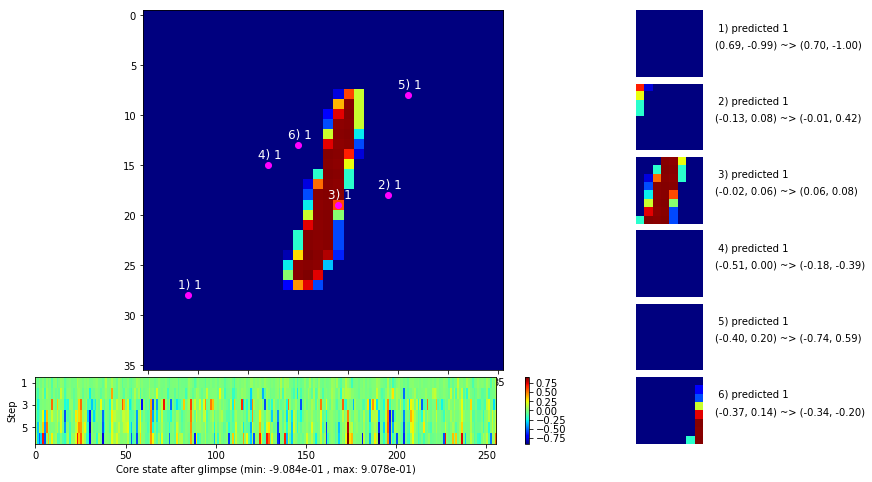

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


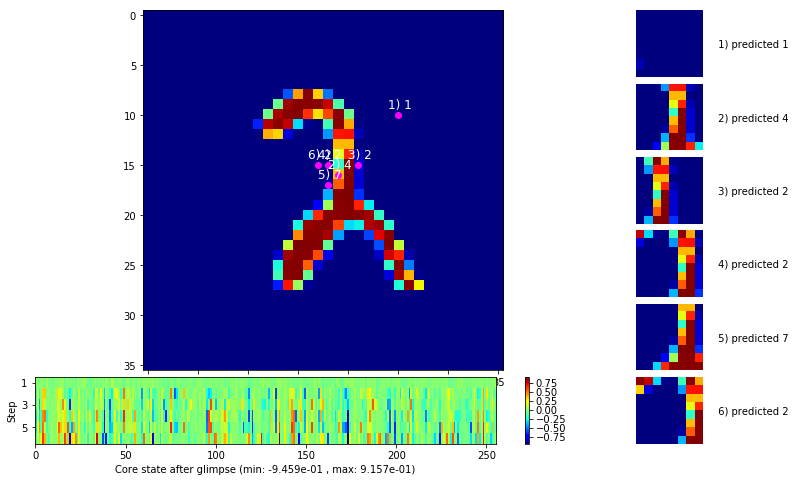


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


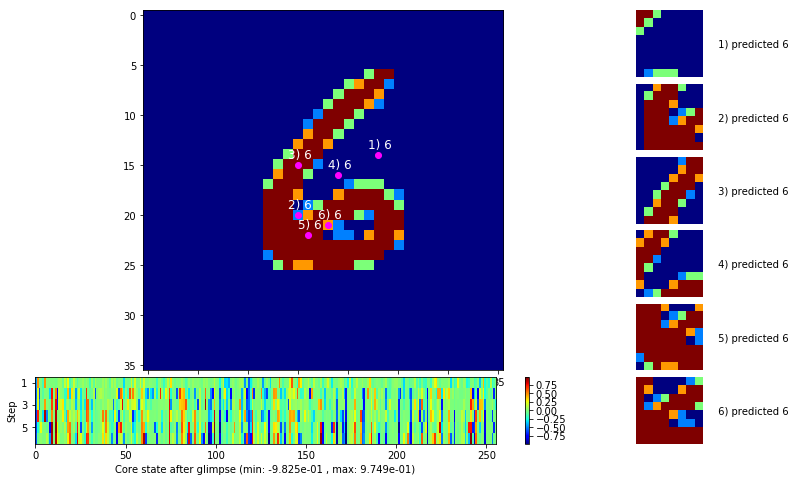

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


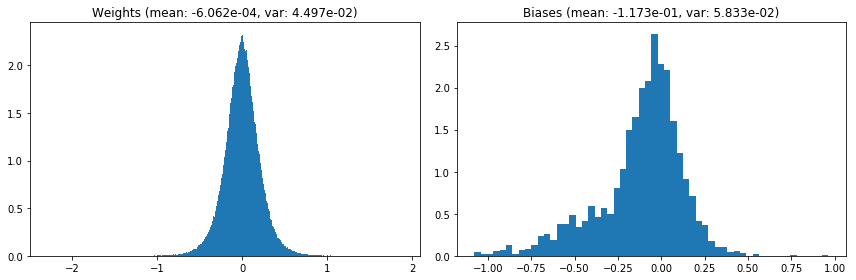

                                      Location network weights and biases


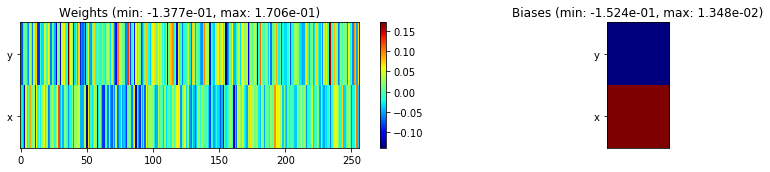

---------------------------------------------------------------------------------------------------------------
Elapsed time:  403.35 sec | TRAIN >> class loss: 0.1274 | steps:  2.078 :( | reward:  0.9607    | acc.: 96.072% 
                          | VAL   >> class loss: 0.1388 | steps:  1.931 :( | reward:  0.9582 :( | acc.: 95.820% :(


Epoch  81/400) lr = 0.0001508
 b    500/  3000 >> 127.4 ms/b | lr: 1.51e-04 | grad 2norm:  3.34 | grad inf norm:  1.008
       Weights || abs max:  2.28 (13966.74) | mean: -6.08e-04 ( 0.08) | var: 4.50e-02 ( 3197.56)
        Biases || abs max:  1.08 (  107.70) | mean: -1.17e-01 ( 0.18) | var: 5.83e-02 (  140.01)
                  class loss: 0.128 | steps: 2.094 | reward:  0.959 | acc.: 95.93%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.8 ms/b | lr: 1.50e-04 | grad 2norm:  3.39 | grad inf norm:  1.005
       Weights || abs max:  2.28 (51136.83) | mean: -6.11e-04 ( 0.15) | v

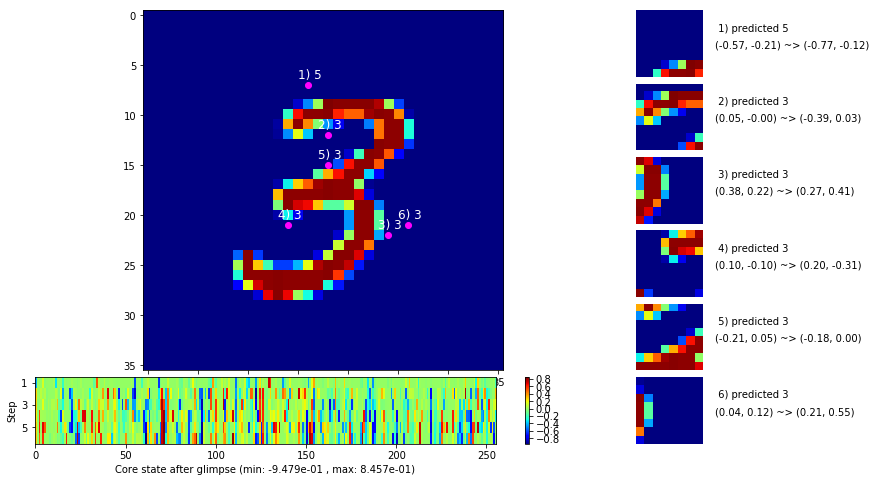

 b   1500/  3000 >> 130.8 ms/b | lr: 1.50e-04 | grad 2norm:  3.43 | grad inf norm:  1.037
       Weights || abs max:  2.27 (33447.13) | mean: -6.13e-04 ( 0.12) | var: 4.50e-02 (64248.62)
        Biases || abs max:  1.08 (  191.81) | mean: -1.18e-01 ( 0.21) | var: 5.83e-02 (  183.02)
                  class loss: 0.134 | steps: 2.083 | reward:  0.958 | acc.: 95.83%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 130.5 ms/b | lr: 1.50e-04 | grad 2norm:  3.17 | grad inf norm:  0.957
       Weights || abs max:  2.27 (33735.34) | mean: -6.11e-04 ( 0.12) | var: 4.50e-02 (57803.06)
        Biases || abs max:  1.07 (  220.73) | mean: -1.18e-01 ( 0.21) | var: 5.83e-02 (  775.47)
                  class loss: 0.115 | steps: 2.069 | reward:  0.963 | acc.: 96.31%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

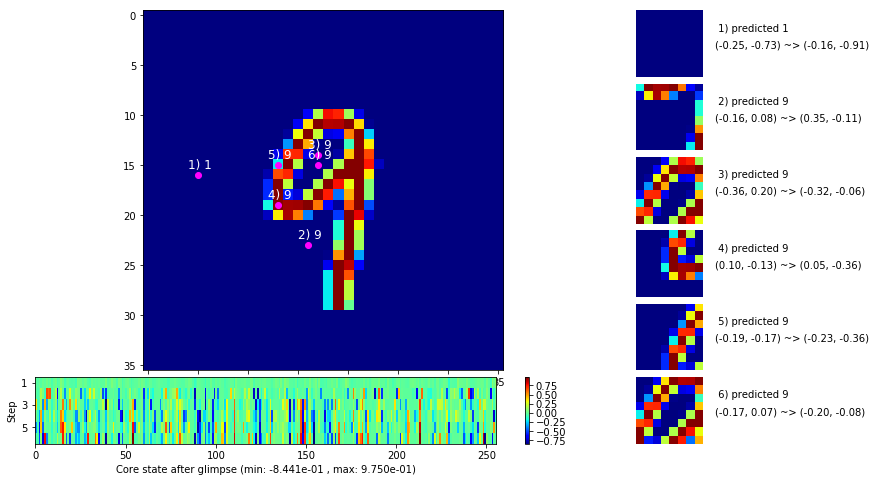

 b   2500/  3000 >> 131.2 ms/b | lr: 1.49e-04 | grad 2norm:  3.45 | grad inf norm:  1.025
       Weights || abs max:  2.28 (33754.22) | mean: -5.98e-04 ( 0.13) | var: 4.50e-02 (54679.78)
        Biases || abs max:  1.07 (  880.36) | mean: -1.18e-01 ( 0.47) | var: 5.84e-02 (31809.44)
                  class loss: 0.132 | steps: 2.087 | reward:  0.957 | acc.: 95.74%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 139.4 ms/b | lr: 1.49e-04 | grad 2norm:  3.45 | grad inf norm:  1.033
       Weights || abs max:  2.28 (28434.89) | mean: -5.97e-04 ( 0.12) | var: 4.50e-02 (35127.74)
        Biases || abs max:  1.07 (  130.56) | mean: -1.17e-01 ( 0.18) | var: 5.84e-02 (  188.15)
                  class loss: 0.126 | steps: 2.089 | reward:  0.958 | acc.: 95.82%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

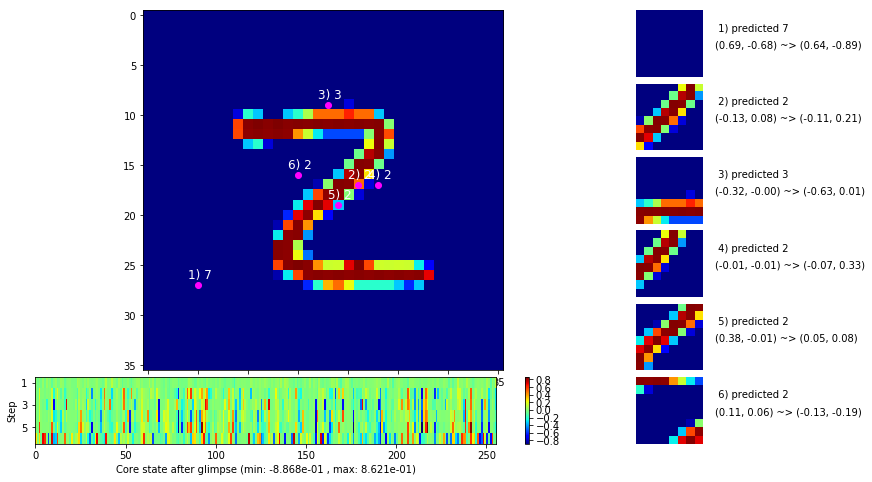

                                          ---===  VALIDATION  ===---

	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


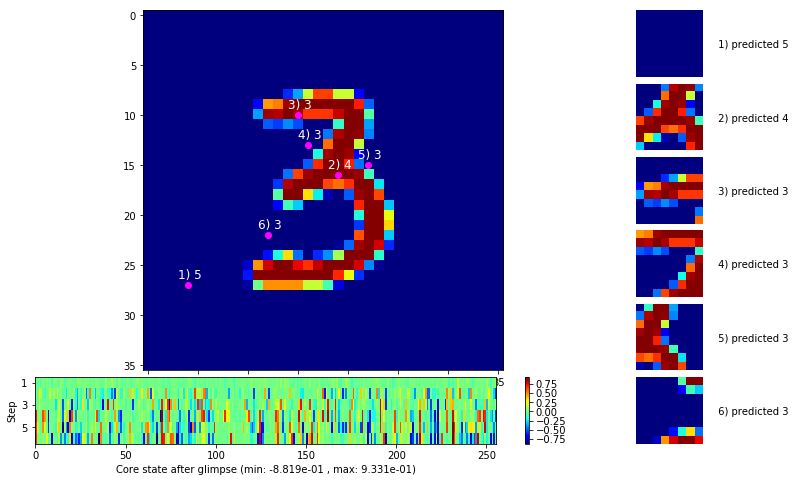


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


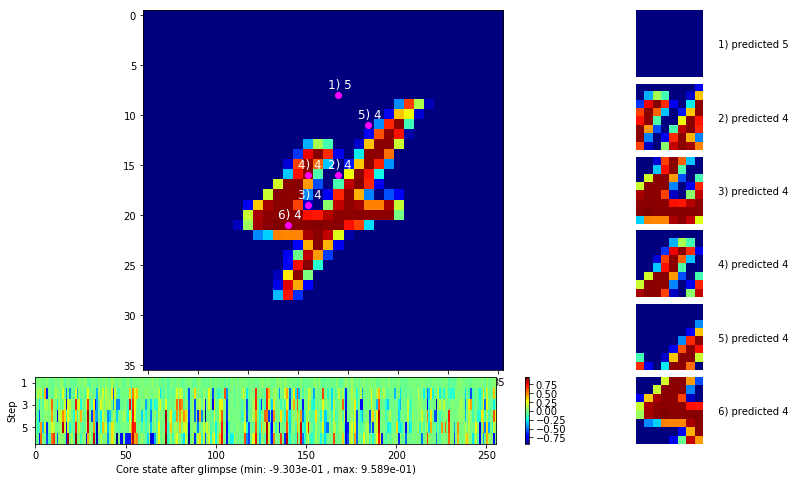

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


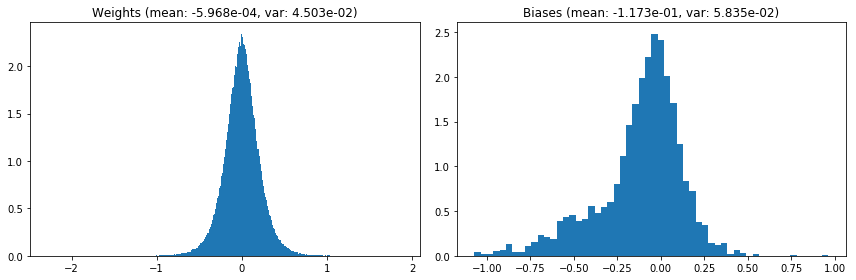

                                      Location network weights and biases


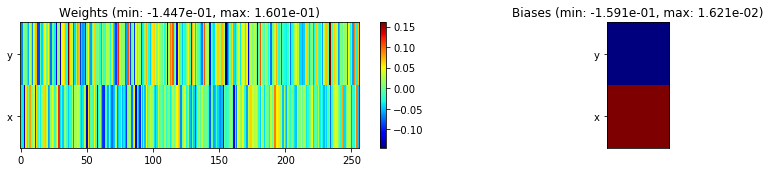

---------------------------------------------------------------------------------------------------------------
Elapsed time:  395.43 sec | TRAIN >> class loss: 0.1271 | steps:  2.085 :( | reward:  0.9594 :( | acc.: 95.938% :(
                          | VAL   >> class loss: 0.1376 | steps:  1.938 :( | reward:  0.9570 :( | acc.: 95.700% :(


Epoch  82/400) lr = 0.0001492
 b    500/  3000 >> 141.0 ms/b | lr: 1.49e-04 | grad 2norm:  3.42 | grad inf norm:  1.034
       Weights || abs max:  2.28 (32589.51) | mean: -5.98e-04 ( 0.12) | var: 4.50e-02 (49589.47)
        Biases || abs max:  1.07 (  329.94) | mean: -1.17e-01 ( 0.31) | var: 5.84e-02 (  798.77)
                  class loss: 0.140 | steps: 2.087 | reward:  0.958 | acc.: 95.82%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.8 ms/b | lr: 1.49e-04 | grad 2norm:  3.21 | grad inf norm:  0.974
       Weights || abs max:  2.28 (41472.76) | mean: -5.88e-04 ( 0.14) |

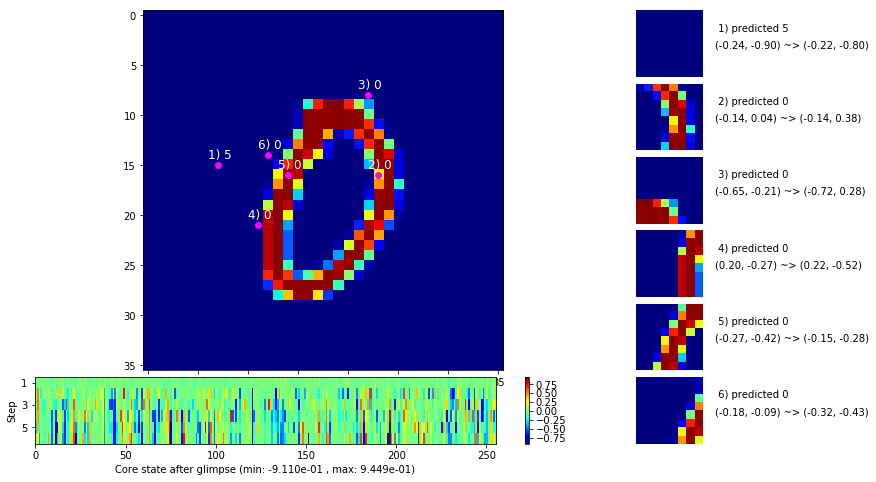

 b   1500/  3000 >> 133.1 ms/b | lr: 1.48e-04 | grad 2norm:  3.30 | grad inf norm:  0.980
       Weights || abs max:  2.28 (57027.88) | mean: -5.91e-04 ( 0.17) | var: 4.51e-02 (409970.78)
        Biases || abs max:  1.08 ( 1405.91) | mean: -1.17e-01 ( 0.72) | var: 5.84e-02 (261617.31)
                  class loss: 0.123 | steps: 2.086 | reward:  0.962 | acc.: 96.21%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.4 ms/b | lr: 1.48e-04 | grad 2norm:  3.41 | grad inf norm:  1.021
       Weights || abs max:  2.28 (29581.05) | mean: -5.94e-04 ( 0.12) | var: 4.51e-02 (72843.22)
        Biases || abs max:  1.08 (  182.72) | mean: -1.17e-01 ( 0.20) | var: 5.84e-02 (  176.92)
                  class loss: 0.128 | steps: 2.095 | reward:  0.958 | acc.: 95.80%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

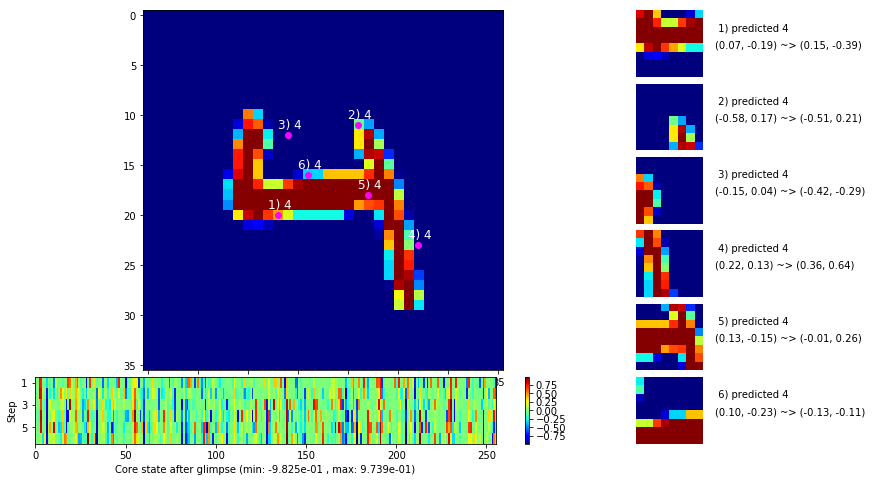

 b   2500/  3000 >> 132.0 ms/b | lr: 1.48e-04 | grad 2norm:  3.45 | grad inf norm:  1.006
       Weights || abs max:  2.28 (36779.91) | mean: -6.01e-04 ( 0.13) | var: 4.51e-02 (77372.15)
        Biases || abs max:  1.08 (  141.62) | mean: -1.17e-01 ( 0.20) | var: 5.84e-02 (  497.98)
                  class loss: 0.127 | steps: 2.084 | reward:  0.958 | acc.: 95.84%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.9 ms/b | lr: 1.48e-04 | grad 2norm:  3.42 | grad inf norm:  1.031
       Weights || abs max:  2.28 (41807.57) | mean: -6.10e-04 ( 0.14) | var: 4.51e-02 (110120.26)
        Biases || abs max:  1.08 (  266.26) | mean: -1.17e-01 ( 0.26) | var: 5.85e-02 (  731.40)
                  class loss: 0.128 | steps: 2.067 | reward:  0.959 | acc.: 95.89%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

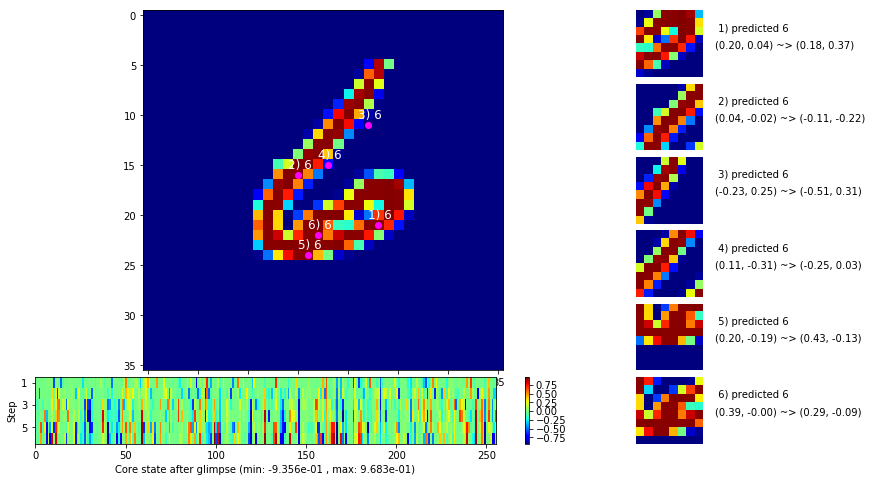

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


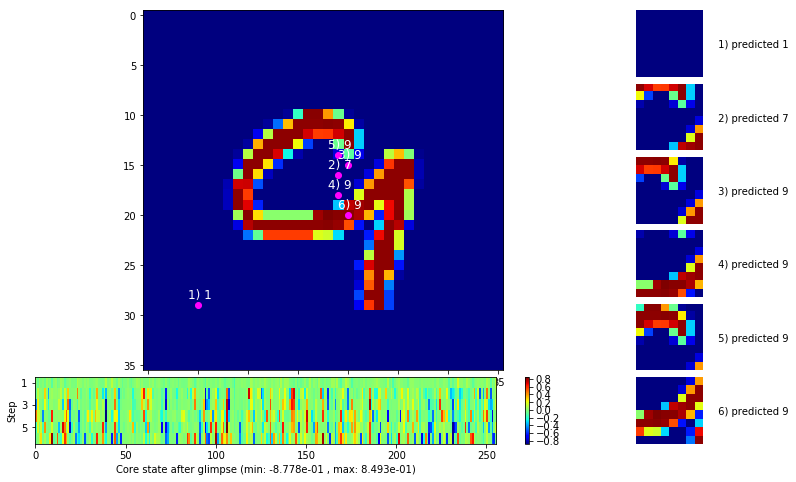


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


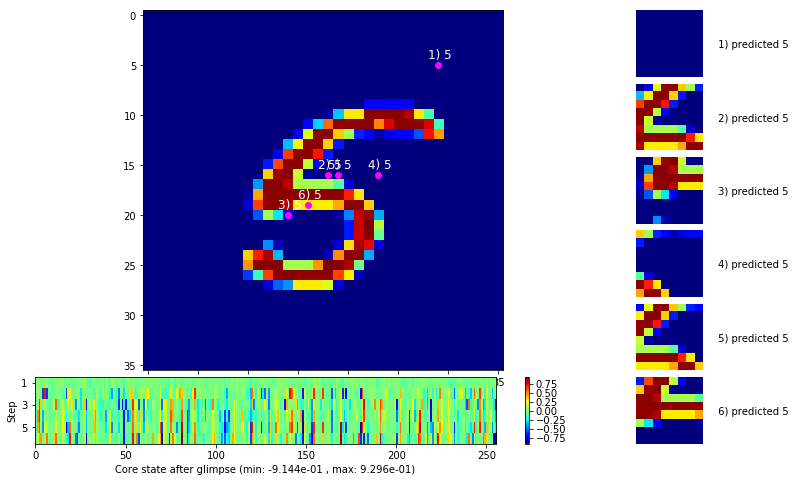

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


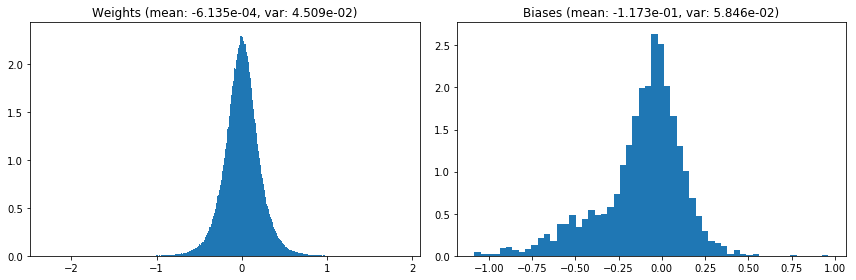

                                      Location network weights and biases


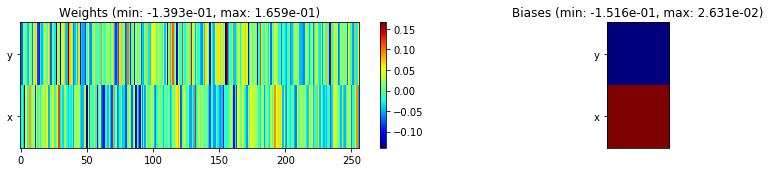

---------------------------------------------------------------------------------------------------------------
Elapsed time:  397.19 sec | TRAIN >> class loss: 0.1279 | steps:  2.081 :( | reward:  0.9598 :( | acc.: 95.977% :(
                          | VAL   >> class loss: 0.1387 | steps:  1.938 :( | reward:  0.9572 :( | acc.: 95.720% :(


Epoch  83/400) lr = 0.0001476
 b    500/  3000 >> 131.6 ms/b | lr: 1.47e-04 | grad 2norm:  3.47 | grad inf norm:  1.000
       Weights || abs max:  2.28 (253209.14) | mean: -6.10e-04 ( 0.54) | var: 4.51e-02 (34523500.00)
        Biases || abs max:  1.08 (  157.04) | mean: -1.17e-01 ( 0.22) | var: 5.85e-02 (  879.16)
                  class loss: 0.137 | steps: 2.086 | reward:  0.958 | acc.: 95.84%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.8 ms/b | lr: 1.47e-04 | grad 2norm:  3.14 | grad inf norm:  0.946
       Weights || abs max:  2.28 (35561.66) | mean: -6.10e-04 ( 0.1

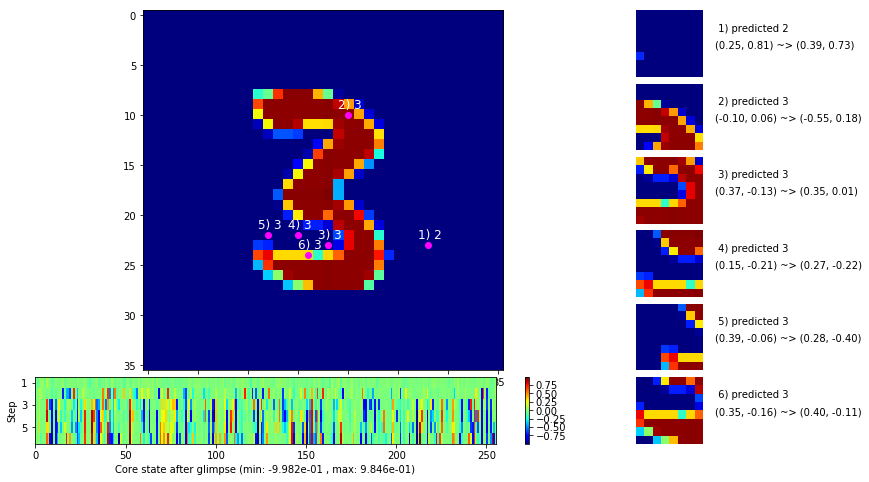

 b   1500/  3000 >> 139.6 ms/b | lr: 1.47e-04 | grad 2norm:  3.24 | grad inf norm:  0.983
       Weights || abs max:  2.28 (26832.62) | mean: -6.09e-04 ( 0.12) | var: 4.51e-02 (51396.07)
        Biases || abs max:  1.08 (  259.06) | mean: -1.18e-01 ( 0.23) | var: 5.86e-02 (  272.36)
                  class loss: 0.123 | steps: 2.076 | reward:  0.962 | acc.: 96.16%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 139.6 ms/b | lr: 1.47e-04 | grad 2norm:  3.44 | grad inf norm:  1.015
       Weights || abs max:  2.28 (29982.74) | mean: -6.18e-04 ( 0.12) | var: 4.51e-02 (31176.13)
        Biases || abs max:  1.08 (  139.86) | mean: -1.18e-01 ( 0.22) | var: 5.86e-02 (  534.12)
                  class loss: 0.132 | steps: 2.081 | reward:  0.959 | acc.: 95.87%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

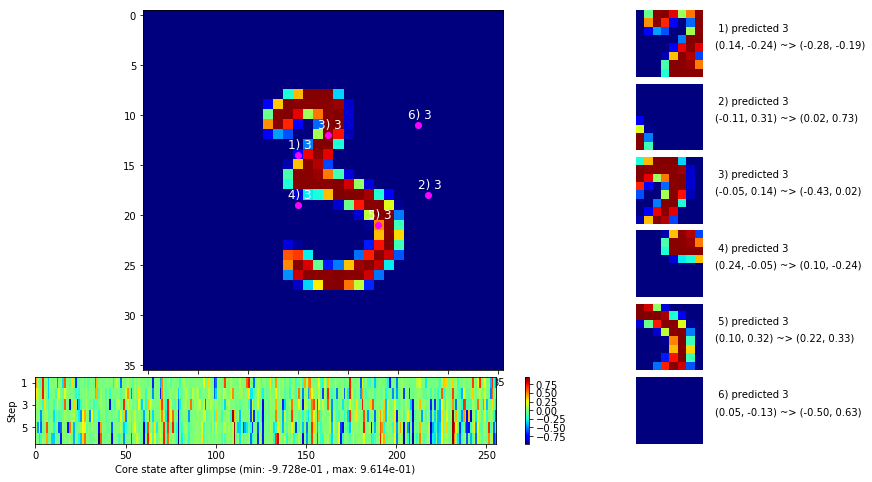

 b   2500/  3000 >> 132.4 ms/b | lr: 1.46e-04 | grad 2norm:  3.05 | grad inf norm:  0.909
       Weights || abs max:  2.28 (21938.37) | mean: -6.22e-04 ( 0.10) | var: 4.51e-02 (11771.56)
        Biases || abs max:  1.08 (  180.37) | mean: -1.18e-01 ( 0.20) | var: 5.86e-02 (   94.49)
                  class loss: 0.118 | steps: 2.077 | reward:  0.966 | acc.: 96.59%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 129.9 ms/b | lr: 1.46e-04 | grad 2norm:  3.38 | grad inf norm:  0.992
       Weights || abs max:  2.28 (37843.20) | mean: -6.22e-04 ( 0.14) | var: 4.51e-02 (61373.74)
        Biases || abs max:  1.08 (  150.73) | mean: -1.18e-01 ( 0.22) | var: 5.86e-02 (  316.36)
                  class loss: 0.123 | steps: 2.090 | reward:  0.959 | acc.: 95.90%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

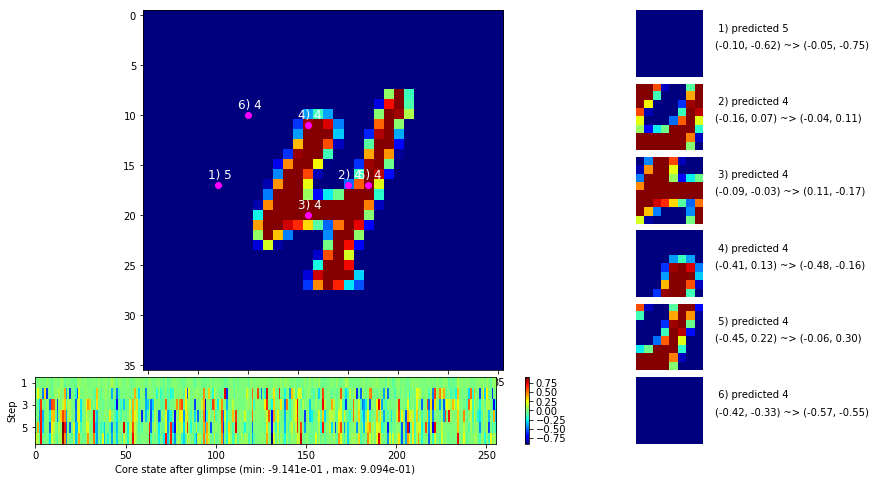

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


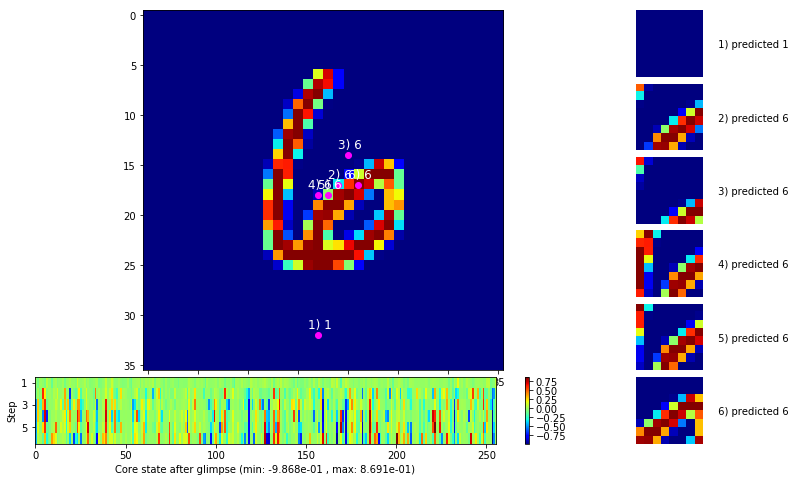


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


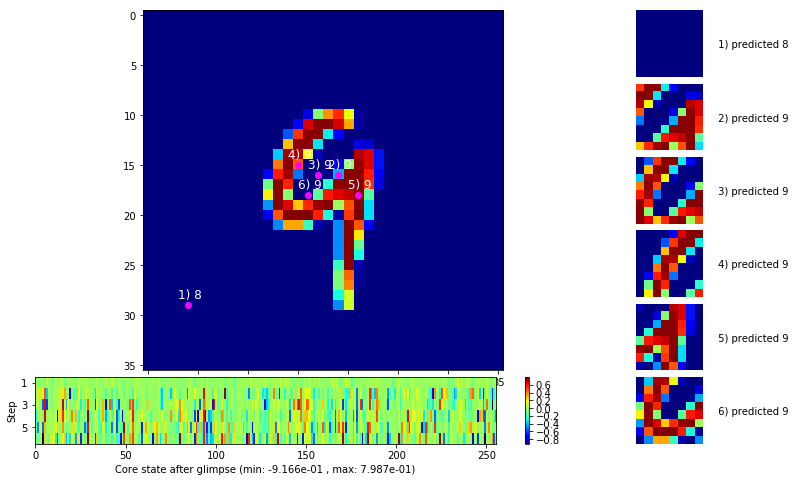

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


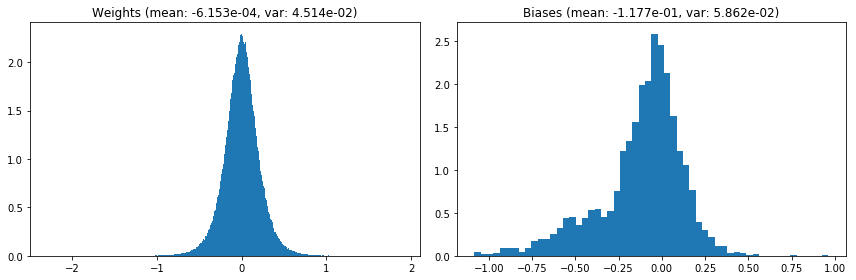

                                      Location network weights and biases


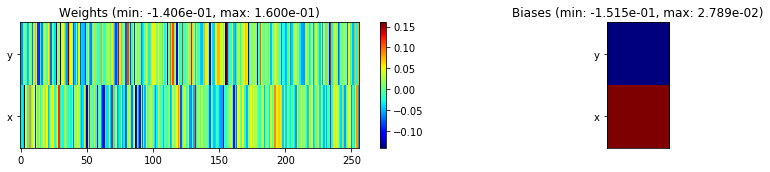

---------------------------------------------------------------------------------------------------------------
Elapsed time:  402.68 sec | TRAIN >> class loss: 0.1258 | steps:  2.084 :( | reward:  0.9613    | acc.: 96.127% 
                          | VAL   >> class loss: 0.1355 | steps:  1.951 :( | reward:  0.9590 :( | acc.: 95.900% :(


Epoch  84/400) lr = 0.0001461
 b    500/  3000 >> 126.8 ms/b | lr: 1.46e-04 | grad 2norm:  3.28 | grad inf norm:  1.005
       Weights || abs max:  2.28 (47963.38) | mean: -6.13e-04 ( 0.15) | var: 4.51e-02 (448457.81)
        Biases || abs max:  1.08 (  281.05) | mean: -1.17e-01 ( 0.25) | var: 5.86e-02 ( 3363.41)
                  class loss: 0.119 | steps: 2.063 | reward:  0.961 | acc.: 96.10%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 131.2 ms/b | lr: 1.46e-04 | grad 2norm:  3.52 | grad inf norm:  1.020
       Weights || abs max:  2.28 (59269.20) | mean: -6.12e-04 ( 0.19) | 

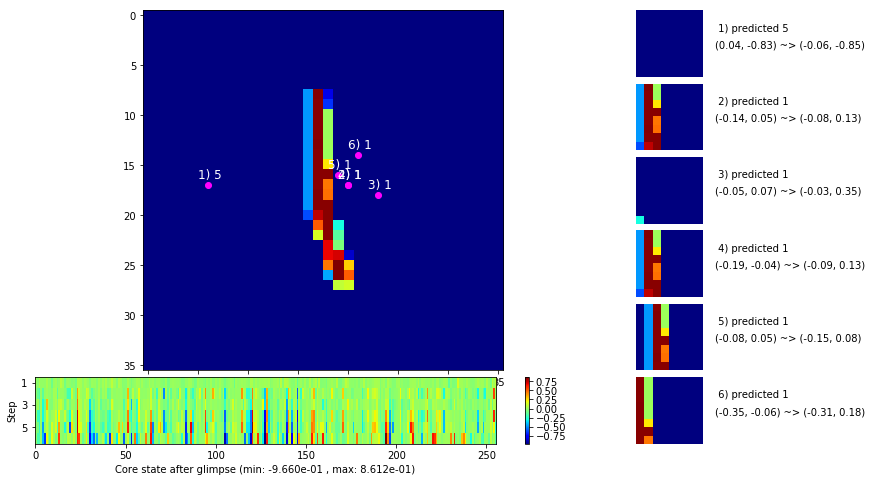

 b   1500/  3000 >> 131.7 ms/b | lr: 1.45e-04 | grad 2norm:  3.37 | grad inf norm:  1.034
       Weights || abs max:  2.28 (32204.12) | mean: -6.08e-04 ( 0.13) | var: 4.52e-02 (45139.50)
        Biases || abs max:  1.08 (  716.90) | mean: -1.18e-01 ( 0.47) | var: 5.87e-02 ( 4778.62)
                  class loss: 0.132 | steps: 2.079 | reward:  0.960 | acc.: 95.95%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 131.1 ms/b | lr: 1.45e-04 | grad 2norm:  3.38 | grad inf norm:  0.980
       Weights || abs max:  2.28 (97660.61) | mean: -6.11e-04 ( 0.25) | var: 4.52e-02 (827296.75)
        Biases || abs max:  1.08 (  820.64) | mean: -1.18e-01 ( 0.51) | var: 5.87e-02 ( 7645.02)
                  class loss: 0.129 | steps: 2.087 | reward:  0.959 | acc.: 95.92%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

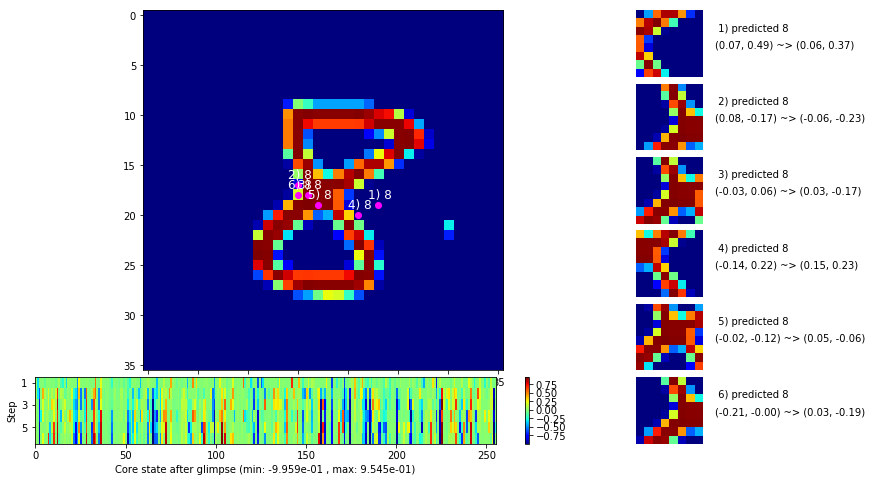

 b   2500/  3000 >> 132.4 ms/b | lr: 1.45e-04 | grad 2norm:  3.14 | grad inf norm:  0.940
       Weights || abs max:  2.28 (34140.12) | mean: -6.13e-04 ( 0.13) | var: 4.52e-02 (58011.02)
        Biases || abs max:  1.08 (  561.01) | mean: -1.18e-01 ( 0.44) | var: 5.86e-02 ( 8547.39)
                  class loss: 0.110 | steps: 2.073 | reward:  0.965 | acc.: 96.46%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 138.0 ms/b | lr: 1.45e-04 | grad 2norm:  3.34 | grad inf norm:  0.984
       Weights || abs max:  2.28 (121368.38) | mean: -6.12e-04 ( 0.30) | var: 4.52e-02 (5121207.50)
        Biases || abs max:  1.08 (  225.12) | mean: -1.18e-01 ( 0.28) | var: 5.86e-02 (  375.91)
                  class loss: 0.132 | steps: 2.092 | reward:  0.960 | acc.: 96.04%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

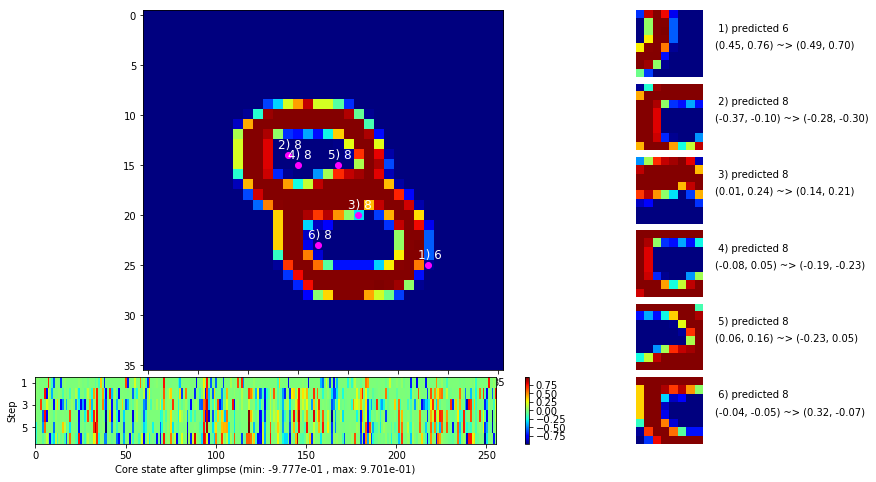

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


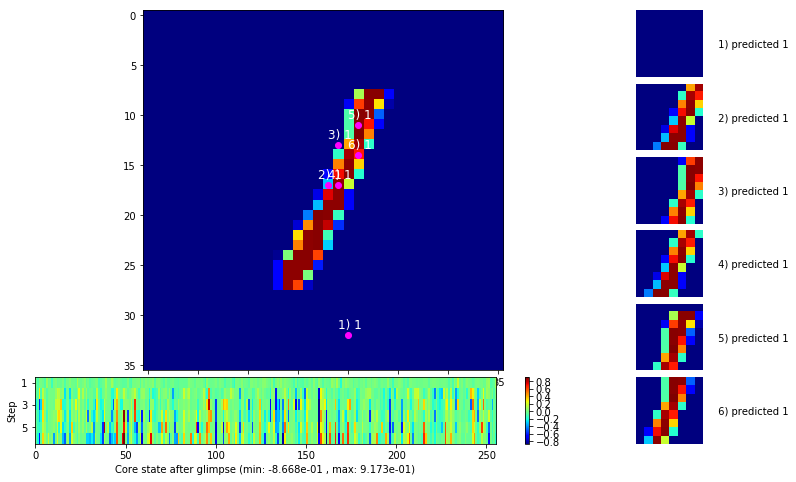


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


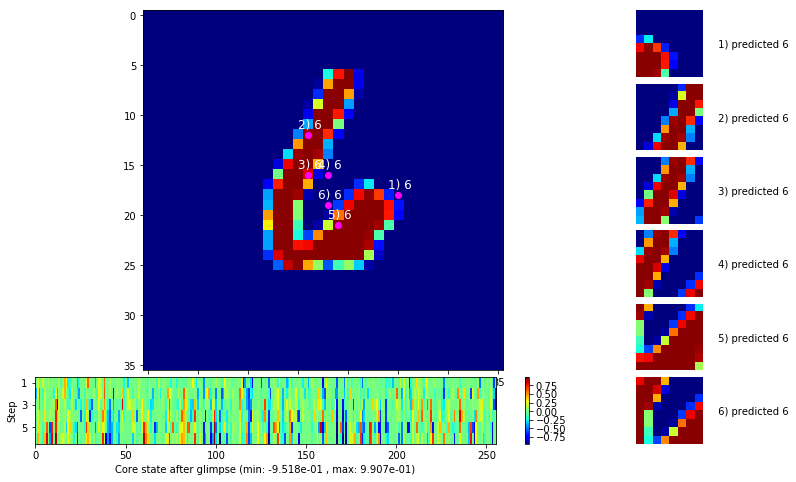

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


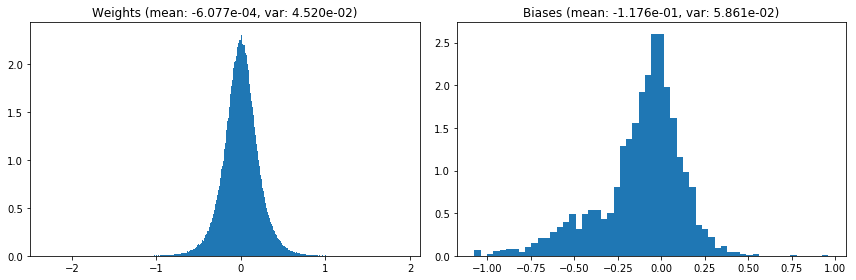

                                      Location network weights and biases


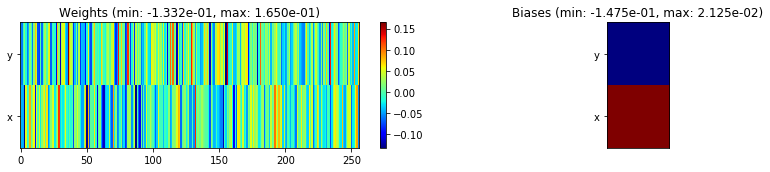

---------------------------------------------------------------------------------------------------------------
Elapsed time:  396.19 sec | TRAIN >> class loss: 0.1258 | steps:  2.084 :( | reward:  0.9603 :( | acc.: 96.028% :(
                          | VAL   >> class loss: 0.1442 | steps:  1.953 :( | reward:  0.9544 :( | acc.: 95.440% :(


Epoch  85/400) lr = 0.0001446
 b    500/  3000 >> 137.0 ms/b | lr: 1.44e-04 | grad 2norm:  3.31 | grad inf norm:  0.974
       Weights || abs max:  2.29 (53972.59) | mean: -6.07e-04 ( 0.17) | var: 4.52e-02 (282224.56)
        Biases || abs max:  1.07 (  362.73) | mean: -1.18e-01 ( 0.30) | var: 5.86e-02 ( 2279.45)
                  class loss: 0.122 | steps: 2.061 | reward:  0.961 | acc.: 96.12%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 131.2 ms/b | lr: 1.44e-04 | grad 2norm:  3.35 | grad inf norm:  1.012
       Weights || abs max:  2.28 (37981.22) | mean: -6.11e-04 ( 0.14) 

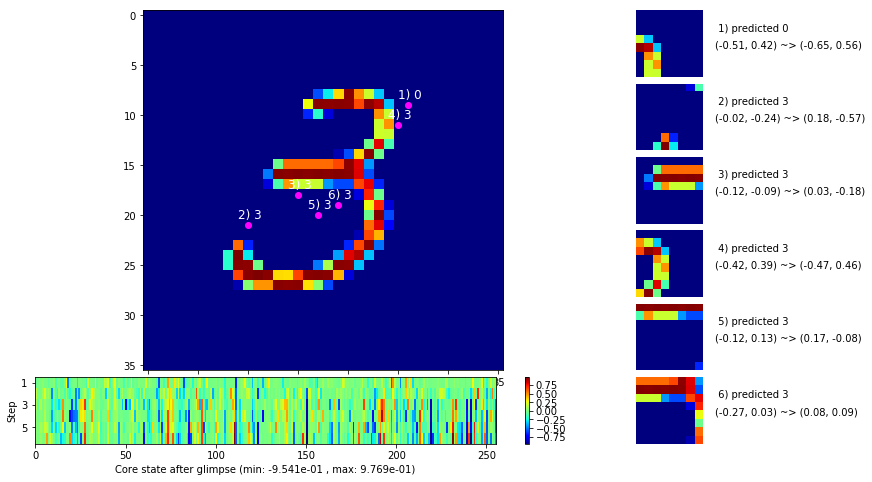

 b   1500/  3000 >> 131.4 ms/b | lr: 1.44e-04 | grad 2norm:  3.34 | grad inf norm:  0.977
       Weights || abs max:  2.28 (38475.95) | mean: -6.08e-04 ( 0.14) | var: 4.52e-02 (230359.48)
        Biases || abs max:  1.08 (  417.28) | mean: -1.18e-01 ( 0.31) | var: 5.87e-02 ( 1666.74)
                  class loss: 0.127 | steps: 2.083 | reward:  0.961 | acc.: 96.07%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 126.7 ms/b | lr: 1.44e-04 | grad 2norm:  3.37 | grad inf norm:  1.013
       Weights || abs max:  2.28 (28356.74) | mean: -6.15e-04 ( 0.12) | var: 4.52e-02 (21060.48)
        Biases || abs max:  1.08 (  369.64) | mean: -1.18e-01 ( 0.28) | var: 5.88e-02 ( 1049.80)
                  class loss: 0.124 | steps: 2.072 | reward:  0.959 | acc.: 95.85%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

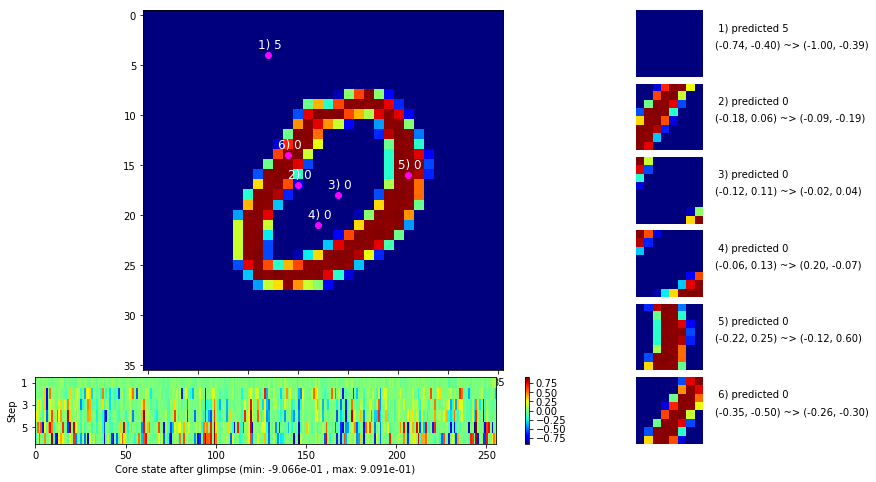

 b   2500/  3000 >> 130.2 ms/b | lr: 1.43e-04 | grad 2norm:  3.26 | grad inf norm:  0.954
       Weights || abs max:  2.29 (49152.68) | mean: -6.24e-04 ( 0.17) | var: 4.52e-02 (354547.38)
        Biases || abs max:  1.08 ( 1814.31) | mean: -1.18e-01 ( 1.37) | var: 5.88e-02 (651320.38)
                  class loss: 0.123 | steps: 2.058 | reward:  0.963 | acc.: 96.30%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 128.0 ms/b | lr: 1.43e-04 | grad 2norm:  3.23 | grad inf norm:  0.953
       Weights || abs max:  2.29 (27924.29) | mean: -6.26e-04 ( 0.12) | var: 4.52e-02 (13690.70)
        Biases || abs max:  1.08 (  390.92) | mean: -1.18e-01 ( 0.28) | var: 5.88e-02 ( 3682.78)
                  class loss: 0.124 | steps: 2.070 | reward:  0.962 | acc.: 96.22%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

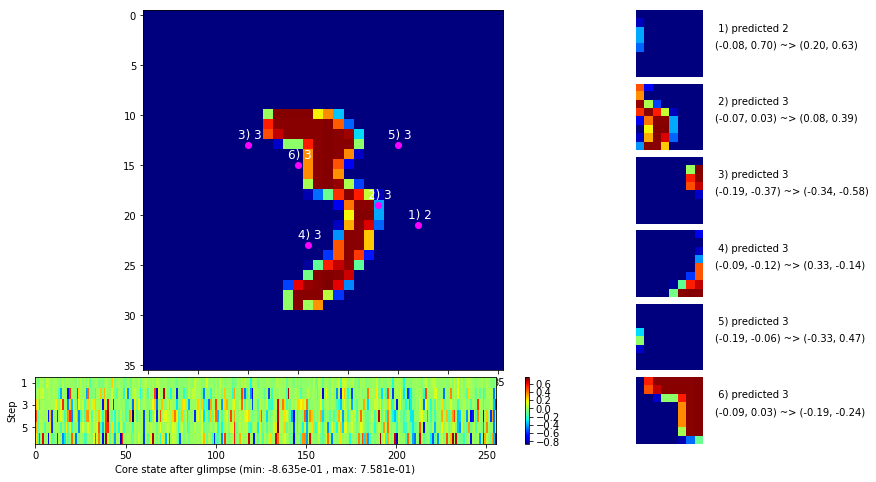

                                          ---===  VALIDATION  ===---

	Target class: 4  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


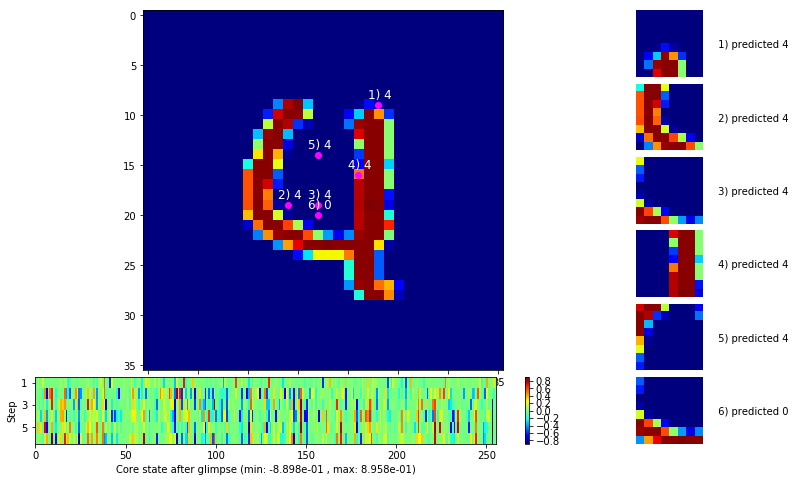


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


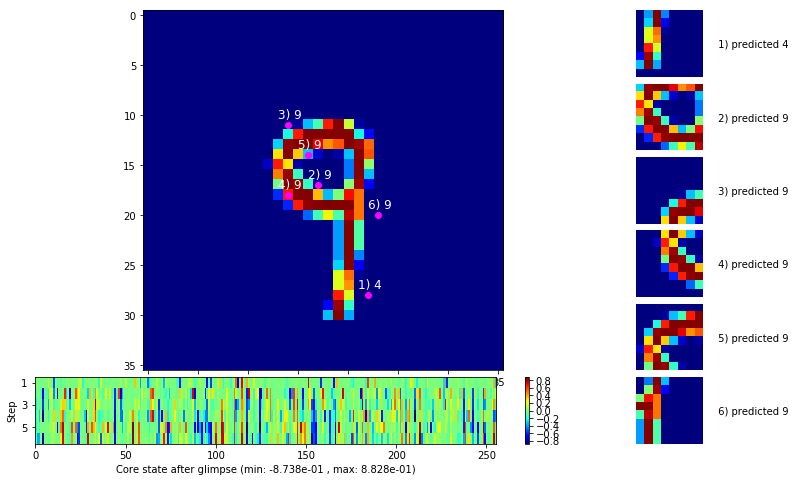

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


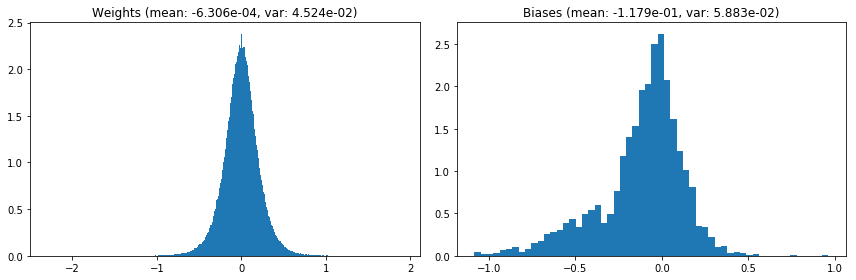

                                      Location network weights and biases


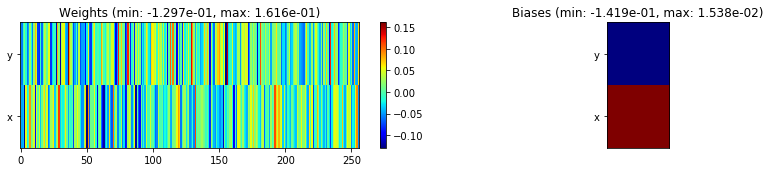

---------------------------------------------------------------------------------------------------------------
Elapsed time:  393.09 sec | TRAIN >> class loss: 0.1244 | steps:  2.072    | reward:  0.9609 :( | acc.: 96.090% :(
                          | VAL   >> class loss: 0.1350 | steps:  1.930 :( | reward:  0.9568 :( | acc.: 95.680% :(


Epoch  86/400) lr = 0.0001432
 b    500/  3000 >> 130.0 ms/b | lr: 1.43e-04 | grad 2norm:  3.28 | grad inf norm:  0.978
       Weights || abs max:  2.29 (26775.89) | mean: -6.34e-04 ( 0.12) | var: 4.52e-02 (18713.00)
        Biases || abs max:  1.08 (  289.13) | mean: -1.18e-01 ( 0.24) | var: 5.88e-02 ( 1409.95)
                  class loss: 0.126 | steps: 2.082 | reward:  0.961 | acc.: 96.13%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 136.0 ms/b | lr: 1.43e-04 | grad 2norm:  3.22 | grad inf norm:  0.973
       Weights || abs max:  2.29 (23387.08) | mean: -6.26e-04 ( 0.11) |

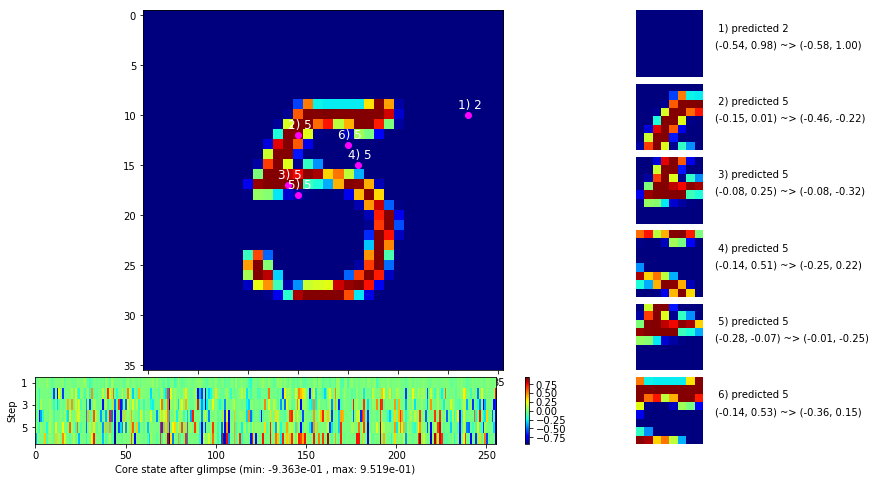

 b   1500/  3000 >> 142.1 ms/b | lr: 1.43e-04 | grad 2norm:  3.25 | grad inf norm:  0.997
       Weights || abs max:  2.29 (28550.21) | mean: -6.27e-04 ( 0.12) | var: 4.53e-02 (80441.80)
        Biases || abs max:  1.09 (  177.13) | mean: -1.18e-01 ( 0.21) | var: 5.88e-02 (  368.09)
                  class loss: 0.132 | steps: 2.086 | reward:  0.960 | acc.: 96.04%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 135.0 ms/b | lr: 1.42e-04 | grad 2norm:  3.33 | grad inf norm:  0.981
       Weights || abs max:  2.29 (52188.99) | mean: -6.20e-04 ( 0.16) | var: 4.53e-02 (262167.38)
        Biases || abs max:  1.09 (  146.14) | mean: -1.18e-01 ( 0.17) | var: 5.88e-02 (  290.37)
                  class loss: 0.121 | steps: 2.052 | reward:  0.960 | acc.: 96.03%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

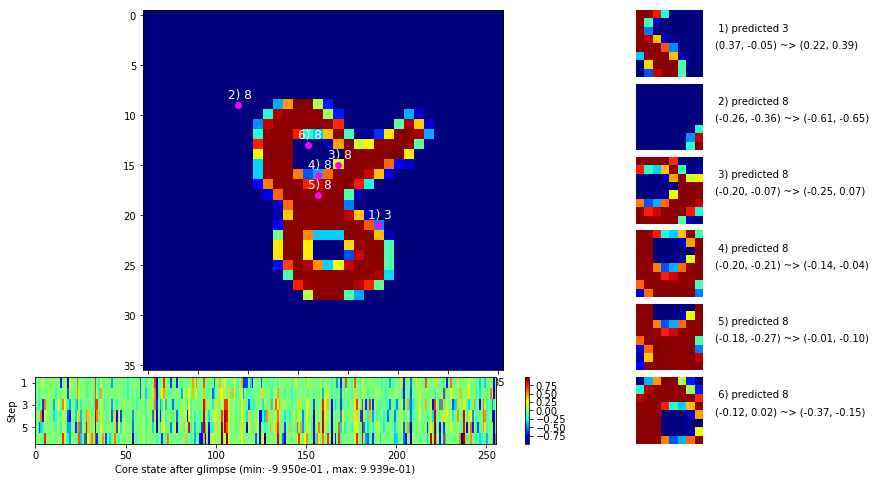

 b   2500/  3000 >> 132.8 ms/b | lr: 1.42e-04 | grad 2norm:  3.18 | grad inf norm:  0.976
       Weights || abs max:  2.29 (15918.23) | mean: -6.10e-04 ( 0.09) | var: 4.53e-02 ( 2377.15)
        Biases || abs max:  1.08 (  544.51) | mean: -1.18e-01 ( 0.52) | var: 5.88e-02 (47552.42)
                  class loss: 0.118 | steps: 2.083 | reward:  0.963 | acc.: 96.25%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.4 ms/b | lr: 1.42e-04 | grad 2norm:  3.44 | grad inf norm:  1.029
       Weights || abs max:  2.30 (28970.79) | mean: -6.21e-04 ( 0.12) | var: 4.53e-02 (22586.27)
        Biases || abs max:  1.09 (  121.98) | mean: -1.18e-01 ( 0.19) | var: 5.89e-02 (   85.25)
                  class loss: 0.133 | steps: 2.087 | reward:  0.958 | acc.: 95.77%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

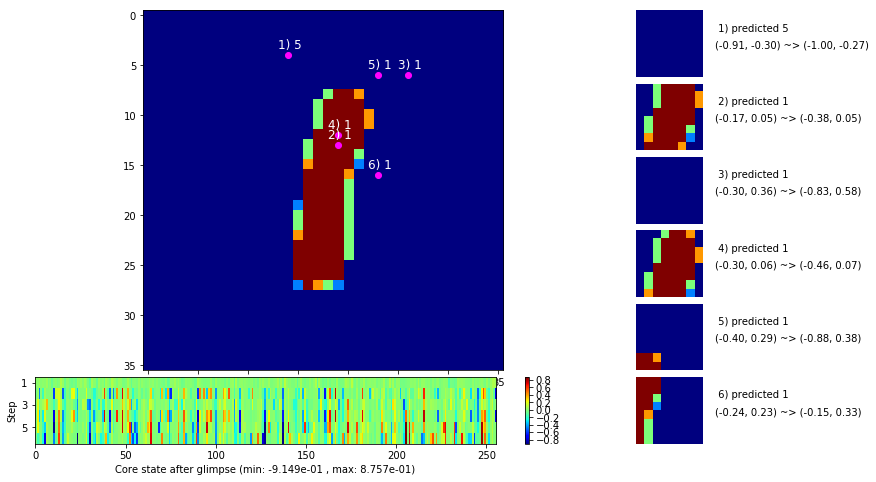

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


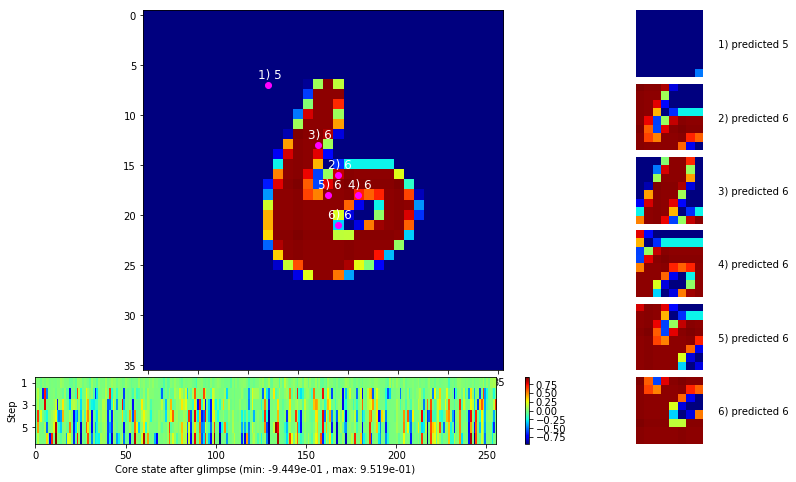


	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


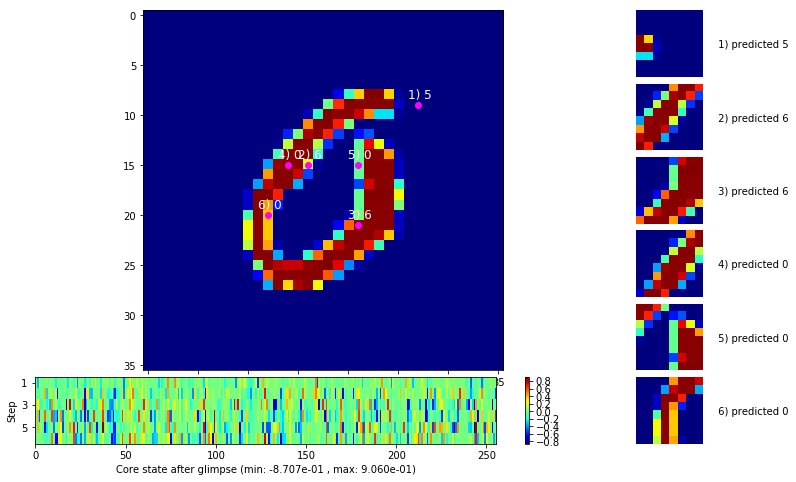

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


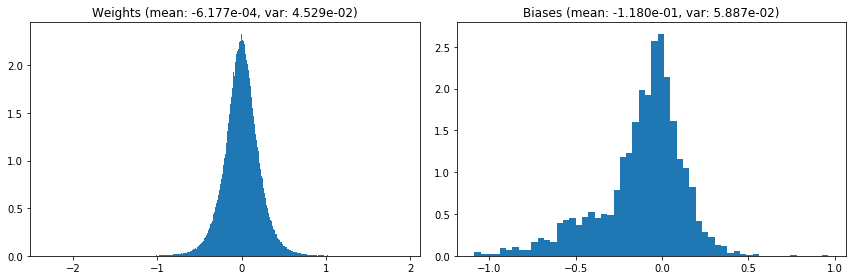

                                      Location network weights and biases


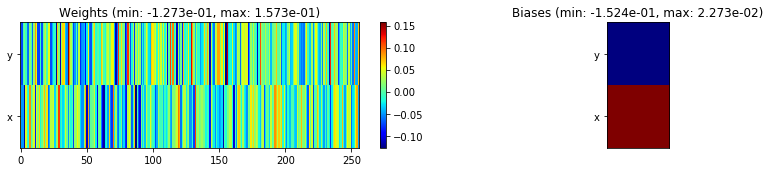

---------------------------------------------------------------------------------------------------------------
Elapsed time:  403.70 sec | TRAIN >> class loss: 0.1247 | steps:  2.074 :( | reward:  0.9608 :( | acc.: 96.078% :(
                          | VAL   >> class loss: 0.1325 | steps:  1.956 :( | reward:  0.9586 :( | acc.: 95.860% :(


Epoch  87/400) lr = 0.0001418
 b    500/  3000 >> 128.7 ms/b | lr: 1.42e-04 | grad 2norm:  3.30 | grad inf norm:  0.972
       Weights || abs max:  2.30 (40023.31) | mean: -6.13e-04 ( 0.14) | var: 4.53e-02 (63561.44)
        Biases || abs max:  1.08 (  238.95) | mean: -1.18e-01 ( 0.24) | var: 5.89e-02 (  338.39)
                  class loss: 0.129 | steps: 2.082 | reward:  0.961 | acc.: 96.13%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 128.5 ms/b | lr: 1.41e-04 | grad 2norm:  3.27 | grad inf norm:  0.998
       Weights || abs max:  2.30 (50824.22) | mean: -6.15e-04 ( 0.16) |

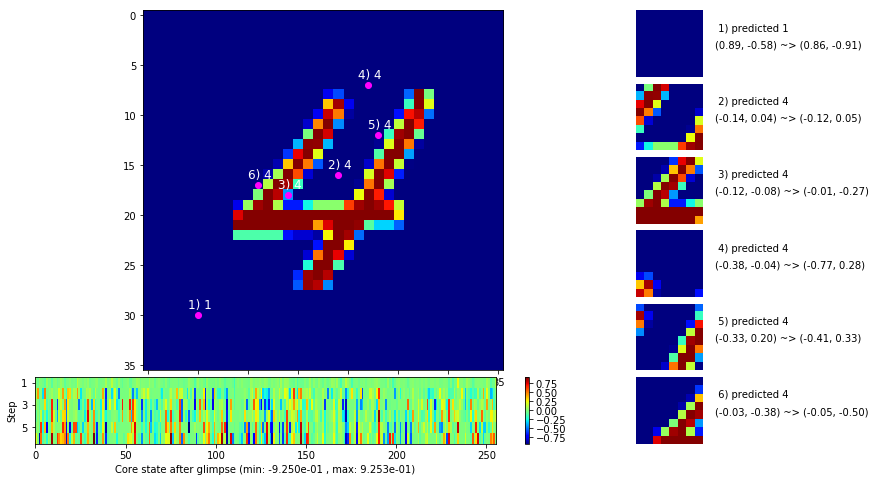

 b   1500/  3000 >> 130.9 ms/b | lr: 1.41e-04 | grad 2norm:  3.32 | grad inf norm:  0.997
       Weights || abs max:  2.30 (167844.97) | mean: -6.18e-04 ( 0.37) | var: 4.53e-02 (14131020.00)
        Biases || abs max:  1.09 ( 1007.61) | mean: -1.18e-01 ( 0.53) | var: 5.89e-02 (77503.38)
                  class loss: 0.124 | steps: 2.084 | reward:  0.961 | acc.: 96.05%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 131.9 ms/b | lr: 1.41e-04 | grad 2norm:  3.23 | grad inf norm:  0.976
       Weights || abs max:  2.30 (23603.10) | mean: -6.17e-04 ( 0.10) | var: 4.53e-02 (19585.34)
        Biases || abs max:  1.08 (  802.83) | mean: -1.18e-01 ( 0.45) | var: 5.90e-02 (59658.37)
                  class loss: 0.124 | steps: 2.073 | reward:  0.961 | acc.: 96.14%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

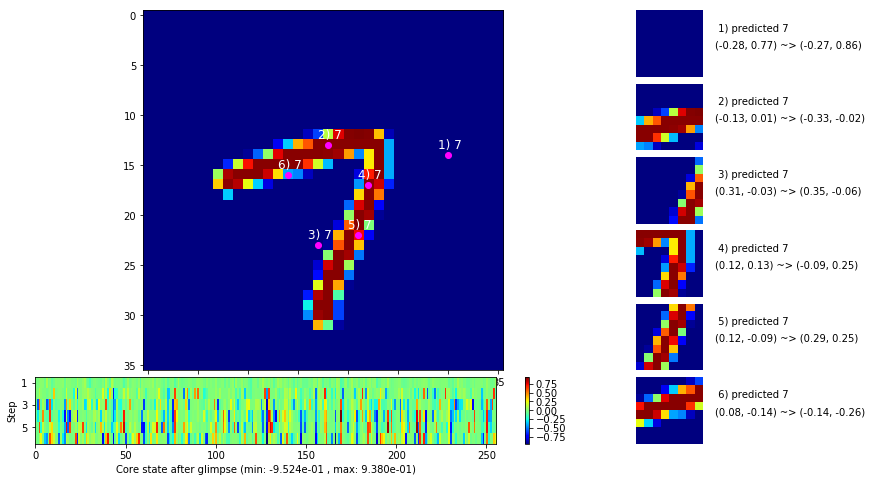

 b   2500/  3000 >> 131.7 ms/b | lr: 1.41e-04 | grad 2norm:  3.25 | grad inf norm:  0.997
       Weights || abs max:  2.30 (43828.61) | mean: -6.17e-04 ( 0.14) | var: 4.53e-02 (205790.92)
        Biases || abs max:  1.08 (  183.51) | mean: -1.18e-01 ( 0.22) | var: 5.90e-02 ( 3258.42)
                  class loss: 0.120 | steps: 2.074 | reward:  0.961 | acc.: 96.07%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.0 ms/b | lr: 1.40e-04 | grad 2norm:  3.19 | grad inf norm:  0.974
       Weights || abs max:  2.30 (68309.09) | mean: -6.17e-04 ( 0.19) | var: 4.53e-02 (880635.12)
        Biases || abs max:  1.08 (  196.22) | mean: -1.18e-01 ( 0.21) | var: 5.90e-02 (  362.01)
                  class loss: 0.119 | steps: 2.080 | reward:  0.963 | acc.: 96.34%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

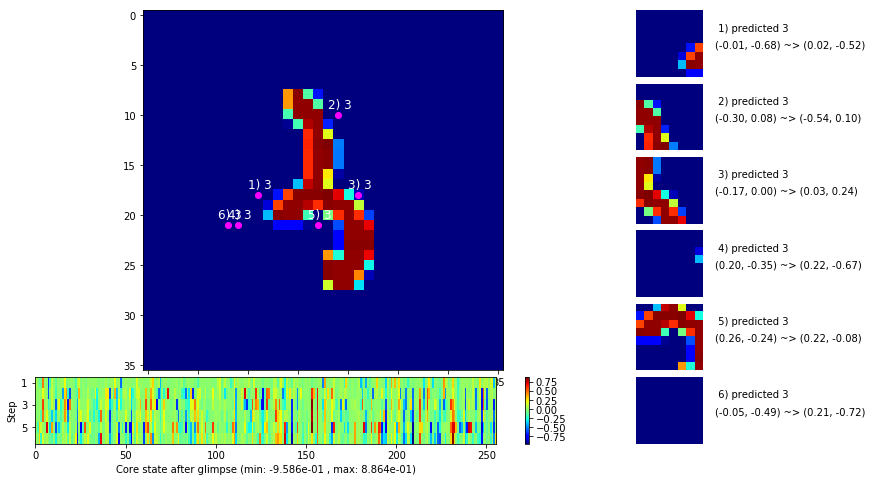

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


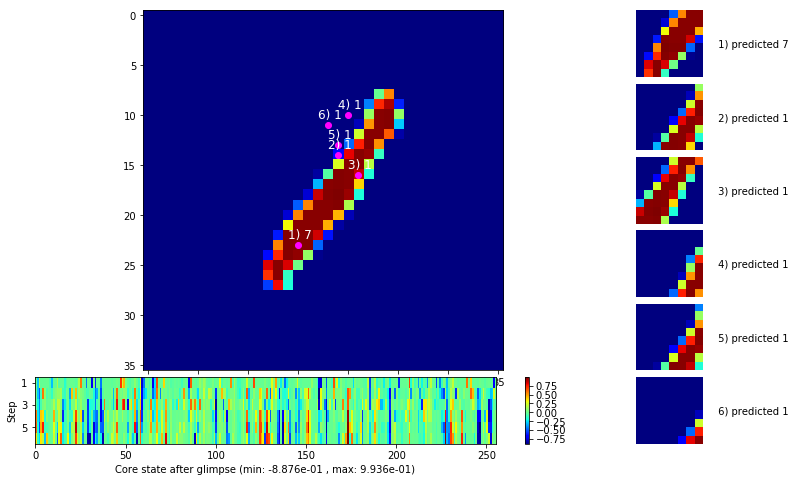


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


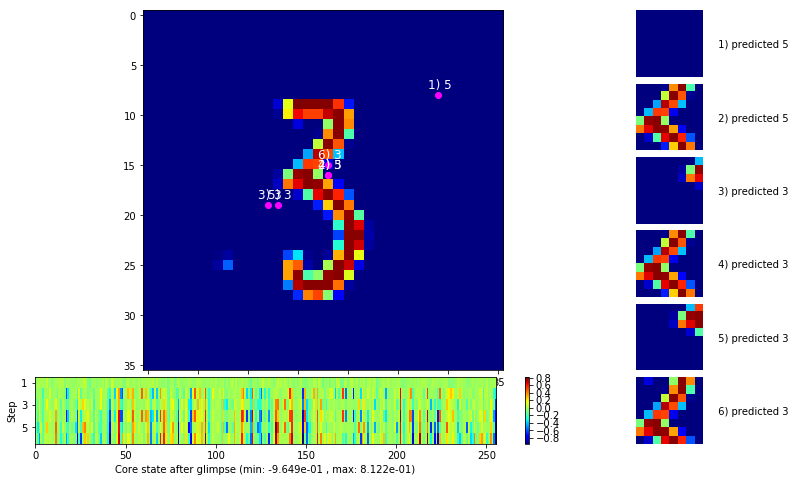

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


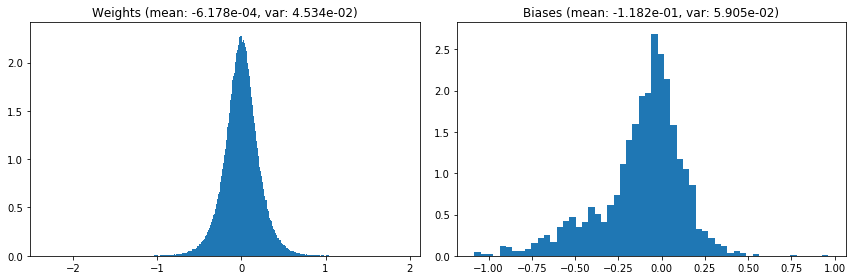

                                      Location network weights and biases


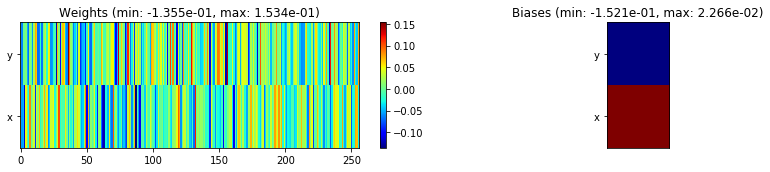

---------------------------------------------------------------------------------------------------------------
Elapsed time:  397.33 sec | TRAIN >> class loss: 0.1228 | steps:  2.080 :( | reward:  0.9613    | acc.: 96.130% 
                          | VAL   >> class loss: 0.1353 | steps:  1.971 :( | reward:  0.9580 :( | acc.: 95.800% :(


Epoch  88/400) lr = 0.0001404
 b    500/  3000 >> 132.9 ms/b | lr: 1.40e-04 | grad 2norm:  3.36 | grad inf norm:  1.007
       Weights || abs max:  2.30 (30631.72) | mean: -6.21e-04 ( 0.13) | var: 4.53e-02 (36160.16)
        Biases || abs max:  1.08 (  173.97) | mean: -1.18e-01 ( 0.20) | var: 5.91e-02 (  227.50)
                  class loss: 0.133 | steps: 2.087 | reward:  0.958 | acc.: 95.84%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.2 ms/b | lr: 1.40e-04 | grad 2norm:  3.15 | grad inf norm:  0.952
       Weights || abs max:  2.30 (34429.82) | mean: -6.20e-04 ( 0.13) | v

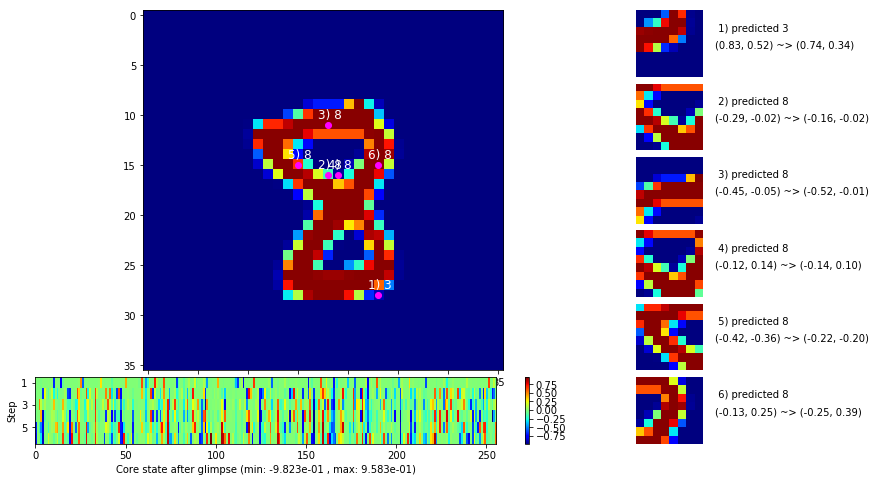

 b   1500/  3000 >> 131.3 ms/b | lr: 1.40e-04 | grad 2norm:  3.23 | grad inf norm:  0.924
       Weights || abs max:  2.30 (235669.36) | mean: -6.14e-04 ( 0.50) | var: 4.54e-02 (36344360.00)
        Biases || abs max:  1.08 (  370.89) | mean: -1.18e-01 ( 0.28) | var: 5.91e-02 ( 3455.29)
                  class loss: 0.125 | steps: 2.091 | reward:  0.963 | acc.: 96.31%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 129.8 ms/b | lr: 1.40e-04 | grad 2norm:  3.11 | grad inf norm:  0.946
       Weights || abs max:  2.30 (22973.86) | mean: -6.07e-04 ( 0.10) | var: 4.54e-02 (25296.50)
        Biases || abs max:  1.08 (  137.15) | mean: -1.18e-01 ( 0.19) | var: 5.92e-02 (  211.49)
                  class loss: 0.116 | steps: 2.069 | reward:  0.964 | acc.: 96.40%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

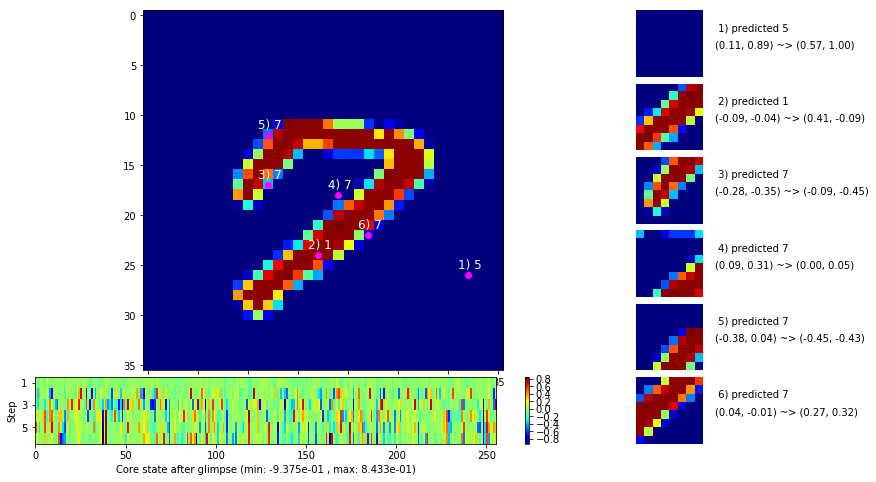

 b   2500/  3000 >> 130.4 ms/b | lr: 1.39e-04 | grad 2norm:  3.30 | grad inf norm:  0.964
       Weights || abs max:  2.30 (38567.74) | mean: -6.00e-04 ( 0.13) | var: 4.54e-02 (180894.03)
        Biases || abs max:  1.08 (  172.11) | mean: -1.18e-01 ( 0.23) | var: 5.92e-02 (  239.92)
                  class loss: 0.127 | steps: 2.077 | reward:  0.960 | acc.: 95.99%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.3 ms/b | lr: 1.39e-04 | grad 2norm:  3.18 | grad inf norm:  0.960
       Weights || abs max:  2.29 (36588.03) | mean: -5.94e-04 ( 0.13) | var: 4.54e-02 (74852.34)
        Biases || abs max:  1.08 (  145.10) | mean: -1.18e-01 ( 0.19) | var: 5.92e-02 (  256.68)
                  class loss: 0.115 | steps: 2.070 | reward:  0.962 | acc.: 96.24%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

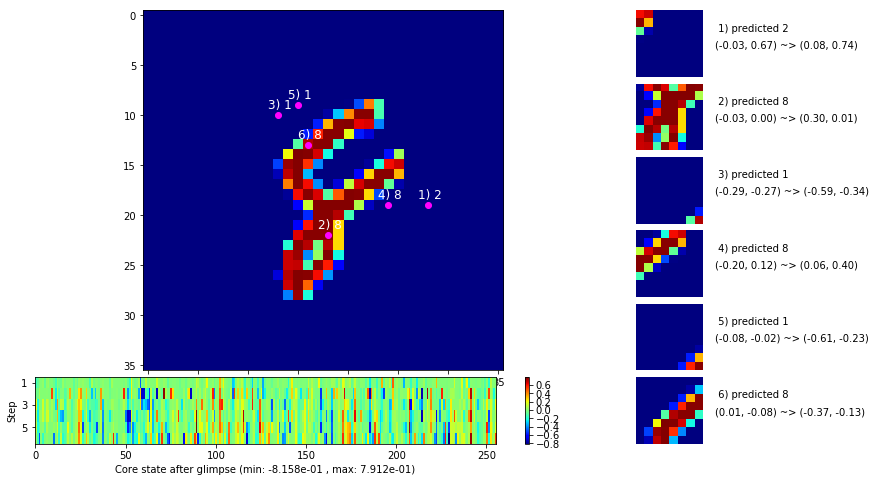

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


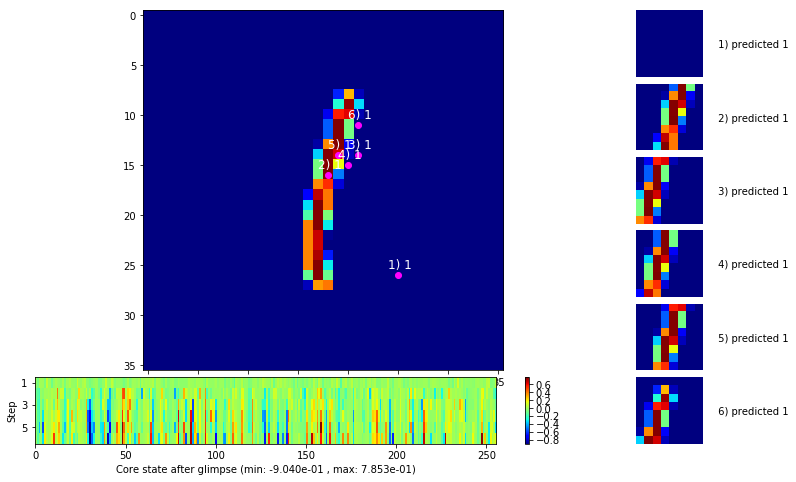


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


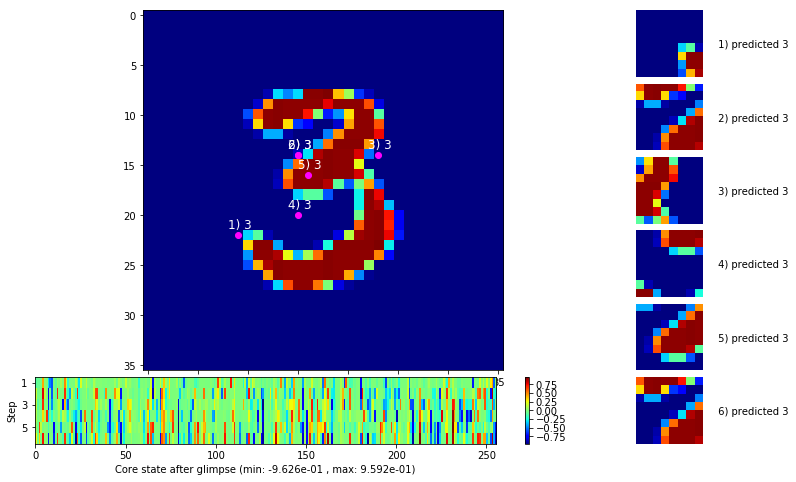

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


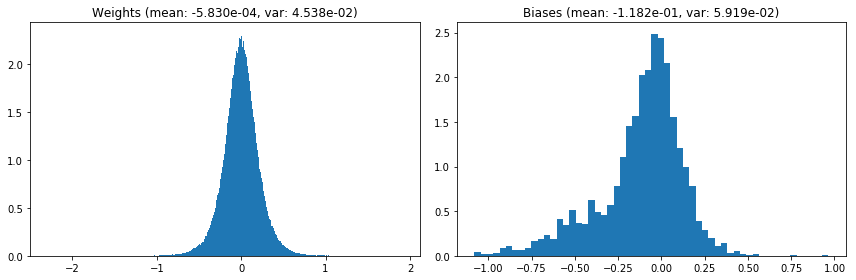

                                      Location network weights and biases


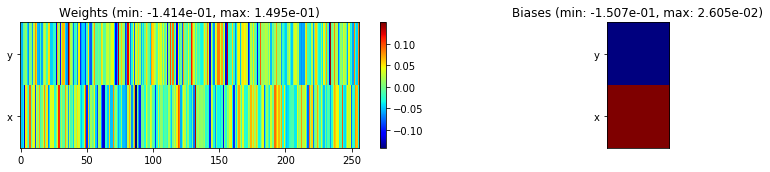

---------------------------------------------------------------------------------------------------------------
Elapsed time:  393.06 sec | TRAIN >> class loss: 0.1222 | steps:  2.077 :( | reward:  0.9617    | acc.: 96.175% 
                          | VAL   >> class loss: 0.1301 | steps:  1.921 :( | reward:  0.9578 :( | acc.: 95.780% :(


Epoch  89/400) lr = 0.000139
 b    500/  3000 >> 132.3 ms/b | lr: 1.39e-04 | grad 2norm:  3.23 | grad inf norm:  0.964
       Weights || abs max:  2.29 (44409.87) | mean: -5.90e-04 ( 0.15) | var: 4.54e-02 (112051.34)
        Biases || abs max:  1.08 (  302.26) | mean: -1.18e-01 ( 0.28) | var: 5.92e-02 ( 2389.71)
                  class loss: 0.123 | steps: 2.081 | reward:  0.962 | acc.: 96.22%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 130.9 ms/b | lr: 1.39e-04 | grad 2norm:  3.27 | grad inf norm:  0.987
       Weights || abs max:  2.30 (67447.89) | mean: -5.97e-04 ( 0.19) | v

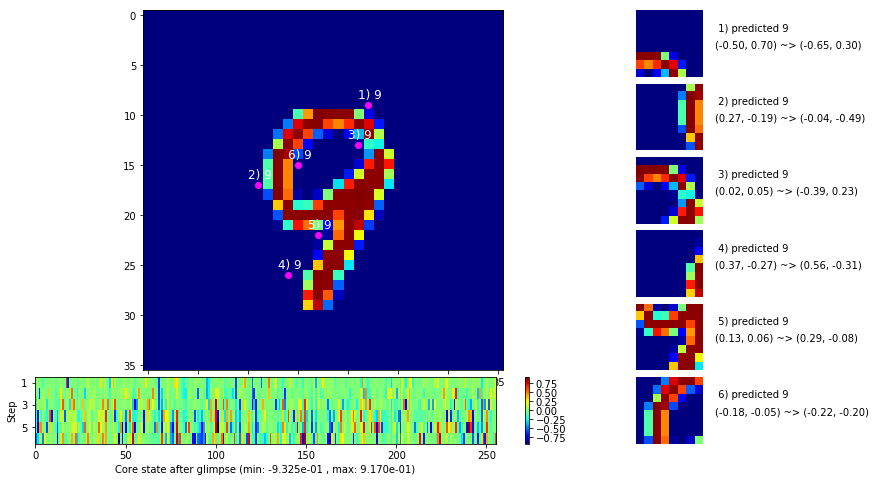

 b   1500/  3000 >> 143.1 ms/b | lr: 1.38e-04 | grad 2norm:  3.17 | grad inf norm:  0.959
       Weights || abs max:  2.30 (41065.39) | mean: -5.99e-04 ( 0.14) | var: 4.54e-02 (425025.97)
        Biases || abs max:  1.08 (  805.46) | mean: -1.18e-01 ( 0.47) | var: 5.91e-02 (43473.36)
                  class loss: 0.115 | steps: 2.071 | reward:  0.963 | acc.: 96.25%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 134.0 ms/b | lr: 1.38e-04 | grad 2norm:  3.21 | grad inf norm:  0.994
       Weights || abs max:  2.30 (29404.30) | mean: -5.98e-04 ( 0.11) | var: 4.54e-02 (26393.10)
        Biases || abs max:  1.09 (  175.16) | mean: -1.18e-01 ( 0.19) | var: 5.92e-02 (  278.03)
                  class loss: 0.121 | steps: 2.086 | reward:  0.961 | acc.: 96.11%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

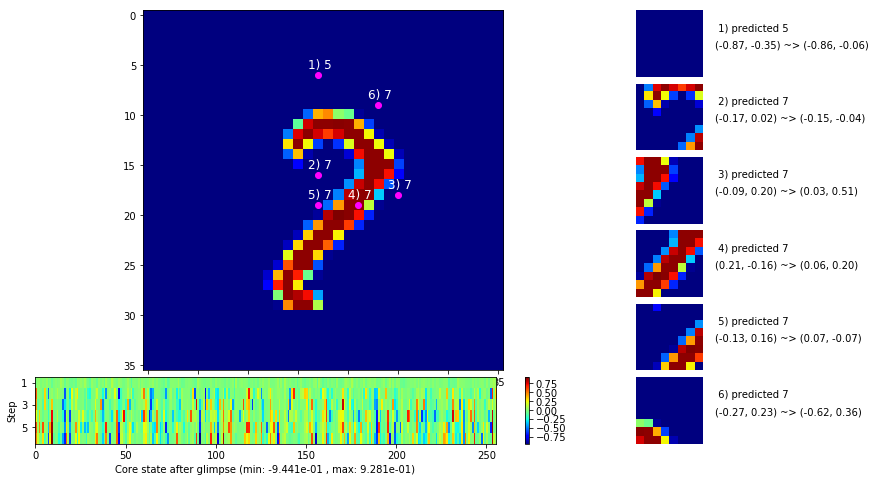

 b   2500/  3000 >> 129.8 ms/b | lr: 1.38e-04 | grad 2norm:  3.10 | grad inf norm:  0.969
       Weights || abs max:  2.30 (38191.95) | mean: -5.96e-04 ( 0.13) | var: 4.54e-02 (263762.03)
        Biases || abs max:  1.09 (  211.20) | mean: -1.18e-01 ( 0.23) | var: 5.92e-02 ( 1217.86)
                  class loss: 0.122 | steps: 2.074 | reward:  0.963 | acc.: 96.34%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.2 ms/b | lr: 1.38e-04 | grad 2norm:  3.27 | grad inf norm:  0.992
       Weights || abs max:  2.30 (34406.50) | mean: -5.98e-04 ( 0.12) | var: 4.54e-02 (44082.54)
        Biases || abs max:  1.09 ( 1941.77) | mean: -1.18e-01 ( 0.88) | var: 5.93e-02 (379683.88)
                  class loss: 0.123 | steps: 2.083 | reward:  0.961 | acc.: 96.14%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

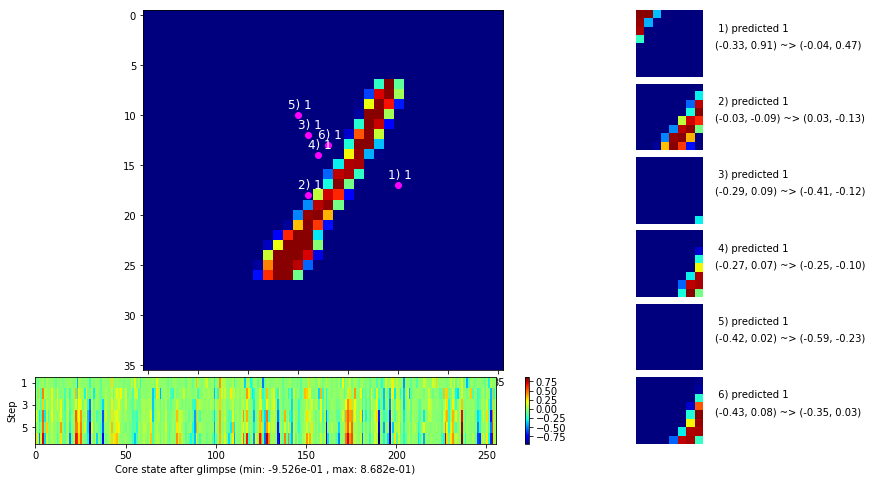

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


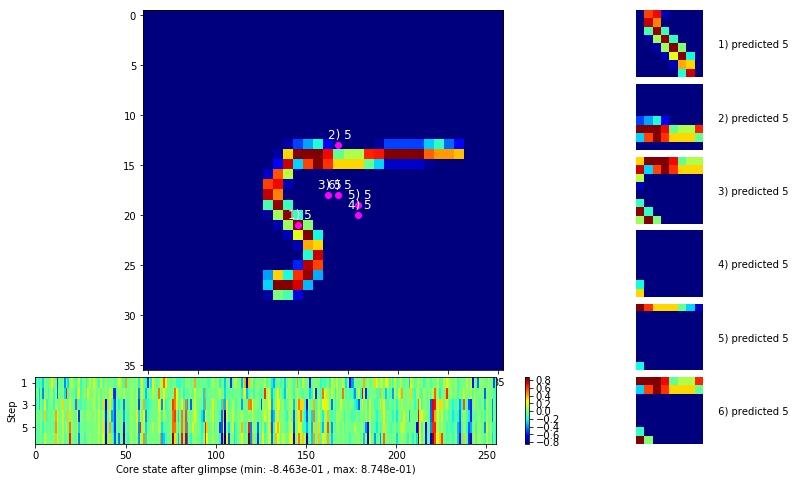


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


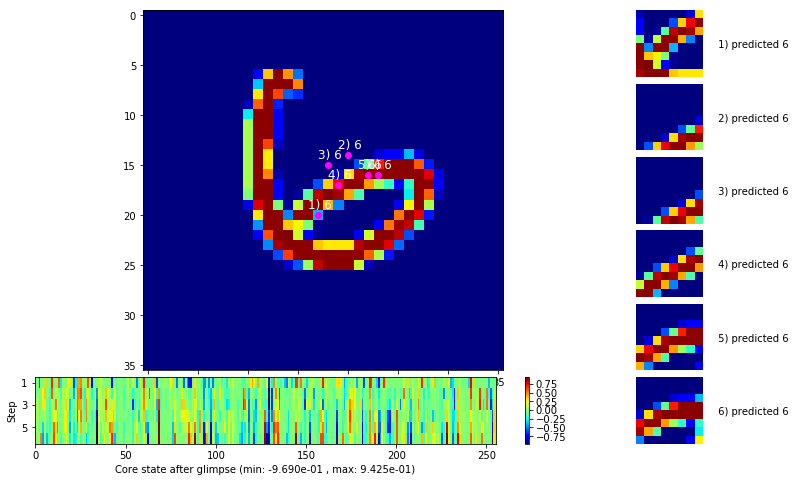

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


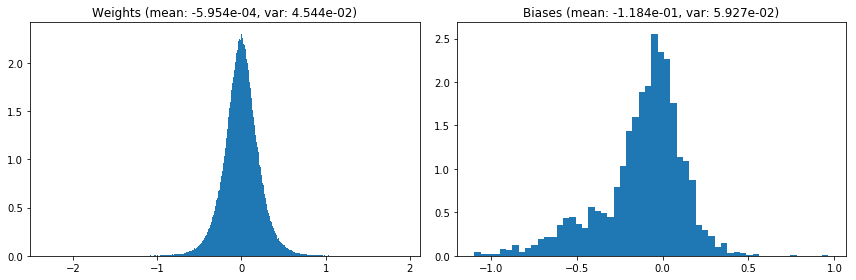

                                      Location network weights and biases


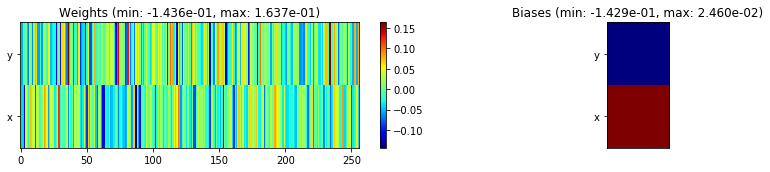

---------------------------------------------------------------------------------------------------------------
Elapsed time:  400.97 sec | TRAIN >> class loss: 0.1220 | steps:  2.081 :( | reward:  0.9620    | acc.: 96.197% 
                          | VAL   >> class loss: 0.1327 | steps:  1.924 :( | reward:  0.9582 :( | acc.: 95.820% :(


Epoch  90/400) lr = 0.0001377
 b    500/  3000 >> 129.7 ms/b | lr: 1.38e-04 | grad 2norm:  3.09 | grad inf norm:  0.944
       Weights || abs max:  2.30 (25512.25) | mean: -5.88e-04 ( 0.11) | var: 4.54e-02 (12151.11)
        Biases || abs max:  1.09 (  158.52) | mean: -1.18e-01 ( 0.19) | var: 5.93e-02 (  163.60)
                  class loss: 0.115 | steps: 2.080 | reward:  0.964 | acc.: 96.36%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 129.3 ms/b | lr: 1.37e-04 | grad 2norm:  3.19 | grad inf norm:  0.954
       Weights || abs max:  2.30 (305929.41) | mean: -5.85e-04 ( 0.62) | 

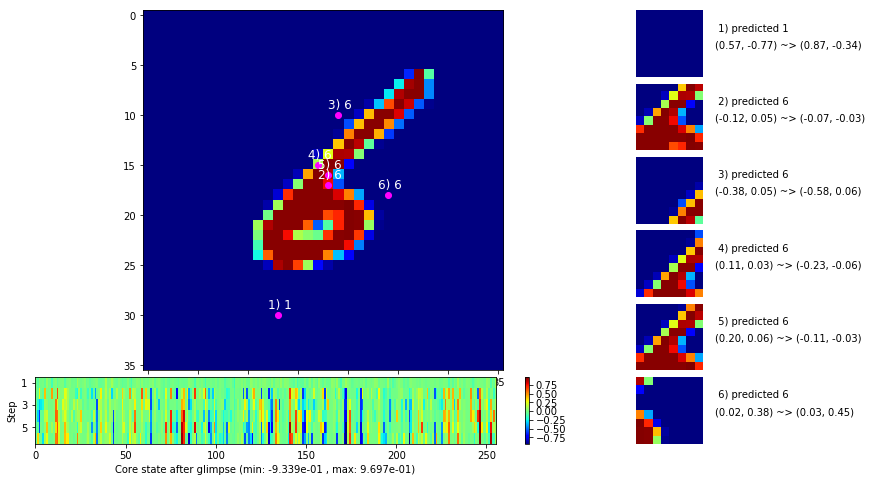

 b   1500/  3000 >> 132.6 ms/b | lr: 1.37e-04 | grad 2norm:  3.14 | grad inf norm:  0.954
       Weights || abs max:  2.30 (36341.25) | mean: -6.01e-04 ( 0.13) | var: 4.55e-02 (106076.29)
        Biases || abs max:  1.09 (  591.91) | mean: -1.18e-01 ( 0.37) | var: 5.93e-02 ( 7066.09)
                  class loss: 0.119 | steps: 2.072 | reward:  0.964 | acc.: 96.36%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 132.7 ms/b | lr: 1.37e-04 | grad 2norm:  3.38 | grad inf norm:  0.984
       Weights || abs max:  2.30 (51865.04) | mean: -5.99e-04 ( 0.16) | var: 4.55e-02 (454782.31)
        Biases || abs max:  1.09 (  137.19) | mean: -1.18e-01 ( 0.18) | var: 5.93e-02 (  220.12)
                  class loss: 0.120 | steps: 2.085 | reward:  0.960 | acc.: 96.02%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

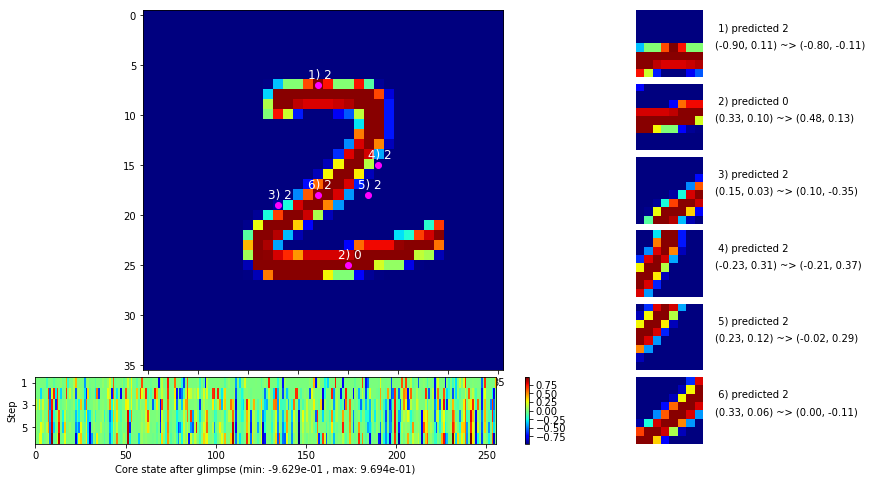

 b   2500/  3000 >> 137.4 ms/b | lr: 1.37e-04 | grad 2norm:  3.40 | grad inf norm:  1.014
       Weights || abs max:  2.30 (67189.73) | mean: -6.02e-04 ( 0.19) | var: 4.55e-02 (1469364.12)
        Biases || abs max:  1.09 (  231.89) | mean: -1.18e-01 ( 0.22) | var: 5.93e-02 (  521.95)
                  class loss: 0.130 | steps: 2.092 | reward:  0.959 | acc.: 95.87%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.6 ms/b | lr: 1.36e-04 | grad 2norm:  3.29 | grad inf norm:  1.003
       Weights || abs max:  2.30 (66882.47) | mean: -6.03e-04 ( 0.19) | var: 4.55e-02 (2078355.50)
        Biases || abs max:  1.09 (  809.21) | mean: -1.18e-01 ( 0.47) | var: 5.93e-02 (39992.71)
                  class loss: 0.115 | steps: 2.069 | reward:  0.961 | acc.: 96.10%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

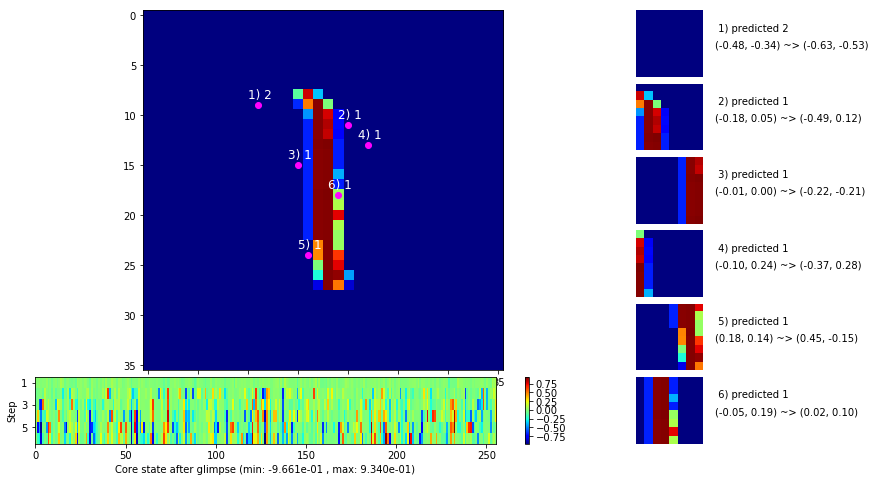

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


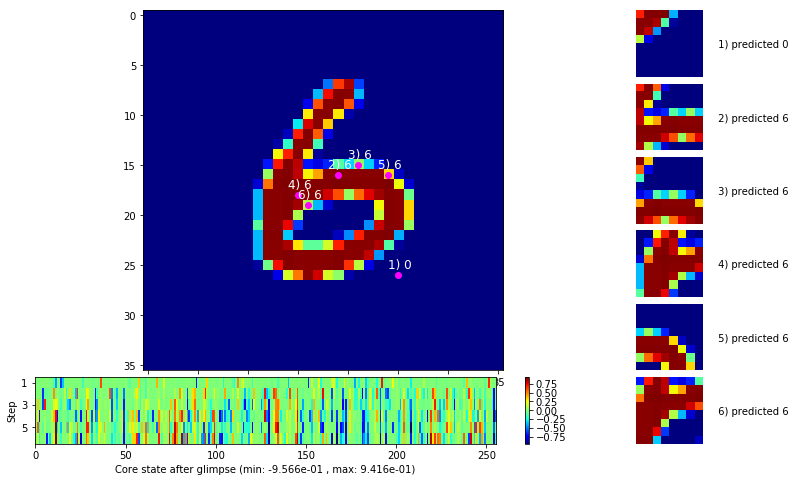


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


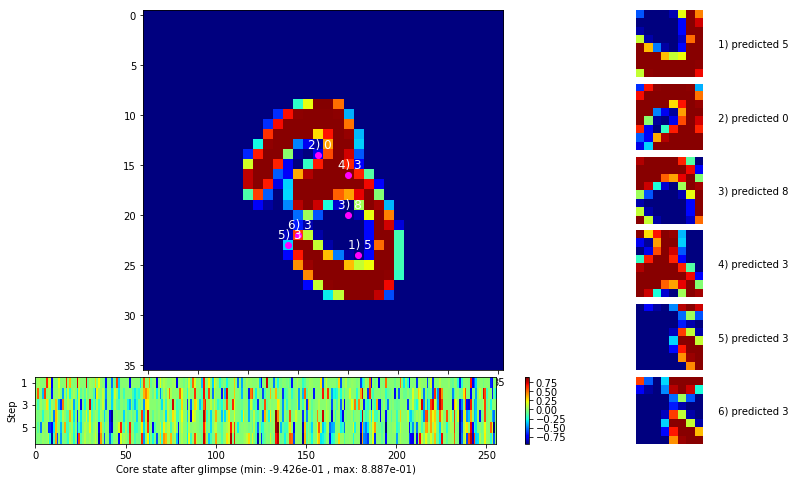

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


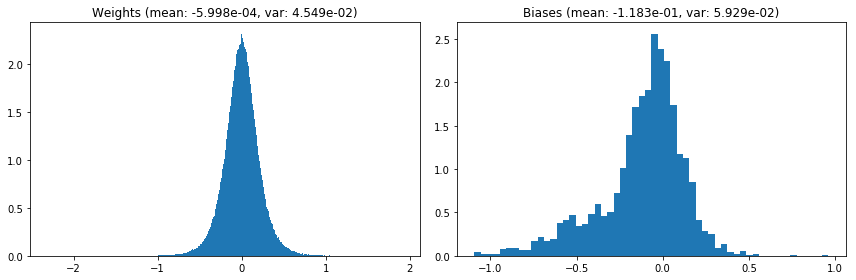

                                      Location network weights and biases


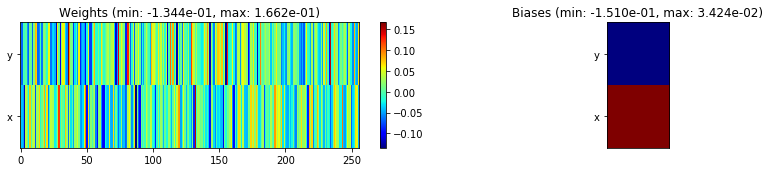

---------------------------------------------------------------------------------------------------------------
Elapsed time:  403.20 sec | TRAIN >> class loss: 0.1204 | steps:  2.077 :( | reward:  0.9617 :( | acc.: 96.167% :(
                          | VAL   >> class loss: 0.1356 | steps:  1.964 :( | reward:  0.9558 :( | acc.: 95.580% :(


Epoch  91/400) lr = 0.0001364
 b    500/  3000 >> 143.3 ms/b | lr: 1.36e-04 | grad 2norm:  3.26 | grad inf norm:  0.967
       Weights || abs max:  2.31 (21108.00) | mean: -5.96e-04 ( 0.10) | var: 4.55e-02 (12431.98)
        Biases || abs max:  1.10 (  513.22) | mean: -1.18e-01 ( 0.37) | var: 5.93e-02 ( 1775.35)
                  class loss: 0.124 | steps: 2.080 | reward:  0.961 | acc.: 96.13%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 145.2 ms/b | lr: 1.36e-04 | grad 2norm:  3.31 | grad inf norm:  0.983
       Weights || abs max:  2.31 (21838.08) | mean: -5.92e-04 ( 0.10) |

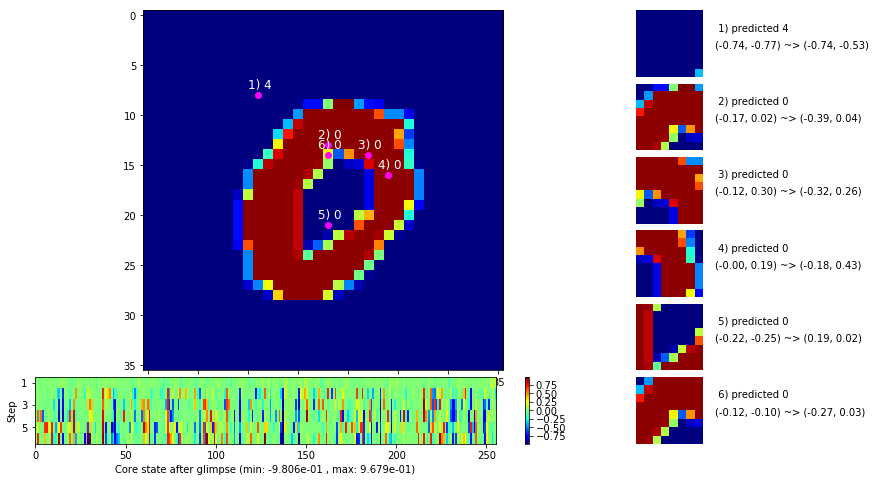

 b   1500/  3000 >> 145.8 ms/b | lr: 1.36e-04 | grad 2norm:  3.31 | grad inf norm:  0.956
       Weights || abs max:  2.30 (45936.39) | mean: -5.92e-04 ( 0.15) | var: 4.55e-02 (140041.28)
        Biases || abs max:  1.09 (  114.26) | mean: -1.18e-01 ( 0.18) | var: 5.94e-02 (   98.52)
                  class loss: 0.124 | steps: 2.065 | reward:  0.961 | acc.: 96.05%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 134.7 ms/b | lr: 1.36e-04 | grad 2norm:  3.30 | grad inf norm:  0.970
       Weights || abs max:  2.30 (44167.97) | mean: -5.86e-04 ( 0.15) | var: 4.55e-02 (232785.08)
        Biases || abs max:  1.09 (  249.62) | mean: -1.18e-01 ( 0.23) | var: 5.94e-02 (  369.18)
                  class loss: 0.128 | steps: 2.080 | reward:  0.961 | acc.: 96.13%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

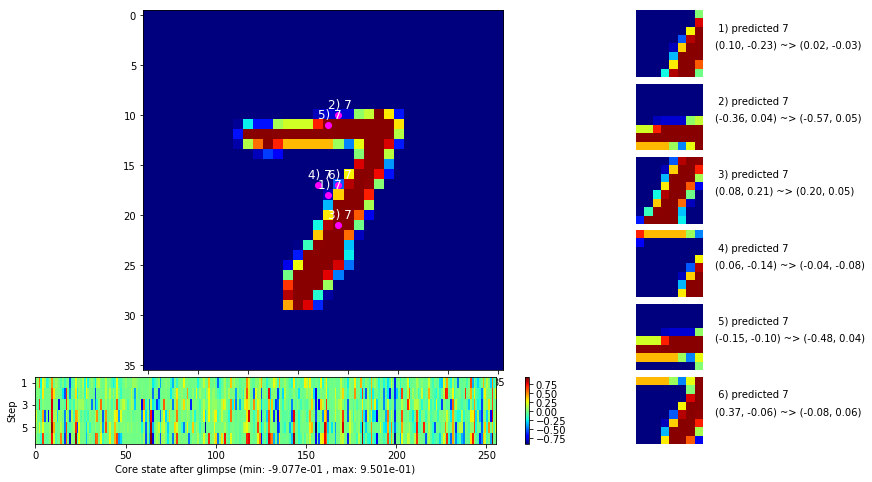

 b   2500/  3000 >> 135.5 ms/b | lr: 1.35e-04 | grad 2norm:  3.37 | grad inf norm:  1.041
       Weights || abs max:  2.31 (42647.45) | mean: -5.80e-04 ( 0.15) | var: 4.55e-02 (79467.47)
        Biases || abs max:  1.09 (  150.78) | mean: -1.19e-01 ( 0.17) | var: 5.94e-02 (  208.77)
                  class loss: 0.128 | steps: 2.080 | reward:  0.958 | acc.: 95.79%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.9 ms/b | lr: 1.35e-04 | grad 2norm:  3.44 | grad inf norm:  1.035
       Weights || abs max:  2.31 (23786.20) | mean: -5.81e-04 ( 0.11) | var: 4.55e-02 ( 7421.12)
        Biases || abs max:  1.09 (  177.70) | mean: -1.19e-01 ( 0.21) | var: 5.95e-02 (  109.44)
                  class loss: 0.130 | steps: 2.098 | reward:  0.957 | acc.: 95.73%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

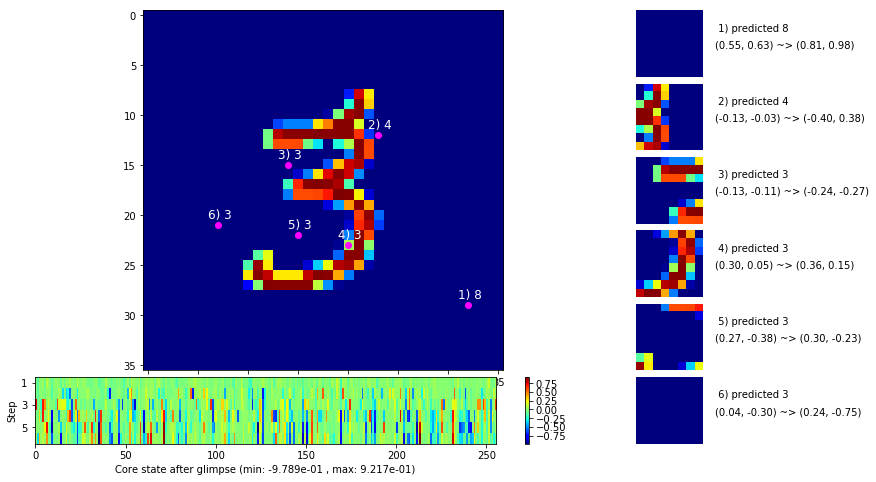

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


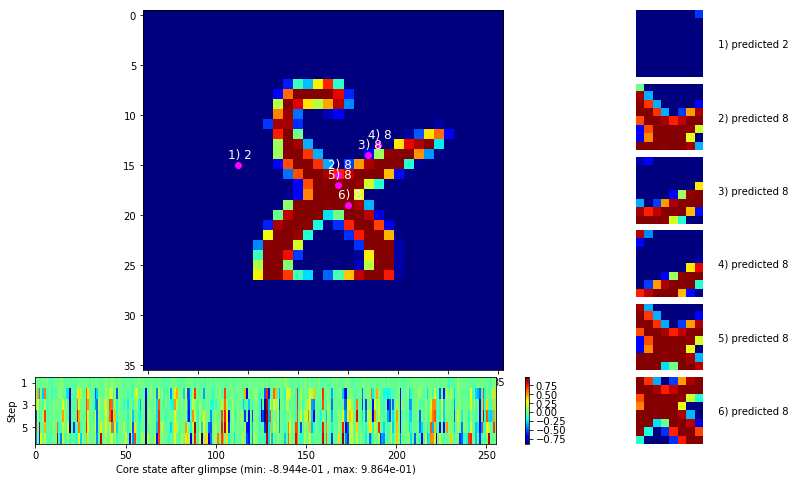


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


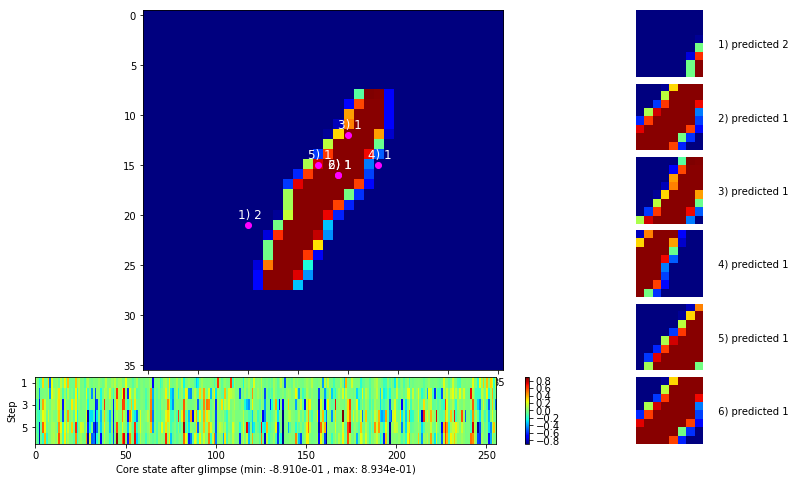

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


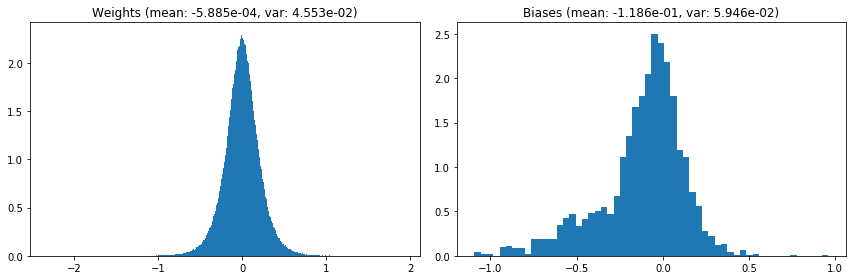

                                      Location network weights and biases


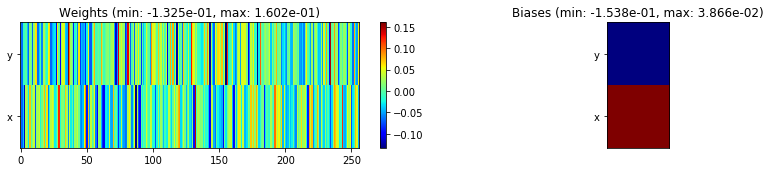

---------------------------------------------------------------------------------------------------------------
Elapsed time:  426.25 sec | TRAIN >> class loss: 0.1266 | steps:  2.083 :( | reward:  0.9598 :( | acc.: 95.985% :(
                          | VAL   >> class loss: 0.1317 | steps:  1.959 :( | reward:  0.9592 :( | acc.: 95.920% :(


Epoch  92/400) lr = 0.0001351
 b    500/  3000 >> 144.8 ms/b | lr: 1.35e-04 | grad 2norm:  3.10 | grad inf norm:  0.959
       Weights || abs max:  2.31 (31977.47) | mean: -5.89e-04 ( 0.12) | var: 4.55e-02 (30183.58)
        Biases || abs max:  1.09 (  323.52) | mean: -1.18e-01 ( 0.27) | var: 5.94e-02 ( 3765.36)
                  class loss: 0.120 | steps: 2.068 | reward:  0.963 | acc.: 96.31%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 150.3 ms/b | lr: 1.35e-04 | grad 2norm:  2.99 | grad inf norm:  0.900
       Weights || abs max:  2.32 (47433.62) | mean: -5.95e-04 ( 0.15) |

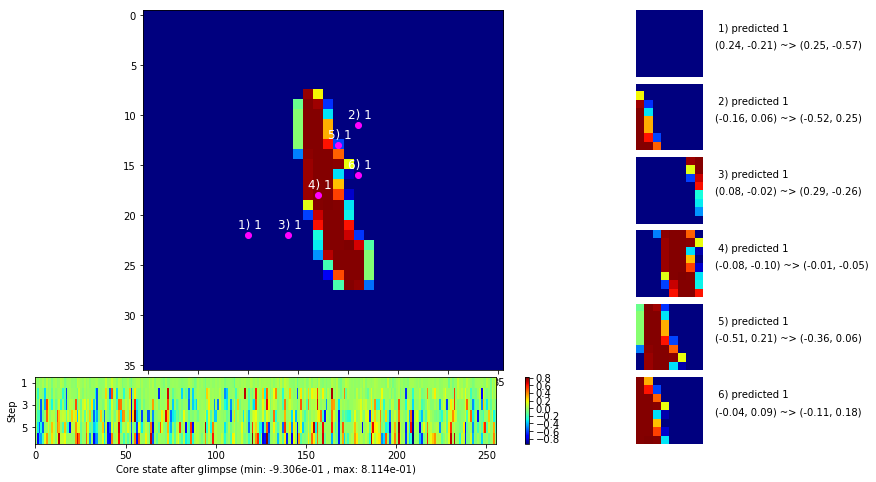

 b   1500/  3000 >> 137.8 ms/b | lr: 1.35e-04 | grad 2norm:  3.31 | grad inf norm:  0.986
       Weights || abs max:  2.31 (32647.30) | mean: -5.93e-04 ( 0.12) | var: 4.56e-02 (200170.52)
        Biases || abs max:  1.09 (  339.96) | mean: -1.18e-01 ( 0.30) | var: 5.94e-02 ( 1059.52)
                  class loss: 0.124 | steps: 2.091 | reward:  0.960 | acc.: 95.97%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 131.6 ms/b | lr: 1.34e-04 | grad 2norm:  3.28 | grad inf norm:  0.970
       Weights || abs max:  2.31 (49012.75) | mean: -5.90e-04 ( 0.16) | var: 4.56e-02 (205744.27)
        Biases || abs max:  1.08 (  591.20) | mean: -1.18e-01 ( 0.56) | var: 5.95e-02 (102089.49)
                  class loss: 0.124 | steps: 2.092 | reward:  0.960 | acc.: 96.03%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

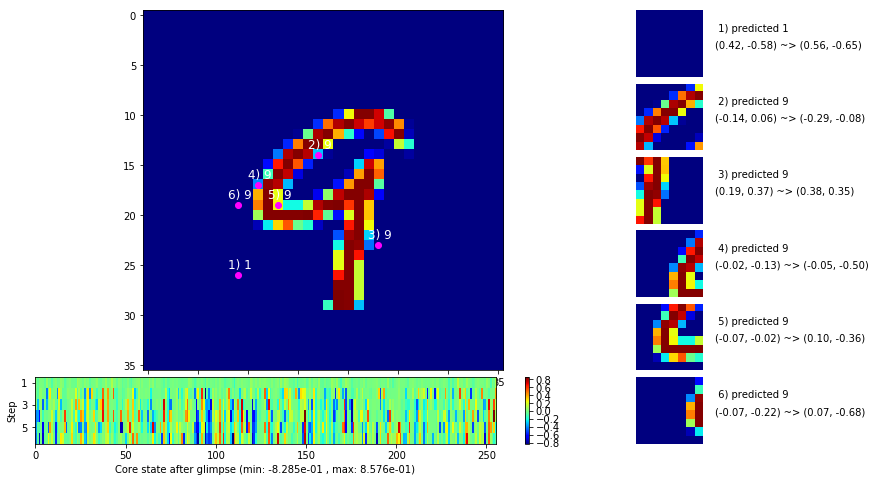

 b   2500/  3000 >> 134.0 ms/b | lr: 1.34e-04 | grad 2norm:  3.31 | grad inf norm:  0.994
       Weights || abs max:  2.32 (29357.04) | mean: -5.97e-04 ( 0.13) | var: 4.56e-02 (26595.81)
        Biases || abs max:  1.09 (  115.52) | mean: -1.19e-01 ( 0.20) | var: 5.95e-02 (  261.44)
                  class loss: 0.124 | steps: 2.086 | reward:  0.960 | acc.: 95.98%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 133.4 ms/b | lr: 1.34e-04 | grad 2norm:  3.26 | grad inf norm:  1.002
       Weights || abs max:  2.32 (30363.93) | mean: -5.98e-04 ( 0.12) | var: 4.56e-02 (29572.21)
        Biases || abs max:  1.09 (  276.16) | mean: -1.19e-01 ( 0.29) | var: 5.95e-02 (  504.50)
                  class loss: 0.127 | steps: 2.076 | reward:  0.960 | acc.: 96.04%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

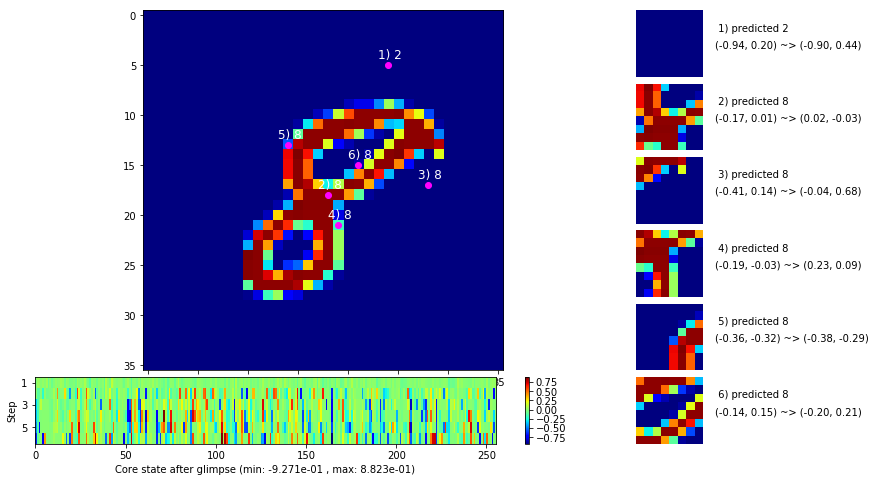

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


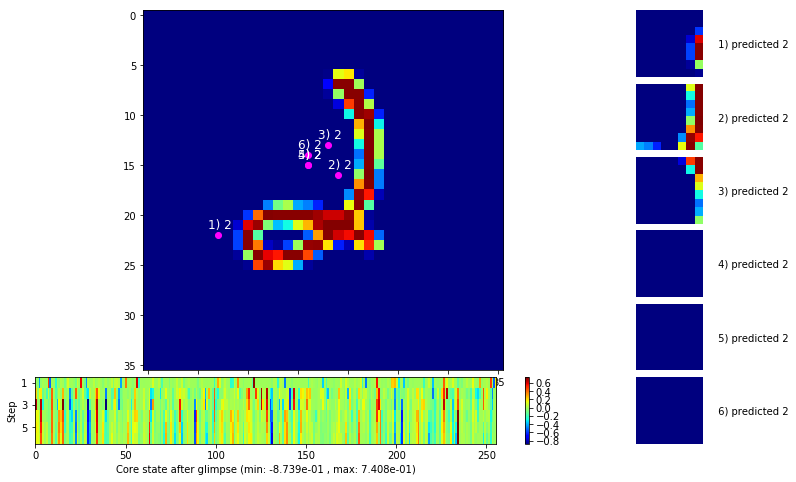


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


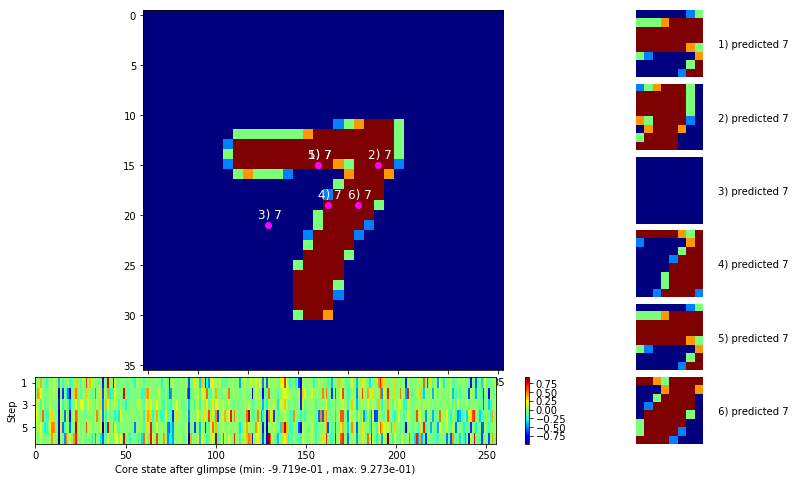

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


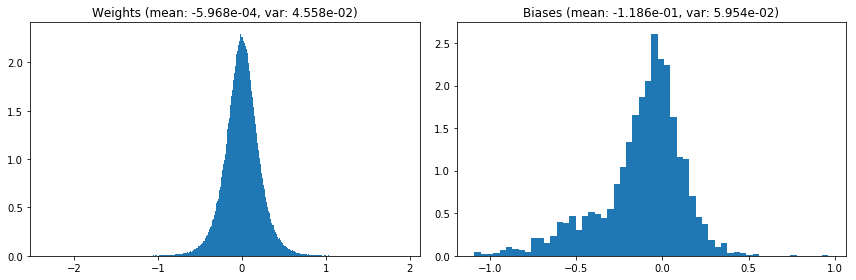

                                      Location network weights and biases


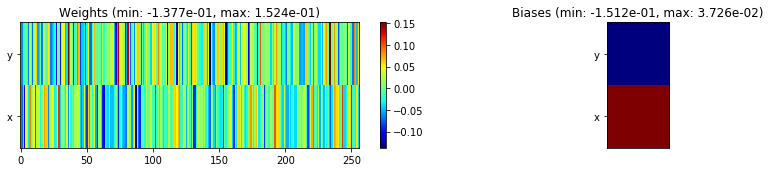

---------------------------------------------------------------------------------------------------------------
Elapsed time:  416.47 sec | TRAIN >> class loss: 0.1202 | steps:  2.078 :( | reward:  0.9616 :( | acc.: 96.163% :(
                          | VAL   >> class loss: 0.1284 | steps:  1.935 :( | reward:  0.9596 :( | acc.: 95.960% :(


Epoch  93/400) lr = 0.0001339
 b    500/  3000 >> 133.5 ms/b | lr: 1.34e-04 | grad 2norm:  3.34 | grad inf norm:  1.003
       Weights || abs max:  2.32 (37214.74) | mean: -5.97e-04 ( 0.14) | var: 4.56e-02 (44321.57)
        Biases || abs max:  1.09 (  192.52) | mean: -1.19e-01 ( 0.25) | var: 5.96e-02 (  334.42)
                  class loss: 0.127 | steps: 2.072 | reward:  0.959 | acc.: 95.89%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 133.5 ms/b | lr: 1.34e-04 | grad 2norm:  3.25 | grad inf norm:  0.970
       Weights || abs max:  2.32 (59271.00) | mean: -5.99e-04 ( 0.17) |

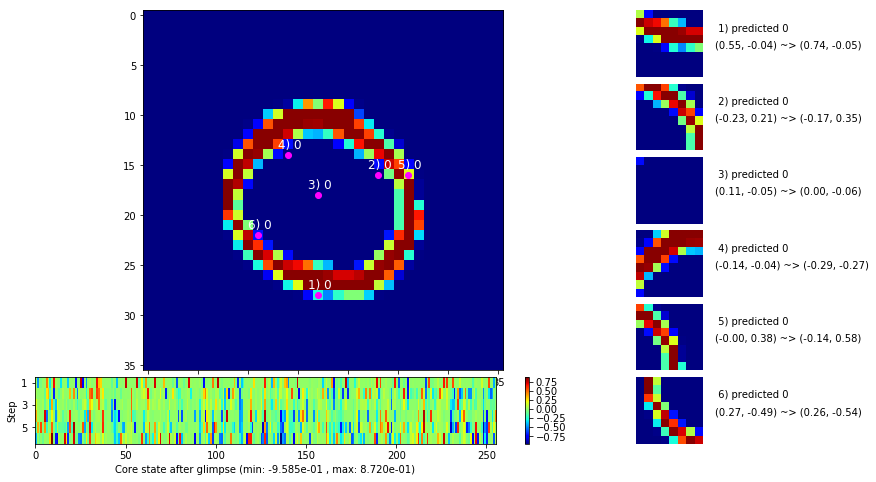

 b   1500/  3000 >> 139.9 ms/b | lr: 1.33e-04 | grad 2norm:  3.27 | grad inf norm:  0.954
       Weights || abs max:  2.31 (26200.39) | mean: -6.00e-04 ( 0.11) | var: 4.56e-02 (39630.96)
        Biases || abs max:  1.09 (  418.60) | mean: -1.19e-01 ( 0.34) | var: 5.96e-02 ( 7277.28)
                  class loss: 0.127 | steps: 2.085 | reward:  0.961 | acc.: 96.10%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 144.1 ms/b | lr: 1.33e-04 | grad 2norm:  3.37 | grad inf norm:  1.038
       Weights || abs max:  2.31 (25187.04) | mean: -5.95e-04 ( 0.11) | var: 4.56e-02 (22137.46)
        Biases || abs max:  1.09 (  200.66) | mean: -1.19e-01 ( 0.22) | var: 5.97e-02 (  185.32)
                  class loss: 0.129 | steps: 2.084 | reward:  0.958 | acc.: 95.83%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

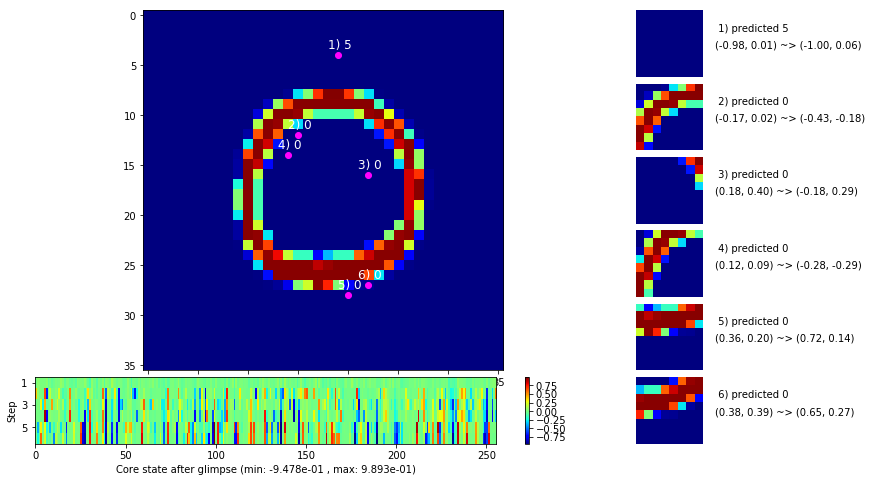

 b   2500/  3000 >> 134.9 ms/b | lr: 1.33e-04 | grad 2norm:  3.24 | grad inf norm:  0.952
       Weights || abs max:  2.31 (34507.31) | mean: -5.99e-04 ( 0.12) | var: 4.56e-02 (73489.82)
        Biases || abs max:  1.09 (  388.24) | mean: -1.19e-01 ( 0.31) | var: 5.96e-02 ( 1229.95)
                  class loss: 0.121 | steps: 2.077 | reward:  0.962 | acc.: 96.19%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 131.6 ms/b | lr: 1.33e-04 | grad 2norm:  3.21 | grad inf norm:  0.982
       Weights || abs max:  2.31 (57550.19) | mean: -6.04e-04 ( 0.17) | var: 4.56e-02 (406682.56)
        Biases || abs max:  1.09 (  563.99) | mean: -1.19e-01 ( 0.39) | var: 5.96e-02 ( 2777.59)
                  class loss: 0.115 | steps: 2.091 | reward:  0.962 | acc.: 96.18%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

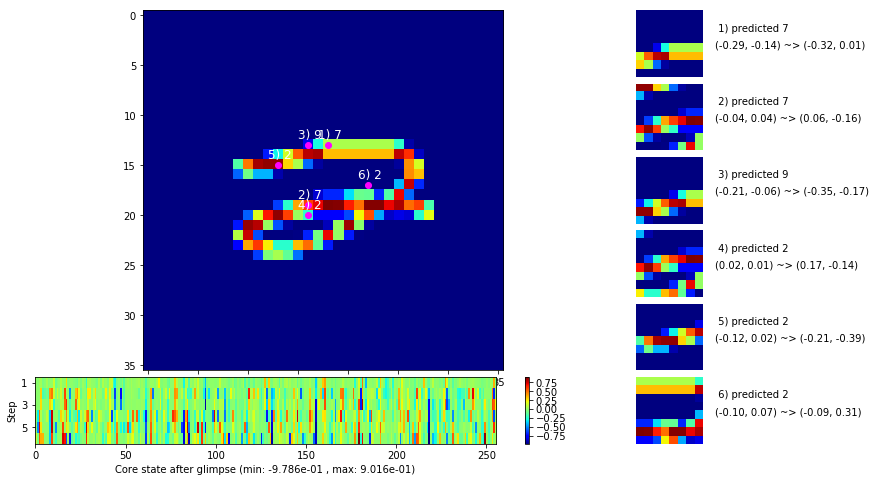

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


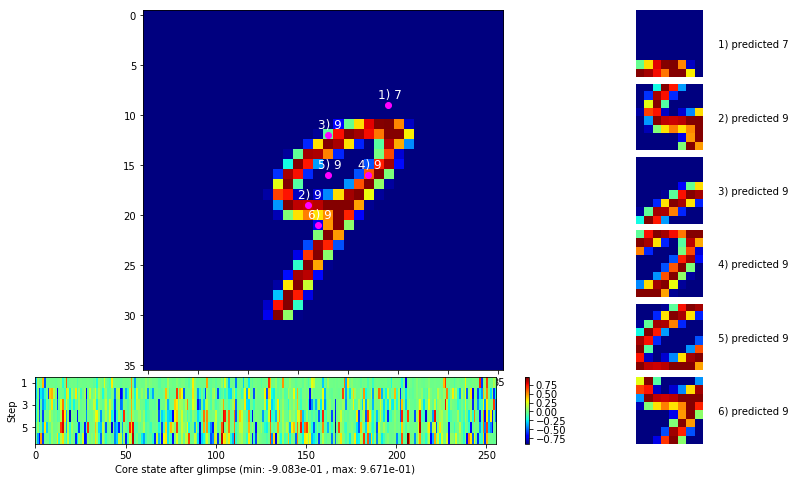


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


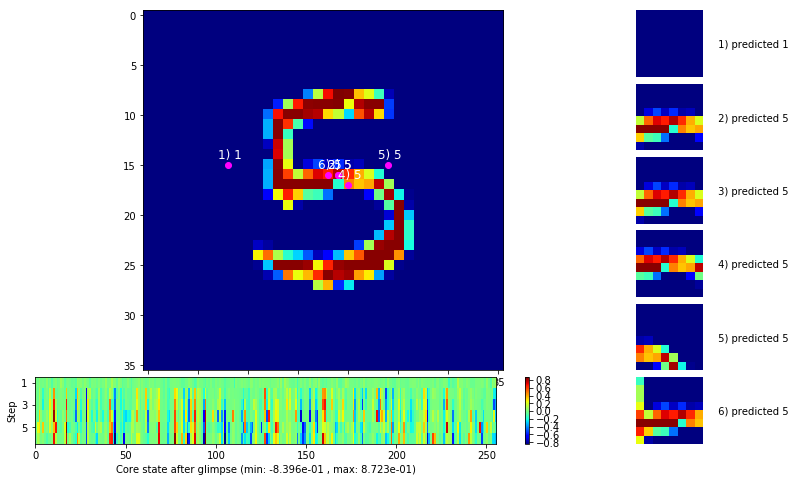

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


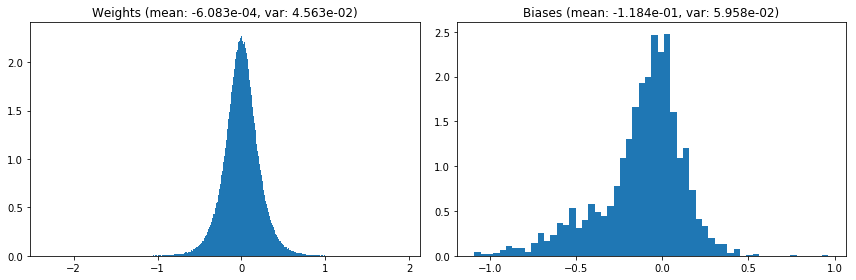

                                      Location network weights and biases


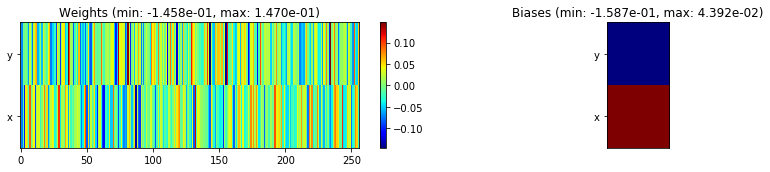

---------------------------------------------------------------------------------------------------------------
Elapsed time:  409.55 sec | TRAIN >> class loss: 0.1237 | steps:  2.080 :( | reward:  0.9606 :( | acc.: 96.060% :(
                          | VAL   >> class loss: 0.1448 | steps:  1.958 :( | reward:  0.9550 :( | acc.: 95.500% :(


Epoch  94/400) lr = 0.0001327
 b    500/  3000 >> 132.7 ms/b | lr: 1.32e-04 | grad 2norm:  3.36 | grad inf norm:  0.977
       Weights || abs max:  2.31 (29308.52) | mean: -6.10e-04 ( 0.12) | var: 4.56e-02 (56768.09)
        Biases || abs max:  1.09 (  135.43) | mean: -1.19e-01 ( 0.18) | var: 5.96e-02 (  101.56)
                  class loss: 0.124 | steps: 2.101 | reward:  0.960 | acc.: 95.99%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 131.4 ms/b | lr: 1.32e-04 | grad 2norm:  3.31 | grad inf norm:  1.029
       Weights || abs max:  2.32 (41462.25) | mean: -6.12e-04 ( 0.14) |

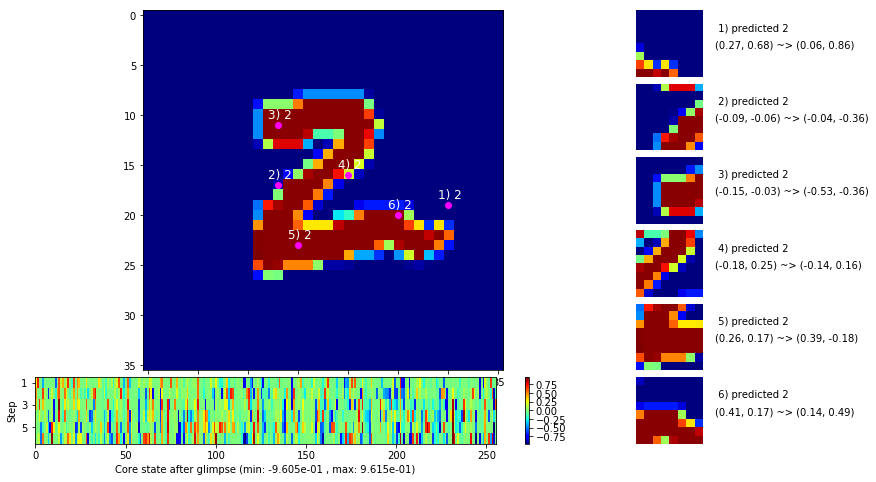

 b   1500/  3000 >> 134.2 ms/b | lr: 1.32e-04 | grad 2norm:  3.34 | grad inf norm:  1.018
       Weights || abs max:  2.31 (60510.74) | mean: -6.13e-04 ( 0.18) | var: 4.56e-02 (485518.00)
        Biases || abs max:  1.09 (  277.55) | mean: -1.19e-01 ( 0.26) | var: 5.96e-02 (  380.34)
                  class loss: 0.125 | steps: 2.088 | reward:  0.959 | acc.: 95.87%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 131.0 ms/b | lr: 1.32e-04 | grad 2norm:  3.29 | grad inf norm:  1.000
       Weights || abs max:  2.31 (73933.73) | mean: -6.18e-04 ( 0.20) | var: 4.57e-02 (1429259.00)
        Biases || abs max:  1.09 (  554.93) | mean: -1.18e-01 ( 0.40) | var: 5.95e-02 ( 5510.75)
                  class loss: 0.124 | steps: 2.071 | reward:  0.961 | acc.: 96.05%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

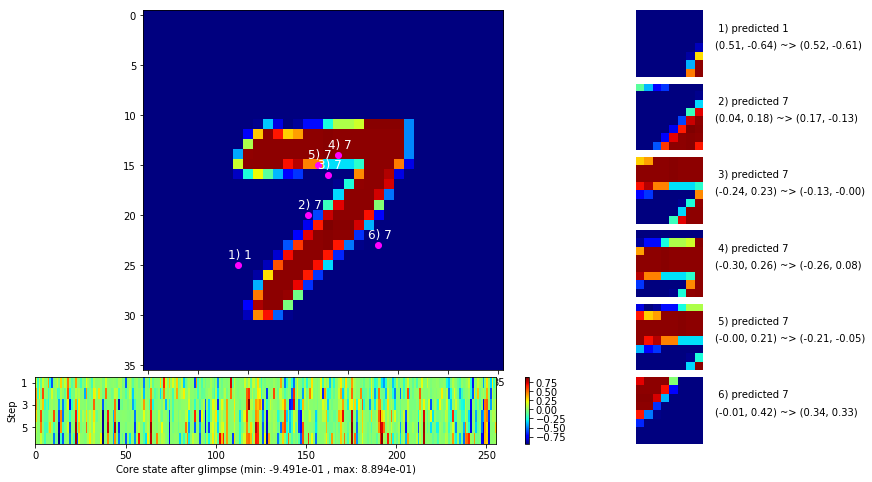

 b   2500/  3000 >> 134.9 ms/b | lr: 1.32e-04 | grad 2norm:  3.41 | grad inf norm:  0.990
       Weights || abs max:  2.31 (37940.83) | mean: -6.25e-04 ( 0.14) | var: 4.57e-02 (90148.07)
        Biases || abs max:  1.09 (  165.69) | mean: -1.18e-01 ( 0.24) | var: 5.95e-02 (  186.34)
                  class loss: 0.129 | steps: 2.079 | reward:  0.959 | acc.: 95.92%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.6 ms/b | lr: 1.32e-04 | grad 2norm:  3.28 | grad inf norm:  1.004
       Weights || abs max:  2.31 (37111.62) | mean: -6.33e-04 ( 0.13) | var: 4.57e-02 (85036.45)
        Biases || abs max:  1.09 (  134.80) | mean: -1.19e-01 ( 0.19) | var: 5.96e-02 (   81.22)
                  class loss: 0.123 | steps: 2.070 | reward:  0.961 | acc.: 96.08%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

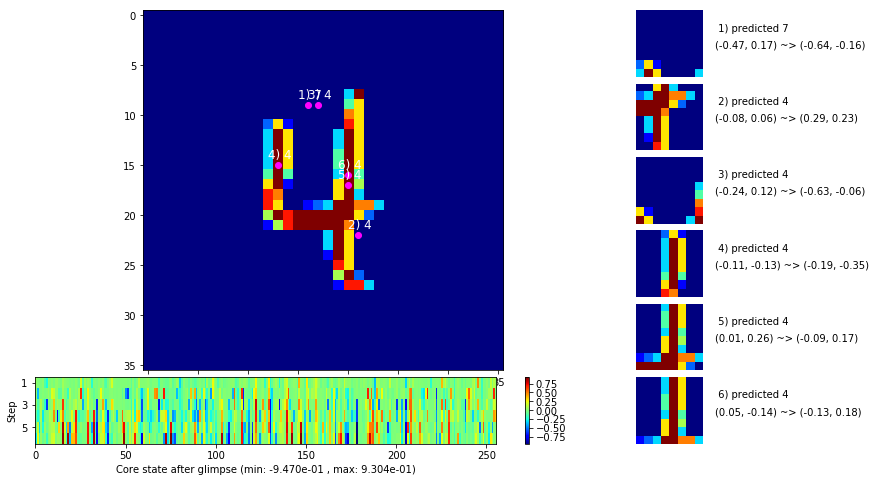

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


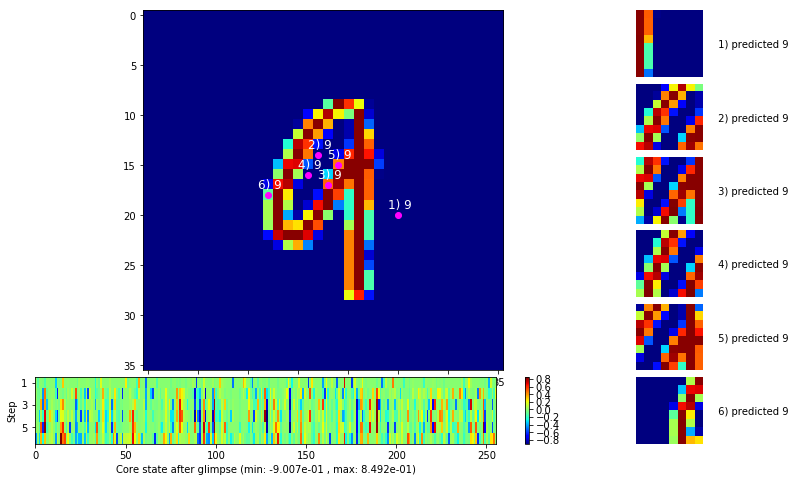


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


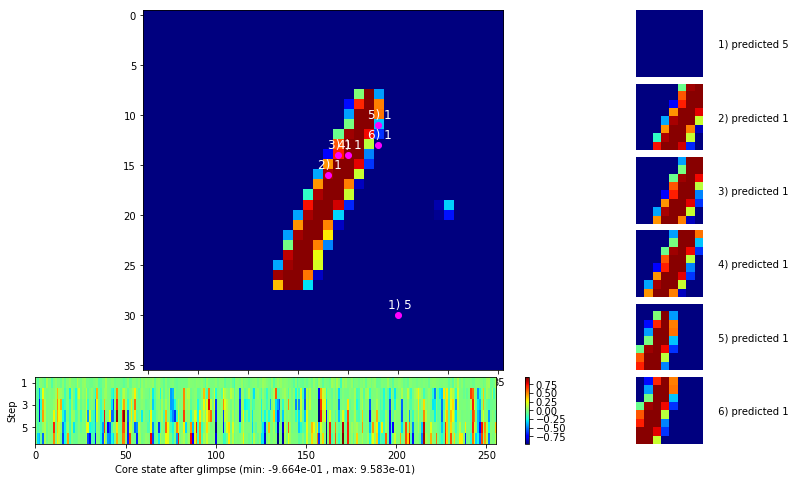

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


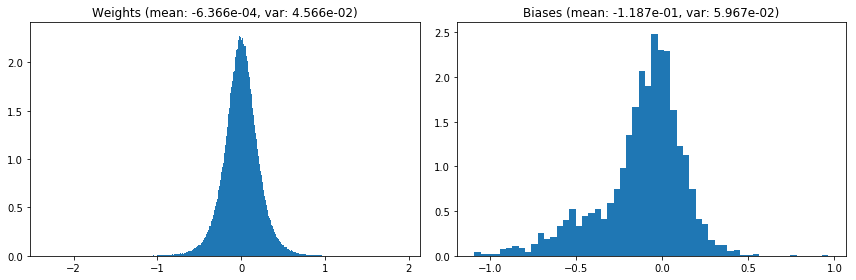

                                      Location network weights and biases


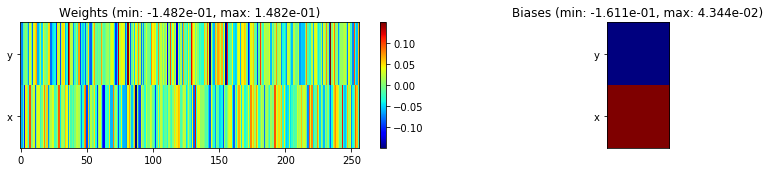

---------------------------------------------------------------------------------------------------------------
Elapsed time:  403.40 sec | TRAIN >> class loss: 0.1261 | steps:  2.083 :( | reward:  0.9597 :( | acc.: 95.967% :(
                          | VAL   >> class loss: 0.1378 | steps:  1.947 :( | reward:  0.9542 :( | acc.: 95.420% :(


Epoch  95/400) lr = 0.0001315
 b    500/  3000 >> 142.2 ms/b | lr: 1.31e-04 | grad 2norm:  3.30 | grad inf norm:  0.988
       Weights || abs max:  2.31 (23506.03) | mean: -6.32e-04 ( 0.11) | var: 4.57e-02 ( 8075.92)
        Biases || abs max:  1.09 (  103.54) | mean: -1.19e-01 ( 0.17) | var: 5.96e-02 (  252.04)
                  class loss: 0.127 | steps: 2.069 | reward:  0.960 | acc.: 96.00%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 150.5 ms/b | lr: 1.31e-04 | grad 2norm:  3.00 | grad inf norm:  0.906
       Weights || abs max:  2.31 (19457.22) | mean: -6.26e-04 ( 0.09) |

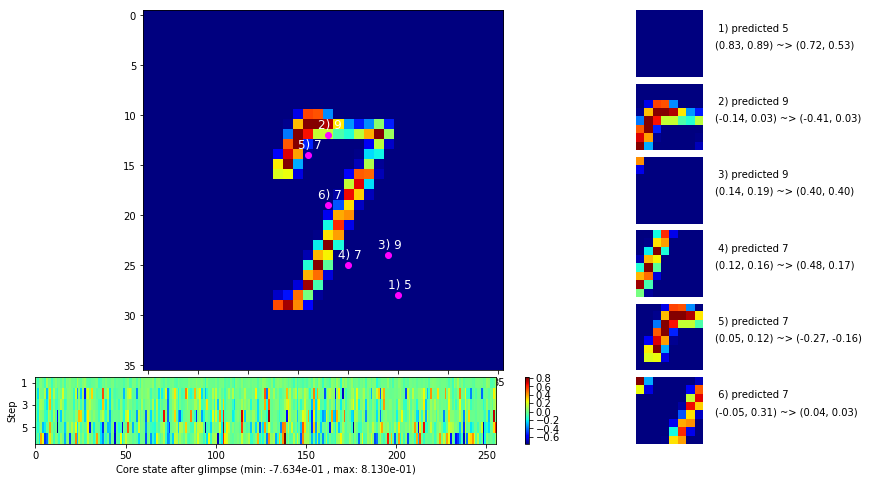

 b   1500/  3000 >> 133.9 ms/b | lr: 1.31e-04 | grad 2norm:  3.37 | grad inf norm:  1.025
       Weights || abs max:  2.32 (29779.75) | mean: -6.23e-04 ( 0.12) | var: 4.57e-02 (23523.82)
        Biases || abs max:  1.09 (  550.29) | mean: -1.18e-01 ( 0.38) | var: 5.96e-02 (10005.32)
                  class loss: 0.127 | steps: 2.105 | reward:  0.958 | acc.: 95.80%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 135.9 ms/b | lr: 1.31e-04 | grad 2norm:  3.33 | grad inf norm:  0.996
       Weights || abs max:  2.31 (44203.43) | mean: -6.25e-04 ( 0.15) | var: 4.57e-02 (113906.16)
        Biases || abs max:  1.09 (  662.54) | mean: -1.19e-01 ( 0.44) | var: 5.97e-02 ( 2995.43)
                  class loss: 0.131 | steps: 2.096 | reward:  0.960 | acc.: 95.97%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

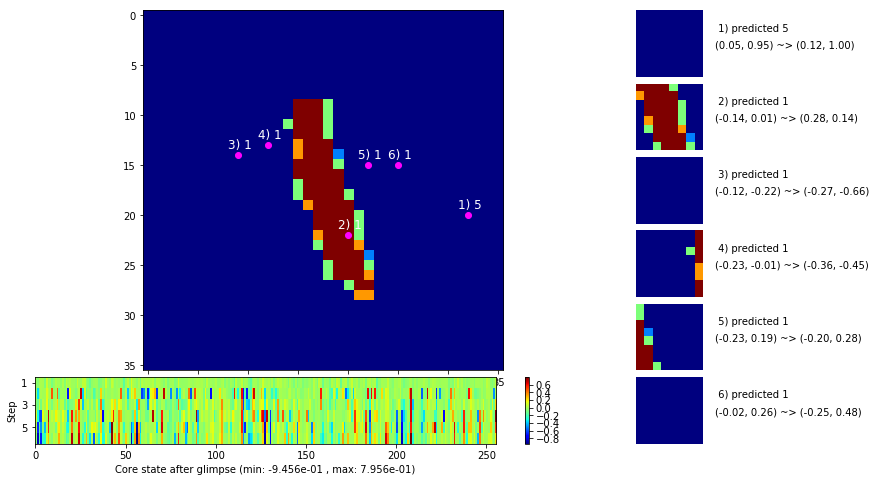

 b   2500/  3000 >> 133.2 ms/b | lr: 1.31e-04 | grad 2norm:  3.36 | grad inf norm:  1.001
       Weights || abs max:  2.31 (18734.43) | mean: -6.25e-04 ( 0.10) | var: 4.57e-02 ( 4455.03)
        Biases || abs max:  1.09 (  365.60) | mean: -1.19e-01 ( 0.31) | var: 5.97e-02 ( 2298.82)
                  class loss: 0.132 | steps: 2.098 | reward:  0.960 | acc.: 95.96%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 131.9 ms/b | lr: 1.30e-04 | grad 2norm:  3.24 | grad inf norm:  0.974
       Weights || abs max:  2.31 (100982.48) | mean: -6.26e-04 ( 0.25) | var: 4.57e-02 (3327303.25)
        Biases || abs max:  1.09 (  365.61) | mean: -1.19e-01 ( 0.31) | var: 5.96e-02 ( 2960.56)
                  class loss: 0.122 | steps: 2.091 | reward:  0.961 | acc.: 96.08%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

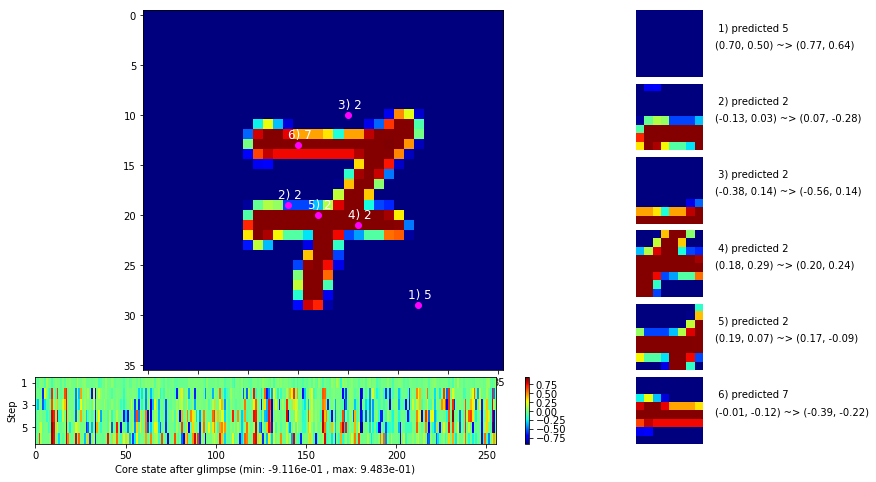

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


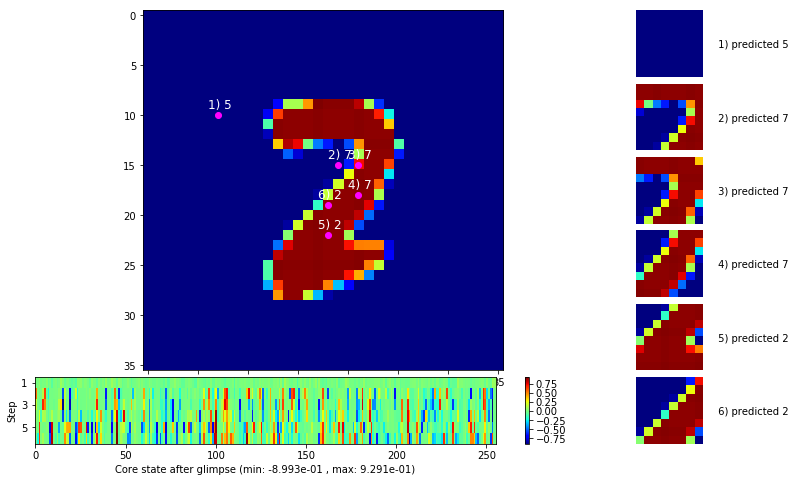


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


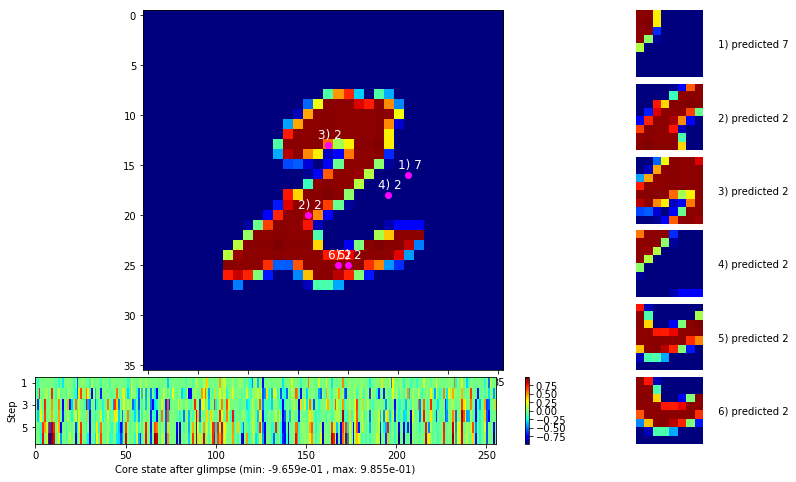

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


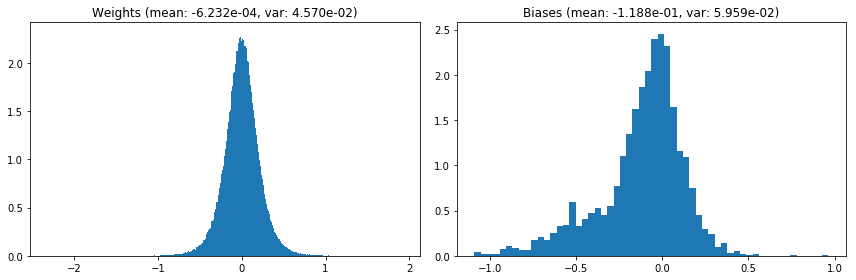

                                      Location network weights and biases


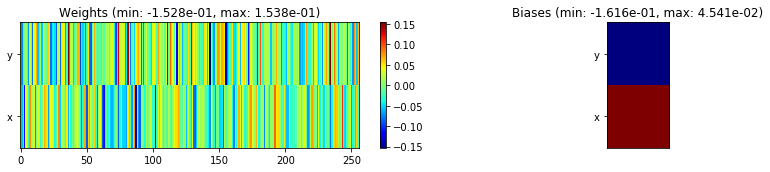

---------------------------------------------------------------------------------------------------------------
Elapsed time:  414.61 sec | TRAIN >> class loss: 0.1242 | steps:  2.086 :( | reward:  0.9607 :( | acc.: 96.075% :(
                          | VAL   >> class loss: 0.1532 | steps:  1.953 :( | reward:  0.9532 :( | acc.: 95.320% :(


Epoch  96/400) lr = 0.0001303
 b    500/  3000 >> 132.1 ms/b | lr: 1.30e-04 | grad 2norm:  3.34 | grad inf norm:  1.013
       Weights || abs max:  2.31 (39999.48) | mean: -6.23e-04 ( 0.14) | var: 4.57e-02 (146687.61)
        Biases || abs max:  1.09 (  406.80) | mean: -1.19e-01 ( 0.40) | var: 5.96e-02 ( 1586.64)
                  class loss: 0.124 | steps: 2.075 | reward:  0.959 | acc.: 95.94%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 135.5 ms/b | lr: 1.30e-04 | grad 2norm:  3.23 | grad inf norm:  0.994
       Weights || abs max:  2.31 (34612.83) | mean: -6.23e-04 ( 0.13) 

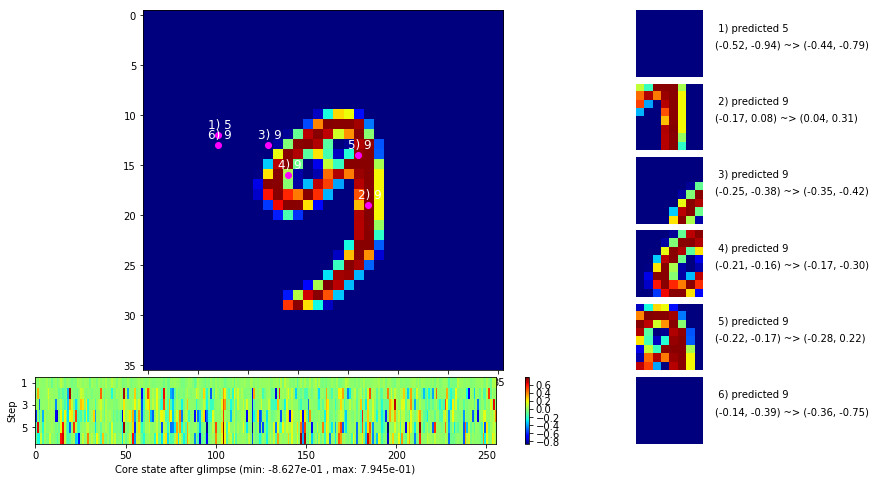

 b   1500/  3000 >> 144.9 ms/b | lr: 1.30e-04 | grad 2norm:  3.44 | grad inf norm:  0.992
       Weights || abs max:  2.31 (73324.12) | mean: -6.18e-04 ( 0.21) | var: 4.57e-02 (688403.94)
        Biases || abs max:  1.10 (  672.42) | mean: -1.19e-01 ( 0.44) | var: 5.96e-02 (31700.87)
                  class loss: 0.128 | steps: 2.094 | reward:  0.958 | acc.: 95.78%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 140.7 ms/b | lr: 1.30e-04 | grad 2norm:  3.14 | grad inf norm:  0.953
       Weights || abs max:  2.31 (27322.58) | mean: -6.24e-04 ( 0.11) | var: 4.57e-02 (23421.40)
        Biases || abs max:  1.10 (  160.84) | mean: -1.19e-01 ( 0.22) | var: 5.96e-02 (  195.97)
                  class loss: 0.122 | steps: 2.087 | reward:  0.964 | acc.: 96.36%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

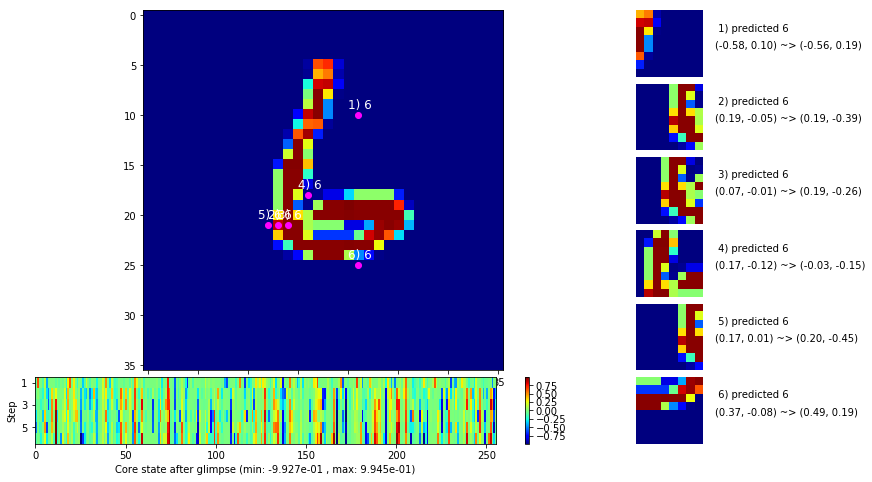

 b   2500/  3000 >> 133.8 ms/b | lr: 1.29e-04 | grad 2norm:  3.00 | grad inf norm:  0.938
       Weights || abs max:  2.31 (30291.33) | mean: -6.27e-04 ( 0.12) | var: 4.57e-02 (22456.43)
        Biases || abs max:  1.10 (  297.90) | mean: -1.19e-01 ( 0.28) | var: 5.97e-02 (  646.31)
                  class loss: 0.113 | steps: 2.087 | reward:  0.965 | acc.: 96.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 132.0 ms/b | lr: 1.29e-04 | grad 2norm:  3.22 | grad inf norm:  0.941
       Weights || abs max:  2.31 (31693.93) | mean: -6.24e-04 ( 0.12) | var: 4.57e-02 (19786.28)
        Biases || abs max:  1.10 (  312.52) | mean: -1.19e-01 ( 0.30) | var: 5.96e-02 ( 1382.30)
                  class loss: 0.121 | steps: 2.079 | reward:  0.962 | acc.: 96.24%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

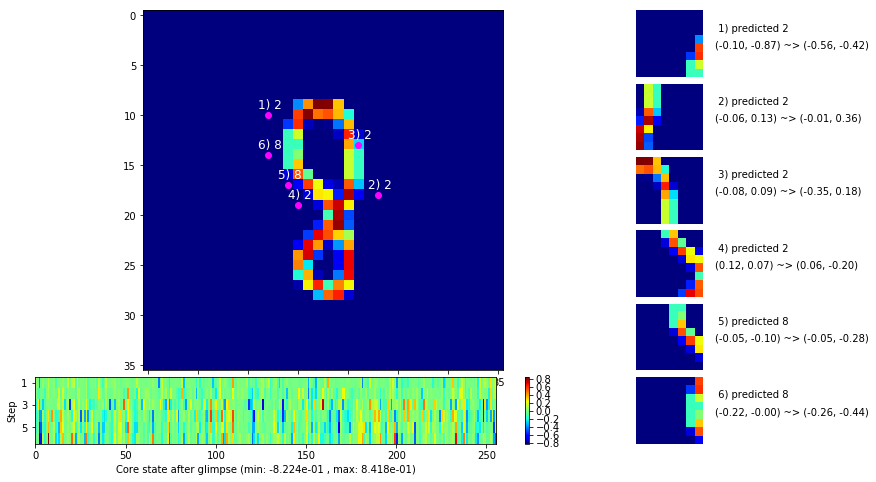

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


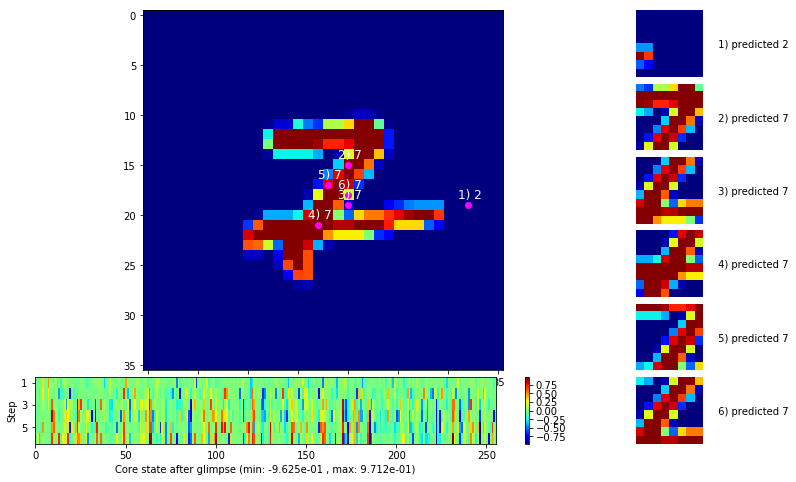


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


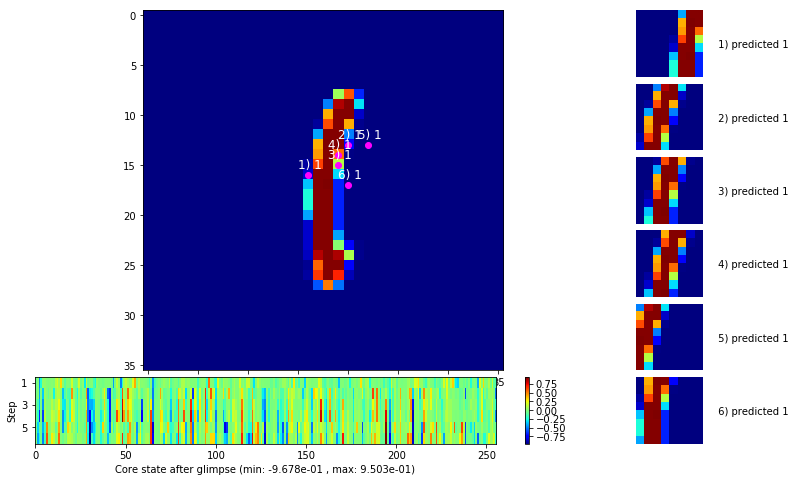

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


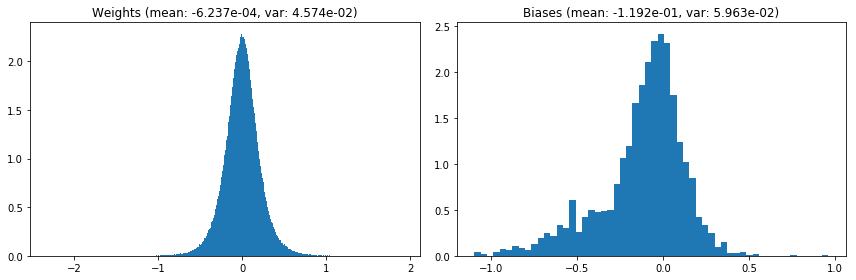

                                      Location network weights and biases


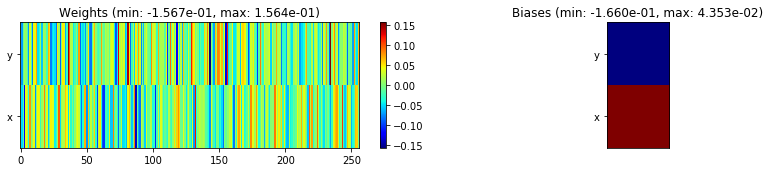

---------------------------------------------------------------------------------------------------------------
Elapsed time:  410.00 sec | TRAIN >> class loss: 0.1216 | steps:  2.083 :( | reward:  0.9616 :( | acc.: 96.158% :(
                          | VAL   >> class loss: 0.1352 | steps:  1.957 :( | reward:  0.9584 :( | acc.: 95.840% :(


Epoch  97/400) lr = 0.0001291
 b    500/  3000 >> 130.2 ms/b | lr: 1.29e-04 | grad 2norm:  3.22 | grad inf norm:  0.966
       Weights || abs max:  2.31 (158809.47) | mean: -6.23e-04 ( 0.36) | var: 4.57e-02 (14118649.00)
        Biases || abs max:  1.10 (  149.42) | mean: -1.19e-01 ( 0.20) | var: 5.96e-02 (  163.95)
                  class loss: 0.119 | steps: 2.084 | reward:  0.962 | acc.: 96.22%
                 --------------------------------------------------------------------------------
 b   1000/  3000 >> 133.1 ms/b | lr: 1.29e-04 | grad 2norm:  3.28 | grad inf norm:  0.990
       Weights || abs max:  2.31 (61649.41) | mean: -6.26e-04 ( 0.1

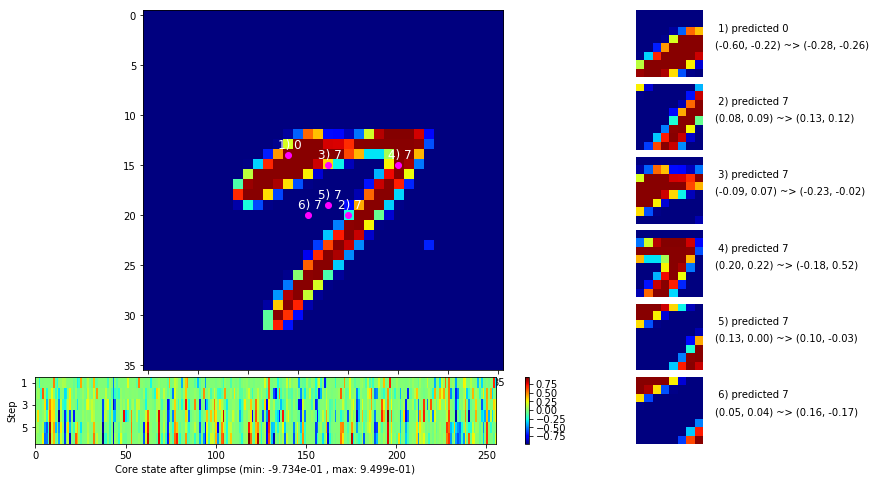

 b   1500/  3000 >> 132.5 ms/b | lr: 1.29e-04 | grad 2norm:  3.32 | grad inf norm:  0.993
       Weights || abs max:  2.31 (26354.49) | mean: -6.26e-04 ( 0.11) | var: 4.58e-02 (23355.81)
        Biases || abs max:  1.09 (  209.51) | mean: -1.19e-01 ( 0.24) | var: 5.96e-02 (  982.70)
                  class loss: 0.122 | steps: 2.070 | reward:  0.960 | acc.: 96.01%
                 --------------------------------------------------------------------------------
 b   2000/  3000 >> 132.3 ms/b | lr: 1.28e-04 | grad 2norm:  3.09 | grad inf norm:  0.930
       Weights || abs max:  2.30 (30968.58) | mean: -6.23e-04 ( 0.12) | var: 4.58e-02 (26002.85)
        Biases || abs max:  1.09 (  336.21) | mean: -1.19e-01 ( 0.27) | var: 5.96e-02 ( 1760.41)
                  class loss: 0.115 | steps: 2.080 | reward:  0.964 | acc.: 96.41%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

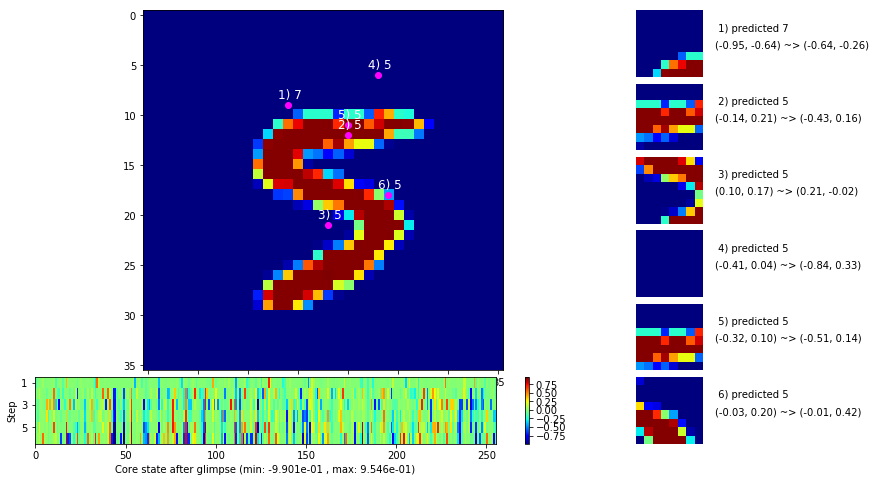

 b   2500/  3000 >> 135.3 ms/b | lr: 1.28e-04 | grad 2norm:  3.31 | grad inf norm:  0.992
       Weights || abs max:  2.30 (24391.40) | mean: -6.27e-04 ( 0.11) | var: 4.58e-02 (12458.66)
        Biases || abs max:  1.09 (  435.40) | mean: -1.19e-01 ( 0.41) | var: 5.97e-02 (17695.43)
                  class loss: 0.124 | steps: 2.077 | reward:  0.960 | acc.: 96.01%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 146.4 ms/b | lr: 1.28e-04 | grad 2norm:  3.30 | grad inf norm:  0.999
       Weights || abs max:  2.30 (40274.16) | mean: -6.34e-04 ( 0.14) | var: 4.58e-02 (104582.38)
        Biases || abs max:  1.09 (  233.73) | mean: -1.19e-01 ( 0.26) | var: 5.97e-02 (  575.25)
                  class loss: 0.123 | steps: 2.099 | reward:  0.960 | acc.: 95.97%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

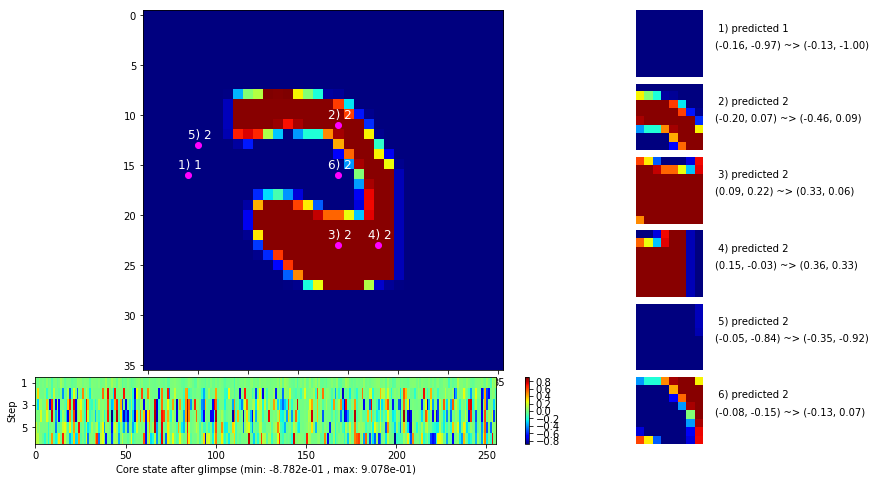

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


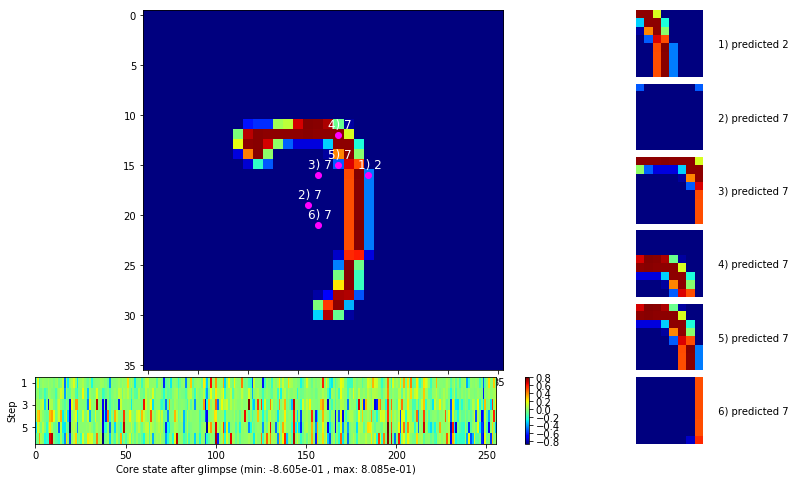


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


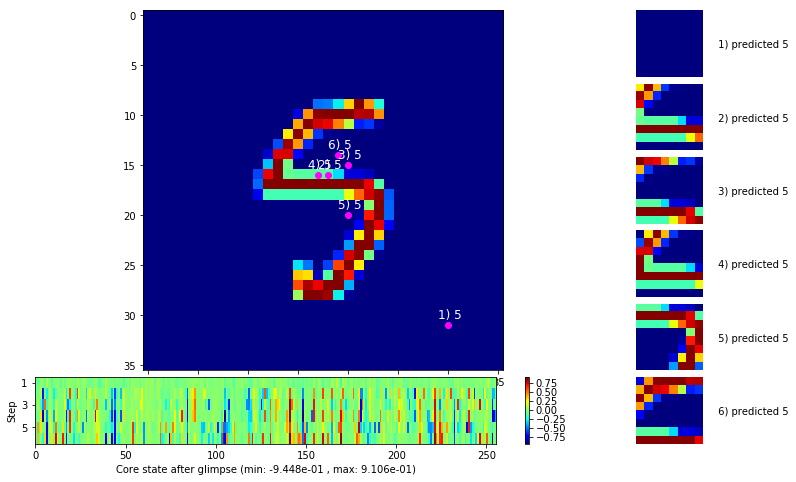

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


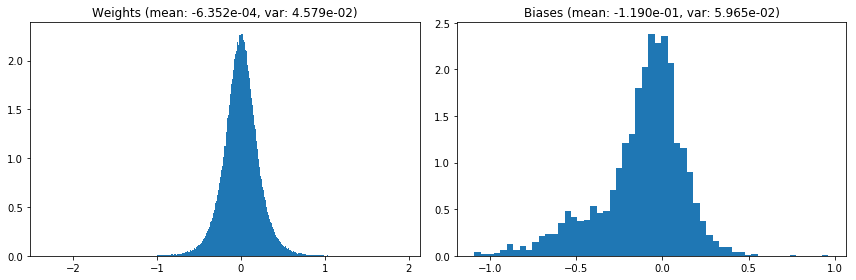

                                      Location network weights and biases


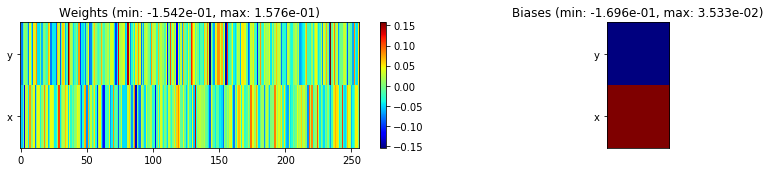

---------------------------------------------------------------------------------------------------------------
Elapsed time:  405.64 sec | TRAIN >> class loss: 0.1219 | steps:  2.084 :( | reward:  0.9611 :( | acc.: 96.107% :(
                          | VAL   >> class loss: 0.1300 | steps:  1.960 :( | reward:  0.9582 :( | acc.: 95.820% :(



			---~~~=== End of training ===~~~---

Evaluating on the TEST dataset...

	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


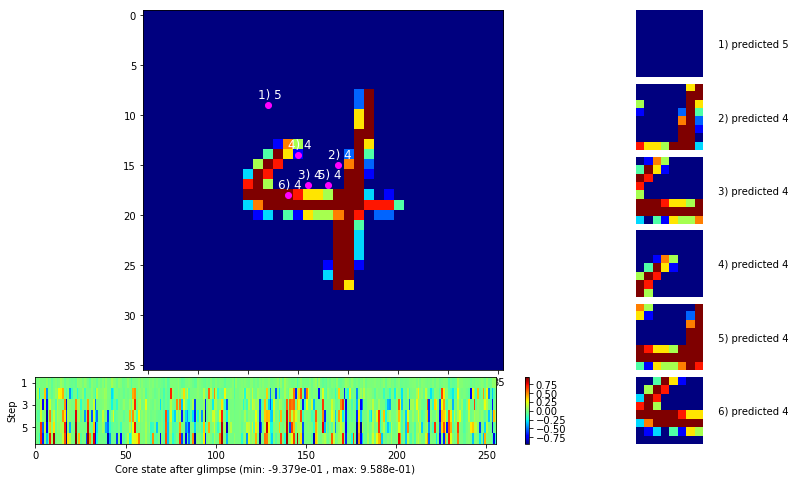


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


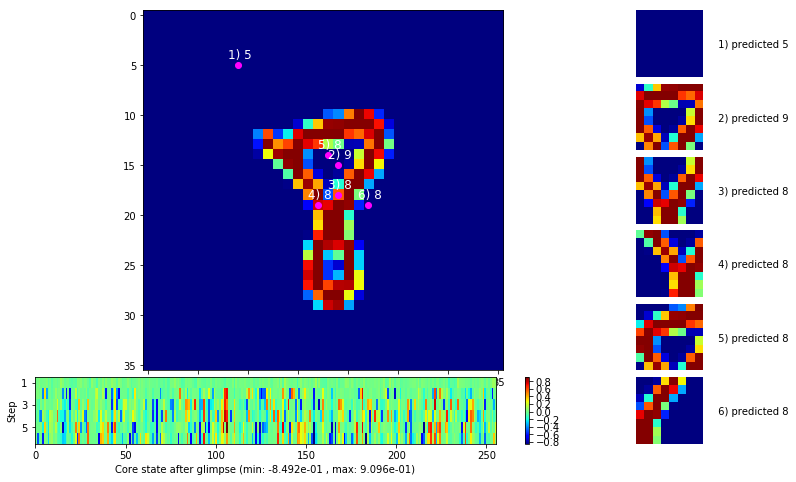

	>> class loss: 0.1368 | steps:  1.951 | reward:  0.9596 | acc.: 95.960%


In [8]:
model_info, train_info, val_info, test_info, epochs = train_eval_loop(
    model = model, epochs = num_epochs, image_size = image_size,
    train_data = train_data, val_data = val_data, test_data = test_data,
    padding = padding, optimizer = optimizer, lr_scheduler = lr_scheduler,
    class_criterion = class_criterion, error_penalty = error_penalty,
    loc_std = loc_std, random_start_loc = random_start_loc, gamma = gamma,
    grad_clip = grad_clip, steps_per_epoch = steps_per_epoch,
    max_ep_len = max_ep_len, log_freq = log_freq, viz_freq = viz_freq,
    early_stopping = early_stopping, eval_viz_freq = eval_viz_freq
)

In [9]:
print('Trained over %d epochs\n' % epochs)

for name, best_stats in zip(['train', 'val'], [train_info['bests'], val_info['bests']]):
    print('Best %s stats:' % name)
    for k, v in best_stats.items():
        print('    %s: %.2f (epoch %d)' % (k, v[k], v['epoch']))
    print('')

Trained over 97 epochs

Best train stats:
    steps: 2.07 (epoch 85)
    reward: 0.96 (epoch 89)
    accuracy: 0.96 (epoch 89)

Best val stats:
    steps: 1.92 (epoch 77)
    reward: 0.96 (epoch 77)
    accuracy: 0.96 (epoch 77)



### Training curves

In [10]:
epoch_range = range(1, epochs+1)
train_col = (1, 0, 0); train_err_col = (1, 0.1, 0.1)
val_col = (0, 0, 1); val_err_col = (0.1, 0.1, 1)

Text(0.5,1,'Weight and bias values over training time')

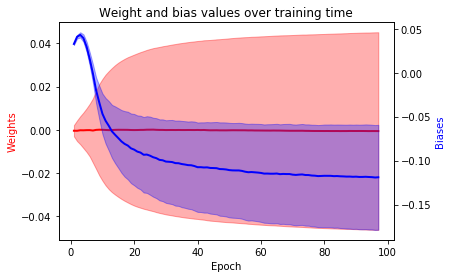

In [11]:
wts_mean = np.array(model_info['weights']['mean'])
wts_var = np.array(model_info['weights']['var'])
bias_mean = np.array(model_info['biases']['mean'])
bias_var = np.array(model_info['biases']['var'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_mean, color = train_col, linewidth = 2)
wts_ax.fill_between(epoch_range,
    wts_mean - wts_var, wts_mean + wts_var,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_mean, color = val_col, linewidth = 2)
bias_ax.fill_between(epoch_range,
    bias_mean - bias_var, bias_mean + bias_var,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Weight and bias values over training time')

Text(0.5,1,'Max absolute weight and bias values over training time')

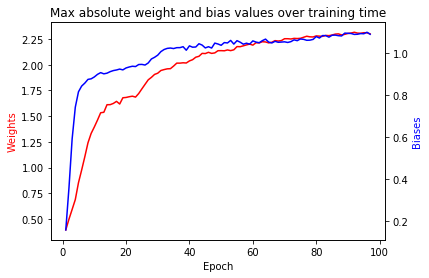

In [12]:
wts_absmax = np.array(model_info['weights']['abs max'])
bias_absmax = np.array(model_info['biases']['abs max'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_absmax, color = train_col)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_absmax, color = val_col)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Max absolute weight and bias values over training time')

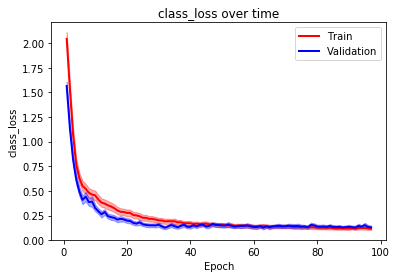

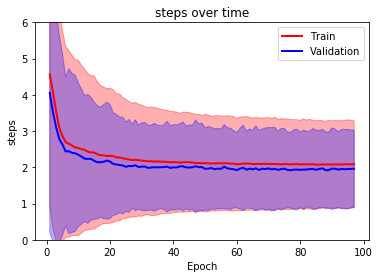

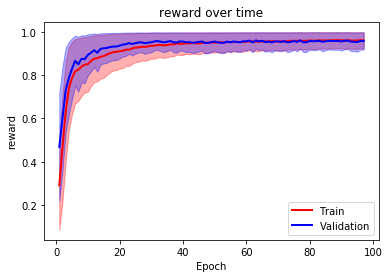

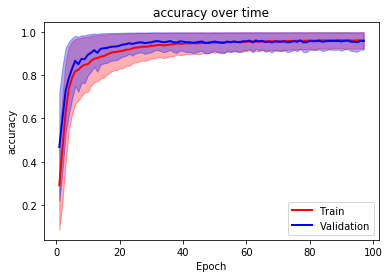

In [13]:
things_to_plot = ['class_loss', 'steps', 'reward', 'accuracy']
for thing in things_to_plot:
    train_avg = np.array([info['averages'][thing] for info in train_info['stats']])
    train_err = np.array([np.var(info['histories'][thing]) for info in train_info['stats']])
    
    val_avg = np.array([info['averages'][thing] for info in val_info['stats']])
    val_err = np.array([np.var(info['histories'][thing]) for info in val_info['stats']])
    
    plt.plot(epoch_range, train_avg, color = train_col, linewidth = 2)
    plt.plot(epoch_range, val_avg, color = val_col, linewidth = 2)
    plt.fill_between(epoch_range,
        train_avg - train_err, train_avg + train_err, alpha = 0.35,
        edgecolor = train_col, facecolor = train_err_col
    )
    plt.fill_between(epoch_range,
        val_avg - val_err, val_avg + val_err, alpha = 0.35,
        edgecolor = val_col, facecolor = val_err_col
    )
    if thing == 'steps':
        plt.ylim([0, 6])
    plt.legend(['Train', 'Validation'], loc = 'upper right' if thing in ['class_loss', 'steps'] else 'lower right')
    plt.xlabel('Epoch'); plt.ylabel(thing)
    plt.title('%s over time' % thing)
    plt.show()
    print('')

Text(0.5,1,'Gradient norms over training time')

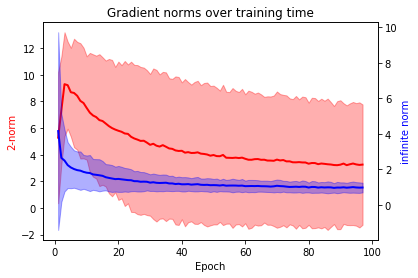

In [14]:
# Gradient stats
grad_2norm = np.array([info['averages']['grad_2norm'] for info in train_info['stats']])
grad_inf_norm = np.array([info['averages']['grad_inf_norm'] for info in train_info['stats']])
grad_2norm_err = np.array([np.var(info['histories']['grad_2norm']) for info in train_info['stats']])
grad_inf_norm_err = np.array([np.var(info['histories']['grad_inf_norm']) for info in train_info['stats']])

fig, pnorm_ax = plt.subplots()
pnorm_ax.plot(epoch_range, grad_2norm, color = train_col, linewidth = 2)
pnorm_ax.fill_between(epoch_range,
    grad_2norm - grad_2norm_err, grad_2norm + grad_2norm_err,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
pnorm_ax.set_xlabel('Epoch');
pnorm_ax.set_ylabel('2-norm', color = train_col)

infnorm_ax = pnorm_ax.twinx()
infnorm_ax.plot(epoch_range, grad_inf_norm, color = val_col, linewidth = 2)
infnorm_ax.fill_between(epoch_range,
    grad_inf_norm - grad_inf_norm_err, grad_inf_norm + grad_inf_norm_err,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
infnorm_ax.set_ylabel('infinite norm', color = val_col)

plt.title('Gradient norms over training time')